# Monte Carlo Methods

In this notebook, you will write your own implementations of many Monte Carlo (MC) algorithms. 

While we have provided some starter code, you are welcome to erase these hints and write your code from scratch.

### Part 0: Explore BlackjackEnv

We begin by importing the necessary packages.

In [24]:
import sys
import gym
import numpy as np
from collections import defaultdict

from plot_utils import plot_blackjack_values, plot_policy

Use the code cell below to create an instance of the [Blackjack](https://github.com/openai/gym/blob/master/gym/envs/toy_text/blackjack.py) environment.

In [25]:
env = gym.make('Blackjack-v0')

Each state is a 3-tuple of:
- the player's current sum $\in \{0, 1, \ldots, 31\}$,
- the dealer's face up card $\in \{1, \ldots, 10\}$, and
- whether or not the player has a usable ace (`no` $=0$, `yes` $=1$).

The agent has two potential actions:

```
    STICK = 0
    HIT = 1
```
Verify this by running the code cell below.

In [26]:
print(env.observation_space)
print(env.action_space)

Tuple(Discrete(32), Discrete(11), Discrete(2))
Discrete(2)


Execute the code cell below to play Blackjack with a random policy.  

(_The code currently plays Blackjack three times - feel free to change this number, or to run the cell multiple times.  The cell is designed for you to get some experience with the output that is returned as the agent interacts with the environment._)

In [27]:
for i_episode in range(3):
    state = env.reset()
    while True:
        print(state)
        action = env.action_space.sample()
        state, reward, done, info = env.step(action)
        if done:
            print('End game! Reward: ', reward)
            print('You won :)\n') if reward > 0 else print('You lost :(\n')
            break

(11, 9, False)
End game! Reward:  1.0
You won :)

(6, 8, False)
End game! Reward:  -1.0
You lost :(

(13, 6, False)
End game! Reward:  -1.0
You lost :(



### Part 1: MC Prediction

In this section, you will write your own implementation of MC prediction (for estimating the action-value function).  

We will begin by investigating a policy where the player _almost_ always sticks if the sum of her cards exceeds 18.  In particular, she selects action `STICK` with 80% probability if the sum is greater than 18; and, if the sum is 18 or below, she selects action `HIT` with 80% probability.  The function `generate_episode_from_limit_stochastic` samples an episode using this policy. 

The function accepts as **input**:
- `bj_env`: This is an instance of OpenAI Gym's Blackjack environment.

It returns as **output**:
- `episode`: This is a list of (state, action, reward) tuples (of tuples) and corresponds to $(S_0, A_0, R_1, \ldots, S_{T-1}, A_{T-1}, R_{T})$, where $T$ is the final time step.  In particular, `episode[i]` returns $(S_i, A_i, R_{i+1})$, and `episode[i][0]`, `episode[i][1]`, and `episode[i][2]` return $S_i$, $A_i$, and $R_{i+1}$, respectively.

In [28]:
def generate_episode_from_limit_stochastic(bj_env):
    episode = []
    state = bj_env.reset()
    while True:
        probs = [0.8, 0.2] if state[0] > 18 else [0.2, 0.8]
        action = np.random.choice(np.arange(2), p=probs)
        next_state, reward, done, info = bj_env.step(action)
        episode.append((state, action, reward))
        state = next_state
        if done:
            break
    return episode

In [29]:
# probs = [0.8, 0.2] if state[0] > 18 else [0.2, 0.8]
# action = np.random.choice(np.arange(2))
# action

Execute the code cell below to play Blackjack with the policy. 

(*The code currently plays Blackjack three times - feel free to change this number, or to run the cell multiple times.  The cell is designed for you to gain some familiarity with the output of the `generate_episode_from_limit_stochastic` function.*)

In [30]:
for i in range(3):
    print(generate_episode_from_limit_stochastic(env))

[((17, 1, False), 1, 0), ((21, 1, False), 1, -1)]
[((15, 10, True), 1, 0), ((15, 10, False), 1, 0), ((17, 10, False), 1, -1)]
[((19, 6, False), 1, -1)]


Now, you are ready to write your own implementation of MC prediction.  Feel free to implement either first-visit or every-visit MC prediction; in the case of the Blackjack environment, the techniques are equivalent.

Your algorithm has three arguments:
- `env`: This is an instance of an OpenAI Gym environment.
- `num_episodes`: This is the number of episodes that are generated through agent-environment interaction.
- `generate_episode`: This is a function that returns an episode of interaction.
- `gamma`: This is the discount rate.  It must be a value between 0 and 1, inclusive (default value: `1`).

The algorithm returns as output:
- `Q`: This is a dictionary (of one-dimensional arrays) where `Q[s][a]` is the estimated action value corresponding to state `s` and action `a`.

In [42]:
def mc_prediction_q(env, num_episodes, generate_episode, gamma=1.0):
    # initialize empty dictionaries of arrays
    returns_sum = defaultdict(lambda: np.zeros(env.action_space.n))
    N = defaultdict(lambda: np.zeros(env.action_space.n))
    Q = defaultdict(lambda: np.zeros(env.action_space.n))
    # loop over episodes
    for i_episode in range(1, num_episodes+1):
        
        # monitor progress
        if i_episode % 1000 == 0:
            print("\rEpisode {}/{}.".format(i_episode, num_episodes), end="")
            sys.stdout.flush()
        # generate an episode
        episode = generate_episode(env)
        # obtain the states, actions, and rewards
        states, actions, rewards = zip(*episode)
        print(states,actions,rewards)
        # prepare for discounting
        discounts = np.array([gamma**i for i in range(len(rewards)+1)])
        # update the sum of the returns, number of visits, and action-value 
        # function estimates for each state-action pair in the episode
        for i, state in enumerate(states):
            returns_sum[state][actions[i]] += sum(rewards[i:]*discounts[:-(1+i)])
            N[state][actions[i]] += 1.0
            Q[state][actions[i]] = returns_sum[state][actions[i]] / N[state][actions[i]]
    return Q
#         if i_episode % 1000 == 0:
#             print("\rEpisode {}/{}.".format(i_episode, num_episodes), end="")
#             sys.stdout.flush()
#         episode = generate_episode(env)
#         state=[]
#         action=[]
#         rewards=[]
#         discounts = np.array([gamma**i for i in range(len(rewards)+1)])
#         for i in episode:
#             state.append(i[0])
#             action.append(i[1])
#             rewards.append(i[2])
#         print(state,action,rewards)
#         for i in range(len(state)):
#             returns_sum[state[i]][action[i]] += sum(rewards[i:]*discounts[:-(i+1)])
#             N[state[i]][action[i]]+=1
#             Q[state[i]][action[i]]=returns_sum[state[i]][action[i]]/N[state[i]][action[i]]
            
            
            
        
    return Q

In [43]:
mc_prediction_q(env, 500000, generate_episode_from_limit_stochastic)


((20, 4, False),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((12, 7, False), (14, 7, False), (17, 7, False)) (1, 1, 0) (0, 0, -1.0)
((15, 7, False),) (1,) (-1,)
((14, 9, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (-1.0,)
((11, 5, False), (14, 5, False), (15, 5, False)) (1, 1, 1) (0, 0, -1)
((8, 9, False), (19, 9, True)) (1, 0) (0, 1.0)
((12, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((15, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((9, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((20, 10, True),) (0,) (0.0,)
((8, 2, False), (19, 2, True)) (1, 0) (0, 1.0)
((6, 10, False), (8, 10, False), (11, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((19, 6, False),) (1,) (-1,)
((15, 2, False),) (0,) (-1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
(

((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((15, 2, False),) (1,) (-1,)
((15, 6, False),) (0,) (-1.0,)
((7, 5, False), (16, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((15, 9, True), (18, 9, True), (12, 9, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False), (18, 1, False)) (1, 1) (0, -1)
((15, 1, False), (17, 1, False)) (1, 1) (0, -1)
((12, 10, False), (20, 10, False)) (1, 1) (0, -1)
((19, 5, True),) (0,) (1.0,)
((15, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((19, 6, False),) (0,) (-1.0,)
((10, 5, False), (13, 5, False), (16, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 7, True), (18, 7, True), (21, 7, True), (19, 7, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((7, 10, False), (9, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((8, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 8, Tr

((18, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((5, 5, False), (15, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((12, 3, False),) (1,) (-1,)
((20, 5, False),) (0,) (-1.0,)
((15, 5, False),) (1,) (-1,)
((13, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (-1.0,)
((17, 7, False),) (0,) (1.0,)
((13, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((15, 7, False),) (0,) (-1.0,)
((18, 6, True),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((14, 7, False), (19, 7, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 10, True), (16, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 3, True), (12, 3, False), (13, 3, False)) (1, 1, 1) (0, 0, -1)
((11, 6, False),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((8, 4, False), (11,

((4, 5, False), (14, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((13, 5, False),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((10, 3, False), (18, 3, False)) (1, 1) (0, -1)
((14, 8, False),) (1,) (-1,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((8, 10, False),) (0,) (-1.0,)
((19, 10, True),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((12, 6, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((18, 8, False), (20, 8, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((12, 1, True), (17, 1, True)) (1, 0) (0, -1.0)
((17, 9, False), (21, 9, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((12, 2, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((13, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((13, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((13, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((17, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((8, 9, False), (10, 9, False), (20, 9, False)) (1, 1,

((13, 3, False), (19, 3, False)) (1, 1) (0, -1)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((13, 5, False),) (1,) (-1,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 9, False),) (1,) (-1,)
((19, 2, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((10, 8, False),) (0,) (-1.0,)
((13, 8, True), (15, 8, True)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((8, 8, False), (12, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((17, 4, True),) (0,) (0.0,)
((9, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((12, 7, False), (17, 7, False)) (1, 0) (0, 0.0)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((7, 4, False), (17, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, -1.0)
((14, 10, False),) (1,) (-1,)
((19, 3, False),) (0,) (0.0,)
((15, 10, True), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 1, False),) (1,) (-1,)
((15, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((12, 5, Fals

((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((12, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((15, 10, True),) (0,) (1.0,)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 6, False), (19, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((13, 2, False),) (1,) (-1,)
((19, 2, False),) (1,) (-1,)
((19, 9, False),) (0,) (1.0,)
((9, 2, False), (18, 2, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (0.0,)
((17, 9, False),) (0,) (-1.0,)
((15, 4, False),) (1,) (-1,)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((9, 3, False), (12, 3, False), (16, 3, False)) (1, 1, 1) (0, 0, -1)
((15, 10, True), (15, 10, False)) (1, 0) (0, -1.0)
((16, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((9, 2, False), (18, 2, False)) (1, 1) (0, -1)
(

((8, 10, False),) (0,) (-1.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((9, 8, False), (20, 8, True)) (1, 0) (0, 1.0)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((8, 4, False), (17, 4, False)) (1, 1) (0, -1)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 5, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((17, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((19, 10, True),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((15, 8, False),) (0,) (1.0,)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((18, 3, False),) (1,) (-1,)
((19, 7, False),) (1,) (-1,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((12, 2, False), (18, 2, False)) (1, 0) (0, -1.0)
((13, 5, False), (15, 5, False)) (1, 0) (0, -1.0)
((9, 7, False), (19, 7, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (1.0,)
((19, 10, False),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((8, 5, False), (18, 5, False), (20, 5, False)) (1, 1, 1) (0, 0, -1)
((17, 5, False),) (1,) (-1,)


((16, 5, False),) (1,) (-1,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((8, 10, False),) (0,) (1.0,)
((12, 10, False),) (0,) (1.0,)
((8, 1, False), (10, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((16, 2, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((13, 4, False), (16, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((16, 4, False),) (1,) (-1,)
((11, 9, False),) (0,) (-1.0,)
((12, 10, True), (17, 10, True), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 5, False),) (0,) (-1.0,)
((6, 9, False), (16, 9, False), (18, 9, False), (19, 9, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((8, 6, False), (17, 6, False)) (1, 0) (0, -1.0)
((8, 5, False), (16, 5, False)) (1, 1) (0, -1)
((14, 6, False), (15, 6, False)) (1, 1)

((19, 9, True),) (0,) (1.0,)
((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((17, 7, False),) (0,) (-1.0,)
((17, 5, False),) (0,) (1.0,)
((15, 7, False), (18, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((8, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 5, False),) (1,) (-1,)
((11, 2, False),) (0,) (-1.0,)
((13, 1, False),) (1,) (-1,)
((15, 3, False), (18, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((14, 3, False), (16, 3, False)) (1, 1) (0, -1)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((14, 6, False),) (0,) (1.0,)
((16, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((13, 7, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((9, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((14, 4, False), (21, 4, False)) (1, 0) (0, 0.0)
((17, 4, False),) (1,) (-1,)
((12, 10, False), (13, 10, False), (17, 10, False)) (1,

((21, 4, True),) (0,) (1.0,)
((18, 10, True), (16, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((18, 7, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((15, 6, False), (19, 6, False)) (1, 1) (0, -1)
Episode 3000/500000.((20, 10, False),) (0,) (1.0,)
((15, 7, False), (16, 7, False)) (1, 0) (0, 1.0)
((8, 3, False),) (0,) (-1.0,)
((10, 3, False),) (0,) (-1.0,)
((12, 4, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((13, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((9, 5, False),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((14, 3, False),) (1,) (-1,)
((18, 10, True),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((17, 9, True), (20, 9, True)) (1, 0) (0, 1.0)
((13, 5, False), (21, 5, False)) (1, 0) (0, 0.0)
((16, 4, False),) (0,) (-1.0,)
((10, 5, False), (16, 5, False)) (1, 0) (0, -1.0)
((14, 8, False),) (0,) (-1.0,)
((15, 2, False), (19, 2, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
(

((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 10, True), (13, 10, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((12, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((14, 10, True), (16, 10, True)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((7, 10, False), (9, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 2, False), (20, 2, False)) (1, 1) (0, -1)
((15, 9, False),) (1,) (-1,)
((18, 4, True),) (0,) (-1.0,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((16, 9, False),) (1,) (-1,)
((14, 7, True),) (0,) (-1.0,)
((16, 2, False),) (0,) (-1.0,)
((8, 4, False),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((8, 7, False), (14, 7, False), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (1,) (-1,)
((9, 9, Fal

((18, 10, False),) (1,) (-1,)
((12, 6, False), (17, 6, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((15, 10, True), (15, 10, False)) (1, 0) (0, 1.0)
((17, 8, False),) (0,) (-1.0,)
((18, 10, False),) (0,) (-1.0,)
((19, 7, False),) (1,) (-1,)
((15, 10, True), (14, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((11, 2, False),) (0,) (-1.0,)
((15, 6, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (0.0,)
((19, 1, False),) (1,) (-1,)
((7, 6, False), (17, 6, False)) (1, 1) (0, -1)
((19, 5, False),) (0,) (0.0,)
((12, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((18, 10, True),) (0,) (-1.0,)
((9, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((9, 10, False),) (0,) (-1.0,)
((15, 5, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((12, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((9, 9, False),) (0,) (-1.0,)
((15, 4, False),) (1,) 

Episode 4000/500000.((15, 10, True), (18, 10, True), (20, 10, True)) (1, 1, 0) (0, 0, 0.0)
((11, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 8, False), (15, 8, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((8, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((10, 3, False),) (0,) (1.0,)
((17, 10, True), (12, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((6, 10, False), (8, 10, False), (11, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((18, 10, False),) (0,) (-1.0,)
((19, 9, False),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((9, 2, False), (19, 2, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((18, 4, True), (18, 4, False)) (1, 1) (0, -1)
((19, 5, False),) (0,) (1.0,)
((14, 10, False), (20, 10, False)) (1, 1) (0, -1)
((12, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((16, 8, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((17, 6, False),) (1,) (-1,)
((19, 6, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((18, 1, T

((12, 5, True), (12, 5, False), (14, 5, False)) (1, 1, 1) (0, 0, -1)
((19, 9, True),) (0,) (0.0,)
((14, 2, False),) (1,) (-1,)
((6, 10, False), (9, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((8, 6, False), (18, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((7, 10, False), (11, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((9, 8, False), (15, 8, False)) (1, 1) (0, -1)
((18, 9, False),) (0,) (-1.0,)
((11, 3, False), (17, 3, False)) (1, 1) (0, -1)
((15, 6, False),) (0,) (-1.0,)
((19, 8, False),) (1,) (-1,)
((10, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((20, 3, True), (20, 3, False)) (1, 0) (0, 1.0)
((16, 10, False),) (0,) (1.0,)
((13, 10, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((12, 7, False),) (0,) (1.0,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((18, 1, True),) (0,) (0.0,)
((14, 1, True), (17, 1, True), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((16, 2, True),) (0,

((8, 3, False), (19, 3, True)) (1, 0) (0, -1.0)
((17, 10, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((21, 3, True),) (0,) (1.0,)
((17, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((12, 7, False), (19, 7, False)) (1, 0) (0, -1.0)
((12, 2, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((14, 9, False), (16, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((20, 6, False),) (0,) (1.0,)
((11, 6, False), (19, 6, False)) (1, 0) (0, 0.0)
((20, 1, False),) (0,) (-1.0,)
((12, 5, False), (13, 5, False)) (1, 0) (0, 1.0)
((13, 10, True), (13, 10, False)) (1, 0) (0, 1.0)
((21, 2, True),) (0,) (0.0,)
((20, 3, False),) (0,) (1.0,)
((7, 7, False), (18, 7, True), (16, 7, False)) (1, 1, 0) (0, 0, -1.0)
((20, 4, False),) (0,) (1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (1.0,)
((10, 1, False),) (0,) (-1.0,)
((21, 5, True),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((18, 1, False), (21, 

Episode 5000/500000.((13, 4, True), (18, 4, True)) (1, 0) (0, 1.0)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((18, 10, False),) (0,) (-1.0,)
((19, 6, False), (20, 6, False)) (1, 0) (0, -1.0)
((15, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((13, 2, False),) (1,) (-1,)
((11, 5, False), (16, 5, False)) (1, 1) (0, -1)
((12, 7, False),) (0,) (-1.0,)
((17, 8, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((16, 7, True), (18, 7, True)) (1, 0) (0, 1.0)
((13, 6, False), (16, 6, False)) (1, 0) (0, -1.0)
((16, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((13, 4, False), (15, 4, False)) (1, 1) (0, -1)
((15, 10, True), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (1,) (-1,)
((17, 7, True), (21, 7, True)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((8, 3, False),) (0,) (-1.0,)
((9, 3, False), (14, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((6, 10, False), (15, 

((18, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 4, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((12, 3, False), (20, 3, False)) (1, 0) (0, -1.0)
((20, 7, False),) (1,) (-1,)
((19, 2, False),) (0,) (1.0,)
((20, 2, False),) (0,) (0.0,)
((14, 10, False),) (1,) (-1,)
((7, 8, False), (17, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((13, 2, False),) (0,) (1.0,)
((12, 5, False), (18, 5, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((7, 6, False), (18, 6, True)) (1, 0) (0, 0.0)
((10, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((13, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((11, 1, False),) (0,) (-1.0,)
((13, 1, False), (15, 1, False)) (1, 1) (0, -1)
((19, 1, True),) (0,) (1.0,)
((19, 10, False),) (1,) (-1,)
((16, 9, False),) (0,) (-1.0,)
((14, 6, False), (19, 6, False)) (1, 0) (0, 0.0)
((17, 2, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 8, False),) (0,) (1.0,)
((11, 3, False), (21, 3, False)) (1, 1) (0, -1)
((20, 10, False),) (0,

((11, 5, False),) (0,) (-1.0,)
((14, 3, False), (16, 3, False), (20, 3, False)) (1, 1, 1) (0, 0, -1)
((21, 6, True),) (0,) (1.0,)
((18, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((14, 4, False), (16, 4, False)) (1, 1) (0, -1)
((20, 2, True),) (0,) (1.0,)
((16, 1, False),) (0,) (-1.0,)
((18, 5, False),) (0,) (0.0,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((15, 10, True), (17, 10, True)) (1, 0) (0, -1.0)
((7, 2, False), (14, 2, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((15, 8, False), (19, 8, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (-1.0,)
((7, 4, False), (17, 4, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (0.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((11, 7, False), (21, 7, False)) (1, 0) (0, 0.0)
((19, 3, True), (12, 3, False)) (1, 0) (0, 1.0)
((19, 4, False),) (0,) (0.0,)
((20, 4, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)

((12, 8, False), (13, 8, False)) (1, 0) (0, -1.0)
((13, 3, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((18, 10, False),) (0,) (1.0,)
((10, 1, False), (17, 1, False)) (1, 1) (0, -1)
((13, 2, False), (16, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, -1.0)
((16, 8, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((13, 6, False),) (1,) (-1,)
((16, 9, True), (17, 9, True), (15, 9, False), (18, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 4, False), (17, 4, False)) (1, 1) (0, -1)
((17, 3, False),) (0,) (1.0,)
((17, 5, False),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((15, 7, True), (16, 7, True)) (1, 0) (0, -1.0)
((13, 2, False),) (0,) (-1.0,)
((10, 4, False), (17, 4, False)) (1, 0) (0, -1.0)
((14, 3, False), (18, 3, False)) (1, 1) (0, -1)
((7, 8, False), (15, 8, False)) (1, 0) (0, -1.0)
((20, 7, False),) (1,) (-1,)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((16, 7, False), (18, 7, False), (21, 7, False)) (1, 1, 0) (0, 

((13, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((17, 7, True), (14, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((11, 7, False),) (0,) (-1.0,)
((13, 2, False), (19, 2, False)) (1, 0) (0, 0.0)
((15, 8, True), (21, 8, True)) (1, 0) (0, 1.0)
((9, 5, False), (20, 5, True)) (1, 0) (0, -1.0)
((20, 5, False),) (0,) (-1.0,)
((10, 5, False), (17, 5, False)) (1, 1) (0, -1)
((14, 2, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((13, 3, False), (17, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((20, 7, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((17, 5, False), (20, 5, False)) (1, 0) (0, -1.0)
((13, 9, False), (14, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 2, False), (19, 2, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((6, 6, False), (16, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((14, 6, False),) (1,) (-1,)
((6, 10, False), 

((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((15, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((10, 10, False),) (0,) (-1.0,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((17, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (0.0,)
((12, 2, False), (15, 2, False)) (1, 0) (0, -1.0)
((19, 5, False),) (0,) (0.0,)
((20, 10, False),) (0,) (0.0,)
((17, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((15, 2, False),) (0,) (-1.0,)
((17, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((9, 5, False), (15, 5, False)) (1, 0) (0, -1.0)
((19, 2, False),) (0,) (-1.0,)
((14, 10, True), (14, 10, False)) (1, 1) (0, -1)
((15, 1, False),) (1,) (-1,)
((15, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((18, 10, False),) (0,) (-1.0,)
((20, 8, True),) (0,) (1.0,)
((18, 3, True), (17, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((9, 10, False), (16, 10, False), (21, 10, Fa

((20, 2, False),) (0,) (1.0,)
((19, 2, False),) (0,) (1.0,)
((14, 10, True), (13, 10, False)) (1, 1) (0, -1)
((17, 6, True), (20, 6, True)) (1, 0) (0, 1.0)
((18, 9, False),) (0,) (1.0,)
((15, 9, True), (15, 9, False)) (1, 1) (0, -1)
((10, 6, False), (20, 6, False)) (1, 0) (0, 0.0)
((20, 1, False),) (0,) (1.0,)
((14, 8, False),) (1,) (-1,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((15, 1, False),) (1,) (-1,)
((5, 5, False), (11, 5, False), (21, 5, False)) (1, 1, 1) (0, 0, -1)
((17, 7, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((13, 4, False),) (1,) (-1,)
((18, 2, True), (18, 2, False)) (1, 1) (0, -1)
((15, 2, False),) (0,) (-1.0,)
((7, 5, False), (14, 5, False)) (1, 1) (0, -1)
((10, 9, False),) (0,) (-1.0,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((14, 7, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((14, 1, False), (21, 1, False)) (1, 1) (0, -1)
((15, 10, Fals

((12, 7, False), (20, 7, False)) (1, 1) (0, -1)
((17, 3, False),) (1,) (-1,)
((13, 9, False), (18, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, False),) (1,) (-1,)
((12, 1, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((14, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (1.0,)
((5, 2, False), (16, 2, True), (20, 2, True), (20, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 1, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((17, 3, True),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((5, 5, False), (16, 5, True), (15, 5, False), (19, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 9, False),) (1,) (-1,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((10, 1, False),) (0,) (-1.0,)
((19, 9, False),) (0,) (1.0,)
((10, 10, False), (15, 10, False)) (1, 1) (0, -1)
((20,

((10, 1, False), (21, 1, True)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((15, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((13, 10, False),) (1,) (-1,)
((14, 8, True), (14, 8, False)) (1, 1) (0, -1)
((20, 2, True),) (0,) (1.0,)
((17, 6, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (0.0,)
((13, 6, False), (18, 6, False)) (1, 1) (0, -1)
((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((17, 9, False),) (1,) (-1,)
((13, 9, True), (13, 9, False), (19, 9, False)) (1, 1, 1) (0, 0, -1)
((12, 4, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((19, 8, False),) (0,) (1.0,)
((9, 8, False),) (0,) (-1.0,)
((16, 7, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (1.0,)
((20, 1, True),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((16, 8, False),) (0,) (1.0,)
((12, 5, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((19, 8, False),) (1,) (-1,)
((19, 2, False),) (0,) (1.0,)
((13, 4, False),) (0,) (-1.0,)
((14, 5, False),) (1,) (-1,)
((5, 1

((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((10, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 8, False),) (1,) (-1,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((14, 10, False), (20, 10, False)) (1, 1) (0, -1)
((14, 10, True), (17, 10, True)) (1, 0) (0, -1.0)
((19, 1, True),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((15, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((13, 1, False), (19, 1, False)) (1, 1) (0, -1)
((5, 10, False), (9, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((14, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((19, 7, False),) (0,) (0.0,)
((18, 8, False),) (1,) (-1,)
((13, 1, False), (16, 1, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((19, 5, False),) (1,) (-1,)
((13, 10, True), (15, 10, True), (21, 10, True)) (1, 1, 0) (0, 0, 1.0)
((9, 8, False), (12, 8, False)

((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((14, 7, False), (16, 7, False)) (1, 1) (0, -1)
((15, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((13, 8, False), (19, 8, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((14, 6, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((18, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((13, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((21, 9, True),) (0,) (1.0,)
((12, 5, False), (17, 5, False)) (1, 1) (0, -1)
((16, 7, False),) (0,) (-1.0,)
((17, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((13, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((8, 6, False), (13, 6, False)) (1, 0) (0, -1.0)
((15, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 7, False),) (0,) (1.0,)
((9, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((16, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((11, 5, False),) (0,) (-1.0,)
((15, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((18, 10, False),) (

((21, 10, True),) (0,) (1.0,)
((11, 4, False),) (0,) (-1.0,)
((15, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((18, 1, False),) (0,) (-1.0,)
((17, 1, False),) (0,) (-1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((10, 7, False), (18, 7, False)) (1, 1) (0, -1)
((17, 1, False),) (1,) (-1,)
((17, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (0.0,)
((7, 7, False), (14, 7, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((7, 10, False), (13, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 2, False),) (0,) (1.0,)
((14, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 2, True),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((12, 4, False), (18, 4, False)) (1, 1) (0, -1)
((12, 8, False),) (0,) (-1.0,)
((13, 8, False), (18, 8, False)) (1, 1) (0, -1)
((9, 10, False), (15, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((5, 9, False), (15, 9, False)) (1, 1) (0,

((15, 1, False),) (0,) (-1.0,)
((17, 10, False),) (0,) (-1.0,)
((15, 7, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((12, 9, False), (16, 9, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((13, 4, False), (17, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((11, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((18, 7, False),) (1,) (-1,)
((15, 9, False),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((16, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((10, 3, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((14, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((20, 4, False),) (1,) (-1,)
((13, 3, False), (14, 3, False)) (1, 0) (0, 1.0)
((9, 10, False),) (0,) (-1.0,)
((19, 1, True), (18, 1, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((17, 3, True), (17, 3, False)) (1, 1) (0, -1)
((13, 3, False),) (0,) (-1.0,)
((12, 1, True), (14, 1, True), (14, 1, False)) (1, 1, 1) (0, 0, -1)
((10, 7, False), (16, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0

((16, 4, False),) (0,) (-1.0,)
((18, 10, True), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((11, 4, False), (16, 4, False)) (1, 1) (0, -1)
((14, 2, False), (18, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((4, 1, False), (11, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, -1.0)
((6, 10, False), (11, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 6, False),) (0,) (-1.0,)
((12, 7, False),) (0,) (1.0,)
((7, 1, False), (16, 1, False)) (1, 1) (0, -1)
((12, 8, False), (13, 8, False), (18, 8, False), (20, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 10, False),) (1,) (-1,)
((7, 9, False), (17, 9, False)) (1, 1) (0, -1)
((14, 5, False), (17, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 1, False),) (0,) (-1.0,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((15, 2, True),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((8, 7, False),) (0,) (-1.0,)
((14, 6, False), (18, 6, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (

((10, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((12, 1, False), (13, 1, False)) (1, 1) (0, -1)
((13, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 1, False),) (1,) (-1,)
((19, 9, False),) (1,) (-1,)
((8, 6, False), (18, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((12, 5, False),) (0,) (-1.0,)
((13, 9, False),) (1,) (-1,)
((9, 5, False), (15, 5, False)) (1, 1) (0, -1)
((8, 7, False), (18, 7, False)) (1, 1) (0, -1)
((13, 5, False), (14, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 3, False),) (0,) (1.0,)
((10, 9, False), (18, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 0.0)
((15, 10, False),) (1,) (-1,)
((13, 7, True),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((12, 3, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((12, 8, False),) (0,) (-1.0,)
((13, 8, False),) (0,) (-1.

((20, 2, False),) (1,) (-1,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 0.0)
((12, 10, False),) (0,) (-1.0,)
((17, 5, False),) (1,) (-1,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((9, 8, False), (11, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((5, 1, False), (14, 1, False)) (1, 0) (0, -1.0)
((14, 8, False), (17, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((13, 4, False), (19, 4, False)) (1, 0) (0, 0.0)
((13, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((18, 2, False),) (0,) (1.0,)
((19, 1, False),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((9, 10, False),) (0,) (-1.0,)
((16, 2, True), (13, 2, False)) (1, 0) (0, -1.0)
((7, 4, False), (15, 4, False), (17, 4, False)) (1, 1, 0) (0, 0, -1.0)
((12, 5, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((7, 10, False),) (0,) (-1.0,)
((13, 8, False), (18, 8, False)) (1, 1) (0, -1)
((16, 4, False), (17, 4, False)) (1, 1) (0, -1)
((17, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((11, 10, False

((7, 4, False), (17, 4, False)) (1, 1) (0, -1)
((8, 8, False), (18, 8, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((13, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((12, 8, False), (16, 8, False)) (1, 1) (0, -1)
((18, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((11, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((18, 2, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((20, 6, False),) (0,) (0.0,)
((17, 8, False),) (0,) (-1.0,)
((12, 7, False), (17, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((9, 5, False), (12, 5, False)) (1, 0) (0, -1.0)
((12, 10, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 6, False),) (0,) (-1.0,)
((19, 10, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((14, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((8, 10, False), (15, 10,

((16, 4, False),) (1,) (-1,)
((13, 3, False), (18, 3, False)) (1, 0) (0, -1.0)
((17, 2, False),) (1,) (-1,)
((15, 5, False), (18, 5, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (1.0,)
((8, 5, False), (11, 5, False), (16, 5, False)) (1, 1, 0) (0, 0, 1.0)
((8, 8, False), (14, 8, False)) (1, 1) (0, -1)
((15, 3, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((15, 5, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((9, 10, False), (11, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 7, False),) (1,) (-1,)
((10, 8, False), (21, 8, True)) (1, 0) (0, 1.0)
((18, 9, False),) (1,) (-1,)
((12, 1, False),) (1,) (-1,)
((12, 5, False),) (0,) (-1.0,)
((21, 6, True),) (0,) (1.0,)
((15, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((16, 4, False), (19, 4, False)) (1, 0) (0, 0.0)
((12, 10, False),) (1,) (-1,)
((12, 2, False),) (0,) (1.0,)
((9, 2, False),) (0,) (-1.0,)
((14, 9, False),) (1,) (-1,)
((19, 7, True),) (0,) (-1.0,)
((13, 9, False),) (0,) (-1.0,)
((13, 10, False), (21, 10, False)) 

((14, 8, False), (15, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((9, 7, False), (15, 7, False), (17, 7, False)) (1, 1, 0) (0, 0, -1.0)
((16, 10, False),) (1,) (-1,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((11, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((8, 5, False), (17, 5, False)) (1, 1) (0, -1)
((9, 4, False), (20, 4, True)) (1, 0) (0, 1.0)
((16, 8, False),) (1,) (-1,)
((13, 3, False), (21, 3, False)) (1, 0) (0, 0.0)
((11, 4, False), (13, 4, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((13, 3, True), (13, 3, False), (16, 3, False), (21, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((19, 4, False),) (0,) (0.0,)
((8, 3, False), (18, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((16, 5, False),) (0,) (1.0,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((4, 10, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 0.0)
((16, 3, False), (19, 3, False)) (1, 0) (0, 0.0)
((19, 10, False),

((12, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((11, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((9, 8, False), (15, 8, False)) (1, 0) (0, -1.0)
((14, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((14, 3, False), (17, 3, False)) (1, 1) (0, -1)
((15, 8, False), (16, 8, False), (17, 8, False), (21, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((5, 3, False),) (0,) (1.0,)
((12, 1, False), (16, 1, False)) (1, 1) (0, -1)
((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 10, False),) (1,) (-1,)
((12, 9, False), (15, 9, False)) (1, 1) (0, -1)
((13, 7, True),) (0,) (-1.0,)
((15, 9, False), (17, 9, False)) (1, 0) (0, 1.0)
((12, 1, False), (20, 1, False)) (1, 1) (0, -1)
((16, 1, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((13, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((15, 7, False),) (0,) (-

((18, 8, False),) (0,) (1.0,)
((20, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((16, 8, False),) (0,) (-1.0,)
((20, 10, True),) (0,) (0.0,)
((16, 7, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((12, 6, False),) (0,) (1.0,)
((6, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((20, 9, False),) (0,) (1.0,)
((4, 10, False), (11, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 1, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((9, 6, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((12, 5, False),) (1,) (-1,)
((19, 10, False),) (0,) (0.0,)
((12, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 3, False),) (0,) (1.0,)
((5, 8, False), (9, 8, False), (14, 8, False)) (1, 1, 1) (0, 0, -1)
((16, 1, False), (17, 1, False)) (1, 1) (0, -1)
((17, 3, False),) (1,) (-1,)
((9, 4, False), (16, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, Fa

((18, 6, False),) (1,) (-1,)
((16, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((7, 4, False), (17, 4, False)) (1, 1) (0, -1)
((15, 7, False), (17, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 0.0)
((7, 10, False),) (0,) (1.0,)
((13, 8, False),) (0,) (-1.0,)
((15, 1, False), (18, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, -1.0)
((5, 5, False),) (0,) (-1.0,)
((15, 9, False),) (0,) (-1.0,)
((16, 2, False),) (1,) (-1,)
((12, 7, False), (20, 7, False)) (1, 1) (0, -1)
((15, 7, False), (17, 7, False)) (1, 0) (0, -1.0)
((7, 7, False),) (0,) (-1.0,)
((14, 4, False),) (0,) (-1.0,)
((17, 9, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((12, 7, False), (16, 7, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((15, 3, False),) (0,) (1.0,)
((12, 7, False),) (1,

((12, 4, True), (16, 4, True), (14, 4, False), (18, 4, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 4, False), (19, 4, False)) (1, 0) (0, 0.0)
((17, 10, False),) (1,) (-1,)
((9, 3, False), (19, 3, False)) (1, 1) (0, -1)
((11, 2, False), (14, 2, False)) (1, 0) (0, -1.0)
((12, 1, False),) (1,) (-1,)
((18, 8, True), (17, 8, False)) (1, 1) (0, -1)
((6, 10, False), (9, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 7, False),) (1,) (-1,)
((12, 6, True), (19, 6, True)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((10, 5, False), (16, 5, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 6, False),) (1,) (-1,)
((11, 7, False), (12, 7, False)) (1, 0) (0, -1.0)
((17, 6, False),) (1,) (-1,)
((9, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((15, 10, True), (16, 10, True)) (1, 0) (0, -1.0)
((14, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((17, 1, Fal

((18, 4, False),) (1,) (-1,)
((10, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 2, False),) (0,) (-1.0,)
((14, 7, False), (16, 7, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((10, 5, False), (20, 5, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((4, 2, False), (13, 2, False)) (1, 0) (0, -1.0)
((14, 10, False), (20, 10, False)) (1, 1) (0, -1)
((18, 4, True), (12, 4, False), (18, 4, False)) (1, 1, 0) (0, 0, -1.0)
((20, 2, False),) (0,) (1.0,)
((18, 9, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((11, 4, False),) (0,) (-1.0,)
((8, 4, False),) (0,) (1.0,)
((12, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((13, 4, False), (16, 4, False), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (1,) (-1,)
((21, 1, True), (17, 1, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((13, 1, False), (17, 1, False)) (1, 1

((12, 1, False),) (1,) (-1,)
((13, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((13, 6, False), (15, 6, False)) (1, 1) (0, -1)
((17, 6, True), (17, 6, False)) (1, 1) (0, -1)
((17, 2, False),) (0,) (-1.0,)
((19, 4, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((10, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((17, 3, False),) (0,) (-1.0,)
((13, 2, False),) (0,) (-1.0,)
((15, 5, False), (16, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, False), (14, 3, False), (18, 3, False)) (1, 1, 0) (0, 0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((12, 6, False), (16, 6, False)) (1, 1) (0, -1)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((21, 7, True), (20, 7, False)) (1, 0) (0, 0.0)
((15, 3, True),) (0,) (-1.0,)
((12, 10, False),) (0,) (1.0,)
((14, 9, True), (16, 9, True), (15, 9, False), (19, 9, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((6, 9, False),) (0,) (-1.0,)
((21, 9, True),) (0,) (1.0,)
((21, 8, True),) (0,) (0.0,)
((20, 1, False),) (0,) (-1.0,)
((16, 10, Fals

((13, 10, False), (18, 10, False)) (1, 0) (0, 0.0)
((6, 1, False), (15, 1, False), (19, 1, False)) (1, 1, 1) (0, 0, -1)
((20, 1, False),) (0,) (-1.0,)
((20, 6, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((18, 10, True),) (0,) (1.0,)
((11, 1, False), (16, 1, False)) (1, 1) (0, -1)
((18, 3, False),) (1,) (-1,)
((20, 6, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((17, 8, False),) (0,) (0.0,)
((18, 10, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((11, 1, False), (14, 1, False)) (1, 0) (0, -1.0)
((11, 10, False), (12, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (0.0,)
((20, 3, False),) (0,) (1.0,)
((10, 6, False), (18, 6, False)) (1, 1) (0, -1)
((15, 10, True), (18, 10, True), (15, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((21, 8, True), (15, 8, False)) (1, 1) (0, -1)
((4, 6, False), (15, 6, True)) (1, 0) (0, -1.0)
((9, 5, False),) (0,)

((14, 9, True), (15, 9, True), (18, 9, True), (12, 9, False), (13, 9, False), (14, 9, False)) (1, 1, 1, 1, 1, 1) (0, 0, 0, 0, 0, -1)
((20, 3, True),) (0,) (0.0,)
((17, 3, False),) (1,) (-1,)
((5, 10, False),) (0,) (1.0,)
((14, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((20, 2, True), (17, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((15, 3, False), (20, 3, False)) (1, 0) (0, 0.0)
((11, 6, False), (21, 6, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((21, 10, True), (19, 10, False)) (1, 0) (0, 1.0)
((8, 5, False), (12, 5, False)) (1, 0) (0, -1.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((19, 1, True),) (0,) (-1.0,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((12, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((18, 3, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((20, 4, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((13, 4, False),) (1,) (-1,)
((11, 2, False), (21, 2, False)) (1, 0) (0

((19, 10, True),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((15, 5, True), (19, 5, True)) (1, 0) (0, 1.0)
((14, 8, False), (18, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((7, 1, False), (11, 1, False), (12, 1, False)) (1, 1, 1) (0, 0, -1)
((16, 1, True), (18, 1, True)) (1, 0) (0, -1.0)
((12, 10, False),) (0,) (-1.0,)
((10, 1, False), (18, 1, False)) (1, 1) (0, -1)
((20, 2, False),) (1,) (-1,)
((11, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((12, 10, False),) (0,) (-1.0,)
((13, 6, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((13, 9, False),) (1,) (-1,)
((12, 5, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((17, 4, False), (20, 4, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 9, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((10, 8, False), (12, 8, False)) (1, 1) (0, -1)
((20, 10, 

((19, 10, False),) (0,) (1.0,)
((11, 6, False),) (0,) (-1.0,)
((12, 1, False), (13, 1, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((20, 2, False),) (1,) (-1,)
((10, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((15, 9, True),) (0,) (-1.0,)
((14, 10, True), (17, 10, True), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 3, False),) (0,) (1.0,)
((16, 7, False), (18, 7, False)) (1, 1) (0, -1)
((21, 10, True), (12, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((11, 9, False),) (0,) (-1.0,)
((12, 2, False), (14, 2, False), (15, 2, False)) (1, 1, 0) (0, 0, -1.0)
((15, 8, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((9, 5, False), (13, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((10, 4, False),) (0,) (-1.0,)
((14, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((6, 2, False), (17

((15, 10, True), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, True), (13, 10, False)) (1, 1) (0, -1)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 6, False), (15, 6, False)) (1, 0) (0, -1.0)
((6, 10, False), (13, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((9, 10, False),) (0,) (1.0,)
((17, 6, False),) (0,) (1.0,)
((16, 10, True), (16, 10, False)) (1, 0) (0, -1.0)
((20, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((21, 1, True),) (0,) (0.0,)
((20, 10, True),) (0,) (1.0,)
((19, 10, True),) (0,) (1.0,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((8, 9, False),) (0,) (-1.0,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((15, 5, False), (18, 5, False)) (1, 1) (0, -1)
((18, 4, False),) (0,) (1.0,)
((21, 6, True), (20, 6, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 3, Fa

((11, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((13, 2, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((12, 2, False), (19, 2, False)) (1, 0) (0, 0.0)
((16, 5, False),) (1,) (-1,)
((7, 9, False),) (0,) (1.0,)
((11, 4, False), (12, 4, False), (13, 4, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((14, 1, True), (19, 1, True)) (1, 0) (0, 1.0)
((13, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((13, 6, False),) (0,) (1.0,)
((17, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((19, 1, True),) (0,) (0.0,)
((17, 1, False),) (1,) (-1,)
((20, 9, True),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((13, 10, True), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((14, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (0,

((7, 2, False), (17, 2, False)) (1, 0) (0, 1.0)
((18, 10, False),) (0,) (-1.0,)
((12, 5, False),) (0,) (-1.0,)
((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((7, 6, False), (9, 6, False)) (1, 0) (0, -1.0)
((20, 7, False),) (0,) (1.0,)
((17, 9, False),) (0,) (1.0,)
((13, 9, False),) (1,) (-1,)
((8, 5, False), (10, 5, False), (13, 5, False), (19, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 2, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((15, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((9, 10, False), (19, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((11, 5, False),) (0,) (1.0,)
((14, 4, False), (15, 4, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (1.0,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((21, 9, True),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((16, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((13, 9, True

((18, 5, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((17, 3, False),) (0,) (1.0,)
((20, 3, False),) (0,) (-1.0,)
((20, 10, True),) (0,) (0.0,)
((12, 7, False), (18, 7, False)) (1, 1) (0, -1)
((14, 6, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((19, 7, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((17, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((16, 2, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((10, 9, False), (18, 9, False)) (1, 0) (0, 0.0)
((11, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((20, 7, False),) (0,) (1.0,)
((15, 4, False),) (1,) (-1,)
((13, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((19, 2, False),) (0,) (1.0,)
((7, 10, False), (13, 10, False)) (1, 1) (0, -1)
((7, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 10, True),) (0,) (1.0,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 8, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((21, 1, True),) (0,) (1.0,)
((11, 10, False)

((12, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((20, 9, False),) (1,) (-1,)
((18, 10, False), (20, 10, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (0.0,)
((10, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((21, 3, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((20, 10, True), (17, 10, False)) (1, 1) (0, -1)
((16, 1, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 3, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((12, 7, True), (20, 7, True)) (1, 0) (0, 1.0)
((10, 6, False), (13, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((18, 3, False),) (1,) (-1,)
((19, 8, True), (19, 8, False)) (1, 0) (0, 1.0)
((13, 4, False), (14, 

((6, 10, False), (8, 10, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((20, 4, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((15, 4, False),) (1,) (-1,)
((12, 1, False), (13, 1, False), (16, 1, False), (20, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((10, 4, False),) (0,) (-1.0,)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (0.0,)
((20, 9, False),) (0,) (1.0,)
((13, 4, False),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((8, 6, False), (14, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((14, 4, False),) (0,) (1.0,)
((13, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((7, 8, False), (9, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((13, 3, True), (19, 3, True)) (1, 0) (0, 1.0)
((13, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 4

((15, 1, False),) (1,) (-1,)
((20, 3, False),) (1,) (-1,)
((14, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 5, False),) (0,) (1.0,)
((15, 4, False),) (0,) (-1.0,)
((14, 6, False), (15, 6, False)) (1, 0) (0, -1.0)
((18, 8, True), (18, 8, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((17, 6, False),) (0,) (0.0,)
((9, 4, False), (16, 4, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((16, 4, False), (18, 4, False)) (1, 1) (0, -1)
((18, 5, True), (18, 5, False)) (1, 1) (0, -1)
((18, 9, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((18, 9, True), (15, 9, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((6, 10, False), (15, 10, False)) (1, 1) (0, -1)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 1, False), (16, 1, False)) (1, 1) (0, -1)
((13, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((14, 6, False),) (1,) (-1,)
((12, 8, False),) (1,) (-1,)
((9, 10, False),) (0,) (

((17, 10, False),) (1,) (-1,)
((9, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((20, 5, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((12, 2, True),) (0,) (-1.0,)
((15, 7, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((10, 3, False),) (0,) (-1.0,)
((15, 10, False), (19, 10, False)) (1, 1) (0, -1)
((15, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((6, 3, False), (11, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((4, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((18, 3, False),) (1,) (-1,)
((19, 5, False),) (0,) (-1.0,)
((13, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((8, 2, False), (18, 2, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((13, 9, False),) (0,) (-1.0,)
((13, 5, False),) (0,) (1.0,)
((10, 8, False), (15, 8, False)) (1, 0) (0, -1.0)
((6, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 7, True), (13, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((11, 10, False),) (0,) (1.0,)
((5, 10, False), 

((15, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 9, False), (14, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 0.0)
((18, 9, True), (21, 9, True)) (1, 0) (0, 1.0)
((21, 8, True), (16, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((7, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((17, 4, False),) (1,) (-1,)
((17, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((19, 5, False),) (0,) (1.0,)
((14, 3, False),) (0,) (-1.0,)
((12, 1, False), (18, 1, False)) (1, 1) (0, -1)
((10, 7, False), (12, 7, False)) (1, 1) (0, -1)
((10, 1, False),) (0,) (-1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((20, 10, True),) (0,) (0.0,)
((11, 4, False), (12, 4, False), (16, 4, False), (18, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 1, True), (19, 1, True)) (1, 0) (0, 0.0)
((14, 2, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((13, 1, False), (19, 1, False)) (1,

((19, 1, False),) (0,) (1.0,)
((12, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((7, 8, False), (15, 8, False), (16, 8, False)) (1, 1, 0) (0, 0, -1.0)
((7, 4, False), (16, 4, False)) (1, 1) (0, -1)
((5, 10, False), (16, 10, True), (12, 10, False), (14, 10, False), (16, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, -1.0)
((20, 6, True),) (0,) (1.0,)
((16, 9, False),) (0,) (-1.0,)
((9, 9, False), (13, 9, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((14, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (1.0,)
((11, 8, False), (15, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((8, 10, False), (12, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((21, 4, True), (21, 4, False)) (1, 1) (0, -1)
((13, 2, False),) (1,) (-1,)
((18, 2, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((15, 6, True),) (0,) (1.0,)
((11, 3, False), (13, 3, False)) (1, 1) (0, -1)
((13

Episode 14000/500000.((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((17, 5, False),) (0,) (-1.0,)
((14, 6, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((7, 2, False), (12, 2, False)) (1, 0) (0, 1.0)
((15, 3, False), (16, 3, False)) (1, 1) (0, -1)
((18, 10, True), (13, 10, False)) (1, 1) (0, -1)
((10, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((19, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((12, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((21, 7, True),) (0,) (1.0,)
((21, 7, True),) (0,) (1.0,)
((19, 2, True),) (0,) (-1.0,)
((15, 6, False),) (1,) (-1,)
((14, 10, True), (15, 10, True), (16, 10, True), (12, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((14, 2, False),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((18, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((14, 7, False),) (1,) (-1,)
((12, 1, False), (13, 1, False)) (1, 0) (0, -1.0)
((14, 8, False), (17, 8, False), (21, 8, False)) (1

((17, 10, False),) (0,) (1.0,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 3, False),) (1,) (-1,)
((15, 6, True), (17, 6, True), (14, 6, False)) (1, 1, 1) (0, 0, -1)
((10, 8, False), (14, 8, False)) (1, 0) (0, -1.0)
((8, 5, False), (18, 5, False), (19, 5, False)) (1, 1, 1) (0, 0, -1)
((10, 8, False),) (0,) (-1.0,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((21, 10, True), (20, 10, False)) (1, 0) (0, 1.0)
((13, 3, False), (16, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (1,) (-1,)
((17, 10, False), (18, 10, False), (19, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((8, 6, False), (15, 6, False)) (1, 1) (0, -1)
((11, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 1, False), (17, 1, False)) (1, 1) (0, -1)
((4, 6, False),) (0,) (1.0,)
((13, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((11, 1, False), (21, 1, False)) (1, 1) (0, -1)
((8, 7, False), (13, 7, False), (14, 7, False), (15, 7, False), (18, 7, False)) (1, 1, 1, 1, 1) (0, 

((17, 4, True), (14, 4, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((14, 4, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((11, 5, False),) (0,) (-1.0,)
((10, 3, False), (14, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((19, 3, False),) (0,) (1.0,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((17, 5, False),) (1,) (-1,)
((9, 10, False),) (0,) (-1.0,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 7, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((12, 9, False), (13, 9, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((14, 10, True),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((14, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((8, 2, False), (10, 2, False), (21, 2, True)) (1, 1, 0) (0, 0, 1.0)
((9, 10, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((14, 9, False),) (1,) (-1,)
((16, 8, True),) (0,) (-1.0,)
((11, 8, False), (17, 8, False)) (1, 1) (0, -1)
((12, 4, False), (18, 4, False)) (1, 0) (0, 1.0)
((16, 10,

((14, 3, False), (20, 3, False)) (1, 1) (0, -1)
((13, 2, True), (17, 2, True), (13, 2, False)) (1, 1, 0) (0, 0, -1.0)
((16, 6, False),) (0,) (-1.0,)
((13, 8, False), (14, 8, False)) (1, 0) (0, -1.0)
((16, 10, False),) (0,) (1.0,)
((7, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((19, 9, False),) (0,) (0.0,)
((13, 9, False), (16, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((18, 6, False),) (1,) (-1,)
((17, 4, False),) (0,) (1.0,)
((12, 4, False),) (1,) (-1,)
((17, 2, True), (17, 2, False)) (1, 1) (0, -1)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((18, 4, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((12, 4, False),) (0,) (1.0,)
((13, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((15, 2, False),) (1,) (-1,)
((10, 3, False), (12, 3, False)) (1, 0) (0, -1.0)
((17, 6, False),) (1,) (-1,)
((14, 5, True), (13, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((12, 2, False),) (1,) (-1,)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((14, 4, False),)

((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((17, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 6, False), (18, 6, False)) (1, 1) (0, -1)
((6, 5, False), (9, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 0.0)
((19, 10, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((6, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((16, 3, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((18, 10, True),) (0,) (-1.0,)
((16, 9, True), (16, 9, False), (18, 9, False)) (1, 1, 0) (0, 0, -1.0)
((17, 3, False),) (1,) (-1,)
((15, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((14, 10, True), (12, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((18, 10, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((15, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((14, 9, False), (18, 9, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (0.0,)
((19, 10, False),) (0,) (-1.0,)
((11, 3, False), (18, 3, False)) (1, 1) (0, -1)
((13, 

((16, 5, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((12, 5, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 3, True), (19, 3, True), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((21, 8, True),) (0,) (0.0,)
((10, 10, False), (15, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((20, 6, False),) (0,) (0.0,)
((4, 10, False), (14, 10, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((18, 10, False),) (0,) (1.0,)
((9, 6, False),) (0,) (-1.0,)
((15, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((9, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((17, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (1,) (-1,)
((15, 9, False),) (0,) (1.0,)
((18, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((7, 10, False), (14, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 5, False),) (1,) (-1,)
((14, 8, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((17, 

((16, 6, False), (17, 6, False)) (1, 1) (0, -1)
((6, 10, False), (8, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((19, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((10, 6, False), (17, 6, False)) (1, 0) (0, -1.0)
((6, 10, False),) (0,) (-1.0,)
((21, 6, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((9, 9, False), (14, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((14, 3, True),) (0,) (-1.0,)
((14, 1, False),) (1,) (-1,)
((14, 1, False),) (0,) (-1.0,)
((12, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((16, 9, False), (18, 9, False)) (1, 1) (0, -1)
((17, 10, True), (17, 10, False)) (1, 0) (0, -1.0)
((18, 9, False),) (0,) (-1.0,)
((14, 1, False), (15, 1, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((7, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((13, 8, False),) (0,) (-1.0,)
((16, 9, True), (16, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0

((20, 10, False),) (0,) (1.0,)
((6, 2, False), (11, 2, False), (14, 2, False), (21, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 5, True), (15, 5, False), (16, 5, False), (20, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 1, False),) (1,) (-1,)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((13, 5, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((6, 4, False), (13, 4, False)) (1, 0) (0, -1.0)
((14, 3, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((9, 7, False), (15, 7, False)) (1, 1) (0, -1)
((19, 1, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((7, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((10, 3, False), (16, 3, False), (17, 3, False), (21, 3, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((19, 10, True),) (0,) (0.0,)
((17, 7, True),) (0,) (0.0,)
((17, 3, False),) (1,) (-1,)
((19, 2, False),) (0,) (1.0,)
((14, 9, False),) (1,) (-1,)
((13, 5, True), (21, 5, True)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 0.0

((20, 2, False),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((9, 7, False), (16, 7, False)) (1, 1) (0, -1)
((18, 8, False),) (0,) (-1.0,)
((16, 8, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((15, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((6, 3, False), (8, 3, False), (11, 3, False), (16, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((10, 7, False),) (0,) (-1.0,)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((12, 6, False),) (0,) (-1.0,)
((10, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((12, 6, False), (14, 6, False)) (1, 0) (0, 1.0)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 3, False), (16, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((19, 9, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((11, 9, False), (12, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((13, 4, False), (17, 4, False)) (1, 0) (0, -1.0)
((13, 2, False), (17, 2, False)) (1, 1) (0, -1)
((7, 3, False), (17, 3, False)) (1

((20, 4, False),) (0,) (1.0,)
((18, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((17, 9, False),) (0,) (0.0,)
((5, 2, False),) (0,) (1.0,)
((18, 10, False),) (0,) (-1.0,)
((12, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (1.0,)
((16, 6, False),) (0,) (-1.0,)
((13, 10, True), (18, 10, True), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (0,) (1.0,)
((20, 2, True),) (0,) (1.0,)
((10, 5, False), (15, 5, False), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((7, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((15, 1, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)
((17, 1, True), (20, 1, True)) (1, 0) (0, -1.0)
((20, 3, False),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((16, 6, False),) (0,) (1.0,)
((14, 8, False), (15, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, -1.0)
((6, 7, False),) (0,) (-1.0,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,

((20, 10, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((9, 10, False), (19, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 8, False),) (0,) (1.0,)
((16, 3, False),) (1,) (-1,)
((4, 10, False),) (0,) (-1.0,)
((19, 6, False),) (0,) (-1.0,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((11, 2, False), (15, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, True), (18, 3, True), (20, 3, True)) (1, 1, 0) (0, 0, 1.0)
((13, 8, False),) (0,) (-1.0,)
((11, 4, False), (18, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((19, 2, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((19, 6, True),) (0,) (-1.0,)
((18, 1, False),) (0,) (0.0,)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((16, 3, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((17, 10, False), (19, 10, False)) (1, 1) (0, -1)
((6, 5, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((11, 7, False), (13, 7, False), (16, 7, False), (20, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 10, False),) (1,) (-

((14, 7, False), (18, 7, False)) (1, 1) (0, -1)
((20, 3, False),) (1,) (-1,)
((6, 9, False), (8, 9, False), (10, 9, False), (17, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 10, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((5, 10, False), (13, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 3, False), (14, 3, False)) (1, 1) (0, -1)
((19, 7, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((16, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((17, 6, True), (13, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((12, 10, False),) (1,) (-1,)
((12, 8, False),) (1,) (-1,)
((15, 6, False), (18, 6, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 9, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((12, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((19, 4, False),) (1,) (-1,)
((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((8, 10, Fals

((14, 10, False),) (1,) (-1,)
((11, 9, False),) (0,) (-1.0,)
((16, 9, False), (19, 9, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((16, 5, False),) (1,) (-1,)
((8, 8, False), (14, 8, False), (20, 8, False)) (1, 1, 1) (0, 0, -1)
((15, 7, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((17, 10, False),) (0,) (0.0,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((13, 10, False),) (1,) (-1,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 9, False), (20, 9, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((19, 9, False),) (0,) (0.0,)
((14, 10, False),) (0,) (-1.0,)
((10, 5, False), (18, 5, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((16, 6, False), (18, 6, False)) (1, 1) (0, -1)
((10, 6, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 1, True), (14, 1, True), (13, 1, False)) (1, 1, 1) (0, 0, -1)
((13, 6, True), (16, 6, True), (19, 6, True)) (1, 1, 0) (0, 0, 1.0)
((13,

((19, 6, False),) (1,) (-1,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((15, 10, True),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((18, 3, False),) (1,) (-1,)
((17, 8, True), (12, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 0.0)
((21, 3, True), (21, 3, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((12, 6, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (1.0,)
((15, 4, True), (14, 4, False)) (1, 0) (0, -1.0)
((20, 6, False),) (1,) (-1,)
((15, 3, False),) (1,) (-1,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((10, 10, False),) (0,) (-1.0,)
((14, 5, False),) (1,) (-1,)
((18, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((9, 1, False), (15, 1, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((17, 6, True),) (0,) (-1.0,)
((20, 8, Fa

((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((18, 7, False),) (1,) (-1,)
((17, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((15, 7, False),) (1,) (-1,)
((20, 10, True),) (0,) (0.0,)
((9, 5, False), (20, 5, True)) (1, 0) (0, 1.0)
((8, 7, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((12, 4, False), (14, 4, False)) (1, 1) (0, -1)
((9, 4, False), (12, 4, False)) (1, 0) (0, -1.0)
((6, 8, False), (13, 8, False)) (1, 0) (0, -1.0)
((19, 6, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((12, 5, False), (17, 5, False)) (1, 1) (0, -1)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((20, 4, False),) (0,) (1.0,)
((13, 7, False),) (1,) (-1,)
((12, 3, False), (14, 3, False)) (1, 1) (0, -1)
((6, 10, False), (10, 10, False), (13, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((10, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((14, 10

((9, 9, False),) (0,) (-1.0,)
((13, 1, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((15, 3, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((14, 8, False),) (1,) (-1,)
((12, 6, True), (21, 6, True), (21, 6, False)) (1, 1, 0) (0, 0, 0.0)
((13, 10, False),) (0,) (-1.0,)
((13, 5, False),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((8, 5, False),) (0,) (-1.0,)
((13, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((16, 4, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((16, 1, True), (21, 1, True)) (1, 0) (0, 0.0)
((7, 10, False),) (0,) (-1.0,)
((7, 4, False), (17, 4, False)) (1, 0) (0, -1.0)
((18, 7, False),) (0,) (0.0,)
((18, 3, False), (20, 3, False)) (1, 1) (0, -1)
((13, 5, False), (18, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((11, 4, False), (12, 4, False)) (1, 0) (0, -1.0)
((12, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((13, 3

((12, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((5, 10, False), (11, 10, False), (13, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 8, False),) (0,) (0.0,)
((13, 8, True), (13, 8, False), (16, 8, False), (18, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 6, True),) (0,) (-1.0,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 3, False), (16, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((14, 1, True), (17, 1, True), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((13, 8, False),) (0,) (-1.0,)
((8, 10, False), (12, 10, False), (13, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((16, 6, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((15, 2, False), (21, 2, False)) (1, 1) (0, -1)
((8, 10, False), (15, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((15, 1, False),) (0,) (-1.0,)
((9, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (-1.0,)
((21, 1, True),) (0,) (0.0,)
((18, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((18, 2,

((14, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((17, 4, False),) (1,) (-1,)
((16, 7, True), (14, 7, False)) (1, 1) (0, -1)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 6, False),) (0,) (-1.0,)
((16, 2, False),) (0,) (1.0,)
((7, 5, False), (17, 5, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((15, 2, True), (15, 2, False)) (1, 1) (0, -1)
((15, 9, False),) (0,) (1.0,)
((17, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 7, False),) (0,) (-1.0,)
((17, 4, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((21, 2, True), (21, 2, False)) (1, 0) (0, 1.0)
((19, 7, True),) (0,) (0.0,)
((15, 4, True), (14, 4, False)) (1, 1) (0, -1)
((12, 8, False), (14, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((14, 7, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((15, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((15, 9, False),) (1,) (-1,)
((14, 3, False),)

((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (-1.0,)
((13, 2, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((18, 9, False),) (1,) (-1,)
((13, 6, True),) (0,) (-1.0,)
((18, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((13, 5, True),) (0,) (1.0,)
((11, 9, False), (21, 9, False)) (1, 1) (0, -1)
((16, 10, False), (17, 10, False)) (1, 0) (0, 0.0)
((16, 10, False),) (0,) (-1.0,)
((14, 7, True), (21, 7, True)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((14, 9, False), (17, 9, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((17, 6, True), (17, 6, False), (18, 6, False)) (1, 1, 0) (0, 0, -1.0)
((17, 2, False),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((19, 2, False),) (0,) (1.0,)
((13, 8, False), (16, 8, False)) (1, 1) (0, -1)
((13, 6, False), (15, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((16, 3, False),) (1,) (-1,)
((16, 7, True), (16

((15, 10, True), (17, 10, True), (13, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((20, 6, False),) (0,) (1.0,)
((19, 9, False),) (0,) (0.0,)
((8, 4, False), (19, 4, True)) (1, 0) (0, 1.0)
((17, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((18, 10, False),) (0,) (-1.0,)
((21, 7, True),) (0,) (1.0,)
((8, 10, False), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 4, False),) (0,) (0.0,)
((16, 4, False),) (1,) (-1,)
((15, 7, False), (18, 7, False)) (1, 1) (0, -1)
((19, 8, False),) (0,) (1.0,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((7, 10, False),) (0,) (-1.0,)
((21, 1, True),) (0,) (1.0,)
((13, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((5, 7, False), (11, 7, False), (13, 7, False), (21, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 1, True),) (0,) (-1.0,)
((7, 5, False),) (0,) (1.0,)
((6, 4, False), (15, 4, False)) 

((15, 7, True), (19, 7, True)) (1, 0) (0, 1.0)
((20, 4, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((17, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((19, 7, False),) (0,) (1.0,)
((19, 4, True),) (0,) (1.0,)
((19, 6, False),) (0,) (0.0,)
((16, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((16, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 1, False),) (0,) (-1.0,)
((17, 4, False),) (1,) (-1,)
((14, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((14, 2, False), (16, 2, False)) (1, 0) (0, 1.0)
((16, 4, False),) (0,) (-1.0,)
((12, 5, False),) (1,) (-1,)
((6, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((12, 5, False), (19, 5, False)) (1, 1) (0, -1)
((14, 5, False), (18, 5, False)) (1, 1) (0, -1)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 1, False), (16, 1, False), (19, 1, False)) (1, 1, 0) (

((15, 1, False), (21, 1, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((13, 1, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((15, 9, False),) (1,) (-1,)
((14, 9, True), (17, 9, True)) (1, 0) (0, -1.0)
((6, 4, False), (16, 4, False)) (1, 0) (0, 1.0)
((13, 2, False), (20, 2, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((14, 5, False), (16, 5, False)) (1, 1) (0, -1)
((18, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((19, 3, False),) (0,) (1.0,)
((15, 6, True), (13, 6, False)) (1, 1) (0, -1)
((4, 10, False), (15, 10, True)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((11, 10, False),) (0,) (-1.0,)
((21, 4, True),) (0,) (1.0,)
((18, 5, True), (18, 5, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (1.0,)
((15, 3, True), (15, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((20, 8, False),) (0,) (1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((17, 10, True),

((18, 10, False),) (0,) (-1.0,)
((18, 10, True),) (0,) (-1.0,)
((9, 8, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((15, 10, True),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((15, 4, True), (18, 4, True), (21, 4, True)) (1, 1, 0) (0, 0, 1.0)
((15, 4, False),) (1,) (-1,)
((15, 6, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((12, 7, False),) (0,) (-1.0,)
((15, 8, True), (15, 8, False), (18, 8, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False),) (0,) (-1.0,)
((14, 3, False),) (1,) (-1,)
((20, 5, True),) (0,) (1.0,)
((17, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((17, 6, False),) (1,) (-1,)
((20, 10, True),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((17, 10, True), (15, 10, False)) (1, 1) (0, -1)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((15, 8, False),) (1,) (-1,)
((21, 5, True), (16, 5, False)) (1, 1) (0, -1)
((11, 2, False),) (0,) (-1.0,)
((12, 9, False), (14, 9, False),

((14, 9, False),) (0,) (-1.0,)
((8, 7, False), (15, 7, False), (16, 7, False), (18, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 6, False),) (1,) (-1,)
((15, 5, True), (20, 5, True)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((20, 3, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((11, 7, False),) (0,) (-1.0,)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((13, 3, True), (21, 3, True)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (0.0,)
((15, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((8, 10, False),) (0,) (-1.0,)
((9, 9, False), (12, 9, False)) (1, 0) (0, -1.0)
((12, 8, False),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((9, 2, False),) (0,) (-1.0,)
((13, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((12, 10, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((8, 3, False), (15, 3,

((14, 6, False),) (0,) (-1.0,)
((17, 8, False),) (1,) (-1,)
((16, 6, False), (17, 6, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((17, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((14, 8, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((16, 5, False), (20, 5, False)) (1, 1) (0, -1)
((14, 9, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (0.0,)
((17, 4, False),) (1,) (-1,)
((8, 4, False), (14, 4, False)) (1, 0) (0, 1.0)
((17, 5, False),) (0,) (-1.0,)
((9, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((12, 3, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((21, 3, True),) (0,) (0.0,)
((16, 2, False),) (1,) (-1,)
((17, 4, False),) (0,) (-1.0,)
((15, 2, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((6, 3, False), (14, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False),) (1,) (-1,)
((16, 7, False), (18, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((13, 5, False), (21

((18, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((14, 10, True), (14, 10, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (0.0,)
((17, 10, False),) (1,) (-1,)
((12, 7, False), (21, 7, False)) (1, 1) (0, -1)
((16, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((14, 4, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((16, 6, False),) (0,) (1.0,)
((14, 7, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (1.0,)
((14, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((9, 10, False), (15, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 10, False),) (0,) (-1.0,)
((17, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((14, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((10, 4, False), (21, 4, True)) (1, 0) (0, 0.0)
((20, 9, False),) (1,) (-1,)
((20, 8, False),) (0,) (0.0,)
((14, 4, False),) (0,) (1.0,)
((20, 10, False),) (0,) (-1.0,)
((12, 3, False), (17, 3, Fals

((16, 10, False),) (1,) (-1,)
((16, 4, True), (16, 4, False)) (1, 1) (0, -1)
((18, 2, False),) (1,) (-1,)
((7, 5, False),) (0,) (-1.0,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 3, False),) (1,) (-1,)
((16, 9, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((17, 4, True), (12, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((14, 5, True), (19, 5, True)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((21, 6, True),) (0,) (0.0,)
((13, 10, True), (16, 10, True)) (1, 0) (0, -1.0)
((5, 2, False), (15, 2, False)) (1, 1) (0, -1)
((17, 5, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((14, 8, False),) (0,) (1.0,)
((20, 2, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((12, 3, False), (17, 3, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (-1.0,)
((14, 10, True), (14, 10, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((20, 7, False),) (0,) (0.0,)
((12, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((12, 10, F

((20, 10, False),) (0,) (0.0,)
((14, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((14, 4, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((17, 3, True), (18, 3, True), (21, 3, True)) (1, 1, 0) (0, 0, 1.0)
((13, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((12, 2, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((15, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((17, 5, False),) (1,) (-1,)
((14, 3, True), (14, 3, False)) (1, 0) (0, 1.0)
((14, 4, False), (15, 4, False), (20, 4, False)) (1, 1, 1) (0, 0, -1)
((15, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((14, 2, True), (13, 2, False)) (1, 0) (0, -1.0)
((19, 6, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((15, 4, True), (17, 4, True), (14, 4, False)) (1, 1, 0) (0, 0, -1.0)
((8, 6, False), (12, 6, False)) (1, 1) (0, -1)
((18, 10, False), (19, 10, False)) (1, 1) (0, -1)
((

((20, 4, True),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((15, 1, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((4, 8, False), (6, 8, False), (9, 8, False), (19, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((8, 9, False),) (0,) (-1.0,)
((14, 1, False), (16, 1, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((12, 9, False), (14, 9, False)) (1, 1) (0, -1)
((7, 3, False), (17, 3, False)) (1, 1) (0, -1)
((21, 5, True),) (0,) (1.0,)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((12, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 8, False), (16, 8, False)) (1, 1) (0, -1)
((17, 2, False), (18, 2, False)) (1, 1) (0, -1)
((6, 10, False), (12, 10, False)) (1, 1) (0, -1)
Episode 20000/500000.((6, 7, False), (12, 7, False)) (1, 0) (0, -1.0)
((7, 2, False), (17, 2, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((20, 3, True), (20, 3, False)) (1, 0) (0, 1.0)
((12, 7, False),) (1,) (-1,)
((10, 3, False), (13, 3, False), (15, 3

((20, 10, False),) (0,) (1.0,)
((14, 5, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((21, 10, True), (16, 10, False)) (1, 1) (0, -1)
((20, 7, False),) (1,) (-1,)
((10, 5, False), (12, 5, False), (15, 5, False)) (1, 1, 0) (0, 0, -1.0)
((20, 7, False),) (0,) (1.0,)
((14, 9, False),) (1,) (-1,)
((19, 7, True),) (0,) (-1.0,)
((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((16, 4, False),) (0,) (1.0,)
((14, 7, False), (18, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((5, 1, False),) (0,) (-1.0,)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((19, 10, False),) (1,) (-1,)
((14, 6, False),) (0,) (-1.0,)
((7, 6, False), (18, 6, True), (14, 6, False), (15, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 8, True),) (0,) (1.0,)
((4, 10, False), (10, 10, False), (13, 10, False)) (1, 1, 1) (0, 0, -1)
((5, 6, False), (15, 6, False)) (1, 1) (0, -1)
((14, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((13, 7, False), (21, 7, False)) (1, 1) (0, -1)
((15, 10, Fals

((5, 8, False), (15, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((12, 3, False), (21, 3, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((19, 10, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((6, 2, False), (11, 2, False), (12, 2, False), (20, 2, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((16, 10, False),) (0,) (-1.0,)
((5, 10, False), (12, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (0,) (-1.0,)
((13, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((12, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((14, 9, False),) (1,) (-1,)
((10, 2, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((19, 2, True),) (0,) (0.0,)
((12, 10, False),) (0,) (-1.0,)
((15, 8, True), (19, 8, True), (12, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False)

((13, 7, True), (21, 7, True)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((20, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((16, 1, True), (16, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((18, 4, False),) (0,) (1.0,)
((12, 9, False), (13, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((15, 5, False), (19, 5, False)) (1, 1) (0, -1)
((5, 5, False),) (0,) (-1.0,)
((16, 7, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((15, 4, False),) (1,) (-1,)
((13, 9, True), (13, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((12, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((8, 6, False), (16, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((19, 2, False),) (0,) (0.0,)
((15, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((13, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((20, 7, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((14, 6, False),) (1,) (-1,)
((8, 6, False), (10, 6, False)) (1, 0) (0, 1.0)
((5, 10, False), (9, 10, False), (19, 10

((21, 1, True),) (0,) (1.0,)
((11, 6, False),) (0,) (-1.0,)
((13, 9, False), (15, 9, False)) (1, 0) (0, -1.0)
((20, 1, False),) (0,) (-1.0,)
((13, 8, False),) (1,) (-1,)
((8, 5, False), (17, 5, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((15, 4, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((9, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((14, 6, False), (16, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((16, 9, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((11, 3, False), (21, 3, False)) (1, 1) (0, -1)
((18, 10, True),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((14, 8, True), (20, 8, True), (21, 8, True)) (1, 1, 0) (0, 0, 1.0)
((20, 6, False),) (0,) (1.0,)
((6, 4, False), (16, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((6, 3, False),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((9, 7, False), (19, 7, False)) (1, 0) (0, 

Episode 21000/500000.((19, 6, True),) (0,) (1.0,)
((10, 10, False), (13, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True), (19, 10, False)) (1, 0) (0, 0.0)
((13, 1, False),) (1,) (-1,)
((16, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((20, 5, True),) (0,) (-1.0,)
((6, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((13, 9, False),) (0,) (-1.0,)
((15, 4, False),) (1,) (-1,)
((16, 4, True), (16, 4, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((10, 2, False),) (0,) (-1.0,)
((14, 8, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((12, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((8, 6, False), (12, 6, False), (15, 6, False)) (1, 1, 0) (0, 0, 1.0)
((18, 6, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((14, 2, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((13, 1, False),) (0,) (-1.0,)
((12, 6, False), (14, 6, False)) (1, 1) (0, -1)
((11, 5, False), (18, 5, False), (19, 5,

((16, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 10, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((18, 8, False),) (0,) (1.0,)
((17, 4, False), (20, 4, False)) (1, 1) (0, -1)
((9, 2, False),) (0,) (-1.0,)
((13, 7, False),) (1,) (-1,)
((11, 10, False), (15, 10, False)) (1, 1) (0, -1)
((17, 4, False),) (0,) (-1.0,)
((12, 10, True), (14, 10, True), (18, 10, True), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 6, False), (18, 6, False)) (1, 0) (0, -1.0)
((12, 9, False), (18, 9, False)) (1, 1) (0, -1)
((13, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((4, 10, False),) (0,) (-1.0,)
((16, 5, False), (17, 5, False)) (1, 0) (0, 1.0)
((7, 7, False), (18, 7, True), (14, 7, False), (17, 7, False), (21, 7, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((5, 6, False), (11, 6, False)) (1, 0) (0, -1.0)
((21, 5, True),) (0,) (0.0,)
((18, 4, False),) (1,) (-1,)
((9, 10, False), (13, 10, False), (15, 10, False), (16,

((9, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((19, 1, True),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((16, 2, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((15, 8, False),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((13, 9, True), (15, 9, True), (19, 9, True)) (1, 1, 0) (0, 0, 1.0)
((12, 2, False),) (1,) (-1,)
((14, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((6, 9, False), (13, 9, False)) (1, 1) (0, -1)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 9, False),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((11, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((6, 10, False),) (0,) (-1.0,)
((17, 6, True), (20, 6, True)) (1, 0) (0, 1.0)
((12, 8, False), (20, 8, False)) (1, 0) (0, 0.0)
((19, 10, True),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((9, 5, False), (19, 5, False)) (1, 0) (0, 0.0)
((16, 10, False), (20, 10, False)) (1, 1) (0, -1)
((14, 10, True),) (0,) (-1.0,)
((20, 7, False),) (1,) (-1,)
((10, 10, False), (21, 10, True)) (1, 0) (0

((11, 9, False), (12, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((11, 5, False),) (0,) (-1.0,)
((15, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((18, 8, False),) (1,) (-1,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((7, 4, False), (18, 4, True)) (1, 0) (0, -1.0)
((12, 8, False), (13, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((15, 9, False), (17, 9, False)) (1, 1) (0, -1)
((7, 6, False), (17, 6, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((15, 4, False),) (0,) (-1.0,)
((14, 4, True), (14, 4, False)) (1, 0) (0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 7, False),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((16, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((13, 8, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((9, 10, Fals

((21, 9, True),) (0,) (1.0,)
((15, 4, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (1.0,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (0.0,)
((12, 5, False),) (0,) (1.0,)
((15, 2, False),) (1,) (-1,)
((9, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 6, False), (16, 6, False)) (1, 0) (0, 1.0)
((9, 8, False),) (0,) (-1.0,)
((17, 1, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((14, 9, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (1.0,)
((19, 6, False),) (0,) (1.0,)
((12, 3, False), (14, 3, False), (20, 3, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (0.0,)
((15, 10, False),) (1,) (-1,)
((13, 7, False), (19, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((16, 3, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((9, 10, False), (15, 10, False)) (1, 1) (0, -1)
((8, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((12, 6, False), (20, 6, Fals

((15, 10, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((10, 6, False), (15, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((11, 5, False),) (0,) (-1.0,)
((6, 9, False), (16, 9, False)) (1, 1) (0, -1)
((16, 8, False),) (0,) (-1.0,)
((10, 3, False), (12, 3, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((15, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((16, 5, True),) (0,) (1.0,)
((15, 5, False),) (1,) (-1,)
((14, 3, False),) (0,) (1.0,)
((19, 1, False),) (0,) (0.0,)
((16, 10, False),) (1,) (-1,)
((6, 5, False), (8, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((19, 1, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 4, False),) (1,) (-1,)
((15, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((13, 6, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((17, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((18, 5, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((5, 2, False), (15, 2, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((1

((15, 8, True), (15, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((19, 7, False),) (0,) (1.0,)
((8, 8, False), (17, 8, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 6, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((13, 5, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((18, 2, True), (16, 2, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((7, 2, False), (13, 2, False)) (1, 0) (0, -1.0)
((8, 7, False), (18, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((10, 10, False), (15, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((12, 5, False), (18, 5, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((16, 5, True), (18, 5, True), (15, 5, False), (20, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1

((16, 8, False), (18, 8, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((14, 10, False),) (0,) (1.0,)
((12, 7, False), (14, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((12, 10, True), (12, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 5, False), (20, 5, False)) (1, 1) (0, -1)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 2, False), (16, 2, False)) (1, 1) (0, -1)
((13, 1, False), (21, 1, False)) (1, 1) (0, -1)
((13, 3, False),) (1,) (-1,)
((11, 10, False), (12, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 4, True), (14, 4, False)) (1, 1) (0, -1)
((14, 5, False), (15, 5, False)) (1, 1) (0, -1)
((13, 1, False), (20, 1, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((13, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((

((19, 8, True),) (0,) (1.0,)
((19, 10, True),) (0,) (1.0,)
((13, 8, False), (14, 8, False), (15, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 2, False),) (0,) (1.0,)
((14, 3, False),) (0,) (1.0,)
((12, 4, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((8, 10, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((12, 7, False), (21, 7, False)) (1, 1) (0, -1)
((9, 8, False),) (0,) (-1.0,)
((18, 7, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((16, 3, True), (12, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((15, 3, False),) (1,) (-1,)
((16, 3, False), (20, 3, False)) (1, 0) (0, 0.0)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((8, 9, False), (11, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 0.0)
((14, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 2, False), (20, 2, False)) (1, 1) (0, -1)
((8, 5, False), (15, 5, Fals

((10, 9, False), (15, 9, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((15, 3, True), (16, 3, True), (19, 3, True)) (1, 1, 0) (0, 0, 1.0)
((6, 10, False), (8, 10, False), (10, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((14, 10, False),) (0,) (1.0,)
((13, 5, False), (14, 5, False)) (1, 0) (0, -1.0)
((18, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((10, 10, False),) (0,) (-1.0,)
((13, 8, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((19, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((19, 10, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((14, 10, False),) (0,) (1.0,)
((13, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((17, 4, True), (19, 4, True), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((19, 1, False),) (1,) (-1,)
((7, 3, False), (16, 3, False)) (1, 1) (0, -1)
((18, 1, True),) (0,) (-1.0,)
((5, 10, 

((9, 10, False), (13, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((6, 4, False), (16, 4, False)) (1, 1) (0, -1)
((18, 7, True), (12, 7, False), (14, 7, False), (16, 7, False), (20, 7, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 0.0)
((11, 10, False), (13, 10, False)) (1, 1) (0, -1)
((10, 9, False), (13, 9, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((14, 6, False), (16, 6, False)) (1, 1) (0, -1)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((19, 4, True),) (0,) (1.0,)
((20, 8, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((13, 7, False), (15, 7, False)) (1, 1) (0, -1)
((14, 6, False), (16, 6, False)) (1, 0) (0, -1.0)
((19, 1, True),) (0,) (-1.0,)
((16, 9, True),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((8, 10, False), (19, 10, True)) (1, 0) (0, -1.0)
((11, 6, False), (15, 6, False)) (1, 1) (0, -1)
((20, 10, True),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((14, 10, True), 

((12, 10, False),) (1,) (-1,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((15, 4, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((12, 8, False),) (0,) (-1.0,)
((7, 4, False), (18, 4, True), (18, 4, False)) (1, 1, 0) (0, 0, -1.0)
((20, 6, False),) (0,) (1.0,)
((17, 2, False),) (0,) (1.0,)
((14, 10, False), (20, 10, False)) (1, 1) (0, -1)
((6, 6, False), (17, 6, True)) (1, 0) (0, 0.0)
((16, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((7, 5, False), (18, 5, True), (15, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 10, False),) (0,) (1.0,)
((10, 6, False), (20, 6, False)) (1, 0) (0, 0.0)
((16, 5, True),) (0,) (1.0,)
((17, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((16, 3, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((7, 10, False),) (0,) (-1.0,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 10, True), (14, 10, True), (18, 10, True), (21, 10, True)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 10, False),) (1,) (-1,)
((16, 10

((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((7, 3, False), (9, 3, False), (14, 3, False), (16, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 3, False),) (0,) (1.0,)
((19, 6, False),) (0,) (1.0,)
((14, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((12, 1, False), (20, 1, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((18, 1, True), (18, 1, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((17, 7, False),) (0,) (0.0,)
((6, 10, False), (12, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 8, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((10, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((15, 6, False), (17, 6, False)) (1, 1) (0, -1)
((8, 9, False),) (0,) (-1.0,)
((16, 3, False),) (0,) (-1.0,)
((8, 2, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((19, 9, False),) (0,) (-1.0,)
((10, 4, False),) (0,) (-1.0,)
((6, 7, False), (16, 7, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (0.0,)
((10, 6, False), (15, 6, False

((9, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((10, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((15, 2, True), (17, 2, True), (18, 2, True), (16, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((13, 9, False),) (0,) (-1.0,)
((13, 7, False),) (0,) (-1.0,)
((18, 10, False), (19, 10, False)) (1, 1) (0, -1)
((20, 7, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((17, 2, False),) (0,) (1.0,)
((20, 10, True),) (0,) (0.0,)
((19, 10, False),) (0,) (1.0,)
((14, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((16, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((15, 9, True), (15, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, True),) (0,) (1.0,)
((12, 5, False), (18, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((15, 8, True), (15, 8, False)) (1, 0) (0, 1.0)
((15, 3, True), (19, 3, True)) (1, 0) (0, -1.0)
((19, 1, False),) (0,) (-1.0,)
((19, 1, False),)

((9, 7, False), (19, 7, False)) (1, 0) (0, 0.0)
((18, 7, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((19, 2, True),) (0,) (1.0,)
((7, 3, False), (18, 3, True), (16, 3, False), (17, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((21, 7, True),) (0,) (1.0,)
((16, 8, True), (16, 8, False)) (1, 0) (0, -1.0)
((13, 10, False),) (0,) (1.0,)
((10, 6, False),) (0,) (-1.0,)
((19, 6, False),) (0,) (1.0,)
((16, 3, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 4, False), (20, 4, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((11, 5, False), (12, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((13, 4, False),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((17, 5, False), (19, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((11, 3, False), (15, 3, False)) (1, 0) (0, -1.0)
((14, 3, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((12, 2, False),) (0,) (-1.0,)
((4, 4, False), 

((15, 10, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((17, 8, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((15, 7, True), (17, 7, True)) (1, 0) (0, -1.0)
((17, 8, False),) (0,) (-1.0,)
((18, 7, True), (14, 7, False)) (1, 1) (0, -1)
((15, 9, False),) (1,) (-1,)
((21, 9, True), (18, 9, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((7, 4, False), (18, 4, True)) (1, 0) (0, -1.0)
((17, 10, False),) (1,) (-1,)
((10, 4, False), (21, 4, True)) (1, 0) (0, 1.0)
((14, 9, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((15, 3, True), (21, 3, True), (20, 3, False)) (1, 1, 1) (0, 0, -1)
((20, 4, False),) (0,) (1.0,)
((15, 4, False), (18, 4, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((8, 2, False), (17, 2, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (1.0,)
((8, 2, False), (10, 2, False), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((15

((17, 8, False),) (1,) (-1,)
((14, 9, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((19, 7, False),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((13, 7, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((13, 8, True), (13, 8, False), (14, 8, False)) (1, 1, 1) (0, 0, -1)
((13, 3, False), (20, 3, False)) (1, 1) (0, -1)
((15, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((16, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((14, 4, False), (17, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False), (12, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 5, False),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((12, 3, True), (12, 3, False), (19, 3, False)) (1, 1, 1) (0, 0, -1)
((17, 10, True), (13, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((6, 3, False), (17, 3, True), (17, 3, False), (18, 3, False), (20, 3, False)) (1, 1, 1, 1, 0

((11, 2, False), (15, 2, False)) (1, 1) (0, -1)
((15, 10, True), (18, 10, True), (18, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 8, False), (17, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 1, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((14, 7, False), (16, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False), (20, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((11, 5, False), (21, 5, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((5, 10, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (0.0,)
((9, 4, False),) (0,) (-1.0,)
((8, 10, False),) (0,) (-1.0,)
((16, 5, False), (19, 5, False)) (1, 0) (0, 0.0)
((7, 3, False), (10, 3, False)) (1, 0) (0, -1.0)
((20, 10, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((19, 5, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((8, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((16, 2, False),) (1,) (-1,)
((19, 5

((12, 7, False),) (0,) (-1.0,)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((17, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((12, 3, False), (13, 3, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((21, 5, True),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((13, 3, False),) (0,) (1.0,)
((20, 10, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((18, 6, True), (15, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((12, 6, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((11, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((18, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((17, 3, True), (17, 3, False)) (1, 0) (0, -1.0)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 6, False), (19, 6, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((18, 10, True), (15, 10, False)) (1, 1) (0, -1)
((15, 1, False), (21, 1, False)) (1, 0) (0, 1.

((13, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((21, 8, True),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((13, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((12, 5, False), (14, 5, False)) (1, 0) (0, 1.0)
((10, 4, False), (14, 4, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((10, 7, False), (18, 7, False)) (1, 0) (0, 1.0)
((14, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((20, 4, False),) (0,) (-1.0,)
((7, 4, False), (9, 4, False), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((17, 5, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((12, 8, False), (19, 8, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 3, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((12, 7, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((6, 2, False), (14, 2, False)) (1, 1) (0, -1)
((19, 9, False), (20, 9, False)) (1, 1) (0, -1)
Episode 25000/500000.((19, 2, False),) (0,) (1.0,)
((11, 5, False), (18, 5, False)) (1, 0) (0, -1.0)
((13, 8, True)

((15, 7, False), (16, 7, False)) (1, 1) (0, -1)
((16, 6, True), (16, 6, False), (17, 6, False), (18, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 1, False), (18, 1, False)) (1, 1) (0, -1)
((7, 4, False), (12, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((15, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((10, 10, False), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 7, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((13, 3, False),) (0,) (1.0,)
((19, 5, False),) (0,) (-1.0,)
((13, 10, False), (17, 10, False)) (1, 0) (0, 0.0)
((21, 9, True),) (0,) (1.0,)
((13, 9, False), (15, 9, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (1.0,)
((19, 7, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((15, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((14, 3, True), (19, 3, True)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((19, 5, False),) (0,) (-1.0,)
((13, 5, False), (19, 5, False), (20, 5, False)) (1, 1, 0) (0, 0,

((20, 10, False),) (0,) (0.0,)
((13, 5, True), (13, 5, False)) (1, 1) (0, -1)
((15, 2, False),) (1,) (-1,)
((13, 1, False),) (1,) (-1,)
((9, 4, False),) (0,) (-1.0,)
((14, 6, False), (15, 6, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((18, 9, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((10, 2, False), (17, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, False), (18, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((10, 8, False), (12, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((14, 4, False), (16, 4, False)) (1, 0) (0, 1.0)
((6, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((18, 9, True), (14, 9, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((19, 4, False),) (0,) (1.0,)
((21, 10, True),) (0,) (0.0,)
((15, 3, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((16, 5, True),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((13, 10, False), (21, 10, False)) (1, 1) (0, -1)
((1

((18, 10, False),) (1,) (-1,)
((4, 7, False), (14, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((13, 4, False), (15, 4, False)) (1, 1) (0, -1)
((20, 5, False),) (1,) (-1,)
((19, 1, False),) (1,) (-1,)
((12, 3, False), (21, 3, False)) (1, 0) (0, 0.0)
((12, 10, True), (15, 10, True), (16, 10, True)) (1, 1, 0) (0, 0, -1.0)
((5, 1, False),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((18, 9, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((12, 2, False), (13, 2, False)) (1, 1) (0, -1)
((13, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((12, 10, True),) (0,) (-1.0,)
((18, 10, False),) (0,) (0.0,)
((17, 1, True),) (0,) (-1.0,)
((9, 10, False), (12, 10, False), (16, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, -1.0)
((8, 9, False), (11, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 10, False),)

((13, 7, False), (18, 7, False)) (1, 0) (0, 1.0)
((15, 6, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((17, 10, True), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 2, False),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 6, False), (21, 6, False)) (1, 1) (0, -1)
((13, 2, False), (14, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, -1.0)
((12, 8, False), (16, 8, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((4, 6, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((16, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 1, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((13, 6, False), (14, 6, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((9, 9, False), (12, 9, False)) (1, 1) (0, -1)
((12, 5, False), (21, 5, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((15, 7, True), (20, 7, True

((11, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((15, 7, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((12, 8, False),) (1,) (-1,)
((11, 7, False), (16, 7, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((8, 8, False),) (0,) (-1.0,)
((18, 7, True), (18, 7, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((18, 10, True), (12, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((15, 2, True), (20, 2, True), (13, 2, False)) (1, 1, 1) (0, 0, -1)
((16, 6, False),) (0,) (-1.0,)
((9, 6, False), (15, 6, False), (17, 6, False), (18, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((16, 10, False), (21, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((6, 9, False), (16, 9, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (1.0,)
((13, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((20, 1, False),) (0,) (-1.0,)
((15, 3, False),) (0,) (-1.0,)
((16, 9, False),) (0,) (-1.0,)
((14, 7, Fa

((19, 10, False),) (0,) (-1.0,)
((10, 2, False), (14, 2, False)) (1, 1) (0, -1)
((16, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((13, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 5, False),) (0,) (-1.0,)
((6, 7, False), (11, 7, False), (15, 7, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False),) (1,) (-1,)
((10, 6, False), (13, 6, False), (17, 6, False), (21, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((10, 5, False),) (0,) (1.0,)
((17, 6, False),) (1,) (-1,)
((13, 10, False), (19, 10, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((17, 7, False),) (0,) (1.0,)
((15, 9, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((12, 4, False),) (0,) (1.0,)
((14, 7, False), (19, 7, False)) (1, 0) (0, -1.0)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((15, 9, False),) (1,) (-1,)
((18, 9, True), (18, 9, False)) (1, 1) (0, -1)
((10, 2, False), (14, 2, False)) (1, 1) (0, -1)
((11, 6, False),) (0,) (1.0,)
((14, 9, False),) (1,

((15, 5, True), (13, 5, False)) (1, 0) (0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((6, 9, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((11, 6, False), (13, 6, False), (14, 6, False)) (1, 1, 1) (0, 0, -1)
((10, 3, False), (16, 3, False)) (1, 1) (0, -1)
((16, 2, False),) (1,) (-1,)
((7, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 10, True), (14, 10, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((13, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (1,) (-1,)
((5, 3, False), (13, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((10, 8, False), (12, 8, False)) (1, 0) (0, -1.0)
((12, 9, False),) (1,) (-1,)
((20, 1, False),) (1,) (-1,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((13, 10, True), (15, 10, True)) (1, 0) (0, -1.0)
((12, 2, False), (21, 2, False)) (1

((6, 4, False), (9, 4, False), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((20, 5, False),) (0,) (1.0,)
((13, 4, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((13, 5, False), (18, 5, False)) (1, 1) (0, -1)
((18, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((13, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((19, 8, False),) (0,) (-1.0,)
((14, 2, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((13, 4, False), (14, 4, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((12, 3, False), (18, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((20, 8, True),) (0,) (1.0,)
((21, 4, True), (20, 4, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((13, 10, False),) (1,) (-1,)
((12, 7, False), (14, 7, False), (16, 7, False), (20, 7, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((11, 9, False), (16, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, -1.0)
((16, 10, False),) (1,) (-1,)
((19, 1, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)


((13, 10, False), (20, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((11, 1, False), (15, 1, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, True),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((12, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((15, 8, False),) (1,) (-1,)
((20, 5, True),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((13, 10, False),) (0,) (1.0,)
((19, 1, False),) (0,) (1.0,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 1, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((19, 6, False),) (0,) (-1.0,)
((20, 7, True),) (0,) (1.0,)
((13, 6, False),) (0,) (-1.0,)
((17, 8, False),) (0,) (-1.0,)
((7, 9, False), (12, 9, False)) (1, 1) (0, -1)
((18, 3, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((20, 10, False

((15, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((13, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((16, 10, True), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 9, True), (13, 9, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((13, 3, False),) (0,) (-1.0,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((11, 8, False), (14, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((14, 3, False), (18, 3, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((14, 7, False), (16, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((12, 5, False),) (1,) (-1,)
((16, 4, False),) (0,) (1.0,)
((15, 10, True), (15, 10, False)) (1, 0) (0, -1.0)
((17, 3, True),) (0,) (1.0,)
((19, 10, True),) (0,) (0.0,)
((17, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((16, 6, True), (18, 6, True), (20, 6, True)) (1, 1, 0) (0, 0, 1.0)
((20, 2, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
(

((20, 3, True),) (0,) (-1.0,)
((12, 10, False), (13, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((5, 6, False), (8, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((20, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((21, 3, True),) (0,) (0.0,)
((10, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((19, 4, False),) (0,) (1.0,)
((8, 3, False), (11, 3, False), (13, 3, False)) (1, 1, 0) (0, 0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 9, False),) (0,) (-1.0,)
((13, 3, False),) (0,) (-1.0,)
((13, 5, False),) (1,) (-1,)
((15, 4, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((5, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((10, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((12, 9, False),) (1,) (-1,)
((20, 8, False),) (1,) (-1,)
((19, 9, True),) (0,)

((17, 5, False),) (0,) (-1.0,)
((12, 1, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((16, 1, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((19, 3, False),) (0,) (-1.0,)
((21, 4, True),) (0,) (1.0,)
((15, 4, False),) (1,) (-1,)
((5, 5, False), (15, 5, False)) (1, 1) (0, -1)
((15, 10, True), (12, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 7, False),) (1,) (-1,)
((10, 9, False), (13, 9, False)) (1, 1) (0, -1)
((14, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((19, 8, False),) (0,) (1.0,)
((18, 2, True),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((20, 5, False),) (0,) (0.0,)
((4, 10, False), (9, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((15, 6, False),) (0,) (1.0,)
((14, 4, False), (18, 4, False)) (1, 1) (0, -1)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((9, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((7, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 1, False),) (1,) (-1,)
((18, 9, False),)

((21, 5, True), (21, 5, False)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((13, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((17, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((18, 5, True), (18, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((21, 5, True), (18, 5, False)) (1, 1) (0, -1)
((12, 2, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((17, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((14, 9, False),) (1,) (-1,)
((8, 10, False), (14, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((14, 1, False),) (1,) (-1,)
((19, 5, False),) (0,) (0.0,)
((18, 10, False),) (1,) (-1,)
((11, 10, False), (14, 10, False), (15, 10, False)) (1, 1, 0) (0, 0, -1.0)
((10, 3, False), (17, 3, False), (20, 3, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((20, 1, False),) (1,) (-1,)
((9, 6, False), (17, 6, False)) (1, 1) 

((16, 3, False),) (1,) (-1,)
((5, 1, False), (14, 1, False)) (1, 1) (0, -1)
((9, 7, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((12, 7, False), (17, 7, False)) (1, 0) (0, -1.0)
((20, 3, False),) (1,) (-1,)
((19, 4, False),) (0,) (1.0,)
((13, 9, False),) (0,) (1.0,)
((21, 3, True), (21, 3, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((13, 9, True), (16, 9, True), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((17, 9, True), (17, 9, False)) (1, 0) (0, 1.0)
((19, 2, False),) (1,) (-1,)
((16, 5, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)
((9, 1, False), (11, 1, False), (14, 1, False), (15, 1, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((17, 10, False),) (0,) (-1.0,)
((14, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((7, 10, False), (10, 10, False), (21, 10, True)) (1, 1, 0) (0, 0, 1.0)
((13, 8, False),) (0,) (-1.0,)

((13, 10, True),) (0,) (-1.0,)
((16, 5, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((11, 7, False), (13, 7, False)) (1, 0) (0, -1.0)
((13, 4, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((12, 7, False), (15, 7, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((20, 7, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((17, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((20, 9, False),) (1,) (-1,)
((14, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((20, 1, False),) (1,) (-1,)
((6, 10, False), (9, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 10, False),) (0,) (-1.0,)
((12, 6, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 10, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((11, 3, False), (19, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 0.0)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((13, 1, False), (19, 1, Fa

((20, 10, False),) (0,) (1.0,)
((12, 8, False), (18, 8, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((15, 9, False),) (0,) (-1.0,)
((21, 1, True),) (0,) (1.0,)
((11, 10, False),) (0,) (1.0,)
((10, 2, False), (13, 2, False), (20, 2, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (0,) (-1.0,)
((20, 9, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((9, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (0.0,)
((14, 4, False),) (1,) (-1,)
((13, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((16, 3, True), (16, 3, False)) (1, 0) (0, -1.0)
((16, 4, False), (17, 4, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (1.0,)
((15, 3, False),) (0,) (-1.0,)
((14, 5, True), (18, 5, True), (13, 5, False), (18, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((11, 10, False),) (0,) (-1.0,)
((21, 7, True),) (0,) (1.0,)
((14, 6, False), (18, 6, False)) (1, 1) (0, -1)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((11, 6, False), (15, 6

((12, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((15, 8, False),) (1,) (-1,)
((18, 9, True),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((16, 10, True), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (0.0,)
((12, 7, False),) (1,) (-1,)
((10, 4, False),) (0,) (-1.0,)
((12, 5, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((11, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((18, 3, False),) (1,) (-1,)
((15, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((9, 6, False), (20, 6, True)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((12, 6, False), (17, 6, False)) (1, 1) (0, -1)
((12, 7, False), (16, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((13, 6, False),) (1,) (-1,)
((8, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((15, 2, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((15, 9, False), (17, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((21, 2,

((15, 8, False),) (1,) (-1,)
((18, 4, False), (19, 4, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 8, False), (13, 8, False)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((14, 6, True), (14, 6, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((16, 1, True), (16, 1, False)) (1, 1) (0, -1)
((13, 7, False),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((16, 2, False), (17, 2, False)) (1, 1) (0, -1)
((7, 10, False),) (0,) (-1.0,)
((12, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((19, 2, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((15, 1, True),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((17, 6, False),) (1,) (-1,)
((19, 10, True),) (0,) (1.0,)
((13, 10, False), (19, 10, False)) (1, 1) (0, -1)
((13, 4, False), (19, 4, False)) (1, 1) 

((19, 8, False),) (0,) (-1.0,)
((11, 3, False),) (0,) (-1.0,)
((18, 5, False),) (0,) (1.0,)
Episode 29000/500000.((19, 5, False),) (0,) (1.0,)
((20, 10, True),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((9, 1, False),) (0,) (1.0,)
((20, 1, False),) (0,) (0.0,)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((6, 8, False), (16, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((12, 9, False),) (0,) (1.0,)
((15, 10, True),) (0,) (1.0,)
((13, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((8, 1, False),) (0,) (-1.0,)
((14, 4, False), (16, 4, False)) (1, 1) (0, -1)
((17, 7, False), (18, 7, False)) (1, 0) (0, 1.0)
((13, 3, False), (18, 3, False)) (1, 1) (0, -1)
((9, 9, False), (12, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)

((9, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((16, 9, True),) (0,) (-1.0,)
((13, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((20, 10, True),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((21, 2, True),) (0,) (0.0,)
((15, 4, False),) (1,) (-1,)
((21, 10, True), (21, 10, False)) (1, 1) (0, -1)
((9, 10, False), (15, 10, False)) (1, 1) (0, -1)
((17, 4, False), (18, 4, False), (20, 4, False)) (1, 1, 1) (0, 0, -1)
((14, 7, False), (17, 7, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((19, 7, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (1.0,)
((13, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((16, 2, True), (14, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((20, 9, False),) (0,) (0.0,)
((20, 3, False),) (0,) (1.0,)
((13, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((17, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.

((14, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((9, 3, False), (15, 3, False)) (1, 1) (0, -1)
((15, 3, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((19, 3, False),) (0,) (1.0,)
((7, 1, False), (17, 1, False)) (1, 1) (0, -1)
((13, 4, True), (13, 4, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((14, 10, False), (19, 10, False)) (1, 1) (0, -1)
((15, 9, False),) (1,) (-1,)
((17, 2, True), (20, 2, True)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((16, 4, False),) (1,) (-1,)
((9, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((21, 7, True),) (0,) (1.0,)
((14, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((17, 8, False),) (1,) (-1,)
((15, 8, False), (16, 8, False)) (1, 1) (0, -1)
((10, 7, False),) (0,) (-1.0,)
((18, 4, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((9, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (14, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1, 1) (

((19, 8, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((7, 10, False),) (0,) (1.0,)
((19, 3, False),) (0,) (1.0,)
((5, 1, False), (10, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((10, 8, False), (13, 8, False)) (1, 0) (0, -1.0)
((21, 4, True),) (0,) (1.0,)
((7, 3, False), (13, 3, False)) (1, 1) (0, -1)
((10, 3, False),) (0,) (-1.0,)
((17, 5, False),) (1,) (-1,)
((20, 8, True),) (0,) (1.0,)
((8, 7, False), (10, 7, False), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((13, 8, False),) (0,) (-1.0,)
((14, 7, False),) (1,) (-1,)
((4, 6, False), (15, 6, True), (15, 6, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((16, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((14, 3, False), (15, 3, False)) (1, 1) (0, -1)
((17, 8, True), (20, 8, True)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((20, 6, False),) (0,) (-1.0,)
((7, 9, False), (17, 9, False)) (1, 1) (0, -1)
((15, 1, False), (21, 1, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((21, 3, True),) 

((20, 8, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((14, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((16, 9, True), (21, 9, True)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((4, 9, False), (14, 9, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((10, 6, False), (17, 6, False)) (1, 1) (0, -1)
((15, 3, False),) (1,) (-1,)
((9, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((7, 2, False), (16, 2, False)) (1, 1) (0, -1)
((13, 8, False), (15, 8, False)) (1, 1) (0, -1)
((10, 10, False), (14, 10, False)) (1, 1) (0, -1)
((17, 6, False), (18, 6, False)) (1, 0) (0, -1.0)
((17, 5, True),) (0,) (1.0,)
((15, 3, True), (15, 3, False)) (1, 1) (0, -1)
((17, 8, True),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((18, 10, True), (17, 10, False)) (1, 1) (0, -1)
((17, 8, False),) (1,) (-1,)
((7, 10, False), (18, 10, True), (13, 10, False)) (1, 1, 0) (0, 0, -1.0)
((10, 3, False), (14, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1

((16, 3, True), (16, 3, False)) (1, 1) (0, -1)
((16, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((17, 1, False),) (1,) (-1,)
((17, 8, True), (16, 8, False)) (1, 0) (0, -1.0)
((18, 1, False),) (1,) (-1,)
((16, 4, False),) (0,) (-1.0,)
((6, 6, False), (10, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((19, 5, False),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((5, 4, False),) (0,) (-1.0,)
((21, 6, True),) (0,) (1.0,)
((8, 10, False), (13, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((6, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((16, 2, False),) (0,) (1.0,)
((13, 1, False),) (1,) (-1,)
((21, 7, True), (18, 7, False), (20, 7, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (0.0,)
((13, 8, False), (17, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False), (19, 10, False)) (1, 1) (0, -1)
((16, 9, False),) (0,) (-1.0,)
((7, 7, False), (13, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (0,) (1.0,)
((14, 10, False), (16, 10, False)) (1, 1) 

((10, 3, False), (16, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, -1.0)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((18, 8, True), (15, 8, False), (17, 8, False), (18, 8, False), (21, 8, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((21, 5, True),) (0,) (0.0,)
((6, 4, False), (16, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((5, 7, False), (15, 7, False), (16, 7, False)) (1, 1, 1) (0, 0, -1)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((7, 1, False), (17, 1, False)) (1, 1) (0, -1)
((18, 7, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((18, 4, False),) (0,) (1.0,)
((20, 10, False),) (0,) (-1.0,)
((15, 8, False), (16, 8, False)) (1, 0) (0, 1.0)
((17, 6, False),) (1,) (-1,)
((10, 8, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((15, 9, True), (15, 9, 

((21, 10, True),) (0,) (1.0,)
((8, 7, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((13, 6, False),) (0,) (-1.0,)
((13, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((13, 10, True), (12, 10, False)) (1, 1) (0, -1)
((17, 8, False),) (1,) (-1,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 6, False), (19, 6, False)) (1, 0) (0, 0.0)
((18, 5, True), (21, 5, True), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((16, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((19, 2, True),) (0,) (1.0,)
((15, 10, True), (20, 10, True)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (1.0,)
((17, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((20, 7, False),) (1,) (-1,)
((14, 1, False), (17, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((15, 5, True),) (0,) (-1.0,)
((15, 10, False),) (0,) 

((20, 10, False),) (0,) (0.0,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((11, 6, False), (19, 6, False)) (1, 0) (0, 0.0)
((9, 6, False), (11, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((14, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((19, 6, False),) (0,) (1.0,)
((9, 10, False), (12, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 7, True),) (0,) (-1.0,)
((16, 10, False),) (0,) (-1.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((7, 7, False), (17, 7, False)) (1, 1) (0, -1)
((12, 8, True), (12, 8, False), (21, 8, False)) (1, 1, 1) (0, 0, -1)
((13, 1, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (1.0,)
((13, 7, False), (18, 7, False)) (1, 0) (0, -1.0)
((15, 1, False), (16, 1, False), (17, 1, False)) (1, 1, 0) (0, 0, -1.0)
((21, 8, True),) (0,) (1.0,)
((19, 10, True),) (0,) (-1.0,)
((21, 4, True), (15, 4, False), (16, 4, False)) (1, 

((17, 3, False),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((10, 10, False),) (0,) (1.0,)
((9, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((9, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((14, 4, True), (21, 4, True)) (1, 0) (0, 1.0)
((18, 8, False),) (0,) (1.0,)
((10, 6, False), (16, 6, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((6, 3, False), (13, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((18, 8, False),) (1,) (-1,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((16, 8, False),) (0,) (-1.0,)
((20, 1, False),) (1,) (-1,)
((14, 10, True),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((7, 3, False), (12, 3, False), (16, 3, False)) (1, 1, 0) (0, 0, 1.0)
((19, 2, False),) (1,) (-1,)
((8, 5, False), (13, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, -1.0)
((18, 2, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((16, 9, False), (19, 9, False)) (1, 0) (0, 1.0)

((16, 6, False),) (1,) (-1,)
((19, 7, True),) (0,) (1.0,)
((12, 5, False), (13, 5, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (0.0,)
((15, 3, False), (17, 3, False)) (1, 0) (0, 1.0)
((16, 5, False), (18, 5, False)) (1, 0) (0, 0.0)
((17, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 7, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((11, 10, False), (14, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 4, False),) (1,) (-1,)
((8, 4, False), (14, 4, False), (15, 4, False)) (1, 1, 1) (0, 0, -1)
((13, 7, False), (16, 7, False)) (1, 0) (0, -1.0)
((18, 7, False), (19, 7, False)) (1, 0) (0, -1.0)
((16, 7, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((10, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((6, 5, False), (16, 5, False)) (1, 1) (0, -1)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((13, 7, False),) (1,) (-1,)
((13, 1, False), (14, 1, False), (16, 1, False), (19, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 10, False),) (1,) (-

((21, 5, True),) (0,) (1.0,)
((16, 7, False), (21, 7, False)) (1, 1) (0, -1)
((13, 1, False),) (0,) (-1.0,)
((12, 2, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((19, 10, True),) (0,) (0.0,)
((10, 10, False),) (0,) (1.0,)
((13, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((18, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
((9, 10, False), (12, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((11, 3, False), (21, 3, False)) (1, 1) (0, -1)
((5, 10, False), (16, 10, True), (13, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (0.0,)
((9, 9, False), (16, 9, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((6, 3, False), (13, 3, False)) (1, 1) (0, -1)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 4, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((20, 5, Fa

((17, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((17, 5, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((20, 4, False),) (1,) (-1,)
((17, 8, True), (17, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((18, 1, False),) (1,) (-1,)
((13, 6, False), (14, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((14, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((10, 4, False), (15, 4, False), (16, 4, False), (20, 4, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((17, 9, False),) (0,) (-1.0,)
((7, 1, False), (17, 1, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((9, 10, False), (12, 10, False)) (1, 0) (0, 1.0)
((21, 4, True),) (0,) (1.0,)
((14, 10, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((15, 10, True), (16, 10, True), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((6, 1, False), (16, 1, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (1.0,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((20, 6, False),)

((16, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((12, 9, False),) (1,) (-1,)
((15, 1, False),) (0,) (-1.0,)
((11, 5, False), (15, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((13, 3, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((12, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((7, 5, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((14, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((13, 10, True), (13, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (1,) (-1,)
((10, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 3, False), (17, 3, False)) (1, 1) (0, -1)
((9, 5, False), (17, 5, False), (18, 5, False)) (1, 1, 0) (0, 0, -1.0)
((18, 4, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((15, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((16, 10, True), (20, 10

((17, 4, False), (18, 4, False), (20, 4, False)) (1, 1, 1) (0, 0, -1)
((18, 5, False),) (1,) (-1,)
((9, 10, False), (13, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 6, True), (14, 6, False)) (1, 0) (0, -1.0)
((5, 6, False), (15, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((13, 1, False), (16, 1, False), (19, 1, False)) (1, 1, 1) (0, 0, -1)
((13, 5, False),) (1,) (-1,)
((9, 6, False), (16, 6, False)) (1, 0) (0, -1.0)
((21, 7, True), (12, 7, False)) (1, 1) (0, -1)
((13, 9, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((17, 10, True), (19, 10, True), (14, 10, False)) (1, 1, 0) (0, 0, -1.0)
((15, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((8, 8, False), (11, 8, False), (20, 8, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (13, 10, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (-1.0,)
((18, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((12, 6, False),) (1,) (-1,)
((20, 10, True

((4, 6, False), (11, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((12, 7, False),) (1,) (-1,)
((14, 3, False), (18, 3, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((7, 8, False), (13, 8, False), (20, 8, False)) (1, 1, 1) (0, 0, -1)
((5, 2, False), (15, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((11, 3, False), (15, 3, False)) (1, 1) (0, -1)
((7, 5, False), (17, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, -1.0)
((15, 9, True), (21, 9, True)) (1, 0) (0, 1.0)
((17, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 6, False),) (1,) (-1,)
((15, 7, True), (15, 7, False)) (1, 1) (0, -1)
((13, 4, False), (16, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((9, 10, False),) (0,) (-1.0,)
((21, 5, True), (12, 5, False), (15, 5, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19

((18, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((16, 10, True), (13, 10, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (-1.0,)
((14, 8, False),) (0,) (-1.0,)
((19, 8, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((5, 3, False), (13, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((16, 1, False),) (1,) (-1,)
((14, 4, True), (12, 4, False)) (1, 0) (0, -1.0)
((18, 5, False),) (0,) (-1.0,)
((17, 9, False),) (0,) (-1.0,)
((12, 5, False),) (0,) (-1.0,)
((14, 1, False),) (0,) (-1.0,)
((8, 8, False), (14, 8, False), (15, 8, False)) (1, 1, 0) (0, 0, -1.0)
((14, 10, False),) (1,) (-1,)
((13, 8, False), (18, 8, False)) (1, 1) (0, -1)
((20, 2, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((10, 4, False),) (0,) (-1.0,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 8, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)

((20, 6, False),) (0,) (1.0,)
((11, 1, False), (20, 1, False)) (1, 1) (0, -1)
((13, 4, False), (16, 4, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((16, 3, False), (19, 3, False)) (1, 1) (0, -1)
((15, 2, False), (17, 2, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((16, 4, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((16, 1, False),) (0,) (-1.0,)
((17, 5, False), (18, 5, False)) (1, 1) (0, -1)
((14, 9, True), (19, 9, True)) (1, 0) (0, 0.0)
((13, 7, False),) (1,) (-1,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 2, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((9, 6, False),) (0,) (-1.0,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 7, False), (16, 7, False)) (1, 1) (0, -1)
((14, 8, False),) (1,) (-1,)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 6, False),) (1,) (-1,)
((12, 9, False), (14, 9, False)) (1, 1) (0, -1)
((12, 5, False), (19, 5, False)) (1, 0) (0, 0.0)

((11, 2, False), (21, 2, False)) (1, 1) (0, -1)
((12, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (1.0,)
((16, 3, True),) (0,) (-1.0,)
((15, 1, True), (19, 1, True)) (1, 0) (0, -1.0)
((9, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((15, 10, True), (18, 10, True), (12, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 6, False), (14, 6, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (1.0,)
((13, 8, False),) (0,) (-1.0,)
((6, 8, False), (16, 8, False)) (1, 1) (0, -1)
((13, 7, True),) (0,) (-1.0,)
((5, 7, False),) (0,) (-1.0,)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (-1.0,)
((16, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 0.0)
((21, 7, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((19, 1, False),) (0,) (1.0,)
((12, 7, False),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((20, 9, False),) 

((15, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((20, 9, False),) (1,) (-1,)
((12, 8, False),) (0,) (-1.0,)
((12, 2, False),) (0,) (-1.0,)
((18, 8, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((8, 8, False), (13, 8, False)) (1, 1) (0, -1)
((15, 8, False),) (1,) (-1,)
((6, 4, False), (17, 4, True), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((18, 1, False), (21, 1, False)) (1, 1) (0, -1)
Episode 33000/500000.((8, 1, False), (10, 1, False), (18, 1, False), (21, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((6, 5, False), (16, 5, False), (18, 5, False), (20, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((19, 1, True),) (0,) (-1.0,)
((11, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((18, 2, True), (18, 2, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((18, 10, False), (21, 10, False)) (1

((10, 3, False), (13, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((13, 8, False), (15, 8, False), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((21, 2, True),) (0,) (0.0,)
((11, 1, False), (12, 1, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((11, 7, False), (15, 7, False)) (1, 1) (0, -1)
((15, 10, True), (21, 10, True)) (1, 0) (0, 0.0)
((13, 9, True), (15, 9, True)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((6, 10, False), (14, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((14, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((13, 8, False), (14, 8, False)) (1, 1) (0, -1)
((14, 7, False), (18, 7, False)) (1, 1) (0, -1)
((12, 4, False),) (1,) (-1,)
((12, 9, False),) (0,) (-1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((10, 1, False), (21, 1, True)) (1, 0) (0, 1.0)
((14, 2, False),) (1,) (-1,)
((4, 7, False), (14, 7, False), (19, 7, False)) (1, 1, 0) (0, 0

((16, 8, True), (16, 8, False)) (1, 0) (0, -1.0)
((21, 2, True),) (0,) (1.0,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((4, 10, False), (7, 10, False), (11, 10, False)) (1, 1, 0) (0, 0, -1.0)
((18, 4, False),) (1,) (-1,)
((7, 10, False), (14, 10, False)) (1, 1) (0, -1)
((14, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 6, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((13, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((16, 8, True), (18, 8, True), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((10, 6, False),) (0,) (-1.0,)
((16, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((18, 9, False),) (1,) (-1,)
((17, 10, False),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((15, 8, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((15, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((18, 6, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((13, 1, False),

((17, 5, True), (21, 5, True)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((19, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((15, 10, True), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 5, True), (20, 5, True)) (1, 0) (0, 1.0)
((15, 7, False),) (1,) (-1,)
((8, 3, False), (18, 3, False)) (1, 1) (0, -1)
((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((7, 6, False), (11, 6, False), (20, 6, False)) (1, 1, 1) (0, 0, -1)
((13, 8, True), (19, 8, True)) (1, 0) (0, 1.0)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((17, 3, False), (19, 3, False)) (1, 1) (0, -1)
((15, 4, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((19, 7, False),) (0,) (1.0,)
((20, 8, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((20, 7, False),) (1,) (-1,)
((14, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((18, 5, False),) (0,) (1.0,)
((18, 9, False),) (1,) (-1,)
((20, 3, False),) (1,) (-1,)
((12, 2, False),) (0,) (1.0,)
((12,

((6, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((11, 10, False), (13, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 7, False),) (0,) (0.0,)
((15, 6, True), (20, 6, True)) (1, 0) (0, 1.0)
((21, 10, True), (13, 10, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((11, 9, False), (16, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((20, 9, False),) (0,) (0.0,)
((13, 4, False),) (1,) (-1,)
((20, 6, False),) (1,) (-1,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 4, False),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((11, 4, False),) (0,) (1.0,)
((12, 6, False),) (1,) (-1,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((7, 8, False), (14, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((7, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((18, 10, True), (12, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 1, False), (13, 1, False)) (1, 1) (0, -1)
((15, 10,

((10, 7, False), (19, 7, False)) (1, 1) (0, -1)
((14, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((9, 4, False), (20, 4, True)) (1, 0) (0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((13, 2, False),) (1,) (-1,)
((9, 10, False),) (0,) (-1.0,)
((18, 1, False),) (1,) (-1,)
((12, 7, False), (13, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((14, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, 0.0)
((17, 10, False),) (0,) (0.0,)
((20, 10, True),) (0,) (1.0,)
((9, 7, False), (19, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((13, 2, False), (14, 2, False)) (1, 1) (0, -1)
((20, 5, True), (19, 5, False)) (1, 0) (0, 1.0)
((17, 4, True), (13, 4, False)) (1, 1) (0, -1)
((9, 2, False), (15, 2, False)) (1, 0) (0, 1.0)
((7, 4, False), (17, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((13, 1, False),) (0,) (-1.0,)

((20, 7, False),) (0,) (1.0,)
((12, 5, False), (17, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((6, 10, False), (9, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((12, 10, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((7, 9, False), (17, 9, False)) (1, 1) (0, -1)
((14, 7, False),) (0,) (1.0,)
((9, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((4, 3, False), (7, 3, False), (14, 3, False)) (1, 1, 1) (0, 0, -1)
((17, 2, False),) (1,) (-1,)
((11, 6, False), (17, 6, False), (18, 6, False), (21, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 7, False),) (1,) (-1,)
((12, 8, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((7, 10, False),) (0,) (1.0,)
((12, 9, False), (16, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((21, 9, True),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((16, 7, False),) (0,) (1.0,)
((12, 7, False),) (1,) (-1,)
((5, 1, False), (7, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1

((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((19, 10, True),) (0,) (1.0,)
((13, 4, False), (20, 4, False)) (1, 1) (0, -1)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((21, 6, True),) (0,) (1.0,)
((15, 6, False), (18, 6, False)) (1, 0) (0, 1.0)
((20, 10, True),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((16, 2, False),) (1,) (-1,)
((18, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((17, 2, False), (18, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((10, 3, False), (16, 3, False)) (1, 1) (0, -1)
((10, 3, False),) (0,) (-1.0,)
((10, 9, False), (16, 9, False), (18, 9, False)) (1, 1, 0) (0, 0, 0.0)
((19, 10, False),) (0,) (-1.0,)
((14, 10, True), (18, 10, True), (20, 10, True)) (1, 1, 0) (0, 0, -1.0)
((14, 6, False),) (1,) (-1,)
((12, 7, False), (17, 7, False), (18, 7, False)) (1, 1, 0) (0, 0, 0.0)
((21, 7, True),) (0,) (1.0,)
((11, 10, False),) (0,) (-1.0,)
((15, 6, False),) (0,) (-1.0,)
((13, 10, True), (12, 10, False)) (1, 0)

((16, 10, False),) (1,) (-1,)
((5, 8, False),) (0,) (-1.0,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 4, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((12, 5, False), (16, 5, False)) (1, 1) (0, -1)
((12, 2, False),) (0,) (1.0,)
((11, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((9, 10, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((7, 10, False), (9, 10, False), (12, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (0,) (-1.0,)
((16, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((12, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((16, 3, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((6, 10, False), (8, 10, False), (10, 10, False), (16, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 1, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((15, 5, False),) (0,) (

((11, 10, False), (15, 10, False)) (1, 1) (0, -1)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((12, 9, False), (17, 9, False)) (1, 1) (0, -1)
((9, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 8, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((20, 4, False),) (0,) (0.0,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((7, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 8, False),) (1,) (-1,)
((16, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((13, 6, False),) (0,) (-1.0,)
((11, 9, False), (14, 9, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((20, 5, False),) (0,) (0.0,)
((15, 10, False),) (0,) (-1.0,)
((13, 8, False),) (0,) (-1.0,)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((18, 8, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((17, 10, True), (17, 10, False), (20, 10

((16, 4, False),) (0,) (1.0,)
((7, 10, False),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((14, 3, False), (17, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((14, 2, False),) (1,) (-1,)
((14, 7, True), (14, 7, False)) (1, 1) (0, -1)
((14, 5, False), (21, 5, False)) (1, 1) (0, -1)
((8, 2, False),) (0,) (1.0,)
((19, 5, False),) (0,) (1.0,)
((20, 4, True),) (0,) (1.0,)
((8, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((17, 6, False),) (1,) (-1,)
((11, 1, False),) (0,) (-1.0,)
((14, 1, False),) (1,) (-1,)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((10, 9, False), (15, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, -1.0)
((15, 10, False),) (1,) (-1,)
((5, 6, False), (15, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((11, 6, False), (18, 6, False)) (1, 0) (0, -1.0)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 8, False),) (0,) (1.0,)
((12, 6, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((13, 10, False), (20, 10, Fa

((19, 10, True),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((20, 5, False),) (1,) (-1,)
((19, 3, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((17, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((12, 2, False),) (0,) (-1.0,)
((6, 6, False), (16, 6, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((16, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((19, 4, False),) (0,) (0.0,)
((20, 3, True),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((16, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((16, 5, False),) (1,) (-1,)
((19, 6, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 3, False), (15, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((8, 8, False), (11, 8, False), (13, 

((20, 10, False),) (0,) (1.0,)
((13, 2, False), (17, 2, False)) (1, 0) (0, 1.0)
((13, 8, False), (14, 8, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((5, 7, False), (12, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((9, 8, False), (11, 8, False), (13, 8, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 6, False),) (0,) (1.0,)
((13, 9, False), (20, 9, False)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (0.0,)
((9, 7, False), (19, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((20, 5, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((19, 8, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (0.0,)
((21, 1, True),) (0,) (1.0,)
((18, 1, False), (19, 1, False)) (1, 1) (0, -1)
((8, 7, False), (11, 7, False)) (1, 0) (0, -1.0)
((9, 10, False), (12, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 2, False), (21, 2,

((15, 3, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((15, 1, True), (15, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((9, 7, False), (18, 7, False)) (1, 1) (0, -1)
((5, 5, False), (13, 5, False)) (1, 0) (0, 1.0)
((14, 6, True), (13, 6, False)) (1, 0) (0, 1.0)
((18, 4, False),) (1,) (-1,)
((4, 5, False), (14, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((11, 10, False),) (0,) (-1.0,)
((12, 9, False),) (0,) (-1.0,)
((5, 10, False), (13, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((16, 5, False),) (1,) (-1,)
((12, 7, False), (14, 7, False)) (1, 0) (0, -1.0)
((18, 7, False),) (1,) (-1,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 10, True),) (0,) (1.0,)
((20, 10, True), (14, 10, False)) (1, 1) (0, -1)
((12, 3, False),) (1,) (-1,)
((10, 7, False), (15, 7, False), (18, 7, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (0,) (1.0,)
((12, 2, False), (14, 2, False)) (1, 0) (0, 1.0)
(

((13, 7, True), (20, 7, True)) (1, 0) (0, 1.0)
((15, 2, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((13, 2, False),) (1,) (-1,)
((9, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 4, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((14, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 9, True), (13, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((15, 2, False),) (1,) (-1,)
((12, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((17, 7, False), (19, 7, False)) (1, 0) (0, -1.0)
((13, 9, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((21, 1, True),) (0,) (0.0,)
((16, 8, False), (21, 8, False)) (1, 1) (0, -1)
((9, 5, False), (13, 5, False)) (1, 0) (0, -1.0)
((12, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((19, 5, False),) (0,) (0.0,)
((15, 10, True), (15, 10, False)) (1, 0) (0, -1.0)
((13, 1, False),) (0,) (-1.0,)
((13, 5, False

((14, 4, False), (20, 4, False)) (1, 0) (0, 0.0)
((12, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((17, 9, False), (18, 9, False)) (1, 1) (0, -1)
((9, 9, False),) (0,) (-1.0,)
((9, 2, False), (14, 2, False)) (1, 0) (0, -1.0)
((12, 10, False),) (0,) (-1.0,)
((13, 9, False),) (1,) (-1,)
((18, 9, False),) (0,) (-1.0,)
((7, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 1, False), (13, 1, False), (18, 1, False)) (1, 1, 0) (0, 0, -1.0)
((18, 8, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((6, 10, False), (10, 10, False), (21, 10, True)) (1, 1, 0) (0, 0, 1.0)
((5, 5, False), (12, 5, False), (13, 5, False), (16, 5, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 8, True), (18, 8, True)) (1, 0) (0, 1.0)
((14, 4, False), (17, 4, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((13, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((20, 8, False),) (1,) (-1,)
((17, 10, True), (19, 10, True), (20, 10, True)) (1, 1, 0) (0, 0, 1.0)
((21, 5, Tr

((13, 10, False),) (0,) (-1.0,)
((12, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((19, 5, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((5, 4, False), (10, 4, False), (20, 4, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (1.0,)
((15, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((7, 3, False), (17, 3, False)) (1, 1) (0, -1)
((20, 5, True),) (0,) (-1.0,)
((14, 9, False), (16, 9, False)) (1, 1) (0, -1)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((15, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((15, 9, False),) (1,) (-1,)
((13, 7, False), (18, 7, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((16, 9, True), (21, 9, True)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((11, 1, False), (17, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((8, 4, False), (18, 4, False)) (1, 0) (0, -1.0)
((17

((14, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((18, 1, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((14, 4, True), (14, 4, False)) (1, 1) (0, -1)
((14, 6, False), (18, 6, False)) (1, 1) (0, -1)
((10, 10, False),) (0,) (-1.0,)
((16, 3, False),) (1,) (-1,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((14, 9, False), (15, 9, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((4, 1, False),) (0,) (-1.0,)
((14, 1, False), (15, 1, False)) (1, 0) (0, -1.0)
((21, 4, True), (13, 4, False)) (1, 0) (0, -1.0)
((13, 5, False), (16, 5, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((20, 9, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((7, 10, False), (18, 10, True), (21, 10, True), (20, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 9, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((14, 6, False),) (0,) (1.0,)
((10, 9, False), (20, 9, False)) (1, 0) (0, 0.0)
((17, 4, False),) (1,) 

((10, 9, False), (12, 9, False), (13, 9, False)) (1, 1, 0) (0, 0, 1.0)
((14, 2, False), (16, 2, False)) (1, 1) (0, -1)
((8, 10, False),) (0,) (-1.0,)
((18, 9, True), (14, 9, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((12, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((12, 3, False),) (1,) (-1,)
((7, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 10, True), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 7, False),) (0,) (1.0,)
((8, 3, False),) (0,) (-1.0,)
((15, 6, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((8, 3, False), (18, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((8, 2, False), (18, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((16, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((13, 1, True), (18, 1, True), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((14, 3, False),) (1,) (-1,)
((18, 10, False),) (0,) (1.0,)
((10, 1, False), (12, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 1.0)
((16, 4, False),) (1,) 

((10, 9, False), (14, 9, False)) (1, 1) (0, -1)
((12, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((18, 9, True), (18, 9, False)) (1, 1) (0, -1)
((12, 2, False),) (1,) (-1,)
((14, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((19, 6, False),) (1,) (-1,)
((19, 9, True), (14, 9, False)) (1, 0) (0, -1.0)
((21, 7, True),) (0,) (1.0,)
((17, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((16, 1, True), (19, 1, True)) (1, 0) (0, 1.0)
((20, 10, True),) (0,) (0.0,)
((20, 10, False),) (1,) (-1,)
((17, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((14, 2, False),) (1,) (-1,)
((12, 9, True),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((19, 1, True), (18, 1, False)) (1, 1) (0, -1)
((17, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((13, 3, False),) (0,) (-1.0,)
((13, 9, False),) (0,) (-1.0,)
((19, 9, False),) (0,) (1.0,)
((6, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((14, 2, False),) (1,) (-1,)
((11, 3, False), (18, 3, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (1.0,)
((17, 2, False),)

((11, 10, False), (14, 10, False)) (1, 0) (0, 1.0)
((21, 9, True),) (0,) (1.0,)
((13, 2, False), (18, 2, False)) (1, 1) (0, -1)
((13, 9, False),) (1,) (-1,)
((12, 1, False),) (1,) (-1,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((19, 10, True),) (0,) (1.0,)
((17, 8, False), (18, 8, False)) (1, 1) (0, -1)
((19, 1, False),) (0,) (1.0,)
((7, 8, False), (17, 8, False)) (1, 1) (0, -1)
((16, 10, True),) (0,) (-1.0,)
((18, 5, False),) (1,) (-1,)
((14, 2, False), (20, 2, False)) (1, 1) (0, -1)
((15, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((14, 9, False), (18, 9, False)) (1, 0) (0, -1.0)
((10, 7, False), (13, 7, False), (14, 7, False), (19, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 2, False),) (0,) (1.0,)
((21, 10, True), (17, 10, False)) (1, 0) (0, -1.0)
((20, 1, False),) (0,) (1.0,)
((17, 3, True), (12, 3, False), (14, 3, False)) (1, 1, 0) (0, 0, -1.0)
((17, 3, False),) (1,) (-1,)
((19, 8, False),) (0,) (1.0,)
((6, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, 

((9, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, 0.0)
((21, 10, True),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((13, 10, True),) (0,) (-1.0,)
((7, 7, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 8, False), (17, 8, False)) (1, 1) (0, -1)
((10, 6, False), (14, 6, False), (15, 6, False), (20, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((8, 5, False), (14, 5, False)) (1, 0) (0, -1.0)
((13, 9, False),) (0,) (-1.0,)
((14, 3, True), (20, 3, True), (18, 3, False), (20, 3, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((13, 7, False),) (1,) (-1,)
((9, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((14, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((17, 5, True), (13, 5, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (0.0,)
((19, 10, False),) (0,) (-1.0,)
((16, 4, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((9, 10, False), (14

((15, 2, True), (15, 2, False)) (1, 1) (0, -1)
((12, 6, False), (13, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (0,) (1.0,)
((21, 1, True),) (0,) (0.0,)
((14, 10, False), (15, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((10, 2, False), (12, 2, False)) (1, 0) (0, -1.0)
((17, 7, True), (17, 7, False)) (1, 1) (0, -1)
((17, 3, True), (17, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 0.0)
((6, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((8, 1, False), (18, 1, False)) (1, 1) (0, -1)
((17, 9, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((13, 1, False),) (1,) (-1,)
((19, 6, False),) (1,) (-1,)
((17, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((10, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((13, 1, False),) (1,) (-1,)
((5, 3, False), (16, 3, True), (16, 3, False)) (1, 1, 1) (0, 0, -1)
((19, 6, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((20, 2, False),) 

((9, 9, False), (20, 9, True)) (1, 0) (0, 1.0)
((19, 1, False),) (0,) (1.0,)
((16, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((21, 1, True),) (0,) (0.0,)
((20, 9, False),) (0,) (1.0,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((12, 7, False),) (0,) (-1.0,)
((14, 8, False), (17, 8, False)) (1, 1) (0, -1)
((6, 10, False), (15, 10, False)) (1, 1) (0, -1)
((16, 4, False),) (0,) (-1.0,)
((16, 4, False),) (0,) (-1.0,)
((14, 4, False),) (1,) (-1,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 7, False),) (1,) (-1,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((7, 8, False), (11, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((16, 7, False),) (0,) (1.0,)
((14, 7, False),) (0,) (-1.0,)
((19, 1, True), (16, 1, False)) (1, 1) (0, -1)
((20, 9, False),) (1,) (-1,)
((16, 8, True), (20, 8, True)) (1, 0) (0, 1.0)
((13, 9, False),) (1,) (-1,)
((15, 2, False), (16, 2, False)) (1, 1) (0, -1)
((8, 3, False),) (0,) (-1.0,)
((15, 4, False),) (0,) (1.0,)
((9, 3, False), (17, 3, Fa

((12, 5, False), (16, 5, False)) (1, 0) (0, -1.0)
((5, 2, False), (15, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((14, 5, False), (16, 5, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((17, 7, False), (18, 7, False)) (1, 1) (0, -1)
((10, 7, False), (14, 7, False), (15, 7, False)) (1, 1, 1) (0, 0, -1)
((15, 3, False),) (1,) (-1,)
((13, 2, False), (15, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((21, 6, True), (15, 6, False)) (1, 1) (0, -1)
((19, 3, True),) (0,) (-1.0,)
((11, 2, False), (19, 2, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((16, 3, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((5, 7, False), (7, 7, False), (11, 7, False)) (1, 1, 0) (0, 0, -1.0)
((13, 6, False),) (1,) (-1,)
((7, 2, False), (17, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((16, 7, False), (18, 7, False)) (1, 1) (0, -1)
((15, 3, False), (18, 3, False)) (1, 1) (0, -1)
((19, 8, False),) (0,) (1.0,)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((11, 3, False), (21, 3, F

((4, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((17, 3, False), (20, 3, False)) (1, 1) (0, -1)
((15, 9, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((21, 8, True),) (0,) (0.0,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 10, True),) (0,) (0.0,)
((18, 2, True), (21, 2, True)) (1, 0) (0, 0.0)
((9, 2, False), (20, 2, True)) (1, 0) (0, 1.0)
((12, 3, False), (19, 3, False)) (1, 1) (0, -1)
((16, 1, False), (18, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((15, 9, False),) (1,) (-1,)
((10, 6, False), (12, 6, False), (15, 6, False), (17, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((9, 10, False),) (0,) (-1.0,)
((10, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((20, 4, False),) (1,) (-1,)
((10, 5, False),) (0,) (1.0,)
((11, 10, False), (20, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((17, 7, False),) (1,) (-1,)
((5, 2, False), (14, 2, False)) (1, 0) (0, -1.0)
((20, 10, False),) (1,) (-1,)
((15, 1, False), (16, 1, 

((14, 10, True), (18, 10, True), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((13, 5, False),) (0,) (-1.0,)
((18, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((12, 1, False),) (0,) (-1.0,)
((12, 6, False),) (0,) (1.0,)
((21, 7, True),) (0,) (0.0,)
((10, 3, False), (17, 3, False)) (1, 1) (0, -1)
((15, 7, False),) (1,) (-1,)
((14, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((12, 8, False),) (1,) (-1,)
((12, 3, False), (14, 3, False)) (1, 1) (0, -1)
((12, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((12, 10, False), (21, 10, False)) (1, 1) (0, -1)
((20, 3, True),) (0,) (-1.0,)
((17, 7, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((12, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (0.0,)
((11, 8, False), (17, 8, False)) (1, 1) (0, -1)
((9, 10, False), (14,

((18, 2, False),) (0,) (-1.0,)
((17, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((14, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((20, 4, True),) (0,) (1.0,)
((19, 4, True),) (0,) (1.0,)
((15, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((8, 1, False), (14, 1, False)) (1, 1) (0, -1)
((13, 3, False),) (0,) (-1.0,)
((7, 10, False), (18, 10, True), (18, 10, False), (21, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((5, 7, False), (15, 7, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((10, 1, False), (20, 1, False)) (1, 0) (0, 0.0)
((18, 5, False),) (0,) (1.0,)
((13, 7, False), (17, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((8, 9, False), (15, 9, False)) (1, 0) (0, -1.0)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((14, 5, True),) (0,) (1.0,)
((16, 8, False),) (0,) (1.0,)
((14, 10, False), (16, 10, False), (19, 10, Fa

((17, 1, False),) (1,) (-1,)
((11, 8, False), (18, 8, False)) (1, 1) (0, -1)
((13, 8, False),) (1,) (-1,)
((7, 4, False), (12, 4, False), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (1,) (-1,)
((14, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((12, 3, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((10, 4, False),) (0,) (-1.0,)
((12, 7, False), (16, 7, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((11, 5, False),) (0,) (-1.0,)
((21, 10, True), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((19, 6, True),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((11, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((9, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((9, 5, False),) (0,) (-1.0,)
((13, 5, False),) (1,) (-1,)
((13, 8, False), (17, 8, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((13, 4, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((16, 9, False), (19, 9, False))

((13, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((21, 1, True), (17, 1, False)) (1, 1) (0, -1)
((13, 5, False), (16, 5, False)) (1, 1) (0, -1)
Episode 39000/500000.((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((15, 4, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((21, 6, True),) (0,) (1.0,)
((19, 2, True),) (0,) (-1.0,)
((16, 10, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((10, 6, False),) (0,) (-1.0,)
((19, 4, False),) (0,) (0.0,)
((20, 4, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((19, 1, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((9, 5, False), (14, 5, False)) (1, 1) (0, -1)
((19, 5, False),) (0,) (1.0,)
((19, 5, False), (20, 5, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 0.0)
((12, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((21, 2, True),) (0,) (1.0,)
((21, 3, True), (14, 3, False)) (1, 0) (0, -1.0)
((18, 4, Tr

((6, 4, False), (16, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((15, 7, True),) (0,) (-1.0,)
((17, 10, False),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 10, True),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((11, 1, False),) (0,) (-1.0,)
((21, 4, True),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((15, 3, True), (13, 3, False), (15, 3, False)) (1, 1, 1) (0, 0, -1)
((10, 4, False), (13, 4, False)) (1, 0) (0, -1.0)
((17, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((8, 3, False),) (0,) (-1.0,)
((7, 7, False),) (0,) (-1.0,)
((7, 7, False), (10, 7, False), (21, 7, True)) (1, 1, 0) (0, 0, 1.0)
((18, 9, True), (18, 9, False)) (1, 1) (0, -1)
((19, 1, True),) (0,) (0.0,)
((14, 4, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((14, 3, False),) (0,) (-1.0,)
((7, 9, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (0.0,)
((15, 1, False), (20, 1, False)) (1, 0) (0, 0.0)
((20, 10, Fa

((21, 9, True), (17, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((9, 5, False), (16, 5, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((8, 8, False), (17, 8, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((11, 7, False),) (0,) (1.0,)
((17, 7, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((11, 10, False), (14, 10, False)) (1, 1) (0, -1)
((10, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False), (21, 10, False)) (1, 1) (0, -1)
((10, 9, False), (15, 9, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((6, 2, False),) (0,) (-1.0,)
((5, 8, False), (13, 8, False)) (1, 1) (0, -1)
((12, 3, False), (17, 3, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((8, 4, False), (17, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((16, 8, True), (13, 8, False)) (1, 0) (0, 1

((21, 8, True), (13, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((19, 5, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((19, 6, False),) (0,) (1.0,)
((16, 7, False), (17, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((14, 1, False),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((7, 10, False), (9, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 2, False), (14, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((15, 4, False),) (1,) (-1,)
((14, 10, True),) (0,) (-1.0,)
((7, 3, False), (17, 3, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((19, 4, False),) (0,) (0.0,)
((18, 7, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((13, 6, False), (16, 6, False)) (1, 1) (0, -1)
((17, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((13, 10, True), (14, 10, True), (15, 10, True), (16, 10, True)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((21, 9, True),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((13, 10, False),) (0,) (1.0,)
((11, 10, False), (21, 10, False)

((19, 2, False),) (0,) (1.0,)
((12, 2, False), (15, 2, False), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((21, 6, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((17, 10, True), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((12, 10, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((7, 8, False), (16, 8, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((9, 5, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((19, 9, False),) (0,) (1.0,)
((12, 4, False), (13, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((20, 8, False),) (0,) (1.0,)
((15, 9, False), (21, 9, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((15, 10, True), (13, 10, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((18, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((17, 9, False), (19

((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((14, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((14, 7, False), (15, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((20, 4, False),) (1,) (-1,)
((17, 1, False), (18, 1, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((16, 10, True),) (0,) (-1.0,)
((9, 6, False), (17, 6, False)) (1, 1) (0, -1)
((15, 1, False),) (1,) (-1,)
((15, 4, False),) (0,) (1.0,)
((9, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 10, True), (14, 10, True), (14, 10, False)) (1, 1, 0) (0, 0, -1.0)
((11, 10, False), (20, 10, False)) (1, 1) (0, -1)
((17, 3, False),) (1,) (-1,)
((10, 3, False),) (0,) (-1.0,)
((14, 1, True), (14, 1, False), (21, 1, False)) (1, 1, 1) (0, 0, -1)
((14, 3, False),) (1,) (-1,)
((9, 10, False),) (0,) (-1.0,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 

((21, 1, True),) (0,) (0.0,)
((18, 9, False),) (1,) (-1,)
((10, 3, False), (14, 3, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((12, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((20, 2, True),) (0,) (-1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (1.0,)
((13, 6, False), (16, 6, False), (18, 6, False), (20, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 6, True),) (0,) (1.0,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((16, 7, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((4, 8, False),) (0,) (-1.0,)
((13, 8, False), (15, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((20, 6, False),) (1,) (-1,)
((10, 2, False), (15, 2, False)) (1, 1) (0, -1)
((7, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((9, 4, False), (15, 4, False)) (1, 1) (0, -1)
((7, 9, False), (9, 9, False), (15, 9, False), (20, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 2, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((14, 8, True), (1

((12, 2, False), (13, 2, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((12, 1, False),) (0,) (-1.0,)
((11, 6, False),) (0,) (-1.0,)
((17, 9, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((9, 3, False),) (0,) (1.0,)
((12, 10, False), (19, 10, False)) (1, 1) (0, -1)
((9, 3, False), (14, 3, False), (17, 3, False), (19, 3, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((21, 2, True),) (0,) (1.0,)
((14, 1, False), (18, 1, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((19, 2, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((17, 10, False),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((8, 10, False), (19, 10, True)) (1, 0) (0, 0.0)
((14, 4, True), (17, 4, True), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((13, 2, False),) (0,) (-1.0,)
((14, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((13, 9, True),) (0,) (-1.0,)
((17, 6, False), (21, 6, False))

((16, 10, True),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((18, 4, False), (19, 4, False)) (1, 1) (0, -1)
((13, 7, False), (15, 7, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((16, 8, False), (18, 8, False)) (1, 1) (0, -1)
((14, 4, False),) (1,) (-1,)
((19, 8, True),) (0,) (-1.0,)
((12, 6, False),) (1,) (-1,)
((9, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 5, False),) (1,) (-1,)
((5, 3, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((7, 2, False), (13, 2, False), (15, 2, False), (19, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((8, 10, False), (13, 10, False)) (1, 1) (0, -1)
((9, 9, False), (20, 9, True), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((12, 4, False),) (1,) (

((9, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((15, 4, False),) (0,) (-1.0,)
((19, 2, True),) (0,) (0.0,)
((15, 8, False),) (1,) (-1,)
((18, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((17, 2, True), (14, 2, False), (16, 2, False), (17, 2, False), (18, 2, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((8, 2, False), (10, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((13, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((9, 1, False), (13, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 0.0)
((18, 10, False),) (1,) (-1,)
((15, 5, True),) (0,) (-1.0,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((11, 8, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((13, 6, False),) (0,) (-1.0,)
((7, 5, False), (17, 5, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((12, 2, False), (18, 2, False)) (1, 0) (0, -1.0)
((5, 4, False),) (0,) (1.0,)
((13, 5, False),) (0,) (-1.0,)
((18, 6, True), (18, 6, False)) (1, 1) (0, -1)
((15, 1, False),) (0,) (-

((20, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((5, 9, False), (13, 9, False), (16, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((13, 6, False),) (1,) (-1,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 8, False), (17, 8, False)) (1, 1) (0, -1)
((15, 4, False), (21, 4, False)) (1, 1) (0, -1)
((13, 9, False), (18, 9, False)) (1, 0) (0, -1.0)
((10, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((17, 9, False), (18, 9, False)) (1, 1) (0, -1)
((19, 2, False),) (0,) (1.0,)
((12, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((12, 3, False),) (1,) (-1,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((11, 6, False), (20, 6, False)) (1, 1) (0, -1)
((9, 2, False),) (0,) (-1.0,)
((16, 9, False),) (1,) (-1,)
((15, 10, False), (20, 10, False)) (1, 1) (0, -1)
((12, 7, False), (14, 7, False)

((20, 1, False),) (0,) (-1.0,)
((12, 3, False), (17, 3, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (1.0,)
((6, 2, False), (16, 2, False), (17, 2, False), (19, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (1.0,)
((20, 2, False),) (0,) (-1.0,)
((7, 5, False), (12, 5, False)) (1, 1) (0, -1)
((11, 3, False),) (0,) (-1.0,)
((17, 4, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((12, 3, False),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((8, 10, False), (10, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 9, False),) (0,) (1.0,)
((18, 3, False),) (0,) (1.0,)
((17, 1, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((12, 9, False), (21, 9, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((17, 6, True),) (0,) (-1.0,)
((16, 1, False),) (0,) (-1.0,)
((10, 1, False),) (0,) (-1.0,)
((17, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((9,

((9, 6, False), (12, 6, False), (16, 6, False)) (1, 1, 0) (0, 0, 1.0)
((11, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((17, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((6, 8, False), (8, 8, False), (18, 8, False)) (1, 1, 0) (0, 0, 1.0)
((18, 9, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((17, 5, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((18, 10, False), (21, 10, False)) (1, 1) (0, -1)
((9, 4, False), (11, 4, False), (21, 4, False)) (1, 1, 1) (0, 0, -1)
((15, 9, False), (16, 9, False), (18, 9, False), (21, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 6, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((21, 10, True), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 1, False),) (0,) (-1.0,)
((7, 10, False), (9, 10, False)) (1, 0) (0, -1.0)
((19, 9, False),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((17, 10, True),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((13, 10, False), (14, 10, False), (21

((20, 3, False),) (0,) (1.0,)
((8, 10, False),) (0,) (1.0,)
((16, 2, False), (17, 2, False)) (1, 1) (0, -1)
((15, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((15, 7, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((14, 2, False),) (0,) (1.0,)
((18, 3, False),) (0,) (0.0,)
((19, 6, False),) (1,) (-1,)
((15, 8, False), (17, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 4, False),) (1,) (-1,)
((10, 2, False), (17, 2, False)) (1, 1) (0, -1)
((13, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((17, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (-1.0,)
((11, 2, False), (15, 2, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((17, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((8, 6, False),) (0,) (-1.0,)
((4, 3, False), (14, 3, False), (16, 3, False), (17, 3, False)) (1, 1, 1, 1) (0

((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((12, 5, False),) (1,) (-1,)
((20, 7, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 5, False), (18, 5, False)) (1, 1) (0, -1)
((17, 6, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((6, 5, False), (9, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((12, 1, False),) (0,) (-1.0,)
((16, 8, False),) (1,) (-1,)
((20, 6, False),) (0,) (-1.0,)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((19, 10, True),) (0,) (0.0,)
((13, 1, True), (16, 1, True), (17, 1, True), (17, 1, False), (19, 1, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, -1.0)
((16, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((18, 8, False),) (1,) (-1,)
((15, 3, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((9, 8, False), (15, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((7, 10, False), (11, 10, False),

((11, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((12, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 6, False),) (0,) (1.0,)
((13, 3, True), (15, 3, True), (17, 3, True), (13, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 7, True), (12, 7, False)) (1, 1) (0, -1)
((18, 6, False),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((9, 1, False), (17, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((12, 9, False), (17, 9, False)) (1, 1) (0, -1)
((12, 10, True),) (0,) (-1.0,)
((6, 3, False), (13, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((8, 4, False), (18, 4, False)) (1, 0) (0, 1.0)
((14, 3, False),) (0,) (-1.0,)
((14, 1, False),) (0,) (-1.0,)
((6, 4, False), (16, 4, False)) (1, 1) (0, -1)
((7, 6, False), (14, 6, False)) (1, 0) (0, 1.0)
((7, 3, False),) (0,) (-1.0,)
((13, 2, False), (16, 2, False)) (1, 0) (0, -1.0)
((19, 4, True), (20, 4, True)) (1, 0) (0, 1.0)
((14, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((13, 8, False),) (1,

((11, 1, False),) (0,) (-1.0,)
((15, 3, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((8, 3, False), (19, 3, True)) (1, 0) (0, 0.0)
((16, 10, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((8, 10, False),) (0,) (-1.0,)
((8, 4, False), (17, 4, False)) (1, 1) (0, -1)
((19, 1, False),) (0,) (-1.0,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((8, 3, False), (17, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False), (19, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 3, False),) (1,) (-1,)
((15, 4, False),) (0,) (1.0,)
((12, 9, True), (17, 9, True), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((21, 6, True),) (0,) (1.0,)
((13, 10, False), (21, 10, False)) (1, 1) (0, -1)
((11, 3, False), (12, 3, False), (16, 3, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (1,) (-1,)
((16, 7, False), (18, 7, False)) (1, 0) (0, 1.0)
((16, 9, False),) (1,) (-1,)
((4, 7, False),) (0,) (1.0,)
((19, 8, False),) (0,) (1.0,)
((12, 10,

((20, 3, False),) (0,) (1.0,)
((17, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((19, 4, False),) (0,) (1.0,)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 9, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((10, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((12, 3, False), (20, 3, False)) (1, 1) (0, -1)
((6, 6, False), (15, 6, False)) (1, 0) (0, 1.0)
((12, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((21, 10, True), (14, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((12, 7, False), (17, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((10, 2, False), (17, 2, False), (18, 2, False)) (1, 1, 0) (0, 0, -1.0)
((7, 5, False), (10, 5, False), (15, 5, False), (18, 5, False), (19, 5, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, -1.0)
((18, 2, False),) (0,) (-1.0,)
((13, 6, False),) (0,) (1.0,)
((9, 8, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((14, 7, False), (20, 7, False)) (1, 0) (0, 1

((15, 3, False),) (0,) (1.0,)
((15, 2, False), (16, 2, False)) (1, 0) (0, -1.0)
((11, 6, False), (18, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 0.0)
((14, 10, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((8, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((15, 3, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((19, 4, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((13, 2, False), (16, 2, False), (17, 2, False)) (1, 1, 0) (0, 0, -1.0)
((9, 5, False), (13, 5, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((17, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((9, 8, False),) (0,) (-1.0,)
((20, 7, True),) (0,) (1.0,)
((20, 1, True),) (0,) (1.0,)
((17, 5, False), (18, 5, False)) (1, 1) (0, -1)
((12, 5, False),) (1,) (-1,)
((13, 1, False),) (1,) (-1,)
((17, 10, True), (21, 10, True), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 10

((18, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((18, 9, False),) (1,) (-1,)
((20, 8, False),) (0,) (0.0,)
((21, 8, True),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((7, 7, False),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((19, 8, False),) (0,) (0.0,)
((19, 10, False),) (0,) (0.0,)
((17, 8, True), (14, 8, False)) (1, 1) (0, -1)
((19, 2, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((10, 6, False), (15, 6, False)) (1, 1) (0, -1)
((11, 9, False), (14, 9, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((21, 6, True),) (0,) (1.0,)
((13, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 10, False), (13, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((6, 10, False), (14, 10

((7, 8, False),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((13, 1, True), (13, 1, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((12, 6, True), (21, 6, True), (12, 6, False)) (1, 1, 0) (0, 0, 1.0)
((13, 4, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((11, 9, False), (21, 9, False)) (1, 1) (0, -1)
((13, 2, False),) (1,) (-1,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((9, 1, False), (12, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 1, False),) (1,) (-1,)
((8, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 9, False), (16, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((12, 2, False), (15, 2, False)) (1, 1) 

((19, 10, True),) (0,) (0.0,)
((21, 10, True),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((21, 6, True),) (0,) (1.0,)
((14, 2, False), (17, 2, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((13, 6, False),) (0,) (-1.0,)
((18, 3, False),) (0,) (1.0,)
((10, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((16, 6, False), (17, 6, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((14, 9, False),) (1,) (-1,)
((20, 2, False),) (0,) (-1.0,)
((9, 8, False), (20, 8, True)) (1, 0) (0, 1.0)
((19, 1, False),) (0,) (0.0,)
((16, 5, False),) (1,) (-1,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((16, 10, True), (17, 10, True), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 8, False),) (0,) (0.0,)
((12, 1, False), (13, 1, False)) (1, 1) (0, -1)
((9, 8, False),) (0,) (-1.0,)
((16, 2, False), (20, 2, False)) (1, 0) (0, 0.0)
((12, 8, False),) (1,) (-1,)
((19, 7, False),) (0,) (0.0,)
((14, 6, False),) (1,) (-1,)
((17, 2, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((17, 2, False),) (

((15, 10, False),) (0,) (-1.0,)
((15, 9, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((20, 10, False), (21, 10, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (-1.0,)
((10, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((16, 6, False),) (1,) (-1,)
((12, 4, False), (17, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((13, 1, False),) (0,) (-1.0,)
((5, 2, False),) (0,) (-1.0,)
((12, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((8, 3, False), (17, 3, False)) (1, 1) (0, -1)
((10, 9, False),) (0,) (-1.0,)
((19, 6, False),) (0,) (-1.0,)
((16, 3, False), (17, 3, False)) (1, 1) (0, -1)
((6, 2, False), (9, 2, False)) (1, 0) (0, 1.0)
((17, 1, False),) (1,) (-1,)
((5, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((19, 4, False),) (0,) (1.0,)
((13, 7, False), (17, 7, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (1.0,)
((6, 10, False),) (0,) (-1.0,)
((10, 2, False), (16, 2, False)) (1, 0) (0, -1.0)
((6, 1, False), (13, 1, False), 

((19, 8, False),) (0,) (1.0,)
((18, 10, True), (19, 10, True), (12, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 6, False),) (0,) (1.0,)
((18, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((13, 2, False), (17, 2, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (1.0,)
((13, 4, False), (14, 4, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((18, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((18, 7, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((18, 9, False),) (0,) (1.0,)
((14, 3, False),) (1,) (-1,)
((10, 8, False), (18, 8, False)) (1, 1) (0, -1)
((13, 2, False),) (1,) (-1,)
((19, 3, False),) (0,) (1.0,)
((15, 10, False), (19, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (-1.0,)
((20, 4, False),) (1,) (-1,)
((10, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((6, 8, False), (10, 8, False), (16, 8, False)) (1

Episode 44000/500000.((21, 1, True), (15, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((20, 8, False),) (0,) (1.0,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 1, False),) (0,) (-1.0,)
((14, 3, False),) (1,) (-1,)
((14, 8, True),) (0,) (-1.0,)
((14, 6, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((19, 4, False),) (1,) (-1,)
((13, 4, False), (18, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((19, 5, False),) (1,) (-1,)
((15, 8, True), (19, 8, True)) (1, 0) (0, -1.0)
((17, 10, False),) (0,) (0.0,)
((12, 1, False),) (1,) (-1,)
((20, 2, False),) (0,) (-1.0,)
((18, 1, False),) (0,) (0.0,)
((20, 2, False),) (0,) (1.0,)
((19, 8, True),) (0,) (1.0,)
((15, 10, False), (21, 10, False)) (1, 1) (0, -1)
((14, 2, False),) (0,) (1.0,)
((10, 8, False), (21, 8, True)) (1, 0) (0, 1.0)
((19, 6, False),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.

((7, 10, False),) (0,) (-1.0,)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((6, 6, False), (16, 6, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((12, 3, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((13, 4, False), (16, 4, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
((11, 10, False), (13, 10, False)) (1, 1) (0, -1)
((13, 1, False),) (0,) (-1.0,)
((7, 7, False), (9, 7, False), (17, 7, False), (20, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 3, False), (21, 3, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((13, 9, False), (14, 9, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((11, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((9, 9, False),) (0,) (-1.0,)
((12, 8, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((20, 3, False),) (0,) 

((18, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((4, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((14, 4, True), (20, 4, True)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((15, 2, False),) (1,) (-1,)
((19, 9, False),) (0,) (0.0,)
((13, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((18, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((16, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((14, 5, False),) (1,) (-1,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((10, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 7, False),) (0,) (-1.0,)
((17, 4, False),) (1,) (-1,)
((7, 3, False), (9, 3, False), (15, 3, False)) (1, 1, 1) (0, 0, -1)
((12, 3, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((17, 7, False), (18, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((10, 6, False), (17, 6, False)) (1, 1) (0, -1)
((19

((21, 8, True), (21, 8, False)) (1, 0) (0, 1.0)
((13, 6, False), (14, 6, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((18, 3, False),) (1,) (-1,)
((14, 2, False), (18, 2, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (-1.0,)
((14, 9, False),) (1,) (-1,)
((21, 10, True), (17, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((11, 8, False),) (0,) (-1.0,)
((16, 10, True), (18, 10, True), (19, 10, True), (19, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((4, 10, False), (12, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 6, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((11, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((19, 4, False),) (1,) (-1,)
((9, 4, False),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((18, 6, False),) (0,) (1.0,)
((17, 10, True), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((19, 9, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((8, 5, False

((18, 10, False),) (1,) (-1,)
((12, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((18, 3, False),) (1,) (-1,)
((11, 10, False),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((14, 5, True),) (0,) (1.0,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 10, False), (18, 10, False), (19, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((7, 5, False), (13, 5, False)) (1, 0) (0, 1.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((8, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 0.0)
((19, 3, False),) (0,) (1.0,)
((11, 4, False),) (0,) (-1.0,)
((5, 2, False), (13, 2, False)) (1, 0) (0, -1.0)
((16, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((8, 10, False), (12, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((20, 10, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((14, 10, True),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((11, 10, 

((8, 7, False), (14, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((18, 9, False),) (1,) (-1,)
((10, 10, False), (19, 10, False)) (1, 1) (0, -1)
((8, 10, False), (14, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((15, 2, False),) (0,) (1.0,)
((8, 3, False), (18, 3, False)) (1, 1) (0, -1)
((11, 10, False), (12, 10, False)) (1, 0) (0, 1.0)
((14, 5, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((13, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((12, 9, False),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((18, 7, False), (20, 7, False)) (1, 1) (0, -1)
((13, 4, False),) (1,) (-1,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((9, 5, False), (19, 5, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((13, 5, True), (19, 5, True)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (0.0,)
((19, 9, False),) (0,) (1.0,)
((13, 8, False), (21, 8, False)) (1, 0) (0, 0.0)
((14, 10, False),) (1,) (-1,)
((12, 4, False), (18, 4, False)) (1,

((8, 7, False), (11, 7, False), (20, 7, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((12, 4, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((14, 2, False),) (0,) (1.0,)
((13, 2, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((19, 4, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((10, 6, False), (16, 6, False)) (1, 0) (0, -1.0)
((11, 1, False), (12, 1, False), (17, 1, False), (18, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 10, True),) (0,) (0.0,)
((12, 2, True), (12, 2, False)) (1, 1) (0, -1)
((12, 10, True),) (0,) (-1.0,)
((13, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((15, 2, False), (16, 2, False)) (1, 0) (0, -1.0)
((14, 5, True), (14, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((10, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((20, 10, True),) (0,) (1.0,)
((19, 1

((14, 10, False),) (0,) (1.0,)
((12, 9, False), (13, 9, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((15, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((11, 4, False), (13, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (0.0,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((17, 10, False),) (0,) (1.0,)
((12, 8, False), (16, 8, False)) (1, 0) (0, 1.0)
((16, 1, True), (21, 1, True)) (1, 0) (0, 0.0)
((14, 6, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 4, True),) (0,) (-1.0,)
((13, 2, False),) (0,) (-1.0,)
((20, 8, True),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((14, 9,

((16, 10, False),) (1,) (-1,)
((17, 10, True), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 4, False),) (0,) (-1.0,)
((16, 10, False), (21, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((18, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((19, 1, False),) (0,) (-1.0,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 1, True),) (0,) (-1.0,)
((9, 6, False), (16, 6, False)) (1, 1) (0, -1)
((12, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((14, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((11, 10, False), (12, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((21, 5, True),) (0,) (1.0,)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((16, 8, False),) (0,) (-1.0,)
((18, 3, False),) (0,) (1.0,)
((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 3, False),) (1,) (-1,)
((10, 7, False), (12, 7, False)) (1, 0) (0, -1.0)
((17, 7, False),) (0,) (0.0,)
((18, 1, False),) (1,) (-1,)
((14, 6, False), (19, 6, False)

((15, 6, False),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (-1.0,)
((16, 3, True),) (0,) (1.0,)
((11, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((18, 9, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((18, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((14, 10, False), (21, 10, False)) (1, 1) (0, -1)
((17, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((16, 2, False), (17, 2, False)) (1, 1) (0, -1)
((14, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (-1.0,)
((9, 9, False), (17, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((10, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((9, 9, False), (13, 9, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((12, 1, False), (18, 1, False)) (1, 1) (0, -

((18, 10, False),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((14, 4, False),) (0,) (1.0,)
((11, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((21, 5, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((11, 8, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((6, 10, False), (8, 10, False), (19, 10, True)) (1, 1, 0) (0, 0, -1.0)
((20, 9, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((20, 4, False), (21, 4, False)) (1, 0) (0, 0.0)
((18, 9, False),) (0,) (-1.0,)
((19, 10, True),) (0,) (0.0,)
((17, 1, False), (20, 1, False)) (1, 0) (0, 0.0)
((20, 1, False),) (0,) (-1.0,)
((15, 5, True),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((18, 3, False),) (0,) (1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((14, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((9, 10, False), (19, 10, 

((7, 8, False), (11, 8, False), (15, 8, False)) (1, 1, 0) (0, 0, -1.0)
((14, 10, False),) (0,) (-1.0,)
((12, 9, False), (14, 9, False)) (1, 1) (0, -1)
((15, 8, False),) (1,) (-1,)
((8, 2, False), (18, 2, False)) (1, 1) (0, -1)
((13, 5, False),) (1,) (-1,)
((14, 3, True), (16, 3, True)) (1, 0) (0, -1.0)
((18, 8, True), (19, 8, True)) (1, 0) (0, 1.0)
((11, 10, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((7, 2, False), (17, 2, False)) (1, 0) (0, 1.0)
((16, 9, False), (18, 9, False)) (1, 1) (0, -1)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((11, 10, False),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((6, 4, False), (13, 4, False)) (1, 1) (0, -1)
((14, 1, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((19, 3, False),) (0,) (1.0,)
((16, 8, False), (21, 8, False)) (1, 0) (0, 0.0)
((14, 3, False), (15, 3, False), (

((14, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (0.0,)
((21, 10, True),) (0,) (1.0,)
((15, 9, True), (20, 9, True)) (1, 0) (0, 1.0)
((17, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((15, 3, True), (13, 3, False), (15, 3, False), (16, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 7, False),) (0,) (-1.0,)
((13, 3, False),) (0,) (-1.0,)
((20, 4, True),) (0,) (1.0,)
((18, 6, False),) (0,) (1.0,)
((17, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((20, 3, False),) (1,) (-1,)
((18, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((9, 9, False), (13, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((16, 2, True), (21, 2, True), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((12, 1, False), (15, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((15, 2, False),) (0,) (1.0,)
((13, 2, False),) (1,) (-1,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((19, 3, True),) (0,) (-1.0,)
((19, 1, True), (1

((21, 1, True),) (0,) (1.0,)
((12, 9, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((13, 7, False),) (1,) (-1,)
((17, 2, True),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((5, 9, False), (10, 9, False), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 7, True), (18, 7, True), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((7, 5, False), (9, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((12, 2, False), (15, 2, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((5, 5, False), (12, 5, False)) (1, 1) (0, -1)
((18, 10, False), (21, 10, False)) (1, 1) (0, -1)
((15, 10, True), (19, 10, True)) (1, 0) (0, 0.0)
((10, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((14, 5, False),) (1,) (-1,)
((8, 2, False), (12, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((14, 3, False),) (0,) (-1.0,)
((15, 3, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((9, 10, False), (17, 1

((16, 8, False), (18, 8, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((15, 1, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((10, 6, False),) (0,) (-1.0,)
((12, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((9, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((6, 3, False), (11, 3, False)) (1, 0) (0, -1.0)
((18, 10, True),) (0,) (-1.0,)
((11, 2, False), (20, 2, False)) (1, 1) (0, -1)
((13, 1, False),) (0,) (-1.0,)
((13, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((18, 1, False),) (0,) (-1.0,)
((4, 9, False), (14, 9, False), (18, 9, False)) (1, 1, 0) (0, 0, -1.0)
((12, 1, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((12, 3, False), (14, 3, False)) (1, 1) (0, -1)
((8, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((14, 1, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((14, 4, True), (16, 4, True), (19, 4, True)) (1, 1, 0) (0, 0, 1.0)
((18, 6, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((14, 10, True), (16, 10, True), (21, 10, True)

((21, 2, True),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((14, 6, False), (17, 6, False)) (1, 0) (0, 0.0)
((16, 3, False),) (1,) (-1,)
((12, 5, False), (17, 5, False)) (1, 1) (0, -1)
((15, 8, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((20, 1, True),) (0,) (1.0,)
((14, 1, False),) (0,) (-1.0,)
((13, 7, False), (20, 7, False)) (1, 1) (0, -1)
((12, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((15, 3, True), (20, 3, True), (20, 3, False)) (1, 1, 0) (0, 0, -1.0)
((8, 10, False),) (0,) (1.0,)
((14, 3, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((21, 7, True),) (0,) (0.0,)
((16, 10, False),) (0,) (-1.0,)
((13, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((19, 3, False),) (0,) (1.0,)
((11, 1, False), (15, 1, False), (18, 1, Fals

((11, 2, False), (19, 2, False)) (1, 1) (0, -1)
((7, 10, False),) (0,) (-1.0,)
((11, 9, False), (15, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((8, 6, False), (18, 6, False)) (1, 1) (0, -1)
((16, 10, True), (14, 10, False)) (1, 1) (0, -1)
((13, 10, True),) (0,) (-1.0,)
((13, 5, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((11, 1, False), (13, 1, False), (16, 1, False)) (1, 1, 0) (0, 0, -1.0)
((18, 10, False),) (1,) (-1,)
((16, 2, False), (18, 2, False)) (1, 0) (0, 1.0)
((14, 1, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((8, 9, False), (19, 9, True)) (1, 0) (0, 0.0)
((15, 9, False),) (1,) (-1,)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((15, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (0.0,)
((14, 10, False),) (1,) (-1,)
((15, 5, False),) (0,) (-1.0,)
((13, 1, False),) (0,) (-1.0,)
((6, 4, False), (16, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((18, 10, False),) (1,)

((15, 2, True), (15, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((15, 4, False),) (0,) (-1.0,)
((16, 1, False),) (1,) (-1,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((10, 6, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((14, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((12, 6, False), (15, 6, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (1.0,)
((18, 2, True), (21, 2, True)) (1, 0) (0, 1.0)
((20, 2, True),) (0,) (1.0,)
((19, 6, False),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((17, 6, True), (21, 6, True)) (1, 0) (0, 1.0)
((19, 8, False),) (0,) (1.0,)
((16, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((20, 1, False),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((18, 9, True), (18, 9, False)) (1, 0) (0, -1.0)
((13, 3, True), (13, 3, False)) (1, 0) (0, 1.0)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 1, False),) (0,) (-1.0,)
((7, 2, False), (17, 2, False)) (1, 1) (0, -1)
((14, 3, False),) (1,) (-1

((16, 3, True), (15, 3, False)) (1, 0) (0, -1.0)
((14, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((8, 6, False), (12, 6, False), (16, 6, False), (19, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 3, False), (20, 3, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((19, 4, False),) (0,) (1.0,)
((4, 4, False),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((12, 3, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((12, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((20, 10, True),) (0,) (0.0,)
((12, 6, False), (15, 6, False)) (1, 1) (0, -1)
((11, 3, False), (17, 3, False)) (1, 0) (0, 1.0)
((21, 1, True),) (0,) (1.0,)
((21, 1, True),) (0,) (0.0,)
((11, 3, False), (15, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((12, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (

((19, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((12, 3, False), (16, 3, False)) (1, 0) (0, -1.0)
((16, 5, False), (17, 5, False)) (1, 0) (0, -1.0)
((15, 7, False),) (0,) (1.0,)
((12, 10, False), (19, 10, False)) (1, 1) (0, -1)
((16, 9, False),) (1,) (-1,)
((17, 4, False),) (0,) (0.0,)
((14, 6, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((15, 10, False),) (0,) (1.0,)
((15, 2, False), (17, 2, False), (18, 2, False), (19, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 10, True), (16, 10, False)) (1, 1) (0, -1)
((14, 6, False),) (0,) (1.0,)
((14, 9, False),) (0,) (-1.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 1, False), (14, 1, False), (16, 1, False)) (1, 1, 0) (0, 0, -1.0)
((7, 9, False), (16, 9, False)) (1, 1) (0, -1)
((14, 10, False), (17, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((14, 7, False),) (1,) (-1,)
((6, 2, False), (17, 2, True), (19, 2, True), (13, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 1

((16, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((10, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((17, 10, False),) (0,) (1.0,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 4, False),) (0,) (-1.0,)
((16, 1, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((7, 3, False), (16, 3, False)) (1, 1) (0, -1)
((9, 8, False), (15, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((10, 6, False), (19, 6, False)) (1, 1) (0, -1)
((16, 4, True),) (0,) (-1.0,)
((14, 6, False), (18, 6, False)) (1, 0) (0, 1.0)
((19, 5, True),) (0,) (0.0,)
((19, 10, False),) (1,) (-1,)
((14, 6, False), (16, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((15, 5, False),) (1,) (-1,)
((18, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((13, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((20, 6, True),) (0,) (-1.0,)
((10, 5, False),) (0,) (1.0,)
((18, 3, False),) (1,) (-1,)
((

((15, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((15, 5, False), (18, 5, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((18, 2, False),) (0,) (-1.0,)
((20, 6, False),) (1,) (-1,)
((16, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((20, 3, False),) (0,) (-1.0,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 9, False),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((12, 2, False), (18, 2, False)) (1, 1) (0, -1)
((16, 8, False),) (1,) (-1,)
((10, 2, False), (21, 2, True)) (1, 0) (0, 1.0)
((12, 7, False), (15, 7, False)) (1, 1) (0, -1)
((14, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((8, 10, False),) (0,) (1.0,)
((15, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((21, 3, True),) (0,) (0.0,)
((11, 4, False), (15, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((8, 2, False),) (0,) (-1.0,)
((8, 3, False), (17, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((6, 10, False), (8, 10, False), (18, 10, False)) (1, 1, 1) (0

((18, 4, False),) (0,) (1.0,)
((19, 8, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((7, 10, False),) (0,) (1.0,)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((21, 2, True), (21, 2, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (-1.0,)
((10, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((16, 1, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((18, 2, True), (18, 2, False)) (1, 1) (0, -1)
((13, 2, False),) (1,) (-1,)
((19, 10, False),) (0,) (0.0,)
((20, 1, False),) (0,) (1.0,)
((20, 4, False),) (0,) (-1.0,)
((17, 8, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((13, 9, False),) (0,) (-1.0,)
((21, 1, True),) (0,) (1.0,)
((14, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((11, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((5, 3, False), (15, 3, False), (17, 3, False), (19, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 4, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((6, 8, False), (17, 8, True), (21, 8, True)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (14, 10, False)) (1

((15, 7, False),) (0,) (1.0,)
((7, 10, False),) (0,) (-1.0,)
((17, 10, True), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((8, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (1,) (-1,)
((20, 3, False),) (1,) (-1,)
((12, 8, False),) (0,) (-1.0,)
((13, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 10, True),) (0,) (-1.0,)
((17, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((14, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((14, 7, False),) (1,) (-1,)
((13, 5, False), (15, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (0,) (1.0,)
((14, 8, False),) (1,) (-1,)
((13, 5, False), (16, 5, False)) (1, 1) (0, -1)
((18, 4, True), (19, 4, True)) (1, 0) (0, 1.0)
((11, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((13, 8, True), (17, 8, True), (14, 8, False)) (1, 1, 1) (0, 0, -1)
((12, 2, False), (17, 2, False), (18, 2, False), (20, 2, False)) (1, 1, 1, 0) 

((20, 5, False),) (0,) (1.0,)
((20, 6, False),) (1,) (-1,)
((18, 3, True), (18, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((15, 6, False),) (1,) (-1,)
((19, 2, False),) (0,) (1.0,)
((13, 9, False), (15, 9, False)) (1, 0) (0, -1.0)
((19, 8, True),) (0,) (1.0,)
((4, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (0,) (-1.0,)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((10, 10, False),) (0,) (1.0,)
((9, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((19, 1, False),) (0,) (1.0,)
((11, 7, False), (13, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((11, 1, False), (16, 1, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((10, 1, False), (15, 1, False)) (1, 1) (0, -1)
((15, 9, False), (19, 9, False)) (1, 1) (0, -1)
((18, 6, True), (18, 6, False)) (1, 1) (0, -1)
((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((7, 10, False),) (0,) (-1.0,)
((20, 4, Fa

((15, 7, True), (16, 7, True), (20, 7, True), (15, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 9, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((11, 6, False), (17, 6, False)) (1, 1) (0, -1)
((16, 5, True), (16, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((12, 4, False),) (0,) (1.0,)
((7, 2, False), (9, 2, False)) (1, 0) (0, -1.0)
((6, 5, False),) (0,) (1.0,)
((15, 7, False), (16, 7, False)) (1, 1) (0, -1)
((12, 2, True), (21, 2, True)) (1, 0) (0, 1.0)
((12, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((19, 3, False),) (0,) (1.0,)
((14, 7, True), (17, 7, True), (21, 7, True)) (1, 1, 0) (0, 0, 1.0)
((18, 5, False),) (0,) (-1.0,)
((13, 5, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((21, 3, True),) (0,) (1.0,)
((19, 2, False),) (0,) (1.0,)
((8, 9, False), (18, 9, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((12, 6, False),) (0,) (-1.0,)
((20, 3, False),) (1,) (-1,)
((10, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((18, 10, True), (18, 10, False), (21, 10, Fals

((16, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((11, 3, False),) (0,) (1.0,)
((9, 3, False), (11, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((8, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((18, 1, False),) (1,) (-1,)
((15, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((5, 7, False), (11, 7, False), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((20, 5, False),) (1,) (-1,)
((12, 9, False),) (0,) (1.0,)
((5, 10, False), (12, 10, False), (15, 10, False)) (1, 1, 0) (0, 0, -1.0)
((6, 7, False), (14, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((12, 4, False), (18, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((19, 9, False),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((15, 9, False), (16, 9, False)) (1, 1) (0, -1)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((4, 10, False), (11, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((6, 10, False), (13, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 3, False),) (0,) (-

((18, 6, True),) (0,) (1.0,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((13, 8, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((20, 8, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((17, 8, False),) (1,) (-1,)
((10, 10, False),) (0,) (1.0,)
((15, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((21, 4, True),) (0,) (1.0,)
((11, 2, False), (12, 2, False), (13, 2, False)) (1, 1, 0) (0, 0, -1.0)
((15, 10, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((9, 10, False),) (0,) (-1.0,)
((13, 8, True), (13, 8, False)) (1, 1) (0, -1)
((12, 8, False), (14, 8, False), (19, 8, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (0,) (-1.0,)
((19, 9, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((13, 3, False), (15, 3, False)) (1, 0) (0, -1.0)
((13, 3, False),) (1,) (-1,)
((12, 2, False), (13, 2, False), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((12, 5, Fa

((13, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((13, 5, False), (17, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True), (20, 10, False)) (1, 0) (0, 1.0)
((19, 1, False),) (0,) (1.0,)
((6, 1, False), (16, 1, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((17, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 7, True), (20, 7, True), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((20, 2, False),) (0,) (1.0,)
((9, 9, False),) (0,) (-1.0,)
((7, 7, False),) (0,) (-1.0,)
((12, 1, False), (13, 1, False), (15, 1, False)) (1, 1, 0) (0, 0, -1.0)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((10, 9, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 8, True),) (0,) (-1.0,)
((16, 9, False), (18, 9, False)) (1, 0) (0, -1.0)
((17, 10, True), (14, 10, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((6, 1, False), (16, 1, False)) (1, 0) (

((7, 10, False), (17, 10, False)) (1, 0) (0, 0.0)
((13, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((13, 8, False),) (0,) (1.0,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((11, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((13, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (19, 10, False)) (1, 1) (0, -1)
((6, 4, False), (9, 4, False), (17, 4, False), (19, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
Episode 50000/500000.((15, 8, False), (18, 8, False)) (1, 0) (0, -1.0)
((8, 10, False), (19, 10, True), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((13, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((8, 10, False),) (0,) (1.0,)
((15, 2, True), (14, 2, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (0.0,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 2, False),) (1,) (-1,)
((15, 9, False),) (0,) (1.0,)
((13, 8, False),) (0,) (-1.0,)
((8, 9, False),) (0,) (-1.0,)
((7, 7, False), (14, 7, False), (21, 7, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),

((8, 4, False), (13, 4, False), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((19, 8, True),) (0,) (1.0,)
((11, 10, False), (19, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((7, 7, False), (14, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((17, 3, False),) (1,) (-1,)
((11, 6, False), (13, 6, False), (20, 6, False)) (1, 1, 1) (0, 0, -1)
((18, 7, False),) (1,) (-1,)
((11, 2, False), (16, 2, False)) (1, 1) (0, -1)
((16, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((18, 3, False),) (0,) (1.0,)
((12, 9, False), (14, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((12, 9, False),) (0,) (-1.0,)
((19, 9, True),) (0,) (0.0,)
((20, 7, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((15, 8, False),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((11, 10, False), (14, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 1, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((12, 10, False), (19, 10

((7, 5, False), (13, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((19, 8, True),) (0,) (1.0,)
((16, 9, False),) (1,) (-1,)
((12, 5, False),) (1,) (-1,)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((14, 8, False), (21, 8, False)) (1, 1) (0, -1)
((14, 4, False), (18, 4, False)) (1, 1) (0, -1)
((7, 9, False), (14, 9, False)) (1, 0) (0, -1.0)
((19, 10, True),) (0,) (1.0,)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((11, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((12, 3, False),) (1,) (-1,)
((10, 9, False), (21, 9, True)) (1, 0) (0, 1.0)
((12, 4, False), (15, 4, False)) (1, 1) (0, -1)
((20, 10, True),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((14, 7, False), (17, 7, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((15, 1, True), (15, 1, False)) (1

((18, 3, False),) (1,) (-1,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((15, 7, False), (19, 7, False)) (1, 1) (0, -1)
((16, 7, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((12, 2, True), (12, 2, False), (14, 2, False), (17, 2, False), (21, 2, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((8, 10, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((6, 4, False), (14, 4, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((13, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 4, False), (20, 4, False)) (1, 0) (0, 0.0)
((12, 1, False),) (1,) (-1,)
((19, 2, True),) (0,) (0.0,)
((11, 4, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((11, 4, False), (14, 4, False), (15, 4, False)) (1, 1, 1) (0, 0, -1)
((7, 5, False), (1

((16, 6, False), (17, 6, False)) (1, 0) (0, 0.0)
((16, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((12, 3, False), (14, 3, False), (20, 3, False), (21, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 1, False),) (1,) (-1,)
((14, 7, False),) (0,) (-1.0,)
((17, 6, False),) (0,) (-1.0,)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((11, 10, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (1.0,)
((15, 7, False),) (0,) (-1.0,)
((10, 4, False), (16, 4, False)) (1, 1) (0, -1)
((13, 4, False), (17, 4, False)) (1, 1) (0, -1)
((15, 5, False),) (1,) (-1,)
((6, 5, False), (16, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (0,) (1.0,)
((18, 7, True),) (0,) (0.0,)
((14, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((18, 8, False),) (0,) (0.0,)
((9, 1, False),) (0,) (-1.0,)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((18, 8, True), (13, 8, False), (14, 8, False)) (1, 1, 1) (0, 0, -1)
((11, 9, False), (12, 9, False), (15, 9, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (0,) 

Episode 51000/500000.((18, 10, False),) (1,) (-1,)
((19, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((6, 1, False), (9, 1, False), (18, 1, False)) (1, 1, 0) (0, 0, 0.0)
((8, 4, False), (18, 4, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((7, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 6, False), (17, 6, False), (20, 6, False)) (1, 1, 1) (0, 0, -1)
((7, 1, False),) (0,) (-1.0,)
((13, 6, False), (19, 6, False)) (1, 1) (0, -1)
((14, 3, True), (15, 3, True), (20, 3, True), (12, 3, False), (19, 3, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (13, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 9, False),) (1,) (-1,)
((19, 3, False),) (1,) (-1,)
((7, 4, False), (17, 4, False)) (1, 1) (0, -1)
((17, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (

((15, 3, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((13, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((11, 1, False), (16, 1, False)) (1, 1) (0, -1)
((15, 1, False),) (0,) (-1.0,)
((14, 3, False), (16, 3, False)) (1, 1) (0, -1)
((21, 7, True), (18, 7, False)) (1, 1) (0, -1)
((19, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((15, 3, False),) (1,) (-1,)
((18, 10, False),) (0,) (-1.0,)
((13, 8, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((12, 3, False), (18, 3, False)) (1, 1) (0, -1)
((6, 3, False), (11, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((20, 8, True),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((20, 1, True),) (0,) (1.0,)
((21, 8, True),) (0,) (0.0,)
((11, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((19, 10, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((9, 9, False), (17, 9, False)) (1, 1) (0, -1)
((10, 6, False), (18, 6, False)) (1, 0) (0, -1.0)
((15, 1, False), (18, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((12, 8, False), (14, 8, False), (

((10, 3, False), (15, 3, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((20, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((12, 2, False), (15, 2, False)) (1, 1) (0, -1)
((12, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((8, 7, False), (18, 7, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((19, 10, False),) (0,) (0.0,)
((19, 3, False),) (0,) (-1.0,)
((13, 2, False),) (0,) (1.0,)
((15, 1, True), (15, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((18, 4, False),) (0,) (1.0,)
((14, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((4, 10, False), (9, 10, False), (11, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 10, False),) (0,) (0.0,)
((10, 1, False),) (0,) (-1.0,)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((12, 2, False), (15, 2, False), (21, 2, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((19, 5, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((19, 8, False),) (0,) (1.0,)
((18, 4, False), (20, 4, False)) (1, 0) (0, 1.0)

((19, 10, False),) (0,) (1.0,)
((15, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((21, 2, True),) (0,) (1.0,)
((14, 4, False), (15, 4, False)) (1, 0) (0, -1.0)
((13, 9, False), (18, 9, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((20, 10, True),) (0,) (0.0,)
((14, 10, False),) (1,) (-1,)
((17, 10, False), (21, 10, False)) (1, 1) (0, -1)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((9, 9, False), (11, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((7, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 9, True), (18, 9, True), (13, 9, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True), (18, 10, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((10, 4, False), (15, 4, False)) (1, 1) (0, -1)
((12, 2, False), (18, 2, False)) (1, 1) (0, -1)
((14, 3, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)

((13, 8, False), (19, 8, False)) (1, 1) (0, -1)
((12, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((14, 6, True), (15, 6, True), (15, 6, False)) (1, 1, 1) (0, 0, -1)
((20, 1, True), (21, 1, True), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((10, 6, False), (13, 6, False), (16, 6, False), (20, 6, False), (21, 6, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((17, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((21, 5, True),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((14, 3, True), (13, 3, False), (21, 3, False)) (1, 1, 1) (0, 0, -1)
((14, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 7, True), (12, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((8, 2, False), (18, 2, False)) (1, 1) (0, -1)
((11, 10, False), (15, 10, False)) (1, 1) (0, -1)
((18, 1, False),) (1,) (-1,)
((9, 6, False), (18, 6, False)) (1, 1) (0, -1)
((6, 2, False), (9, 2, False), (14, 2, False), (19, 2, False)) (1, 1, 1, 0) (0,

Episode 52000/500000.((13, 8, False),) (1,) (-1,)
((12, 3, False),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((17, 2, True),) (0,) (1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 4, False), (16, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((15, 6, False),) (1,) (-1,)
((13, 2, False), (20, 2, False)) (1, 0) (0, 0.0)
((8, 2, False),) (0,) (-1.0,)
((17, 10, True),) (0,) (1.0,)
((13, 8, False),) (1,) (-1,)
((14, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((16, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((20, 10, True),) (0,) (1.0,)
((13, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((10, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((13, 5, False),) (0,) (-1.0,)
((12, 6, False),) (1,) (-1,)
((15, 2, 

((10, 2, False), (12, 2, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((14, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((17, 7, False),) (1,) (-1,)
((11, 10, False), (16, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 8, False),) (0,) (1.0,)
((17, 6, False), (18, 6, False)) (1, 1) (0, -1)
((18, 8, False), (19, 8, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (1.0,)
((12, 3, False), (16, 3, False)) (1, 0) (0, 1.0)
((17, 9, True),) (0,) (-1.0,)
((16, 1, False),) (0,) (-1.0,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((6, 10, False), (14, 10, False)) (1, 1) (0, -1)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((7, 1, False), (18, 1, True), (15, 1, False)) (1, 1, 1) (0, 0, -1)
((16, 5, True),) (0,) (1.0,)
((7, 8, False), (10, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((15, 2, False), (18, 2, False)) (1, 1) (0, -1)
((15, 3, False), (17, 3, False)) (1, 1) (0, -1)
((15, 9,

((16, 6, False),) (0,) (1.0,)
((13, 5, False),) (0,) (-1.0,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((19, 4, False),) (0,) (1.0,)
((14, 1, False), (16, 1, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((18, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((9, 10, False), (12, 10, False)) (1, 1) (0, -1)
((16, 6, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((13, 2, False), (15, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (0,) (1.0,)
((13, 2, True), (16, 2, True), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((21, 1, True), (21, 1, False)) (1, 1) (0, -1)
((14, 1, True),) (0,) (-1.0,)
((9, 4, False), (20, 4, True)) (1, 0) (0, 1.0)
((17, 2, False), (21, 2, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((14, 4, True), (17, 4, True), (13, 4, False), (21, 4,

((11, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((7, 10, False), (18, 10, True), (12, 10, False)) (1, 1, 1) (0, 0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((10, 5, False),) (0,) (1.0,)
((14, 9, False), (17, 9, False)) (1, 1) (0, -1)
((7, 10, False), (9, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 3, False),) (1,) (-1,)
((12, 2, True), (12, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, -1.0)
((5, 3, False), (15, 3, False), (18, 3, False), (20, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 6, False), (18, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, True), (12, 3, False)) (1, 0) (0, -1.0)
((9, 3, False), (14, 3, False), (18, 3, False), (19, 3, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((15, 6, True), (13, 6, False), (19, 6, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((5, 8, False), (8, 8, False), (16, 8, False)) (1, 1, 0) (0,

((17, 8, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((9, 1, False),) (0,) (-1.0,)
((12, 8, True), (14, 8, True), (14, 8, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((11, 9, False), (16, 9, False)) (1, 1) (0, -1)
((19, 4, True),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((18, 10, False),) (0,) (1.0,)
((13, 1, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((20, 10, True),) (0,) (0.0,)
((14, 10, True), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 1, True), (16, 1, False)) (1, 1) (0, -1)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((8, 6, False), (18, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (1.0,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 2, False),) (1,) (-1,)
((14, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 7, True),) (0,) (1.0,)
((15, 8, Fals

((18, 5, False),) (1,) (-1,)
((10, 9, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((13, 2, False), (14, 2, False)) (1, 1) (0, -1)
((15, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((17, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((18, 3, False), (20, 3, False), (21, 3, False)) (1, 1, 1) (0, 0, -1)
((18, 2, False),) (1,) (-1,)
((16, 8, False), (17, 8, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((13, 1, False),) (1,) (-1,)
((17, 1, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((10, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 7, False), (20, 7, False)) (1, 0) (0, -1.0)
((8, 2, False), (18, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((20, 2, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((17, 3, False),) (0,) (1.0,)
((18, 2, True), (18, 2, False)) (1, 1) (0, -1)
((10, 2, False), (13, 2

((19, 6, True),) (0,) (1.0,)
((4, 8, False), (6, 8, False)) (1, 0) (0, -1.0)
((18, 4, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((11, 9, False),) (0,) (-1.0,)
((16, 8, False),) (1,) (-1,)
((6, 10, False), (12, 10, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (0.0,)
((20, 7, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((20, 10, True),) (0,) (0.0,)
((13, 10, False), (20, 10, False)) (1, 1) (0, -1)
((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((16, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 1, False),) (1,) (-1,)
((9, 3, False),) (0,) (-1.0,)
((14, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((15, 7, False),) (1,) (-1,)
((13, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((6, 10, False), (12, 10, False)) (1, 1) (0, -1)
((18, 6, False),) (0,) (1.0,)
((14, 8, False),) (0,) (-1.0,)
((18, 8, False),) (0,) (1.0,)
((7, 9, False),) (0,) (-1.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((17, 3, False),) (0,) (1.0,)
((16, 10, False),) (0,) 

((13, 10, False),) (1,) (-1,)
((11, 1, False), (21, 1, False)) (1, 1) (0, -1)
((13, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 7, False),) (0,) (1.0,)
((11, 8, False), (21, 8, False)) (1, 1) (0, -1)
((11, 8, False),) (0,) (-1.0,)
((10, 10, False),) (0,) (1.0,)
((6, 5, False), (12, 5, False)) (1, 1) (0, -1)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((9, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 1, False), (15, 1, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((16, 1, False), (21, 1, False)) (1, 1) (0, -1)
((18, 8, False),) (0,) (-1.0,)
((12, 1, False), (16, 1, False), (17, 1, False), (19, 1, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 4, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((18, 4, False),) (0,) (0.0,)
((16, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((8, 2, False), (17, 2, False), (20, 2, False)) (1, 1, 1) (0, 0, -1)
((15, 2, False),) (0,) (1.0,)
((12, 5, False), (20, 5, Fals

((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((6, 10, False), (14, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((14, 1, False),) (0,) (-1.0,)
((14, 10, False), (20, 10, False)) (1, 1) (0, -1)
((12, 3, False),) (0,) (1.0,)
((16, 10, True),) (0,) (1.0,)
((8, 9, False), (16, 9, False)) (1, 1) (0, -1)
((13, 10, True),) (0,) (-1.0,)
((12, 7, False), (15, 7, False)) (1, 0) (0, -1.0)
((13, 9, True), (16, 9, True), (19, 9, True)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 3, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((15, 2, True), (15, 2, False)) (1, 1) (0, -1)
((14, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((12, 7, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((13, 7, False),) (0,) (-1.0,)
((19, 9, False),) (0,) (-1.0,)
((11, 10, False),) (0,) (-1.0,)
((8, 1, False), (18, 1, False)) (1, 1) (0, -1)
((15, 2, False), (17, 2, False)) (1, 1) (0, -1)
((19, 1, False),) (0,) (-1.0,)
(

((14, 1, True), (14, 1, False)) (1, 0) (0, -1.0)
((7, 1, False), (11, 1, False)) (1, 0) (0, -1.0)
((8, 6, False), (10, 6, False)) (1, 0) (0, -1.0)
((10, 5, False), (15, 5, False)) (1, 0) (0, -1.0)
((19, 8, True),) (0,) (0.0,)
((8, 10, False), (12, 10, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((10, 4, False), (16, 4, False)) (1, 1) (0, -1)
((12, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((17, 8, False),) (1,) (-1,)
((10, 2, False), (20, 2, False)) (1, 1) (0, -1)
((16, 4, False),) (1,) (-1,)
((21, 5, True), (13, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 0.0)
((12, 3, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((14, 2, True), (20, 2, True)) (1, 0) (0, 1.0)
((14, 3, False),) (1,) (-1,)
((5, 3, False), (10, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((13, 6, False), (17, 6, False)) (1, 1) (0, -1)
((13, 10, True), (19, 10, True)) (1, 0) (0, 0.0)
((16, 6, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)


((19, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 8, False), (16, 8, False), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((12, 4, True), (19, 4, True)) (1, 0) (0, 1.0)
((21, 3, True),) (0,) (1.0,)
((14, 3, True), (14, 3, False), (21, 3, False)) (1, 1, 1) (0, 0, -1)
((15, 1, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((4, 3, False), (14, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((21, 3, True),) (0,) (1.0,)
((16, 8, False), (18, 8, False)) (1, 1) (0, -1)
((15, 2, True), (12, 2, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((13, 7, False),) (1,) (-1,)
((12, 6, False),) (0,) (-1.0,)
((11, 5, False), (15, 5, False)) (1, 0) (0, -1.0)
((19, 3, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((12, 2, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((20, 10, False),) (0,) (-1.0,)
((15, 4, False),) (1,) (-1,)
((14, 4, False), (16, 4, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0

((16, 6, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((17, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((15, 9, False), (16, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 0.0)
((15, 5, False),) (0,) (-1.0,)
((14, 5, False),) (1,) (-1,)
((10, 1, False), (13, 1, False)) (1, 1) (0, -1)
((20, 10, True),) (0,) (1.0,)
((14, 5, False), (16, 5, False)) (1, 0) (0, -1.0)
((21, 3, True),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (-1.0,)
((12, 3, False),) (0,) (-1.0,)
((17, 7, False),) (1,) (-1,)
((10, 4, False),) (0,) (1.0,)
((20, 5, True), (13, 5, False), (19, 5, False)) (1, 1, 1) (0, 0, -1)
((14, 1, False),) (0,) (-1.0,)
((13, 4, False), (18, 4, False)) (1, 1) (0, -1)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((10, 2, False),) (0,) (1.0,)
((14, 7, False), (17, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((9, 10, False), (19,

((12, 5, False),) (0,) (1.0,)
((10, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((17, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((20, 7, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((20, 8, False),) (0,) (-1.0,)
((14, 5, False),) (0,) (-1.0,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((14, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((14, 9, True), (18, 9, True)) (1, 0) (0, 1.0)
((12, 1, False),) (1,) (-1,)
((14, 8, False),) (0,) (-1.0,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((11, 2, False), (18, 2, False)) (1, 0) (0, 1.0)
((15, 10, True), (16, 10, True), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 8, True), (17, 8, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((14, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((12, 6, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((9, 5, False),) 

((11, 10, False), (13, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 9, False),) (0,) (-1.0,)
((14, 2, True), (13, 2, False)) (1, 0) (0, 1.0)
((12, 1, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((13, 9, True), (14, 9, True), (16, 9, True)) (1, 1, 0) (0, 0, -1.0)
((11, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 1, True), (17, 1, False)) (1, 1) (0, -1)
((17, 3, False), (18, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((17, 10, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((4, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((15, 10, False), (19, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 2, False), (18, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((16, 1, False),) (1,) (-1,)
((21, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((6, 8, False), (17, 8, True), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((1

((20, 6, False),) (0,) (1.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((4, 4, False), (11, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((11, 3, False), (13, 3, False)) (1, 1) (0, -1)
((17, 8, False), (20, 8, False)) (1, 1) (0, -1)
((16, 4, False),) (0,) (-1.0,)
((15, 4, True), (12, 4, False), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (0.0,)
((7, 6, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (0.0,)
((18, 1, False),) (1,) (-1,)
((15, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((15, 9, True), (18, 9, True), (20, 9, True), (19, 9, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((13, 10, False),) (0,) (1.0,)
((6, 8, False), (8, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((12, 8, False),) (1,) (-1,)
((19, 9, True),) (0,) (1.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((8, 9, False), (17, 9, False)) (1, 1) (0, -1)
((16, 9, False),) (1,) (-1,)
((17, 10, False),) (

((20, 7, False),) (0,) (1.0,)
((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((13, 6, False),) (0,) (-1.0,)
((12, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((13, 6, False),) (0,) (-1.0,)
((16, 9, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((15, 9, False), (18, 9, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((18, 6, True), (15, 6, False), (17, 6, False), (20, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((17, 10, True), (15, 10, False)) (1, 1) (0, -1)
((10, 3, False), (14, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((13, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((15, 3, False), (16, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, -1.0)
((16, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((17, 9, True),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((19, 9, False),) (0,) (0.0,)
((14, 2, False),) (0,) (-1.0,)
((14, 5, True), (12, 5, False), (15, 5, False)) (1, 1, 1) 

((19, 2, False),) (0,) (1.0,)
((10, 2, False), (20, 2, False)) (1, 1) (0, -1)
((9, 10, False), (20, 10, True)) (1, 0) (0, -1.0)
((20, 9, False),) (0,) (1.0,)
((16, 5, False), (17, 5, False)) (1, 1) (0, -1)
((10, 5, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((12, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((17, 10, True), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 5, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((18, 1, True),) (0,) (-1.0,)
((6, 3, False), (16, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, -1.0)
((18, 6, False), (20, 6, False)) (1, 1) (0, -1)
((9, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((21, 8, True),) (0,) (1.0,)
((20, 4, False),) (1,) (-1,)
((12, 2, False), (16, 2, False)) (1, 0) (0, -1.0)
((18, 10, False), (19, 10, False)) (1, 1) (0, -1)
((13, 5, False),) (0,) (-1.0,)
((10, 4, False), (18, 4, False)) (1, 1) (0, -1)
((12, 6, False), (18, 6, False)) (1, 0) (0, -1.0)
((14, 1

((19, 5, False),) (0,) (1.0,)
((15, 2, False),) (1,) (-1,)
((10, 10, False), (14, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 5, False), (15, 5, False)) (1, 1) (0, -1)
((15, 7, True),) (0,) (-1.0,)
((16, 7, False),) (1,) (-1,)
((7, 9, False), (11, 9, False), (17, 9, False), (21, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((9, 10, False),) (0,) (-1.0,)
((20, 9, False),) (1,) (-1,)
((12, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((14, 2, False),) (1,) (-1,)
((11, 4, False), (19, 4, False)) (1, 1) (0, -1)
((13, 5, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((12, 6, False), (13, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, -1.0)
((19, 8, False),) (0,) (1.0,)
((12, 9, False),) (0,) (-1.0,)
((14, 9, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((18, 2, False), (19, 2, False)) (1, 0) (0, 0.0)
((12, 10, False), (21, 10, False)) (

((18, 9, True), (16, 9, False), (18, 9, False)) (1, 1, 0) (0, 0, -1.0)
((12, 5, False),) (1,) (-1,)
((15, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 3, False),) (0,) (-1.0,)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((7, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((13, 8, False), (21, 8, False)) (1, 0) (0, 0.0)
((14, 7, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((19, 6, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 4, False),) (1,) (-1,)
((9, 10, False), (12, 10, False), (13, 10, False)) (1, 1, 0) (0, 0, -1.0)
((19, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((11, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((8, 10, False),) (0,) (-1.0,)
((19, 8, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((8, 4, False), (15, 4, False), (21, 4, False)) (1, 1, 1) (0, 0, -1)
((14, 3, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((12

((7, 4, False), (9, 4, False)) (1, 0) (0, 1.0)
((12, 3, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((8, 10, False), (12, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 4, False),) (0,) (0.0,)
((13, 7, False), (20, 7, False)) (1, 0) (0, -1.0)
((21, 9, True), (16, 9, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((16, 10, True), (16, 10, False)) (1, 1) (0, -1)
((17, 1, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((12, 5, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((16, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((11, 9, False), (14, 9, False), (16, 9, False)) (1, 1, 0) (0, 0, -1.0)
((7, 6, False), (17, 6, False), (21, 6, False)) (1, 1, 1) (0, 0, -1)
((8, 1, False),) (0,) (-1.0,)
((14, 8, False), (16, 8, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((20,

((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((12, 7, True), (12, 7, False), (14, 7, False), (21, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 8, False),) (1,) (-1,)
((20, 9, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((17, 8, False),) (0,) (-1.0,)
((17, 7, False),) (0,) (-1.0,)
((12, 10, False), (14, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((8, 2, False), (14, 2, False)) (1, 1) (0, -1)
((12, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((16, 3, True),) (0,) (1.0,)
((11, 8, False),) (0,) (-1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (0.0,)
((11, 2, False), (15, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((17, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((19, 3, False),) (0,) (0.0,)
((18, 3, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((20, 8, False),) (0,) (0.0,)
((18, 10, False),) (0,) (0.0,)
((19, 8, False),) (0,) 

((12, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((12, 6, False), (15, 6, False)) (1, 0) (0, -1.0)
((20, 4, False),) (0,) (1.0,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((14, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((21, 1, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((11, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((21, 8, True),) (0,) (1.0,)
((17, 5, False), (19, 5, False)) (1, 1) (0, -1)
((12, 4, False), (17, 4, False)) (1, 0) (0, 0.0)
((17, 10, False),) (1,) (-1,)
((15, 7, False), (21, 7, False)) (1, 1) (0, -1)
((7, 1, False), (15, 1, False)) (1, 1) (0, -1)
((8, 10, False),) (0,) (-1.0,)
((16, 2, True), (20, 2, True)) (1, 0) (0, 1.0)
((21, 4, True), (13, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((17, 7, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((12, 9, False), (16, 9,

((20, 9, False),) (0,) (1.0,)
((19, 2, False),) (0,) (-1.0,)
((9, 5, False), (20, 5, True)) (1, 0) (0, 1.0)
((14, 3, False), (18, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((12, 1, True), (12, 1, False), (18, 1, False), (19, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 8, True),) (0,) (1.0,)
((20, 5, False),) (0,) (0.0,)
((13, 6, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((20, 8, False),) (1,) (-1,)
((19, 2, False),) (1,) (-1,)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 5, False), (17, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((15, 5, False),) (1,) (-1,)
((16, 5, False),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((13, 2, False), (15, 2, False), (17, 2, False)) (1, 1, 0) (0, 0, -1.0)
((17, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((17, 6, False),) (1,) (-1,)
((14, 3, True), (15, 3, True), (15, 3, False)) (1, 1, 1) (0, 0, -1)
((16, 7, False),) (1,) (-1,)
((20, 8, False),) (0,

((15, 10, False),) (1,) (-1,)
((15, 3, False),) (0,) (-1.0,)
((9, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((17, 6, True), (20, 6, True)) (1, 0) (0, 1.0)
((5, 4, False), (15, 4, False)) (1, 1) (0, -1)
((15, 6, False), (16, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((13, 7, False),) (0,) (-1.0,)
((20, 9, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((13, 7, False), (20, 7, False)) (1, 1) (0, -1)
((13, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 5, False),) (0,) (0.0,)
((16, 4, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((19, 8, False),) (0,) (-1.0,)
((7, 6, False), (13, 6, False), (18, 6, False)) (1, 1, 0) (0, 0, -1.0)
((14, 10, False),) (1,) (-1,)
((9, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((17, 10, False),) (0,) (1.0,)
((17, 6, False),) (1,) (-1,)
((19, 2, False),) (0,) (1.0,)
(

((9, 8, False), (15, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((16, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((15, 9, False), (17, 9, False)) (1, 1) (0, -1)
((15, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((12, 1, False),) (0,) (-1.0,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 5, False),) (1,) (-1,)
((9, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((18, 5, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((12, 2, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((19, 1, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (0.0,)
((10, 1, False), (13, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((12, 9, False),) (0,) (1.0,)
((18, 9, True),) (0,) (-1.0,)
((12, 9, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((18, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((18, 10, True),) (0,) (-1.0,)
((

((21, 10, True),) (0,) (1.0,)
((14, 9, False), (18, 9, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (1.0,)
((7, 10, False), (14, 10, False)) (1, 0) (0, 1.0)
((10, 10, False),) (0,) (-1.0,)
((9, 5, False), (14, 5, False)) (1, 0) (0, -1.0)
((15, 8, False),) (1,) (-1,)
((9, 9, False),) (0,) (-1.0,)
((12, 1, False),) (1,) (-1,)
((16, 8, True), (12, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 2, False),) (0,) (1.0,)
((15, 4, True), (18, 4, True), (20, 4, True)) (1, 1, 0) (0, 0, -1.0)
((9, 3, False), (14, 3, False)) (1, 0) (0, -1.0)
((19, 6, False),) (0,) (-1.0,)
((21, 4, True), (21, 4, False)) (1, 0) (0, 0.0)
((17, 6, False),) (0,) (-1.0,)
((15, 1, False),) (0,) (-1.0,)
((6, 9, False), (14, 9, False)) (1, 1) (0, -1)
((15, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((6, 10, False), (9, 10, False), (20, 10, True), (18, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((12, 8, False), (14, 8, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (

((13, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((14, 8, False),) (1,) (-1,)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((18, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((18, 6, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((13, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((15, 5, False),) (0,) (1.0,)
((9, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 10, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((11, 4, False),) (0,) (1.0,)
((14, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((13, 10, False),) (1,) (-1,)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((18, 6, True), (18, 6, False)) (1, 0) (0, -1.0)
((18, 7, True), (16, 7, False)) (1, 1) (0, -1)
((20, 3, True), (13, 3, False), (20, 3, False)) (1, 1, 1) (0, 0, -1)
((7, 5, False), (17, 5, False)) (1, 1) (0, -1)
((20, 3, False),) (0

((14, 7, False),) (0,) (1.0,)
((20, 7, False),) (0,) (0.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((18, 2, True), (12, 2, False), (20, 2, False), (21, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((14, 6, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((12, 8, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((4, 3, False), (15, 3, True), (15, 3, False)) (1, 1, 1) (0, 0, -1)
((17, 8, False),) (1,) (-1,)
((13, 10, True), (15, 10, True), (13, 10, False), (15, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 6, False), (14, 6, False)) (1, 1) (0, -1)
((4, 9, False), (14, 9, False)) (1, 1) (0, -1)
((14, 2, False),) (0,) (-1.0,)
((11, 6, False), (16, 6, False)) (1, 0) (0, 1.0)
((11, 10, False),) (0,) (1.0,)
((11, 2, False), (13, 2, False), (14, 2, False)) (1, 1, 1) (0, 0, -1)
((14, 8, False)

((21, 4, True),) (0,) (1.0,)
((7, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((7, 7, False), (17, 7, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (-1.0,)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((10, 8, False), (16, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((13, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((11, 2, False), (19, 2, False)) (1, 0) (0, 0.0)
((13, 10, False),) (1,) (-1,)
((20, 1, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((15, 1, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((12, 9, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((9, 7, False), (12, 7, False)) (1, 0) (0, 1.0)
((13, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((19, 5, False),) (1,) (-1,)
((16, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((6, 8, False), (11, 8, False), (13, 

((5, 10, False), (10, 10, False)) (1, 0) (0, -1.0)
((7, 1, False), (11, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((20, 2, False),) (1,) (-1,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 0.0)
((15, 7, False),) (0,) (-1.0,)
((14, 4, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((15, 3, False), (21, 3, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((15, 9, False),) (0,) (-1.0,)
((16, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((21, 9, True),) (0,) (1.0,)
((9, 5, False), (20, 5, True)) (1, 0) (0, 0.0)
((13, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((15, 1, False),) (0,) (-1.0,)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((5, 2, False), (9, 2, False)) (1, 0) (0, -1.0)
((8, 10, False), (13, 10, False)) (1, 1) (0, -1)
((14, 8, False), (16, 8, False)) (1, 1) (0, -1)
((7, 9, False), (14, 9, False), (16, 9, False), (19, 9, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((14, 7, False), (16, 7, False), (17, 7, False), (

((13, 5, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((12, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((14, 9, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((11, 8, False), (17, 8, False)) (1, 1) (0, -1)
((17, 4, False), (18, 4, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (0.0,)
((13, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((15, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((18, 6, True), (20, 6, True), (18, 6, False), (20, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((8, 5, False), (13, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 2, False),) (0,) (1.0,)
((18, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((9, 10, False),) (0,) (-1.0,)
((5, 6, False), (10, 6, False), (14, 6, False), (20, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((13, 1, False), (19, 1, False)) (1, 0) (0, 0.0)
((14, 4, False),) (0,) (1

((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((10, 10, False),) (0,) (1.0,)
((15, 5, False),) (1,) (-1,)
((9, 7, False), (13, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False), (19, 10, True)) (1, 0) (0, 1.0)
((18, 9, False),) (1,) (-1,)
((13, 3, False), (17, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((8, 4, False), (17, 4, False)) (1, 1) (0, -1)
((17, 8, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((21, 6, True),) (0,) (0.0,)
((12, 2, False), (14, 2, False), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (0,) (-1.0,)
((14, 1, True), (18, 1, True), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((11, 10, False), (15, 10, False)) (1, 1) (0, -1)
((11, 10, False), (15, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((20, 7, False),) (0,) (1.0,)
((16, 7, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((5, 8, False), (7, 

((17, 9, False),) (1,) (-1,)
((14, 3, False),) (0,) (-1.0,)
((12, 5, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((17, 8, False), (19, 8, False)) (1, 1) (0, -1)
((14, 8, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((12, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((12, 3, False),) (0,) (-1.0,)
((17, 10, False),) (0,) (-1.0,)
((10, 7, False), (18, 7, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 10, False),) (0,) (1.0,)
((7, 6, False), (17, 6, False), (19, 6, False)) (1, 1, 1) (0, 0, -1)
((20, 2, False),) (0,) (1.0,)
((17, 5, False),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((15, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((20, 8, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((14, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((13, 4, False),) (1,) (-1,)
((20, 7, False),) (1,) (-1,)
((18, 10, False),) (0,) (1.0,)
((19,

((9, 3, False),) (0,) (-1.0,)
((19, 8, False),) (1,) (-1,)
((16, 2, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((12, 9, False), (15, 9, False), (16, 9, False), (21, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((6, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((11, 8, False),) (0,) (1.0,)
((12, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 4, False),) (1,) (-1,)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((20, 2, False),) (1,) (-1,)
((21, 2, True), (15, 2, False)) (1, 1) (0, -1)
((8, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((18, 2, False),) (0,) (-1.0,)
((20, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((20, 3, False),) (0,) (1.0,)
((9, 7, False),) (0,) (1.0,)
((8, 10, False),) (0,) (1.0,)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((18, 5, True), (18, 5, False)) (1, 1) (0, -1)
((13, 5, True), (13, 5, False)) (1, 0) (0, 1.0)
((13, 5, False), (14, 5, False)) (1, 1) (0, -1)
((15, 10, 

((16, 6, False), (19, 6, False)) (1, 1) (0, -1)
((13, 6, False), (14, 6, False)) (1, 1) (0, -1)
((17, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 10, False),) (1,) (-1,)
((14, 9, False), (15, 9, False), (19, 9, False), (21, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 10, False),) (1,) (-1,)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((13, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((16, 3, False),) (1,) (-1,)
((13, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (-1.0,)
((15, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 1, False),) (1,) (-1,)
((20, 10, True),) (0,) (1.0,)
((7, 7, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 5, True), (17, 5, True), (21, 5, True)) (1, 1, 0) (0, 0, 1.0)
((14, 4, False), (16, 4, False)) (1, 0) (0, 1.0)
((20, 1, 

((14, 8, False),) (1,) (-1,)
((9, 5, False), (14, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((17, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((11, 8, False), (14, 8, False)) (1, 0) (0, -1.0)
((20, 10, True),) (0,) (0.0,)
((17, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((13, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((17, 4, False),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((13, 9, True), (13, 9, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((19, 6, False),) (0,) (0.0,)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((21, 1, True),) (0,) (1.0,)
((20, 1, True),) (0,) (0.0,)
((12, 8, False), (18, 8, False)) (1, 0) (0, 0.0)
((12, 4, False),) (1,) (-1,)
((10, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 9, False),) (1,) (-1,)
((1

((12, 9, False),) (1,) (-1,)
((15, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((6, 10, False), (8, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((15, 4, False),) (1,) (-1,)
((12, 5, True), (12, 5, False), (13, 5, False), (18, 5, False), (20, 5, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((17, 10, False),) (0,) (1.0,)
((7, 7, False), (17, 7, False), (18, 7, False), (19, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((6, 5, False),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 4, False), (17, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True), (20, 10, False)) (1, 0) (0, 0.0)
((13, 9, False), (18, 9, False)) (1, 1) (0, -1)
((15, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((6, 10, False), (8, 10, False), (19, 10, True)) (1, 1, 0) (0, 0, 0.0)
((20, 4, False),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((18, 10, False), (20, 10, False)) (1, 1) (0, -1)
((18, 10, Fa

((20, 8, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((13, 8, True), (19, 8, True)) (1, 0) (0, 1.0)
((13, 2, True), (15, 2, True), (16, 2, True)) (1, 1, 0) (0, 0, 1.0)
((12, 9, False),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((11, 5, False), (12, 5, False), (14, 5, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((16, 3, False),) (1,) (-1,)
((16, 3, False), (18, 3, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((10, 8, False), (14, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((12, 9, False), (18, 9, False)) (1, 1) (0, -1)
((14, 7, False),) (1,) (-1,)
((15, 8, True), (13, 8, False)) (1, 0) (0, -1.0)
((18, 7, False),) (0,) (1.0,)
((13, 10, True), (17, 10, True), (18, 10, True), (17, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((17, 8, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((16, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((10, 3, False), (13, 3, False), (19, 3, Fa

((18, 5, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((20, 9, False),) (1,) (-1,)
((11, 7, False), (21, 7, False)) (1, 1) (0, -1)
((9, 8, False), (20, 8, True)) (1, 0) (0, 1.0)
((16, 7, False),) (1,) (-1,)
((14, 2, False),) (0,) (-1.0,)
((10, 6, False), (19, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((12, 8, False), (21, 8, False)) (1, 1) (0, -1)
((15, 2, False),) (1,) (-1,)
((13, 8, False), (18, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((12, 7, False), (18, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((13, 1, False),) (0,) (-1.0,)
((11, 6, False), (13, 6, False)) (1, 0) (0, -1.0)
((13, 9, False), (18, 9, False)) (1, 1) (0, -1)
((15, 3, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((15, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((10, 7, False), (15, 7, False)) (1, 1) (0, -1)
((1

((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 8, False),) (1,) (-1,)
((20, 10, False), (21, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((6, 10, False), (9, 10, False), (13, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 7, False), (15, 7, False)) (1, 1) (0, -1)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((12, 2, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((7, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((19, 3, False),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((8, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (0.0,)
((17, 9, False), (18, 9, False)) (1, 1) (0, -1)
((14, 3, False), (16, 3, False)) (1, 1) (0, -1)
((8, 10, False), (11, 10, False), (12, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((12, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (0,) (-1.0,)
((9, 10, F

((16, 4, True), (19, 4, True)) (1, 0) (0, 1.0)
((20, 6, False),) (1,) (-1,)
((19, 8, False),) (0,) (0.0,)
((17, 10, False),) (0,) (-1.0,)
((13, 3, False),) (0,) (-1.0,)
((13, 5, False), (16, 5, False)) (1, 1) (0, -1)
((11, 1, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((16, 6, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((13, 3, False), (15, 3, False)) (1, 0) (0, -1.0)
((20, 8, False),) (0,) (1.0,)
((8, 10, False),) (0,) (-1.0,)
((18, 10, True), (19, 10, True), (17, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((20, 4, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((7, 6, False), (17, 6, False)) (1, 1) (0, -1)
((13, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 9, True),) (0,) (1.0,)
((13, 9, False),) (0,) (-1.0,)
((14, 1, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 2, False),) (1,) (-1,)
((13, 2, False), (

((12, 9, False), (14, 9, False)) (1, 1) (0, -1)
((9, 2, False), (15, 2, False), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((20, 8, False),) (0,) (1.0,)
((14, 2, False),) (1,) (-1,)
((18, 9, False), (20, 9, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)
((11, 9, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((9, 6, False),) (0,) (1.0,)
((12, 9, False), (15, 9, False)) (1, 1) (0, -1)
((12, 9, False), (16, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((6, 6, False), (14, 6, False)) (1, 1) (0, -1)
((13, 7, False), (18, 7, False)) (1, 0) (0, 1.0)
((18, 10, False), (19, 10, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((19, 9, True),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((9, 7, False), (16, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, False),) (1,) (-1,)
((9, 3, False), (11, 3, False), (15, 3, False)) (1, 1, 1) (0, 0,

((20, 7, False),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((12, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (0.0,)
((14, 10, True), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((19, 10, False),) (0,) (0.0,)
((19, 6, False),) (0,) (1.0,)
((9, 2, False), (11, 2, False), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((6, 5, False), (16, 5, False)) (1, 1) (0, -1)
((15, 2, False),) (1,) (-1,)
((18, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((9, 10, False),) (0,) (1.0,)
((10, 5, False), (17, 5, False)) (1, 1) (0, -1)
((12, 9, False), (13, 9, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((4, 10, False), (9, 10, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((19, 5, False),) (0,) (0.0,)
((20, 8, False),) (0,) (1.0,)
((14, 2, False),) (0,) (-1.0,)
((11, 8, False), (21, 8, False)) (1, 1) (0, -1)
((13, 9, False),) (0,) (-1.0,)
((19, 10, F

((14, 4, False), (21, 4, False)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((21, 9, True),) (0,) (1.0,)
((13, 8, False), (16, 8, False)) (1, 1) (0, -1)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 5, False), (15, 5, False), (17, 5, False), (19, 5, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((17, 10, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((15, 3, False),) (1,) (-1,)
((4, 10, False), (12, 10, False)) (1, 1) (0, -1)
((14, 2, True), (14, 2, False), (19, 2, False)) (1, 1, 1) (0, 0, -1)
((18, 4, True), (19, 4, True)) (1, 0) (0, 1.0)
((17, 8, False),) (0,) (-1.0,)
((15, 7, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((5, 8, False), (13, 8, False)) (1, 1) (0, -1)
((13, 6, False),) (1,) (-1,)
((13, 6, False), (17, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, -1.0)
((17, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((14, 9, False), (18, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 0.0)
((16, 2, False),) (1,) (-1,)
((14, 3, False), (17, 3, Fa

((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((13, 10, True), (14, 10, True), (20, 10, True)) (1, 1, 0) (0, 0, 0.0)
((18, 2, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((9, 3, False), (20, 3, True)) (1, 0) (0, 0.0)
((19, 10, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((14, 8, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((7, 1, False),) (0,) (1.0,)
((18, 10, True), (16, 10, False)) (1, 1) (0, -1)
((11, 3, False), (16, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((12, 5, False), (17, 5, False), (21, 5, False)) (1, 1, 1) (0, 0, -1)
((19, 10, True),) (0,) (-1.0,)
((21, 9, True),) (0,) (1.0,)
((12, 2, False), (17, 2, False)) (1, 1) (0, -1)
((15, 5, False),) (1,) (-1,)
((15, 1, False),) (0,) (-1.0,)
((16, 9, True),) (0,) (-1.0,)
((11, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 1) (0, 0, -1)
((20, 9, False),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((10, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 3, False),) (1,

((16, 4, True), (20, 4, True)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((10, 4, False), (12, 4, False)) (1, 0) (0, 1.0)
((12, 8, True), (12, 8, False)) (1, 1) (0, -1)
((18, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((14, 8, True), (15, 8, True), (15, 8, False)) (1, 1, 1) (0, 0, -1)
((17, 5, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((16, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 5, False),) (1,) (-1,)
((4, 4, False), (12, 4, False), (15, 4, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((13, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((15, 8, False),) (0,) (1.0,)
((10, 6, False), (21, 6, True), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (1,) (-1,)
((13, 6, False), (16, 6, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((9, 3, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((11, 8, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((17, 7, Fa

((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((16, 2, False),) (1,) (-1,)
((12, 7, False),) (0,) (-1.0,)
((13, 2, True), (13, 2, False), (18, 2, False), (20, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((14, 8, True), (14, 8, False)) (1, 0) (0, -1.0)
((20, 3, False),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((6, 8, False),) (0,) (-1.0,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 1) (0, -1)
((17, 4, False),) (1,) (-1,)
((21, 6, True), (17, 6, False)) (1, 1) (0, -1)
((13, 1, False), (17, 1, False), (18, 1, False), (21, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((17, 3, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((15, 1, True),) (0,) (-1.0,)
((15, 5, False), (20, 5, False)) (1, 1) (0, -1)
((7, 5, False), (12, 5, False), 

((7, 2, False), (17, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((13, 4, False), (17, 4, False)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (1.0,)
((5, 4, False), (9, 4, False), (12, 4, False)) (1, 1, 1) (0, 0, -1)
((8, 3, False), (14, 3, False), (20, 3, False)) (1, 1, 1) (0, 0, -1)
((17, 4, False),) (0,) (-1.0,)
((12, 3, False),) (0,) (1.0,)
((16, 8, False), (17, 8, False)) (1, 0) (0, -1.0)
((13, 1, False), (15, 1, False)) (1, 0) (0, -1.0)
((17, 7, False),) (1,) (-1,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((11, 2, False), (19, 2, False)) (1, 0) (0, 0.0)
((12, 10, False),) (0,) (-1.0,)
((6, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((21, 6, True), (14, 6, False)) (1, 1) (0, -1)
((11, 4, False), (21, 4, False)) (1, 1) (0, -1)
((16, 9, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((17, 1, False),) (1,) (-1,)
((14, 9, False),) (0,) (-1.0,)
((13, 3, False), (19, 3, False)) (1, 0) (0, 1.

((8, 5, False), (16, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((16, 5, True), (17, 5, True), (17, 5, False), (21, 5, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((20, 1, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((14, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((18, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((9, 10, False), (13, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 5, True), (17, 5, True), (21, 5, True)) (1, 1, 0) (0, 0, 1.0)
((11, 9, False), (16, 9, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (1.0,)
((21, 8, True),) (0,) (0.0,)
((17, 10, True), (16, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((15, 5, False),) (1,) (-1,)
((14, 10, False), (20, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (1.0,)
((11, 6, False),) (0,) (-1.0,)
((13, 6, Fal

((16, 8, True), (17, 8, True), (20, 8, True)) (1, 1, 0) (0, 0, 1.0)
((8, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((9, 3, False), (19, 3, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((5, 2, False), (13, 2, False)) (1, 1) (0, -1)
((14, 8, True), (15, 8, True), (12, 8, False), (20, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((21, 4, True), (15, 4, False)) (1, 0) (0, 1.0)
((12, 5, False), (15, 5, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 1, False),) (1,) (-1,)
((10, 4, False), (17, 4, False)) (1, 1) (0, -1)
((18, 2, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((18, 1, True),) (0,) (0.0,)
((20, 6, False),) (0,) (1.0,)
((12, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((6, 1, False), (16, 1, False)) (1, 1) (0, -1)
((9, 5, False), (20, 5, True)) (1, 0) (0, -1.0)
((10, 1, False),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((18

((17, 10, False),) (1,) (-1,)
((14, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((16, 4, False),) (1,) (-1,)
((10, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((16, 5, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((12, 8, False),) (0,) (-1.0,)
((19, 7, False),) (0,) (1.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((15, 10, False), (20, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (0.0,)
((10, 9, False),) (0,) (-1.0,)
((13, 6, False),) (0,) (1.0,)
((14, 7, False), (15, 7, False)) (1, 1) (0, -1)
((11, 8, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((12, 2, False), (16, 2, False)) (1, 1) (0, -1)
((11, 10, False), (15, 10, False)) (1, 1) (0, -1)
((19, 9, False),) (1,) (-1,)
((8, 3, False), (16, 3, False), (18, 3, False), (21, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 7, False),) (0,) (1.0,)
((11, 5, False), (13, 5, False)) (1, 1) (0, -1)
((11, 9, False),) (0,) (-1.0,)
((15,

((10, 9, False), (12, 9, False), (14, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 7, False), (19, 7, False)) (1, 0) (0, -1.0)
((12, 3, False),) (0,) (-1.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (1.0,)
((19, 1, False),) (0,) (1.0,)
((17, 10, False), (19, 10, False)) (1, 1) (0, -1)
((18, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (0.0,)
((11, 1, False), (17, 1, False)) (1, 1) (0, -1)
((16, 10, True), (17, 10, True), (12, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((13, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((5, 10, False), (7, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((21, 10, True), (16, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 1, False),) (0,) (-1.0,)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((12, 7, True), (12, 7, False), (20, 7, False)) (1, 1, 1) (0, 0, -1)
((14, 2, False),) (1,) (-1,)
((14, 7, False),) (0,) (

((15, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((19, 2, False),) (0,) (1.0,)
((16, 3, False), (18, 3, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (0.0,)
((18, 7, False), (19, 7, False)) (1, 0) (0, -1.0)
((9, 10, False), (14, 10, False), (18, 10, False), (20, 10, False), (21, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((18, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((18, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((15, 6, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((9, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((7, 7, False), (17, 7, False)) (1, 0) (0, 1.0)
((15, 6, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((17, 10, True), (16, 10, False)) (1, 1) (0, -1)
((16, 5, False), (18, 5, False)) (1, 1) (0, -1)
((13, 1, False), (15, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((18, 1, False),) (0,) (1.0,)
((13, 1, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((12, 3, False),) (0,) (-1.0,)
((

Episode 63000/500000.((10, 6, False), (20, 6, False)) (1, 0) (0, 0.0)
((19, 7, False),) (0,) (1.0,)
((13, 4, False),) (0,) (1.0,)
((10, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((19, 8, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((18, 6, True), (18, 6, False)) (1, 1) (0, -1)
((16, 10, True), (18, 10, True), (20, 10, True), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((14, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((12, 3, True), (21, 3, True), (14, 3, False), (15, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 8, False),) (0,) (1.0,)
((20, 2, True),) (0,) (1.0,)
((10, 1, False), (19, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((14, 7, False),) (1,) (-1,)
((16, 2, False),) (0,) (-1.0,)
((15, 8, False),) (1,) (-1,)
((12, 1, False), (15, 1, False), (16, 1, False)) (1, 1, 0) (0, 0, -1.0)
((16, 10, False),) (1,) (-1,)
((15, 7, True), (15, 7, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((6, 10, False), (13, 

((19, 10, False),) (0,) (-1.0,)
((7, 5, False), (17, 5, False)) (1, 1) (0, -1)
((13, 9, False), (14, 9, False)) (1, 1) (0, -1)
((18, 10, True), (12, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 6, True), (16, 6, True), (17, 6, True), (19, 6, True), (13, 6, False), (21, 6, False)) (1, 1, 1, 1, 1, 0) (0, 0, 0, 0, 0, 1.0)
((12, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (1.0,)
((8, 2, False), (10, 2, False), (14, 2, False)) (1, 1, 1) (0, 0, -1)
((20, 8, False),) (0,) (1.0,)
((13, 1, False), (16, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((19, 1, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((20, 4, False),) (0,) (-1.0,)
((13, 1, False),) (0,) (-1.0,)
((12, 9, False),) (0,) (-1.0,)
((9, 10, False), (14, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((13, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((21, 10, True), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20

((12, 6, True), (13, 6, True), (13, 6, False), (14, 6, False), (17, 6, False), (20, 6, False)) (1, 1, 1, 1, 1, 0) (0, 0, 0, 0, 0, 1.0)
((19, 6, False),) (0,) (0.0,)
((12, 1, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((18, 10, False),) (0,) (-1.0,)
((12, 3, False), (18, 3, False)) (1, 1) (0, -1)
((14, 9, False),) (0,) (-1.0,)
((15, 3, True), (15, 3, False)) (1, 0) (0, -1.0)
((17, 4, False),) (1,) (-1,)
((21, 1, True), (19, 1, False)) (1, 1) (0, -1)
((13, 2, False), (14, 2, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((15, 8, True), (17, 8, True), (17, 8, False), (21, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 3, False), (14, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, True),) (0,) (-1.0,)
((21, 9, True), (21, 9, False)) (1, 0) (0, 1.0)
((15, 5, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((15, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 3, False), (18, 3, False)) (1, 1) (0, -1)
((14, 10, 

((18, 8, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((9, 5, False), (17, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 0.0)
((13, 7, False), (14, 7, False), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((16, 5, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((16, 3, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((9, 5, False),) (0,) (1.0,)
((18, 8, False), (21, 8, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((13, 8, False),) (0,) (1.0,)
((10, 2, False), (14, 2, False), (20, 2, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 10, True), (17, 10, True), (20, 10, True)) (1, 1, 0) (0, 0, 1.0)
((12, 5, False), (20, 5, False)) (1, 0) (0, 0.0)
((12, 8, False), (18, 8, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((9, 7, False), (18, 7, False), (19, 7, False), (21, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 4, True), (12, 4, F

((17, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (0.0,)
((13, 4, False), (16, 4, False)) (1, 1) (0, -1)
((19, 1, False),) (0,) (0.0,)
((20, 7, False),) (0,) (1.0,)
((14, 10, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((14, 8, False),) (0,) (-1.0,)
((8, 8, False), (12, 8, False)) (1, 1) (0, -1)
((13, 9, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (-1.0,)
((19, 6, False),) (0,) (1.0,)
((15, 9, False),) (0,) (-1.0,)
((9, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (1,) (-1,)
((12, 8, False),) (1,) (-1,)
((9, 3, False),) (0,) (1.0,)
((15, 3, False), (20, 3, False)) (1, 0) (0, 0.0)
((15, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((12, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (1.0,)
((11, 5, False), (17, 5, False)) (1, 0) (0, -1.0)
((16, 4, False),) (1,) (-1,)
((16, 4, False),) (0,) (1.0,)
((14, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((17

((15, 7, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((7, 2, False), (9, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((10, 5, False), (21, 5, True)) (1, 0) (0, 0.0)
((13, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((4, 9, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((21, 5, True),) (0,) (0.0,)
((20, 2, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((10, 2, False), (18, 2, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((8, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((15, 2, False),) (1,) (-1,)
((12, 1, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (-1.0,)
((8, 1, False), (17, 1, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((13, 1, False),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((12, 10, False), (20, 10, False)) (1, 1) (0, -1)
((12, 2, False),) (1,) (-1,)
((14, 4, False), (15, 4, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((15, 7, False), (16, 7, False)) (1, 1) (0

((19, 5, False),) (1,) (-1,)
((8, 5, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((9, 6, False), (16, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((10, 1, False), (13, 1, False), (17, 1, False), (18, 1, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((15, 8, False), (17, 8, False)) (1, 1) (0, -1)
((16, 1, True),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((13, 10, False), (18, 10, False)) (1, 0) (0, 0.0)
((9, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((12, 10, False), (14, 10, False), (16, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((20, 9, False),) (0,) (1.0,)
((9, 7, False), (20, 7, True)) (1, 0) (0, 1.0)
((15, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((13, 1, False), (16, 1, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (0.0,)
((13, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((15, 5, False),) (1,) (-1,)
((7, 9, False),) (0,) (1.0,)
((10, 6, False), (17, 6, False)) (1, 0) (0,

((18, 7, False),) (1,) (-1,)
((13, 10, True), (17, 10, True), (13, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 5, False), (17, 5, False)) (1, 0) (0, -1.0)
((12, 10, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((18, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((21, 6, True), (14, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((14, 10, True),) (0,) (-1.0,)
((5, 4, False),) (0,) (-1.0,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 5, False), (15, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((17, 7, True), (12, 7, False)) (1, 0) (0, -1.0)
((6, 10, False), (10, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 9, False),) (1,) (-1,)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((9, 5, False), (11, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((11, 3, False), (18, 3, False)) (1, 1) (0, -1)
((21,

((15, 5, True), (15, 5, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (1.0,)
((13, 1, False),) (0,) (-1.0,)
((14, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 3, False), (18, 3, False)) (1, 1) (0, -1)
((18, 7, False),) (1,) (-1,)
((13, 3, False),) (0,) (1.0,)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((14, 5, False),) (0,) (-1.0,)
((14, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((6, 8, False), (16, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, -1.0)
((18, 1, False), (19, 1, False)) (1, 0) (0, 0.0)
((20, 6, True),) (0,) (1.0,)
((20, 7, False),) (1,) (-1,)
((14, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((17, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((16, 8, False),) (0,) (-1.0,)
((10, 10, False), (12, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 9, False), (18, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((12, 8, False), (15, 8, False)) (1, 1) (0, -1)
((20,

((13, 10, False),) (1,) (-1,)
((8, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((15, 6, False),) (0,) (1.0,)
((10, 7, False), (14, 7, False), (19, 7, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((10, 6, False),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((10, 6, False), (20, 6, False)) (1, 0) (0, -1.0)
((12, 7, False), (15, 7, False), (19, 7, False)) (1, 1, 1) (0, 0, -1)
((15, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((16, 4, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((16, 10, True), (17, 10, True), (17, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((20, 5, False),) (0,) (1.0,)
((15, 8, True),) (0,) (-1.0,)
((7, 9, False), (10, 9, False), (13, 9, False), (17, 9, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((18, 9, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((5, 5, False), (10, 5, False), (18, 5, False)) (1, 1, 0) (0, 0, 1.0)
((17, 2, False),) (

((17, 8, False),) (1,) (-1,)
((14, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((15, 3, False), (17, 3, False)) (1, 1) (0, -1)
((11, 1, False), (18, 1, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((14, 1, False), (18, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((18, 10, False), (21, 10, False)) (1, 1) (0, -1)
((6, 3, False), (12, 3, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((10, 6, False), (18, 6, False)) (1, 0) (0, -1.0)
((14, 1, False),) (1,) (-1,)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((7, 8, False), (12, 8, False), (17, 8, False), (18, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((10, 10, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((15, 3, True), (16, 3, True), (17, 3, True), (17, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 4, False),) (1,) (-1,)
((13, 1, False), (18, 1, False)) (1, 1) (0, -1)
((9, 9, F

((15, 1, False), (16, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((10, 6, False), (21, 6, True)) (1, 0) (0, 1.0)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 1, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((18, 7, True),) (0,) (0.0,)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((19, 7, True),) (0,) (1.0,)
((14, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 1, True),) (0,) (0.0,)
((14, 9, False), (17, 9, False), (18, 9, False)) (1, 1, 0) (0, 0, 1.0)
((5, 10, False), (12, 10, False)) (1, 1) (0, -1)
((6, 10, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((12, 10, False), (13, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((8, 4, False), (16, 4, False)) (1, 0) (0, 1.0)
((21, 3, True),) (0,) (1.0,)
((15, 1, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((13, 1, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)

((17, 9, False),) (0,) (0.0,)
((17, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((8, 8, False), (17, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((13, 5, False), (14, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 1, False),) (0,) (1.0,)
((8, 6, False),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((19, 10, True),) (0,) (-1.0,)
((12, 4, False),) (1,) (-1,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 0.0)
((19, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((12, 8, False), (18, 8, False)) (1, 0) (0, 0.0)
((19, 2, False),) (0,) (1.0,)
((16, 9, False),) (1,) (-1,)
((4, 5, False), (14, 5, False)) (1, 1) (0, -1)
((12, 10, True), (15, 10, True), (14, 10, False), (16, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((1

((15, 10, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((10, 1, False), (21, 1, True)) (1, 0) (0, 1.0)
((9, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((13, 7, False),) (1,) (-1,)
((8, 6, False), (14, 6, False), (16, 6, False), (21, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((7, 6, False), (10, 6, False)) (1, 0) (0, 1.0)
((13, 7, False), (16, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((16, 3, False),) (1,) (-1,)
((13, 3, False), (16, 3, False)) (1, 0) (0, -1.0)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((17, 5, False),) (0,) (-1.0,)
((21, 1, True),) (0,) (1.0,)
((12, 3, False), (16, 3, False)) (1, 0) (0, -1.0)
((13, 7, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((15, 3, True), (17, 3, True), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((13, 9, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((12, 10, False), (20, 10

((14, 5, False),) (0,) (-1.0,)
((15, 1, False), (17, 1, False)) (1, 1) (0, -1)
((12, 2, False),) (0,) (-1.0,)
((12, 3, False), (16, 3, False), (17, 3, False), (19, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 8, False), (17, 8, False), (20, 8, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((20, 5, True),) (0,) (1.0,)
((13, 9, False), (20, 9, False)) (1, 0) (0, 0.0)
((17, 8, True), (20, 8, True), (12, 8, False), (19, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 4, False),) (0,) (-1.0,)
((13, 5, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 8, False), (18, 8, False)) (1, 1) (0, -1)
((16, 5, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((21, 4, True),) (0,) (1.0,)
((9, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 9, False),) (1,) (-1,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 0.0)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 8, False), (21, 8, False)) (1, 0) (

((19, 4, True), (13, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((9, 9, False), (20, 9, True)) (1, 0) (0, 1.0)
((13, 2, False), (16, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((15, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((16, 9, False),) (1,) (-1,)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((19, 1, False),) (1,) (-1,)
((17, 10, True), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((14, 9, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((12, 1, False),) (1,) (-1,)
((14, 6, True), (20, 6, True)) (1, 0) (0, 1.0)
((21, 8, True),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((13, 2, False), (15, 2, False)) (1, 0) (0, 1.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 7, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((16, 10, False),) (1,) (-1,)
(

((18, 1, True), (21, 1, True)) (1, 0) (0, 1.0)
((9, 6, False), (12, 6, False), (14, 6, False)) (1, 1, 1) (0, 0, -1)
((20, 6, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((8, 1, False), (15, 1, False), (19, 1, False)) (1, 1, 1) (0, 0, -1)
((12, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((12, 7, True), (13, 7, True)) (1, 0) (0, -1.0)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((10, 7, False), (13, 7, False)) (1, 1) (0, -1)
((9, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 10, False),) (0,) (1.0,)
((12, 7, False), (16, 7, False)) (1, 1) (0, -1)
((13, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((19, 2, False),) (0,) (1.0,)
((20, 3, False),) (1,) (-1,)
((10, 2, False), (21, 2, True)) (1, 0) (0, 1.0)
((20, 10, True),) (0,) (-1.0,)
((6, 2, False), (10, 2, False), (12, 2, False)) (1, 1, 1) (0, 0, -1)
((20, 1, False),) (1,) (-1,)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((19, 10, Tru

((5, 7, False), (15, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((16, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((8, 3, False), (18, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 0.0)
((21, 10, True),) (0,) (0.0,)
((7, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((19, 2, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((16, 1, False),) (0,) (-1.0,)
((20, 2, False),) (1,) (-1,)
((9, 4, False), (17, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((12, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((15, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((16, 2, False), (18, 2, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((21, 5, True), (21, 5, False)) (1, 0) (0, 1.0)
((14, 3, False),) (1,) (-1,)
((15, 1, True), (15, 1, False)) (1, 1) (0, -1)
((13, 5, False),) (1,) (-1,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((20, 5, False),) (0,) (1.0,)
((4, 5, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0

((21, 3, True),) (0,) (1.0,)
((10, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((5, 3, False), (13, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((18, 4, False), (20, 4, False)) (1, 1) (0, -1)
((16, 4, False),) (1,) (-1,)
((17, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((11, 8, False), (21, 8, False)) (1, 1) (0, -1)
((7, 3, False), (17, 3, False)) (1, 1) (0, -1)
((17, 6, False), (18, 6, False)) (1, 1) (0, -1)
((7, 10, False), (16, 10, False)) (1, 1) (0, -1)
((8, 10, False),) (0,) (-1.0,)
((16, 2, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((5, 9, False), (11, 9, False)) (1, 0) (0, -1.0)
((12, 3, False), (14, 3, False)) (1, 0) (0, -1.0)
((18, 6, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((11, 7, False), (13, 7, False)) (1, 0) (0, 1.0)
((14, 6, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((19, 9, False),) (0,) (1.0,)
((16, 3, False),) (1,) (-1,)
((13, 7, False),) (1,) (

((15, 10, False),) (1,) (-1,)
((15, 8, False), (18, 8, False)) (1, 1) (0, -1)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((11, 7, False), (20, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((12, 2, False), (15, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((14, 9, False), (16, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((17, 2, False),) (0,) (-1.0,)
((16, 5, False),) (1,) (-1,)
((19, 8, False),) (0,) (1.0,)
((14, 10, True), (12, 10, False)) (1, 1) (0, -1)
((11, 4, False),) (0,) (-1.0,)
((10, 6, False),) (0,) (1.0,)
((19, 10, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((13, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((12, 1, True),) (0,) (-1.0,)
((7, 10, False), (18, 10, True)) (1, 0) (0, -1.0)
((20, 3, False),) (0,) (1.0,)
((11, 2, False), (15, 2, False), (21, 2, False)) (1, 1, 1) (0, 0, -1)
((15, 7, False), (20, 7, False)) (1, 1) (0, -1)

((12, 2, False),) (1,) (-1,)
((4, 10, False), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((15, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((12, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((15, 9, False),) (1,) (-1,)
((8, 8, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((14, 8, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (-1.0,)
((6, 10, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((17, 4, False),) (0,) (-1.0,)
((15, 3, False), (18, 3, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((21, 6, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((13, 3, False),) (0,) (-1.0,)
((9, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((16, 4, False), (18, 4, False)) (1, 1) (0, -1)
((14, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((20, 3, False),) (0,) (1.0,)
((19, 10, False),) (1,) (-1,)
((13, 9, False),) (0,) (-1.0,)
((11, 6, False), (17, 6, False)) (1, 1) (0, -1)
((19, 10, False)

((17, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((17, 1, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((19, 1, False),) (1,) (-1,)
((21, 1, True), (21, 1, False)) (1, 0) (0, 1.0)
((14, 2, False), (20, 2, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((19, 9, True),) (0,) (0.0,)
((17, 1, False),) (1,) (-1,)
((9, 7, False), (11, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((14, 5, False),) (0,) (-1.0,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((8, 1, False), (17, 1, False)) (1, 1) (0, -1)
((16, 4, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((11, 8, False), (15, 8, False)) (1, 1) (0, -1)
((13, 9, False),) (0,) (-1.0,

((15, 2, False),) (1,) (-1,)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((19, 8, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((16, 5, True), (12, 5, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((15, 4, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((14, 1, False),) (0,) (-1.0,)
((17, 10, False),) (0,) (0.0,)
((12, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((16, 7, False),) (0,) (-1.0,)
((19, 1, False),) (1,) (-1,)
((13, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((15, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((17, 5, True), (21, 5, True), (16, 5, False)) (1, 1, 0) (0, 0, 1.0)
((13, 8, False), (17, 8, False)) (1, 0) (0, 1.0)
((11, 1, False), (13, 1, False), (15, 1, False)) (1, 1, 1) (0, 0, -1)
((12, 8, True), (16, 8, True), (18, 8, True), (16, 8, False), (18, 8, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 0.0)
((9, 10, False), (13, 10, False)) (

((15, 10, False),) (1,) (-1,)
((20, 6, False),) (0,) (-1.0,)
((4, 10, False), (14, 10, False)) (1, 1) (0, -1)
((5, 2, False), (16, 2, True), (17, 2, True), (17, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((18, 4, False),) (1,) (-1,)
((13, 5, False), (14, 5, False)) (1, 1) (0, -1)
((9, 5, False), (15, 5, False)) (1, 1) (0, -1)
((17, 6, False), (19, 6, False)) (1, 1) (0, -1)
((9, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 2, False),) (1,) (-1,)
((16, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((15, 10, True),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((12, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((12, 4, False), (18, 4, False)) (1, 0) (0, 1.0)
((16, 6, False),) (0,) (1.0,)
((14, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((12, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((18, 10, True),) (0,) (1.0,)
((16, 7, True), (16

((16, 10, False),) (1,) (-1,)
((8, 1, False), (14, 1, False)) (1, 1) (0, -1)
((9, 7, False),) (0,) (-1.0,)
((8, 5, False), (11, 5, False), (17, 5, False), (20, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 1, False), (20, 1, False)) (1, 0) (0, 0.0)
((16, 3, False),) (1,) (-1,)
((12, 4, False),) (0,) (-1.0,)
((16, 9, False),) (0,) (-1.0,)
((5, 8, False), (15, 8, False), (17, 8, False), (20, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 2, False),) (1,) (-1,)
((19, 4, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((11, 10, False),) (0,) (1.0,)
((15, 6, False),) (0,) (-1.0,)
((17, 4, False),) (1,) (-1,)
((7, 10, False), (18, 10, True)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((13, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((11, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((16, 4, False),) (1,) (-1,)
((10, 6, False), (14, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((18, 6, True), (12, 6, F

((20, 9, False),) (0,) (0.0,)
((14, 2, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((20, 10, False),) (0,) (-1.0,)
((15, 7, False),) (1,) (-1,)
((7, 1, False), (12, 1, False), (17, 1, False), (18, 1, False), (19, 1, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 0.0)
((20, 3, False),) (1,) (-1,)
((11, 5, False), (17, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, -1.0)
((14, 2, False),) (1,) (-1,)
((14, 3, True),) (0,) (-1.0,)
((16, 2, False),) (1,) (-1,)
((19, 4, False),) (0,) (1.0,)
((12, 4, False), (17, 4, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((14, 9, False),) (0,) (-1.0,)
((4, 3, False), (11, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 0.0)
((5, 4, False), (14, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((17, 7, False),) (1,) (-1,)
((9, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((13, 6, False), (14, 6, False)) (1, 1) (0, -1)
((11, 5, False),) (0,) (-1.0,)
((13, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)


((19, 3, True),) (0,) (0.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 9, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((18, 3, False),) (0,) (0.0,)
((9, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((16, 2, False), (19, 2, False)) (1, 0) (0, 0.0)
((17, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((10, 2, False),) (0,) (-1.0,)
((17, 2, False),) (0,) (-1.0,)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((16, 3, True), (12, 3, False), (15, 3, False), (21, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((12, 5, False),) (1,) (-1,)
((19, 2, False),) (0,) (0.0,)
((20, 7, False),) (1,) (-1,)
((16, 10, True),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((20, 6, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((14,

((15, 4, True), (15, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((15, 4, False),) (1,) (-1,)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((18, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((18, 3, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((18, 7, True), (14, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (0,) (-1.0,)
((13, 2, False),) (1,) (-1,)
((16, 9, True), (13, 9, False), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((20, 3, False),) (1,) (-1,)
((14, 1, True),) (0,) (-1.0,)
((8, 7, False), (16, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((20, 5, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((17, 3, False),) (0,) (1.0,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 3, False),) (1,) (-1,)
((19, 7, True),) (0,) (1.0,)
((21, 7, True),) (0,) (1.0,)
((10, 5, False),) (0,) (-1.0,)
((15, 2, False),) (1,) (-1,)
((12, 4, False),) (0,) (-1.0,)
((10, 5, False), (16, 5, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((20, 10, F

((21, 5, True), (21, 5, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((14, 10, True), (15, 10, True), (15, 10, False), (16, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((4, 1, False),) (0,) (1.0,)
((14, 2, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((20, 6, False),) (1,) (-1,)
((11, 9, False),) (0,) (-1.0,)
((14, 8, False), (21, 8, False)) (1, 1) (0, -1)
((11, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((10, 9, False), (20, 9, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((18, 10, False),) (0,) (1.0,)
((20, 2, False),) (0,) (0.0,)
((21, 4, True),) (0,) (1.0,)
((17, 2, False),) (0,) (-1.0,)
((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((7, 4, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((10, 3, False),) (0,) (1.0,)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((16, 6, False)

((13, 1, False),) (1,) (-1,)
((11, 4, False), (21, 4, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((15, 9, False),) (0,) (-1.0,)
((11, 1, False), (12, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((20, 2, True),) (0,) (1.0,)
((12, 3, False), (18, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, True), (18, 10, True), (18, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((11, 6, False), (12, 6, False)) (1, 0) (0, 1.0)
((19, 3, True),) (0,) (1.0,)
((15, 10, True), (12, 10, False), (13, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((8, 1, False), (15, 1, False)) (1, 0) (0, -1.0)
((18, 7, False),) (0,) (1.0,)
((6, 5, False), (10, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((11, 8, False), (16, 8, False), (18, 8, False), (21, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 5, False),) (1,) (-1,)
((16, 5, False), (18, 5, False)) (1, 1) (0, -1)
((16, 10, Fals

((15, 3, False), (16, 3, False)) (1, 1) (0, -1)
((15, 8, False),) (1,) (-1,)
((6, 9, False), (16, 9, False)) (1, 0) (0, -1.0)
((16, 7, False),) (1,) (-1,)
((12, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((14, 1, True), (14, 1, False)) (1, 0) (0, -1.0)
((12, 2, False), (19, 2, False)) (1, 0) (0, 0.0)
((16, 7, False), (18, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, -1.0)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((11, 3, False), (21, 3, False)) (1, 1) (0, -1)
((16, 2, False),) (1,) (-1,)
((8, 3, False), (14, 3, False)) (1, 1) (0, -1)
((16, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 4, False),) (0,) (-1.0,)
((13, 7, False),) (1,) (-1,)
((12, 2, True), (16, 2, True), (21, 2, True)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((12, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((9, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((21, 6, True),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((17, 10, False), (21, 10, False)) (

((20, 2, False),) (0,) (0.0,)
((14, 3, False), (15, 3, False)) (1, 1) (0, -1)
((19, 3, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((15, 10, True), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((12, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((13, 4, False), (15, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((12, 4, False),) (0,) (1.0,)
((12, 6, False),) (1,) (-1,)
((9, 3, False), (13, 3, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (0.0,)
((15, 10, False),) (1,) (-1,)
((9, 5, False), (17, 5, False)) (1, 1) (0, -1)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((17, 6, False),) (1,) (-1,)
((15, 8, False), (17, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (0,) (-1.0,)
((7, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 8, False),) (0,) (1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((14, 3, True), (14, 3, False)) (1, 0) (0, 1.0)
((10, 1, False), (

((13, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((12, 3, True), (12, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((20, 8, False),) (0,) (1.0,)
((4, 6, False), (14, 6, False)) (1, 1) (0, -1)
((13, 5, False),) (0,) (-1.0,)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((16, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((21, 3, True), (21, 3, False)) (1, 0) (0, 1.0)
((10, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((12, 1, False),) (1,) (-1,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 10, True), (21, 10, True), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((7, 1, False), (16, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((12, 4, False),) (1,) (-1,)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((8, 4, False), (19, 4, True)) (1, 0) (0, 1.0)
((16, 5, F

((16, 10, False),) (1,) (-1,)
((15, 4, False),) (1,) (-1,)
((15, 1, True),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((12, 6, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((11, 9, False), (21, 9, False)) (1, 1) (0, -1)
((7, 6, False), (17, 6, False)) (1, 0) (0, 1.0)
((14, 8, True), (15, 8, True), (21, 8, True)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((12, 1, False), (17, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((18, 4, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((21, 6, True), (13, 6, False)) (1, 1) (0, -1)
((16, 3, False),) (1,) (-1,)
((12, 3, False), (18, 3, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((13, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((13, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((9, 8, False),

((15, 1, False),) (0,) (-1.0,)
((16, 8, False),) (1,) (-1,)
((10, 8, False), (16, 8, False)) (1, 1) (0, -1)
((10, 8, False), (13, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((18, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((19, 3, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((20, 5, False),) (0,) (0.0,)
((7, 4, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((14, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((14, 10, False),) (1,) (-1,)
((21, 10, True), (19, 10, False)) (1, 0) (0, -1.0)
((10, 2, False), (20, 2, False)) (1, 1) (0, -1)
((17, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((15, 1, False),) (1,) (-1,)
((19, 5, False),) (0,) (-1.0,)
((13, 8, False), (19, 8, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (-1.0,)
((11, 9, False), (16, 9, False), (18, 9, False)) (1, 1, 0) (0, 0, -1.0)
((12, 8, False),) (0,) (1.0,)
((12, 1, False),) (1,) (-1,)
((10, 5, False), (14, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)


((13, 3, True), (21, 3, True)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((17, 10, True), (20, 10, True)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (0.0,)
((19, 8, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((12, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((14, 4, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((12, 9, False),) (1,) (-1,)
((17, 8, False),) (0,) (1.0,)
((14, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((14, 8, False), (15, 8, False)) (1, 1) (0, -1)
((7, 6, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((10, 6, False), (20, 6, False)) (1, 1) (0, -1)
((18, 1, False),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((13, 2, False),) (0,) (-1.0,)
((21, 9, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((14, 5, False),) (0,) (-1.0,)
((14, 5, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((15, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((15, 5, False),) (0,) (-1.0,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((13, 4, False),

((8, 8, False), (18, 8, False)) (1, 0) (0, 0.0)
((12, 10, False),) (1,) (-1,)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((11, 1, False), (15, 1, False)) (1, 1) (0, -1)
((19, 1, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((15, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((9, 10, False), (12, 10, False)) (1, 1) (0, -1)
((18, 7, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((19, 5, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((9, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((14, 9, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((16, 6, False

((12, 7, False),) (1,) (-1,)
((7, 1, False), (9, 1, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (-1.0,)
((21, 10, True), (13, 10, False), (18, 10, False), (19, 10, False), (21, 10, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((19, 4, False),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((13, 2, False), (16, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((20, 1, False),) (0,) (0.0,)
((10, 9, False), (12, 9, False), (21, 9, False)) (1, 1, 1) (0, 0, -1)
((12, 7, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((19, 1, True),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((17, 7, False),) (0,) (-1.0,)
((6, 10, False), (10, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((12, 9, False), (14, 9, False), (17, 9, False), (21, 9, False)) (1, 1, 1, 0) 

((12, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((13, 7, False), (14, 7, False)) (1, 0) (0, -1.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((16, 10, False),) (0,) (-1.0,)
((18, 6, True), (18, 6, False)) (1, 1) (0, -1)
((14, 5, False), (17, 5, False)) (1, 0) (0, -1.0)
((13, 7, False), (16, 7, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((12, 1, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((17, 9, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((16, 7, False), (19, 7, False)) (1, 0) (0, 0.0)
((19, 10, False),) (0,) (-1.0,)
((16, 9, False),) (1,) (-1,)
((10, 5, False), (19, 5, False)) (1, 0) (0, 0.0)
((13, 10, True),) (0,) (1.0,)
((13, 10, False), (14, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 1, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((7, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((21, 2, True),) (0,) (1.0,)
((7, 10, False), (9, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 10, Fal

((19, 1, True),) (0,) (1.0,)
((6, 3, False), (16, 3, False)) (1, 1) (0, -1)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 6, False),) (0,) (-1.0,)
((18, 3, True), (18, 3, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((8, 8, False),) (0,) (-1.0,)
((15, 6, False), (17, 6, False)) (1, 1) (0, -1)
((16, 2, False),) (0,) (-1.0,)
((9, 10, False),) (0,) (-1.0,)
((14, 6, False),) (1,) (-1,)
((13, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((14, 8, False), (15, 8, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((18, 8, False),) (1,) (-1,)
((17, 8, False),) (0,) (-1.0,)
((8, 10, False),) (0,) (-1.0,)
((11, 8, False), (14, 8, False)) (1, 0) (0, -1.0)
((8, 10, False), (14, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 5, False),) (0,) (-1.0,)
((8, 4, False), (12, 4, False)) (1, 1) (0, -1)
((20, 3, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((9, 4, False), (11, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((20, 1, False),) (

((13, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((11, 10, False),) (0,) (-1.0,)
((16, 9, False), (18, 9, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((13, 10, True),) (0,) (-1.0,)
((9, 10, False), (15, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((5, 5, False), (15, 5, False)) (1, 1) (0, -1)
((12, 4, False),) (0,) (-1.0,)
((10, 5, False), (21, 5, True)) (1, 0) (0, 0.0)
((17, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((13, 5, False), (17, 5, False)) (1, 1) (0, -1)
((10, 10, False),) (0,) (-1.0,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((16, 3, False),) (0,) (-1.0,)
((12, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((19, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 9, False),) (1,) (-1,)
((19, 3, False),

((12, 6, False), (14, 6, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (-1.0,)
((19, 5, True),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((13, 3, False), (18, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((19, 9, False),) (0,) (1.0,)
((19, 9, False),) (0,) (0.0,)
((15, 10, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((10, 8, False), (13, 8, False)) (1, 0) (0, -1.0)
((17, 10, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((9, 8, False),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((13, 8, False), (17, 8, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((19, 7, True),) (0,) (1.0,)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 5, False), (14, 5, False)) (1, 0) (0, -1.0)
((20, 9, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((21, 3, True), (21, 3, False)) (1, 0) (0, 1.0)
((16, 5, False),) (0,) (1.0,)
((6, 8, False), (15, 8, False)) (1, 1) (0, -1)
((8, 10, False), (15, 10, Fals

((15, 8, False), (20, 8, False)) (1, 0) (0, -1.0)
((18, 10, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (1.0,)
((16, 10, False), (19, 10, False)) (1, 1) (0, -1)
((13, 3, False), (17, 3, False)) (1, 1) (0, -1)
((15, 7, False), (18, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((14, 3, False), (18, 3, False)) (1, 0) (0, 1.0)
((16, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((19, 2, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((16, 1, False), (21, 1, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((9, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((18, 10, False),) (0,) (1.0,)
((16, 6, False),) (0,) (-1.0,)
((7, 3, False), (11, 3, False), (13, 3, False), (18, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 7, False),) (1,) (-1,)
((15, 3, False),) (0,) (-1.0,)
((11, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((13, 5, False), (15, 5, False), (17, 5, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False), (20, 10, False)) (1, 1

((7, 10, False), (16, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((18, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((15, 7, False), (17, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 1, False),) (0,) (-1.0,)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
((7, 9, False), (17, 9, False)) (1, 1) (0, -1)
((10, 4, False),) (0,) (1.0,)
((11, 7, False), (15, 7, False)) (1, 1) (0, -1)
((14, 3, False),) (0,) (-1.0,)
((10, 5, False),) (0,) (-1.0,)
((9, 8, False), (19, 8, False)) (1, 0) (0, 0.0)
((16, 10, False),) (1,) (-1,)
((7, 4, False), (11, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (13, 10, False), (15, 10, False)) (1, 1, 0) (0, 0, -1.0)
((4, 7, False), (12, 7, False)) (1, 1) (0, -1)
((18, 4, False),) (1,) (-1,)
((13, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((12, 4, False),) (1,) (

((20, 10, False),) (0,) (1.0,)
((13, 1, False),) (1,) (-1,)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((15, 8, False), (18, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((14, 1, False), (18, 1, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((16, 4, False), (17, 4, False)) (1, 1) (0, -1)
((17, 4, False),) (0,) (-1.0,)
((16, 1, False),) (1,) (-1,)
((17, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((5, 4, False), (14, 4, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (0.0,)
((16, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((7, 10, False), (9, 10, False), (20, 10, True)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((13, 5, False),) (1,) (-1,)
((12, 3, False), (17, 3, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((13, 1, True), (20, 1, True), (20, 1, False)) (1, 1, 0) (0, 0, -1.0)


((5, 1, False), (7, 1, False), (15, 1, False)) (1, 1, 0) (0, 0, 1.0)
((21, 6, True), (18, 6, False)) (1, 1) (0, -1)
((20, 4, True),) (0,) (-1.0,)
((17, 10, True), (14, 10, False)) (1, 1) (0, -1)
((16, 10, False), (21, 10, False)) (1, 1) (0, -1)
((18, 1, False),) (1,) (-1,)
((13, 3, False),) (0,) (-1.0,)
((7, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((16, 2, False),) (1,) (-1,)
((13, 6, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((19, 4, False),) (0,) (-1.0,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((6, 4, False), (16, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((21, 9, True),) (0,) (1.0,)
((14, 7, False), (17, 7, False)) (1, 1) (0, -1)
((15, 7, False), (18, 7, False)) (1, 1) (0, -1)
((19, 10, True),) (0,) (-1.0,)
((14, 8, True), (13, 8, False)) (1, 0) (0, -1.0)
((18, 5, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((8, 7, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((12, 4, False),) 

((7, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((15, 10, True), (21, 10, True), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((18, 2, False),) (0,) (1.0,)
((17, 7, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((20, 2, True),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((5, 10, False), (7, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((11, 7, False), (16, 7, False), (17, 7, False), (18, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 8, True), (19, 8, True)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((20, 10, True), (15, 10, False)) (1, 1) (0, -1)
((14, 9, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((15, 3, False), (17, 3, False)) (1, 1) (0, -1)
((13, 8, False), (18, 8, Fal

((7, 4, False),) (0,) (1.0,)
((19, 5, True),) (0,) (1.0,)
((15, 4, False), (18, 4, False)) (1, 1) (0, -1)
((6, 10, False),) (0,) (-1.0,)
((12, 1, False), (18, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 0.0)
((16, 2, False), (21, 2, False)) (1, 1) (0, -1)
((21, 9, True),) (0,) (1.0,)
((13, 4, False),) (0,) (1.0,)
((12, 3, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((19, 7, False),) (1,) (-1,)
((14, 1, False), (15, 1, False), (16, 1, False), (17, 1, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((7, 7, False), (17, 7, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((10, 3, False), (14, 3, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((17, 2, False),) (0,) (1.0,)
((14, 7, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((11, 7, False), (17, 7, False)) (1, 0) (0, 0.0)
((16, 9, False),) (1,) (-1,)
((16, 1, False),) (0,) (-1.0,)
((12, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((16, 5, True), (16, 5, False)) (1, 1) 

((14, 10, False),) (0,) (-1.0,)
((11, 7, False), (14, 7, False)) (1, 0) (0, -1.0)
((15, 5, True),) (0,) (-1.0,)
((13, 10, False), (20, 10, False)) (1, 1) (0, -1)
((5, 5, False), (15, 5, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 4, False), (13, 4, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((14, 8, False),) (0,) (1.0,)
((20, 5, False),) (1,) (-1,)
((9, 6, False),) (0,) (-1.0,)
((12, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((8, 4, False), (14, 4, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (1.0,)
((9, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((7, 10, False), (12, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (1,) (-1,)
((10, 1, False), (12, 1, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((12, 8, False),) (0,) (-1.0,)
((9, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 9, True), (18, 9, True), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((19, 10, True),

((14, 10, False),) (1,) (-1,)
((9, 3, False), (16, 3, False)) (1, 1) (0, -1)
((10, 4, False), (13, 4, False), (15, 4, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 2, False), (13, 2, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (1.0,)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((13, 6, True), (12, 6, False)) (1, 1) (0, -1)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((15, 10, True), (19, 10, True), (17, 10, False)) (1, 1, 0) (0, 0, 0.0)
((19, 6, False),) (0,) (0.0,)
((13, 4, True),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((14, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((16, 8, True),) (0,) (-1.0,)
((21, 3, True),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((13, 3, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((19, 3, False),) (1,) (-1,)
((14, 5, False), (18, 5, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((16, 2, False), (19, 2, False)) (1, 0) (0, 0.0)
((17, 1, False),) (1,) (-1,)
((9, 3, False), (15, 3, False), (18

((16, 7, False),) (1,) (-1,)
((12, 5, False),) (1,) (-1,)
((15, 8, True), (21, 8, True)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((12, 2, False),) (0,) (-1.0,)
((5, 10, False), (7, 10, False), (10, 10, False)) (1, 1, 0) (0, 0, -1.0)
((18, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((8, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((14, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((10, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((20, 2, True),) (0,) (1.0,)
((6, 7, False), (11, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((16, 7, False),) (0,) (1.0,)
((14, 7, True), (12, 7, False)) (1, 1) (0, -1)
((10, 1, False),) (0,) (-1.0,)
((10, 3, False), (20, 3, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((16, 7, False),) (0,) (-1.0,)
((15, 6, False),) (1,) (-1,)
((14, 7, False), (15, 7, False), 

((15, 10, False), (19, 10, False)) (1, 1) (0, -1)
((16, 7, True), (21, 7, True)) (1, 0) (0, 1.0)
((15, 5, True), (15, 5, False)) (1, 0) (0, 1.0)
((14, 4, True), (14, 4, False), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((13, 10, True), (18, 10, True), (19, 10, True)) (1, 1, 0) (0, 0, 1.0)
((13, 5, False), (14, 5, False), (16, 5, False), (20, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((12, 3, True), (21, 3, True)) (1, 0) (0, 1.0)
((13, 10, True),) (0,) (1.0,)
((6, 9, False), (16, 9, False), (17, 9, False)) (1, 1, 0) (0, 0, -1.0)
((19, 7, True), (21, 7, True)) (1, 0) (0, 1.0)
((18, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((14, 4, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((13, 4, False), (16, 4, False)) (1, 0) (0, 1.0)
((7, 7, False), (14, 7, False), (16, 7, False)) (1, 1, 0) (0, 0, -1.0)
((21, 10, True), (20, 10, False)) (1, 0) (0, 1.0)
((6, 2, False), (11, 2, False), (12, 2, False), (17, 2, False)) (1, 

((19, 2, True),) (0,) (-1.0,)
((16, 7, True), (16, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((12, 10, True), (15, 10, True), (14, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((9, 3, False), (17, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, -1.0)
((7, 9, False), (17, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((21, 7, True),) (0,) (1.0,)
((12, 1, False), (13, 1, False)) (1, 0) (0, 1.0)
((16, 2, False),) (0,) (1.0,)
((12, 10, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((13, 3, False),) (1,) (-1,)
((14, 3, True), (13, 3, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((10, 7, False),) (0,) (1.0,)
Episode 74000/500000.((11, 4, False),) (0,) (1.0,)
((11, 1, False),) (0,) (-1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((9, 10, False), (19, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((13, 5, False),) (0,) (1.0,)
((4, 6, False),) (0,) (-1.0,)
((15, 8, False), (16, 8, False), (20, 8, Fal

((15, 1, True), (21, 1, True)) (1, 0) (0, 0.0)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((17, 4, False),) (1,) (-1,)
((16, 7, False),) (0,) (-1.0,)
((19, 1, False),) (0,) (-1.0,)
((17, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((19, 4, False),) (0,) (-1.0,)
((5, 1, False), (12, 1, False)) (1, 1) (0, -1)
((20, 7, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((11, 8, False), (16, 8, False)) (1, 0) (0, 1.0)
((18, 6, False),) (1,) (-1,)
((12, 10, False),) (0,) (1.0,)
((10, 6, False), (18, 6, False)) (1, 1) (0, -1)
((14, 3, False), (19, 3, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((15, 8, False), (17, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 0.0)
((18, 5, False),) (0,) (1.0,)
((8, 3, False), (10, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((14, 8, False),) (0,) (-1.0,)
((13, 1, False),) (

((16, 6, False), (20, 6, False)) (1, 1) (0, -1)
((20, 8, False),) (1,) (-1,)
((11, 5, False), (21, 5, False)) (1, 1) (0, -1)
((13, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((18, 7, False),) (1,) (-1,)
((12, 4, False),) (1,) (-1,)
((18, 6, True),) (0,) (1.0,)
((12, 4, False), (14, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((17, 1, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 2, False), (21, 2, False)) (1, 1) (0, -1)
((6, 8, False), (9, 8, False), (20, 8, True)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (1,) (-1,)
((15, 2, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((6, 3, False), (10, 3, False), (15, 3, False), (21, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 8, False),) (1,) (-1,)
((17, 1, False), (18, 1, False)) (1, 1) (0, -1)
((9, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((14, 3, False), (19, 3, False)) (1, 0) (0, 0.0)
((18, 10, False),) (1,) (-1,)
((20

((20, 3, False),) (0,) (1.0,)
((8, 8, False),) (0,) (-1.0,)
((17, 7, False), (18, 7, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (-1.0,)
((15, 3, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((11, 4, False), (13, 4, False)) (1, 1) (0, -1)
((14, 10, True), (20, 10, True)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((20, 6, False),) (0,) (0.0,)
((19, 9, True), (18, 9, False)) (1, 0) (0, -1.0)
((12, 2, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((12, 8, False),) (0,) (-1.0,)
((11, 9, False),) (0,) (-1.0,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((10, 9, False), (12, 9, False)) (1, 1) (0, -1)
((13, 8, False), (17, 8, False)) (1, 1) (0, -1)
((14, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((21, 7, True),) (0,) (1.0,)
((11, 1, False), (12, 1, False)) (1, 0) (0, -1.0)
((13, 10, True), (20

((16, 10, True), (16, 10, False)) (1, 1) (0, -1)
((17, 6, False),) (0,) (1.0,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((10, 6, False), (15, 6, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (0.0,)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((6, 6, False), (17, 6, True), (12, 6, False)) (1, 1, 0) (0, 0, 1.0)
((16, 1, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((17, 5, False),) (1,) (-1,)
((8, 1, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (0.0,)
((13, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((12, 1, False), (17, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((20, 10, False),) (1,) (-1,)
((8, 2, False), (18, 2, False)) (1, 1) (0, -1)
((18, 7, False), (19, 7, False)) (1, 1) (0, -1)
((5, 1, False),) (0,) (-1.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((18, 5, True), (18, 5, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((14, 5

((14, 4, True), (20, 4, True)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((19, 9, False),) (0,) (0.0,)
((14, 9, True), (17, 9, True), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((21, 7, True),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((11, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 8, False),) (0,) (-1.0,)
((13, 2, False),) (1,) (-1,)
((18, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 6, False),) (0,) (1.0,)
((12, 9, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((12, 5, True), (12, 5, False)) (1, 0) (0, -1.0)
((14, 2, True),) (0,) (-1.0,)
((18, 3, False),) (0,) (1.0,)
((10, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((11, 1, False), (15, 1, False), (17, 1, False)) (1, 1, 0) (0, 0, -1.0)
((20, 3, False),) (0,) (0.0,)
((9, 4, False), (15, 4, False), (18,

((17, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((11, 4, False),) (0,) (-1.0,)
((14, 9, False),) (1,) (-1,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((15, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((15, 5, False),) (0,) (-1.0,)
((6, 8, False), (17, 8, True), (15, 8, False), (18, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((14, 4, False),) (0,) (1.0,)
((11, 10, False), (19, 10, False)) (1, 1) (0, -1)
((11, 7, False), (12, 7, False), (15, 7, False)) (1, 1, 0) (0, 0, -1.0)
((17, 4, False),) (1,) (-1,)
((9, 3, False), (11, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((12, 3, False),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((19, 9, False),) (0,) (1.0,)
((9, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((19, 10, False),) (0,) (1.0,)
((17, 9, True), (12, 9, False)) (1, 1) (0, -1)
((15, 7

((15, 10, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((5, 4, False), (12, 4, False), (15, 4, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False),) (0,) (-1.0,)
((15, 9, False),) (1,) (-1,)
((15, 5, False), (18, 5, False)) (1, 1) (0, -1)
((12, 6, False), (18, 6, False)) (1, 1) (0, -1)
((12, 5, False), (14, 5, False), (16, 5, False)) (1, 1, 0) (0, 0, -1.0)
((11, 1, False), (14, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, -1.0)
((20, 2, True), (18, 2, False)) (1, 0) (0, -1.0)
((11, 2, False),) (0,) (-1.0,)
((12, 10, False), (20, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((8, 9, False), (12, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (1,) (-1,)
((15, 3, True), (15, 3, False)) (1, 1) (0, -1)
((16, 8, False),) (1,) (-1,)
((13, 7, False), (19, 7, False)) (1, 1) (0, -1)
((17, 8, False),) (1,) (-1,)
((4, 10, False), (10, 10, False), (12, 10, False)) (1, 1, 1) (0, 0, -1)
((20

((14, 10, True), (13, 10, False)) (1, 1) (0, -1)
((17, 8, False),) (1,) (-1,)
((18, 5, False),) (0,) (1.0,)
((19, 1, False),) (0,) (-1.0,)
((17, 5, False),) (1,) (-1,)
((11, 7, False), (15, 7, False)) (1, 0) (0, -1.0)
((20, 10, False),) (1,) (-1,)
((8, 7, False),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((12, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((20, 8, False),) (1,) (-1,)
((8, 6, False), (18, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 0.0)
((17, 10, False),) (1,) (-1,)
((11, 2, False), (21, 2, False)) (1, 1) (0, -1)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((12, 4, False), (16, 4, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((9, 3, False), (16, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 0.0)
((18, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((14, 8, True), (13, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((18, 5, False),) (1,) (-1,

((8, 2, False), (15, 2, False)) (1, 0) (0, -1.0)
((16, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((18, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((14, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((15, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((13, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((11, 9, False),) (0,) (-1.0,)
((17, 4, False),) (1,) (-1,)
((18, 10, False),) (0,) (-1.0,)
((19, 1, True),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((18, 3, True), (18, 3, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (1.0,)
((14, 1, True), (20, 1, True)) (1, 0) (0, -1.0)
((14, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((6, 4, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((6, 4, False), (14, 4, False), (17, 4, False), (20, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 8, False), (15, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (0,) (-1.0,)
((20, 9, True),) (0,) (1.0,)
((17, 10

((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((20, 6, True),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((14, 7, False), (16, 7, False)) (1, 1) (0, -1)
((12, 6, False),) (0,) (-1.0,)
((7, 9, False), (12, 9, False), (13, 9, False)) (1, 1, 1) (0, 0, -1)
((15, 9, False), (16, 9, False)) (1, 1) (0, -1)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
((13, 3, False), (19, 3, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((17, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((14, 7, False), (18, 7, False)) (1, 1) (0, -1)
((14, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((15, 9, False),) (1,) (-1,)
((14, 5, False), (18, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, -1.0)
((10, 10, False), (21, 10, True), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((4, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((15, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 2, False), 

((13, 1, False), (17, 1, False)) (1, 1) (0, -1)
((20, 10, True),) (0,) (0.0,)
((12, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((14, 8, True), (14, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, True), (13, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((6, 3, False), (16, 3, False)) (1, 1) (0, -1)
((13, 10, False), (15, 10, False)) (1, 0) (0, 1.0)
((16, 2, True), (14, 2, False)) (1, 1) (0, -1)
((19, 7, False),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((19, 4, False),) (0,) (1.0,)
((19, 3, True),) (0,) (1.0,)
((12, 3, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 8, False),) (1,) (-1,)
((12, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 1, False),) (0,) (-1.0,)
((19, 4, False),) (1,) (-1,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((9, 8, False), (14, 8, False)) (1, 0) (0, -1.0)
((18, 8, False),) (0,) (0.0,)
((20, 8, True),) (0,) (1.0,)
((12, 2, False),) (1,) (-1,)
((18, 1

((20, 8, False),) (0,) (1.0,)
((18, 10, False), (20, 10, False)) (1, 1) (0, -1)
((14, 5, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 3, False),) (0,) (1.0,)
((7, 3, False), (17, 3, False)) (1, 1) (0, -1)
((15, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((9, 6, False), (13, 6, False)) (1, 0) (0, 1.0)
((14, 1, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((9, 2, False),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((18, 3, False),) (0,) (1.0,)
((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((16, 2, False),) (1,) (-1,)
((18, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((11, 6, False), (13, 6, False), (15, 6, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (1,) (-1,)
((17, 9, False), (20, 9, False)) (1, 0) (0, 0.0)
((17, 10, True), (21, 10

((10, 3, False), (15, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((8, 2, False), (18, 2, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((16, 10, True), (20, 10, True), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((11, 3, False),) (0,) (-1.0,)
((19, 9, False),) (0,) (-1.0,)
((19, 6, True), (19, 6, False)) (1, 0) (0, 1.0)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((13, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((12, 6, False),) (0,) (-1.0,)
((19, 7, False),) (0,) (0.0,)
((17, 9, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((17, 8, False),) (0,) (-1.0,)
((13, 2, False),) (1,) (-1,)
((17, 8, True), (19, 8, True)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((14, 5, False),) (1,) (-1,)
((14, 8, False

((13, 8, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((14, 2, False), (15, 2, False), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False),) (0,) (1.0,)
((14, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 7, False),) (0,) (-1.0,)
((10, 10, False), (21, 10, True), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((12, 4, False), (16, 4, False), (21, 4, False)) (1, 1, 1) (0, 0, -1)
((9, 3, False), (14, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((15, 6, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((18, 7, False), (21, 7, False)) (1, 1) (0, -1)
((14, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((6, 6, False),) (0,) (1.0,)
((12, 6, False),) (1,) (-1,)
((14, 9, False), (18, 9, False)) (1, 1) (0, -1)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((10, 

((20, 10, True),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((7, 10, False), (18, 10, True), (20, 10, True)) (1, 1, 0) (0, 0, 1.0)
((7, 5, False),) (0,) (-1.0,)
((12, 6, False), (18, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((9, 10, False), (15, 10, False), (19, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((14, 3, False), (16, 3, False)) (1, 1) (0, -1)
((5, 5, False),) (0,) (-1.0,)
((19, 7, False),) (0,) (0.0,)
((10, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((20, 3, True),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 1, True),) (0,) (-1.0,)
((5, 4, False), (11, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((6, 5, False), (17, 5, True), (14, 5, False), (16, 5, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 3, False),) (1,) (-1,)
((17, 3, True), (17, 3, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((1

((17, 10, False),) (0,) (0.0,)
((14, 2, False),) (1,) (-1,)
((16, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((16, 9, False),) (0,) (-1.0,)
((17, 8, False),) (0,) (-1.0,)
((20, 1, True),) (0,) (1.0,)
((15, 6, False), (18, 6, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((11, 1, False), (13, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((19, 1, False),) (0,) (1.0,)
((13, 2, False),) (1,) (-1,)
((12, 6, False), (15, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((21, 4, True),) (0,) (1.0,)
((19, 1, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (-1.0,)
((13, 8, False), (17, 8, False)) (1, 1) (0, -1)
((19, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((9, 10, False), (15, 10, False)) (1, 1) (0, 

((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((15, 5, False), (16, 5, False)) (1, 1) (0, -1)
((14, 1, True),) (0,) (-1.0,)
((7, 8, False), (13, 8, False)) (1, 1) (0, -1)
((12, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((10, 4, False), (12, 4, False), (17, 4, False)) (1, 1, 0) (0, 0, 1.0)
((8, 6, False), (11, 6, False), (17, 6, False)) (1, 1, 0) (0, 0, -1.0)
((10, 4, False), (15, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((9, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 9, False),) (1,) (-1,)
((16, 3, False), (17, 3, False)) (1, 1) (0, -1)
((9, 4, False),) (0,) (1.0,)
((10, 7, False), (16, 7, False)) (1, 1) (0, -1)
((11, 10, False), (12, 10, False)) (1, 1) (0, -1)
((15, 8, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((20, 6, Fals

((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((16, 10, True), (12, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((14, 9, False),) (1,) (-1,)
((7, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (1.0,)
((21, 10, True), (21, 10, False)) (1, 1) (0, -1)
((8, 10, False),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((19, 2, False),) (0,) (-1.0,)
((13, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((15, 4, False),) (0,) (-1.0,)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 10, True),) (0,) (-1.0,)
((15, 3, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((14, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((17, 6, False),) (0,) (1.0,)
((21, 10, True),) (0,) (0.0,)
((15, 9, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((6, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 1, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((12, 9, False), (21, 9, False)) (1, 1) (0, -1)
((17, 10, True),) (0,) (-1.0,)
((7, 5, False), (

((15, 4, False), (21, 4, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (1.0,)
((14, 4, False),) (0,) (1.0,)
((18, 3, False),) (1,) (-1,)
((12, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 4, False),) (1,) (-1,)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 8, False),) (1,) (-1,)
((19, 6, True), (15, 6, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((16, 7, False), (17, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((19, 2, False),) (0,) (1.0,)
((15, 3, False), (20, 3, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((21, 1, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 10, False), (13, 10, False), (19, 10, False), 

((7, 9, False), (16, 9, False)) (1, 0) (0, -1.0)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((21, 5, True), (17, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((17, 9, False),) (1,) (-1,)
((16, 8, False),) (0,) (-1.0,)
((16, 2, False),) (0,) (1.0,)
((12, 8, False), (14, 8, False)) (1, 0) (0, -1.0)
((17, 10, False),) (0,) (-1.0,)
((10, 5, False), (19, 5, False)) (1, 1) (0, -1)
((13, 8, False),) (0,) (-1.0,)
((20, 9, False),) (1,) (-1,)
((7, 7, False), (17, 7, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (1.0,)
((6, 8, False), (16, 8, False)) (1, 1) (0, -1)
((14, 9, False),) (0,) (1.0,)
((7, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((12, 5, False),) (1,) (-1,)
((14, 6, False),) (0,) (1.0,)
((8, 3, False), (10, 3, False)) (1, 0) (0, -1.0)
((21, 1, True),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0

((12, 4, True), (12, 4, False), (18, 4, False), (21, 4, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((18, 10, True), (12, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 6, False), (17, 6, False)) (1, 1) (0, -1)
((18, 8, False), (20, 8, False)) (1, 0) (0, 0.0)
((13, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((18, 9, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((13, 3, True), (21, 3, True)) (1, 0) (0, 1.0)
((11, 4, False), (17, 4, False)) (1, 1) (0, -1)
((20, 7, False),) (1,) (-1,)
((15, 1, False), (16, 1, False)) (1, 1) (0, -1)
((13, 2, False),) (0,) (1.0,)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((19, 6, True), (19, 6, False)) (1, 0) (0, 1.0)
((20, 4, False),) (1,) (-1,)
((15, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((9, 1, False), (12, 1, False)) (1, 1) (0, -1)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((14, 7, False),) (1,) (-1,)
((7, 9, False),

((13, 3, False), (17, 3, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((21, 5, True), (12, 5, False), (15, 5, False), (18, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((7, 6, False), (17, 6, False)) (1, 1) (0, -1)
((17, 5, True), (17, 5, False)) (1, 0) (0, -1.0)
((10, 7, False),) (0,) (-1.0,)
((11, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((15, 2, False),) (1,) (-1,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((13, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((11, 6, False),) (0,) (-1.0,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((11, 9, False),) (0,) (-1.0,)
((13, 5, False), (14, 5, False)) (1, 1) (0, -1)
((12, 8, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((19, 10, False),) (1,) (-1,)
((14, 4, True),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((11, 4, False),) (0,) (-1.0,)
((11, 6, False), (21, 6, F

((10, 6, False), (21, 6, True)) (1, 0) (0, 1.0)
((10, 2, False), (13, 2, False), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((12, 9, False),) (1,) (-1,)
((11, 1, False), (12, 1, False)) (1, 1) (0, -1)
((17, 4, True), (17, 4, False)) (1, 0) (0, 1.0)
((17, 9, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((15, 6, False), (21, 6, False)) (1, 1) (0, -1)
((17, 8, True), (17, 8, False)) (1, 1) (0, -1)
((6, 8, False), (16, 8, False)) (1, 1) (0, -1)
((9, 8, False), (13, 8, False)) (1, 1) (0, -1)
((8, 9, False), (14, 9, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((13, 7, False),) (1,) (-1,)
((5, 7, False), (11, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((15, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((11, 9, False), (14, 9, False)) (1, 1) (0, -1)
((6, 7, False), (16, 7, False), (18, 7, False), (20, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((9, 10, False),) (0,) (-1.0,)
((13, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((15, 9, True), (12, 9, False)) (1, 1) (0, -1)
((6, 10, False), (1

((20, 7, False),) (1,) (-1,)
((12, 1, False), (20, 1, False)) (1, 1) (0, -1)
((5, 9, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((12, 6, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((20, 6, False),) (1,) (-1,)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((18, 5, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((19, 9, False),) (0,) (0.0,)
((16, 10, True),) (0,) (1.0,)
((10, 5, False), (20, 5, False)) (1, 1) (0, -1)
((13, 7, False),) (0,) (-1.0,)
((8, 5, False),) (0,) (1.0,)
((11, 5, False), (15, 5, False)) (1, 0) (0, -1.0)
((13, 9, True), (19, 9, True)) (1, 0) (0, 0.0)
((15, 9, False),) (0,) (-1.0,)
((14, 5, False),) (1,) (-1,)
((13, 10, True), (15, 10, True), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((15, 7, False), (17, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False), (12, 10, False)) (1, 1) (0, -1)
((8, 3, False), (14, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((10, 7, False), (1

((7, 3, False), (13, 3, False), (17, 3, False)) (1, 1, 0) (0, 0, 1.0)
((20, 8, False),) (0,) (1.0,)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((10, 10, False), (21, 10, True), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False), (15, 10, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((16, 3, True), (16, 3, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 3, True), (14, 3, False)) (1, 1) (0, -1)
((13, 9, False),) (1,) (-1,)
((6, 1, False), (16, 1, False)) (1, 1) (0, -1)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((10, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 7, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((11, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((10, 9, False), (18, 9, False)) (1, 0) (0, -1.0)
((9, 9, False),) (0,) (-1.0,)
((13, 10, False), (18, 10, False)) (1, 0) (0

((20, 10, False),) (0,) (-1.0,)
((21, 6, True),) (0,) (1.0,)
((8, 6, False),) (0,) (1.0,)
((18, 3, False),) (0,) (-1.0,)
((10, 5, False), (12, 5, False)) (1, 0) (0, -1.0)
((8, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 9, True), (15, 9, False), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((16, 8, True), (18, 8, True), (19, 8, True)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((12, 5, False),) (0,) (1.0,)
((14, 5, False), (15, 5, False)) (1, 1) (0, -1)
((15, 2, False),) (1,) (-1,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((20, 1, False),) (1,) (-1,)
((19, 1, True),) (0,) (-1.0,)
((14, 5, True),) (0,) (-1.0,)
((11, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((14, 8, False), (18, 8, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((14, 3, False),) (1,

((7, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((17, 1, True), (17, 1, False)) (1, 1) (0, -1)
((16, 3, True), (16, 3, False)) (1, 0) (0, -1.0)
((14, 4, False), (17, 4, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((12, 6, False), (16, 6, False)) (1, 1) (0, -1)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((13, 2, False), (14, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((12, 2, False),) (0,) (-1.0,)
((13, 8, False), (14, 8, False), (19, 8, False)) (1, 1, 1) (0, 0, -1)
((16, 6, True), (17, 6, True), (19, 6, True), (18, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 9, False),) (1,) (-1,)
((5, 9, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((10, 6, False), (12, 6, False), (15, 6, False)) (1, 1, 1) (0, 0, -1)
((17, 3, False),) (1,) (-1,)
((9, 3, False), (17, 3, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (-1.0,)
((10, 3, False), (21, 3, True)) (1, 0) (0, 1.0)
((21, 3, True),) (0,) (1.0,)
((20, 8, False),) (1,) (-1,)
((11, 1, Fa

((20, 10, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 6, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((10, 6, False), (21, 6, True)) (1, 0) (0, 1.0)
((21, 7, True), (18, 7, False)) (1, 1) (0, -1)
((12, 1, False), (19, 1, False)) (1, 0) (0, 0.0)
((11, 1, False), (14, 1, False), (17, 1, False)) (1, 1, 0) (0, 0, -1.0)
((16, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((13, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((14, 1, False),) (1,) (-1,)
((12, 6, False), (17, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((16, 8, False),) (1,) (-1,)
((8, 2, False), (18, 2, False)) (1, 1) (0, -1)
((15, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((16, 6, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((10, 4, False), (12, 4, False)) (1, 1) (0, -1)
((9, 3, F

((15, 5, True), (13, 5, False), (16, 5, False), (18, 5, False), (19, 5, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 0.0)
((19, 7, True),) (0,) (1.0,)
((9, 2, False), (11, 2, False), (13, 2, False), (16, 2, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((19, 2, True), (17, 2, False)) (1, 1) (0, -1)
((20, 7, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((12, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((8, 3, False), (15, 3, False)) (1, 0) (0, 1.0)
((19, 1, False),) (0,) (-1.0,)
((14, 6, False), (16, 6, False)) (1, 0) (0, -1.0)
((13, 10, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((14, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((17, 10, False),) (1,) (-1,)
((12, 10, True),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((13, 4, False), (18, 4, False)) (1, 0) (0, -1.0)
((8, 8, False), (18, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((21, 6, True),) (0,) (1.0,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((11, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((14, 6, False),) (1,) (-1,

((8, 9, False), (19, 9, True)) (1, 0) (0, 0.0)
((20, 10, True),) (0,) (-1.0,)
((11, 6, False), (21, 6, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((9, 4, False),) (0,) (1.0,)
((7, 3, False), (17, 3, False)) (1, 0) (0, 1.0)
((15, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((16, 4, False), (20, 4, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (1.0,)
((17, 3, True),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((10, 2, False), (20, 2, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (0.0,)
((17, 10, True),) (0,) (0.0,)
((13, 8, False), (17, 8, False)) (1, 1) (0, -1)
((15, 4, True), (15, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((20, 6, False),) (0,) (1.0,)
((19, 1, False),) (0,) (1.0,)
((17, 10, True), (20, 10, True), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((15, 8, False), (17, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 

((5, 5, False), (8, 5, False), (17, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((10, 4, False), (18, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((20, 2, True),) (0,) (1.0,)
((13, 3, True), (19, 3, True)) (1, 0) (0, 0.0)
((20, 3, False),) (0,) (1.0,)
((16, 10, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((17, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 4, False), (20, 4, False)) (1, 0) (0, 0.0)
((16, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((20, 7, True),) (0,) (1.0,)
((15, 1, False),) (1,) (-1,)
((9, 2, False),) (0,) (-1.0,)
((16, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((13, 2, False),) (1,) (-1,)
((12, 4, False), (15, 4, False)) (1, 0) (0, -1.0)
((14, 4, True), (21, 4, True)) (1, 0) (0, 1.0)
((8, 10, False), (14, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 7, False),) (1,) (-1,)
((15, 7, False), (19, 7, Fa

((17, 5, False), (19, 5, False)) (1, 0) (0, 0.0)
((17, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((13, 1, False),) (0,) (-1.0,)
((20, 7, False),) (1,) (-1,)
((18, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((15, 4, False), (19, 4, False)) (1, 1) (0, -1)
((18, 4, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((10, 2, False), (13, 2, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (0.0,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 2, False), (20, 2, False)) (1, 0) (0, 0.0)
((19, 10, True), (19, 10, False)) (1, 0) (0, -1.0)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((19, 3, True), (12, 3, False), (17, 3, False)) (1, 1, 0) (0, 0, -1.0)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((7, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((12, 2, False), (14, 2, False)) (1, 1) (0, -1)
((16, 5, False),) (0,) (1.0,)
((14, 7, False), (15, 7, False)) (1, 1) (0, -1)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,

((7, 7, False), (11, 7, False), (17, 7, False)) (1, 1, 0) (0, 0, 1.0)
((19, 1, False),) (0,) (-1.0,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((13, 2, False), (18, 2, False)) (1, 0) (0, -1.0)
((12, 5, False),) (1,) (-1,)
((8, 1, False), (19, 1, True)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
((13, 2, True), (15, 2, True), (17, 2, True), (16, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((18, 4, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((16, 4, False),) (0,) (-1.0,)
((10, 10, False), (14, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 1, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((21, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((15, 7, False),) (0,) (-1.0,)
((7, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((7, 10, False), (13, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((10, 10, False), (14,

((15, 9, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((14, 4, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((16, 4, True), (16, 4, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((18, 10, False),) (0,) (-1.0,)
((19, 7, False),) (0,) (-1.0,)
((13, 10, True), (17, 10, True), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((19, 2, True),) (0,) (1.0,)
((10, 7, False), (15, 7, False), (17, 7, False), (18, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 8, False),) (0,) (1.0,)
((10, 2, False), (20, 2, False)) (1, 1) (0, -1)
((10, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 9, False),) (1,) (-1,)
((12, 1, False), (17, 1, False), (20, 1, False)) (1, 1

((13, 1, False), (18, 1, False)) (1, 1) (0, -1)
((5, 4, False), (12, 4, False), (14, 4, False), (15, 4, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 3, False),) (0,) (1.0,)
((6, 10, False), (17, 10, True), (12, 10, False)) (1, 1, 0) (0, 0, -1.0)
((19, 4, False),) (1,) (-1,)
((14, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (1.0,)
((16, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((14, 5, False), (18, 5, False)) (1, 0) (0, -1.0)
((20, 1, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((6, 4, False),) (0,) (-1.0,)
((5, 4, False), (12, 4, False), (15, 4, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (1,) (-1,)
((12, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((16, 6, True), (18, 6, True), (14, 6, False), (17, 6, False), (20, 6, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((13, 7, False), (20,

((18, 2, False),) (1,) (-1,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((7, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((15, 3, False),) (1,) (-1,)
((10, 8, False),) (0,) (-1.0,)
((14, 9, False),) (1,) (-1,)
((12, 7, False), (16, 7, False)) (1, 1) (0, -1)
((7, 10, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((10, 5, False), (12, 5, False)) (1, 1) (0, -1)
((16, 4, True), (16, 4, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((14, 1, False), (17, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 0.0)
((17, 3, False),) (0,) (1.0,)
((13, 2, False),) (1,) (-1,)
((13, 1, False),) (0,) (-1.0,)
((14, 3, False), (18, 3, False)) (1, 1) (0, -1)
((5, 5, False), (13, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((5, 2, False), (15, 2, False)) (1, 0) (0, 1.0)
((18, 9, True), (16, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((13, 4, False),) (0,) (-1.0,)
((18, 10, False),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((20, 5, True),) (0,) (1.0,)
((11, 10, False), (19, 10, Fals

((20, 6, False),) (1,) (-1,)
((13, 2, False), (18, 2, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((5, 1, False),) (0,) (-1.0,)
((12, 6, False), (13, 6, False), (15, 6, False)) (1, 1, 1) (0, 0, -1)
((17, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((12, 10, False),) (1,) (-1,)
((11, 10, False),) (0,) (1.0,)
((14, 9, True), (14, 9, False), (15, 9, False)) (1, 1, 0) (0, 0, -1.0)
((17, 7, False),) (1,) (-1,)
((12, 10, True), (13, 10, True)) (1, 0) (0, -1.0)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((15, 8, False),) (0,) (-1.0,)
((13, 8, False), (16, 8, False)) (1, 1) (0, -1)
((15, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((12, 1, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((21, 8, True), (19, 8, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((8, 1, False), (13, 1, False)) (1, 0) (0, -1.0)
((8, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((5, 4, False), (10, 4, False), (20, 4, False)) (1, 1, 1) (0, 0,

((19, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 5, True), (13, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 9, False),) (0,) (1.0,)
((16, 4, True), (20, 4, True)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((10, 4, False), (17, 4, False)) (1, 0) (0, 1.0)
((15, 8, False),) (0,) (1.0,)
((14, 6, False), (16, 6, False), (21, 6, False)) (1, 1, 1) (0, 0, -1)
((18, 2, False),) (1,) (-1,)
((19, 3, False),) (0,) (1.0,)
((9, 2, False),) (0,) (-1.0,)
((21, 6, True),) (0,) (1.0,)
((20, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((10, 7, False), (20, 7, False)) (1, 1) (0, -1)
((16, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 9, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((18, 3, False),) (0,) (-1.0,)
((6, 3, False), (11, 3, False), (20, 3, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 6, False),) (0,) (1.0,)
((14, 6, False),) (1,) (

((7, 5, False), (17, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 7, False),) (1,) (-1,)
((16, 10, True),) (0,) (-1.0,)
((13, 6, False), (20, 6, False)) (1, 0) (0, -1.0)
((10, 3, False),) (0,) (1.0,)
((9, 10, False), (13, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 5, False),) (0,) (1.0,)
((14, 5, True),) (0,) (1.0,)
((19, 6, False),) (0,) (-1.0,)
((21, 9, True),) (0,) (1.0,)
((13, 9, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((21, 10, True), (21, 10, False)) (1, 1) (0, -1)
((15, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((18, 8, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((12, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 1, True), (15, 1, False)) (1, 1) (0, -1)
((7, 7, False), (16, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((12, 5, True), (15, 5, True), (21, 5, True)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False

((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((10, 2, False), (21, 2, True)) (1, 0) (0, 0.0)
((20, 10, True),) (0,) (0.0,)
((8, 7, False), (11, 7, False), (13, 7, False), (18, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 7, True), (18, 7, True), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((18, 2, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((18, 2, True), (18, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((14, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((9, 6, False), (15, 6, False)) (1, 0) (0, -1.0)
((21, 1, True),) (0,) (1.0,)
((19, 4, False),) (0,) (1.0,)
((19, 7, False),) (0,) (1.0,)
((20, 7, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 6, False),) (0,) (-1.0,)
((12, 5, False),) (1,) (-1,)
((7, 3, False), (17, 3, False)) (1, 0) (0, 1.0)
((19, 9, True),) (0,) (-1.0,)
((14, 10, False), (21, 10, False)) (1, 1) (0, -1)
((13, 8, False), (16, 8, False)) (

((18, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((18, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((15, 6, False), (18, 6, False)) (1, 1) (0, -1)
((9, 7, False), (17, 7, False)) (1, 1) (0, -1)
((17, 1, False),) (0,) (0.0,)
((20, 8, False),) (0,) (1.0,)
((20, 3, False),) (0,) (0.0,)
((13, 10, False),) (1,) (-1,)
((11, 5, False), (18, 5, False), (20, 5, False)) (1, 1, 1) (0, 0, -1)
((10, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (1.0,)
((12, 9, False), (17, 9, False)) (1, 1) (0, -1)
((12, 7, False), (17, 7, False)) (1, 1) (0, -1)
((12, 7, True), (12, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((12, 8, False),) (1,) (-1,)
((18, 3, True), (21, 3, True)) (1, 0) (0, 1.0)
((18, 4, False), (19, 4, False)) (1, 0) (0, 0.0)
((15, 7, False),) (1,) (-1,)
((17, 6, False),) (1,) (-1,)
((16, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((14, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((18, 10, False),) (0,) (-1.0,)
((9, 4, False), (12, 4, False), (14, 4, False)) (1, 1,

((6, 6, False), (16, 6, False), (17, 6, False)) (1, 1, 0) (0, 0, 0.0)
((7, 5, False),) (0,) (-1.0,)
((17, 4, False),) (1,) (-1,)
((19, 10, True), (17, 10, False)) (1, 1) (0, -1)
((15, 2, False),) (1,) (-1,)
((19, 1, False),) (1,) (-1,)
((11, 9, False), (21, 9, False)) (1, 1) (0, -1)
((8, 8, False),) (0,) (1.0,)
((19, 2, False),) (0,) (1.0,)
((8, 2, False),) (0,) (-1.0,)
((13, 6, False),) (1,) (-1,)
((14, 2, False),) (0,) (-1.0,)
((21, 10, True), (12, 10, False)) (1, 1) (0, -1)
((15, 4, True), (17, 4, True)) (1, 0) (0, -1.0)
((12, 2, False), (17, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((5, 3, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((20, 2, True),) (0,) (1.0,)
((17, 10, True), (13, 10, False)) (1, 1) (0, -1)
((19, 5, False),) (0,) (0.0,)
((14, 1, False),) (1,) (-1,)
((10, 5, False), (16, 5, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (1.0,)
((17, 1, False), (21, 1, False)) (1, 0) (0, 

((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((12, 8, False),) (0,) (1.0,)
((12, 1, False),) (0,) (-1.0,)
((21, 9, True),) (0,) (1.0,)
((19, 2, False),) (0,) (1.0,)
((12, 10, True), (15, 10, True), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 2, False),) (0,) (1.0,)
((17, 7, False),) (0,) (0.0,)
((14, 9, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((11, 6, False), (17, 6, False), (21, 6, False)) (1, 1, 1) (0, 0, -1)
((16, 9, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((12, 9, False), (14, 9, False), (18, 9, False)) (1, 1, 0) (0, 0, -1.0)
((21, 7, True),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((16, 3, False), (18, 3, False)) (1, 1) (0, -1)
((16, 9, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((6, 10, False), (8, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False), (20, 10, False)) (1, 0)

((15, 2, False),) (1,) (-1,)
((19, 9, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((17, 5, True), (12, 5, False)) (1, 0) (0, -1.0)
((20, 9, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((8, 7, False), (17, 7, False), (18, 7, False), (21, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((17, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((17, 3, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((13, 7, False), (19, 7, False)) (1, 0) (0, -1.0)
((10, 3, False), (20, 3, False)) (1, 0) (0, -1.0)
((20, 9, False),) (0,) (1.0,)
((12, 7, False), (14, 7, False)) (1, 1) (0, -1)
((19, 6, True),) (0,) (-1.0,)
((18, 10, False), (19, 10, False)) (1, 1) (0, -1)
((18, 5, False),) (1,) (-1,)
((13, 9, False),) (0,) (-1.0,)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((19, 7, False),) (0,) (1.0,)
((16, 4, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((12, 2, False), (14, 2, False), (18, 2, False)) (1, 1, 0) (0, 0,

((9, 9, False), (20, 9, True)) (1, 0) (0, 1.0)
((18, 7, True), (17, 7, False)) (1, 0) (0, 0.0)
((15, 10, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((15, 7, True), (14, 7, False)) (1, 1) (0, -1)
((16, 6, False), (21, 6, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((9, 10, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((20, 7, False),) (1,) (-1,)
((15, 1, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (0.0,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((5, 9, False), (12, 9, False)) (1, 1) (0, -1)
((17, 4, False),) (0,) (1.0,)
((18, 3, True), (14, 3, False), (16, 3, False), (21, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((11, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((16, 3, False),) (0,) (1.0,)
((7, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((18, 4, True),) (0,) (-1.0,)
((11, 10, False), (21, 10, F

((11, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((10, 8, False),) (0,) (-1.0,)
((20, 8, True),) (0,) (1.0,)
((13, 3, False), (16, 3, False), (18, 3, False), (20, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((11, 4, False), (21, 4, False)) (1, 1) (0, -1)
((10, 3, False), (18, 3, False)) (1, 0) (0, 1.0)
((9, 8, False), (15, 8, False)) (1, 1) (0, -1)
((9, 6, False), (15, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((15, 2, False),) (1,) (-1,)
((13, 10, False),) (0,) (1.0,)
((21, 4, True),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((16, 8, True), (19, 8, True)) (1, 0) (0, 0.0)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (1.0,)
((12, 1, False),) (0,) (-1.0,)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((12, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((9, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 8, False),) (0,) (-1.0,)
((12, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((1

((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 7, False),) (0,) (1.0,)
((15, 1, False),) (1,) (-1,)
((14, 2, False), (16, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((20, 7, True),) (0,) (-1.0,)
((21, 4, True),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((14, 7, False), (16, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((20, 6, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((11, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 8, False),) (0,) (-1.0,)
((14, 5, False),) (0,) (-1.0,)
((17, 9, True), (12, 9, False), (14, 9, False)) (1, 1, 0) (0, 0, -1.0)
((14, 6, False),) (1,) (-1,)
((5, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 6, False), (20, 6, False)) (1, 1) (0, -1)
((21, 9, True),) (0,) (1.0,)
((13, 5, False), (16, 5, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((16, 5, True), (1

((12, 6, False),) (0,) (-1.0,)
((17, 1, False), (18, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 0.0)
((17, 3, True), (14, 3, False), (15, 3, False)) (1, 1, 0) (0, 0, -1.0)
((11, 5, False), (15, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 8, False),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((7, 10, False),) (0,) (-1.0,)
((8, 8, False), (18, 8, False)) (1, 0) (0, 0.0)
((14, 5, False),) (0,) (-1.0,)
((13, 10, True), (13, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((14, 6, False),) (1,) (-1,)
((9, 9, False), (13, 9, False)) (1, 1) (0, -1)
((11, 5, False), (17, 5, False)) (1, 1) (0, -1)
((15, 2, False),) (1,) (-1,)
((16, 5, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (0.0,)
((8, 10, False), (19, 10, True)) (1, 0) (0, -1.0)
((19, 4, False),) (0,) (-1.0,)
((8, 10, False), (12, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 9, True), (13, 9, False), (15, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 2, False),) (0,) (-1.0

((11, 9, False), (14, 9, False)) (1, 1) (0, -1)
((12, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((18, 3, False),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (1.0,)
((20, 10, True),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((19, 3, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((11, 8, False), (19, 8, False)) (1, 0) (0, 0.0)
((12, 4, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (-1.0,)
((14, 4, False),) (0,) (-1.0,)
((15, 6, False),) (0,) (1.0,)
((18, 3, True), (18, 3, False)) (1, 1) (0, -1)
((19, 5, False),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((20, 2, True),) (0,) (1.0,)
((18, 10, False),) (0,) (0.0,)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((5, 4, False), (13, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((17, 4, False), (18, 4, False), (21, 4, False)) (1, 1, 0) (

((20, 5, True),) (0,) (1.0,)
((16, 10, False), (19, 10, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((8, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((4, 10, False), (14, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((18, 10, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (0.0,)
((16, 10, False),) (1,) (-1,)
((16, 5, False), (17, 5, False)) (1, 1) (0, -1)
((13, 10, True),) (0,) (-1.0,)
((15, 5, False), (18, 5, False)) (1, 1) (0, -1)
((17, 6, False), (21, 6, False)) (1, 1) (0, -1)
((15, 8, False), (16, 8, False)) (1, 1) (0, -1)
((10, 5, False), (12, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((14, 1, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((16, 8, False),) (1,) (-1,)
((18, 8, False),) (0,) (0.0,)
((14, 4, False),) (0,) (-1.0,)
((15, 8, False), (18, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((20, 8, False),) (1,) (-1,)
((12, 6, False),) (0,) (-1.0,)
((20, 4, False),) (1,) (-1,)
((

((13, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((12, 9, False), (18, 9, False)) (1, 0) (0, 1.0)
((15, 2, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((15, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((18, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 1, False),) (1,) (-1,)
((20, 5, False),) (0,) (0.0,)
((18, 10, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((9, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 5, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((20, 3, False),) (0,) (0.0,)
((15, 10, False),) (1,) (-1,)
((10, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 4, False), (12, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (14, 10, False), (19, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((14, 10, False),) (1,) (-1,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((11, 7, False), (13, 7, False)) (1, 0) (0, -1.0)
((18, 4, False),) (0,

((17, 10, False),) (1,) (-1,)
((13, 1, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((14, 6, False),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((18, 9, True), (14, 9, False)) (1, 0) (0, -1.0)
((15, 8, False), (21, 8, False)) (1, 1) (0, -1)
((9, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((12, 1, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((13, 3, False), (18, 3, False)) (1, 0) (0, 1.0)
((7, 9, False), (17, 9, False), (21, 9, False)) (1, 1, 1) (0, 0, -1)
((7, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (1,) (-1,)
((17, 2, True),) (0,) (-1.0,)
((19, 7, False),) (0,) (-1.0,)
((7, 9, False), (16, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((19, 7, False),) (0,) (1.0,)
((19, 8, True),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((18, 10, False),) (0,) (1.0,)
((13, 6, False),) (0,) (1.0,)
((12, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((14, 1, True), (15, 1, True), (15, 1, False), (17, 1, False))

((12, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((16, 5, False),) (0,) (1.0,)
((14, 10, True), (13, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((16, 10, False), (20, 10, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (-1.0,)
((12, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (0,) (-1.0,)
((21, 10, True), (18, 10, False)) (1, 1) (0, -1)
((14, 7, True), (16, 7, True), (15, 7, False)) (1, 1, 1) (0, 0, -1)
((19, 3, False),) (0,) (1.0,)
((12, 7, False),) (1,) (-1,)
((20, 6, False),) (0,) (0.0,)
((17, 8, False), (18, 8, False)) (1, 1) (0, -1)
((9, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((16, 8, False),) (1,) (-1,)
((20, 2, False),) (0,) (0.0,)
((12, 2, False), (16, 2, False)) (1, 0) (0, 1.0)
((18, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((14, 3, False),) (1,) (-1,)
((15, 4, False), (19, 4, False)) (1, 1) (0, -1)
((14, 3, False),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((19, 2, False),) (

((17, 10, False),) (1,) (-1,)
((15, 5, False), (17, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, True), (17, 10, False)) (1, 0) (0, -1.0)
((11, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((9, 10, False),) (0,) (-1.0,)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 3, False),) (0,) (0.0,)
((20, 10, False),) (0,) (0.0,)
((14, 1, False),) (1,) (-1,)
((9, 10, False),) (0,) (-1.0,)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((6, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((13, 3, False),) (0,) (-1.0,)
((18, 4, True), (16, 4, False), (21, 4, False)) (1, 1, 1) (0, 0, -1)
((15, 6, False),) (0,) (1.0,)
((14, 7, False), (16, 7, False)) (1, 1) (0, -1)
((20, 9, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((12, 3, False),) (0,) (-1.0,)
((5, 7, False), (15, 7, False)) (1, 1) (0, -1)
((14, 8, False), (17, 8, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((20, 5, False),) (1,) (-1,)
((15, 4, False),) (0,) (1.0,)
((13, 3, True)

((21, 10, True),) (0,) (0.0,)
((17, 4, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((12, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((6, 10, False), (12, 10, False), (13, 10, False), (14, 10, False), (16, 10, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((18, 3, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((20, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((12, 9, False),) (1,) (-1,)
((7, 3, False), (17, 3, False)) (1, 1) (0, -1)
((12, 4, False), (17, 4, False)) (1, 0) (0, -1.0)
((13, 5, False), (17, 5, False)) (1, 1) (0, -1)
((14, 10, True),) (0,) (-1.0,)
((11, 6, False),) (0,) (-1.0,)
((15, 5, False),) (0,) (1.0,)
((18, 1, False), (21, 1, False)) (1, 1) (0, -1)
((17, 3, False),) (0,) (0.0,)
((14, 3, False),) (0,) (-1.0,)
((12, 10, True),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((14, 3, False),) (0,) (1.0,)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((21, 2, True), (19, 2, False)) (1

((17, 2, True), (21, 2, True), (15, 2, False), (16, 2, False), (19, 2, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((14, 9, False), (16, 9, False)) (1, 1) (0, -1)
((11, 4, False), (14, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((13, 2, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((13, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((6, 2, False),) (0,) (-1.0,)
((8, 9, False), (16, 9, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (1.0,)
((8, 7, False), (19, 7, True), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((10, 3, False),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((7, 8, False), (9, 8, False), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((14, 7, False), (20, 7, False)) (1, 0) (0, 0.0)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 9, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((21, 4, True),) (0,) (1.0,)
((20, 9, True),) (0,) (1.0,)
((20, 4, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((16, 10, False),) (1,) 

((13, 5, False),) (1,) (-1,)
((14, 4, False), (18, 4, False)) (1, 1) (0, -1)
((17, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((8, 8, False), (16, 8, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((12, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((13, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((18, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((14, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((21, 3, True),) (0,) (1.0,)
((13, 7, False),) (1,) (-1,)
((19, 10, True),) (0,) (-1.0,)
((16, 3, False),) (1,) (-1,)
((11, 5, False), (16, 5, False)) (1, 1) (0, -1)
((16, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((14, 7, False), (15, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((13, 2, False), (20, 2, False)) (1, 1) (0, -1)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((14, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((19, 3, True),) (0,) (1.

((18, 8, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((14, 6, False),) (1,) (-1,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 5, False),) (0,) (1.0,)
((21, 1, True),) (0,) (0.0,)
((13, 5, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((14, 8, False), (18, 8, False)) (1, 1) (0, -1)
((11, 4, False), (18, 4, False)) (1, 1) (0, -1)
((12, 7, True), (21, 7, True)) (1, 0) (0, 1.0)
((11, 2, False),) (0,) (-1.0,)
((14, 10, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((11, 2, False), (16, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((14, 6, False),) (0,) (1.0,)
((14, 5, False), (20, 5, False)) (1, 1) (0, -1)
((12, 3, False), (13, 3, False), (17, 3, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (1.0,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((9, 10, False), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((2

((19, 10, False),) (0,) (-1.0,)
((16, 5, False),) (1,) (-1,)
((20, 9, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((11, 2, False), (12, 2, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((12, 4, False), (18, 4, False)) (1, 1) (0, -1)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((9, 2, False), (15, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((14, 9, False),) (1,) (-1,)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((15, 3, False),) (0,) (1.0,)
((15, 8, False),) (0,) (-1.0,)
((8, 8, False), (11, 8, False), (13, 8, False), (16, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((6, 1, False), (16, 1, False)) (1, 1) (0, -1)
((11, 4, False), (21, 4, False)) (1, 1) (0, -1)
((13, 8, False),) (1,) (-1,)
((13, 5, True), (12, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((12, 9, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((18, 10, True), (14, 10, False), (15, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 0.0)
((16, 6

((19, 4, True),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((6, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((14, 6, True), (12, 6, False)) (1, 1) (0, -1)
((13, 8, False),) (1,) (-1,)
((6, 5, False),) (0,) (1.0,)
((11, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((17, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((18, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((12, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 2, True),) (0,) (-1.0,)
((13, 1, False),) (0,) (-1.0,)
((13, 10, True), (17, 10, True), (15, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((8, 10, False), (12, 10, False)) (1, 1) (0, -1)
((10, 7, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((13, 6, False), (17, 6, False)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (0.0,)
((13, 6, False),) (1,) (-1,)
((18, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((14, 3, True), (14, 3, False)) (1, 1) (0, -1)
((15, 5, False), (17, 5, False)) (1, 1) (0, -1)
((20, 10, True),) (0,

((13, 4, False),) (0,) (-1.0,)
((13, 5, False),) (1,) (-1,)
((5, 8, False), (14, 8, False), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((14, 8, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((7, 2, False), (12, 2, False), (16, 2, False), (17, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 6, False), (14, 6, False)) (1, 1) (0, -1)
((12, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((17, 7, False),) (1,) (-1,)
((11, 7, False), (14, 7, False)) (1, 0) (0, 1.0)
((15, 5, False), (20, 5, False)) (1, 1) (0, -1)
((12, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 5, False),) (0,) (1.0,)
((13, 6, False), (16, 6, False), (17, 6, False)) (1, 1, 0) (0, 0, 0.0)
((7, 10, False), (10, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((14, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((15, 2, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((15, 3, True), (15, 3, False)) (1, 0) (0, -1.0)
((15, 1, False), (20, 1, False)) (1, 0) (0,

((12, 7, False),) (1,) (-1,)
((14, 8, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((19, 3, True),) (0,) (1.0,)
((19, 3, False),) (1,) (-1,)
((19, 10, True), (18, 10, False)) (1, 1) (0, -1)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((11, 10, False), (14, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 9, False), (16, 9, False)) (1, 0) (0, -1.0)
((12, 2, False), (16, 2, False)) (1, 1) (0, -1)
((12, 4, False), (18, 4, False)) (1, 0) (0, 1.0)
((14, 10, True), (15, 10, True)) (1, 0) (0, -1.0)
((17, 8, False),) (1,) (-1,)
((18, 10, True), (17, 10, False)) (1, 1) (0, -1)
((7, 6, False), (10, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((8, 1, False), (15, 1, False)) (1, 1) (0, -1)
((15, 2, False),) (1,) (-1,)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((21, 7, True), (16, 7, False), (19, 7, False)) (1, 1, 1) (0, 0, -1)
((11, 2, False), (14, 2, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (1.0,)
((13, 6, False), (21, 6, False)) (1,

((14, 2, False), (18, 2, False)) (1, 1) (0, -1)
((11, 1, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((7, 10, False), (9, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((18, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((14, 8, False), (18, 8, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 5, False),) (0,) (1.0,)
((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (-1.0,)
((12, 10, False), (19, 10, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((17, 8, True), (13, 8, False), (14, 8, False)) (1, 1, 1) (0, 0, -1)
((14, 4, False),) (1,) (-1,)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((20, 1, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)

((11, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((13, 5, False), (18, 5, False)) (1, 1) (0, -1)
((10, 9, False), (16, 9, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((14, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((15, 3, False), (18, 3, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((14, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((18, 8, False),) (1,) (-1,)
((16, 5, True), (16, 5, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (0.0,)
((12, 8, False),) (0,) (1.0,)
((15, 1, True), (21, 1, True)) (1, 0) (0, 1.0)
((12, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((8, 10, False),) (0,) (-1.0,)
((15, 2, False),) (0,) (-1.0,)
((15, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 2, False), (21, 2, True)) (1, 0) (0, 1.0)
((15, 5, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((16, 2, False),) (1,) (-1,)
((19, 10, F

((13, 10, False),) (0,) (-1.0,)
((5, 10, False), (12, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((20, 8, False),) (1,) (-1,)
((12, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((4, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((14, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((6, 2, False), (12, 2, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((16, 10, True),) (0,) (-1.0,)
((16, 4, True), (16, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, -1.0)
((19, 1, False),) (0,) (1.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 8, False), (18, 8, False)) (1, 1) (0, -1)
((9, 9, False), (20, 9, True)) (1, 0) (0, 1.0)
((19, 3, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((6, 4, False),) (0,) (1.0,)
((10, 8, False), (12, 8, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((20, 10, False),) (0,) (-1.0,)
((18, 7

((15, 4, True),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((21, 3, True),) (0,) (1.0,)
((14, 6, False),) (1,) (-1,)
((12, 3, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((16, 4, False),) (0,) (-1.0,)
((15, 10, True), (14, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 3, False), (14, 3, False), (18, 3, False)) (1, 1, 0) (0, 0, 0.0)
((13, 9, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((10, 3, False), (15, 3, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((14, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((8, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((18, 8, False),) (1,) (-1,)
((16, 6, False),) (0,) (1.0,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 6, False),) (1,) (-1,)
((13, 3, True), (14, 3, True), (18, 3, True)) (1, 1, 0) (0, 0, -1.0)
((18, 6, False),) (0,) (-1.0,)
((16, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0

Episode 88000/500000.((20, 3, False),) (0,) (-1.0,)
((16, 9, False),) (0,) (-1.0,)
((19, 5, False),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((11, 4, False), (18, 4, False)) (1, 1) (0, -1)
((15, 7, False), (21, 7, False)) (1, 0) (0, 0.0)
((12, 6, False),) (1,) (-1,)
((18, 4, True), (16, 4, False)) (1, 1) (0, -1)
((12, 4, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((5, 8, False), (7, 8, False), (11, 8, False), (13, 8, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((16, 5, False),) (0,) (-1.0,)
((10, 10, False),) (0,) (1.0,)
((13, 5, False), (18, 5, False)) (1, 1) (0, -1)
((12, 8, False),) (0,) (-1.0,)
((9, 10, False),) (0,) (-1.0,)
((20, 3, True),) (0,) (1.0,)
((15, 5, False),) (1,) (-1,)
((14, 2, False),) (0,) (-1.0,)
((19, 9, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((10, 1, False),) (0,) (-1.0,)
((9, 4, False), (13, 4, False)) (1, 1) (0, -1)
((16, 6, False),) (0,) (1.0,)
((1

((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (1.0,)
((5, 6, False), (15, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, -1.0)
((20, 9, False),) (1,) (-1,)
((8, 10, False), (19, 10, True)) (1, 0) (0, -1.0)
((17, 2, True), (18, 2, True), (18, 2, False), (21, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 4, True), (13, 4, False)) (1, 1) (0, -1)
((12, 5, False), (16, 5, False)) (1, 1) (0, -1)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((13, 5, False),) (0,) (1.0,)
((9, 10, False),) (0,) (-1.0,)
((12, 6, False), (16, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((12, 2, False), (14, 2, False), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((14, 8, False),) (1,) (-1,)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((8, 8, False), (13, 8, False), (16, 8, False)) (1, 1, 0) (0, 0, -1.0)
((15, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((16, 2, False),) (1,) 

((14, 10, False),) (0,) (-1.0,)
((12, 5, False),) (1,) (-1,)
((20, 6, True),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((13, 7, False),) (1,) (-1,)
((18, 10, False),) (0,) (-1.0,)
((14, 3, False), (16, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((6, 5, False), (13, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((15, 5, False),) (0,) (-1.0,)
((18, 3, False),) (0,) (1.0,)
((10, 8, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((12, 6, False), (20, 6, False)) (1, 1) (0, -1)
((7, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (0,) (1.0,)
((13, 7, True), (14, 7, True), (20, 7, True)) (1, 1, 0) (0, 0, 1.0)
((19, 1, False),) (0,) (-1.0,)
((14, 1, False), (16, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((12, 6, False),) (0,) (1.0,)
((13, 2, False),) (1,) (-1,)
((7, 3, False),) (0,) (-1.0,)
((19, 10, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((13, 9, False),) (1,) (-

((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((15, 10, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((20, 5, True), (13, 5, False)) (1, 1) (0, -1)
((17, 4, False),) (1,) (-1,)
((14, 2, False), (17, 2, False)) (1, 1) (0, -1)
((16, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((20, 1, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((15, 3, False),) (1,) (-1,)
((17, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((18, 7, True), (18, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((20, 4, False),) (0,) (-1.0,)
((17, 2, False),) (0,) (-1.0,)
((11, 6, False), (17, 6, False)) (1, 0) (0, 1.0)
((10, 5, False), (18, 5, False)) (1, 1) (0, -1)
((16, 5, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 2, True),) (0,) (1.0,)
((20, 10, False),) (0,) (-1.0,)
((7, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((13, 10, False),) (1,) (-1,)
((9, 1, False), (19, 1, False)) (

((15, 6, True), (15, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 0.0)
((12, 5, False), (17, 5, False)) (1, 1) (0, -1)
((15, 3, False),) (1,) (-1,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((16, 6, True), (19, 6, True)) (1, 0) (0, 1.0)
((13, 1, False), (14, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((12, 2, True), (19, 2, True)) (1, 0) (0, 0.0)
((14, 2, False),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((15, 2, False), (17, 2, False)) (1, 1) (0, -1)
((13, 1, False),) (0,) (-1.0,)
((14, 8, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((20, 4, False),) (1,) (-1,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 8, True), (12, 8, False), (13, 8, False)) (1, 1, 1) (0, 0, -1)
((21, 2, True),) (0,) (1.0,)
((5, 2, False),) (0,) (-1.0,)
((6, 10, False), (12, 10, False), (13, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((17, 10, True),) (0,) (-1.0,)
((10, 7, False), (12, 7, False), (18, 7, False)

((12, 3, False),) (0,) (-1.0,)
((6, 9, False), (10, 9, False), (13, 9, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((10, 7, False),) (0,) (-1.0,)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((9, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (-1.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((6, 5, False), (12, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 6, False),) (1,) (-1,)
((16, 10, True), (16, 10, False)) (1, 1) (0, -1)
((15, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((12, 8, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((9, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((6, 10, False), (11, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 9, False),) (0,) (-1.0,)
((11, 2, False), (13, 2, Fa

((17, 10, True), (17, 10, False)) (1, 0) (0, 1.0)
((6, 4, False), (16, 4, False)) (1, 1) (0, -1)
((13, 9, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((9, 8, False), (20, 8, True)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (1.0,)
((10, 2, False), (21, 2, True), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((7, 1, False), (11, 1, False), (12, 1, False), (14, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 4, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((10, 8, False), (19, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((20, 6, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((12, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((9, 10, False), (20, 10, True)) (1, 0) (0, -1.0)
((14, 5, False),) (0,) (-1.0,)
((18, 7, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((12, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((21, 7, True),) (0,) (1.0,)
((19, 5, False),) (0,) (1.0,)
((19, 1

((17, 1, True), (17, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, -1.0)
((17, 3, False),) (1,) (-1,)
((13, 1, True),) (0,) (-1.0,)
((16, 5, False),) (1,) (-1,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 1, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((12, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((16, 5, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((16, 4, False),) (0,) (-1.0,)
((13, 9, False),) (1,) (-1,)
((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((14, 4, False),) (1,) (-1,)
((14, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((15, 3, True), (17, 3, True), (13, 3, False)) (1, 1, 1) (0, 0, -1)
((8, 5, False), (18, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, -1.0)
((20, 7, True),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((15, 7, False), (20, 7, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((6, 7, False), (14, 7, False)) (1, 0) (0, -1.0)
((21, 7, True),) (0,) (0.0,)
((19, 1, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (1.0,)
((16, 1, False),) 

((13, 7, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((5, 9, False), (15, 9, False)) (1, 1) (0, -1)
((15, 3, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 8, False), (16, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((12, 8, False), (13, 8, False)) (1, 1) (0, -1)
((20, 5, True),) (0,) (1.0,)
((16, 7, False), (20, 7, False)) (1, 0) (0, 0.0)
((16, 8, False), (17, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((12, 4, False),) (0,) (1.0,)
((12, 1, False),) (0,) (1.0,)
((9, 4, False), (13, 4, False)) (1, 1) (0, -1)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((11, 5, False), (12, 5, False)) (1, 1) (0, -1)
((17, 3, False),) (0,) (1.0,)
((13, 9, True), (12, 9, False), (15, 9, False), (18, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 6, False),) (0,) (1.0,)
((13, 9, False), (15, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((18, 5, False),) (1,) (-1,)
((17, 6, True), (13, 6, False

((9, 10, False),) (0,) (-1.0,)
((19, 9, False),) (0,) (0.0,)
((16, 3, False),) (0,) (-1.0,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((6, 10, False),) (0,) (-1.0,)
((21, 6, True),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((14, 3, False),) (0,) (-1.0,)
((9, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((7, 9, False), (18, 9, True), (20, 9, True)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((21, 4, True),) (0,) (0.0,)
((12, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 2, True), (15, 2, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((13, 4, False), (17, 4, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((17, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((15, 7, False),) (0,) (-1.0,)
((9, 9, False), (20, 9, True)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((8, 9, False), (14, 9, False)) (1, 1) (0, -1)
((15, 7, True), (14, 7, False)) (1

((14, 3, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((15, 10, True), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 5, False), (14, 5, False), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((12, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((19, 10, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((6, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 4, False),) (1,) (-1,)
((13, 3, True),) (0,) (-1.0,)
((18, 10, False),) (0,) (-1.0,)
((6, 10, False), (10, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((11, 10, False),) (0,) (-1.0,)
((9, 10, False), (14, 10, False)) (1, 1) (0, -1)
((12, 7, False), (16, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((13, 1, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((14, 6, False), (19, 6, False)) (1, 1) (0, -1)
((14, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((9, 5, False), (1

((11, 1, False), (21, 1, False)) (1, 1) (0, -1)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((9, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((8, 2, False), (16, 2, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((10, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((11, 2, False),) (0,) (1.0,)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((11, 4, False), (13, 4, False)) (1, 1) (0, -1)
((9, 5, False),) (0,) (-1.0,)
((13, 1, False), (15, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 0.0)
((20, 2, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((5, 6, False),) (0,) (-1.0,)
((16, 4, False),) (0,) (-1.0,)
((12, 9, True),) (0,) (-1.0,)
((17, 1, False),) (0,) (1.0,)
((12, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((20, 3, False),) (0,) (1.0,)
((17, 3, False),) (

((14, 3, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((12, 3, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((21, 10, True),) (0,) (0.0,)
((20, 7, False),) (0,) (1.0,)
((13, 1, False), (17, 1, False)) (1, 1) (0, -1)
((13, 2, False), (20, 2, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((14, 2, False), (16, 2, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((18, 6, False), (19, 6, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((6, 8, False), (15, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((10, 6, False), (20, 6, False)) (1, 0) (0, 0.0)
((15, 10, False),) (1,) (-1,)
((8, 4, False), (19, 4, True), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((14, 5, True), (19, 5, True)) (1, 0) (0, 1.0)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((11, 5, False), (14, 5, False)) (1, 0) (0, -1.0)
((12, 9, False), (15, 9, False), (18, 9, False)) (1, 1,

((13, 6, False), (14, 6, False)) (1, 1) (0, -1)
((15, 9, False),) (1,) (-1,)
((12, 4, False),) (1,) (-1,)
((20, 1, False),) (1,) (-1,)
((13, 7, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((5, 10, False), (8, 10, False), (13, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((20, 10, True),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((7, 5, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((12, 6, False),) (0,) (-1.0,)
((18, 10, False), (21, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((18, 2, False),) (1,) (-1,)
((7, 8, False), (15, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((8, 3, False), (13, 3, False), (15, 3, False)) (1, 1, 1) (0, 0, -1)
((10, 3, False), (18, 3, False)) (1, 1) (0, -1)
((14, 9, False), (17, 9, False)) (1, 1) (0, -1)
((16, 7, False),) (0,) (-1.0,)
((14, 8, False), (17, 8, False)) (1, 1) (0, -1)
((7, 7, False), (17, 7, False)) (1, 0) (0, 

((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((13, 3, False),) (0,) (1.0,)
((15, 2, False),) (1,) (-1,)
((16, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((12, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((20, 4, True),) (0,) (1.0,)
((17, 8, False), (19, 8, False)) (1, 1) (0, -1)
((6, 6, False), (16, 6, False)) (1, 1) (0, -1)
((13, 4, False),) (0,) (-1.0,)
((9, 6, False),) (0,) (-1.0,)
((11, 7, False), (14, 7, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((13, 6, False), (18, 6, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((8, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, True),) (0,) (1.0,)
((11, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 10, False),) (1,) (-1,)
((17, 9, False), (18, 9, False)) (1, 0) (0, -1.0)
((17, 10, True), (21, 10, True), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 4, False),) (0,) (1.0,)
((16

((18, 3, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((17, 4, False),) (0,) (1.0,)
((17, 5, False),) (0,) (1.0,)
((18, 3, True), (19, 3, True), (19, 3, False)) (1, 1, 1) (0, 0, -1)
((8, 7, False), (14, 7, False)) (1, 0) (0, -1.0)
((15, 2, True), (21, 2, True), (15, 2, False)) (1, 1, 1) (0, 0, -1)
((20, 3, False),) (0,) (-1.0,)
((6, 7, False), (16, 7, False)) (1, 1) (0, -1)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 10, False),) (0,) (-1.0,)
((9, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((16, 4, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((19, 2, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((13, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((17, 5, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((18, 1, True), (13, 1, False)) (1, 1) (0, -

((9, 6, False), (13, 6, False)) (1, 1) (0, -1)
((7, 6, False), (15, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((11, 5, False), (15, 5, False), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False), (13, 1, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((17, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
((8, 9, False), (16, 9, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((18, 7, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((10, 3, False), (17, 3, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((12, 4, False), (16, 4, False)) (1, 1) (0, -1)
((8, 7, False), (11, 7, False), (15, 7, False)) (1, 1, 1) (0, 0, -1)
((9, 4, False), (20, 4, True)) (1, 0) (0, 1.0)
((21, 1, True),) (0,) (0.0,)
((19, 5, False),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((13, 6, False), (15, 6, False), (17, 6, False), (21, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 4, Fals

((5, 6, False), (15, 6, False), (19, 6, False)) (1, 1, 1) (0, 0, -1)
((12, 3, False),) (1,) (-1,)
((6, 10, False), (14, 10, False)) (1, 1) (0, -1)
((12, 8, False), (14, 8, False)) (1, 1) (0, -1)
((13, 10, False), (14, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False),) (0,) (-1.0,)
((19, 1, False),) (0,) (1.0,)
((5, 7, False), (12, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((21, 6, True),) (0,) (0.0,)
((20, 2, False),) (0,) (1.0,)
((9, 10, False),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((9, 5, False),) (0,) (-1.0,)
((13, 7, False), (18, 7, False)) (1, 0) (0, 1.0)
((14, 4, False),) (1,) (-1,)
((5, 2, False), (15, 2, False)) (1, 1) (0, -1)
((12, 6, False),) (1,) (-1,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 5, False),) (1,) (-1,)
((13, 1, False),) (0,) (-1.0,)
((13, 9, False),) (1,) (-1,)
((16,

((13, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((17, 6, False),) (1,) (-1,)
((7, 10, False), (15, 10, False)) (1, 1) (0, -1)
((10, 10, False), (14, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((10, 4, False),) (0,) (-1.0,)
((18, 8, False),) (1,) (-1,)
((19, 8, False),) (0,) (1.0,)
((11, 7, False), (18, 7, False)) (1, 1) (0, -1)
((7, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((17, 4, False),) (1,) (-1,)
((9, 6, False), (15, 6, False)) (1, 1) (0, -1)
((17, 3, False),) (0,) (-1.0,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((9, 1, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((11, 5, False), (21, 5, False)) (1, 1) (0, -1)
((16, 3, False),) (1,) (-1,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((13, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((18, 8, True), (16, 8, False)) (1, 0) (0, -1.0)
((9, 10, False), (19, 10

((18, 2, False),) (1,) (-1,)
((13, 4, False), (14, 4, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((20, 6, False),) (0,) (0.0,)
((13, 5, False),) (1,) (-1,)
((18, 7, False),) (0,) (-1.0,)
((17, 9, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (0.0,)
((13, 2, False),) (0,) (-1.0,)
((21, 9, True), (13, 9, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((10, 1, False), (12, 1, False)) (1, 0) (0, -1.0)
((4, 10, False),) (0,) (-1.0,)
((4, 3, False),) (0,) (-1.0,)
((19, 5, True),) (0,) (-1.0,)
((18, 8, False),) (1,) (-1,)
((14, 1, False), (15, 1, False), (19, 1, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False),) (0,) (1.0,)
((13, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((17, 7, False), (19, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((17, 6, False),) (0,) (1.0,)
((17, 7, False),) (0,) (0.0,)
((18, 10, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((20, 8, False),) (1,) (-1,)
((

((19, 3, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((12, 5, False),) (1,) (-1,)
((11, 9, False), (18, 9, False)) (1, 1) (0, -1)
((12, 8, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((17, 10, False), (19, 10, False)) (1, 1) (0, -1)
((18, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
((17, 1, False),) (1,) (-1,)
((14, 2, False), (18, 2, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((19, 8, True),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((8, 8, False),) (0,) (-1.0,)
((17, 10, True),) (0,) (-1.0,)
((18, 6, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((18, 7, False),) (0,) (1.0,)
((12, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((17, 4, False),) (1,) (-1,)
((19, 9, False),) (0,) (1.0,)
((14, 3, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((7, 2, False), (17, 2, False)) (1, 1) (0, -1)
((16, 4, False),) (0,) (1.0,)
((18, 9, True), (18, 9, F

((13, 3, False), (14, 3, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((18, 4, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((13, 3, False), (17, 3, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((13, 3, False),) (0,) (1.0,)
((14, 4, True), (16, 4, True), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((14, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((14, 10, True), (13, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 6, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((14, 10, False),) (0,) (1.0,)
((8, 1, False), (18, 1, False)) (1, 1) (0, -1)
((8, 10, False),) (0,) (-1.0,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((15, 6, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((13, 1, False),) (1,) (-1,)
((10, 4, False), (21, 4, True)) (1, 0) (0, 0.0)
((17, 9, False),) (1,) (-1,)
(

((4, 7, False), (14, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 0.0)
((21, 10, True), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((16, 10, False),) (0,) (-1.0,)
((11, 2, False),) (0,) (-1.0,)
((20, 2, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((15, 9, False), (16, 9, False)) (1, 1) (0, -1)
((11, 9, False), (17, 9, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((21, 7, True),) (0,) (1.0,)
((7, 5, False),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((5, 9, False), (15, 9, False)) (1, 1) (0, -1)
((18, 7, False),) (1,) (-1,)
((14, 2, False), (18, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((12, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((19, 2, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((16, 2, False), (20, 2, False)) (1, 1) (0, -1)
((13, 5, False), (14, 5, False), (18, 5, False)) (1, 1, 0) (0,

((20, 2, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((17, 10, True), (16, 10, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 7, True), (15, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((14, 3, False), (20, 3, False)) (1, 0) (0, 0.0)
((21, 6, True), (19, 6, False)) (1, 0) (0, 1.0)
((5, 10, False), (9, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 6, False), (15, 6, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((12, 3, False), (17, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((20, 5, False),) (0,) (1.0,)
((10, 10, False), (15, 10, False)) (1, 1) (0, -1)
((8, 2, False), (18, 2, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((15, 10, True), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 4, False), (

((14, 7, False),) (1,) (-1,)
Episode 93000/500000.((14, 9, True), (17, 9, True), (15, 9, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False),) (1,) (-1,)
((15, 9, True), (21, 9, True)) (1, 0) (0, 1.0)
((13, 3, False),) (0,) (1.0,)
((11, 1, False),) (0,) (-1.0,)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((12, 4, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((9, 2, False), (11, 2, False), (12, 2, False), (17, 2, False), (20, 2, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((8, 5, False), (17, 5, False)) (1, 0) (0, -1.0)
((7, 1, False), (11, 1, False), (16, 1, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 8, True), (21, 8, False)) (1, 0) (0, 1.0)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((10, 6, False), (13, 6, False)) (1, 1) (0, -1)
((14, 6, True), (16, 6, True), (16, 6, False)) (1, 1, 1) (0, 0, -1)
((13, 2, True),) (0,) (-1.0,)
((16, 10, False), (20, 10, 

((20, 10, False),) (0,) (1.0,)
((17, 9, False), (20, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (19, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((8, 10, False), (16, 10, False)) (1, 1) (0, -1)
((11, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 9, False),) (0,) (0.0,)
((13, 8, False), (14, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((21, 7, True),) (0,) (1.0,)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((5, 10, False), (13, 10, False)) (1, 1) (0, -1)
((12, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((13, 10, False),) (0,) (-1.0,)
((8, 4, False), (11, 4, False)) (1, 0) (0, 1.0)
((12, 10, True), (15, 10, True)) (1, 0) (0, -1.0)
((18, 2, False),) (0,) (1.0,)
((21, 5, True),) (0,) (0.0,)
((8, 10, False), (10, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 4, False),) (0,) (-1.0,)
((13, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((16, 2, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((1

((18, 7, False),) (1,) (-1,)
((5, 3, False),) (0,) (1.0,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((13, 8, True), (12, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 0.0)
((13, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((13, 7, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((19, 4, True),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((5, 5, False), (15, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((9, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((20, 6, True),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((11, 9, False),) (0,) (-1.0,)
((12, 7, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((19, 2, True),) (0,) (-1.0,)
((19, 3, False),) (1,) (-1,)
((19, 5, True),) (0,) (1.0,)
((19, 4, False),) (0,) (-1.0,)
((15, 5, True), (15, 5, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((11, 2, False), (12, 2, False), (15, 2, False), (16, 2, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((13, 8, False), (

((13, 6, True), (20, 6, True)) (1, 0) (0, 1.0)
((19, 5, True),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((9, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((14, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((12, 7, False), (17, 7, False)) (1, 1) (0, -1)
((14, 10, True), (12, 10, False)) (1, 1) (0, -1)
((12, 8, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((17, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((10, 1, False), (17, 1, False)) (1, 1) (0, -1)
((21, 1, True), (20, 1, False)) (1, 0) (0, 1.0)
((13, 6, False),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((13, 1, False), (18, 1, False)) (1, 0) (0, 1.0)
((18, 4, False),) (0,) (1.0,)
((17, 5, True), (19, 5, True)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((20, 7, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((9, 4, False), (17, 4, F

((14, 10, False),) (0,) (-1.0,)
((6, 9, False), (15, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((8, 9, False), (19, 9, True), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((16, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((17, 2, False), (18, 2, False)) (1, 1) (0, -1)
((12, 8, False), (13, 8, False), (14, 8, False), (17, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 6, False),) (0,) (1.0,)
((11, 1, False), (16, 1, False)) (1, 1) (0, -1)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((9, 1, False), (11, 1, False), (15, 1, False)) (1, 1, 1) (0, 0, -1)
((11, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((11, 5, False), (13, 5, False)) (1, 0) (0, 1.0)
((7, 7, False), (12, 7, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((13, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((14, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (

((13, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((15, 6, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((14, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((12, 1, False), (14, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 1.0)
((16, 4, False),) (0,) (-1.0,)
((8, 4, False), (15, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((15, 8, False),) (1,) (-1,)
((16, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((19, 7, False),) (0,) (-1.0,)
((7, 9, False),) (0,) (1.0,)
((13, 2, False),) (1,) (-1,)
((9, 10, False), (13, 10, False)) (1, 1) (0, -1)
((17, 9, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((13, 4, False),) (0,) (-1.0,)
((5, 9, False),) (0,) (1.0,)
((19, 1, False),) (0,) (-1.0,)
((12, 3, False), (16, 3, False)) (1, 1) (0, -1)
((16, 1, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((21, 10, True), (18, 10, False)) (1, 1) (0, -1)
(

((21, 2, True),) (0,) (0.0,)
((17, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((21, 9, True),) (0,) (1.0,)
((19, 3, False),) (0,) (1.0,)
((9, 6, False), (13, 6, False), (19, 6, False)) (1, 1, 1) (0, 0, -1)
((17, 2, True), (16, 2, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (1.0,)
((11, 3, False), (15, 3, False), (16, 3, False), (19, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 3, False),) (0,) (0.0,)
((4, 7, False), (9, 7, False), (20, 7, True)) (1, 1, 0) (0, 0, 1.0)
((11, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((14, 1, False),) (0,) (-1.0,)
((14, 5, True), (14, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 7, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((16, 2, True), (16, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((16, 9, True), (16, 9, False)) (1, 0) (0, -1.0)
((20,

((16, 4, False),) (1,) (-1,)
((16, 4, True), (18, 4, True), (21, 4, True)) (1, 1, 0) (0, 0, 1.0)
((17, 6, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((19, 10, True), (16, 10, False)) (1, 0) (0, -1.0)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((20, 8, False),) (1,) (-1,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((16, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 9, True),) (0,) (1.0,)
((17, 8, False), (21, 8, False)) (1, 1) (0, -1)
((8, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((12, 9, False), (17, 9, False)) (1, 1) (0, -1)
((9, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((8, 10, False), (13, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (1,) (-1,)
((17, 3, False), (18, 3, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((21, 4, True),) (0,) (1.0,)
((20, 9, True),) (0,) (1.0,)
((11, 6, False), (18, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 0.0)
((15, 3, False),) (1,) (-1,)
((12,

((15, 2, False),) (0,) (1.0,)
((11, 1, False), (21, 1, False)) (1, 1) (0, -1)
((20, 1, True),) (0,) (-1.0,)
((21, 1, True),) (0,) (1.0,)
((9, 4, False), (14, 4, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((15, 4, False),) (0,) (-1.0,)
((14, 9, True), (14, 9, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((20, 10, False),) (0,) (-1.0,)
((16, 5, False),) (1,) (-1,)
((18, 10, True), (13, 10, False)) (1, 1) (0, -1)
((17, 6, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((19, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((14, 4, True), (20, 4, True), (21, 4, True)) (1, 1, 0) (0, 0, 1.0)
((10, 1, False),) (0,) (-1.0,)
((18, 3, True), (19, 3, True), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((15, 2, False),) (0,) (-1.0,)
((16, 2, False), (20, 2, False)) (1, 1) (0, -1)
((12, 7, False), (18, 7, False)) (1, 0) (0, 0

KeyboardInterrupt: 

Use the cell below to obtain the action-value function estimate $Q$.  We have also plotted the corresponding state-value function.

To check the accuracy of your implementation, compare the plot below to the corresponding plot in the solutions notebook **Monte_Carlo_Solution.ipynb**.

((13, 3, True), (18, 3, True), (14, 3, False)) (1, 1, 1) (0, 0, -1)
((19, 7, False),) (0,) (1.0,)
((12, 9, False),) (1,) (-1,)
((10, 3, False), (20, 3, False)) (1, 0) (0, -1.0)
((17, 3, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((20, 10, True),) (0,) (0.0,)
((21, 10, True),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((15, 3, False), (18, 3, False)) (1, 1) (0, -1)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((9, 5, False), (14, 5, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((21, 10, True), (20, 10, False)) (1, 0) (0, 0.0)
((20, 4, False),) (0,) (0.0,)
((8, 4, False), (18, 4, False)) (1, 1) (0, -1)
((15, 9, False),) (1,) (-1,)
((13, 1, False), (17, 1, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((11, 10, False), (12, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((7, 10, False),) (0,) (-1.0,)
((14, 4, True), (20, 4, True), (19, 4, False)) (1, 1

((5, 9, False), (13, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((21, 5, True),) (0,) (0.0,)
((13, 2, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((15, 4, False),) (1,) (-1,)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 10, True),) (0,) (-1.0,)
((16, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((9, 9, False), (12, 9, False)) (1, 0) (0, -1.0)
((21, 3, True),) (0,) (1.0,)
((14, 10, True), (14, 10, False)) (1, 1) (0, -1)
((15, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((10, 1, False),) (0,) (-1.0,)
((10, 10, False), (12, 10, False), (13, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 3, True),) (0,) (1.0,)
((12, 4, False),) (0,) (1.0,)
((11, 4, False), (13, 4, False)) (1, 0) (0, -1.0)
((16, 6, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((10, 3, False),) (0,) (1.0,)
((16, 4, False),) (0,) (1.0,)
((12, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 5, False), (14, 5, False)) (1, 1)

((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((18, 2, False),) (0,) (1.0,)
((19, 6, True), (21, 6, True)) (1, 0) (0, 1.0)
((21, 1, True),) (0,) (1.0,)
((13, 7, False), (18, 7, False)) (1, 1) (0, -1)
((19, 10, False),) (1,) (-1,)
((19, 9, True), (12, 9, False), (14, 9, False)) (1, 1, 1) (0, 0, -1)
((21, 4, True),) (0,) (1.0,)
((16, 7, False), (18, 7, False)) (1, 1) (0, -1)
((20, 7, False),) (1,) (-1,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 7, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((15, 7, True), (15, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((13, 9, False), (17, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((14, 9, False),) (1,) (-1,)
((18, 9, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((13, 1, False), (16, 1, False

((12, 5, True), (21, 5, True), (14, 5, False), (19, 5, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((17, 8, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((13, 7, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((14, 4, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((19, 9, False),) (0,) (1.0,)
((19, 4, False),) (1,) (-1,)
((14, 7, False), (16, 7, False)) (1, 1) (0, -1)
((20, 7, True),) (0,) (1.0,)
((12, 2, False),) (0,) (-1.0,)
((5, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (1,) (-1,)
((16, 7, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (1.0,)
((9, 10, False), (20, 10, True), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 4, False),) (1,) (-1,)
((11, 5, False),) (0,) (1.0,)
((8, 10, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((20, 8, False),) (1,) (-1,)
((16, 4, False),) (0,) (-1.0,)
((11, 9, False),) (0,) (-1.0,)
((15, 3, True),) (0,) (1.0,)
((19, 7, False),) (0

((15, 1, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((17, 4, False), (18, 4, False)) (1, 0) (0, 1.0)
((21, 2, True),) (0,) (0.0,)
((16, 5, True), (16, 5, False), (21, 5, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((13, 10, False),) (1,) (-1,)
((8, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 2, False), (17, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 0.0)
((8, 7, False), (17, 7, False)) (1, 1) (0, -1)
((15, 2, False),) (1,) (-1,)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((14, 8, True), (19, 8, True)) (1, 0) (0, 0.0)
((15, 10, False),) (1,) (-1,)
((15, 10, True),) (0,) (-1.0,)
((8, 4, False), (19, 4, True), (18, 4, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((19, 3, False),) (0,) (0.0,)
((17, 3, False),) (1,) (-1,)
((12, 2, True), (14, 2, True), (14, 2, False), (18, 2, False), (19, 2, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0

((7, 7, False), (16, 7, False)) (1, 0) (0, -1.0)
((13, 8, False),) (1,) (-1,)
((16, 10, False),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((13, 1, False), (15, 1, False)) (1, 1) (0, -1)
((13, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((14, 6, True), (12, 6, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((7, 3, False), (13, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((20, 6, False),) (0,) (1.0,)
((18, 8, True), (14, 8, False)) (1, 1) (0, -1)
((12, 3, False), (18, 3, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((14, 4, False), (20, 4, False)) (1, 1) (0, -1)
((15, 5, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((12, 3, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (-1.0,)
((14, 9, False),) (1,) (-1,)
((16, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((19, 10, False), (21, 10, False)) (1, 1) (0, -1)
((14, 8, False),) (1,) (-1,)
((14, 9, False), (17, 9, False), (19, 9, False)) (1, 1, 0)

((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 1, False),) (1,) (-1,)
((8, 3, False),) (0,) (-1.0,)
((9, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((16, 8, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((19, 2, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((4, 4, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((14, 5, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((19, 10, False),) (0,) (0.0,)
((17, 10, False),) (0,) (-1.0,)
((19, 5, False),) (0,) (1.0,)
((8, 1, False), (10, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 0.0)
((20, 6, False),) (0,) (0.0,)
((17, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((19, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((19, 2, True), (19, 2, False)) (1, 0) (0, 1.0)
((18, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((13, 1, False),) (1,) (-1,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((1

Episode 2000/500000.((17, 6, False),) (0,) (0.0,)
((19, 5, False),) (0,) (1.0,)
((10, 4, False), (16, 4, False)) (1, 1) (0, -1)
((12, 5, False), (21, 5, False)) (1, 1) (0, -1)
((18, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((14, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((19, 8, True),) (0,) (1.0,)
((12, 2, False),) (0,) (-1.0,)
((17, 3, True),) (0,) (-1.0,)
((13, 9, False),) (0,) (-1.0,)
((17, 10, False), (21, 10, False)) (1, 1) (0, -1)
((10, 8, False), (12, 8, False), (17, 8, False), (18, 8, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((18, 10, False),) (1,) (-1,)
((21, 8, True), (20, 8, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((18, 1, False), (19, 1, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((17, 7, False),) (0,) (0.0,)
((20, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((12, 7, False),) (1,) (-1,)
((20, 3, Fals

((12, 7, False), (17, 7, False)) (1, 0) (0, 1.0)
((7, 5, False), (17, 5, False)) (1, 1) (0, -1)
((14, 10, True), (15, 10, True), (13, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((19, 7, False),) (0,) (1.0,)
((19, 7, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((12, 3, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((13, 10, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((16, 1, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((12, 9, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((12, 1, False),) (0,) (1.0,)
((12, 3, False),) (1,) (-1,)
((16, 6, False), (19, 6, False)) (1, 0) (0, 0.0)
((16, 10, False),) (1,) (-1,)
((12, 9, False),) (1,) (-

((19, 1, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 3, False),) (0,) (-1.0,)
((13, 1, False), (21, 1, False)) (1, 1) (0, -1)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((7, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 4, False),) (1,) (-1,)
((4, 4, False), (7, 4, False), (11, 4, False)) (1, 1, 0) (0, 0, -1.0)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((4, 7, False), (14, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((16, 7, False), (18, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((8, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 1, False), (16, 1, False)) (1, 1) (0, -1)
((12, 4, False),) (1,) (-1,)
((5, 5, False)

((12, 8, False),) (1,) (-1,)
((19, 6, False),) (0,) (0.0,)
((13, 10, False),) (1,) (-1,)
((12, 10, False), (13, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((13, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((10, 4, False),) (0,) (1.0,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 8, False),) (0,) (-1.0,)
((16, 7, True), (20, 7, True), (12, 7, False)) (1, 1, 0) (0, 0, -1.0)
((18, 8, False),) (1,) (-1,)
((15, 7, False),) (0,) (-1.0,)
((9, 7, False),) (0,) (-1.0,)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 3, False), (16, 3, False)) (1, 0) (0, 1.0)
((18, 10, True),) (0,) (-1.0,)
((8, 8, False),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((16, 6, True), (13, 6, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 7, False),) (0,) (-1.0,)
((17, 4, False),) (0,) (1.0,)
((13, 6, True), (16, 6

((11, 5, False),) (0,) (-1.0,)
((12, 2, False), (13, 2, False)) (1, 0) (0, 1.0)
((12, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 6, False),) (0,) (-1.0,)
((16, 9, False), (17, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((18, 1, False),) (0,) (-1.0,)
((7, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((21, 9, True),) (0,) (0.0,)
((15, 3, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((14, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((17, 10, True), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((11, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((14, 4, False), (18, 4, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((14, 6, False),) (0,) (-1.0,)
((9, 5, False), (15, 5, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((13, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((12, 6, False), (13, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((19, 2, Fal

((19, 10, False),) (0,) (1.0,)
((17, 7, False),) (0,) (1.0,)
((18, 4, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((20, 2, False),) (1,) (-1,)
((9, 1, False),) (0,) (-1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((14, 8, False),) (0,) (-1.0,)
((13, 7, False),) (0,) (-1.0,)
((18, 8, True),) (0,) (1.0,)
((19, 3, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((12, 10, False), (19, 10, False)) (1, 1) (0, -1)
((14, 10, False), (19, 10, False)) (1, 1) (0, -1)
((17, 9, False),) (1,) (-1,)
((14, 10, True), (14, 10, False)) (1, 1) (0, -1)
((6, 2, False),) (0,) (-1.0,)
((11, 10, False),) (0,) (-1.0,)
((14, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((19, 5, False),) (0,) (1.0,)
((12, 10, True), (20, 10, True)) (1, 0) (0, -1.0)
((15, 1, False), (18, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 1.0)
((16, 2, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((12, 3, False), (19, 3, Fals

((18, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((19, 6, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((5, 1, False), (9, 1, False)) (1, 0) (0, -1.0)
((14, 10, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((12, 4, False), (16, 4, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((21, 8, True), (14, 8, False), (21, 8, False)) (1, 1, 1) (0, 0, -1)
((15, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((18, 4, False),) (1,) (-1,)
((12, 9, False),) (0,) (1.0,)
((14, 10, False),) (0,) (1.0,)
((19, 7, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((19, 1, False),) (1,) (-1,)
((16, 2, False), (18, 2, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (-1.0,)
((21, 9, True),) (0,) (1.0,)
((15, 6, False),) (0,) (-1.0,)
((16, 5, False), (17, 5, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((9, 9, Fa

((16, 4, False),) (0,) (1.0,)
((16, 3, False),) (1,) (-1,)
((20, 10, True),) (0,) (1.0,)
((19, 3, False),) (0,) (-1.0,)
((20, 5, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((11, 4, False), (16, 4, False)) (1, 1) (0, -1)
((17, 4, True), (17, 4, False)) (1, 1) (0, -1)
((9, 10, False),) (0,) (-1.0,)
((15, 8, False),) (1,) (-1,)
((15, 4, False),) (1,) (-1,)
((12, 3, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((19, 8, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((12, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((15, 1, False),) (1,) (-1,)
((12, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((17, 5, False), (20, 5, False)) (1, 1) (0, -1)
((12, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((13, 9, False), (18, 9, False)) (1, 0) (0, -1.0)
((18, 6, True), (18, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((16, 2, True), (14, 2, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((12

((9, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((18, 2, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 1, False), (17, 1, False)) (1, 1) (0, -1)
((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((16, 3, False), (17, 3, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((12, 6, False),) (0,) (1.0,)
((16, 5, False), (19, 5, False)) (1, 0) (0, 0.0)
((15, 4, False),) (1,) (-1,)
((20, 1, True), (13, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((13, 6, False), (20, 6, False)) (1, 0) (0, 0.0)
((12, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((5, 10, False), (16, 10, True), (12, 10, False)) (1, 1, 0) (0, 0, 1.0)
((4, 2, False), (13, 2, False), (16, 2, False), (19, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((9, 10, False),) (0,) (-1.0,)
((13, 8, False), (17, 8, False)) (1, 1) (0, -1)
((8, 10, False), (14, 10, False

((15, 3, False),) (1,) (-1,)
((7, 10, False), (9, 10, False)) (1, 0) (0, 1.0)
((13, 7, False),) (0,) (-1.0,)
((12, 7, False),) (1,) (-1,)
((15, 2, True), (17, 2, True), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((5, 8, False), (9, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((20, 2, False),) (0,) (1.0,)
((12, 1, False), (13, 1, False)) (1, 0) (0, -1.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((9, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 3, False), (15, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 3, True),) (0,) (-1.0,)
((15, 6, False),) (1,) (-1,)
((18, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((17, 10, True),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((7, 7, False), (18, 7, True), (13

((18, 10, False),) (1,) (-1,)
((16, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((5, 2, False), (15, 2, False)) (1, 0) (0, 1.0)
((21, 2, True),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((19, 3, False),) (0,) (0.0,)
((17, 2, True),) (0,) (0.0,)
((7, 4, False),) (0,) (-1.0,)
((19, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 3, False),) (0,) (1.0,)
((21, 1, True),) (0,) (0.0,)
((15, 8, True),) (0,) (-1.0,)
((15, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((16, 10, False),) (1,) (-1,)
((12, 5, False), (17, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((8, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((9, 10, False), (12, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((9, 4, False), (12, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((12, 9, False), (18, 9, Fal

((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((18, 3, False),) (0,) (1.0,)
((9, 3, False), (14, 3, False)) (1, 1) (0, -1)
((8, 5, False),) (0,) (-1.0,)
((16, 4, False),) (0,) (-1.0,)
((7, 6, False),) (0,) (1.0,)
((13, 3, False), (14, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((11, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((11, 10, False), (12, 10, False)) (1, 1) (0, -1)
((14, 3, False), (21, 3, False)) (1, 1) (0, -1)
((14, 7, True),) (0,) (-1.0,)
((10, 1, False), (19, 1, False)) (1, 1) (0, -1)
((15, 8, True),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((15, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((11, 10, False),) (0,) (-1.0,)
((12, 10, False), (13, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 1, False), (18, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((18, 5, True),) (0,) (-1.0,)
((18, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((10, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((13,

Episode 5000/500000.((13, 2, False),) (1,) (-1,)
((11, 10, False), (15, 10, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((8, 6, False), (18, 6, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (0.0,)
((20, 10, True),) (0,) (0.0,)
((14, 9, False),) (0,) (-1.0,)
((12, 5, False),) (1,) (-1,)
((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((8, 3, False), (17, 3, False)) (1, 1) (0, -1)
((12, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((10, 2, False), (18, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((11, 8, False), (18, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((16, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((12, 9, False),) (1,) (-1,)
((10, 9, False), (19, 9, False)) (1, 1) (0, -1)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((8, 2, False), (15, 2, False)) (1, 0) (0, -1.0)
((13, 9, False), (16, 9, False)) (1, 1) (0, -1)
((21, 10, True), (17, 10, False)) (1, 1) (0, -1)
((17, 3, True),

((21, 7, True),) (0,) (1.0,)
((11, 10, False), (12, 10, False)) (1, 1) (0, -1)
((15, 2, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((12, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((12, 2, False),) (1,) (-1,)
((5, 10, False), (12, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (1,) (-1,)
((16, 3, True), (16, 3, False)) (1, 1) (0, -1)
((14, 4, True), (14, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, True), (17, 10, True), (19, 10, True), (21, 10, True), (19, 10, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((17, 6, False),) (0,) (1.0,)
((7, 10, False), (15, 10, False)) (1, 1) (0, -1)
((15, 4, False),) (1,) (-1,)
((7, 10, False),) (0,) (-1.0,)
((15, 9, True), (17, 9, True), (21, 9, True), (14, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 3, False), (19, 3, False)) (1, 0) (0, 0.0)
((10, 10, False), (18, 10, F

((10, 9, False), (18, 9, False)) (1, 1) (0, -1)
((18, 9, False),) (1,) (-1,)
((6, 1, False),) (0,) (-1.0,)
((15, 3, False),) (1,) (-1,)
((8, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((6, 2, False),) (0,) (-1.0,)
((10, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((13, 6, True), (15, 6, True), (20, 6, True)) (1, 1, 0) (0, 0, 0.0)
((17, 10, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((15, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((21, 9, True),) (0,) (1.0,)
((12, 2, False),) (0,) (1.0,)
((13, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((18, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((18, 3, False),) (0,) (1.0,)
((12, 2, True), (12, 2, False), (14, 2, False)) (1, 1, 1) (0, 0, -1)
((20, 7, False),) (0,)

((11, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((19, 5, False),) (0,) (1.0,)
((13, 7, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((21, 5, True),) (0,) (1.0,)
((20, 10, True),) (0,) (0.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((15, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 1, False), (18, 1, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((13, 2, False), (17, 2, False), (19, 2, False)) (1, 1, 1) (0, 0, -1)
((15, 2, False),) (0,) (-1.0,)
((14, 9, False),) (0,) (-1.0,)
((15, 5, False),) (0,) (-1.0,)
((10, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((7, 4, False), (17, 4, False)) (1, 1) (0, -1)
((17, 6, True), (17, 6, False)) (1, 0) (0, 1.0)
((18, 2, False),) (1,) (-1,)
((7, 5, False), (13, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((18, 9, False),

((20, 10, False),) (1,) (-1,)
((15, 9, True), (12, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((11, 3, False),) (0,) (1.0,)
((18, 10, False),) (0,) (-1.0,)
((14, 8, False), (17, 8, False)) (1, 1) (0, -1)
((18, 6, False),) (0,) (-1.0,)
((12, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((20, 5, False),) (1,) (-1,)
((16, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((16, 1, False),) (1,) (-1,)
((20, 1, False),) (1,) (-1,)
((20, 10, True),) (0,) (0.0,)
((20, 5, False),) (0,) (-1.0,)
((8, 8, False), (13, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (1,) (-1,)
((10, 9, False), (16, 9, False)) (1, 1) (0, -1)
((11, 3, False), (20, 3, False)) (1, 0) (0, -1.0)
((19, 3, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((17, 10, False), (20, 10, False)) (1, 1) (0, -1)
((15, 4, False),) (0,) (1.0,)
((6, 8, False), (17, 8, True), (14, 8, False)) (1, 1, 1) (0, 0, -1)
((14, 10, True),) (0,) (-1.0,)
((15, 4, Fals

((20, 10, False),) (1,) (-1,)
((10, 10, False), (14, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((12, 2, False), (17, 2, False)) (1, 0) (0, -1.0)
((13, 6, False),) (1,) (-1,)
((14, 7, False),) (0,) (-1.0,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 0.0)
((21, 10, True), (13, 10, False)) (1, 1) (0, -1)
((20, 4, True),) (0,) (1.0,)
((14, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (1.0,)
((11, 2, False),) (0,) (-1.0,)
((15, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((18, 8, True),) (0,) (-1.0,)
((10, 10, False), (19, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 3, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 7, False), (18, 7, False)) (1, 1) (0, -1)
((12, 4, True), (17, 4, True), (12, 4, False), (18, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((10, 8, False), (19, 8, False)) (1, 1) (0, -1)
((21, 9, True), (15, 9, False)) (1, 1) (0

((12, 6, False), (15, 6, False)) (1, 0) (0, -1.0)
((8, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((13, 6, False), (15, 6, False)) (1, 1) (0, -1)
((14, 3, False),) (1,) (-1,)
((15, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((21, 5, True),) (0,) (1.0,)
((15, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((19, 10, True),) (0,) (1.0,)
((12, 7, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((13, 4, False), (17, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((7, 6, False),) (0,) (1.0,)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((15, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((12, 6, False),) (0,) (1.0,)
((7, 5, False), (10, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, -1.0)
((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((16, 8, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((11, 8, False), (12, 8, False)) (1, 0) (0, -1.0)
((14, 10, 

((15, 10, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (1.0,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((13, 6, False),) (1,) (-1,)
((20, 9, True), (14, 9, False)) (1, 0) (0, -1.0)
((17, 9, False),) (1,) (-1,)
((15, 7, False), (18, 7, False)) (1, 1) (0, -1)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (0.0,)
((12, 3, False),) (1,) (-1,)
((17, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((14, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((13, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((16, 8, True), (13, 8, False), (15, 8, False)) (1, 1, 1) (0, 0, -1)
((19, 4, False),) (0,) (1.0,)
((12, 10, False), (19, 10, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((17, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((14, 10, True), (15, 10, True), (15, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 10, False), (18, 10, False), (19, 10, False)) (

((12, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((5, 6, False),) (0,) (1.0,)
((13, 8, False), (18, 8, False)) (1, 0) (0, 1.0)
((21, 6, True),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((17, 8, False), (18, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((12, 4, False), (20, 4, False)) (1, 1) (0, -1)
((15, 5, False),) (1,) (-1,)
((12, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((13, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((21, 2, True),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((18, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((15, 10, False),) (1,) (-1,)
((11, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((12, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((11, 10, False), (14, 10, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((20, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((19, 7, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((15, 1, False), (17, 1, False)) (1, 1) (0, -1)
((13, 7, True)

((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((11, 8, False),) (0,) (-1.0,)
((13, 3, True), (20, 3, True), (16, 3, False)) (1, 1, 0) (0, 0, -1.0)
((21, 4, True),) (0,) (1.0,)
((16, 9, False), (20, 9, False)) (1, 0) (0, 0.0)
((8, 10, False),) (0,) (-1.0,)
((15, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((15, 4, False),) (1,) (-1,)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((12, 4, False), (13, 4, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 6, True), (20, 6, True)) (1, 0) (0, 1.0)
((12, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((17, 9, True), (19, 9, True)) (1, 0) (0, -1.0)
((13, 10, True), (12, 10, False)) (1, 1) (0, -1)
((12, 8, False), (14, 8, False), (15, 8, False), (16, 8, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((13, 4, False), (20, 4, False)) (1, 1) (0, -1)
((21, 5, True),) (0,) (1.0,)
((12, 10, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)


((19, 7, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((15, 1, True), (15, 1, False)) (1, 1) (0, -1)
((16, 9, False),) (0,) (1.0,)
((13, 9, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 7, True), (12, 7, False), (16, 7, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False), (12, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((17, 9, False), (18, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((18, 9, True),) (0,) (-1.0,)
((13, 5, False),) (0,) (1.0,)
((17, 9, False), (20, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((12, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((11, 1, False), (21, 1, False)) (1, 1) (0, -1)
((14, 4, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((17, 4, False),

((19, 4, True),) (0,) (-1.0,)
((14, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((10, 10, False),) (0,) (-1.0,)
((9, 3, False), (13, 3, False)) (1, 1) (0, -1)
((9, 4, False), (19, 4, False), (20, 4, False)) (1, 1, 1) (0, 0, -1)
((6, 4, False), (16, 4, False)) (1, 0) (0, 1.0)
((16, 6, False),) (1,) (-1,)
((10, 8, False),) (0,) (-1.0,)
((21, 6, True), (15, 6, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((15, 3, True), (12, 3, False)) (1, 0) (0, 1.0)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 5, False),) (1,) (-1,)
((9, 10, False), (11, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((20, 4, True),) (0,) (1.0,)
((15, 10, True), (14, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((9, 6, False),) (0,) (-1.0,)
((15, 7, False),) (0,) (-1.0,)
((17, 8, False), (21, 8, False)) (1, 1) (0, -1)
((15, 7, True), (17, 7, True), (20, 7, True)) (1, 1, 0) (0, 0, 1.0)
((9, 10, F

((7, 2, False), (18, 2, True)) (1, 0) (0, -1.0)
((20, 9, False),) (0,) (1.0,)
((17, 9, True),) (0,) (1.0,)
((17, 7, False),) (1,) (-1,)
((14, 10, False), (21, 10, False)) (1, 1) (0, -1)
((12, 3, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((15, 4, False), (18, 4, False)) (1, 1) (0, -1)
((19, 8, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((5, 9, False), (11, 9, False), (14, 9, False)) (1, 1, 0) (0, 0, -1.0)
((17, 5, False),) (1,) (-1,)
((9, 7, False), (15, 7, False)) (1, 0) (0, -1.0)
((13, 5, True), (19, 5, True)) (1, 0) (0, 1.0)
((8, 7, False), (16, 7, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((16, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((14, 8, False),) (0,) (-1.0,)
((9, 6, False), (14, 6, False)) (1, 0) (0, -1.0)
((12, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((17, 3, False),) (1,) (-1,)
((15, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((14, 10

((11, 10, False), (14, 10, False)) (1, 1) (0, -1)
((18, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((6, 6, False), (9, 6, False)) (1, 0) (0, -1.0)
((16, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((12, 8, False),) (1,) (-1,)
((11, 1, False),) (0,) (-1.0,)
((14, 9, False),) (1,) (-1,)
((19, 4, True),) (0,) (-1.0,)
((15, 3, False), (17, 3, False)) (1, 1) (0, -1)
((14, 10, True),) (0,) (-1.0,)
((12, 6, False),) (0,) (1.0,)
((11, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 9, True),) (0,) (1.0,)
((14, 9, False), (18, 9, False), (21, 9, False)) (1, 1, 1) (0, 0, -1)
((15, 2, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((13, 1, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((15, 3, False),) (0,) (1.0,)
((20, 7, True),) (0,) (1.0,)
((11, 9, False), (14, 9, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((13, 7, False), (14, 7, False)) (1, 0) (0, -1.0)
((11, 5, False),) (0,) (1.0,)
((12, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((12, 6, False), (14, 6, False)) (1, 1) 

((15, 2, False), (18, 2, False)) (1, 0) (0, -1.0)
((14, 3, False), (18, 3, False)) (1, 1) (0, -1)
((5, 7, False), (15, 7, False), (16, 7, False)) (1, 1, 1) (0, 0, -1)
((11, 9, False), (14, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((17, 9, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((21, 2, True),) (0,) (0.0,)
((9, 7, False), (16, 7, False), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((5, 10, False),) (0,) (-1.0,)
((13, 2, False),) (0,) (1.0,)
((15, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (0.0,)
((19, 5, False),) (0,) (0.0,)
((15, 3, False),) (1,) (-1,)
((13, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((13, 4, False), (17, 4, False)) (1, 1) (0, -1)
((9, 9, False), (20, 9, True)) (1, 0) (0, -1.0)
((20, 8, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((8, 4, False), (18, 4, False)) (1, 0) (0, -1.0)
((9, 3, False), (19, 3, False)) (1, 1) (0, -1)
((17, 8, False),) (0,) (-1.0,)
((

((15, 8, False),) (0,) (1.0,)
((19, 5, False),) (0,) (1.0,)
((6, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((15, 6, False), (16, 6, False)) (1, 1) (0, -1)
((9, 10, False),) (0,) (-1.0,)
((6, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((19, 10, False),) (1,) (-1,)
((12, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((16, 4, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 8, False), (14, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((21, 6, True),) (0,) (1.0,)
((19, 2, False),) (0,) (-1.0,)
((11, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (13, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((20, 8, False),) (0,) (1.0,)
((6, 4, False), (16, 4, False)) (1, 1) (0, -1)
((11, 3, False), (13, 3, False)) (1, 0) (0, -1.0)
((10, 8, False), (16, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False),

((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((8, 3, False), (19, 3, True)) (1, 0) (0, -1.0)
((20, 5, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((10, 7, False), (20, 7, False)) (1, 0) (0, 0.0)
((13, 5, False),) (0,) (1.0,)
((13, 10, False), (20, 10, False)) (1, 1) (0, -1)
((13, 1, False),) (1,) (-1,)
((9, 8, False), (11, 8, False), (12, 8, False), (15, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 10, False),) (0,) (0.0,)
((14, 1, False),) (1,) (-1,)
((12, 6, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((20, 8, True),) (0,) (1.0,)
((12, 10, True), (15, 10, True)) (1, 0) (0, -1.0)
((19, 7, False),) (0,) (1.0,)
((14, 3, False), (16, 3, False)) (1, 1) (0, -1)
((5, 9, False),) (0,) (-1.0,)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((19, 1, True),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 4, True),) (0,) (1.0,)
((12, 2, Fal

((14, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((8, 2, False), (19, 2, True)) (1, 0) (0, -1.0)
((15, 9, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((10, 1, False),) (0,) (-1.0,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((8, 8, False), (10, 8, False), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False),) (0,) (-1.0,)
((17, 1, False),) (1,) (-1,)
((15, 3, False), (17, 3, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((11, 1, False), (16, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((13, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((16, 4, False),) (1,) (-1,)
((12, 4, False),) (1,) (-1,)
((18, 5, True), (13, 5, False)) (1, 0) (0, 1.0)
((11, 6, False), (13, 6, False)) (1, 1) (0, -1)
((14, 8, False),) (1,) (-1,)
((13, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((16, 5, False),)

((17, 8, False),) (1,) (-1,)
((18, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((15, 7, False), (16, 7, False), (19, 7, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False), (12, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 9, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((21, 10, True),) (0,) (0.0,)
((13, 1, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((20, 9, True), (13, 9, False), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((15, 10, True), (18, 10, True)) (1, 0) (0, -1.0)
((10, 10, False), (12, 10, False), (15, 10, False)) (1, 1, 0) (0, 0, -1.0)
((19, 7, False),) (0,) (-1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((10, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((21, 1, True),) (0,) (0.0,)
((11, 9, False),) (0,) (-1.0,)
((13, 7, False),) (0,) (-1.0,)
((7, 8, False), (10, 8, False), (12, 8, False), (14, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 3, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((16, 1, F

((9, 1, False), (13, 1, False)) (1, 0) (0, -1.0)
((7, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((13, 7, False),) (1,) (-1,)
((15, 6, False), (16, 6, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((13, 3, False),) (1,) (-1,)
((13, 1, False),) (1,) (-1,)
((11, 4, False), (16, 4, False)) (1, 1) (0, -1)
((12, 8, False), (16, 8, False)) (1, 1) (0, -1)
((9, 9, False), (11, 9, False), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 4, False),) (1,) (-1,)
((13, 2, False), (17, 2, False)) (1, 0) (0, -1.0)
((13, 10, False),) (1,) (-1,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((9, 10, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((6, 4, False), (16, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 0.0)
((10, 5, False),) (0,) (-1.0,)
((17, 9, False),) (0,) (1.0,)
((18, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((13, 2, False),) 

((9, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((5, 10, False), (9, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((11, 8, False), (15, 8, False)) (1, 0) (0, -1.0)
((18, 6, False),) (1,) (-1,)
((12, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (15, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 10, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((12, 7, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((16, 4, False),) (0,) (-1.0,)
((8, 3, False),) (0,) (-1.0,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 1, False),) (1,) (-1,)
((7, 4, False), (18, 4, True)) (1, 0) (0, 1.0)
((19, 1, False),) (0,) (-1.0,)
((8, 6, False), (16, 6, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((8, 10, False),) 

((12, 3, False), (13, 3, False), (20, 3, False)) (1, 1, 1) (0, 0, -1)
((8, 1, False), (17, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((15, 3, False),) (1,) (-1,)
((17, 2, False),) (0,) (1.0,)
((6, 10, False), (9, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 9, False),) (0,) (1.0,)
((5, 5, False), (7, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((8, 2, False), (19, 2, True)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (1.0,)
((13, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((12, 6, False), (14, 6, False)) (1, 0) (0, -1.0)
((20, 7, False),) (0,) (1.0,)
((11, 7, False),) (0,) (-1.0,)
((14, 3, True), (21, 3, True)) (1, 0) (0, 1.0)
((21, 6, True), (21, 6, False)) (1, 0) (0, 1.0)
((11, 3, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((16, 7, False), (18, 7, False)) (1, 1) (0, -1)
((12, 6, False), (18, 6, False)) (1, 1) (0, -1)
((6, 8, False), (11, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((11, 4, False), (14, 4, False)) (1, 1) (0, -1)
((19, 7, False),) (0,) 

((17, 7, False),) (0,) (0.0,)
((11, 6, False), (15, 6, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (-1.0,)
((12, 6, True),) (0,) (1.0,)
((11, 8, False), (16, 8, False)) (1, 1) (0, -1)
((14, 9, False), (17, 9, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((18, 6, True), (15, 6, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((7, 4, False),) (0,) (-1.0,)
((13, 2, False),) (1,) (-1,)
((14, 2, False), (16, 2, False)) (1, 0) (0, 1.0)
((18, 4, True), (18, 4, False)) (1, 0) (0, 1.0)
((17, 5, False), (18, 5, False)) (1, 1) (0, -1)
((8, 1, False), (18, 1, False)) (1, 1) (0, -1)
((7, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (1,) (-1,)
((18, 4, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 7, True), (13, 7, False)) (1, 1) (0, -1)
((18, 10, False), (21, 10, False)) (1, 1) (0, -1)
((13, 

((15, 8, True), (19, 8, True)) (1, 0) (0, 0.0)
((8, 7, False), (10, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((19, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((13, 8, False), (15, 8, False), (21, 8, False)) (1, 1, 1) (0, 0, -1)
((17, 6, True), (16, 6, False)) (1, 0) (0, -1.0)
((12, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((11, 4, False), (21, 4, False)) (1, 0) (0, 0.0)
((21, 9, True), (18, 9, False)) (1, 0) (0, -1.0)
((12, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((13, 6, True), (21, 6, True)) (1, 0) (0, 1.0)
((10, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((10, 4, False),) (0,) (-1.0,)
((17, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((17, 10, True), (19, 10, True), (16, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((7, 3, False), (14, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, -1.0)
((16, 9, False),) (1,) (-1,)
((20, 9, False),) (0,)

((12, 10, True), (12, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((14, 8, False),) (1,) (-1,)
((18, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((18, 6, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((14, 6, False),) (0,) (1.0,)
((13, 2, False),) (0,) (-1.0,)
((12, 7, False),) (0,) (-1.0,)
((12, 9, False), (20, 9, False)) (1, 1) (0, -1)
((9, 8, False), (17, 8, False)) (1, 1) (0, -1)
((18, 5, False),) (1,) (-1,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 2, False),) (1,) (-1,)
((15, 3, True), (15, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((14, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((13, 3, False), (16, 3, False), (20, 3, False)) (1, 1, 1) (0, 0, -1)
((8, 9, False),) (0,) (1.0,)
((21, 4, True),) (0,) (1.0,)
((12, 6, False), (17, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((14, 4, False), (16, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((7, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((18, 6, False), (20, 6, Fa

((12, 6, False),) (1,) (-1,)
((7, 10, False), (10, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 4, False),) (1,) (-1,)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((11, 10, False), (14, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((9, 6, False), (19, 6, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((17, 9, False), (18, 9, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (1.0,)
((18, 9, True), (21, 9, True)) (1, 0) (0, 0.0)
((7, 3, False), (17, 3, False)) (1, 1) (0, -1)
((15, 7, False),) (1,) (-1,)
((19, 9, True),) (0,) (1.0,)
((11, 2, False), (18, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, -1.0)
((17, 4, False), (18, 4, False)) (1, 1) (0, -1)
((17, 3, False),) (1,) (-1,)
((11, 9, False), (13, 9, False)) (1, 1) (0, -1)
((9, 3, False),) (0,) (-1.0,)
((18, 10, False),) (0,) (-1.0,)
((5, 4, False), (15, 4, False)) (1, 1) (0, -1)
((16, 5, False), (17, 5, False)) (1, 1) (0, 

((9, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((12, 10, False),) (0,) (1.0,)
((14, 9, False),) (0,) (1.0,)
((16, 3, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((5, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((4, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((6, 2, False), (13, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((15, 1, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((17, 2, False),) (1,) (-1,)
((16, 9, False),) (0,) (-1.0,)
((8, 9, False),) (0,) (-1.0,)
((12, 9, False),) (1,) (-1,)
((20, 7, True),) (0,) (1.0,)
((17, 10, False),) (0,) (1.0,)
((12, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)

((17, 4, False),) (1,) (-1,)
((16, 10, True), (17, 10, True), (18, 10, True)) (1, 1, 0) (0, 0, 1.0)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((5, 10, False), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((4, 10, False),) (0,) (-1.0,)
((12, 9, False), (13, 9, False), (14, 9, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((12, 4, False), (17, 4, False)) (1, 0) (0, -1.0)
((15, 7, False),) (0,) (-1.0,)
((7, 9, False), (17, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 0.0)
((8, 9, False), (14, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((12, 4, False), (14, 4, False)) (1, 1) (0, -1)
((9, 4, False), (16, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((17, 8, False), (20, 8, False)) (1, 0) (0, -1.0)
((16, 10, False),) (0,) (-1.0,)
((19, 5, False),) (0,) (1.0,)
((13, 7, False), (17, 7, False)) (1, 1) (0, -1)
((19, 1, True),) (0,) (-1.0,)
((16, 5, False),) (1,) (-1,)
((21, 1, T

((12, 2, False), (19, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((19, 4, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((14, 4, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((9, 5, False), (12, 5, False), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((13, 4, True), (16, 4, True), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False), (11, 10, False), (13, 10, False), (16, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((14, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((21, 2, True),) (0,) (1.0,)
((6, 10, False), (10, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 2, True), (21, 2, False)) (1, 0) (0, 0.0)
((15, 9, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((16, 7, False), (18, 7, False)) (1, 1) (0, -1)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 4, False), (20, 4, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((1

((17, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((12, 2, True),) (0,) (-1.0,)
((20, 1, False),) (1,) (-1,)
((13, 8, False), (18, 8, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((15, 7, False),) (0,) (-1.0,)
((18, 2, False),) (0,) (1.0,)
((18, 5, False),) (0,) (1.0,)
((12, 6, True), (13, 6, True), (13, 6, False)) (1, 1, 0) (0, 0, -1.0)
((13, 6, True),) (0,) (-1.0,)
((15, 4, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((17, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((4, 1, False),) (0,) (-1.0,)
((12, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((13, 10, True), (13, 10, False)) (1, 1) (0, -1)
((15, 8, True), (21, 8, True), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (1,) (-1,)
((17, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((18, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((14, 6, False),) (1,) (-1,)
((6, 8, False), (12, 8, False), (1

((12, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((9, 3, False), (19, 3, False)) (1, 1) (0, -1)
((12, 9, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((7, 10, False),) (0,) (-1.0,)
((17, 1, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((6, 10, False),) (0,) (-1.0,)
((21, 5, True),) (0,) (1.0,)
((14, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((14, 2, False), (18, 2, False)) (1, 1) (0, -1)
((14, 6, False),) (1,) (-1,)
((11, 3, False), (12, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((12, 3, False),) (1,) (-1,)
((13, 5, False), (17, 5, False)) (1, 0) (0, 1.0)
((16, 3, False),) (0,) (-1.0,)
((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((12, 5, False),) (0,) (-1.0,)
((17, 1, False),) (0,) (-1.0,)
((16, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((21, 4, True),) (0,) (0.0,)
((8, 7, False), (17, 7, False)) (1, 0) (0, -1.0)
((19, 10, False),) (1,) (-1

((20, 4, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((20, 6, True),) (0,) (0.0,)
((16, 5, False),) (0,) (-1.0,)
((7, 3, False), (17, 3, False)) (1, 1) (0, -1)
((12, 9, False),) (0,) (-1.0,)
((17, 9, True), (15, 9, False)) (1, 0) (0, -1.0)
((14, 3, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((12, 1, False),) (0,) (-1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 1, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((21, 1, True), (15, 1, False)) (1, 1) (0, -1)
((5, 8, False), (9, 8, False), (15, 8, False), (16, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((15, 10, True),) (0,) (-1.0,)
((19, 6, False),) (1,) (-1,)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((17, 4, True),) (0,) (1.0,)
((12, 6, False), (16, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((19, 8, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)) (1, 

((8, 5, False),) (0,) (-1.0,)
((18, 8, False), (20, 8, False)) (1, 1) (0, -1)
((16, 1, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((16, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((14, 5, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((20, 1, True),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((17, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((7, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((17, 7, False), (19, 7, False)) (1, 1) (0, -1)
((14, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((17, 10, False),) (0,) (-1.0,)
((17, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((11, 8, False), (13, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (1.0,)
((21, 1, True), (20, 1, False)) (1, 1) (0, -1)
((15, 1, False), (18, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((6, 10, False), (16, 10, False), (

((12, 8, False),) (1,) (-1,)
((11, 4, False), (14, 4, False)) (1, 0) (0, -1.0)
((9, 6, False), (13, 6, False)) (1, 1) (0, -1)
((9, 4, False), (15, 4, False), (17, 4, False)) (1, 1, 0) (0, 0, -1.0)
((19, 8, False),) (0,) (1.0,)
((12, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((8, 3, False), (16, 3, False)) (1, 0) (0, -1.0)
((19, 4, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((14, 10, False),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((12, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((11, 10, False), (14, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 1, True),) (0,) (1.0,)
((10, 6, False), (20, 6, False)) (1, 0) (0, 0.0)
((9, 10, False), (20, 10, True)) (1, 0) (0, 0.0)
((10, 10, False),) (0,) (-1.0,)
((17, 5, False), (18, 5, False)) (1, 1) (0, -1)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((5, 10, False), (8, 10, False)) (1, 0) (0, -1.0)
((18, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((10, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0

((14, 9, False), (16, 9, False)) (1, 0) (0, -1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 6, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((6, 10, False), (9, 10, False), (19, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((6, 3, False), (17, 3, True), (21, 3, True)) (1, 1, 0) (0, 0, 0.0)
((18, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 5, False),) (1,) (-1,)
((16, 6, True),) (0,) (-1.0,)
((9, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((12, 5, False), (14, 5, False)) (1, 0) (0, 1.0)
((10, 2, False),) (0,) (1.0,)
((9, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((18, 5, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((8, 6, False), (19, 6, True)) (1, 0) (0, -1.0)
((14, 8, False), (19, 8, False)) (1, 1) (0, -1)
((

((8, 7, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((19, 8, False),) (0,) (1.0,)
((15, 7, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((18, 6, True), (16, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((14, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((10, 9, False), (18, 9, False)) (1, 1) (0, -1)
((16, 7, False),) (0,) (-1.0,)
((8, 1, False), (14, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((16, 1, False), (19, 1, False)) (1, 1) (0, -1)
((16, 10, True), (16, 10, False)) (1, 0) (0, -1.0)
((15, 6, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((9, 10, False), (20, 10, True)) (1, 0) (0, 0.0)
((21, 6, True),) (0,) (1.0,)
((8, 4, False),) (0,) (-1.0,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((12, 2, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((15, 1, False), (21, 1, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (0.0,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((15, 5, False),) (

((19, 2, False),) (0,) (1.0,)
((13, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((19, 10, True),) (0,) (1.0,)
((20, 3, False),) (0,) (0.0,)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 10, True),) (0,) (1.0,)
((14, 3, False),) (1,) (-1,)
((13, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 4, False),) (1,) (-1,)
((12, 8, False),) (0,) (-1.0,)
((14, 4, False), (16, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((18, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((19, 4, False),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 7, False),) (0,) (-1.0,)
((7, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((5, 7, False), (11, 7, False), (15, 7, False), (20, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 1, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((19, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((18, 10, False), (20, 10, False)) (1, 1) (0, -1)
((15, 2, Fal

((21, 8, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((10, 3, False), (17, 3, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((14, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((8, 5, False), (19, 5, True)) (1, 0) (0, 1.0)
((12, 7, False),) (0,) (1.0,)
((17, 5, True), (21, 5, True)) (1, 0) (0, 1.0)
((11, 1, False), (21, 1, False)) (1, 1) (0, -1)
((12, 1, False), (17, 1, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((15, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((15, 8, False),) (1,) (-1,)
((7, 7, False), (9, 7, False)) (1, 0) (0, 1.0)
((8, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 2, True), (17, 2, False)) (1, 1) (0, -1)
((10, 1, False),) (0,) (-1.0,)
((14, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((15, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((10, 2, False), (21, 2, True)) (1, 0) (0, 1.0)
((13, 7, False),) (1,) (-1,)
((20, 10, True),) (0,) (1.0,)


((16, 9, False), (20, 9, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((13, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((17, 6, False),) (1,) (-1,)
((16, 8, False), (17, 8, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((7, 10, False), (16, 10, False)) (1, 1) (0, -1)
((16, 1, False),) (1,) (-1,)
((12, 8, True), (12, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((16, 5, False),) (0,) (-1.0,)
((16, 6, False),) (0,) (1.0,)
((14, 2, False), (19, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 0.0)
((14, 6, False),) (0,) (-1.0,)
((7, 10, False),) (0,) (-1.0,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 4, False),) (0,) (-1.0,)
((17, 10, False),) (0,) (0.0,)
((7, 10, False),) (0,) (-1.0,)
((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((14, 10, False), (19, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 1, True),) (0,) (0.0,)
((12, 2, False),) (0,) (-1.0,)
((15, 9, False),) (0,) (-1.0,)
((14, 6, False), (18, 6, False)) (1, 1) (0, -1)
((20, 3, False),) (

((16, 2, False),) (1,) (-1,)
((12, 2, False), (14, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((9, 9, False), (18, 9, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((12, 6, False), (21, 6, False)) (1, 1) (0, -1)
((17, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 5, False), (20, 5, False)) (1, 1) (0, -1)
((14, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((16, 4, False),) (0,) (-1.0,)
((20, 5, False),) (1,) (-1,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 7, False),) (0,) (-1.0,)
((17, 10, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((7, 10, False), (13, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((21, 10, True),) (0,) (1.0,)
((13, 4, True), (13, 4, False), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((11, 5, False), (15, 5, False)) (1, 1) (0, -1)
((14, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((15, 8, True), (12, 8, False), (19, 8, False)) (1, 1, 1) (0, 0, -1)


((10, 5, False),) (0,) (1.0,)
((10, 5, False), (12, 5, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 4, True), (18, 4, True), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((12, 6, False), (17, 6, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((16, 9, False),) (1,) (-1,)
((18, 10, True), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((15, 1, True), (20, 1, True), (19, 1, False), (20, 1, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((14, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((18, 7, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((8, 10, False), (10, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 2, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((18, 10, Fal

Episode 14000/500000.((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((17, 8, True), (17, 8, False)) (1, 0) (0, 1.0)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (0.0,)
((14, 7, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (0.0,)
((12, 2, False),) (0,) (-1.0,)
((14, 1, False), (17, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((16, 10, True), (16, 10, False)) (1, 1) (0, -1)
((5, 6, False), (11, 6, False), (15, 6, False)) (1, 1, 1) (0, 0, -1)
((21, 7, True),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((7, 3, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((20, 2, False),) (0,) (1.0,)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((19, 4, False),) (0,) (1.0,)
((14, 6, False), (16, 6, False)) (1, 0) (0, 1.0)
((9, 8, False), (13, 8, False), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((11, 9, False),) (0,) (-1.0,)
((14, 4, False), (16, 4, False), (21

((14, 2, True), (21, 2, True)) (1, 0) (0, 1.0)
((18, 10, False),) (0,) (-1.0,)
((10, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((14, 10, True),) (0,) (-1.0,)
((13, 9, False), (17, 9, False)) (1, 1) (0, -1)
((7, 6, False), (17, 6, False)) (1, 1) (0, -1)
((13, 8, False),) (0,) (-1.0,)
((21, 9, True),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((16, 7, False),) (1,) (-1,)
((11, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((13, 6, False),) (1,) (-1,)
((7, 7, False), (18, 7, True), (17, 7, False)) (1, 1, 0) (0, 0, 0.0)
((16, 6, True), (16, 6, False)) (1, 0) (0, -1.0)
((11, 3, False), (16, 3, False)) (1, 1) (0, -1)
((14, 7, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((16, 8, True), (16, 8, False)) (1, 1) (0, -1)
((13, 7, True), (21, 7, True)) (1, 0) (0, 1.0)
((13, 2, False), (21, 2, False)) (1, 1) (0, -1)
((10, 5, False), (15, 5, False)) (1, 1) (0, -1)
((15, 6, False), (17, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
(

((18, 10, False),) (1,) (-1,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 3, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((13, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((13, 10, True), (13, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((9, 10, False), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 8, False), (20, 8, False)) (1, 0) (0, 0.0)
((7, 8, False), (16, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((8, 2, False), (13, 2, False)) (1, 0) (0, -1.0)
((17, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (0.0,)
((16, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((16, 9, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((16, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((6, 9, False), (16, 9, False)) (1, 1) (0, -1)
((19, 9, True),

((18, 8, False),) (0,) (1.0,)
((5, 6, False), (15, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((8, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((13, 10, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((11, 9, False), (18, 9, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((15, 5, False),) (0,) (-1.0,)
((20, 7, True),) (0,) (-1.0,)
((12, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((18, 7, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((6, 6, False), (8, 6, False), (18, 6, False), (19, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((14, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((12, 9, False), (15, 9, False)) (1, 1) (0, -1)
((19, 1, False),) (0,) (-1.0,)
((12, 9, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((14, 2, False), (17, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((21, 1, True),) (0,) (1.0,)
((18, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((1

((13, 4, False), (17, 4, False)) (1, 1) (0, -1)
((13, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (1,) (-1,)
((19, 7, False),) (1,) (-1,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((7, 3, False), (17, 3, False)) (1, 1) (0, -1)
((7, 1, False), (12, 1, False)) (1, 1) (0, -1)
((17, 5, False),) (1,) (-1,)
((9, 3, False), (12, 3, False)) (1, 1) (0, -1)
((18, 5, True), (15, 5, False)) (1, 0) (0, -1.0)
((17, 6, False),) (0,) (-1.0,)
((12, 7, True), (19, 7, True), (16, 7, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (0.0,)
((10, 3, False), (20, 3, False)) (1, 1) (0, -1)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((19, 3, False),) (0,) (1.0,)
((15, 1, True), (15, 1, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((19, 2, False),) (1,) (-1,)
((8, 9, False), (10, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 8,

((12, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((19, 2, False),) (0,) (-1.0,)
((17, 9, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((8, 4, False), (12, 4, False)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((10, 3, False), (20, 3, False)) (1, 1) (0, -1)
((8, 8, False), (18, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((18, 1, False),) (1,) (-1,)
((15, 8, False),) (0,) (-1.0,)
((17, 5, False), (21, 5, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((14, 6, False), (18, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((9, 1, False), (16, 1, False)) (1, 1) (0, -1)
((11, 6, False), (16, 6, False)) (1, 0) (0, 1.0)
((13, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((17, 1, False),) (1,) (-1,)
((13, 4, False), (15, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((12, 9, False),) (1,) (-1,)
((12, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((14, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (-1.0,)
((13, 3, False),) (1,) (-1,)
((10, 5, False), (15, 5

((18, 4, True), (12, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((10, 5, False), (17, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 0.0)
((14, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((13, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((12, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((9, 8, False), (15, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((12, 9, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((13, 9, False), (20, 9, False)) (1, 0) (0, 0.0)
((16, 10, False),) (1,) (-1,)
((12, 3, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((8, 2, False), (15, 2, False)) (1, 1) (0, -1)
((13, 1, True), (13, 1, False), (17, 1, False), (20, 1, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((19, 4, False),) (0,) (-1.0,)
((11, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 6, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((13, 3, False), (16, 3, False)) (1, 0) (0, 1.0)
((17, 1, False),) (1,) (-1,)
((11, 10, False), (12, 10, False)) 

((19, 2, True),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((8, 5, False),) (0,) (1.0,)
((10, 6, False),) (0,) (-1.0,)
((18, 3, False),) (0,) (1.0,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((12, 1, False), (14, 1, False), (20, 1, False)) (1, 1, 1) (0, 0, -1)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((16, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((19, 2, True),) (0,) (-1.0,)
((13, 7, False),) (0,) (-1.0,)
((15, 10, False), (21, 10, False)) (1, 1) (0, -1)
((12, 3, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((15, 9, True), (12, 9, False), (14, 9, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((14, 10, False),) (1,) (-1,)
((20, 4, True),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((12, 7, False),) (0,) (-1.0,)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((10, 10, False),) (0,) (-1.0,)
((15, 10, False), (17, 10, False)) (1, 1) (0

((10, 5, False),) (0,) (-1.0,)
((20, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((19, 4, False),) (0,) (1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((17, 2, True),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 10, True),) (0,) (-1.0,)
((14, 2, True), (14, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False), (15, 10, False)) (1, 0) (0, 1.0)
((12, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((21, 9, True),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((13, 9, False), (18, 9, False)) (1, 1) (0, -1)
((13, 3, False), (18, 3, False)) (1, 0) (0, 0.0)
((11, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 3, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((15, 6, False), (18, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (0.0,)
((15, 2, False), (18, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((12, 1, False), (14, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 1.0)
((11, 9, False), (

((19, 10, False),) (0,) (1.0,)
((12, 5, False), (17, 5, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((12, 9, False),) (0,) (-1.0,)
((8, 3, False), (19, 3, True), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((18, 7, False),) (1,) (-1,)
((18, 3, True), (18, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((12, 6, False), (16, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((19, 3, False),) (0,) (1.0,)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((12, 5, False), (20, 5, False)) (1, 0) (0, 0.0)
((8, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False), (19, 10, True), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((19, 4, False),) (0,) (-1.0,)
((12, 10, True),) (0,) (-1.0,)
((15, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (1.0,)
((19, 4, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((19, 1

((19, 10, False),) (0,) (-1.0,)
((19, 10, True),) (0,) (1.0,)
((11, 2, False), (18, 2, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((10, 8, False),) (0,) (1.0,)
((11, 5, False), (15, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 0.0)
((4, 2, False), (14, 2, False)) (1, 1) (0, -1)
((11, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (0.0,)
((20, 9, False),) (0,) (1.0,)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((21, 9, True),) (0,) (1.0,)
((13, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((19, 9, True),) (0,) (1.0,)
((14, 2, True), (17, 2, True)) (1, 0) (0, -1.0)
((16, 6, False),) (1,) (-1,)
((12, 5, False), (14, 5, False)) (1, 0) (0, 1.0)
((12, 6, False), (14, 6, False), (15, 6, False), (20, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((19, 1, False),) (0,) (-1.0,)
((16, 2, False), (18, 2, False)) (1, 1) (0, -1)
((7, 7, False),) (0,) (-1.0,)
((13, 9, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((18, 1, False),) (0,) (0.0,)
((13,

((7, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((21, 8, True), (13, 8, False), (19, 8, False)) (1, 1, 1) (0, 0, -1)
((13, 8, False), (20, 8, False)) (1, 1) (0, -1)
((16, 8, False),) (0,) (-1.0,)
((16, 8, False),) (1,) (-1,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((19, 6, True),) (0,) (1.0,)
((13, 4, True), (21, 4, True), (21, 4, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (0.0,)
((17, 10, False),) (0,) (-1.0,)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((19, 9, False),) (0,) (1.0,)
((21, 7, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((12, 10, False), (14, 10, False), (15, 10, False)) (1, 1, 0) (0, 0, -1.0)
((16, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((14, 9, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((20, 1, True), (14, 1, False)) (1, 1) (0, -1)
((15, 4, True), (21, 4, True)) (1, 0) (0, 1.0)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 1, False),) (1,) (-1,)
((16, 7, Fal

((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 3, True), (20, 3, True), (12, 3, False), (16, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((15, 8, False), (16, 8, False)) (1, 1) (0, -1)
((9, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((12, 9, False),) (1,) (-1,)
((18, 3, True), (13, 3, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((13, 9, False),) (1,) (-1,)
((13, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((16, 7, False), (18, 7, False)) (1, 1) (0, -1)
((18, 7, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((8, 4, False),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((12, 5, False),) (0,) (1.0,)
((12, 5, False), (18, 5, False)) (1, 1) (0, -1)
((14, 8, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((11, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((18, 1, False), (19, 1, False)) (1, 0) (0, 0.0)
((10, 2, False), (18, 2, False

((13, 8, True), (13, 8, False)) (1, 1) (0, -1)
((18, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((14, 5, False), (16, 5, False)) (1, 1) (0, -1)
((16, 2, False),) (1,) (-1,)
((13, 9, False),) (0,) (-1.0,)
((14, 3, False), (21, 3, False)) (1, 1) (0, -1)
((5, 5, False), (15, 5, False)) (1, 1) (0, -1)
((16, 7, False),) (0,) (-1.0,)
((11, 8, False),) (0,) (-1.0,)
((10, 1, False), (12, 1, False)) (1, 0) (0, -1.0)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((11, 10, False),) (0,) (1.0,)
((11, 10, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 10, False),) (0,) (1.0,)
((12, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((17, 6, True), (12, 6, False)) (1, 0) (0, -1.0)
((6, 7, False), (17, 7, True), (17, 7, False), (18, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((9, 10, False), (13, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((13, 10, False), (15, 10, False), (18, 10, False

((13, 5, False), (15, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((11, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((10, 10, False), (14, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 7, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((13, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((12, 4, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((12, 7, True),) (0,) (1.0,)
((19, 10, False),) (0,) (0.0,)
((17, 5, False),) (1,) (-1,)
((15, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((11, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((17, 1, False),) (0,) (-1.0,)
((9, 1, False), (18, 1, False)) (1, 1) (0, -1)
((15, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((14, 4, True), (18, 4, True)) (1, 0) (0, -1.0)
Episode 17000/500000.((15, 3, False), (16, 3, False), (18, 3, False), (20, 3, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((13, 8, False),) (1,) (-1,)
((15, 6, True), (15, 6, False)) (1, 0) (0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((10, 4, False), (15, 4, Fa

((21, 10, True), (15, 10, False)) (1, 1) (0, -1)
((15, 10, True), (13, 10, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((13, 6, True), (18, 6, True), (19, 6, True)) (1, 1, 0) (0, 0, 1.0)
((14, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((8, 4, False), (18, 4, False)) (1, 0) (0, 1.0)
((10, 3, False), (17, 3, False)) (1, 1) (0, -1)
((18, 4, False),) (1,) (-1,)
((13, 1, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((15, 10, True), (13, 10, False)) (1, 1) (0, -1)
((17, 1, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((7, 6, False), (9, 6, False), (19, 6, False)) (1, 1, 1) (0, 0, -1)
((9, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((18, 6, True), (15, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((7, 7, False), (13, 7,

((6, 8, False), (9, 8, False)) (1, 0) (0, -1.0)
((13, 5, False), (17, 5, False)) (1, 1) (0, -1)
((6, 7, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((12, 8, False),) (1,) (-1,)
((15, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((15, 6, True), (21, 6, True)) (1, 0) (0, 1.0)
((17, 1, True), (21, 1, True)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((7, 10, False),) (0,) (-1.0,)
((11, 6, False), (13, 6, False), (15, 6, False), (19, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((6, 10, False), (14, 10, False)) (1, 1) (0, -1)
((14, 4, True), (19, 4, True)) (1, 0) (0, 1.0)
((17, 4, True),) (0,) (1.0,)
((18, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((14, 10, True), (16, 10, True), (12, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((14, 3, True), (20, 3, True)) (1, 0) (0, 0.0)
((20, 10, False),) (1,) (-1,)
((12, 9, False), (15, 9, False)) (1, 0)

((13, 3, False), (21, 3, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((7, 3, False), (12, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((9, 1, False),) (0,) (-1.0,)
((21, 10, True), (14, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 6, False),) (1,) (-1,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((13, 1, False),) (1,) (-1,)
((21, 10, True), (19, 10, False)) (1, 0) (0, 1.0)
((4, 2, False), (14, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((11, 7, False), (16, 7, False)) (1, 1) (0, -1)
((14, 7, False),) (1,) (-1,)
((12, 8, False),) (0,) (-1.0,)
((12, 1, False),) (1,) (-1,)
((14, 2, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((13, 9, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((8, 5, False), (14, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((13, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,

((19, 4, False),) (0,) (1.0,)
((19, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 5, False),) (1,) (-1,)
((18, 4, True), (20, 4, True)) (1, 0) (0, -1.0)
((15, 5, False),) (1,) (-1,)
((13, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((17, 3, True), (18, 3, True), (12, 3, False), (17, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 2, False),) (0,) (1.0,)
((18, 1, False),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((9, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((14, 3, False),) (1,) (-1,)
((11, 4, False), (16, 4, False)) (1, 1) (0, -1)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (0.0,)
((12, 1, False), (16, 1, False)) (1, 1) (0, -1)
((5, 1, False),) (0,) (-1.0,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((9, 9, False), (11, 9, False), (12, 9, False), (13, 9, False)) (1, 1, 1, 0) 

((5, 4, False),) (0,) (-1.0,)
((16, 3, False), (17, 3, False)) (1, 1) (0, -1)
((14, 7, False),) (0,) (-1.0,)
Episode 18000/500000.((12, 8, False),) (0,) (-1.0,)
((15, 8, False),) (0,) (-1.0,)
((21, 2, True), (21, 2, False)) (1, 0) (0, 1.0)
((14, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((20, 8, True), (18, 8, False)) (1, 1) (0, -1)
((13, 3, False),) (1,) (-1,)
((6, 10, False), (10, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 2, False),) (0,) (1.0,)
((11, 9, False), (14, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((17, 3, True), (17, 3, False)) (1, 1) (0, -1)
((18, 9, False),) (1,) (-1,)
((12, 9, True), (12, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((6, 7, False), (15, 7, False)) (1, 1) (0, -1)
((14, 7, False), (21, 7, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (-1.0,)
((17, 3, False),) (1,) (-1,)
((20, 3, False),) (1,) (-1,)
((13, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
(

((14, 6, False),) (1,) (-1,)
((19, 10, True),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((17, 10, False), (21, 10, False)) (1, 1) (0, -1)
((19, 7, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((13, 7, False),) (1,) (-1,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 4, False), (14, 4, False), (16, 4, False)) (1, 1, 0) (0, 0, -1.0)
((9, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((4, 1, False), (11, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((4, 8, False), (8, 8, False), (10, 8, False), (21, 8, True)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((7, 7, False), (12, 7, False)) (1, 1) (0, -1)
((14, 7, False), (16, 7, False)) (1, 0) (0, -1.0)
((16, 2, False),) (1,) (-1,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((4, 7, False),) (0,) (-1.0,)
((12, 9, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((7, 10, False), (18, 10, True), (13, 10, False), (16, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((17, 9, False), (19, 9, Fals

((17, 10, False),) (0,) (1.0,)
((16, 10, True), (16, 10, False)) (1, 0) (0, -1.0)
((18, 9, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)) (1, 0) (0, 1.0)
((20, 2, False),) (1,) (-1,)
((14, 3, False),) (0,) (-1.0,)
((13, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((19, 1, False),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((13, 4, False), (14, 4, False)) (1, 0) (0, 1.0)
((9, 7, False), (14, 7, False), (15, 7, False), (20, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 7, True),) (0,) (1.0,)
((9, 10, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((5, 2, False), (11, 2, False)) (1, 0) (0, -1.0)
((14, 6, False), (16, 6, False)) (1, 0) (0, -1.0)
((5, 5, False),) (0,) (-1.0,)
((17, 10, True),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((12, 8, False), (14, 8, False)) (1, 1) (0, -1)
((20, 3, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((13, 10, False), (20, 10, False))

((19, 6, False),) (0,) (0.0,)
((13, 1, False),) (1,) (-1,)
((21, 3, True),) (0,) (0.0,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((6, 10, False),) (0,) (-1.0,)
((6, 9, False), (13, 9, False)) (1, 1) (0, -1)
((16, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((14, 1, True), (14, 1, False), (16, 1, False), (19, 1, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((20, 10, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((19, 10, True),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((17, 4, True), (18, 4, True), (13, 4, False), (14, 4, False), (16, 4, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((19, 1, False),) (0,) (-1.0,)
((4, 2, False), (14, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((7, 1, False), (14, 1, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((19, 10, False),) (0,) (0.0,)
((20, 10, Fa

((13, 9, True),) (0,) (-1.0,)
((18, 1, False),) (0,) (0.0,)
((14, 4, False),) (1,) (-1,)
((16, 8, False), (17, 8, False), (21, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 5, False),) (0,) (1.0,)
((5, 8, False), (7, 8, False), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 3, False),) (0,) (1.0,)
((19, 4, False),) (1,) (-1,)
((13, 7, False), (16, 7, False), (20, 7, False)) (1, 1, 1) (0, 0, -1)
((16, 2, True), (16, 2, False)) (1, 0) (0, -1.0)
((18, 2, False),) (0,) (1.0,)
((5, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((9, 4, False),) (0,) (-1.0,)
((13, 10, False), (21, 10, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((16, 5, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((18, 5, True),) (0,) (1.0,)
((6, 10, False), (9, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 4, False),) (0,) (1.0,)
((7, 2, False), (14, 2, False), (18, 2, False)) (1, 1, 0) (0, 0, 0.0)
((17, 7, False),) (0,) (1.0,)
((13, 7, False), (15, 7, False), (18, 7, False)) (1, 1, 1) (0

((7, 1, False), (18, 1, True), (21, 1, True)) (1, 1, 0) (0, 0, 1.0)
((5, 4, False), (14, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 0.0)
((21, 10, True),) (0,) (1.0,)
((18, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((13, 10, True), (13, 10, False), (14, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 3, False),) (0,) (0.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 5, True), (16, 5, True), (18, 5, True), (18, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 8, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((13, 10, False), (19, 10, False)) (1, 1) (0, -1)
((13, 7, False), (15, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((6, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 7, False),) (1,) (-1,)
((16, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((19, 9, False),) (0,) (-1.0,)
((15, 3, False),) (1,) (-1,)
((8, 1, False), (10, 1, False), (12, 1, False)) (1, 1, 0) (0, 0, -1.0)
((6, 3, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((11, 10, False

((8, 5, False), (12, 5, False)) (1, 0) (0, -1.0)
((13, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((19, 2, False),) (0,) (1.0,)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 1, False), (17, 1, False)) (1, 1) (0, -1)
((12, 4, False), (17, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((20, 5, False),) (0,) (0.0,)
((14, 3, False), (17, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((18, 7, False),) (1,) (-1,)
((10, 8, False), (18, 8, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((14, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((20, 8, True),) (0,) (1.0,)
((18, 10, False), (19, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((12, 4, False), (19, 4, False)) (1, 0) (0, 0.0)
((16, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((9, 3, False), (17, 3, False)) (1, 0) 

((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((10, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((10, 5, False), (20, 5, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((9, 5, False), (20, 5, True)) (1, 0) (0, 1.0)
((21, 2, True),) (0,) (1.0,)
((13, 8, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((5, 7, False), (9, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, -1.0)
((20, 6, False),) (0,) (1.0,)
((12, 1, False), (14, 1, False)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((11, 9, False), (15, 9, False)) (1, 0) (0, -1.0)
((19, 4, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((5, 4, False), (12, 4, False)) (1, 1) (0, -1)
((15, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((16, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((12, 4, False), (18, 4, False)

((12, 3, False),) (1,) (-1,)
((11, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 2, False), (13, 2, False)) (1, 0) (0, 1.0)
((10, 3, False),) (0,) (-1.0,)
((7, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 9, False), (17, 9, False)) (1, 1) (0, -1)
((19, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 1, True), (17, 1, True), (17, 1, False)) (1, 1, 0) (0, 0, -1.0)
((20, 8, False),) (1,) (-1,)
((19, 10, True),) (0,) (1.0,)
((13, 10, False),) (0,) (1.0,)
((15, 3, True), (18, 3, True), (21, 3, True), (15, 3, False), (17, 3, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((14, 10, False),) (1,) (-1,)
((6, 5, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((9, 6, False), (15, 6, False)) (1, 0) (0, -1.0)
((15, 9, False),) (0,) (1.0,)
((16, 10, False), (17, 10, False)) (1, 0) (0, 0.0)
((13, 7, False),) (0,) (-1.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 3, True

((20, 2, False),) (0,) (1.0,)
((19, 2, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((12, 2, False), (13, 2, False)) (1, 0) (0, -1.0)
((14, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((11, 5, False), (18, 5, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((16, 1, True), (15, 1, False)) (1, 0) (0, -1.0)
((11, 6, False), (19, 6, False)) (1, 1) (0, -1)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((15, 2, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((16, 3, False), (17, 3, False), (20, 3, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (-1.0,)
((6, 5, False),) (0,) (-1.0,)
((11, 3, False), (16, 3, False)) (1, 1) (0, -1)
((14, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((8, 3, False), (11, 3, False), (12, 3, False)) (1, 1, 0) (0, 0, -1.0)
((12, 2, False), (16, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((11, 2, False), (18, 2, False)) (1, 0) (0, -1

((10, 7, False), (20, 7, False)) (1, 0) (0, 0.0)
((10, 4, False), (15, 4, False)) (1, 1) (0, -1)
((13, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((17, 1, False),) (1,) (-1,)
((17, 10, True),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((9, 3, False), (15, 3, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((13, 2, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((19, 1, False),) (1,) (-1,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((9, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False), (21, 10, False)) (1, 1) (0, -1)
((9, 4, False), (14, 4, False)) (1, 1) (0, -1)
((11, 4, False), (14, 4, False)) (1, 0) (0, 1.0)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((19, 4, False),) (0,) (1.0,)
((17, 9, False), (21, 9, False)) (1, 1) (0, -1)
((5, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((18

((20, 2, False),) (0,) (1.0,)
((13, 4, True),) (0,) (-1.0,)
((16, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((20, 1, False),) (1,) (-1,)
((18, 5, True),) (0,) (-1.0,)
((20, 3, True), (15, 3, False), (20, 3, False)) (1, 1, 1) (0, 0, -1)
((4, 6, False), (14, 6, False), (17, 6, False), (18, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((4, 2, False), (14, 2, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((15, 10, False), (19, 10, False)) (1, 1) (0, -1)
((21, 9, True),) (0,) (1.0,)
((19, 2, True),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 7, False), (19, 7, False)) (1, 1) (0, -1)
((14, 8, True), (14, 8, False)) (1, 1) (0, -1)
((13, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((13, 4, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((16, 1, False),) (0,) (1.0,)
((13, 8, False), (21

((10, 5, False), (17, 5, False), (20, 5, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (1,) (-1,)
((5, 8, False),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((20, 9, True),) (0,) (1.0,)
((14, 7, True), (20, 7, True)) (1, 0) (0, 1.0)
((6, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 5, False), (14, 5, False)) (1, 0) (0, 1.0)
((15, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((10, 1, False), (21, 1, True), (21, 1, False)) (1, 1, 0) (0, 0, 0.0)
((17, 10, False),) (1,) (-1,)
((15, 2, False),) (0,) (-1.0,)
((17, 5, True), (12, 5, False), (14, 5, False)) (1, 1, 0) (0, 0, 1.0)
((13, 6, False), (21, 6, False)) (1, 0) (0, 0.0)
((20, 5, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((18, 9, False),) (1,) (-1,)
((11, 4, False), (16, 4, False)) (1, 0) (0, 1.0)
((17, 4, False),) (1,) (-1,)
((10, 9, False), (12, 9, False), (19, 9, False)) (1, 1, 1) (0, 0, -1)
((11, 3, False), (18, 3, False), (21, 3, False)) (1, 1, 1) 

((13, 1, False),) (1,) (-1,)
((13, 6, True), (15, 6, True), (12, 6, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (1,) (-1,)
((14, 1, False), (17, 1, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((13, 3, True), (12, 3, False), (14, 3, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((16, 3, False), (20, 3, False)) (1, 1) (0, -1)
((13, 9, False),) (0,) (-1.0,)
((10, 8, False), (12, 8, False), (17, 8, False), (19, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 4, False), (17, 4, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (0.0,)
((20, 9, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((19, 3, False),) (1,) (-1,)
((17, 2, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((11, 10, False), (12, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 10, False),) (0,) (-1.0,)
((9, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((14, 10

((14, 10, True), (13, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 3, False),) (1,) (-1,)
((10, 8, False), (12, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 3, False),) (0,) (1.0,)
((12, 5, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((16, 1, False),) (0,) (-1.0,)
((12, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((10, 6, False),) (0,) (1.0,)
((18, 10, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((12, 2, False), (16, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((11, 6, False),) (0,) (1.0,)
((10, 6, False),) (0,) (-1.0,)
((21, 5, True),) (0,) (1.0,)
((11, 4, False),) (0,) (-1.0,)
((16, 9, False),) (0,) (-1.0,)
((14, 1, True), (12, 1, False)) (1, 1) (0, -1)
((15, 10, True), (14, 10, False)) (1, 1) (0, -1)
((14, 4, False),) (1,) (-1,)
((19, 6, False),) (0,) (0.0,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 9, False),) (1,) (-1

((19, 10, False),) (0,) (1.0,)
((11, 1, False),) (0,) (-1.0,)
((13, 8, False), (14, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((15, 7, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 8, False), (18, 8, False)) (1, 1) (0, -1)
((12, 3, False), (19, 3, False)) (1, 1) (0, -1)
((19, 3, False),) (1,) (-1,)
((12, 4, False),) (0,) (-1.0,)
((4, 1, False), (14, 1, False), (18, 1, False), (20, 1, False), (21, 1, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((20, 10, False),) (0,) (1.0,)
((10, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((5, 5, False), (11, 5, False), (12, 5, False), (14, 5, False), (21, 5, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((20, 5, False),) (0,) (1.0,)
((20, 6, False),) (0,) (-1.0,)
((12, 6, False), (13, 6, False)) (1, 1) (0, -1)
((18, 1, False),) (1,) (-1,)
((16, 5, True),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((7, 7, False), (11, 7, False), (15, 7, False)) (1, 1, 1) (0, 0, -1)
(

((20, 10, False),) (1,) (-1,)
((10, 6, False), (14, 6, False)) (1, 0) (0, -1.0)
((17, 9, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((20, 3, False),) (1,) (-1,)
((7, 4, False), (15, 4, False)) (1, 1) (0, -1)
((12, 6, False), (15, 6, False)) (1, 1) (0, -1)
((17, 8, True), (17, 8, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((12, 3, False), (17, 3, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((15, 4, False),) (1,) (-1,)
((13, 7, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (-1.0,)
((19, 5, False),) (1,) (-1,)
((19, 9, False),) (1,) (-1,)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((13, 5, False), (15, 5, False)) (1, 0) (0, -1.0)
((6, 5, False), (16, 5, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((8, 7, False),) (0,) (1.0,)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 8, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((18, 9, False),) (0,

((12, 1, False), (15, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 0.0)
((15, 7, False), (17, 7, False)) (1, 1) (0, -1)
((9, 9, False), (15, 9, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((5, 9, False), (11, 9, False), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((19, 2, False),) (1,) (-1,)
((12, 10, False), (13, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 3, False),) (1,) (-1,)
((9, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 5, False),) (1,) (-1,)
((9, 8, False), (12, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((14, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((12, 10, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((16, 5, False),) (0,) (-1.0,)
((12, 6, False), (16, 6, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (1.0,)
((6, 10, False), (9, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((4, 8, False), (14, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((15, 9, False),) (0,) (-1.0,)
((21, 7, True),) (0,) (1.0,)
((16, 6, Fal

((17, 3, False), (19, 3, False)) (1, 1) (0, -1)
((16, 8, False),) (1,) (-1,)
((13, 7, False), (14, 7, False)) (1, 1) (0, -1)
((19, 2, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((5, 10, False), (7, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, 0.0)
((19, 2, False),) (0,) (1.0,)
((19, 2, False),) (0,) (1.0,)
((12, 7, False), (17, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (1,) (-1,)
((18, 8, False), (20, 8, False)) (1, 0) (0, 0.0)
((19, 2, False),) (0,) (-1.0,)
((20, 10, True),) (0,) (1.0,)
((18, 5, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 7, True), (20, 7, True)) (1, 0) (0, 1.0)
((16, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((12, 4, False),) (0,) (1.0,)
((20, 2, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((17, 9, True), (17, 9, False)) (1, 1) (0, -1)
((14, 4, True), (20, 4, True), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (0,) (1.0,)
((15, 10, False)

((13, 5, True), (13, 5, False), (20, 5, False)) (1, 1, 1) (0, 0, -1)
((14, 1, False),) (1,) (-1,)
((4, 2, False), (14, 2, False)) (1, 1) (0, -1)
((12, 3, False), (15, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (14, 10, False)) (1, 0) (0, 1.0)
((11, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((18, 3, False),) (0,) (0.0,)
((18, 10, True), (18, 10, False)) (1, 0) (0, 1.0)
((14, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((16, 7, True), (12, 7, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (0.0,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 5, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((16, 6, False), (18, 6, False)) (1, 1) (0, -1)
((12, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False), (17, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((18, 1, False),) (1,) (-1,)
((12, 10,

((21, 2, True),) (0,) (1.0,)
((10, 3, False), (18, 3, False)) (1, 1) (0, -1)
((15, 2, True), (15, 2, False)) (1, 1) (0, -1)
((11, 2, False),) (0,) (1.0,)
((14, 7, False),) (0,) (-1.0,)
((14, 3, False), (15, 3, False), (17, 3, False)) (1, 1, 0) (0, 0, 1.0)
((12, 6, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((12, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 5, False),) (0,) (-1.0,)
((10, 6, False), (13, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((10, 4, False), (17, 4, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((12, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((13, 10, False), (19, 10, False)) (1, 1) (0, -1)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 3, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((19, 4, False),) (1,) (-1,)
((19, 4, False),) (0,) (-1.0,)
((13, 3, False), (14, 3, False)) (1, 1) (0, -1)
((19, 10, True),) (0,) (0.0,)
((13, 10, True),) (0,) 

((14, 8, False),) (1,) (-1,)
((17, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 5, False), (18, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, True), (14, 10, False)) (1, 1) (0, -1)
((17, 1, True), (13, 1, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((9, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 10, True),) (0,) (1.0,)
((10, 7, False), (21, 7, True)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((11, 9, False), (16, 9, False)) (1, 1) (0, -1)
((11, 2, False), (18, 2, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((10, 6, False), (13, 6, False), (14, 6, False)) (1, 1, 1) (0, 0, -1)
((17, 3, False),) (1,) (-1,)
((19, 4, False),) (0,) (1.0,)
((12, 8, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((17, 4, False),) (0,) (1.0,)
((10, 5, False), (15, 5, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (0.0,)
((6, 1, False), (16, 1, False)) (1, 1) (0, -1)
((12, 10, Tr

((17, 7, False),) (1,) (-1,)
((14, 10, True), (21, 10, True), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 2, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((17, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((14, 10, False), (17, 10, False)) (1, 0) (0, 0.0)
((17, 10, False),) (1,) (-1,)
((14, 5, False),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((13, 2, False), (16, 2, False)) (1, 1) (0, -1)
((12, 6, False),) (0,) (-1.0,)
((19, 4, False),) (0,) (1.0,)
((18, 3, True), (15, 3, False)) (1, 1) (0, -1)
((14, 3, False), (15, 3, False)) (1, 0) (0, -1.0)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((8, 9, False), (13, 9, False)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (1.0,)
((21, 1, True),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((12, 7, False), (14, 7, False), (16, 7, False)) (1, 1, 1) (0, 0, -1)
((17, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((14, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((13, 10,

((16, 4, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((17, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((17, 10, True),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((11, 4, False), (14, 4, False)) (1, 1) (0, -1)
((15, 8, False), (16, 8, False)) (1, 1) (0, -1)
((8, 3, False), (18, 3, False)) (1, 1) (0, -1)
((8, 8, False), (17, 8, False)) (1, 1) (0, -1)
((10, 5, False), (20, 5, False)) (1, 0) (0, 0.0)
((9, 2, False),) (0,) (-1.0,)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((6, 6, False), (15, 6, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (1.0,)
((20, 5, False),) (0,) (0.0,)
((15, 9, False), (17, 9, False)) (1, 1) (0, -1)
((18, 1, False), (19, 1, False), (21, 1, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((5, 10, False), (13, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 6, False),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((19, 9, False),) (0,) (0.0,)
((4, 10, False), (11, 10, 

((21, 3, True),) (0,) (0.0,)
((20, 10, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((10, 2, False), (21, 2, True)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((19, 2, False),) (0,) (1.0,)
((17, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
((18, 6, False),) (1,) (-1,)
Episode 23000/500000.((12, 6, False),) (1,) (-1,)
((19, 2, True),) (0,) (1.0,)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((9, 5, False), (13, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((14, 8, False),) (0,) (-1.0,)
((13, 7, False), (15, 7, False)) (1, 0) (0, -1.0)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((13, 3, False),) (0,) (-1.0,)
((20, 3, False),) (1,) (-1,)
((17, 7, True), (17, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((17, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((13, 9, False), (15, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (1,) (-1,)
((11, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((10, 8, False), (14, 8, False))

((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((16, 4, True), (21, 4, True)) (1, 0) (0, 1.0)
((12, 3, False), (14, 3, False)) (1, 1) (0, -1)
((15, 3, False),) (1,) (-1,)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((15, 3, False),) (0,) (-1.0,)
((21, 5, True), (21, 5, False)) (1, 0) (0, 1.0)
((14, 8, False),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((12, 8, False), (13, 8, False)) (1, 1) (0, -1)
((14, 6, True), (13, 6, False)) (1, 0) (0, -1.0)
((14, 10, False),) (0,) (-1.0,)
((15, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((20, 5, True),) (0,) (1.0,)
((20, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((21, 9, True),) (0,) (1.0,)
((17, 2, False), (20, 2, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((14, 4, False), (18, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((19, 1, False),) (0,) (1.0,)
((19, 10, True),) (0,) (1.0,)
((18, 5, False),) (0,) (-1.0,)
((18, 10, True), (14, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((10, 1

((9, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 10, False),) (0,) (0.0,)
((12, 7, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((13, 10, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((20, 9, True),) (0,) (1.0,)
((15, 4, False),) (1,) (-1,)
((10, 2, False), (14, 2, False), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((13, 4, False),) (1,) (-1,)
((10, 7, False),) (0,) (-1.0,)
((17, 9, False), (18, 9, False)) (1, 1) (0, -1)
((6, 4, False), (11, 4, False), (15, 4, False)) (1, 1, 1) (0, 0, -1)
((21, 1, True),) (0,) (1.0,)
((8, 4, False), (18, 4, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((11, 9, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((14, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((18, 7, True), (15, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, -1.0)
((14, 6, False), (20, 6, False)) (1, 0) (0, 0.0)
((19, 10, False),) (0,) (-1.0,)
((10, 2, False),) (0,)

((5, 10, False), (7, 10, False), (9, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((5, 10, False), (14, 10, False)) (1, 1) (0, -1)
((9, 10, False), (11, 10, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((6, 6, False), (17, 6, True), (17, 6, False)) (1, 1, 0) (0, 0, -1.0)
((18, 7, False),) (1,) (-1,)
((11, 8, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((21, 6, True), (13, 6, False), (19, 6, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((15, 1, False),) (1,) (-1,)
((9, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((14, 9, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((13, 7, True), (13, 7, False)) (1, 1) (0, -1)
((12, 3, False), (18, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((19, 9, True), (

((14, 10, True), (14, 10, False)) (1, 1) (0, -1)
((17, 3, False),) (0,) (1.0,)
((16, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((19, 3, False),) (0,) (-1.0,)
((13, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((18, 5, True),) (0,) (1.0,)
((15, 1, True), (21, 1, True)) (1, 0) (0, 0.0)
((10, 10, False), (12, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 8, False), (18, 8, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((6, 9, False), (8, 9, False), (18, 9, False)) (1, 1, 0) (0, 0, -1.0)
((15, 4, True), (17, 4, True), (17, 4, False)) (1, 1, 0) (0, 0, -1.0)
((18, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((19, 6, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((20, 2, False),) (0,) (-1.0,)
((14, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 8, Fals

((11, 9, False), (17, 9, False), (20, 9, False)) (1, 1, 1) (0, 0, -1)
((12, 5, False), (17, 5, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((10, 8, False), (21, 8, True)) (1, 0) (0, 1.0)
((10, 3, False), (20, 3, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((13, 7, False),) (1,) (-1,)
((14, 9, False), (17, 9, False)) (1, 1) (0, -1)
((13, 7, False), (16, 7, False)) (1, 0) (0, -1.0)
((15, 3, False),) (0,) (-1.0,)
((17, 2, False), (18, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((8, 5, False),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((9, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((14, 10, False), (15, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((16, 3, False),) (0,) (-1.0,)
((11, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((21, 3, True), (21, 3, False)) (1, 0) (0, 1.0)
((12, 5, True), (18, 5, True), (18, 5, Fa

((14, 10, False),) (0,) (-1.0,)
((16, 1, False),) (1,) (-1,)
((14, 5, False),) (0,) (1.0,)
((9, 10, False),) (0,) (-1.0,)
((11, 1, False), (13, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((6, 6, False), (16, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, -1.0)
((11, 6, False),) (0,) (-1.0,)
((17, 10, True), (12, 10, False)) (1, 1) (0, -1)
((7, 5, False), (17, 5, False)) (1, 1) (0, -1)
((15, 7, True), (21, 7, True)) (1, 0) (0, 1.0)
((13, 3, False), (18, 3, False)) (1, 1) (0, -1)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 1, False), (19, 1, False)) (1, 0) (0, 0.0)
((14, 10, True), (17, 10, True), (18, 10, True), (12, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 1, 1, 1, 0) (0, 0, 0, 0, 0, 1.0)
((19, 9, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((14, 8, False),) (0,) (1.0,)
((12, 9, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((7, 9, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (0.0,)
((17, 10, Fa

((12, 6, False), (15, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((12, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 6, True), (17, 6, True), (18, 6, True), (12, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((19, 2, False),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((10, 9, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((12, 9, False),) (1,) (-1,)
((10, 3, False), (20, 3, False), (21, 3, False)) (1, 1, 1) (0, 0, -1)
((19, 6, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((20, 4, False),) (0,) (0.0,)
((16, 7, False),) (0,) (-1.0,)
((19, 10, False),) (1,) (-1,)
((9, 10, False),) (0,) (-1.0,)
((15, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((5, 3, False),) (0,) (1.0,)
((12, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 7, Fals

((14, 8, True), (14, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, True), (14, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 7, False),) (1,) (-1,)
((5, 6, False), (15, 6, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((12, 8, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((12, 4, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((14, 7, False),) (0,) (1.0,)
((18, 1, False),) (0,) (-1.0,)
((9, 10, False), (13, 10, False)) (1, 1) (0, -1)
((20, 1, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((12, 6, False), (17, 6, False)) (1, 1) (0, -1)
((14, 5, False),) (1,) (-1,)
((7, 8, False), (16, 8, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((14, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((14, 5, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((9, 1, False), (12, 1, False)) (1, 1) (0, -1)
((16, 4

((20, 1, True),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((13, 9, False), (15, 9, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (1.0,)
((11, 5, False), (13, 5, False)) (1, 0) (0, -1.0)
((20, 5, True),) (0,) (1.0,)
((8, 10, False),) (0,) (1.0,)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((14, 5, False),) (0,) (1.0,)
((18, 2, False),) (0,) (1.0,)
((14, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((4, 10, False), (9, 10, False), (20, 10, True), (15, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 6, False), (14, 6, False)) (1, 0) (0, 1.0)
((9, 8, False), (19, 8, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (1.0,)
((15, 7, True), (18, 7, True), (15, 7, False), (21, 7, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((19, 10, False),) (0,) (-1.0,)
((13, 3, False), (16, 3, False)) (1, 1) (0, -1)
((12, 9, False), (16, 9, False)) (1, 0) (0, 1.0)
((16, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((12, 8, False),) (0,) (1.0,)
((7, 5, False), (13, 5, False), (16, 5, False)

((11, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((19, 10, True),) (0,) (-1.0,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((6, 9, False), (11, 9, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (1.0,)
((7, 1, False), (16, 1, False)) (1, 1) (0, -1)
((11, 7, False), (14, 7, False), (18, 7, False), (21, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 6, False), (17, 6, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((18, 8, False), (20, 8, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (1.0,)
((21, 10, True), (12, 10, False), (13, 10, False), (15, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((18, 5, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((8, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((15, 9, False),) (1,) (-1,)
(

((6, 1, False), (14, 1, False)) (1, 0) (0, -1.0)
((13, 10, False), (21, 10, False)) (1, 1) (0, -1)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((15, 10, True), (17, 10, True)) (1, 0) (0, -1.0)
((18, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((16, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((17, 9, False),) (1,) (-1,)
((13, 8, False), (17, 8, False)) (1, 1) (0, -1)
((12, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((8, 5, False), (18, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((17, 7, False), (18, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((13, 10, False), (20, 10, False)) (1, 1) (0, -1)
((12, 5, False),) (1,) (-1,)
((10, 9, False), (15, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((19, 10, True),) (0,) (1.0,)
((14, 6, True),) (0,) (-1.0,)
((14, 7, False),) (0,) (1.0,)
((13, 8, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((10, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((12, 1,

((16, 2, True),) (0,) (1.0,)
((11, 10, False), (20, 10, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((17, 7, False), (21, 7, False)) (1, 1) (0, -1)
((12, 3, False), (16, 3, False), (20, 3, False)) (1, 1, 1) (0, 0, -1)
((6, 7, False), (16, 7, False)) (1, 1) (0, -1)
((15, 5, False),) (0,) (-1.0,)
((17, 10, False),) (0,) (-1.0,)
((7, 10, False), (13, 10, False), (18, 10, False), (19, 10, False), (20, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((14, 1, False),) (1,) (-1,)
((18, 10, False),) (0,) (0.0,)
((21, 5, True),) (0,) (1.0,)
((10, 8, False), (16, 8, False)) (1, 1) (0, -1)
((9, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((13, 5, False),) (0,) (-1.0,)
((17, 8, True), (14, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, True), (20, 10, True), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((13, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 2, True), (15, 2, False)) (1, 1) (0, 

((14, 5, False),) (0,) (1.0,)
((14, 6, False),) (1,) (-1,)
((12, 6, True),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((12, 10, False), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((13, 3, False),) (1,) (-1,)
((13, 6, False),) (1,) (-1,)
((14, 6, False), (15, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((5, 10, False), (8, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((17, 2, False),) (0,) (1.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((18, 7, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((13, 4, False), (15, 4, False)) (1, 1) (0, -1)
((8, 6, False), (18, 6, False)) (1, 1) (0, -1)
((19, 4, False),) (1,) (-1,)
((5, 6, False), (9, 6, False), (16, 6, False))

((13, 10, False),) (0,) (-1.0,)
((14, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((20, 8, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((9, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((14, 2, False), (15, 2, False), (17, 2, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 2, False),) (1,) (-1,)
((8, 7, False), (18, 7, False)) (1, 1) (0, -1)
((9, 8, False), (19, 8, False)) (1, 1) (0, -1)
((16, 10, True),) (0,) (-1.0,)
((12, 8, True),) (0,) (1.0,)
((15, 10, True), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((8, 3, False), (17, 3, False)) (1, 1) (0, -1)
((17, 8, False),) (1,) (-1,)
((13, 10, False), (20, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((21, 7, True), (21, 7, False)) (1, 0) (0, 0.0)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((14, 4, False), (19, 4, False)) (1, 1) (0, -1)
(

((13, 2, False),) (0,) (-1.0,)
((17, 2, False),) (0,) (-1.0,)
((7, 1, False), (17, 1, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((6, 2, False), (14, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((18, 1, False),) (1,) (-1,)
((13, 1, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((20, 9, True),) (0,) (1.0,)
((9, 3, False), (20, 3, True)) (1, 0) (0, 1.0)
((10, 10, False), (14, 10, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((17, 4, False),) (0,) (1.0,)
((7, 3, False), (10, 3, False)) (1, 0) (0, 1.0)
((17, 5, True), (17, 5, False)) (1, 1) (0, -1)
((9, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((13, 10, True),) (0,) (-1.0,)
((10, 4, False), (16, 4, False)) (1, 1) (0, -1)
((8, 10, False), (11, 10, False), (14, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((14, 9, False),) (1,) (-1,)
((16, 7, Fals

((17, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((10, 10, False),) (0,) (-1.0,)
((6, 6, False), (11, 6, False)) (1, 0) (0, -1.0)
((16, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((20, 4, True), (14, 4, False)) (1, 0) (0, 1.0)
((12, 4, False), (14, 4, False)) (1, 0) (0, -1.0)
((20, 7, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((15, 9, False),) (1,) (-1,)
((6, 6, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((13, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((13, 1, False), (17, 1, False), (21, 1, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((9, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((11, 8, False),) (0,) (-1.0,)
((14, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((9, 1, False),) (0,) (-1.0,)
((10, 7, False), (12, 7, False)) (1, 1) (0, -1)
((20, 6, True),) (0,) (0.0,)
((8, 8, False), (18, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, -1.0)
((14, 10, False),) (1,) (-1,)
((19, 7, False

((19, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((19, 4, True), (19, 4, False)) (1, 0) (0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((7, 1, False), (14, 1, False)) (1, 1) (0, -1)
((9, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((11, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((14, 7, False), (16, 7, False)) (1, 0) (0, -1.0)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((11, 1, False), (14, 1, False)) (1, 0) (0, -1.0)
((15, 6, True), (12, 6, False)) (1, 1) (0, -1)
((9, 8, False), (19, 8, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (1.0,)
((13, 6, False), (17, 6, False)) (1, 0) (0, -1.0)
((16, 7, False), (20, 7, False)) (1, 0) (0, 0.0)
((20, 6, True),) (0,) (1.0,)
((16, 9, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((10, 7, False),) (0,) (-1.0,)
((11, 5, False), (15, 5, False)) (1, 1) (0, -1)
((15, 7, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((19, 8, False),) (0,) (1.0,)
((15, 5, False),) (1,) 

((18, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((12, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((21, 9, True), (14, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((4, 10, False), (10, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 6, True),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((11, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 6, True), (16, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((21, 6, True),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((8, 6, False),) (0,) (-1.0,)
((13, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((12, 6, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (-1.0,)
((14, 1, False), (18, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((7, 3, False), (17, 3, False)) (1, 1) (0, -1)
((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((13, 2, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((9, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((10, 10, False),) (0

((17, 5, False), (18, 5, False)) (1, 1) (0, -1)
((14, 6, False),) (0,) (1.0,)
((7, 10, False), (13, 10, False)) (1, 1) (0, -1)
((15, 10, True), (16, 10, True), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True), (21, 10, False)) (1, 1) (0, -1)
((19, 2, False),) (0,) (1.0,)
((12, 2, False),) (0,) (1.0,)
((12, 9, False),) (0,) (-1.0,)
((10, 1, False), (12, 1, False), (13, 1, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (1,) (-1,)
((8, 8, False),) (0,) (-1.0,)
((19, 7, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((12, 10, False), (19, 10, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((6, 3, False),) (0,) (1.0,)
((7, 6, False), (16, 6, False), (17, 6, False)) (1, 1, 0) (0, 0, 1.0)
((14, 8, False),) (0,) (-1.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 3, True), (18, 3, True), (18, 3, False)) (1, 1, 0) (0, 0, 0.0)
((20, 4, True), (20, 4, False)) (1, 1) (0, -1)
((7, 6, False), (12, 6, False), (16, 6, False), (17, 6, False)) (1,

((17, 1, False),) (1,) (-1,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((8, 5, False), (18, 5, False)) (1, 0) (0, -1.0)
((12, 4, False),) (1,) (-1,)
((13, 7, False), (14, 7, False), (15, 7, False)) (1, 1, 0) (0, 0, -1.0)
((14, 6, False),) (0,) (-1.0,)
((16, 9, False),) (1,) (-1,)
((19, 2, True),) (0,) (0.0,)
((20, 3, False),) (0,) (1.0,)
((6, 2, False), (15, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((16, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((20, 10, True),) (0,) (-1.0,)
((21, 6, True), (12, 6, False), (15, 6, False)) (1, 1, 1) (0, 0, -1)
((18, 7, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (1.0,)
((10, 4, False), (12, 4, False)) (1, 1) (0, -1)
((14, 8, False), (15, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((12, 9, True),) (0,) (-1.0,)
((7, 7, False), (14, 7, False)) (1, 0) (0, -1.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((4, 10, False), (10, 10, False), 

((8, 10, False), (14, 10, False)) (1, 1) (0, -1)
((14, 4, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((12, 10, True), (13, 10, True), (13, 10, False)) (1, 1, 0) (0, 0, -1.0)
((21, 4, True),) (0,) (1.0,)
((12, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((14, 1, False),) (0,) (-1.0,)
((20, 10, True),) (0,) (-1.0,)
((16, 9, False),) (1,) (-1,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((19, 8, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((17, 10, False), (19, 10, False)) (1, 1) (0, -1)
((9, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((7, 7, False), (9, 7, False)) (1, 0) (0, 1.0)
((10, 4, False), (15, 4, False), (18, 4, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (17, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((13, 1, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((16, 5, True), (14, 5, False)) (1, 1) (0, -1)
((9, 7, False),) (0,) (1.0,)
((15, 9, False),) (1,) (-1,)
((15, 9, Fals

((6, 9, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((15, 9, False), (16, 9, False)) (1, 1) (0, -1)
((17, 5, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((16, 1, True), (15, 1, False), (17, 1, False)) (1, 1, 0) (0, 0, -1.0)
((16, 4, False),) (1,) (-1,)
((15, 5, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((20, 10, True),) (0,) (0.0,)
((15, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((17, 9, True),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((6, 1, False), (16, 1, False)) (1, 1) (0, -1)
((9, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (-1.0,)
((12, 7, False), (17, 7, False)) (1, 1) (0, -1)
((19, 5, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((9, 10, False), (11, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((13, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((14, 7, False), (16, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((7, 10, False), (14, 10, False

((18, 2, False), (19, 2, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((18, 8, False),) (0,) (0.0,)
((12, 5, False), (13, 5, False), (17, 5, False), (20, 5, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 3, False),) (0,) (-1.0,)
((4, 9, False), (9, 9, False)) (1, 0) (0, -1.0)
((13, 5, False), (15, 5, False)) (1, 1) (0, -1)
((18, 4, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((21, 4, True), (15, 4, False)) (1, 1) (0, -1)
((14, 2, False), (20, 2, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((13, 10, False),) (1,) (-1,)
((13, 5, False),) (0,) (-1.0,)
((16, 6, True), (13, 6, False)) (1, 0) (0, 1.0)
((16, 6, True), (21, 6, True), (21, 6, False)) (1, 1, 1) (0, 0, -1)
((14, 4, False), (18, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((12, 7, False),) (0,) (1.0,)
((11, 6, False),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((14, 6, False), (18, 6, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((12, 8, False), (17, 8, False)) (1, 1) (

((11, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((19, 9, False),) (0,) (1.0,)
((15, 10, True), (17, 10, True), (19, 10, True)) (1, 1, 0) (0, 0, 0.0)
((18, 4, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((13, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 8, False), (16, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((12, 2, False),) (1,) (-1,)
((13, 7, False),) (1,) (-1,)
((13, 10, True), (14, 10, True), (14, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 10, False),) (1,) (-1,)
((11, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((17, 7, True), (13, 7, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((10, 2, False), (12, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, -1.0)
((17, 10, True),) (0,) (-1.0,)
((11, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 7, False),) (1,) (-1,)
((11, 6, False

((20, 7, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((9, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 7, True),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((19, 10, True),) (0,) (1.0,)
((13, 4, False),) (1,) (-1,)
((13, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((16, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((12, 5, False), (15, 5, False)) (1, 1) (0, -1)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((21, 4, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 5, False), (15, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((18, 4, True), (18, 4, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((16, 3, False),) (1,) (-1,)
((12, 10, True), (13, 10, True), (16, 10, True), (16, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 10, False), (17, 10, False)) (1, 1)

((16, 8, False),) (0,) (-1.0,)
((13, 4, False), (14, 4, False), (17, 4, False), (20, 4, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((20, 6, False),) (0,) (-1.0,)
((21, 5, True), (14, 5, False)) (1, 1) (0, -1)
((5, 6, False), (9, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((11, 8, False), (21, 8, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((11, 7, False), (20, 7, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((17, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((13, 10, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((19, 3, False),) (0,) (-1.0,)
((14, 5, False),) (0,) (1.0,)
((21, 1, True),) (0,) (1.0,)
((13, 5, False),) (0,) (-1.0,)
((12, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((15, 10, False),) (0,) (-1.0,)
((8, 6, False), (12, 6, False), (16, 6, False)) (1, 1, 0) (0, 0, 1.0)
((8, 6, False), 

((17, 1, False),) (0,) (0.0,)
((16, 8, False),) (1,) (-1,)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((15, 6, False),) (1,) (-1,)
((19, 9, False),) (0,) (0.0,)
((10, 1, False), (18, 1, False)) (1, 1) (0, -1)
((17, 1, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((12, 1, False),) (1,) (-1,)
((5, 8, False), (13, 8, False)) (1, 1) (0, -1)
((18, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((17, 9, False),) (0,) (-1.0,)
((8, 10, False), (19, 10, True)) (1, 0) (0, 1.0)
((16, 3, False),) (1,) (-1,)
((12, 1, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((14, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((5, 7, False), (15, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, True), (17, 10, False)) (1, 0) (0, 1.0)
((10, 7, False), (15, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((8, 3, False), (18, 3, False)) (1, 1) (0, -1)
((12, 2, False),) (0,) (-1.0,)
((14, 2, False), (15, 2,

((11, 10, False), (12, 10, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((20, 5, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((9, 7, False), (15, 7, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((14, 2, False), (16, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((16, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((7, 5, False), (17, 5, False)) (1, 1) (0, -1)
((16, 5, False),) (1,) (-1,)
((11, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((8, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (-1.0,)
((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((8, 6, False), (15, 6, False), (18, 6, False)) (1, 1, 0) (0, 0, 1.0)
((6, 7, False), (12, 7, False)) (1, 0) (0, 1.0)
((13, 8, False),) (1,) (-1,)
((7, 2, False), (15, 2, False)) (1, 0) (0, 1.0)
((9, 8, False),) (0,) (-1.0,)

((9, 3, False), (14, 3, False), (15, 3, False), (17, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 4, False),) (1,) (-1,)
((20, 4, False),) (1,) (-1,)
((13, 2, False),) (0,) (-1.0,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 3, False), (18, 3, False)) (1, 1) (0, -1)
((18, 4, False), (21, 4, False)) (1, 1) (0, -1)
((16, 5, True), (16, 5, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((16, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((9, 7, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((15, 8, False),) (0,) (-1.0,)
((19, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((18, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((9, 3, False), (14, 3, False)) (1, 1) (0, -1)
((14, 7, False), (15, 7, False)) (1, 0) (0, -1.0)
((15, 2, False),) (1,) (-1,)
((12, 3, False), (14, 3, False)) (1, 1) (0, -1)
((15, 5, True), (15, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, -1.0)
((11, 5, False), (16, 5, False)) (1, 1) (0, -1)
((20, 1, Fals

((12, 10, True), (16, 10, True), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((6, 10, False), (9, 10, False)) (1, 0) (0, -1.0)
((20, 2, True), (15, 2, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((19, 8, False),) (0,) (1.0,)
((16, 9, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((12, 1, True), (12, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((15, 1, False),) (1,) (-1,)
((20, 4, False),) (0,) (0.0,)
((20, 9, False),) (0,) (1.0,)
((12, 1, False), (17, 1, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((9, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((12, 2, False), (15, 2, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((12, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((11, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 6, False),) (1,) (-1,)
((17, 3, False),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((17, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((16, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((1

((17, 3, True),) (0,) (1.0,)
((19, 9, False), (20, 9, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((14, 1, True), (19, 1, True)) (1, 0) (0, -1.0)
((20, 5, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((12, 3, False), (20, 3, False)) (1, 1) (0, -1)
((17, 6, False),) (0,) (1.0,)
((10, 2, False), (14, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((20, 3, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((13, 5, False), (19, 5, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((15, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((6, 6, False), (12, 6, False)) (1, 1) (0, -1)
((20, 5, True), (21, 5, True)) (1, 0) (0, 1.0)
((18, 3, True), (21, 3, True)) (1, 0) (0, 1.0)
((16, 2, True), (16, 2, False)) (1, 0) (0, -1.0)
((13, 10, False), (19, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((9, 3, False), (11, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((17, 5

((14, 9, False),) (1,) (-1,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((10, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 3, False), (18, 3, False)) (1, 0) (0, -1.0)
((11, 2, False), (19, 2, False)) (1, 1) (0, -1)
((10, 10, False), (19, 10, False)) (1, 1) (0, -1)
((16, 4, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((15, 6, False), (16, 6, False)) (1, 0) (0, 1.0)
((19, 10, True), (19, 10, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((11, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((14, 1, False), (15, 1, False), (16, 1, False), (18, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 10, True),) (0,) (0.0,)
((21, 10, True),) (0,) (1.0,)
((7, 3, False), (14, 3, False)) (1, 1) (0, -1)
((15, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((13, 5, False), (17, 5, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((19, 10, True),) (0,) (-1.0,)
((19, 10, True),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((6, 6, False), (16, 6, False))

((13, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((14, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((14, 2, False),) (1,) (-1,)
((14, 4, False),) (0,) (1.0,)
((13, 10, True), (20, 10, True)) (1, 0) (0, -1.0)
((12, 3, False), (13, 3, False)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (0.0,)
((8, 10, False), (19, 10, True)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((18, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((10, 1, False), (13, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((17, 8, True), (16, 8, False)) (1, 1) (0, -1)
((14, 2, False), (18, 2, False)) (1, 1) (0, -1)
((16, 5, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (1.0,)
((8, 8, False), (18, 8, False)) (1, 0) (0, 1.0)
((15, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((10, 3, False),) (0,) (1.0,)
((16, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((6, 5, False), (16, 5, False),

((16, 4, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((18, 9, False),) (1,) (-1,)
((14, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((9, 7, False), (12, 7, False)) (1, 0) (0, -1.0)
((10, 8, False), (13, 8, False), (15, 8, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((5, 2, False), (8, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((12, 8, False),) (0,) (1.0,)
((8, 1, False), (18, 1, False)) (1, 1) (0, -1)
((9, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((21, 7, True),) (0,) (1.0,)
((9, 5, False), (14, 5, False)) (1, 1) (0, -1)
((12, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((16, 8, True), (16, 8, False)) (1, 0) (0, -1.0)
((15, 6, False),) (1,) (-1,)
((8, 10, False), (12, 10, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((20, 3, True), (13, 3, False)) (1, 0) (0, -1.0)
((19, 5, False),) (0,) (-1.0,)
((13, 9, False),) (1,) (-1,)
((21, 4, True),) (0,) (0.0,)
((18, 3, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((21, 10, Tr

((13, 5, False),) (0,) (-1.0,)
((17, 4, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((20, 5, True),) (0,) (1.0,)
((13, 8, False),) (1,) (-1,)
((16, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((17, 5, True), (13, 5, False)) (1, 1) (0, -1)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((14, 7, False), (17, 7, False)) (1, 1) (0, -1)
((13, 10, True),) (0,) (-1.0,)
((21, 1, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((19, 5, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((10, 6, False), (16, 6, False)) (1, 0) (0, -1.0)
((17, 6, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((14, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((15, 3, False), (18, 3, False)) (1, 0) (0, 0.0)
((15, 10, False),) (1,) (-1,)
((15, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((11, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 3, False),) (1,) (-1,)
((19, 2, False),) (1,) (-

((20, 10, False),) (0,) (0.0,)
((13, 5, False),) (1,) (-1,)
((13, 7, False), (14, 7, False), (15, 7, False)) (1, 1, 0) (0, 0, -1.0)
((16, 4, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((12, 7, False), (15, 7, False)) (1, 0) (0, 1.0)
((15, 10, False), (19, 10, False)) (1, 1) (0, -1)
((15, 7, False),) (0,) (-1.0,)
((15, 4, False), (18, 4, False)) (1, 0) (0, 1.0)
((15, 4, False),) (1,) (-1,)
((13, 1, True),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((12, 10, False),) (0,) (1.0,)
((12, 6, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((12, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((14, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((8, 1, False), (18, 1, False)) (1, 1) (0, -1)
((13, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((18, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((6, 10, False), (9, 1

((11, 2, False), (17, 2, False)) (1, 1) (0, -1)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (-1.0,)
((9, 2, False), (16, 2, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (1.0,)
((15, 8, False), (17, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((7, 7, False),) (0,) (1.0,)
((13, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((13, 10, True),) (0,) (-1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((17, 10, True),) (0,) (-1.0,)
((12, 6, False), (20, 6, False)) (1, 0) (0, -1.0)
((16, 7, False),) (0,) (-1.0,)
((20, 1, True), (20, 1, False)) (1, 0) (0, 1.0)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((4, 10, False), (9, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 5, False),) (0,) (1.0,)
((16, 10, False), (18, 10, False)

((13, 1, True), (13, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((17, 4, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((14, 1, False), (20, 1, False)) (1, 0) (0, 0.0)
((7, 5, False), (14, 5, False), (15, 5, False)) (1, 1, 0) (0, 0, -1.0)
((13, 5, False),) (1,) (-1,)
((16, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((12, 5, False),) (1,) (-1,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 9, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((12, 4, False), (18, 4, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((19, 9, False),) (0,) (1.0,)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((18, 3, False),) (1,) (-1,)
((20, 1, True),) (0,) (0.0,)
((13, 9, False),) (0,) (-1.0,)
((12, 2, False), (17, 2, False)) (1, 1) (0, -1)
((11, 3, False),) (0,) (1.0,)
((10, 9, False), (20, 9, False)) (1, 1) (0, -1)
((14, 1, False),

((9, 3, False),) (0,) (-1.0,)
((12, 1, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((15, 8, False), (19, 8, False)) (1, 1) (0, -1)
((19, 10, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((13, 1, False), (19, 1, False)) (1, 1) (0, -1)
((17, 2, False),) (0,) (0.0,)
((17, 7, False), (18, 7, False)) (1, 0) (0, 1.0)
((5, 7, False), (15, 7, False)) (1, 0) (0, -1.0)
((12, 9, False), (19, 9, False)) (1, 1) (0, -1)
((12, 7, False),) (1,) (-1,)
((11, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((7, 3, False),) (0,) (-1.0,)
((19, 2, False),) (1,) (-1,)
((18, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((10, 5, False), (16, 5, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((14, 4, False), (18, 4, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((6, 3, False), (16, 3, False)) (1, 1) (0, -1)
((17, 2, True), (15, 2, False)) (1, 1) (0, -1)
((10, 8, False), (19, 8, False)) (1, 0) (0, 0.0)
((13, 6, False), (15, 6, False)) (1, 1) (0, -1)
((14, 4, False),) (1,) (-1,)
((9, 9, False)

((18, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((11, 8, False), (18, 8, False)) (1, 1) (0, -1)
((16, 5, True),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((10, 10, False),) (0,) (1.0,)
((12, 2, False),) (0,) (1.0,)
((8, 8, False),) (0,) (1.0,)
((20, 9, False),) (1,) (-1,)
((10, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((8, 1, False), (18, 1, False)) (1, 1) (0, -1)
((10, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((12, 4, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((16, 6, True), (13, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((12, 2, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)) (1, 0) (0, 1.0)
((13, 8, False),) (1,) (-1,)
((20, 6, True),) (0,) (1.0,)
((17, 5, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((9, 2, False), (14, 2, False), (18, 2, False))

((16, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((12, 2, False), (13, 2, False)) (1, 1) (0, -1)
((19, 1, False),) (0,) (-1.0,)
((16, 1, False),) (1,) (-1,)
((20, 9, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((17, 6, False),) (1,) (-1,)
((9, 5, False), (20, 5, True)) (1, 0) (0, 0.0)
((6, 10, False), (12, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (0.0,)
((19, 2, False),) (1,) (-1,)
((15, 7, False),) (0,) (1.0,)
((14, 2, False),) (1,) (-1,)
((19, 9, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((17, 9, False),) (1,) (-1,)
((13, 4, True), (13, 4, False), (16, 4, False), (19, 4, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 7, False),) (1,) (-1,)
((12, 1, False),) (0,) (-1.0,)
((17, 6, False),) (0,) (1.0,)
((15, 3, True), (21, 3, True)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((14, 5, False), (17, 5, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((12, 10, False), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 5, Fa

((15, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((21, 2, True),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((19, 6, False),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((15, 4, False),) (1,) (-1,)
((5, 5, False), (15, 5, False), (16, 5, False), (17, 5, False), (21, 5, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((16, 10, False), (20, 10, False)) (1, 1) (0, -1)
((13, 4, False), (15, 4, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((5, 10, False), (11, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((8, 5, False), (11, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((5, 9, False), (15, 9, False)) (1, 1) (0, -1)
((15, 7, True), (14, 7, False)) (1, 0) (0, 1.0)
((9, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((13, 1, True), (12, 1, False)) (1, 0) (0, -1.0)
((14, 7, False), (16, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((13, 10, True), (13, 10, False)) (1, 1) (0, -1)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (

((14, 2, False), (16, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((20, 5, False),) (0,) (1.0,)
((7, 6, False), (11, 6, False), (14, 6, False), (21, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((10, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((16, 5, True), (16, 5, False)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((11, 10, False), (12, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 7, False),) (1,) (-1,)
((13, 8, False),) (0,) (1.0,)
((15, 5, False), (16, 5, False), (19, 5, False), (21, 5, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 10, True),) (0,) (-1.0,)
((19, 9, False),) (0,) (-1.0,)
((6, 2, False),) (0,) (1.0,)
((12, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((18, 2, False), (19, 2, False)) (1, 0) (0, 0.0)
((19, 10, False),) (0,) (1.0,)
((5, 3, False), (11, 3, False)) (1, 0) (0, -1.0)
((5, 3, False), (13, 3, False)) (1, 1) (0, -1)
Episode 32000/500000.((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (

((11, 1, False),) (0,) (-1.0,)
((6, 5, False), (15, 5, False)) (1, 0) (0, -1.0)
((21, 4, True),) (0,) (1.0,)
((15, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((12, 8, False),) (0,) (-1.0,)
((20, 9, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((13, 1, False),) (1,) (-1,)
((7, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 5, False),) (0,) (1.0,)
((6, 10, False),) (0,) (-1.0,)
((16, 2, False),) (0,) (1.0,)
((9, 8, False),) (0,) (1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 10, False),) (1,) (-1,)
((15, 10, True), (18, 10, True), (12, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 1, False),) (0,) (-1.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((16, 4, False), (17, 4, False)) (1, 1) (0, -1)
((12, 7, False), (14, 7, False), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (0,) (-1.0,)
((14, 1, False),) (1,) (-1,)
((12, 7, False),) (0,) (-1.0,)
((14

((7, 1, False), (14, 1, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((20, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((17, 4, False),) (0,) (1.0,)
((14, 5, False), (16, 5, False)) (1, 1) (0, -1)
((19, 5, True),) (0,) (1.0,)
((12, 8, False), (20, 8, False)) (1, 1) (0, -1)
((7, 9, False), (13, 9, False)) (1, 0) (0, -1.0)
((18, 2, False),) (1,) (-1,)
((14, 6, True), (17, 6, True), (16, 6, False)) (1, 1, 1) (0, 0, -1)
((18, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((19, 2, False),) (0,) (0.0,)
((16, 9, False),) (0,) (-1.0,)
((13, 6, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((13, 5, True), (21, 5, True)) (1, 0) (0, 1.0)
((18, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((9, 7, False), (12, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 0.0)
((17, 1, False),) (1,) (-1,)
((7, 8, False), (17, 8, False)) (1, 1) (0, -1)
((13, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((13, 1, False),) (1,) (-1,)
((16, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((11, 1, Fa

((17, 7, False), (21, 7, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (-1.0,)
((14, 8, False),) (0,) (1.0,)
((15, 1, False),) (1,) (-1,)
((16, 5, False),) (0,) (1.0,)
((19, 4, False),) (0,) (-1.0,)
((9, 6, False), (19, 6, False)) (1, 1) (0, -1)
((15, 7, False),) (1,) (-1,)
((8, 6, False), (18, 6, False)) (1, 0) (0, 1.0)
((6, 4, False), (14, 4, False)) (1, 0) (0, -1.0)
((10, 5, False), (19, 5, False)) (1, 1) (0, -1)
((12, 3, False),) (0,) (1.0,)
((7, 10, False),) (0,) (-1.0,)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((17, 5, False),) (1,) (-1,)
((12, 5, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((8, 3, False), (18, 3, False)) (1, 1) (0, -1)
((13, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((12, 8, False),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((11, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((12, 10, False),) (1,) (-1,)
((20, 10, Fals

((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((10, 8, False), (14, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (1.0,)
((9, 10, False),) (0,) (-1.0,)
((17, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((18, 7, False),) (1,) (-1,)
((19, 10, True),) (0,) (1.0,)
((18, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((16, 5, False),) (0,) (-1.0,)
((18, 1, False),) (1,) (-1,)
((9, 6, False),) (0,) (-1.0,)
((12, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((12, 10, False),) (1,) (-1,)
((11, 6, False),) (0,) (-1.0,)
((12, 9, False), (16, 9, False)) (1, 1) (0, -1)
((17, 2, False),) (0,) (1.0,)
((20, 5, False),) (1,) (-1,)
((7, 7, False), (9, 7, False)) (1, 0) (0, -1.0)
((15, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (0.0,)
((18, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (1.0,)
((8, 4, False), (18, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((21, 9, True),) (0,) (1.0,)
((13, 10, False)

((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 3, False), (20, 3, False)) (1, 0) (0, 0.0)
((17, 1, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((20, 9, False),) (1,) (-1,)
((20, 1, False),) (0,) (0.0,)
((15, 6, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((14, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((14, 8, False),) (0,) (1.0,)
((7, 5, False), (17, 5, False)) (1, 1) (0, -1)
((11, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((16, 6, False),) (0,) (-1.0,)
((11, 8, False), (14, 8, False)) (1, 1) (0, -1)
((16, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((21, 1, True),) (0,) (0.0,)
((17, 4, True), (14, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((14, 6, False),) (0,) (1.0,)
((19, 5, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((19, 5, False)

((19, 2, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((9, 2, False),) (0,) (-1.0,)
((6, 5, False), (13, 5, False)) (1, 0) (0, -1.0)
((20, 10, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((15, 8, True), (15, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((15, 7, False), (16, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((16, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((12, 6, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((13, 4, True), (20, 4, True)) (1, 0) (0, 0.0)
((13, 7, False), (14, 7, False), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((19, 8, False),) (0,) (1.0,)
((11, 7, False), (20, 7, False)) (1, 1) (0, -1)
((10, 6, False), (15, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((17, 10, True), (17, 10, False)) (1, 

((9, 10, False), (11, 10, False)) (1, 0) (0, 1.0)
((20, 7, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 8, False), (17, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((6, 10, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((10, 2, False),) (0,) (-1.0,)
((18, 4, True), (18, 4, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((13, 10, True), (14, 10, True), (14, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((20, 3, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((14, 2, False), (15, 2, False), (19, 2, False), (21, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((19, 1, False),) (0,) (-1.0,)
((13, 7, False), (14, 7, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((17, 10, False),) (0,) (-1.0,)
((14, 9, True), (20, 9, True)) (1, 0) (0, 1.0)
((14, 1, False),) (0,) (-1.0,)
((18, 

((8, 8, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((13, 2, False),) (1,) (-1,)
((14, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((7, 2, False), (15, 2, False)) (1, 1) (0, -1)
((11, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((12, 10, False),) (1,) (-1,)
((11, 10, False), (13, 10, False), (16, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((19, 10, False),) (0,) (1.0,)
((10, 3, False), (17, 3, False)) (1, 1) (0, -1)
((15, 10, True),) (0,) (-1.0,)
((15, 4, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((12, 1, False), (15, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((13, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((21, 10, True), (21, 10, False)) (1, 0) (0, 0.0)
((10, 3, False), (20, 3, False)) (1, 1) (0, -1)
((17, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((16, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((10, 4,

((20, 8, False),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((15, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((15, 10, False), (19, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((17, 8, False),) (0,) (1.0,)
((12, 8, False),) (1,) (-1,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((18, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((19, 9, False),) (0,) (0.0,)
((14, 10, True), (12, 10, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((14, 6, False),) (0,) (-1.0,)
((5, 9, False), (12, 9, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (1.0,)
((16, 4, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((11, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((15, 10, False),) (1,) (-1,)
((13, 6, False),) (1,) (-1,)
((18, 9, False),) (0,) (-1.0,)
((14, 2, False),) (1,) (-1,)
((

((20, 6, False),) (1,) (-1,)
((11, 5, False), (19, 5, False)) (1, 1) (0, -1)
((17, 5, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((8, 10, False), (12, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((16, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((19, 10, False),) (1,) (-1,)
((18, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((13, 6, False), (17, 6, False)) (1, 1) (0, -1)
((16, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((15, 4, True), (15, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((10, 3, False),) (0,) (-1.0,)
((21, 3, True),) (0,) (1.0,)
((13, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((18, 5, False),) (1,) (-1,)
((12, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((13, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((16, 4, True),) (0,) (-1.0,)
((4, 2, False), (10, 2, False), (17, 2, False)) (1, 1, 0) (0, 0, -1.0)
((16, 9, False),) (1,) (-1,)
((15, 5, True), (17, 5, True)) (1, 0) (0, 1.0)
((12, 10, Fal

((14, 6, True), (12, 6, False), (15, 6, False)) (1, 1, 0) (0, 0, -1.0)
((14, 10, True), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((19, 2, False),) (1,) (-1,)
((16, 5, True), (16, 5, False)) (1, 1) (0, -1)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((17, 3, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((16, 4, True), (12, 4, False)) (1, 0) (0, -1.0)
((21, 7, True),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((13, 7, False),) (0,) (-1.0,)
((20, 8, False),) (1,) (-1,)
((16, 8, False), (18, 8, False)) (1, 1) (0, -1)
((12, 3, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((4, 7, False), (9, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((11, 10, False),) (0,) (-1.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((19, 2, False),) (0,) (1.0,)
((14, 1, True), (14, 1, False)) (1, 0) (0, -1.0)
((9, 1, False),) (0,) (-1.0,)
((6, 10, False), (13, 10, False)) (1, 1) (0, -1)
((11, 2, False), (15, 2, False), (18

((10, 10, False), (13, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 3, True), (14, 3, False)) (1, 1) (0, -1)
((12, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((17, 7, False),) (1,) (-1,)
((20, 6, True),) (0,) (1.0,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((20, 6, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((9, 8, False),) (0,) (-1.0,)
((11, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((13, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((11, 7, False), (18, 7, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((19, 9, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((12, 10, True), (13, 10, True), (21, 10, True)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((11, 3, False), (14, 3, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((17, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((11, 10, Fal

((13, 3, False),) (0,) (-1.0,)
((14, 8, False), (19, 8, False)) (1, 0) (0, 0.0)
((19, 10, False),) (0,) (-1.0,)
((13, 7, True), (13, 7, False), (15, 7, False)) (1, 1, 1) (0, 0, -1)
((12, 3, False),) (1,) (-1,)
((13, 9, True), (17, 9, True), (13, 9, False), (19, 9, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((20, 2, False),) (1,) (-1,)
((14, 9, True), (12, 9, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((12, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 6, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((12, 3, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((13, 10, True), (13, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 3, False),) (0,) (1.0,)
((12, 1, False),) (0,) (-1.0,)
((17, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((15, 4, False),) (1,) (-1,)
((13, 3, False), (15, 3, Fals

((16, 1, False),) (0,) (-1.0,)
((15, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((15, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((19, 8, True),) (0,) (1.0,)
((7, 7, False), (17, 7, False)) (1, 1) (0, -1)
((16, 3, False),) (0,) (1.0,)
((18, 10, False), (20, 10, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((15, 1, False),) (0,) (1.0,)
((14, 9, False),) (1,) (-1,)
((13, 4, False),) (0,) (1.0,)
((20, 10, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((12, 1, False),) (0,) (-1.0,)
((20, 10, True),) (0,) (-1.0,)
((18, 10, False), (21, 10, False)) (1, 1) (0, -1)
((15, 7, False),) (1,) (-1,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 8, False),) (1,) (-1,)
((11, 1, False), (15, 1, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((18, 10, False), (19, 10, False)) (1, 1) (0, -1)
((13, 3, False),) (1,) (-1,)
((15, 10, False),) (0,) (1.0,)
Episode 35000/500000.((11, 10, False), (21

((18, 10, False),) (1,) (-1,)
((14, 1, True),) (0,) (-1.0,)
((8, 3, False), (10, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((16, 6, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((12, 8, False), (16, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, -1.0)
((21, 3, True),) (0,) (1.0,)
((15, 3, True), (12, 3, False), (13, 3, False), (19, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((10, 10, False), (20, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 4, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((13, 4, True),) (0,) (-1.0,)
((18, 5, False),) (0,) (-1.0,)
((16, 7, True), (20, 7, True)) (1, 0) (0, 1.0)
((16, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((10, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((12, 2, False),) (0,) (-1.0,)
((12, 4, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((8, 6, False), (10, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((18, 2, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((13, 8, False), (17, 8, False), (21, 8, False)) (1, 1, 0) (

((18, 10, False),) (1,) (-1,)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((18, 7, False), (19, 7, False)) (1, 0) (0, -1.0)
((12, 4, False),) (1,) (-1,)
((17, 4, True), (19, 4, True), (19, 4, False)) (1, 1, 0) (0, 0, 0.0)
((13, 1, False), (20, 1, False)) (1, 1) (0, -1)
((20, 7, False),) (1,) (-1,)
((18, 4, False),) (0,) (1.0,)
((19, 10, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((19, 5, False),) (1,) (-1,)
((11, 7, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 1, True),) (0,) (-1.0,)
((16, 3, True), (16, 3, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((10, 10, False), (19, 10, False)) (1, 1) (0, -1)
((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((18, 3, True), (17, 3, False)) (1, 0) (0, 0.0)
((17, 9, True), (14, 9, False)) (1, 0) (0, -1.0)
((9, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1

((13, 10, True), (14, 10, True), (15, 10, True), (20, 10, True)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((6, 8, False), (8, 8, False)) (1, 0) (0, -1.0)
((12, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((15, 2, False),) (1,) (-1,)
((7, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((14, 6, False), (19, 6, False)) (1, 1) (0, -1)
((15, 4, False),) (1,) (-1,)
((15, 7, False), (16, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((14, 5, False), (17, 5, False)) (1, 0) (0, 1.0)
((15, 8, True),) (0,) (-1.0,)
((13, 1, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((12, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((14, 4, False),) (1,) (-1,)
((12, 9, False), (15, 9, False)) (1, 1) (0, -1)
((13, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((12, 3, False), (17, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1

((11, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 5, False),) (0,) (1.0,)
((8, 2, False), (18, 2, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((10, 7, False), (17, 7, False)) (1, 1) (0, -1)
((17, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((16, 5, True), (19, 5, True)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((8, 8, False), (11, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((20, 1, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((14, 4, False), (21, 4, False)) (1, 1) (0, -1)
((14, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((17, 6, False),) (1,) (-1,)
((18, 5, True), (16, 5, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((6, 6, False), (13, 6, False), (17, 6, False), (19, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 4, False),) (0,) (0.0,)
((13, 10, False),) (1,) (-1,)
((16, 5, False),) (0,) (-1.0,)
((14, 10, True), (14, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, 

((13, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((11, 10, False), (13, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((6, 9, False), (14, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 2, False),) (0,) (0.0,)
((7, 2, False),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((13, 4, False),) (1,) (-1,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((14, 7, False), (17, 7, False), (20, 7, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((10, 3, False), (13, 3, False)) (1, 0) (0, 1.0)
((19, 1, True), (19, 1, False)) (1, 0) (0, 1.0)
((15, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((12, 1, False),) (0,) (-1.0,)
((18, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((19, 7, False),) (0,) (1.0,)
((1

((6, 9, False), (16, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((19, 1, True),) (0,) (-1.0,)
((15, 5, False), (16, 5, False), (21, 5, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False),) (0,) (-1.0,)
((16, 5, False), (17, 5, False)) (1, 1) (0, -1)
((13, 8, True),) (0,) (-1.0,)
((18, 1, False),) (0,) (-1.0,)
((13, 7, True), (13, 7, False)) (1, 0) (0, -1.0)
((17, 1, False),) (1,) (-1,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 1, False),) (1,) (-1,)
((15, 3, False),) (1,) (-1,)
((14, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((18, 3, False),) (1,) (-1,)
((6, 2, False), (14, 2, False)) (1, 0) (0, -1.0)
((14, 3, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((14, 4, True), (14, 4, False)) (1, 0) (0, -1.0)
((13, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((8, 5, False),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((5,

((16, 8, False), (17, 8, False)) (1, 1) (0, -1)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((9, 8, False), (17, 8, False)) (1, 0) (0, -1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((12, 9, True),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((18, 7, False),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((17, 2, False),) (1,) (-1,)
((12, 4, False), (13, 4, False), (16, 4, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((4, 6, False), (10, 6, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((16, 6, False), (17, 6, False)) (1, 1) (0, -1)
((18, 9, True), (13, 9, False), (17, 9, False), (19, 9, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((7, 8, False), (11, 8, False)) (1, 0) (0, -1.0)
((9, 3, False), (14, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((12, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((10, 

((8, 6, False), (19, 6, True)) (1, 0) (0, 1.0)
((15, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((20, 7, False),) (0,) (1.0,)
((14, 4, False), (16, 4, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((18, 8, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((16, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((21, 4, True), (14, 4, False)) (1, 1) (0, -1)
((15, 2, False),) (0,) (-1.0,)
((15, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((12, 5, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((7, 10, False), (12, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 5, False),) (1,) (-1,)
((12, 5, False), (14, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((19, 4, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((15, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((17, 5, False),) (1,) (-1,)
((8, 7, False), (18, 7, False)) (1, 1) (0, -1)
((12, 4, False),) (0,) (-1.0,)
((20, 7, True),) (0,) (1.0,)

((13, 7, False), (15, 7, False)) (1, 1) (0, -1)
((20, 1, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((13, 8, False), (19, 8, False)) (1, 1) (0, -1)
((19, 8, False),) (0,) (1.0,)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((15, 2, False),) (0,) (1.0,)
((10, 6, False), (20, 6, False)) (1, 1) (0, -1)
((13, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (0.0,)
((13, 7, False), (16, 7, False)) (1, 0) (0, -1.0)
((17, 6, True), (13, 6, False), (20, 6, False)) (1, 1, 1) (0, 0, -1)
((12, 7, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((16, 2, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((13, 2, False),) (1,) (-1,)
((16, 10, False), (20, 10, False)) (1, 1) (0, -1)
((15, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 3, False),) (1,) (-1,

((15, 9, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((13, 3, False),) (0,) (-1.0,)
((19, 7, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((12, 5, False), (14, 5, False)) (1, 0) (0, 1.0)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 4, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((16, 7, False), (20, 7, False)) (1, 1) (0, -1)
((13, 10, True), (12, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((17, 7, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((12, 4, False),) (1,) (-1,)
((12, 4, False), (13, 4, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((16, 1, False), (18, 1, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((14, 10, False), (20, 10, False)) (1, 0) (0

((13, 9, False),) (0,) (-1.0,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 4, False),) (1,) (-1,)
((19, 10, True),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((12, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((9, 9, False), (11, 9, False)) (1, 0) (0, -1.0)
((17, 6, True), (13, 6, False), (16, 6, False)) (1, 1, 1) (0, 0, -1)
((13, 6, False),) (1,) (-1,)
((14, 8, True), (13, 8, False)) (1, 1) (0, -1)
((16, 9, False),) (0,) (-1.0,)
((13, 8, False),) (1,) (-1,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((13, 1, False),) (0,) (-1.0,)
((12, 9, False),) (0,) (-1.0,)
((12, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((10, 4, False),) (0,) (-1.0,)
((9, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((20, 6, False),) (0,) (-1.0,)
((

((20, 6, False),) (0,) (1.0,)
((11, 7, False),) (0,) (-1.0,)
((18, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((16, 7, True), (21, 7, True)) (1, 0) (0, 1.0)
((15, 4, False),) (0,) (1.0,)
((14, 8, False), (17, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((15, 3, True), (14, 3, False), (16, 3, False)) (1, 1, 1) (0, 0, -1)
((16, 7, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((12, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((14, 6, False), (15, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((11, 8, False), (13, 8, False)) (1, 0) (0, -1.0)
((13, 6, False),) (1,) (-1,)
((15, 3, False),) (0,) (1.0,)
((17, 1, True), (16, 1, False), (20, 1, False)) (1, 1, 1) (0, 0, -1)
((17, 1, False),) (1,) (-1,)
((16, 5, True), (17, 5, True), (18, 5, True), (18, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 8, False),) (1,) (-1,)
((9, 3, False), (13, 3, False)) (1, 1) (0, -1)
((15, 9, False),) (1,) (-1,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 9, F

((15, 3, False),) (0,) (-1.0,)
((16, 4, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((14, 8, False), (15, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((13, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((16, 3, False),) (1,) (-1,)
((7, 1, False),) (0,) (-1.0,)
((6, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((20, 7, False),) (0,) (0.0,)
((12, 7, False), (13, 7, False)) (1, 1) (0, -1)
((10, 3, False), (14, 3, False), (16, 3, False)) (1, 1, 1) (0, 0, -1)
((15, 10, True),) (0,) (-1.0,)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((8, 8, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((16

((10, 10, False),) (0,) (-1.0,)
((20, 10, True),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((8, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((14, 10, False),) (0,) (-1.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 8, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (-1.0,)
((19, 1, False),) (0,) (-1.0,)
((13, 6, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((20, 3, False),) (1,) (-1,)
((20, 5, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((17, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((15, 3, False), (18, 3, False)) (1, 1) (0, -1)
((17, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((13, 2, False), (14, 2, False), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (1.0,)
((12, 1, False),) (0,) (1.0,)
((12, 7, False), (16, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, -1.0)
((9, 5, False), (12, 5, False), (21, 5, Fal

((19, 7, True), (17, 7, False)) (1, 1) (0, -1)
((5, 8, False), (16, 8, True), (16, 8, False), (20, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 10, True), (16, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((19, 5, True),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((15, 10, False),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((14, 7, False), (21, 7, False)) (1, 0) (0, 0.0)
((19, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (0.0,)
((9, 1, False), (17, 1, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((20, 4, False),) (1,) (-1,)
((13, 5, False), (18, 5, False)) (1, 1) (0, -1)
((18, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((11, 8, False),) (0,) (-1.0,)
((18, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((13, 3, False), (16, 3, False)) (1, 1) (0, -1)
((16, 10, Fa

((18, 2, False),) (0,) (-1.0,)
((15, 6, False),) (0,) (-1.0,)
((8, 2, False),) (0,) (-1.0,)
((11, 6, False), (18, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 0.0)
((16, 10, True),) (0,) (-1.0,)
((14, 6, False),) (0,) (-1.0,)
((17, 4, False),) (1,) (-1,)
((17, 8, False),) (0,) (-1.0,)
((18, 5, False),) (0,) (0.0,)
((6, 3, False), (16, 3, False)) (1, 1) (0, -1)
((20, 5, False),) (1,) (-1,)
((11, 5, False), (19, 5, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((15, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((20, 10, True),) (0,) (1.0,)
((19, 4, False),) (0,) (1.0,)
((11, 8, False), (15, 8, False), (18, 8, False)) (1, 1, 0) (0, 0, -1.0)
((20, 8, False),) (1,) (-1,)
((18, 7, False),) (0,) (0.0,)
((6, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((18, 9, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((12, 10, False), (16, 10, False)) (1

((9, 6, False), (20, 6, True), (15, 6, False)) (1, 1, 0) (0, 0, 1.0)
((8, 5, False), (14, 5, False)) (1, 1) (0, -1)
((16, 6, False),) (0,) (-1.0,)
((16, 7, False), (19, 7, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((7, 1, False),) (0,) (-1.0,)
((13, 2, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((14, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((7, 7, False),) (0,) (-1.0,)
((9, 2, False),) (0,) (-1.0,)
((18, 5, True), (18, 5, False)) (1, 1) (0, -1)
((15, 1, False), (16, 1, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (-1.0,)
((5, 5, False), (11, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((15, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((13, 10, False),) (0,) (-1.0,)
((13, 6, True), (16, 6, True), (13, 6, False)) (1, 1, 0) (0, 0, -1.0)
((12, 9, True), (18, 9, True

((12, 5, False), (20, 5, False)) (1, 0) (0, -1.0)
((12, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((17, 2, True), (17, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, -1.0)
((11, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 7, False),) (0,) (-1.0,)
((14, 5, False),) (1,) (-1,)
((13, 5, False),) (0,) (1.0,)
((20, 1, False),) (1,) (-1,)
((20, 7, True),) (0,) (1.0,)
((8, 2, False), (13, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 0.0)
((10, 1, False), (15, 1, False)) (1, 1) (0, -1)
((13, 9, False), (15, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, -1.0)
((14, 1, False), (18, 1, False)) (1, 1) (0, -1)
((14, 7, False),) (1,) (-1,)
((15, 8, False), (18, 8, False)) (1, 1) (0, -1)
((10, 7, False), (13, 7, False)) (1, 1) (0, -1)
((16, 8, False),) (0,) (1.0,)
((6, 4, False), (15, 4, False)) (1, 1) (0, -1)
((15, 2, False),) (0,) (1.0,)
((12, 8, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((11, 6, False), (14, 6, False)) (1, 1) (0, -1)
((16, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((14

Episode 39000/500000.((16, 4, False),) (1,) (-1,)
((20, 1, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((16, 9, True), (17, 9, True), (18, 9, True), (14, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 6, False), (18, 6, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((21, 1, True),) (0,) (0.0,)
((12, 6, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((18, 1, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((15, 1, False), (16, 1, False)) (1, 1) (0, -1)
((7, 2, False), (17, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((17, 6, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((10, 3, False),) (0,) (-1.0,)
((18, 5, False),) (

((20, 9, False),) (0,) (1.0,)
((12, 4, False), (18, 4, False), (20, 4, False), (21, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 10, True),) (0,) (1.0,)
((12, 9, False), (13, 9, False)) (1, 0) (0, -1.0)
((18, 5, True), (12, 5, False), (18, 5, False)) (1, 1, 0) (0, 0, -1.0)
((14, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((17, 4, False),) (1,) (-1,)
((12, 3, True), (18, 3, True), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((20, 9, True),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((8, 3, False), (17, 3, False)) (1, 1) (0, -1)
((12, 7, False), (15, 7, False)) (1, 0) (0, 1.0)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((19, 9, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((7, 5, False), (14, 5, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((11, 6, False), (14, 6, False)) (1, 0) (0, -1.0)
((13, 7, False),) (1,) (-1,)
((16, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((13, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((12, 1

((16, 8, False), (21, 8, False)) (1, 1) (0, -1)
((18, 2, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((18, 3, False),) (0,) (-1.0,)
((11, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((20, 1, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((21, 10, True), (13, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((21, 1, True),) (0,) (1.0,)
((19, 8, True),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((19, 10, True),) (0,) (1.0,)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((18, 10, True),) (0,) (-1.0,)
((11, 5, False),) (0,) (1.0,)
((12, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((14, 7, True), (14, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((7, 4, False), (10, 4,

((20, 1, False),) (0,) (1.0,)
((14, 8, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((13, 1, False),) (1,) (-1,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((15, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((11, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 5, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((17, 1, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((8, 3, False), (18, 3, False)) (1, 1) (0, -1)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 2, False),) (1,) (-1,)
((18, 4, False),) (0,) (-1.0,)
((17, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((16, 6, False),) (1,) (-1,)
((20, 10, False),) (1,

((9, 6, False), (20, 6, True)) (1, 0) (0, 1.0)
((11, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 9, False),) (1,) (-1,)
((8, 1, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((13, 6, True), (12, 6, False)) (1, 0) (0, -1.0)
((19, 5, False),) (0,) (1.0,)
((21, 7, True), (21, 7, False)) (1, 1) (0, -1)
((13, 10, False), (21, 10, False)) (1, 1) (0, -1)
((6, 3, False), (15, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((15, 1, True), (19, 1, True)) (1, 0) (0, 1.0)
((19, 2, False),) (0,) (0.0,)
((10, 5, False), (17, 5, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((10, 5, False), (19, 5, False)) (1, 1) (0, -1)
((15, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((13, 5, False), (17, 5, False)) (1, 1) (0, -1)
((12, 2, False), (20, 2, False)) (1, 0) (0, 0.0)
((11, 8, False), (18, 8, False)) (1, 1) (0, -1)
((19, 8, False),) (1,) (-1,)
((16, 2, False), (18, 2, False)) (1, 1) (0, -1)
((4, 9, False), (14, 9, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((12, 8, False),

((9, 10, False), (12, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, True),) (0,) (-1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((19, 3, True), (18, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, -1.0)
((19, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((15, 10, True), (17, 10, True), (20, 10, True)) (1, 1, 0) (0, 0, 0.0)
((19, 10, True),) (0,) (-1.0,)
((15, 5, False),) (0,) (-1.0,)
((16, 9, True), (16, 9, False)) (1, 1) (0, -1)
((18, 5, True), (15, 5, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((11, 6, False), (20, 6, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((15, 5, True), (15, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((8, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((21, 10, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((19, 9, False),) (0,) (1.0,)
((20, 10, False),) (0,) (-1.0,)
((10, 10, False),) (0,) (1.0,)


((8, 10, False), (13, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 4, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((6, 3, False), (13, 3, False)) (1, 0) (0, -1.0)
((17, 2, False),) (1,) (-1,)
((20, 9, False),) (0,) (0.0,)
((19, 6, True), (15, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((14, 4, False), (15, 4, False)) (1, 0) (0, -1.0)
((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((12, 2, False), (16, 2, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((11, 3, False), (17, 3, False)) (1, 1) (0, -1)
((10, 1, False), (17, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((9, 3, False),) (0,) (-1.0,)
((8, 9, False), (18, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (0.0,)
((17, 3, True), (17, 3, False)) (1, 0) (0, 0.0)
((9, 2, False), (11, 2, False), (13, 2, False)) (1, 1, 0) (0, 0, -1.0)
((21, 1, True),) (0,) (0.0,)
((14, 7

((15, 10, True), (16, 10, True)) (1, 0) (0, -1.0)
((12, 4, False),) (0,) (1.0,)
((10, 8, False),) (0,) (-1.0,)
((14, 9, False), (17, 9, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((20, 1, False),) (0,) (-1.0,)
((9, 3, False), (12, 3, False), (17, 3, False), (18, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 7, False),) (1,) (-1,)
((6, 3, False), (12, 3, False), (17, 3, False)) (1, 1, 0) (0, 0, 1.0)
((16, 3, False),) (0,) (-1.0,)
((14, 2, True), (21, 2, True)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((14, 10, True), (20, 10, True), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 8, True),) (0,) (1.0,)
((18, 7, False), (19, 7, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((16, 8, True), (20, 8, True)) (1, 0) (0, 1.0)
((19, 9, False),) (1,) (-1,)
((9, 10, False), (17, 10, False)) (1, 1) (0, -1)
((5, 3, False), (15, 3, False)) (1, 1) (0, -1)
((17, 7, True), (17, 7, False)) (1, 0) (0, -1.0)
((8, 2, False),) (0,) (-1.0,)
((12, 10, False), (18, 10, False)) (1, 0) (0, -1

((12, 7, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((15, 4, True), (15, 4, False)) (1, 1) (0, -1)
((13, 6, True), (13, 6, False)) (1, 0) (0, 1.0)
((15, 2, False),) (1,) (-1,)
((12, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((16, 8, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (-1.0,)
((18, 8, False),) (1,) (-1,)
((15, 6, False), (21, 6, False)) (1, 1) (0, -1)
((16, 5, False),) (0,) (-1.0,)
((19, 10, False),) (1,) (-1,)
((10, 8, False), (16, 8, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((13, 6, True), (18, 6, True), (17, 6, False), (21, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 5, False), (15, 5, False)) (1, 1) (0, -1)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((11, 6, False), (16, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False), (13, 10, False)) (1, 1) (0, -1)
((7, 2, False), (13, 2, False), (21, 2, False)) (1, 1, 0) (

((16, 10, False),) (0,) (-1.0,)
((19, 1, False),) (0,) (0.0,)
((16, 1, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((21, 3, True),) (0,) (1.0,)
((14, 3, False),) (1,) (-1,)
((16, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((11, 9, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((21, 3, True),) (0,) (1.0,)
((12, 3, False), (14, 3, False)) (1, 1) (0, -1)
((20, 1, False),) (1,) (-1,)
((12, 7, False),) (0,) (1.0,)
((15, 2, False),) (1,) (-1,)
((10, 1, False), (18, 1, False)) (1, 1) (0, -1)
((7, 10, False),) (0,) (-1.0,)
((14, 9, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((17, 2, True), (19, 2, True)) (1, 0) (0, 1.0)
((17, 7, True),) (0,) (-1.0,)
((7, 7, False), (17, 7, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((7, 7, False), (14, 7, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((13

((13, 9, False),) (0,) (-1.0,)
((20, 7, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((11, 3, False), (18, 3, False)) (1, 1) (0, -1)
((18, 5, False),) (0,) (-1.0,)
((12, 4, True), (12, 4, False), (15, 4, False)) (1, 1, 1) (0, 0, -1)
((10, 1, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((19, 6, True),) (0,) (-1.0,)
((16, 3, True), (12, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, -1.0)
((20, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((8, 10, False), (12, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (-1.0,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((12, 6, False), (17, 6, False), (20, 6, False)) (1, 1, 1) (0, 0, -1)
((7, 2, False), (15, 2, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((14, 6, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((14, 5, False),) (0,) (-1.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 

((17, 10, False),) (1,) (-1,)
((14, 10, True), (13, 10, False)) (1, 1) (0, -1)
((13, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((10, 5, False), (17, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((7, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 9, False),) (1,) (-1,)
((15, 4, False), (18, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((13, 4, False),) (0,) (-1.0,)
((6, 8, False), (15, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((13, 9, False), (15, 9, False)) (1, 1) (0, -1)
((11, 3, False), (13, 3, False), (16, 3, False)) (1, 1, 1) (0, 0, -1)
((9, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (1.0,)
((7, 6, False), (15, 6, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((7, 4, False), (9, 4, False), (13, 4, False)) (1, 1, 0) (0, 0, -1.0)
((15, 9, True), (18, 9, True), (18, 9, False), (20, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 9, False),) (0,) (-1.0,)
((17, 3, False),) (1,) (-1,)
((16,

((20, 8, False),) (0,) (1.0,)
((12, 3, False),) (0,) (1.0,)
((14, 7, False), (15, 7, False)) (1, 1) (0, -1)
((9, 10, False), (11, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 3, False),) (1,) (-1,)
((12, 6, False), (17, 6, False)) (1, 1) (0, -1)
((17, 3, False),) (1,) (-1,)
((11, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((6, 9, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((14, 7, True), (17, 7, True), (17, 7, False)) (1, 1, 0) (0, 0, 0.0)
((11, 4, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((13, 3, False),) (1,) (-1,)
((12, 4, False), (13, 4, False)) (1, 1) (0, -1)
((14, 2, False), (19, 2, False)) (1, 1) (0, -1)
((10, 1, False), (17, 1, False)) (1, 1) (0, -1)
((17, 2, False),) (0,) (-1.0,)
((21, 9, True), (21, 9, False)) (1, 0) (0, 1.0)
((16, 8, False),) (1,) (-1,)
((18, 6, False),) (1,)

((10, 6, False), (17, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (0,) (0.0,)
((4, 1, False), (14, 1, False)) (1, 0) (0, -1.0)
((14, 10, True), (13, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((18, 5, False),) (1,) (-1,)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((15, 4, False),) (1,) (-1,)
((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((19, 10, True),) (0,) (-1.0,)
((12, 3, False),) (0,) (-1.0,)
((16, 10, True), (15, 10, False)) (1, 0) (0, -1.0)
((10, 7, False), (20, 7, False)) (1, 1) (0, -1)
((11, 5, False), (14, 5, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((15, 5, False),) (1,) (-1,)
((8, 1, False), (13, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 1.0)
((12, 3, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((6, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 5, False), (17, 5, False), (20, 5, 

((14, 8, False), (16, 8, False)) (1, 1) (0, -1)
((8, 2, False), (14, 2, False)) (1, 0) (0, -1.0)
((14, 3, True), (14, 3, False)) (1, 0) (0, 1.0)
((19, 7, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((18, 9, False),) (1,) (-1,)
((8, 5, False), (11, 5, False), (18, 5, False)) (1, 1, 0) (0, 0, 0.0)
((13, 7, False), (18, 7, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((15, 3, False), (19, 3, False)) (1, 0) (0, 0.0)
((14, 4, False),) (0,) (-1.0,)
((13, 3, True), (19, 3, True)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((15, 2, False), (19, 2, False)) (1, 0) (0, 0.0)
((8, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((9, 10, False),) (0,) (-1.0,)
((5, 9, False), (8, 9, False), (10, 9, False), (14, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((19, 3, True),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((11, 2, False),) (0,) (1.0,)
((14, 7, False)

((20, 3, False),) (0,) (1.0,)
((18, 9, False),) (0,) (1.0,)
((13, 7, False), (20, 7, False)) (1, 1) (0, -1)
((19, 6, True),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((12, 6, False),) (0,) (1.0,)
((14, 8, False),) (1,) (-1,)
((17, 3, False), (19, 3, False)) (1, 0) (0, 0.0)
((17, 4, False), (20, 4, False)) (1, 1) (0, -1)
((13, 2, True), (13, 2, False), (17, 2, False), (18, 2, False), (21, 2, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((20, 2, False),) (0,) (1.0,)
((7, 6, False), (11, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False), (19, 10, False)) (1, 1) (0, -1)
((13, 8, False),) (1,) (-1,)
((12, 3, False), (20, 3, False)) (1, 0) (0, 0.0)
((12, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((15, 5, False), (17, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((16, 6, False),) (1,) (-1,)
((8, 4, False), (18, 4, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (0.0,)
((13, 6, False),) (1,) (-1,)
((20, 10, False),) (1,) (-

((20, 9, False),) (0,) (1.0,)
((8, 8, False), (15, 8, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((9, 7, False), (16, 7, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((19, 8, True),) (0,) (-1.0,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 9, False),) (1,) (-1,)
((13, 5, False), (20, 5, False)) (1, 0) (0, 0.0)
((15, 10, False),) (1,) (-1,)
((14, 10, True), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((14, 5, False), (16, 5, False)) (1, 1) (0, -1)
((14, 8, True), (19, 8, True)) (1, 0) (0, 1.0)
((11, 8, False),) (0,) (-1.0,)
((18, 2, True), (18, 2, False)) (1, 0) (0, 1.0)
((15, 2, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((19, 4, True), (21, 4, True)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((13, 6, False), (14, 6, False), (19, 6, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (0.0,)
((17, 9, False), (20, 9, False)) (1, 0) (0, 0.0)
((12, 2, False), (20, 2, False)) (

((8, 10, False), (11, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 3, False),) (1,) (-1,)
((13, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 4, False),) (1,) (-1,)
((13, 5, False), (19, 5, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((16, 2, False),) (0,) (-1.0,)
((7, 5, False), (17, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, -1.0)
((15, 4, False), (20, 4, False)) (1, 1) (0, -1)
((15, 6, False), (17, 6, False)) (1, 0) (0, 1.0)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (1.0,)
((11, 7, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((5, 3, False),) (0,) (-1.0,)
((12, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((17, 10, True),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0,

((9, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((12, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((15, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((13, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((19, 9, False),) (0,) (-1.0,)
((10, 3, False), (16, 3, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((16, 1, False), (17, 1, False), (21, 1, False)) (1, 1, 1) (0, 0, -1)
((18, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((10, 4, False),) (0,) (1.0,)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((18, 5, True), (19, 5, True)) (1, 0) (0, 1.0)
((14, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 9, False),) (1,) (-1,)
((12, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (0,)

((9, 2, False), (11, 2, False), (12, 2, False)) (1, 1, 1) (0, 0, -1)
((16, 5, True),) (0,) (-1.0,)
((17, 10, True), (16, 10, False)) (1, 0) (0, -1.0)
((16, 5, False),) (1,) (-1,)
((13, 9, False), (20, 9, False)) (1, 1) (0, -1)
((15, 5, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((10, 4, False), (20, 4, False)) (1, 0) (0, -1.0)
((6, 3, False), (16, 3, False)) (1, 1) (0, -1)
((11, 6, False),) (0,) (-1.0,)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((11, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 3, False),) (0,) (-1.0,)
((14, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((14, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((15, 2, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((8, 9, False), (19, 9, True)) (1, 0) (0, 1.0)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((7, 1, False), (18, 1, True), (18, 1, False)) (1, 1, 1

((18, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((9, 1, False), (16, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((17, 7, False), (21, 7, False)) (1, 1) (0, -1)
((18, 7, False),) (1,) (-1,)
((14, 10, False), (15, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((15, 4, False),) (1,) (-1,)
((10, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 1, False), (17, 1, False)) (1, 1) (0, -1)
((15, 6, True), (16, 6, True)) (1, 0) (0, -1.0)
((14, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((15, 8, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((8, 10, False),) (0,) (1.0,)
((18, 1, True),) (0,) (-1.0,)
((14, 3, False),) (1,) (-1,)
((13, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((17, 1, False),) (1,) (-1,)
((14, 7, False), (17, 7, False)) (1, 1) (0, -1)
((13, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((13, 6, False), (15, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, True),) (0,) (-1.0,)
((16, 1, True), (

((16, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 1, False), (18, 1, False)) (1, 1) (0, -1)
((16, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((9, 10, False),) (0,) (-1.0,)
((15, 6, False),) (0,) (-1.0,)
((11, 3, False),) (0,) (-1.0,)
((16, 7, False),) (1,) (-1,)
((9, 8, False),) (0,) (-1.0,)
((13, 3, True), (16, 3, True), (20, 3, True)) (1, 1, 0) (0, 0, -1.0)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((13, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((13, 2, True), (12, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((16, 2, False),) (1,) (-1,)
((13, 7, False), (17, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((18, 6, False),) (1,) (-1,)
((13, 3, False), (17, 3, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((11, 3, False), (14, 3, False)) (1, 1) (0, -1)
((13, 3, False), (15, 3, False)) (1, 1) (0, -1)
((18, 2, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((15, 4, Fals

((19, 5, False),) (1,) (-1,)
((12, 2, False),) (0,) (-1.0,)
((14, 8, False),) (1,) (-1,)
((16, 9, False), (17, 9, False)) (1, 0) (0, 0.0)
((4, 10, False), (8, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 9, False),) (1,) (-1,)
((14, 7, False), (18, 7, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((18, 3, True), (13, 3, False), (15, 3, False)) (1, 1, 1) (0, 0, -1)
((20, 2, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((12, 4, False),) (0,) (1.0,)
((14, 3, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((17, 9, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((13, 5, False),) (1,) (-1,)
((10, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((15, 9, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (0.0,)
((20, 10, False),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((5, 4, False),) (0,) (-1.0,)
((9, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 3, False),) (0,) (-1.0,)
((12, 4, False), (20, 4, False)) (1, 0) (0

((9, 6, False), (16, 6, False)) (1, 0) (0, -1.0)
((15, 6, True), (15, 6, False)) (1, 1) (0, -1)
((11, 6, False),) (0,) (-1.0,)
((12, 10, True), (14, 10, True), (14, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (0.0,)
((7, 2, False), (17, 2, False)) (1, 0) (0, 1.0)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 9, False),) (1,) (-1,)
((13, 5, False),) (0,) (1.0,)
((10, 9, False), (21, 9, True)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((8, 5, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (-1.0,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 8, False),) (0,) (1.0,)
((14, 9, False),) (1,) (-1,)
((18, 8, False),) (0,) (0.0,)
((14, 2, True), (16, 2, True)) (1, 0) (0, -1.0)
((14, 6, False),) (1,) (-1,)
((16, 9, False),) (0,) (-1.0,)
((13, 10, True), (14, 10, True), (17, 10, True), (13, 10, False), (16, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, -1.0)

((20, 1, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((20, 10, True),) (0,) (0.0,)
((18, 4, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((19, 4, True),) (0,) (1.0,)
((13, 2, False), (18, 2, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((9, 8, False),) (0,) (1.0,)
((14, 3, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((16, 2, False),) (0,) (-1.0,)
((10, 3, False),) (0,) (1.0,)
((19, 9, False),) (0,) (1.0,)
((14, 5, False), (21, 5, False)) (1, 0) (0, 0.0)
((14, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((20, 4, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((16, 6, False),) (0,) (-1.0,)
((14, 2, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((9, 10, False), (12, 10, False)) (1, 1) (0, -1)
((16, 1, True), (19, 1, True)) (1, 0) (0, 1.0)
((19, 1, False),) (0,) (0.0,)
((21, 9, True),) (0,) (1

((20, 3, False),) (0,) (1.0,)
((16, 1, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((17, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((5, 10, False), (9, 10, False)) (1, 0) (0, -1.0)
((17, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((13, 9, False),) (1,) (-1,)
((16, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((19, 5, False),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((18, 3, True), (13, 3, False), (20, 3, False)) (1, 1, 1) (0, 0, -1)
((14, 9, False),) (1,) (-1,)
((13, 10, False),) (0,) (1.0,)
((16, 7, True), (17, 7, True), (15, 7, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((13, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((12, 10, True), (19, 10, True)) (1, 0) (0, 0.0)
((21, 4, True),) (0,) (1.0,)
((20, 3, False),) (0,) (0.0,)
((11, 10, False), (19, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((17, 9, False),) (1,) (-1,)
((20, 5, False),) (1,) (-1,)
((13, 5, False), (20, 5, False)) (1, 0) (0, -1.0)
((20, 10, True),) (0,) (0.

((7, 7, False), (11, 7, False), (18, 7, False), (21, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 9, False),) (0,) (1.0,)
((19, 10, False),) (1,) (-1,)
((12, 5, False), (15, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((7, 2, False), (12, 2, False)) (1, 0) (0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((6, 1, False),) (0,) (-1.0,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((19, 9, False),) (0,) (1.0,)
((9, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((7, 3, False),) (0,) (-1.0,)
((6, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((14, 3, False), (16, 3, False)) (1, 0) (0, -1.0)
((10, 4, False), (14, 4, False)) (1, 0) (0, 1.0)
((11, 8, False), (16, 8, False)) (1, 1) (0, -1)
((17, 3, True), (13, 3, False)) (1, 1) (0, -1)
((12, 9, False),) (1,) (-1,)
((14, 6, False), (20, 6, False)) (1, 0) (0, 0.0)
((14, 1, False), (18, 1, False)) (1, 1) (0, -1)
((17, 1, True), (17, 1, False))

((11, 8, False),) (0,) (-1.0,)
((19, 1, False),) (0,) (1.0,)
((13, 3, True), (20, 3, True), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((9, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((18, 9, False),) (1,) (-1,)
((13, 7, False), (17, 7, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((13, 9, True), (17, 9, True), (19, 9, True)) (1, 1, 0) (0, 0, 1.0)
((10, 5, False), (20, 5, False)) (1, 1) (0, -1)
((14, 3, False), (16, 3, False)) (1, 1) (0, -1)
((21, 3, True), (20, 3, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((17, 3, False),) (0,) (0.0,)
((19, 10, True),) (0,) (1.0,)
((14, 6, True), (13, 6, False)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((12, 3, False), (17, 3, False)) (1, 1) (0, -1)
((16, 8, False),) (0,) (-1.0,)
((19, 1, False),) (0,) (-1.0,)
((20, 4, False),) (1,) (-1,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 5, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((

((11, 5, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((10, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 7, False),) (1,) (-1,)
((18, 7, True), (14, 7, False), (18, 7, False), (19, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 4, False),) (0,) (-1.0,)
((12, 8, False), (15, 8, False)) (1, 1) (0, -1)
((5, 10, False),) (0,) (-1.0,)
((11, 3, False), (16, 3, False)) (1, 1) (0, -1)
((5, 3, False), (14, 3, False)) (1, 1) (0, -1)
((15, 2, False),) (1,) (-1,)
((12, 3, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((5, 10, False),) (0,) (1.0,)
((8, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 2, False),) (1,) (-1,)
((15, 2, False), (16, 2, False)) (1, 0) (0, -1.0)
((9, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((16, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((18, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
(

((15, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((16, 9, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((15, 9, False), (17, 9, False)) (1, 1) (0, -1)
((12, 1, False),) (1,) (-1,)
((14, 9, False), (17, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((12, 3, False),) (1,) (-1,)
((15, 5, False), (20, 5, False)) (1, 0) (0, 0.0)
((16, 10, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((20, 5, False),) (0,) (0.0,)
((4, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((13, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((16, 5, False), (17, 5, False)) (1, 1) (0, -1)
((12, 7, False),) (0,) (1.0,)
((19, 3, True),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((13, 10, False), (15, 10, False), (19, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((18, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((19, 2, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((20, 10, False),) (0,) (

((17, 9, True), (18, 9, True), (14, 9, False), (16, 9, False), (21, 9, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((20, 9, False),) (0,) (0.0,)
((11, 10, False),) (0,) (-1.0,)
((16, 4, False),) (1,) (-1,)
((12, 5, False), (16, 5, False)) (1, 0) (0, -1.0)
((18, 2, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((15, 9, False),) (0,) (-1.0,)
((14, 4, False),) (0,) (1.0,)
((15, 7, False), (16, 7, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
((12, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((12, 5, False),) (0,) (-1.0,)
((17, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((17, 6, False), (20, 6, False)) (1, 0) (0, -1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((7, 5, False), (17, 5, False)) (1, 1) (0, -1)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((21, 1, True),) (0,) (0.0,)
((21, 10, True),) (0,) (0.0,)
((14, 4, True), (18, 4, True), (20, 4, True)) (1, 1, 0) (0, 0, 1.0)
((12, 3, False),) (0,) (-1.0,)
(

((10, 9, False), (17, 9, False)) (1, 1) (0, -1)
((18, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 1, False), (16, 1, False)) (1, 1) (0, -1)
((13, 2, True), (18, 2, True), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((15, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((11, 2, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((15, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((12, 10, False), (13, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 2, False),) (1,) (-1,)
((19, 5, False),) (0,) (-1.0,)
((12, 9, False),) (1,) (-1,)
((15, 7, False),) (0,) (-1.0,)
((15, 8, False),) (1,) (-1,)
((5, 10, False), (7, 10, False), (11, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False),) (1,) (-1,)
((12, 3, False),) (0,) (-1.0,)
((10, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((14, 9, False), (16, 9, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((12, 5, False), (16, 5, False)) (1, 1) (0, -1)
((13, 9, False),) (0,) (-1.0,)

((10, 7, False),) (0,) (1.0,)
((14, 8, False),) (1,) (-1,)
((20, 4, False),) (0,) (0.0,)
((5, 8, False), (7, 8, False)) (1, 0) (0, -1.0)
((7, 10, False), (12, 10, False)) (1, 1) (0, -1)
((19, 10, False), (20, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 6, False), (18, 6, False)) (1, 1) (0, -1)
((7, 5, False),) (0,) (1.0,)
((16, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((11, 7, False), (18, 7, False)) (1, 0) (0, -1.0)
((18, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((17, 8, True), (13, 8, False)) (1, 1) (0, -1)
((8, 3, False), (13, 3, False)) (1, 1) (0, -1)
((18, 4, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((11, 6, False), (12, 6, False)) (1, 1) (0, -1)
((18, 3, False),) (0,) (-1.0,)
((17, 9, False),) (1,) (-1,)
((15, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((14, 7, False),) (0,) (1.0,)
((12, 10, False), (20, 10, False)) (1, 1) (0, -1)
((12, 9, Fal

((21, 5, True),) (0,) (0.0,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((10, 5, False), (13, 5, False)) (1, 0) (0, 1.0)
((13, 3, False),) (1,) (-1,)
((8, 9, False),) (0,) (-1.0,)
((16, 2, False),) (1,) (-1,)
((17, 10, True),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((15, 6, False),) (0,) (1.0,)
((11, 4, False), (17, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 0.0)
((12, 8, False), (15, 8, False)) (1, 0) (0, 1.0)
((4, 10, False), (6, 10, False)) (1, 0) (0, -1.0)
((14, 6, True), (17, 6, True), (15, 6, False)) (1, 1, 1) (0, 0, -1)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (1,) (-1,)
((9, 2, False), (16, 2, False)) (1, 0) (0, -1.0)
((16, 8, False), (17, 8, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((19, 1, True),) (0,) (0.0,)
((20, 1, False),) (1,) (-1,)
((17, 10, True),) (0,) (0.0,)
((6, 4, False), (14, 4, False)) (1, 1) (0, -1)
((12, 1, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((11, 6, False),) (0,) (

((13, 10, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((20, 10, True),) (0,) (0.0,)
((10, 8, False), (15, 8, False), (16, 8, False)) (1, 1, 0) (0, 0, -1.0)
((9, 10, False), (12, 10, False)) (1, 1) (0, -1)
((14, 9, False),) (0,) (1.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 6, False), (18, 6, False)) (1, 0) (0, -1.0)
((19, 3, True),) (0,) (-1.0,)
((20, 1, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((6, 7, False), (16, 7, False)) (1, 1) (0, -1)
((12, 7, True),) (0,) (1.0,)
((9, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((9, 4, False), (18, 4, False)) (1, 1) (0, -1)
((19, 2, False),) (0,) (1.0,)
((18, 7, True), (21, 7, True)) (1, 0) (0, 1.0)
((15, 7, True),) (0,) (-1.0,)
((18, 5, False),) (0,) (0.0,)
((12, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((17, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((11, 8, False), (17, 8, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((16, 1, False), (18, 1, False)) (1, 1) (0, -1)
((18, 1, 

((20, 10, False),) (0,) (1.0,)
((12, 2, False), (17, 2, False)) (1, 1) (0, -1)
((12, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((13, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((16, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((15, 3, False),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((18, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((16, 4, False), (19, 4, False)) (1, 0) (0, 0.0)
((16, 10, False),) (1,) (-1,)
((19, 2, True),) (0,) (1.0,)
((15, 2, False),) (0,) (-1.0,)
((10, 9, False), (13, 9, False), (14, 9, False)) (1, 1, 1) (0, 0, -1)
((9, 6, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((10, 10, False),) (0,) (1.0,)
((16, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((13, 1, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((9, 3, False), (19, 3, False)) (1, 1) (0, -1)
((14, 6, False), (17, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((16, 7, False),) (

((17, 10, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((14, 7, False), (17, 7, False)) (1, 1) (0, -1)
((15, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((15, 8, False), (16, 8, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((17, 8, False),) (1,) (-1,)
((15, 3, False), (17, 3, False)) (1, 1) (0, -1)
((17, 5, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((7, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((15, 2, False), (18, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 0.0)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((21, 10, True),) (0,) (1.0,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((18, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((19, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((15, 1, False),) (1,) 

((18, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((19, 3, True), (21, 3, True)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((13, 8, False), (19, 8, False)) (1, 0) (0, 0.0)
((14, 9, False),) (1,) (-1,)
((15, 5, False),) (0,) (1.0,)
((12, 6, False), (14, 6, False)) (1, 0) (0, -1.0)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 7, False), (18, 7, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((16, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((21, 8, True),) (0,) (1.0,)
((14, 2, False), (16, 2, False)) (1, 1) (0, -1)
((14, 8, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((17, 9, False),) (1,) (-1,)
((13, 7, False), (20, 7, False)) (1, 1) (0, -1)
((13, 6, False), (14, 6, False)) (1, 1) (0, -1)
((13, 3, False), (14, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((16, 8, False), (18, 8, False)) (1, 1) (0, -1)
((12, 10, False), (20,

((12, 2, False),) (1,) (-1,)
((11, 1, False), (21, 1, False)) (1, 1) (0, -1)
((18, 1, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((13, 4, False), (15, 4, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((19, 5, True),) (0,) (1.0,)
((12, 5, False), (13, 5, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((11, 7, False), (14, 7, False)) (1, 1) (0, -1)
((14, 7, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((12, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
Episode 47000/500000.((14, 7, False), (20, 7, False)) (1, 0) (0, 0.0)
((9, 8, False), (15, 8, False), (21, 8, False)) (1, 1, 1) (0, 0, -1)
((15, 8, False),) (0,) (1.0,)
((8, 10, False), (15, 10, False)) (1, 1) (0, -1)
((20, 9, True),) (0,) (1.0,)
((21, 1, True), (17, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((11, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((12, 2, False), (20, 2, False)) (1, 1) (0, -1)
((12, 1, False),) (0,) (-1.0,)

((16, 5, False),) (1,) (-1,)
((16, 2, False), (18, 2, False), (19, 2, False)) (1, 1, 1) (0, 0, -1)
((8, 8, False),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((17, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((16, 10, False),) (1,) (-1,)
((10, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 10, False), (20, 10, False)) (1, 1) (0, -1)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((9, 8, False), (16, 8, False)) (1, 0) (0, 1.0)
((10, 10, False),) (0,) (1.0,)
((6, 5, False),) (0,) (1.0,)
((14, 10, True), (16, 10, True), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 5, True),) (0,) (-1.0,)
((17, 4, False),) (1,) (-1,)
((14, 10, False),) (0,) (1.0,)
((20, 4, False),) (0,) (0.0,)
((7, 2, False), (17, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 0.0)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((15, 7, False),) (0,) (1.0,)
((12, 6, False), (17, 6, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)

((18, 4, False),) (0,) (0.0,)
((14, 7, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((17, 3, False),) (0,) (-1.0,)
((20, 6, True),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((7, 10, False), (10, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 4, False),) (1,) (-1,)
((14, 9, False), (15, 9, False)) (1, 1) (0, -1)
((17, 5, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((13, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((11, 8, False), (18, 8, False)) (1, 1) (0, -1)
((21, 10, True), (14, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((8, 3, False), (18, 3, False)) (1, 0) (0, -1.0)
((17, 8, False),) (1,) (-1,)
((11, 5, False),) (0,) (-1.0,)
((13, 6, False), (17, 6, False)) (1, 1) (0, -1)
((14, 6, False),) (1,) (-1,)
((11, 1, False), (16, 1, False)) (1, 1) (0, -1)
((17, 5, False),) (0,) (-1.0,)
((12, 9, False), (15, 9, False), (18, 9, False)) (1, 1, 0) (0, 0, -1.0)
((20, 5, False),) (0,) (1.0,)
((14, 9, F

((20, 1, False),) (0,) (0.0,)
((17, 2, False),) (1,) (-1,)
((13, 3, False),) (1,) (-1,)
((12, 8, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((12, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((18, 5, False),) (0,) (1.0,)
((10, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((12, 6, False), (17, 6, False)) (1, 0) (0, 1.0)
((21, 2, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((12, 9, False), (14, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((11, 5, False), (17, 5, False)) (1, 1) (0, -1)
((12, 3, False), (17, 3, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((17, 10, False),) (0,) (0.0,)
((20, 8, False),) (0,) (1.0,)
((11, 3, False), (14, 3, False)) (1, 1) (0, -1)
((13, 5, False),) (1,) (-1,)
((16, 10, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((7, 4, False), (17, 4, False)) (1, 0)

((16, 8, False), (17, 8, False)) (1, 1) (0, -1)
((15, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((13, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 4, True), (15, 4, True), (18, 4, True), (14, 4, False), (16, 4, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((17, 10, False),) (0,) (-1.0,)
((15, 9, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((14, 2, False),) (0,) (-1.0,)
((12, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((18, 6, False),) (0,) (1.0,)
((16, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((11, 3, False), (16, 3, False)) (1, 0) (0, 1.0)
((17, 5, False),) (1,) (-1,)
((13, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((16, 8, False),) (1,) (-1,)
((9, 8, False), (15, 8, False)) (1, 0) (0, 1.0)
((13, 8, False), (16, 8, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((11, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((8, 3, False),) (0,) (-1.0,)
((13, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((17, 3, False),) (1,) (-1,)
((12, 5, False), (20,

((16, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((18, 4, False),) (1,) (-1,)
((7, 9, False), (14, 9, False), (15, 9, False)) (1, 1, 1) (0, 0, -1)
((12, 4, False),) (1,) (-1,)
((12, 6, True), (20, 6, True)) (1, 0) (0, 1.0)
((17, 7, True), (20, 7, True), (21, 7, True)) (1, 1, 0) (0, 0, 1.0)
((14, 5, False),) (1,) (-1,)
((11, 5, False),) (0,) (-1.0,)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((21, 4, True), (21, 4, False)) (1, 0) (0, 0.0)
((10, 10, False),) (0,) (-1.0,)
((14, 1, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((12, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((5, 6, False), (15, 6, False)) (1, 0) (0, -1.0)
((14, 9, True), (13, 9, False), (21, 9, False)) (1, 1, 1) (0, 0, -1)
((11, 6, False), (20, 6, False)) (1, 0) (0, 0.0)
((17, 5, True), (16, 5, False)) (1, 1) (0, -1)
((18, 9, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((18, 5, False),)

((13, 2, False),) (1,) (-1,)
((10, 6, False), (14, 6, False)) (1, 0) (0, 1.0)
((5, 4, False), (13, 4, False)) (1, 0) (0, -1.0)
((19, 1, False),) (0,) (1.0,)
((18, 7, True), (18, 7, False)) (1, 1) (0, -1)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((8, 4, False),) (0,) (1.0,)
((12, 7, False), (13, 7, False), (15, 7, False)) (1, 1, 0) (0, 0, -1.0)
((18, 3, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((12, 10, False),) (0,) (1.0,)
((6, 9, False), (12, 9, False)) (1, 1) (0, -1)
((13, 3, False),) (1,) (-1,)
((19, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((13, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((16, 5, False), (17, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((10, 1, False), (20, 1, False)) (1, 1) (0, -1)
((12, 10, True), (18, 10, True), (13, 10, False), (16, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((16, 1, False),) (1,) (

((14, 7, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((16, 10, False),) (0,) (1.0,)
((17, 4, True), (18, 4, True)) (1, 0) (0, 1.0)
((13, 2, False),) (0,) (1.0,)
((16, 3, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((11, 5, False), (13, 5, False)) (1, 1) (0, -1)
((13, 5, False), (15, 5, False)) (1, 1) (0, -1)
((18, 3, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((11, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((19, 3, False),) (0,) (-1.0,)
((20, 1, False),) (1,) (-1,)
((15, 4, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((17, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((10, 1, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((11, 4, False), (21, 4, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((15, 1, False), (16, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((18, 1, False),) (0,) (1.0,)
((16, 10, 

((18, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 5, False),) (0,) (1.0,)
((12, 7, False),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((21, 5, True),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((13, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 8, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((20, 7, False),) (1,) (-1,)
((12, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((9, 3, False), (12, 3, False), (16, 3, False), (21, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 1, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((9, 10, False), (15, 10, False)) (1, 1) (0, -1)
((4, 6, False), (14, 6, False)) (1, 0) (0, 1.0)
((19, 8, True), (19, 8, False)) (1, 0) (0, 1.0)
((16, 6, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((15, 5, False

((16, 9, False),) (1,) (-1,)
((12, 8, False),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((12, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((9, 2, False), (13, 2, False), (15, 2, False), (16, 2, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((10, 10, False), (14, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 4, False),) (0,) (-1.0,)
((10, 10, False),) (0,) (1.0,)
((20, 2, False),) (0,) (-1.0,)
((11, 2, False), (18, 2, False)) (1, 1) (0, -1)
((16, 8, False),) (1,) (-1,)
((13, 4, False), (14, 4, False)) (1, 0) (0, 1.0)
((15, 8, False),) (0,) (-1.0,)
((10, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((17, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((13, 2, False), (16, 2, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((8, 8, False), (16, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 8, False), (20, 8, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((12, 

((12, 2, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((15, 4, False), (16, 4, False)) (1, 0) (0, 1.0)
((11, 2, False), (17, 2, False)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (1.0,)
((8, 4, False), (14, 4, False)) (1, 1) (0, -1)
((12, 3, False),) (1,) (-1,)
((17, 6, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((9, 5, False), (13, 5, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((15, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((11, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((10, 10, False),) (0,) (-1.0,)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((6, 8, False), (14, 8, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (1.0,)
((16, 4, False), (18, 4, False)) (1, 1) (0, -1)
((16, 10, True),) (0,) (-1.0,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((11, 10, False),) (0,) (-1.0,

((17, 1, False),) (0,) (-1.0,)
((10, 5, False), (16, 5, False)) (1, 1) (0, -1)
((11, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False),) (1,) (-1,)
((13, 3, False),) (0,) (1.0,)
((16, 3, False),) (1,) (-1,)
((11, 1, False), (14, 1, False), (20, 1, False)) (1, 1, 1) (0, 0, -1)
((14, 6, False), (17, 6, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((13, 2, False), (16, 2, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((20, 7, True),) (0,) (-1.0,)
((14, 2, False), (15, 2, False), (16, 2, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False), (19, 10, False)) (1, 1) (0, -1)
((16, 1, False),) (0,) (-1.0,)
((13, 8, False),) (1,) (-1,)
((4, 1, False), (14, 1, False)) (1, 0) (0, -1.0)
((14, 9, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((17, 1, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((14, 9, False), (16, 9, False)) (1, 1) (0, -1)
((17, 8, False), (19, 8, False)) (1, 0) (0,

((12, 10, True), (14, 10, True)) (1, 0) (0, 1.0)
((12, 10, False), (21, 10, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((11, 10, False), (12, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (1,) (-1,)
((10, 5, False), (21, 5, True)) (1, 0) (0, 1.0)
((18, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((13, 9, False),) (0,) (-1.0,)
((5, 4, False), (15, 4, False)) (1, 0) (0, -1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 10, True), (18, 10, True), (18, 10, False)) (1, 1, 0) (0, 0, -1.0)
((11, 6, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (0.0,)
((14, 7, False), (17, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((14, 7, False), (18, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((19, 9, False),) (0,) (1.0,)
((8, 3, False), (12, 3, False)) (1, 0) (0, -1.0)
((13, 1, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((10, 6, False), (18, 6, False)) (1, 1) (0, -1)
((13,

((19, 5, False),) (0,) (1.0,)
((12, 7, False),) (0,) (-1.0,)
((10, 10, False),) (0,) (-1.0,)
((16, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((10, 1, False), (12, 1, False), (18, 1, False), (19, 1, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 3, True),) (0,) (-1.0,)
((15, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((18, 3, False),) (1,) (-1,)
((10, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((16, 8, False),) (1,) (-1,)
((9, 8, False), (12, 8, False)) (1, 1) (0, -1)
((12, 5, True), (17, 5, True), (17, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 1, False),) (0,) (0.0,)
((7, 4, False), (14, 4, False)) (1, 0) (0, -1.0)
((4, 6, False), (11, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((18, 3, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((13, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((21, 2, True),) (0,) (1.0,)
((10, 4, False), (21, 4, True), (21, 4, False)

((6, 5, False), (12, 5, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((20, 8, False),) (1,) (-1,)
((12, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((13, 2, False), (18, 2, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (1.0,)
((12, 2, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((14, 1, False), (15, 1, False)) (1, 1) (0, -1)
((10, 7, False), (18, 7, False)) (1, 1) (0, -1)
((19, 2, True),) (0,) (1.0,)
((14, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((17, 5, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((12, 8, False), (20, 8, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((9, 9, False), (12, 9, False), (14, 9, False), (17, 9, False), (20, 9, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((9, 8, False), (19, 8, False)) (1, 1) (0, -1)
((16, 9, Fa

((17, 4, True), (13, 4, False), (18, 4, False), (20, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((10, 9, False), (16, 9, False)) (1, 0) (0, 1.0)
((19, 3, False),) (0,) (0.0,)
((18, 2, False),) (1,) (-1,)
((18, 6, True), (17, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((17, 4, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((20, 8, False),) (1,) (-1,)
((11, 10, False), (12, 10, False)) (1, 1) (0, -1)
((15, 4, False),) (0,) (1.0,)
((12, 2, False),) (0,) (1.0,)
((15, 1, False), (16, 1, False)) (1, 1) (0, -1)
((16, 6, False),) (0,) (-1.0,)
((15, 1, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((12, 5, False),) (1,) (-1,)
((13, 4, True), (20, 4, True)) (1, 0) (0, 1.0)
((15, 1, False),) (0,) (-1.0,)
((12, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((10, 4, False), (18, 4, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((8, 10, False),) (0,) (1.0,)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((8, 3, False),) (0,) (1.0,)
((12, 8, False),) 

((11, 7, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((11, 3, False), (13, 3, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((12, 2, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((12, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((14, 10, True), (13, 10, False), (14, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((5, 1, False), (13, 1, False)) (1, 0) (0, -1.0)
((13, 10, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((18, 10, False),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((13, 3, False),) (0,) (-1.0,)
((13, 6, False),) (0,) (1.0,)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((18, 6, False),) (0,) (-1.0,)
((13, 9, False), (16, 9, False)) (1, 0) (0, -1.0)
((15, 6, False),) (0,) (-1.0,)
((17, 1, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((10, 10, False), (18, 10, False)) (1, 1) (0, -1)
((4, 1, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)


((19, 8, True),) (0,) (1.0,)
((11, 9, False),) (0,) (-1.0,)
((13, 4, False),) (1,) (-1,)
((13, 7, False),) (0,) (1.0,)
((14, 2, False),) (0,) (-1.0,)
((11, 10, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((16, 4, True), (20, 4, True)) (1, 0) (0, 0.0)
((21, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((13, 9, False),) (1,) (-1,)
((11, 7, False), (19, 7, False)) (1, 1) (0, -1)
((15, 7, True), (18, 7, True)) (1, 0) (0, 1.0)
((14, 2, False),) (0,) (-1.0,)
((21, 10, True), (15, 10, False)) (1, 1) (0, -1)
((7, 8, False), (17, 8, False)) (1, 1) (0, -1)
((21, 5, True), (18, 5, False)) (1, 1) (0, -1)
((14, 10, True), (17, 10, True), (20, 10, True), (17, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 1, False), (19, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, -1.0)
((20, 4, False),) (0,) (1.0,)
((11, 6, False),) (0,) (-1.0,)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((16, 7, False),) (0,) (-1.0,)
((14, 7, False),) (1,) (-1,)
((12, 10, False), (19, 10,

((12, 10, False),) (0,) (1.0,)
((17, 2, True),) (0,) (-1.0,)
((7, 8, False), (16, 8, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (1.0,)
((19, 10, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((16, 3, False), (19, 3, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((11, 4, False), (13, 4, False), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((14, 8, False),) (1,) (-1,)
((11, 4, False), (20, 4, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (0.0,)
((18, 4, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((10, 3, False), (15, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((14, 6, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((13, 10, True), (13, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 7, False), (17, 7, False)) (1, 1) (0, -1)
((17, 3, True), (20, 3, True)) (1, 0) (0, 1.0)
((9, 4, False),) (0,) (-1.0,)
((5, 3, False), (8, 3, False), (12, 3, False), 

Episode 51000/500000.((14, 7, False), (19, 7, False)) (1, 0) (0, 0.0)
((14, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 2, False), (20, 2, False)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (0.0,)
((13, 10, False),) (1,) (-1,)
((14, 5, False),) (0,) (1.0,)
((15, 5, True), (20, 5, True)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((14, 8, False),) (1,) (-1,)
((19, 2, False),) (0,) (-1.0,)
((21, 4, True),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((13, 10, False), (18, 10, False)) (1, 0) (0, 0.0)
((8, 2, False), (18, 2, False)) (1, 1) (0, -1)
((12, 9, False),) (1,) (-1,)
((16, 4, False),) (0,) (-1.0,)
((18, 1, False), (21, 1, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((17, 5, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((17, 2, False), (20, 2, False)) (1, 0) (0, -1.0)
((16, 5, True), (12, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False),) (0,) (-1.0,)
((18, 2, False),) (0,) (1.0,)
((11, 9, Fals

((12, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((13, 5, False),) (0,) (-1.0,)
((12, 5, False),) (1,) (-1,)
((18, 10, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((5, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 7, True),) (0,) (1.0,)
((17, 8, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((8, 4, False), (10, 4, False), (21, 4, True)) (1, 1, 0) (0, 0, 1.0)
((18, 4, True),) (0,) (1.0,)
((18, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((9, 6, False), (19, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((17, 3, False),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((15, 1, True), (14, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((17, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((11, 6, False), (14, 6, False), (16, 6, False), (21, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((5, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((15, 10, F

((15, 7, False), (16, 7, False), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((19, 10, True),) (0,) (-1.0,)
((10, 3, False), (18, 3, False)) (1, 1) (0, -1)
((20, 2, True),) (0,) (1.0,)
((16, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((13, 7, False), (17, 7, False)) (1, 1) (0, -1)
((16, 7, False),) (0,) (1.0,)
((21, 10, True), (14, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((14, 7, False), (16, 7, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (1.0,)
((12, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((6, 6, False),) (0,) (1.0,)
((12, 6, True), (12, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((21, 5, True), (13, 5, False), (17, 5, False), (20, 5, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((14, 10, False),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((17, 2, False),) (0,) (1.0,)
((17, 2,

((15, 1, False), (17, 1, False)) (1, 1) (0, -1)
((12, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 3, False),) (1,) (-1,)
((12, 10, True), (18, 10, True), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((21, 10, True),) (0,) (1.0,)
((20, 5, False),) (1,) (-1,)
((16, 4, True),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((20, 9, False),) (1,) (-1,)
((12, 7, False), (16, 7, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (-1.0,)
((11, 6, False),) (0,) (1.0,)
((11, 5, False), (12, 5, False)) (1, 0) (0, -1.0)
((4, 1, False), (14, 1, False), (18, 1, False)) (1, 1, 0) (0, 0, -1.0)
((20, 9, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((15, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (0.0,)
((18, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((15, 8, False), (21, 8, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((19, 3, 

((20, 3, True),) (0,) (-1.0,)
((8, 2, False), (19, 2, True)) (1, 0) (0, 1.0)
((7, 3, False), (10, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((7, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((17, 7, False),) (1,) (-1,)
((13, 5, False), (16, 5, False)) (1, 1) (0, -1)
((14, 8, False),) (0,) (-1.0,)
((18, 9, True), (12, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((8, 8, False),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((12, 5, False),) (1,) (-1,)
((14, 2, False),) (0,) (-1.0,)
((12, 3, False),) (1,) (-1,)
((16, 10, True),) (0,) (-1.0,)
((7, 3, False),) (0,) (1.0,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((11, 6, False), (13, 6, False)) (1, 1) (0, -1)
((16, 4, False),) (0,) (-1.0,)
((15, 1, False),) (0,) (-1.0,)
((12, 8, False),) (0,) (1.0,)
((5, 5, False), (15, 5, False), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((6, 10, False),

((17, 8, False), (21, 8, False)) (1, 1) (0, -1)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((9, 9, False),) (0,) (-1.0,)
((11, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((6, 6, False), (9, 6, False)) (1, 0) (0, 1.0)
((15, 2, False), (21, 2, False)) (1, 1) (0, -1)
((10, 10, False), (19, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 6, True), (17, 6, True), (12, 6, False)) (1, 1, 1) (0, 0, -1)
((20, 4, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((8, 4, False),) (0,) (1.0,)
((12, 3, False), (16, 3, False)) (1, 0) (0, -1.0)
((15, 6, False),) (1,) (-1,)
((15, 10, True),) (0,) (-1.0,)
((11, 4, False), (13, 4, False)) (1, 1) (0, -1)
((20, 1, True),) (0,) (1.0,)
((14, 2, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((19, 3, False),) (0,) (0.0,)
((8, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((19, 4, True),) (0,) (-1.0,)
((16, 8, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((11, 3, False), (13, 3, False), (15, 3, False)) (1, 1, 1) (0, 0, -1)
((15

((17, 5, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((9, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((18, 10, True), (12, 10, False)) (1, 1) (0, -1)
((13, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((18, 1, False),) (1,) (-1,)
((13, 7, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((13, 9, True),) (0,) (-1.0,)
((20, 1, False),) (1,) (-1,)
((15, 2, False),) (0,) (-1.0,)
((14, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((16, 3, False),) (1,) (-1,)
((14, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((14, 5, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((14, 6, False),) (1,) (-1,)
((12, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((10, 2, False), (16, 2, False)) (1, 1) (0, -1)
((13, 5, False), (15, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((12, 8, False), (18, 8, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (-1.0,)
((16, 4, True), (15, 4, False)) (1, 1) (0, -1)
((14, 1, True), (15, 1, True), (18, 1, True), (18, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 4, True),)

((9, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 7, False),) (1,) (-1,)
((16, 10, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((12, 7, False),) (1,) (-1,)
((10, 7, False), (16, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 0.0)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 6, True), (20, 6, True)) (1, 0) (0, 1.0)
((16, 7, True), (20, 7, True)) (1, 0) (0, 0.0)
((13, 2, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((16, 1, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((14, 8, False),) (0,) (-1.0,)
((10, 10, False), (14, 10, False), (20, 10, False), (21, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 7, False), (15, 7, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((19, 9, False),) (0,) (-1.0,)
((18, 1, True), (18, 1, False)) (1, 0) (0, -1.0)
((20, 1, False),) (0,) (0.0,)
((14, 10, 

((11, 9, False), (15, 9, False), (18, 9, False)) (1, 1, 0) (0, 0, 1.0)
((16, 8, False),) (1,) (-1,)
((18, 8, False),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((16, 4, True), (14, 4, False)) (1, 1) (0, -1)
((5, 6, False),) (0,) (1.0,)
((15, 10, False), (21, 10, False)) (1, 1) (0, -1)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((18, 9, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((19, 1, True), (12, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 0.0)
((19, 1, True), (12, 1, False)) (1, 1) (0, -1)
((15, 5, False),) (1,) (-1,)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((21, 4, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((9, 9, False), (16, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((14, 10, Fal

((12, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((8, 3, False), (12, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((16, 9, False), (17, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((5, 4, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((12, 8, False), (17, 8, False)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (0.0,)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (-1.0,)
((20, 2, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((8, 10, False), (14, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((6, 10, False), (11, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 3, True), (13, 3, False)) (1, 1) (0, -1)
((12, 3, False),) (1,) (-1,)
((7, 1, False), (10, 1, False), (14, 1, False)) (1, 1, 1) (0, 0, -1)
((7, 8, False), (17, 8, False)) (1, 1) (0, -1)
((12, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((18, 10, False), 

((15, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((15, 10, False), (21, 10, False)) (1, 1) (0, -1)
((12, 9, False),) (1,) (-1,)
((12, 1, False), (13, 1, False), (14, 1, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((6, 10, False),) (0,) (-1.0,)
((15, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((17, 1, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((20, 2, False),) (1,) (-1,)
((12, 2, False), (16, 2, False)) (1, 1) (0, -1)
((6, 3, False), (9, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((16, 4, True),) (0,) (-1.0,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((14, 10, False),) (0,) (1.0,)
((20, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((19, 9, False),) (1,) (-1,)
((13, 2, False), (16, 2, False)) (1, 0) (0, -1.0)
((15, 10, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((7, 10, False), (10, 10, False), (20, 10, False)) (1

((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((6, 1, False), (16, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((7, 4, False), (14, 4, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((12, 1, False),) (1,) (-1,)
((12, 1, False), (15, 1, False)) (1, 1) (0, -1)
((11, 6, False), (14, 6, False)) (1, 1) (0, -1)
((18, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((8, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((17, 4, True),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((8, 7, False), (10, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((12, 8, True), (13, 8, True)) (1, 0) (0, 1.0)
((15, 4, False), (16, 4, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((18, 3, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((19, 10, False),) (0,) (0.0,)
((20, 2, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((12, 10, False), (17, 10, Fa

((9, 6, False), (12, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False),) (1,) (-1,)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 3, False),) (1,) (-1,)
((19, 8, True),) (0,) (-1.0,)
((4, 3, False), (14, 3, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (0.0,)
((20, 3, False),) (0,) (-1.0,)
((18, 5, False),) (1,) (-1,)
((19, 3, False),) (0,) (1.0,)
((11, 8, False), (12, 8, False)) (1, 0) (0, 1.0)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((18, 5, False),) (0,) (-1.0,)
((14, 10, False), (21, 10, False)) (1, 1) (0, -1)
((13, 2, True), (13, 2, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 1, False),) (0,) (-1.0,)
((12, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((15, 1, False),) (1,) (-1,)
((12, 3, False), (15, 3, False)) (1, 1) (0, -1)
((13, 3, True), (19, 3, True)) (1, 0) (0, -1.0)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((15, 9, False),) (0,) (-1.0,)
((15,

((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((11, 10, False),) (0,) (-1.0,)
((4, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 1, False),) (1,) (-1,)
((20, 5, False),) (1,) (-1,)
((13, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((12, 5, False),) (0,) (1.0,)
((16, 7, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((9, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 2, False), (16, 2, False)) (1, 0) (0, -1.0)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((6, 10, False), (9, 10, False), (11, 10, False), (17, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 5, False),) (0,) (1.0,)
((7, 5, False), (9, 5, False), (11, 5, False)) (1, 1, 0) (0, 0, -1.0)
((12, 4, False),) (0,) (-1.0,)
((13, 4, False),) (1,) (-1,)
((7, 9, False), (17, 9, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((19, 4, False),) (0,) (1.0,)
((12, 6, False), (13, 6, False

((13, 10, True), (13, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((18, 10, False),) (1,) (-1,)
((17, 10, True), (18, 10, True), (18, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((5, 7, False),) (0,) (-1.0,)
((16, 4, True),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((11, 10, False), (20, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((20, 10, True), (19, 10, False)) (1, 0) (0, 1.0)
((13, 2, False), (15, 2, False)) (1, 1) (0, -1)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 4, False),) (1,) (-1,)
((12, 9, False), (13, 9, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (0.0,)
((16, 6, True), (21, 6, True), (15, 6, False)) (1, 1, 1) (0, 0, -1)
((14, 6, False),) (0,) (-1.0,)
((19, 6, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((11, 6, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((21, 9, True), (16, 9, False), (17, 9, False)) (1, 1, 0) (0, 0, -1.0

((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 4, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (0.0,)
((12, 8, False),) (1,) (-1,)
((11, 2, False), (18, 2, False)) (1, 1) (0, -1)
((12, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 7, False), (16, 7, False)) (1, 1) (0, -1)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((15, 1, False),) (0,) (-1.0,)
((18, 8, False),) (0,) (1.0,)
((14, 4, False),) (0,) (1.0,)
((19, 8, True),) (0,) (1.0,)
((18, 5, True),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((18, 2, True),) (0,) (1.0,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (0.0,)
((13, 10, True), (12, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 5, False), (16, 5, False)) (1, 0) (0, 1.0)
((7, 9, False), (17, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((14, 3, False), (17, 3, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((18, 5, False),) (

((13, 9, False),) (1,) (-1,)
((12, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((15, 10, False), (20, 10, False)) (1, 1) (0, -1)
((11, 6, False),) (0,) (1.0,)
((13, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((15, 6, False),) (1,) (-1,)
((13, 5, False), (16, 5, False)) (1, 1) (0, -1)
((16, 4, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((17, 8, False),) (1,) (-1,)
((20, 1, False),) (1,) (-1,)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((6, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((18, 10, False), (19, 10, False)) (1, 1) (0, -1)
((11, 2, False), (15, 2, False), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((14, 8, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((14, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 4, True), (20, 4, True)) (1, 0) (0, 1.0)
((20, 3, True),) (0,) (1.0,)
((9, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((12, 7, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((17, 10, False), (21, 10, False)) (1, 

((16, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((13, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((11, 8, False), (21, 8, False)) (1, 0) (0, 0.0)
((11, 6, False), (16, 6, False)) (1, 1) (0, -1)
((14, 5, False), (15, 5, False)) (1, 1) (0, -1)
((13, 1, True), (13, 1, False)) (1, 1) (0, -1)
((14, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((15, 4, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((21, 10, True),) (0,) (0.0,)
((17, 8, False),) (1,) (-1,)
((16, 9, False),) (0,) (-1.0,)
((13, 10, True), (15, 10, True), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False),) (0,) (-1.0,)
((15, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((11, 8, False), (21, 8, False)) (1, 0) (0, 0.0)
((13, 10, False),) (0,) (-1.0,)
((19, 6, False),) (0,) (1.0,)
((19, 7, True),) (0,) (1.0,)
((6, 4, False), (16, 4, False), (19, 4, False)) (1,

((7, 9, False), (12, 9, False), (20, 9, False)) (1, 1, 1) (0, 0, -1)
((10, 4, False), (17, 4, False)) (1, 1) (0, -1)
((9, 9, False), (12, 9, False), (19, 9, False)) (1, 1, 1) (0, 0, -1)
((19, 1, False),) (0,) (0.0,)
((17, 4, False),) (0,) (0.0,)
((14, 1, False), (15, 1, False)) (1, 0) (0, -1.0)
((14, 3, False),) (1,) (-1,)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (-1.0,)
((16, 8, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (1.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((16, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 7, False), (20, 7, False)) (1, 0) (0, 0.0)
((15, 10, False),) (1,) (-1,)
((19, 9, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((18, 10, True), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 9, False),) (0,) (1.0,)
((10, 7, False),) (0,) (-1.0,)
((16, 4, False),) (1,) (-1,)
((14, 5, False),) (0,) (1.0,)
((20, 9, False),) (0,) (0.0,)
((17, 9, True), (14, 9, False)) (1, 0) (0, -1.0)

((20, 9, True),) (0,) (1.0,)
((19, 5, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((14, 2, False), (20, 2, False)) (1, 0) (0, -1.0)
((17, 4, True),) (0,) (0.0,)
((15, 9, False),) (1,) (-1,)
((13, 7, False),) (1,) (-1,)
((5, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 8, False),) (0,) (-1.0,)
((16, 5, True), (16, 5, False)) (1, 1) (0, -1)
((12, 4, False), (15, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((6, 10, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (-1.0,)
((13, 6, False), (16, 6, False)) (1, 1) (0, -1)
((17, 1, False),) (0,) (0.0,)
((20, 7, False),) (0,) (1.0,)
((15, 7, False),) (0,) (-1.0,)
((15, 1, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((16, 5, False),) (1,) (-1,)
((12, 8, False),) (0,) (-1.0,)
((13, 3, False), (17, 3, False)) (1, 1) (0, -1)
((14, 4, True), (14, 4, False)) (1, 1) (0, -1)
((9, 10, False), (12, 10, 

((8, 3, False), (14, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, -1.0)
((21, 10, True),) (0,) (1.0,)
((19, 5, False),) (0,) (1.0,)
((18, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((17, 5, False),) (1,) (-1,)
((15, 8, True), (15, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((13, 8, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((13, 5, True), (12, 5, False)) (1, 1) (0, -1)
((17, 5, False),) (1,) (-1,)
((8, 10, False), (11, 10, False), (13, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 9, True), (17, 9, False)) (1, 1) (0, -1)
((6, 9, False),) (0,) (-1.0,)
((12, 6, False),) (1,) (-1,)
((8, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((13, 10, False),) (1,) (-1,)
((13, 10, True),) (0,) (-1.0,)
((15, 6, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((12, 8, False), (18, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((19, 6, True),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((13, 10, False),) (0,) (

((12, 2, False),) (0,) (-1.0,)
((16, 10, False), (19, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (0.0,)
((21, 10, True),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((21, 2, True), (21, 2, False)) (1, 0) (0, 1.0)
((13, 9, False), (17, 9, False)) (1, 1) (0, -1)
((13, 9, False),) (0,) (-1.0,)
((19, 9, False),) (0,) (0.0,)
((16, 9, False),) (1,) (-1,)
((13, 9, False), (16, 9, False)) (1, 1) (0, -1)
((9, 8, False), (14, 8, False)) (1, 1) (0, -1)
((7, 8, False), (12, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((9, 9, False), (17, 9, False)) (1, 1) (0, -1)
((17, 7, False),) (0,) (1.0,)
((9, 10, False),) (0,) (-1.0,)
((19, 10, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((15, 8, False),) (0,) (-1.0,)
((5, 10, False), (13, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 2, False),) (1,) (-1,)
((9, 9, False),) (0,) (-1.0,)
((10, 1, False),) (0,) (-1.0,)
((5, 6, False), (15, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((10, 5, False),

((13, 6, False), (16, 6, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((6, 5, False), (8, 5, False), (13, 5, False)) (1, 1, 0) (0, 0, -1.0)
((21, 4, True), (17, 4, False)) (1, 1) (0, -1)
((15, 9, True), (16, 9, True), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((21, 2, True),) (0,) (1.0,)
((17, 8, True), (12, 8, False)) (1, 1) (0, -1)
((14, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((11, 1, False), (21, 1, False)) (1, 1) (0, -1)
((18, 7, True), (18, 7, False)) (1, 1) (0, -1)
((12, 6, False),) (0,) (-1.0,)
((8, 9, False), (11, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((14, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((12, 1, False),) (0,) (-1.0,)
((19, 4, False),) (0,) (1.0,)
((17, 3, False),) (0,) (0.0,)
((8, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((6, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((21, 2, True), (14, 2, False)) (1, 1) (0, -1)
((9, 6, False), (12, 6

((19, 1, False),) (0,) (-1.0,)
((11, 1, False), (13, 1, False)) (1, 0) (0, -1.0)
((12, 7, False),) (0,) (-1.0,)
((14, 9, False), (15, 9, False), (20, 9, False)) (1, 1, 1) (0, 0, -1)
((8, 6, False), (14, 6, False)) (1, 1) (0, -1)
((14, 3, False),) (1,) (-1,)
((13, 6, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((19, 3, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((12, 2, False),) (1,) (-1,)
((16, 1, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((14, 7, False), (17, 7, False)) (1, 1) (0, -1)
((8, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((16, 5, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((9, 2, False), (20, 2, True)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((12, 10, False), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 1, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((13, 6, False), (16, 6, False)) (1, 0) (0, -1.0)
((5, 7, False), (14, 7, False), (15, 7, False)) (1, 1

((14, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((15, 9, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((11, 6, False), (12, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((9, 10, False),) (0,) (-1.0,)
((8, 9, False), (19, 9, True)) (1, 0) (0, -1.0)
((20, 5, True),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((19, 3, True),) (0,) (1.0,)
((10, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((8, 9, False), (19, 9, True)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((15, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((6, 10, False),) (0,) (-1.0,)
((13, 8, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((16, 4, True), (16, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((6, 10, False),) (0,) (1.0,)
((18, 2, False), (20, 2, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((19, 4, False),) (0,) 

((14, 1, False),) (0,) (-1.0,)
((15, 6, False),) (1,) (-1,)
((13, 3, False), (17, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((4, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 1, False),) (1,) (-1,)
((10, 4, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((10, 10, False), (15, 10, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((12, 9, False),) (0,) (-1.0,)
((6, 7, False), (16, 7, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((15, 3, True), (19, 3, True)) (1, 0) (0, -1.0)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((18, 6, True), (12, 6, False)) (1, 1) (0, -1)
((15, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((15, 3, False),) (1,) (-1,)
((7, 10, False),) (0,) (-1.0,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((13, 3, Fa

((16, 10, False),) (1,) (-1,)
((9, 10, False),) (0,) (-1.0,)
((16, 6, False),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((12, 7, False), (14, 7, False)) (1, 0) (0, -1.0)
((19, 7, False),) (0,) (1.0,)
((12, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((18, 1, False), (20, 1, False)) (1, 0) (0, 0.0)
((13, 1, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((21, 4, True),) (0,) (1.0,)
((20, 4, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((14, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((10, 10, False),) (0,) (-1.0,)
((18, 3, True), (14, 3, False)) (1, 1) (0, -1)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((10, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((15, 7, False), (20, 7, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (

((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 5, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((16, 8, False),) (0,) (-1.0,)
((19, 4, True),) (0,) (1.0,)
((15, 7, False),) (0,) (-1.0,)
((18, 1, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((16, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (1.0,)
((8, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((12, 9, False), (14, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 7, False),) (0,) (-1.0,)
((13, 7, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((16, 2, False), (18, 2, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((10, 5, False), (18, 5, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((14, 5, False), (19, 5, False)) (1, 1) (0, -1)
((13, 3, False), (17, 3, False)) (1, 1) (0, -1)
((9, 7, False), (16, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 0.0)
((9, 5, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((13,

((9, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((8, 10, False),) (0,) (-1.0,)
((12, 10, False), (19, 10, False)) (1, 1) (0, -1)
((19, 1, False),) (0,) (-1.0,)
((5, 5, False), (15, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((8, 3, False), (18, 3, False)) (1, 1) (0, -1)
((14, 5, False),) (1,) (-1,)
((21, 10, True),) (0,) (0.0,)
((12, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((13, 3, False), (18, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, False), (17, 3, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((13, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((7, 3, False), (14, 3, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((18, 9, False), (20, 9, False)) (1, 1) (0, -1)
((13, 8, False), (14, 8, False), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False),) (0,) (-1.0,)
((18, 10, False),) (0,) (-1.0,)
((19, 7, False),) (0,) (0.0,)
((15, 5, False),) (1,) (-1,)
((15, 9, False), (17, 9, Fa

((11, 8, False), (14, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((13, 9, True),) (0,) (-1.0,)
((13, 6, False), (19, 6, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((17, 4, True), (17, 4, False)) (1, 1) (0, -1)
((15, 1, False),) (1,) (-1,)
((7, 3, False), (15, 3, False)) (1, 1) (0, -1)
((17, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((11, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((12, 3, False), (18, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((5, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((18, 1, False),) (1,) (-1,)
((13, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((17, 10, False), (21, 10, False)) (1, 1) (0, -1)
((7, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((10, 1, False), (13, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((14, 5, False), (19, 5, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((19, 4, False),) (0,) (0.0,)
((19, 8, False),) (0,) (1.0,)
((9, 10

((13, 1, True), (19, 1, True)) (1, 0) (0, -1.0)
((15, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((15, 9, True), (15, 9, False), (18, 9, False)) (1, 1, 0) (0, 0, 1.0)
((13, 1, False),) (1,) (-1,)
((13, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((12, 10, False),) (1,) (-1,)
((8, 6, False), (16, 6, False)) (1, 1) (0, -1)
((14, 7, False),) (1,) (-1,)
((16, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((12, 10, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((13, 4, False),) (0,) (-1.0,)
((13, 9, False),) (1,) (-1,)
((13, 9, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((12, 10, True), (17, 10, True)) (1, 0) (0, -1.0)
((14, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((14, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((20, 10, True),) (0,) (0.0,)
((20, 1, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((9, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, True),) (0,) (-1.0,)
((20, 6, Fals

((16, 8, False),) (0,) (-1.0,)
((10, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 3, False),) (0,) (0.0,)
((17, 10, False),) (0,) (-1.0,)
((16, 5, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((19, 1, False),) (0,) (1.0,)
((20, 4, False),) (1,) (-1,)
((12, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((9, 7, False), (14, 7, False)) (1, 1) (0, -1)
((16, 1, False),) (0,) (1.0,)
((8, 9, False), (10, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (1,) (-1,)
((7, 1, False), (13, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 0.0)
((20, 8, False),) (0,) (1.0,)
((9, 2, False), (15, 2, False), (17, 2, False), (20, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 3, False), (20, 3, False)) (1, 0) (0, 0.0)
((12, 10, False),) (0,) (-1.0,)
((18, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((9, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((8, 7, False), (19, 7, True)) (1, 0) (0, 1.0)
((19, 6, False),) (1,) (-1,)
((20, 7, False),) (0

((13, 2, False), (14, 2, False)) (1, 1) (0, -1)
((13, 1, False),) (1,) (-1,)
((10, 2, False), (20, 2, False)) (1, 0) (0, -1.0)
((4, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((13, 2, False), (20, 2, False)) (1, 1) (0, -1)
((18, 6, True), (20, 6, True)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((8, 9, False), (11, 9, False), (12, 9, False)) (1, 1, 1) (0, 0, -1)
((17, 9, False),) (1,) (-1,)
((20, 6, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (-1.0,)
((14, 8, False),) (0,) (-1.0,)
((14, 10, True), (14, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((8, 7, False), (14, 7, False)) (1, 1) (0, -1)
((13, 8, False), (16, 8, False)) (1, 1) (0, -1)
((19, 1, True),) (0,) (1.0,)
((15, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((4, 10, False),) (0,) (1.0,)
((15, 2, False), (16, 2, False)) (1, 0) (0, 1.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((18, 3, True), (12, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((11, 8, False), (15, 8, False), (19, 8, False)) (1, 1

((12, 1, False), (13, 1, False), (15, 1, False), (16, 1, False), (18, 1, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((14, 7, False),) (1,) (-1,)
((17, 7, True), (13, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, -1.0)
((18, 7, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((13, 4, False), (15, 4, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((19, 7, False),) (0,) (1.0,)
((18, 10, False), (20, 10, False)) (1, 1) (0, -1)
((13, 3, False), (16, 3, False)) (1, 1) (0, -1)
((8, 1, False), (17, 1, False)) (1, 1) (0, -1)
((13, 6, False),) (1,) (-1,)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 8, False), (14, 8, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((14, 7, False), (15, 7, False)) (1, 1) (0, -1)
((17, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 3, False),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((17, 10, True), (13, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 8, False), (18, 8, False

((20, 6, False),) (1,) (-1,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((16, 2, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((8, 2, False),) (0,) (1.0,)
((16, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((11, 4, False), (13, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((6, 9, False), (15, 9, False)) (1, 1) (0, -1)
((12, 1, False),) (1,) (-1,)
((13, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((18, 3, False),) (1,) (-1,)
((16, 6, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((19, 5, False),) (1,) (-1,)
((12, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((16, 8, False), (17, 8, False)) (1, 0) (0, -1.0)
((18, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 5, False),) (1,) (-1,)
((16, 6, True), (15, 6, False)) (1, 1) (0, -1)
((19, 9, False),) (1,) (-1,)
((9, 4, False), (16, 4, False)) (1, 1) (0, -1)
((19, 5, True),) (0,) (1.0,)
((17, 10, False), (19, 10, False)) (1, 0) (0, 

((14, 5, False),) (1,) (-1,)
((18, 5, False), (19, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (1,) (-1,)
((14, 5, False),) (0,) (-1.0,)
((7, 1, False), (17, 1, False), (18, 1, False), (20, 1, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((16, 7, True),) (0,) (1.0,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 3, False), (21, 3, False)) (1, 1) (0, -1)
((15, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((19, 5, False),) (0,) (-1.0,)
((12, 2, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((14, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((5, 5, False), (12, 5, False)) (1, 1) (0, -1)
((10, 4, False), (12, 4, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((18, 7, True), (18, 7, False)) (1, 1) (0, -1)
((15, 7, False),) (1,) (-1,)
((11, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((12, 10, False),) (0,) (1.0,)
((13, 6, False), (17, 6, False)) (1, 1) (0, -1)
((14, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((

((13, 6, False),) (0,) (-1.0,)
((21, 5, True),) (0,) (1.0,)
((20, 9, False),) (1,) (-1,)
((15, 1, True), (18, 1, True), (15, 1, False), (18, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((10, 5, False),) (0,) (-1.0,)
((9, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((18, 5, False),) (1,) (-1,)
((19, 2, False),) (1,) (-1,)
((19, 4, False),) (1,) (-1,)
((20, 10, True),) (0,) (0.0,)
((20, 3, False),) (0,) (1.0,)
((13, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((13, 8, True),) (0,) (-1.0,)
((14, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((17, 5, False), (18, 5, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((16, 1, False),) (1,) (-1,)
((19, 2, False),) (0,) (0.0,)
((10, 3, False), (16, 3, False)) (1, 1) (0, -1)
((11, 9, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((13, 10, True), (13, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((8, 5, False), (15, 5, False)

((8, 6, False), (14, 6, False), (16, 6, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((14, 2, False),) (0,) (-1.0,)
((13, 3, False),) (1,) (-1,)
((13, 9, False), (16, 9, False)) (1, 1) (0, -1)
((13, 3, False), (15, 3, False)) (1, 0) (0, -1.0)
((20, 7, False),) (0,) (1.0,)
((9, 7, False),) (0,) (-1.0,)
((13, 5, False), (18, 5, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((13, 3, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((15, 7, False), (17, 7, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((18, 10, False),) (0,) (-1.0,)
((9, 3, False), (20, 3, True), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((14, 10, True), (14, 10, False)) (1, 1) (0, -1)
((18, 3, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((14, 4, True),) (0,) (1.0,)
((16, 7, False),) (0,) (1.0,)
((11, 1, False),) (0,) (-1.0,)
((18, 2

((20, 10, False),) (0,) (1.0,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 4, False),) (1,) (-1,)
((19, 8, False),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((14, 9, False),) (0,) (1.0,)
((17, 1, False),) (1,) (-1,)
((16, 3, True), (19, 3, True)) (1, 0) (0, 1.0)
((19, 1, False),) (0,) (-1.0,)
((16, 5, False),) (1,) (-1,)
((9, 10, False),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((12, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((12, 3, False), (13, 3, False), (16, 3, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((14, 9, False),) (0,) (-1.0,)
((9, 10, False),) (0,) (1.0,)
((11, 6, False), (14, 6, False), (17, 6, False), (20, 6, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((12, 3, False), (14, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((14, 1, True), (21, 1, True), (14, 1, False)) (1, 1, 1) (0, 0, -1)
((10, 4, False), (12, 4, False)) (1, 1) (0, -1)
((

((15, 5, False), (17, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (1,) (-1,)
((13, 3, False), (16, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((15, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((16, 7, False),) (0,) (1.0,)
((17, 6, True), (21, 6, True)) (1, 0) (0, 1.0)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((20, 5, True),) (0,) (1.0,)
((13, 1, False), (14, 1, False), (15, 1, False)) (1, 1, 1) (0, 0, -1)
((14, 7, False),) (0,) (-1.0,)
((6, 9, False), (12, 9, False)) (1, 1) (0, -1)
((12, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((5, 8, False), (12, 8, False), (16, 8, False), (20, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((10, 10, False), (13, 10, Fa

((8, 5, False), (11, 5, False), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((10, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((9, 5, False), (16, 5, False)) (1, 1) (0, -1)
((13, 2, False),) (0,) (1.0,)
((19, 9, False),) (0,) (1.0,)
((10, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((14, 8, False), (15, 8, False)) (1, 1) (0, -1)
((14, 9, True), (14, 9, False)) (1, 1) (0, -1)
((21, 10, True), (21, 10, False)) (1, 1) (0, -1)
((15, 10, False), (20, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((9, 9, False), (11, 9, False), (12, 9, False), (19, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 6, False),) (1,) (-1,)
((12, 7, False),) (0,) (-1.0,)
((17, 10, False), (21, 10, False)) (1, 1) (0, -1)
((10, 3, False), (20, 3, False)) (1, 0) (0, -1.0)
((18, 7, True), (19, 7, True), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (0,) (0.0,)
((9, 1

((20, 9, False),) (0,) (1.0,)
((12, 5, False),) (0,) (-1.0,)
((17, 3, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((16, 2, False), (18, 2, False)) (1, 1) (0, -1)
((8, 2, False), (10, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((14, 9, False),) (0,) (-1.0,)
((18, 2, False),) (0,) (1.0,)
((9, 1, False), (16, 1, False)) (1, 1) (0, -1)
((11, 6, False),) (0,) (-1.0,)
((10, 10, False),) (0,) (-1.0,)
((18, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((13, 5, True), (15, 5, True), (15, 5, False), (17, 5, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 8, False),) (1,) (-1,)
((12, 10, True),) (0,) (-1.0,)
((11, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((12, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((19, 8, False),) (0,) (-1.0,)
((13, 4, False), (14, 4, False), (15, 4, False), (18, 4, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 10, False),) (0,) (0.0,)
((13, 7, False), (15, 7, False)) (1, 1) (0, -1)
((9, 7, False), (14, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
(

((7, 4, False), (17, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((18, 3, False),) (1,) (-1,)
((17, 10, True), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 9, False), (18, 9, False)) (1, 1) (0, -1)
((12, 3, False), (14, 3, False), (17, 3, False)) (1, 1, 0) (0, 0, 0.0)
((20, 2, False),) (1,) (-1,)
((13, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((12, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((5, 1, False), (8, 1, False), (10, 1, False), (20, 1, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 5, False), (18, 5, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((10, 8, False), (12, 8, False), (16, 8, False), (20, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 1, True),) (0,) (0.0,)
((13, 6, False), (17, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((10, 2, False), (21, 2, True)) (1, 0) (0, 1.0)
((15, 3, False),) (1,) (-1,)
((9, 4, False), (17, 4, False)) (1, 1) (0, -1)
((20

((13, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((20, 4, False),) (0,) (1.0,)
((7, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((10, 10, False), (12, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((15, 3, False), (21, 3, False)) (1, 1) (0, -1)
((12, 7, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 1, False),) (0,) (-1.0,)
((14, 2, False), (19, 2, False)) (1, 1) (0, -1)
((18, 4, False),) (0,) (1.0,)
((18, 2, False), (20, 2, False)) (1, 0) (0, 0.0)
((16, 9, False),) (1,) (-1,)
((14, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((7, 10, False), (14, 10, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (0.0,)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (

((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((15, 6, True), (15, 6, False)) (1, 0) (0, -1.0)
((14, 5, False),) (0,) (-1.0,)
((11, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((19, 2, False),) (0,) (1.0,)
((9, 5, False), (18, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((19, 3, False),) (0,) (-1.0,)
((10, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((9, 7, False), (19, 7, False)) (1, 0) (0, 0.0)
((15, 1, False),) (1,) (-1,)
((18, 5, False), (19, 5, False)) (1, 0) (0, 0.0)
((20, 5, True), (15, 5, False), (20, 5, False)) (1, 1, 1) (0, 0, -1)
((21, 7, True),) (0,) (1.0,)
((11, 10, False), (13, 10, False)) (1, 0) (0, 1.0)
((18, 9, True),) (0,) (-1.0,)
((20, 2, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((19, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((18, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 10, False), (13, 10, False), (15, 10, False)) (1, 1, 0) (0, 0, -1.0)


((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((9, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((11, 6, False), (19, 6, False)) (1, 1) (0, -1)
((6, 4, False), (13, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((21, 7, True), (15, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((18, 7, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((14, 3, True), (20, 3, True)) (1, 0) (0, 1.0)
((14, 5, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((16, 8, False), (19, 8, False)) (1, 0) (0, 0.0)
((15, 7, False), (17, 7, False)) (1, 1) (0, -1)
((20, 3, False),) (1,) (-1,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((13, 2, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((20, 2, True), (19, 2, False)) (1, 0) (0, 1.0)
((17, 5, False), (18, 5, False)) (1, 1) (0, -1)
((14, 10,

((18, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((8, 6, False), (18, 6, False), (19, 6, False)) (1, 1, 1) (0, 0, -1)
((20, 5, False),) (0,) (-1.0,)
((21, 2, True),) (0,) (1.0,)
((12, 5, False), (16, 5, False)) (1, 1) (0, -1)
((6, 7, False), (15, 7, False)) (1, 0) (0, 1.0)
((14, 5, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((7, 1, False), (11, 1, False), (21, 1, False)) (1, 1, 1) (0, 0, -1)
((21, 5, True),) (0,) (1.0,)
((10, 4, False), (13, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((11, 10, False),) (0,) (-1.0,)
((12, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (0.0,)
((12, 5, False), (16, 5, False)) (1, 1) (0, -1)
((14, 5, False),) (1,) (-1,)
((13, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 8, True),) (0,) (1.0,)
((12, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (1.0,)
((14, 6, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((14, 1, T

((19, 9, False),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((20, 5, True), (18, 5, False)) (1, 1) (0, -1)
((13, 9, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((5, 3, False),) (0,) (-1.0,)
((16, 9, False),) (1,) (-1,)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((15, 3, False),) (0,) (-1.0,)
((8, 4, False), (18, 4, False)) (1, 1) (0, -1)
((6, 8, False), (13, 8, False), (18, 8, False), (20, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((13, 3, False),) (1,) (-1,)
((19, 6, True),) (0,) (1.0,)
((14, 3, False), (21, 3, False)) (1, 1) (0, -1)
((14, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((13, 7, False),) (1,) (-1,)
((11, 9, False), (15, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((11, 10, False), (15, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((9, 10, False), (18, 10

((7, 6, False), (11, 6, False)) (1, 0) (0, 1.0)
((11, 2, False),) (0,) (1.0,)
((13, 2, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((12, 1, False),) (1,) (-1,)
((12, 7, False), (15, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((12, 8, False), (17, 8, False), (21, 8, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (1,) (-1,)
((11, 6, False), (19, 6, False)) (1, 1) (0, -1)
((10, 6, False), (18, 6, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((14, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((16, 4, False),) (1,) (-1,)
((15, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((15, 9, False), (20, 9, False)) (1, 0) (0, 0.0)
((20, 3, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((17, 4, False), (18, 4, False)) (1, 0) (0, 0.0)
((20, 2, False),) (0,) (1.0,)
((20, 4, True),) (0,) (1.0,)
((11, 1, False), (21, 1, False)) (1, 1) (0, -1)
((15, 

((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((11, 2, False), (12, 2, False), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((14, 10, True), (14, 10, False)) (1, 1) (0, -1)
((10, 4, False), (21, 4, True)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (1.0,)
((13, 9, True), (16, 9, True), (13, 9, False), (16, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 10, False),) (0,) (0.0,)
((20, 2, False),) (0,) (1.0,)
((12, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 4, False), (16, 4, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((14, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((14, 2, False), (18, 2, False)) (1, 1) (0, -1)
((12, 6, False), (15, 6, False)) (1, 0) (0, 1.0)
((21, 4, True),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((13, 7, False), (18, 7, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((4, 5, False), (10, 5, False), (15, 5, False)) (1, 1, 1) (0, 0, -1)
((13, 4,

((16, 3, False), (20, 3, False)) (1, 0) (0, -1.0)
((19, 8, False),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((19, 10, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((11, 4, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((13, 9, False), (21, 9, False)) (1, 1) (0, -1)
((10, 10, False),) (0,) (1.0,)
((21, 4, True),) (0,) (0.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((10, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((21, 8, True),) (0,) (1.0,)
((14, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((11, 6, False), (21, 6, False)) (1, 1) (0, -1)
((19, 9, True),) (0,) (-1.0,)
((9, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((12, 7, True), (17, 7, True), (20, 7, True)) (1, 1, 0) (0, 0, 1.0)
((19, 9, True), (19, 9, False)) (1, 0) (0, -1.0)
((16, 5, False),) (1,) (-1,)
((13, 4, True), (21, 4, True), (17, 4, False)) (1, 1, 0) (0, 0, 1.0)
((4, 9, False), (10, 9, False), (16, 9, False), (21, 9, Fal

((10, 4, False), (14, 4, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((19, 4, False),) (1,) (-1,)
((20, 3, False),) (0,) (0.0,)
((21, 4, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((13, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((11, 7, False), (16, 7, False)) (1, 1) (0, -1)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 4, False), (17, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((21, 4, True),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((14, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((16, 9, False),) (0,) (-1.0,)
((21, 7, True),) (0,) (1.0,)
((16, 2, False),) (0,) (-1.0,)
((13, 5, False), (15, 5, False)) (1, 1) (0, -1)
((6, 4, False),) (0,) (-1.0,)
((14, 5, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((9, 10, False), (11, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 4, True), (18, 4, False)) (1, 1) (0, -1)
((13, 1, False),) (1,) (-1,)
((13, 4, False), (

((16, 8, False),) (1,) (-1,)
((12, 2, False),) (0,) (1.0,)
((20, 4, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((20, 3, False),) (0,) (0.0,)
((11, 2, False), (19, 2, False)) (1, 0) (0, 0.0)
((14, 5, False),) (1,) (-1,)
((8, 2, False), (18, 2, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((12, 5, True), (13, 5, True), (13, 5, False)) (1, 1, 1) (0, 0, -1)
((4, 2, False), (11, 2, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((13, 10, False), (20, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 1, False),) (0,) (1.0,)
((19, 2, False),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 1, False),) (1,) (-1,)
((20, 4, False),) (1,) (-1,)
((13, 7, False),) (0,) (-1.0,)
((20, 10, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((7, 9, False), (14, 9, False), (18, 9, False), (21, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 2, False),) (1,) (-1,)
((13, 

((5, 9, False), (9, 9, False), (15, 9, False)) (1, 1, 1) (0, 0, -1)
((16, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((13, 2, True), (16, 2, True), (16, 2, False), (17, 2, False), (19, 2, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((14, 8, True), (15, 8, True), (19, 8, True), (16, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((14, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((21, 4, True),) (0,) (1.0,)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 5, False),) (0,) (1.0,)
((12, 1, False),) (0,) (-1.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((9, 3, False), (18, 3, False)) (1, 0) (0, -1.0)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 10, False),) (1,) (-1,)
((14, 10, False), (20, 10, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((13, 3, False),) (1,) (-1,)
((12, 8, False), (21, 8, False)) (1, 1) (0, -1)
((8, 2, False), (15, 2, False), (16, 2, False), (19, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 9, Tru

((11, 10, False),) (0,) (-1.0,)
((14, 9, False),) (0,) (-1.0,)
((12, 3, False), (18, 3, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((18, 1, True), (13, 1, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((9, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((12, 2, False),) (0,) (1.0,)
((13, 8, True), (16, 8, True), (16, 8, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((7, 3, False), (13, 3, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((5, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((17, 10, False),) (1,) (-1,)
((15, 6, True), (17, 6, True), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((13, 9, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((19, 8, False),) (0,) (1.0,)
((8, 4, False), (16, 4, False)) (1, 0) (0, 1.0)
((14,

((15, 8, False),) (1,) (-1,)
((14, 3, False), (15, 3, False)) (1, 1) (0, -1)
((4, 3, False), (13, 3, False)) (1, 0) (0, -1.0)
((20, 1, False),) (1,) (-1,)
((10, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((10, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 4, True), (13, 4, False), (17, 4, False), (20, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((20, 10, True),) (0,) (-1.0,)
((15, 9, False), (17, 9, False)) (1, 1) (0, -1)
((9, 6, False), (19, 6, False)) (1, 1) (0, -1)
((16, 6, False),) (0,) (1.0,)
((13, 7, False),) (0,) (-1.0,)
((20, 4, True),) (0,) (0.0,)
((17, 8, True), (13, 8, False), (14, 8, False)) (1, 1, 0) (0, 0, 1.0)
((13, 9, False),) (1,) (-1,)
((4, 4, False), (10, 4, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((18, 3, True),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((12, 5, True), (14, 5, True)) (1, 0) (0, -1.0)
((16, 5, True), (17, 5, True), (18, 5,

((7, 1, False), (13, 1, False), (18, 1, False), (20, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((6, 1, False),) (0,) (-1.0,)
((11, 2, False), (13, 2, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((18, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((8, 1, False), (18, 1, False)) (1, 1) (0, -1)
((12, 2, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((12, 10, False), (13, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 7, False),) (0,) (1.0,)
((18, 2, True),) (0,) (0.0,)
((16, 7, False),) (1,) (-1,)
((17, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((12, 2, False),) (1,) (-1,)
((10, 8, False), (12, 8, False)) (1, 0) (0, -1.0)
((21, 9, True),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 6, False),) (0,) (1.0,)
((15, 8, False), (16, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, -1.0)
((14, 4, False), (19, 4, False)) (

((14, 9, False), (15, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, -1.0)
((21, 6, True),) (0,) (1.0,)
((19, 9, False),) (0,) (0.0,)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 8, False), (15, 8, False)) (1, 1) (0, -1)
((15, 8, False),) (0,) (-1.0,)
((10, 1, False), (17, 1, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((14, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((20, 2, False),) (1,) (-1,)
((18, 8, False),) (0,) (-1.0,)
((13, 4, False), (14, 4, False)) (1, 1) (0, -1)
((11, 1, False),) (0,) (-1.0,)
((19, 6, True),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((19, 10, True),) (0,) (-1.0,)
((16, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((20, 6, False),) (0,) (1.0,)
((11, 6, False), (17, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((21, 4, True),) (0,) (1.0,)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((11, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((12, 10, False), (14, 10, False), (20, 10, F

((14, 7, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((14, 6, False), (16, 6, False), (21, 6, False)) (1, 1, 1) (0, 0, -1)
((18, 9, False),) (0,) (-1.0,)
((14, 9, False),) (1,) (-1,)
((7, 8, False), (17, 8, False)) (1, 1) (0, -1)
((11, 6, False), (13, 6, False)) (1, 1) (0, -1)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 1, True), (14, 1, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((15, 7, True), (15, 7, False)) (1, 0) (0, -1.0)
((8, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((8, 7, False), (18, 7, False)) (1, 1) (0, -1)
((11, 2, False), (16, 2, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((17, 2, False), (18, 2, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((6, 10,

((13, 7, False),) (1,) (-1,)
((18, 4, False),) (0,) (0.0,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((16, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((17, 5, True), (14, 5, False)) (1, 1) (0, -1)
((10, 4, False), (17, 4, False), (21, 4, False)) (1, 1, 1) (0, 0, -1)
((17, 5, False),) (0,) (1.0,)
((17, 3, False),) (0,) (0.0,)
((11, 9, False), (21, 9, False)) (1, 1) (0, -1)
((13, 5, False),) (1,) (-1,)
((9, 4, False),) (0,) (-1.0,)
((18, 9, True),) (0,) (-1.0,)
((12, 8, False),) (0,) (1.0,)
((20, 10, True),) (0,) (0.0,)
((19, 9, False),) (0,) (0.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 3, False),) (1,) (-1,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((10, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 7, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((7, 1, False),) (0,) (-1.0,)
((15, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((14

((15, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((10, 8, False),) (0,) (-1.0,)
((16, 8, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 3, False),) (1,) (-1,)
((13, 9, False), (15, 9, False)) (1, 1) (0, -1)
((14, 9, False), (17, 9, False), (20, 9, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False), (10, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 2, True), (16, 2, False)) (1, 1) (0, -1)
((10, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((14, 5, True),) (0,) (1.0,)
((20, 5, False),) (0,) (0.0,)
((7, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 2, False),) (0,) (1.0,)
((20, 2, False),) (0,) (0.0,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((13, 6, False), (18, 6, False)) (1, 0) (0, 1.0)
((12, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((18, 4, False),) (1,) (-1,)
((17, 1, False), (20, 

((20, 3, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((16, 9, False), (17, 9, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 9, False),) (0,) (1.0,)
((18, 7, True), (15, 7, False)) (1, 1) (0, -1)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 6, False), (18, 6, False)) (1, 1) (0, -1)
((21, 10, True), (12, 10, False), (13, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, -1.0)
((15, 9, False),) (0,) (1.0,)
((13, 3, False),) (0,) (1.0,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 7, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((16, 9, False),) (0,) (-1.0,)
((19, 10, True),) (0,) (-1.0,)
((16, 3, False),) (1,) (-1,)
((19, 6, True),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((14, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((13, 3, False),) (0,) (-1.0,)
((6

((12, 8, False),) (1,) (-1,)
((16, 10, True),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((13, 1, False), (20, 1, False)) (1, 0) (0, 0.0)
((10, 5, False), (20, 5, False)) (1, 1) (0, -1)
((17, 9, False),) (0,) (1.0,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((20, 6, False),) (1,) (-1,)
((21, 10, True), (18, 10, False)) (1, 1) (0, -1)
((14, 5, True), (17, 5, True), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((12, 6, False), (17, 6, False)) (1, 1) (0, -1)
((16, 3, False),) (1,) (-1,)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((16, 4, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((13, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((10, 2, False), (16, 2, False)) (1, 1) (0, -1)
((13, 4, False),) (1,) (-1,)
((19, 3, False), (20, 3, False)) (1, 1) (0, -1)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 7, False), (15, 7, False), (17, 7, False)) (1, 1, 1) (0, 0, -

((15, 10, False), (21, 10, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (-1.0,)
((12, 1, False), (14, 1, False)) (1, 1) (0, -1)
((7, 10, False), (11, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 4, False),) (1,) (-1,)
((16, 4, False),) (0,) (-1.0,)
((6, 7, False), (12, 7, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((11, 8, False), (12, 8, False), (20, 8, False)) (1, 1, 1) (0, 0, -1)
((21, 1, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((7, 2, False), (17, 2, False)) (1, 0) (0, 1.0)
((18, 7, True), (14, 7, False)) (1, 1) (0, -1)
((17, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((16, 2, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((15, 3, False), (16, 3, False)) (1, 1) (0, -1)
((13, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((12, 6, False),) (1,) (-1,)
((1

((7, 5, False),) (0,) (1.0,)
((19, 6, True), (12, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((18, 1, False),) (1,) (-1,)
((18, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((20, 5, False),) (0,) (-1.0,)
((12, 6, False),) (1,) (-1,)
((15, 6, True), (16, 6, True)) (1, 0) (0, -1.0)
((12, 10, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((15, 3, True), (14, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, -1.0)
((18, 2, False),) (1,) (-1,)
((12, 3, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((17, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((14, 6, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((7, 5, False), (17, 5, False)) (1, 1) (0, -1)
((15, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((12, 4, False),) (0,) (1.0,)
((20, 3, True), (20, 3, False)) (1, 0) (0, 1.0)
((8, 8, False), (12, 8, False), (15, 8, False)) (1, 1, 1) (0, 0, -1)
((11, 2, False),) (0,) (-1.0,)
((14, 2, False), (20, 2, False), (2

((14, 7, True), (12, 7, False)) (1, 0) (0, 1.0)
((21, 2, True),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((15, 5, False), (16, 5, False)) (1, 1) (0, -1)
((8, 4, False), (18, 4, False)) (1, 1) (0, -1)
((10, 6, False), (12, 6, False), (15, 6, False)) (1, 1, 0) (0, 0, -1.0)
((19, 7, False),) (0,) (1.0,)
((15, 5, False),) (1,) (-1,)
((18, 4, False),) (0,) (-1.0,)
((14, 6, False),) (1,) (-1,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 2, False), (20, 2, False)) (1, 1) (0, -1)
((18, 4, False),) (1,) (-1,)
((7, 7, False), (17, 7, False)) (1, 0) (0, -1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (1.0,)
((8, 5, False),) (0,) (-1.0,)
((13, 7, False),) (0,) (1.0,)
((13, 7, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((6, 5, False), (8, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (1,) (-1,)
((20, 10, True),) (0,) (1.0,)
((12, 10, False), (15, 10, False)) (1, 1) (0

((21, 10, True),) (0,) (1.0,)
((12, 1, False), (15, 1, False)) (1, 1) (0, -1)
((19, 10, True),) (0,) (1.0,)
((14, 8, False),) (1,) (-1,)
((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((17, 3, False),) (1,) (-1,)
((12, 6, False), (19, 6, False)) (1, 1) (0, -1)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((14, 3, False),) (1,) (-1,)
((13, 10, False), (19, 10, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((18, 9, False),) (1,) (-1,)
((7, 5, False), (16, 5, False)) (1, 1) (0, -1)
((15, 1, True), (15, 1, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((12, 3, False), (19, 3, False)) (1, 1) (0, -1)
((7, 3, False), (17, 3, False), (18, 3, False)) (1, 1, 0) (0, 0, 0.0)
((16, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((12, 9, False), (13, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 10, False),) (0,) (-1.0,)
((14, 10, False), (17, 10, Fal

((15, 3, False), (20, 3, False)) (1, 0) (0, -1.0)
((10, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((16, 7, False), (17, 7, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((12, 9, False),) (0,) (1.0,)
((12, 8, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((18, 3, False), (20, 3, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((9, 10, False),) (0,) (-1.0,)
((17, 9, False),) (1,) (-1,)
((12, 1, True), (12, 1, False), (17, 1, False)) (1, 1, 0) (0, 0, -1.0)
((16, 9, False),) (1,) (-1,)
((11, 2, False), (19, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((20, 3, False),) (1,) (-1,)
((16, 8, True), (16, 8, False)) (1, 1) (0, -1)
((9, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((21, 2, True),) (0,) (0.0,)
((19, 10, True),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((11, 1, False), (18, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((17, 4, False),) (1,) (

((9, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((20, 1, False),) (1,) (-1,)
((6, 3, False), (16, 3, False), (19, 3, False)) (1, 1, 1) (0, 0, -1)
((16, 4, False),) (1,) (-1,)
((20, 8, False),) (0,) (-1.0,)
((14, 10, True), (14, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 5, False),) (1,) (-1,)
((14, 1, False), (17, 1, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((12, 9, False), (15, 9, False)) (1, 1) (0, -1)
((16, 7, True), (20, 7, True), (12, 7, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((11, 10, False), (12, 10, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((6, 5, False), (13, 5, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((15, 5, False),) (1,) (-1,)
((9, 1, False), (11, 1, False), (18, 1, False), (21, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((8, 1, False), (19, 1, True)) (1, 0) (0, 1.0)
((13, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((15, 10, False), (21, 1

((19, 6, False),) (0,) (1.0,)
((19, 2, False),) (0,) (0.0,)
((20, 10, False),) (0,) (0.0,)
((17, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((18, 9, True), (18, 9, False)) (1, 1) (0, -1)
((6, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 7, False),) (1,) (-1,)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((18, 10, True), (21, 10, True)) (1, 0) (0, 0.0)
((11, 2, False),) (0,) (1.0,)
((14, 8, False), (16, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((16, 2, False),) (0,) (-1.0,)
((13, 4, False), (17, 4, False)) (1, 0) (0, 1.0)
((13, 9, False), (16, 9, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((15, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((19, 2, False),) (0,) (0.0,)
((12, 4, False), (15, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (0,) (1.0,)
((5, 7, False), (9, 7, False), (11, 7, False), (16, 7, False), (20, 7, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((10, 1, False),) (0,) (1.0,)
((9, 3, False), (12, 3, False

((19, 5, False),) (0,) (1.0,)
((17, 1, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((15, 9, False),) (1,) (-1,)
((12, 2, False), (16, 2, False), (18, 2, False)) (1, 1, 0) (0, 0, -1.0)
((14, 2, False), (19, 2, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (0.0,)
((10, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((14, 4, False),) (1,) (-1,)
((7, 10, False), (10, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((15, 9, False),) (0,) (-1.0,)
((13, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (1.0,)
((18, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((11, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((17, 9, False),) (1,) (-1,)
((13, 9, False), (14, 9, False), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((11, 9, False), (20, 9, False)) (1, 0

((12, 6, False), (18, 6, False)) (1, 1) (0, -1)
((16, 5, True), (12, 5, False)) (1, 0) (0, 1.0)
((13, 7, False), (15, 7, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((6, 10, False), (14, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 5, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((21, 8, True), (16, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((13, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((18, 7, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((6, 1, False),) (0,) (-1.0,)
((16, 3, True),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((12, 5, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((7, 2, False), (17, 2, False)) (1, 0) (0, -1.0)
((20, 5, False),) (0,) (1.0,)
((8, 3, False), (15, 3, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (-1.0,)
((14, 7, True), (14, 7, False)) (1, 1) (0, -1)
((12, 4, False),) (1,) (-1,)
((20, 1, Tr

((21, 10, True),) (0,) (1.0,)
((11, 10, False),) (0,) (-1.0,)
((15, 2, True),) (0,) (-1.0,)
((11, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 5, False), (16, 5, False), (17, 5, False), (20, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((19, 7, False),) (0,) (-1.0,)
((9, 1, False), (19, 1, False)) (1, 1) (0, -1)
((15, 5, False),) (1,) (-1,)
((12, 5, False), (14, 5, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((10, 8, False), (16, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((15, 9, False),) (1,) (-1,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((14, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 7, False),) (0,) (-1.0,)
((11, 2, False),) (0,) (1.0,)
((18, 3, True), (17, 3, False)) (1, 1) (0, -1)
((15, 8, False),) (1,) (-1,)
((12, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((17, 5, False),) (0,) (-1.0,)
((16, 6, False),) (0,) (-1.0,)
(

((16, 8, False), (18, 8, False)) (1, 1) (0, -1)
((12, 3, False),) (1,) (-1,)
((6, 1, False),) (0,) (-1.0,)
((15, 1, False),) (0,) (1.0,)
((12, 2, False), (20, 2, False)) (1, 0) (0, 0.0)
((16, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (0.0,)
((7, 2, False), (17, 2, False)) (1, 1) (0, -1)
((8, 10, False),) (0,) (-1.0,)
((14, 6, False), (16, 6, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((7, 10, False), (18, 10, True), (16, 10, False), (17, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((7, 4, False),) (0,) (1.0,)
((11, 6, False), (18, 6, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((15, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, True), (17, 10, True), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (1,) (-1,)
((20, 10, True), (12, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((8, 1, False),) (0,) (-1.0,)
((18, 4, True), (21, 4, True), (21, 4, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((14, 1, False),

((14, 5, False),) (1,) (-1,)
((19, 8, False),) (0,) (0.0,)
((14, 4, False),) (1,) (-1,)
((5, 6, False), (14, 6, False), (16, 6, False)) (1, 1, 1) (0, 0, -1)
((7, 10, False), (9, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 4, False),) (0,) (0.0,)
((12, 10, False),) (0,) (-1.0,)
((17, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((9, 10, False), (12, 10, False)) (1, 1) (0, -1)
((15, 2, False), (16, 2, False)) (1, 1) (0, -1)
((12, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 3, False), (14, 3, False)) (1, 0) (0, -1.0)
((20, 5, False),) (1,) (-1,)
((19, 8, False),) (0,) (1.0,)
((19, 10, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((16, 7, False), (20, 7, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((19, 10, False),) (1,) (-1,)
((7, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((10, 8, False),) (0,) (-1.0,)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((9, 6

((15, 4, False), (16, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((16, 8, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((12, 3, False),) (0,) (-1.0,)
((19, 7, False),) (1,) (-1,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((7, 10, False),) (0,) (1.0,)
((19, 4, False),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 6, True), (15, 6, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 6, True),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 6, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((14, 6, False),) (0,) (1.0,)
((9, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((12, 10, False), (13, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 1, False),) 

((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 2, False),) (1,) (-1,)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((15, 8, False),) (0,) (-1.0,)
((12, 5, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((18, 8, True), (16, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, True),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((9, 6, False), (18, 6, False)) (1, 1) (0, -1)
((11, 4, False),) (0,) (-1.0,)
((13, 6, False), (18, 6, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((10, 9, False), (14, 9, False)) (1, 1) (0, -1)
((13, 3, False), (16, 3, False)) (1, 1) (0, -1)
((19, 3, True),) (0,) (1.0,)
((17, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((16, 4, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((13, 7, False), (15, 7, False)) (1, 1) (0, -1)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((13, 5, False),) (1,) (-1,)
((12, 5, False), (19, 5, False)) (1, 1) (0, -1)
((7, 4, False), (9, 4, False),

((13, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 3, False), (13, 3, False)) (1, 1) (0, -1)
((18, 2, False),) (0,) (0.0,)
((11, 4, False), (14, 4, False), (20, 4, False)) (1, 1, 1) (0, 0, -1)
((16, 6, False),) (0,) (1.0,)
((12, 1, False), (13, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, -1.0)
((16, 3, False),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((15, 1, False),) (1,) (-1,)
((12, 5, False),) (1,) (-1,)
((20, 7, False),) (0,) (-1.0,)
((21, 4, True),) (0,) (1.0,)
((15, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((8, 2, False), (15, 2, False)) (1, 0) (0, -1.0)
((18, 4, True), (18, 4, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((15, 10, True),) (0,) (-1.0,)
((21, 7, True),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((14, 9, True), (19, 9, True)) (1, 0) (0, 0.0)
((21, 1, True),) (0,) (1.0,)
((18, 10, False), (21, 10, False)) (

((15, 2, False),) (0,) (1.0,)
((13, 5, False), (15, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 0.0)
((15, 10, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((7, 2, False), (9, 2, False), (15, 2, False)) (1, 1, 0) (0, 0, -1.0)
((15, 1, False),) (0,) (-1.0,)
((16, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((21, 8, True), (14, 8, False)) (1, 1) (0, -1)
((18, 10, False), (19, 10, False)) (1, 1) (0, -1)
((11, 10, False), (12, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 7, False),) (0,) (1.0,)
((19, 1, False),) (1,) (-1,)
((12, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 8, False),) (1,) (-1,)
((14, 10, False),) (0,) (1.0,)
((9, 4, False), (16, 4, False), (18, 4, False), (19, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 4, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((18, 8, True),) (0,) (0.0,)
((13, 5, False), (18, 5, False)) (1, 1) (0, -1)
((13, 3, False),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((9

((19, 1, False),) (0,) (-1.0,)
((13, 6, False),) (0,) (1.0,)
((11, 9, False), (16, 9, False)) (1, 1) (0, -1)
((17, 3, False),) (1,) (-1,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 7, False),) (0,) (-1.0,)
((13, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((5, 4, False), (16, 4, True), (16, 4, False)) (1, 1, 0) (0, 0, -1.0)
((12, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (0.0,)
((16, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((14, 6, False), (16, 6, False), (18, 6, False), (19, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 8, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((18, 7, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((18, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((16, 9, False),

((16, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((15, 7, False),) (0,) (-1.0,)
((14, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((16, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((17, 7, False),) (0,) (-1.0,)
((20, 6, False),) (1,) (-1,)
((19, 9, True),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((19, 10, False),) (0,) (0.0,)
((12, 6, False), (15, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((16, 3, True), (14, 3, False)) (1, 1) (0, -1)
((4, 8, False), (8, 8, False), (19, 8, True)) (1, 1, 0) (0, 0, 1.0)
((17, 6, True), (20, 6, True)) (1, 0) (0, 1.0)
((10, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((17, 9, False),) (1,) (-1,)
((13, 5, True), (21, 5, True), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((16, 7, False),) (1,) (-1,)
((11, 7, False), (21, 7, False)) (1, 1) (0, -1)
((16, 6, False), (18, 6, False)) (1, 0) (0, 1.0)
((15, 5, False), (21, 5, False)) (1, 1) (0, -1)
(

((7, 1, False), (11, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 0.0)
((20, 4, False),) (0,) (1.0,)
((14, 10, True), (16, 10, True), (16, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 2, False), (15, 2, False)) (1, 0) (0, -1.0)
((21, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
((7, 8, False), (14, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 9, False),) (0,) (1.0,)
((15, 1, True), (17, 1, True)) (1, 0) (0, -1.0)
((12, 9, False), (17, 9, False)) (1, 1) (0, -1)
((14, 6, False),) (1,) (-1,)
((10, 9, False), (16, 9, False)) (1, 0) (0, -1.0)
((14, 10, False),) (0,) (-1.0,)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((21, 9, True), (15, 9, False), (16, 9, False), (17, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 8, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((12, 7, False), (13, 7, False), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (0,) (1.0,)
((6, 5, False),) (0,) (-1.0,)
((19, 10, False),) (

((10, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (-1.0,)
((10, 4, False), (13, 4, False)) (1, 0) (0, -1.0)
((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((12, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((16, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((20, 5, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((14, 4, False),) (0,) (1.0,)
((12, 4, False), (18, 4, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((21, 10, True), (14, 10, False)) (1, 1) (0, -1)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((16, 9, False), (17, 9, False)) (1, 1) (0, -1)
((7, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 5, False), (18, 5, False)) (1, 1) (0, -1)
((13, 6, False), (15, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((10, 7, False), (21, 7, True)) (1, 0) (0, 1.0)
((19, 4, True),) (0,) (

((17, 10, False),) (1,) (-1,)
((8, 5, False), (11, 5, False)) (1, 0) (0, 1.0)
((12, 4, False), (14, 4, False)) (1, 0) (0, -1.0)
((21, 3, True),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((13, 3, False),) (1,) (-1,)
((16, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((14, 8, False),) (0,) (1.0,)
((16, 4, True),) (0,) (-1.0,)
((21, 10, True), (21, 10, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (1.0,)
((13, 7, False),) (1,) (-1,)
((17, 3, True), (19, 3, True)) (1, 0) (0, 1.0)
((10, 6, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((8, 6, False), (17, 6, False)) (1, 0) (0, 1.0)
((12, 2, False), (17, 2, False), (19, 2, False), (21, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((17, 3, False), (18, 3, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((12, 10,

((13, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((12, 7, False), (17, 7, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((13, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((18, 8, False),) (0,) (0.0,)
((8, 7, False), (18, 7, False)) (1, 1) (0, -1)
((15, 8, False), (18, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((18, 8, True), (13, 8, False)) (1, 1) (0, -1)
((15, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (1.0,)
((18, 1, True), (12, 1, False)) (1, 1) (0, -1)
((18, 3, False),) (1,) (-1,)
((11, 8, False), (12, 8, False), (13, 8, False), (14, 8, False), (16, 8, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((15, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 7, False),) (0,) (1.0,)
((12, 3, True), (12, 3, False), (16, 3, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((15, 7, True), (20, 7, True), (20, 7, False)) (1, 1, 0) (0, 0, 0.0)
((14, 2, False),) (1,) (-1,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 

((13, 6, True), (13, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, -1.0)
((17, 1, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((19, 2, False), (20, 2, False)) (1, 1) (0, -1)
((20, 9, False),) (1,) (-1,)
((14, 4, True),) (0,) (1.0,)
((19, 1, True),) (0,) (0.0,)
((15, 2, False),) (1,) (-1,)
((8, 1, False), (18, 1, False)) (1, 1) (0, -1)
((18, 4, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((16, 9, False),) (0,) (-1.0,)
((16, 9, False),) (1,) (-1,)
((15, 6, True), (18, 6, True), (18, 6, False)) (1, 1, 0) (0, 0, 1.0)
((14, 6, False),) (0,) (1.0,)
((19, 5, False),) (0,) (-1.0,)
((16, 2, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((15, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((7, 8, False), (16, 8, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((18, 9, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((20, 6, True),) (0,) (1.0,)
((12, 2, False),) (1,) (-1,)
((10, 4, False),) (0,) (-1.0,)
((20, 9, 

((13, 10, False),) (0,) (-1.0,)
((13, 7, False),) (1,) (-1,)
((21, 3, True),) (0,) (0.0,)
((15, 7, False), (17, 7, False)) (1, 1) (0, -1)
((9, 1, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (1.0,)
((12, 8, False), (18, 8, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 1, True), (18, 1, True), (15, 1, False), (19, 1, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((8, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((16, 7, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((17, 5, False),) (0,) (-1.0,)
((12, 3, False), (15, 3, False)) (1, 1) (0, -1)
((15, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((6, 6, False), (16, 6, False)) (1, 1) (0, -1)
((18, 1, False),) (1,) (-1,)
((13, 2, False), (20, 2, False)) (1, 1) (0, -1)
((12, 10, True), (20, 10, True), (12, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((20, 10, Fals

((16, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((15, 7, False), (17, 7, False)) (1, 1) (0, -1)
((12, 3, False), (14, 3, False)) (1, 0) (0, -1.0)
((7, 3, False), (17, 3, False)) (1, 1) (0, -1)
((9, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((12, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((17, 6, False),) (1,) (-1,)
((11, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((18, 6, True), (14, 6, False), (17, 6, False), (19, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((11, 8, False), (18, 8, False)) (1, 1) (0, -1)
((11, 4, False),) (0,) (-1.0,)
((15, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((7, 10, False),) (0,) (-1.0,)
((10, 1, False), (20, 1, False)) (1, 1) (0, -1)
((14, 3, False),) (1,) (-1,)
((11, 8, False), (14, 8, False)) (1, 1) (0, -1)
((14, 2, False),) (0,) (1.0,)
((11, 2, False), (12, 2, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((12, 5, False), (21, 5, False)) (1, 0)

((13, 2, False), (17, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((12, 3, False),) (0,) (-1.0,)
((7, 9, False), (17, 9, False)) (1, 1) (0, -1)
((12, 4, False), (18, 4, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((19, 2, False),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((17, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((16, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 9, False),) (1,) (-1,)
((14, 10, True), (18, 10, True), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 3, False),) (0,) (-1.0,)
((18, 3, False),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((18, 10, False),) (0,) (1.0,)
((11, 9, False), (14, 9, False)) (1, 1) (0, -1)
((13, 4, False),) (1,) (-1,)
((21, 6, True), (15, 6, False)) (1, 0) (0, 1.0)
((8, 5, False), (18, 5, False)) (1, 0) (0, -1.0)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.

((12, 10, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((7, 5, False), (10, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, False), (14, 3, False)) (1, 1) (0, -1)
((17, 3, False), (20, 3, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((12, 3, False), (14, 3, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((16, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((20, 10, True), (20, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 8, True),) (0,) (1.0,)
((5, 4, False), (7, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((6, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((13, 6, True), (21, 6, True), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
Episode 70000/500000.((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((16, 1, True), (12, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False),) (0,) (

((16, 4, False),) (1,) (-1,)
((7, 4, False), (15, 4, False)) (1, 1) (0, -1)
((15, 10, True), (16, 10, True)) (1, 0) (0, -1.0)
((6, 1, False), (9, 1, False), (11, 1, False)) (1, 1, 0) (0, 0, -1.0)
((21, 10, True),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (0.0,)
((20, 6, False),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((10, 7, False), (14, 7, False), (18, 7, False)) (1, 1, 0) (0, 0, -1.0)
((11, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((17, 2, False),) (1,) (-1,)
((14, 5, False), (15, 5, False)) (1, 0) (0, 1.0)
((10, 9, False), (14, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((16, 4, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((16, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((16, 8, False), (18, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((21, 1, True),) (0,) (1.0,)
((18, 10, False),) (1

((14, 9, False), (18, 9, False)) (1, 1) (0, -1)
((13, 8, False),) (0,) (1.0,)
((21, 4, True),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((14, 1, True), (14, 1, False)) (1, 1) (0, -1)
((18, 2, True), (13, 2, False), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((14, 10, True), (18, 10, True)) (1, 0) (0, 1.0)
((14, 10, False), (19, 10, False)) (1, 1) (0, -1)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 3, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((14, 1, False),) (0,) (-1.0,)
((18, 8, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((20, 6, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((13, 5, False), (14, 5, False)) (1, 0) (0, -1.0)
((21, 10, True), (18, 10, False)) (1, 0) (0, 1.0)
((9, 7, False), (19, 7, False)) (1, 0) (0, -1.0)
((19, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((21, 7, True),) (0,) (1.0,)
((12

((17, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((14, 10, True), (15, 10, True), (20, 10, True)) (1, 1, 0) (0, 0, 1.0)
((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((19, 9, False),) (0,) (0.0,)
((14, 2, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((9, 2, False), (13, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, -1.0)
((16, 10, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((15, 4, True),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((18, 3, False),) (0,) (-1.0,)
((7, 2, False), (15, 2, False), (18, 2, False)) (1, 1, 0) (0, 0, -1.0)
((18, 1, False),) (1,) (-1,)
((18, 4, True), (18, 4, False), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((16, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((6, 7, False), (16, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False), (21, 10, False)) (1, 1) (0, -1)
((15, 6, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((20, 3, False),) (1,) (-1,)
((

((9, 3, False),) (0,) (-1.0,)
((12, 5, False), (13, 5, False), (15, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((15, 9, False),) (1,) (-1,)
((16, 3, True), (18, 3, True)) (1, 0) (0, 1.0)
((14, 2, False), (15, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True), (13, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 3, False),) (1,) (-1,)
((4, 9, False), (13, 9, False)) (1, 1) (0, -1)
((10, 2, False),) (0,) (-1.0,)
((15, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((20, 10, True),) (0,) (1.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((10, 6, False),) (0,) (1.0,)
((14, 10, True),) (0,) (-1.0,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 5, False), (18, 5, False)) (1, 1) (0, -1)
((15, 3, False), (18, 3, False)) (1, 1) (0, -1)
((20, 8, False),) (1,) (-1,)
((12, 4, False),) (0,) (-1.0,)
((5, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((18, 1, False), (19, 1, False)) (1, 0) (0, -1

((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((9, 10, False),) (0,) (-1.0,)
((17, 7, False),) (0,) (1.0,)
((14, 8, False),) (0,) (1.0,)
((14, 2, False),) (0,) (-1.0,)
((18, 7, True), (12, 7, False)) (1, 0) (0, -1.0)
((12, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((10, 1, False), (16, 1, False), (17, 1, False)) (1, 1, 0) (0, 0, -1.0)
((21, 5, True), (21, 5, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((5, 9, False), (15, 9, False), (20, 9, False)) (1, 1, 1) (0, 0, -1)
((11, 7, False),) (0,) (1.0,)
((13, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((17, 6, False),) (1,) (-1,)
((11, 8, False), (15, 8, False)) (1, 0) (0, -1.0)
((20, 5, False),) (0,) (1.0,)
((16, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((16, 3, False), (18, 3, False), (20, 3, False)) (1, 1, 1) (0, 0, -1)
((17, 2, False),) (1,) (-1,)
((13, 8, False),) (0,) (-1.0,)
((6, 7, False), (16, 7, False)) (1, 1) (0, -1)
((14, 9, False),) (0,) (-1.0,)
((18, 4, False),) (0,) (-1.0,)
((18,

((14, 9, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((16, 7, True), (19, 7, True)) (1, 0) (0, 1.0)
((12, 5, False),) (1,) (-1,)
((13, 2, False), (14, 2, False)) (1, 1) (0, -1)
((10, 6, False), (15, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((19, 9, True),) (0,) (-1.0,)
((12, 8, False),) (0,) (-1.0,)
((13, 4, False), (14, 4, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((20, 9, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((11, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((18, 7, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((19, 6, False),) (1,) (-1,)
((8, 4, False), (18, 4, False)) (1, 1) (0, -1)
((12, 6, False), (14, 6, False)) (1, 1) (0, -1)
((20, 4, True),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((5, 4, False),) (0,) (-1.0,)
((16, 5, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((16, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((9, 6, False

((17, 3, False),) (1,) (-1,)
((14, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((5, 4, False), (11, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((14, 3, False), (17, 3, False)) (1, 1) (0, -1)
((8, 2, False), (11, 2, False), (14, 2, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (0,) (-1.0,)
((12, 2, False), (14, 2, False), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((10, 4, False), (13, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((11, 9, False), (16, 9, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((11, 1, False), (14, 1, False)) (1, 1) (0, -1)
((9, 5, False), (16, 5, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (-1.0,)
((4, 8, False), (7, 8, False)) (1, 0) (0, -1.0)
((15, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((9, 1, False), (12, 1, False)) (1, 0) (0, -1.0)
((12, 5, False), (13, 5, False)) (1, 0) (0, 1.0

((16, 2, False),) (1,) (-1,)
((20, 2, False),) (1,) (-1,)
((15, 2, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((6, 3, False), (17, 3, True)) (1, 0) (0, 1.0)
((17, 4, False),) (1,) (-1,)
((14, 4, False), (15, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((13, 5, True), (13, 5, False), (18, 5, False)) (1, 1, 0) (0, 0, 0.0)
((18, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((19, 7, False),) (0,) (1.0,)
((9, 8, False),) (0,) (-1.0,)
((20, 10, True), (14, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((7, 10, False),) (0,) (-1.0,)
((21, 1, True),) (0,) (0.0,)
((5, 4, False), (10, 4, False)) (1, 0) (0, -1.0)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 6, False), (14, 6, False)) (1, 1) (0, -1)
((14, 6, False),) (0,) (-1.0,)
((10, 3, False), (15, 3, False)) (1, 0) (0, 1.0)
((12, 9, True), (16, 9, True), (14, 9, False)) (1, 1, 1) (0, 0, -1)
((16, 3, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((18, 1, False),) (

((20, 8, True),) (0,) (1.0,)
((14, 4, False), (16, 4, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (1.0,)
((16, 4, False), (17, 4, False)) (1, 0) (0, -1.0)
((16, 7, True), (18, 7, True), (20, 7, True)) (1, 1, 0) (0, 0, 1.0)
((9, 4, False), (19, 4, False)) (1, 1) (0, -1)
((10, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 9, False),) (0,) (-1.0,)
((19, 10, True),) (0,) (-1.0,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((9, 6, False), (19, 6, False)) (1, 0) (0, 0.0)
((9, 7, False), (14, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((8, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (0.0,)
((11, 1, False), (12, 1, False)) (1, 1) (0, -1)
((15, 5, False),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((21, 6, True), (13, 6, False)) (1, 0) (0, 1.0)
((18, 6, False),) (0,) (1.0,)
((10, 6, False), (16, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((8, 10, False), (19, 10, True)) (1, 0) (0, -1.0)

((13, 10, False),) (0,) (-1.0,)
((15, 10, True), (17, 10, True), (20, 10, True), (17, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 1, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((10, 9, False), (16, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 0.0)
((11, 9, False), (21, 9, False)) (1, 1) (0, -1)
((17, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((18, 10, True), (14, 10, False)) (1, 1) (0, -1)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((17, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((12, 9, False), (16, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((14, 5, False),) (0,) (-1.0,)
((13, 1, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((21, 1, True),) (0,) (1.0,)
((4, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((7, 10, False), (12, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((19,

((5, 5, False), (10, 5, False), (13, 5, False), (15, 5, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((11, 5, False), (16, 5, False)) (1, 0) (0, -1.0)
((18, 7, True), (18, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((6, 10, False), (11, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((17, 6, False),) (0,) (-1.0,)
((21, 4, True),) (0,) (1.0,)
((14, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((17, 8, False),) (0,) (-1.0,)
((13, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((13, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((8, 10, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (0.0,)
((14, 6, False),) (1,) (-1,)
((4, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((20, 4, True),) (0,) (0.0,)
((18, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((7, 1, False), (14, 1, False)) (1, 0) (0, 1.0)
((15, 2, False),) (1,) (-1,)
((16, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((15, 10, False), (18, 1

((12, 9, True), (19, 9, True)) (1, 0) (0, 1.0)
((8, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, 0.0)
((20, 4, False),) (0,) (1.0,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 9, False), (15, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, -1.0)
((11, 10, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((11, 10, False), (12, 10, False), (13, 10, False), (18, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((20, 8, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((8, 7, False), (19, 7, True)) (1, 0) (0, 1.0)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((7, 9, False), (9, 9, False), (17, 9, False), (18, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 4, False),) (1,) (-1,)
((12, 7, False), (21, 7, False)) (1, 1) (0, -1)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((13, 1, False),) (1,) (-1,)
((14,

((17, 10, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 7, False), (16, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((6, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((18, 3, False),) (1,) (-1,)
((12, 8, False), (13, 8, False), (14, 8, False)) (1, 1, 1) (0, 0, -1)
((9, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((10, 7, False), (16, 7, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((12, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((15, 8, False),) (0,) (1.0,)
((10, 7, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((14, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, True), (13, 10, True), (17, 10, True), (18, 10, True)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((18, 10, False),) (1,) (-1,)
((17, 7, False),) (0,) (0.0,)
((9, 2, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((9, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((11, 8, False), (20, 8, False)) (1, 0) (0, 

((12, 10, True), (16, 10, True), (16, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
Episode 73000/500000.((10, 1, False), (12, 1, False)) (1, 0) (0, -1.0)
((9, 7, False), (11, 7, False)) (1, 0) (0, -1.0)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((20, 7, True),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((12, 10, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((14, 5, False), (16, 5, False)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((16, 1, True), (16, 1, False)) (1, 1) (0, -1)
((17, 8, False),) (0,) (-1.0,)
((19, 9, False),) (0,) (0.0,)
((14, 1, False),) (1,) (-1,)
((16, 10, True), (18, 10, True), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 6, False), (21, 6, False)) (1, 0) (0, 0.0)
((13, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((11, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((18, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((20, 4, True), (16, 4, False)) (1, 1) (0, -1)
((17

((20, 10, True),) (0,) (-1.0,)
((16, 3, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((7, 8, False), (10, 8, False)) (1, 0) (0, 1.0)
((12, 3, False),) (0,) (-1.0,)
((11, 3, False),) (0,) (-1.0,)
((11, 6, False),) (0,) (1.0,)
((14, 4, False), (16, 4, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((19, 10, True),) (0,) (0.0,)
((14, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((10, 10, False), (12, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((21, 10, True), (18, 10, False)) (1, 0) (0, 0.0)
((12, 9, False),) (1,) (-1,)
((18, 10, False),) (0,) (-1.0,)
((18, 8, False),) (0,) (1.0,)
((13, 5, True), (21, 5, True)) (1, 0) (0, 1.0)
((15, 1, False), (17, 1, False)) (1, 1) (0, -1)
((15, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((18, 10, False),) (0,) (1.0,)
((20, 3, False),) (1,) (-1,)
((15, 9, False), (18, 9, False)) (1, 1) (0, -1)
((7, 4, False), (17, 4, False)) (1, 1) (0, -1)
((17, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((19, 5, False),) (0,) (1.0,)
((17, 10, False

((14, 5, True), (16, 5, True)) (1, 0) (0, -1.0)
((20, 9, False),) (1,) (-1,)
((12, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((21, 6, True),) (0,) (0.0,)
((12, 6, False),) (0,) (1.0,)
((18, 5, False),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 9, False), (16, 9, False)) (1, 1) (0, -1)
((9, 5, False),) (0,) (-1.0,)
((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((21, 2, True), (19, 2, False)) (1, 0) (0, 0.0)
((17, 1, False),) (0,) (-1.0,)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((14, 7, False),) (1,) (-1,)
((17, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((12, 2, False), (13, 2, False), (15, 2, False)) (1, 1, 1) (0, 0, -1)
((17, 7, True), (17, 7, False)) (1, 1) (0, -1)
((17, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 10, False),)

((19, 10, False),) (0,) (1.0,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((8, 10, False), (18, 10, False)) (1, 0) (0, 0.0)
((20, 3, False),) (0,) (1.0,)
((5, 6, False), (15, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((18, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((19, 7, False),) (0,) (1.0,)
((12, 6, False), (19, 6, False)) (1, 1) (0, -1)
((12, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 9, False),) (1,) (-1,)
((11, 9, False),) (0,) (-1.0,)
((18, 7, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((11, 7, False),) (0,) (-1.0,)
((14, 8, True), (16, 8, True), (13, 8, False), (21, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 3, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((4, 8, False), (8, 8, False), (19, 8, True)) (1, 1, 0) (0, 0, 0.0)
((14, 2, False), (17, 2, False)) (1, 0) (0, -1.0)
((14, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((18, 4, Fals

((12, 6, False), (14, 6, False)) (1, 1) (0, -1)
((8, 2, False), (18, 2, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((18, 4, False), (20, 4, False)) (1, 1) (0, -1)
((10, 4, False), (18, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((7, 1, False), (10, 1, False)) (1, 0) (0, -1.0)
((9, 9, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((10, 2, False), (15, 2, False), (18, 2, False), (21, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((14, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((13, 9, False),) (0,) (-1.0,)
((12, 8, False),) (0,) (-1.0,)
((14, 6, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((19, 5, True),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((14, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((18, 1, True),) (0,) (1.0,)
((18, 4, True), (17, 4, False

((19, 10, False),) (0,) (1.0,)
((13, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((18, 7, False),) (1,) (-1,)
((13, 9, False), (20, 9, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((7, 1, False), (13, 1, False)) (1, 0) (0, 1.0)
((12, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((19, 2, False),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((20, 9, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((7, 4, False),) (0,) (-1.0,)
((12, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((12, 3, False),) (1,) (-1,)
((13, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((21, 2, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((11, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((21, 9, True),) (0,) (1.0,)
((13, 1, True), (13, 1, False)) (1, 0) (0, -1.0)
((21, 9, True),) (0,) (1.0,)
((13, 8, False), (14, 8, False)) (1, 1) (0, -1)
((13, 5, False),) (0,) (-1.0,)
((20, 2, False),) (1,) (-1,)
((9, 4, False), (11, 4, Fals

((19, 6, False),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 7, False),) (0,) (1.0,)
((13, 4, False), (18, 4, False)) (1, 1) (0, -1)
((13, 8, False),) (1,) (-1,)
((13, 5, False), (17, 5, False)) (1, 1) (0, -1)
((7, 3, False), (9, 3, False), (11, 3, False)) (1, 1, 0) (0, 0, 1.0)
((19, 9, False),) (1,) (-1,)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (-1.0,)
((16, 1, True), (13, 1, False), (18, 1, False), (19, 1, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((19, 7, False),) (0,) (1.0,)
((9, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((9, 5, False), (13, 5, False), (14, 5, False)) (1, 1, 1) (0, 0, -1)
((12, 9, True), (16, 9, True), (18, 9, True), (19, 9, True)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((18, 1, False),) (0,) (-1.0,)
((19, 7, False),) (0,) (-1.0,)
((9, 5, False), (14, 5, False)) (1, 1) (0, -1)
((19, 10, True),) (0,) (-1.0,)
((17, 6, True), (21, 6, True)) (1, 0) (0, 1.0)
((15, 2, False), (16, 2, False), (17, 2, F

((12, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((19, 9, False),) (0,) (-1.0,)
((13, 7, False), (18, 7, False)) (1, 0) (0, 0.0)
((18, 2, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((20, 9, False),) (1,) (-1,)
((19, 1, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((8, 9, False), (11, 9, False), (15, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 2, True), (20, 2, True), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 3, False), (18, 3, False)) (1, 0) (0, -1.0)
((12, 7, False),) (0,) (-1.0,)
((11, 9, False), (12, 9, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((9, 5, False), (16, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, True), (13, 3, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (-1.0,)
((21, 1, True),) (0,) (0.0,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((9, 4, False), (20, 4, True

((13, 8, False),) (0,) (-1.0,)
((21, 4, True), (13, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((11, 2, False), (14, 2, False)) (1, 0) (0, 1.0)
((20, 3, False),) (1,) (-1,)
((12, 3, False),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((16, 9, False), (17, 9, False)) (1, 1) (0, -1)
((18, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((12, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((16, 10, False), (19, 10, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (1.0,)
((12, 5, False), (16, 5, False)) (1, 1) (0, -1)
((20, 4, False),) (1,) (-1,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 3, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 1) (0, -1)
((16, 1, False), (18, 1, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((14, 9, False),) (0,) (-1.0,)
((16, 5, True), (16, 5, False)) (1, 1) (0, -1)
((18, 5, True), (20, 5, True)) (1, 0) (0, 0.0)
((13, 2, False),) (0,) (-1.0,)
((20, 6, False),) (1,) (-1,)
((19, 1, False

((7, 10, False), (12, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (0,) (-1.0,)
((18, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((15, 2, False),) (1,) (-1,)
((16, 5, False),) (0,) (-1.0,)
((15, 2, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((9, 4, False), (17, 4, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((17, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((21, 8, True),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((11, 5, False), (14, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 1, False), (17, 1, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (1.0,)
((4, 8, False), (14, 8, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 1, False),) (0,) (-1.0,)
((15, 2, True), (18, 2, True), (13, 2, False)) (1, 1, 1) (0, 0, -1)
((17, 8, True), (12, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, -1.0)
((13, 9, False

((19, 10, True),) (0,) (-1.0,)
((19, 5, False),) (0,) (1.0,)
((13, 7, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((10, 8, False),) (0,) (-1.0,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 6, False), (21, 6, False)) (1, 1) (0, -1)
((11, 10, False), (14, 10, False)) (1, 1) (0, -1)
((18, 1, False),) (1,) (-1,)
((4, 1, False), (13, 1, False), (17, 1, False)) (1, 1, 0) (0, 0, -1.0)
((20, 7, False),) (0,) (1.0,)
((14, 9, False), (18, 9, False)) (1, 1) (0, -1)
((16, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((21, 7, True), (12, 7, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((16, 5, False),) (1,) (-1,)
((8, 4, False),) (0,) (1.0,)
((17, 6, False), (20, 6, False)) (1, 1) (0, -1)
((13, 10, False), (14, 10, False), (20, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 10, False),) (0,) (1.0,)
((11, 3, False), (15, 3, False), (18, 3, False)) (1, 1, 0) (0, 0, 0.0)
((20, 3, False),) (0,) (0.0,)
((13, 6,

((12, 4, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((10, 2, False), (16, 2, False)) (1, 0) (0, -1.0)
((19, 7, True),) (0,) (1.0,)
((14, 10, True), (14, 10, False)) (1, 1) (0, -1)
((14, 4, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 8, True), (19, 8, True)) (1, 0) (0, -1.0)
((17, 4, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((7, 8, False), (17, 8, False)) (1, 1) (0, -1)
((14, 10, False), (20, 10, False)) (1, 1) (0, -1)
((4, 10, False), (12, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((9, 10, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((15, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((12, 4, False),) (1,) (-1,)
((10, 1, False), (12, 1, False)) (1, 0) (0, -1.0)
((15, 2, False),) (1,) (-1,)
((17, 7, False),) (0,) (0.0,)
((10, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((18, 5, True), (16, 5, False)) (1, 1) (0, -1)
((14

((9, 1, False), (20, 1, True)) (1, 0) (0, -1.0)
((15, 10, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (1.0,)
((6, 9, False), (17, 9, True), (20, 9, True)) (1, 1, 0) (0, 0, 1.0)
((15, 7, False), (16, 7, False)) (1, 1) (0, -1)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((18, 4, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((12, 8, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((11, 3, False), (21, 3, False)) (1, 1) (0, -1)
((14, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 2, False), (16, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((20, 6, False),) (0,) (1.0,)
((13, 9, False),) (1,) (-1,)
((6, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((8, 2, False),) (0,) (1.0,)
((8, 10, False), (19, 10, True)) (1, 0) (0, 1.0)
((7, 5, False), (12, 5, False)) (1, 1) (0, -1)
((16, 10, True), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 8, False), (20, 8, False)) (1, 0) (0, 0.0

((20, 2, False), (21, 2, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((6, 8, False), (12, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((9, 10, False), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 5, True), (20, 5, True)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((10, 1, False),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((17, 9, True),) (0,) (-1.0,)
((19, 10, True), (19, 10, False)) (1, 0) (0, 1.0)
((6, 6, False), (13, 6, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (1.0,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((13, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((15, 3, False),) (1,) (-1,)
((13, 1, False),) (1,) (-1,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 2, False),) (1,) (-1,)
((13, 10, True), (15, 10, True), (18, 10, True)) (1, 1, 0) (0, 0, -1.0)
((10, 10, False), (17, 10, False)

((12, 10, False), (19, 10, False)) (1, 1) (0, -1)
((18, 3, False),) (1,) (-1,)
((12, 4, False), (18, 4, False)) (1, 1) (0, -1)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 5, False), (16, 5, False), (18, 5, False)) (1, 1, 0) (0, 0, -1.0)
((7, 9, False), (18, 9, True), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (0.0,)
((10, 6, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (0.0,)
((8, 10, False), (19, 10, True)) (1, 0) (0, -1.0)
((17, 5, True),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (0.0,)
((8, 4, False), (19, 4, True)) (1, 0) (0, -1.0)
((20, 3, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 4, True), (21, 4, True)) (1, 0) (0, 0.0)
((20, 7, False),) (0,) (1.0,)
((16, 5, False), (17, 5, False)) (1, 1) (0, -1)
((8, 10, False), (14, 10, False)) (1, 1) (0, -1)
((16, 6, True), (13, 6, False)) (1, 1) (0, -1)
((18, 10, True),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((11, 10,

((11, 3, False), (14, 3, False)) (1, 0) (0, -1.0)
((21, 5, True), (21, 5, False)) (1, 1) (0, -1)
((16, 7, True), (12, 7, False)) (1, 1) (0, -1)
((7, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((16, 2, False),) (0,) (-1.0,)
((12, 9, False),) (1,) (-1,)
((13, 5, False), (20, 5, False)) (1, 1) (0, -1)
((13, 8, False),) (1,) (-1,)
((9, 5, False),) (0,) (-1.0,)
((12, 9, False), (13, 9, False), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((19, 9, True), (12, 9, False)) (1, 0) (0, -1.0)
((18, 7, True), (16, 7, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((13, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((13, 8, True), (20, 8, True), (19, 8, False)) (1, 1, 1) (0, 0, -1)
((7, 1, False), (18, 1, True)) (1, 0) (0, -1.0)
((9, 6, False), (19, 6, False)) (1, 0) (0, 0.0)
((19, 1, False),) (0,) (1.0,)
((20, 3, False),) (0,) (-1.0,)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 7, False),) (0,) (1.0,)
((14, 5, Fa

((13, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((16, 3, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((14, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 6, True),) (0,) (1.0,)
((15, 4, False), (20, 4, False)) (1, 1) (0, -1)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 4, False),) (1,) (-1,)
((19, 4, False),) (1,) (-1,)
((12, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((13, 3, False),) (1,) (-1,)
((10, 3, False), (16, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((17, 10, False), (21, 10, False)) (1, 1) (0, -1)
((15, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((14, 5, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((16, 8, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 8, False),) (0,) (1.0,)
((10, 6, False), (18, 6, False)) (1, 1) (0, -1)
((16, 9, False), (17, 9, Fa

((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((18, 2, True), (15, 2, False)) (1, 1) (0, -1)
((13, 9, False), (19, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((21, 6, True),) (0,) (0.0,)
((11, 8, False), (12, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((16, 1, True), (12, 1, False)) (1, 1) (0, -1)
((14, 5, False),) (0,) (1.0,)
((7, 1, False),) (0,) (-1.0,)
((15, 2, True),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((15, 1, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((13, 4, False),) (0,) (1.0,)
((12, 2, False),) (0,) (1.0,)
((12, 5, False), (17, 5, False)) (1, 1) (0, -1)
((12, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((20, 7, False),) (1,) (-1,)
((11, 10, False), (14, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((8, 1, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (1.0,)
((

((5, 1, False), (7, 1, False), (11, 1, False), (20, 1, False), (21, 1, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 0.0)
((19, 10, True),) (0,) (1.0,)
((7, 2, False), (17, 2, False)) (1, 1) (0, -1)
((13, 6, False), (17, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 0.0)
((13, 1, False), (20, 1, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((16, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((17, 6, True), (21, 6, True)) (1, 0) (0, 1.0)
((17, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((19, 3, False),) (0,) (1.0,)
((15, 10, True), (18, 10, True)) (1, 0) (0, 0.0)
((19, 4, True), (21, 4, True)) (1, 0) (0, 1.0)
((9, 5, False), (19, 5, False)) (1, 1) (0, -1)
((13, 1, False), (14, 1, False), (16, 1, False), (19, 1, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((19, 10, True),) (0,) (-1.0,)
((9, 6, False), (13, 6, False)) (1, 1) (0, -1)
((12, 9, False), (21, 9, False)) (1, 1) (0, -1)
((11, 2, False), (17, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (1,)

((21, 10, True),) (0,) (1.0,)
((17, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((17, 7, True), (20, 7, True)) (1, 0) (0, 1.0)
((19, 6, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((16, 8, False),) (0,) (1.0,)
((7, 10, False),) (0,) (-1.0,)
((17, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((5, 10, False), (7, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((13, 2, True),) (0,) (-1.0,)
((14, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((21, 1, True),) (0,) (0.0,)
((14, 9, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (1.0,)
((16, 1, False),) (0,) (-1.0,)
((13, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((10, 9, False), (20, 9, False)) (1, 1) (0, -1)
((14, 2, False),) (0,) (1.0,)
((12, 7, False), (13, 7, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((15, 3, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((19, 6, Tr

((19, 1, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((12, 6, False), (16, 6, False)) (1, 0) (0, 1.0)
((17, 7, False),) (0,) (0.0,)
((15, 8, False), (16, 8, False)) (1, 0) (0, 1.0)
((19, 1, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((8, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((9, 10, False),) (0,) (-1.0,)
((15, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((17, 6, False),) (0,) (-1.0,)
((12, 2, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((9, 9, False),) (0,) (-1.0,)
((7, 2, False), (10, 2, False), (17, 2, False), (21, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 3, False),) (1,) (-1,)
((13, 2, True), (13, 2, False)) (1, 0) (0, 1.0)
((18, 10, True), (20, 10, True), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((9, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((15, 4, False),) (0,) (1.0,)
((19, 8, True),) (0,) (1.0,)
((12, 3, False), (14, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((17, 9, False),) (1,

((20, 10, True), (20, 10, False)) (1, 0) (0, 0.0)
((17, 3, False),) (1,) (-1,)
((7, 9, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((16, 2, False),) (0,) (-1.0,)
((13, 2, True),) (0,) (-1.0,)
((8, 10, False), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 6, False),) (0,) (1.0,)
((17, 2, False), (19, 2, False)) (1, 1) (0, -1)
((8, 1, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 5, False), (15, 5, False)) (1, 1) (0, -1)
((12, 4, False),) (1,) (-1,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 9, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((16, 3, False), (18, 3, False)) (1, 1) (0, -1)
((18, 10, True), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((14, 6, False),) (1,) (-1,)
((20, 6, False),) (1,) (-1,)
((10, 7, False), (15, 7, False), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((13, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((18, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((16, 5, False), (20, 5, False)) (

((19, 7, False),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((17, 2, True), (13, 2, False)) (1, 1) (0, -1)
((15, 4, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((18, 5, True), (16, 5, False)) (1, 0) (0, 1.0)
((13, 9, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((14, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((16, 8, False),) (1,) (-1,)
((6, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 2, False), (20, 2, False)) (1, 0) (0, -1.0)
((5, 8, False), (15, 8, False)) (1, 1) (0, -1)
((13, 1, False),) (1,) (-1,)
((16, 2, True), (13, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((13, 6, False), (15, 6, False)) (1, 1) (0, -1)
((19, 3, True),) (0,) (-1.0,)
((18, 10, True), (12, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((8, 10, False), (14, 10, False)) (1, 1) (0, -1)
((12, 4, True), (12, 4, False)) (1, 0) (0, 1.0)
((17, 9, True), (16, 9, False)) (1, 0) (

((13, 4, False),) (0,) (1.0,)
((12, 9, False), (14, 9, False), (18, 9, False), (21, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((13, 6, False), (14, 6, False)) (1, 0) (0, -1.0)
((17, 9, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((17, 6, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((14, 7, False),) (1,) (-1,)
((16, 10, True), (13, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 2, True),) (0,) (1.0,)
((10, 9, False), (13, 9, False)) (1, 0) (0, 1.0)
((12, 7, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((16, 10, True), (16, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((13, 2, True),) (0,) (1.0,)
((15, 4, False), (18, 4, False)) (1, 1) (0, -1)
((16, 5, False),) (0,) (1.0,)
((16, 10, False), (19, 10, False)) (1, 0)

((15, 5, False),) (1,) (-1,)
((13, 3, False),) (0,) (1.0,)
((8, 10, False), (16, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((13, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((13, 3, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((20, 7, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((15, 9, False), (18, 9, False)) (1, 1) (0, -1)
((12, 1, True), (12, 1, False)) (1, 1) (0, -1)
((17, 6, False),) (1,) (-1,)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((16, 10, True), (16, 10, False)) (1, 0) (0, -1.0)
((16, 3, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((13, 7, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((21, 7, True),) (0,) (1.0,)
((20, 9, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((19, 2, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((5, 2, False), (13, 2, False)) (1, 0

((12, 2, False), (17, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((19, 2, False),) (1,) (-1,)
((8, 6, False), (15, 6, False)) (1, 1) (0, -1)
((14, 8, False),) (0,) (-1.0,)
((15, 10, True), (18, 10, True), (21, 10, True)) (1, 1, 0) (0, 0, 1.0)
((13, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((7, 9, False), (12, 9, False)) (1, 0) (0, -1.0)
((14, 6, False), (16, 6, False)) (1, 1) (0, -1)
((16, 3, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((13, 4, False),) (0,) (1.0,)
((17, 6, True), (19, 6, True)) (1, 0) (0, 0.0)
((20, 1, False),) (0,) (1.0,)
((5, 8, False), (15, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((13, 4, False), (16, 4, False)) (1, 0) (0, 1.0)
((12, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 8, False), (13, 8, False)) (1, 1) (0, -1)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((7, 9, False),) (0,) (-1.0,)
((19, 8, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((16, 1, False), (18, 1, Fals

((15, 6, True), (17, 6, True), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((12, 6, False),) (1,) (-1,)
((6, 1, False), (9, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False),) (0,) (-1.0,)
((13, 5, False),) (0,) (-1.0,)
((17, 5, False),) (0,) (1.0,)
((13, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 4, False), (16, 4, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((18, 10, False),) (0,) (-1.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((8, 1, False),) (0,) (-1.0,)
((16, 2, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 4, False), (14, 4, False), (15, 4, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((12, 1, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((14, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((13, 7, False),) (0

((15, 8, False),) (0,) (1.0,)
((13, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((16, 6, False),) (1,) (-1,)
((19, 9, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((11, 4, False), (16, 4, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((7, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((17, 8, False), (20, 8, False)) (1, 1) (0, -1)
((9, 1, False),) (0,) (1.0,)
((14, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((12, 9, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((9, 2, False), (15, 2, False)) (1, 1) (0, -1)
((19, 2, True),) (0,) (1.0,)
((10, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((13, 10, False),) (0,) (1.0,)
((12, 3, False), (14, 3, False)) (1, 1) (0, -1)
((12, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((5, 9, False), (13, 9, False), (14, 9, False), (18, 9, False), (21, 9, False)) (1, 1, 1, 1, 0) (0, 

((12, 9, False), (18, 9, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
Episode 79000/500000.((16, 2, False),) (1,) (-1,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 5, False), (18, 5, False)) (1, 0) (0, -1.0)
((17, 3, False),) (1,) (-1,)
((7, 8, False), (14, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (15, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((10, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False),) (1,) (-1,)
((15, 5, False),) (0,) (-1.0,)
((20, 10, True),) (0,) (1.0,)
((19, 1, False),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((8, 3, False), (10, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((8, 9, False), (10, 9, False), (15, 9, False)) (1, 1, 1) (0, 0, -1)
((12, 6, False), (15, 6, False), (16, 6, False), (20, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 4, False),) (0,) (1.0,)
((18, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((18, 

((21, 4, True),) (0,) (1.0,)
((20, 7, True),) (0,) (1.0,)
((15, 6, True), (17, 6, True), (17, 6, False), (20, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 2, False),) (1,) (-1,)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((15, 4, True), (15, 4, False), (17, 4, False), (20, 4, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 9, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((11, 2, False), (20, 2, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (1.0,)
((13, 4, False),) (1,) (-1,)
((5, 2, False), (11, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 0.0)
((21, 7, True),) (0,) (1.0,)
((9, 8, False), (13, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 0.0)
((20, 10, False),) (0,) (1.0,)
((10, 9, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((12, 8, False),) (1,) (-1,)
((15, 8, True),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((19, 4, True),) (0,) (1.0,)
((9, 10, False), (20, 10,

((13, 7, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 8, True), (17, 8, True)) (1, 0) (0, -1.0)
((17, 3, False),) (0,) (-1.0,)
((12, 2, False),) (0,) (-1.0,)
((17, 9, True), (15, 9, False)) (1, 1) (0, -1)
((12, 8, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((5, 9, False), (12, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((9, 2, False),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((7, 10, False),) (0,) (-1.0,)
((14, 7, False),) (1,) (-1,)
((18, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 9, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((20, 6, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((15, 6, False),) (0,) (1.0,)
((12, 4, False),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)
((19, 4, True),) (0,) (1.0,)
((15, 8, True), (14, 8, False), (16, 8, False)) (1, 1, 0) (0, 0, -1.0)
((17, 7, False),) (1,) (-1,)
(

((14, 5, False),) (1,) (-1,)
((13, 2, False), (14, 2, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((18, 7, True), (18, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 0.0)
((18, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((8, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((8, 2, False), (16, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, -1.0)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((15, 3, False), (16, 3, False)) (1, 1) (0, -1)
((12, 7, True), (12, 7, False), (17, 7, False), (20, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 7, False), (18, 7, False)) (1, 1) (0, -1)
((18, 2, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((8, 2, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 6, False),) (1,) (-1,)
((18, 8, False),) (0,) (-1.0,)
((11, 8, False),) (0,) (1.0,)
((17, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((13, 5, False),) (0,) (

((10, 1, False),) (0,) (-1.0,)
((20, 10, True),) (0,) (0.0,)
((20, 9, False),) (0,) (1.0,)
((16, 10, False),) (0,) (1.0,)
((8, 2, False), (19, 2, True), (21, 2, True)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((15, 4, False), (16, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((9, 9, False), (16, 9, False)) (1, 1) (0, -1)
((14, 6, False),) (1,) (-1,)
((14, 3, False),) (0,) (1.0,)
((16, 9, False),) (1,) (-1,)
((15, 10, False), (19, 10, False)) (1, 1) (0, -1)
((13, 5, True), (20, 5, True)) (1, 0) (0, -1.0)
((12, 3, False),) (0,) (1.0,)
((11, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((12, 6, False), (13, 6, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((14, 2, False), (17, 2, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (0.0,)
((

((18, 6, False),) (1,) (-1,)
((9, 10, False),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (1.0,)
((12, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((18, 4, False),) (0,) (0.0,)
((13, 10, False),) (1,) (-1,)
((7, 6, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (0.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((16, 5, False),) (1,) (-1,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((8, 2, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (0.0,)
((19, 6, False),) (0,) (1.0,)
((17, 1, True), (21, 1, True)) (1, 0) (0, 1.0)
((14, 5, False), (17, 5, False)) (1, 0) (0, 1.0)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((9, 5, False),) (0,) (-1.0,)
((11, 4, False), (15, 4, False)) (1, 1) 

((19, 7, False),) (0,) (1.0,)
((11, 4, False), (18, 4, False), (20, 4, False)) (1, 1, 1) (0, 0, -1)
((20, 6, True),) (0,) (1.0,)
((19, 6, False),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((13, 10, False), (14, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((8, 2, False), (17, 2, False)) (1, 1) (0, -1)
((12, 4, False), (14, 4, False)) (1, 1) (0, -1)
((16, 4, False),) (0,) (-1.0,)
((20, 4, True),) (0,) (1.0,)
((11, 10, False), (12, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((14, 7, False), (16, 7, False), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((9, 10, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((13, 8, False), (15, 8, False)) (1, 1) (0, -1)
((14, 2, False),) (0,) (1.0,)
((12, 3, False),) (0,) (1.0,)
((19, 2, False),) (0,) (1.0,)
((13, 6, True),) (0,) (1.0,)
((12, 2, False),) (0,)

((13, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((7, 10, False), (18, 10, True)) (1, 0) (0, -1.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 7, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 8, False),) (1,) (-1,)
((15, 8, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((6, 1, False), (11, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((19, 4, False),) (0,) (-1.0,)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((10, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (1.0,)
((14, 6, False),) (0,) (-1.0,)
((12, 10, False), (13, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((17, 7, False),) (0,) (-1.0,)
((8, 5, False), (13, 5, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (-1.0,)
((16, 4, False),) (1,) (-1,)


((20, 8, False),) (0,) (0.0,)
((7, 8, False), (17, 8, False)) (1, 1) (0, -1)
((16, 4, False),) (1,) (-1,)
((14, 5, False), (15, 5, False)) (1, 1) (0, -1)
((10, 2, False), (18, 2, False)) (1, 0) (0, 0.0)
((14, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((16, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((15, 7, True), (13, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((19, 6, False),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((17, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((21, 10, True), (12, 10, False)) (1, 1) (0, -1)
((13, 4, False),) (0,) (-1.0,)
((21, 7, True),) (0,) (1.0,)
((18, 3, False), (21, 3, False)) (1, 1) (0, -1)
((21, 9, True),) (0,) (1.0,)
((12, 8, False),) (1,) (-1,)
((16, 8, True), (13, 8, False)) (1, 1) (0, -1)
((11, 2, False), (14, 2, False), (18, 2, False)) (1, 1, 0) (0, 0, 1.0)
((21, 5, True),) (0,) (1.0,)
((13, 4, Fals

((21, 8, True), (21, 8, False)) (1, 1) (0, -1)
((15, 5, False), (16, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((14, 3, False),) (1,) (-1,)
((12, 3, False),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((13, 1, False), (15, 1, False)) (1, 0) (0, 1.0)
((16, 9, True), (12, 9, False), (13, 9, False), (17, 9, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((11, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((5, 3, False), (16, 3, True), (16, 3, False)) (1, 1, 0) (0, 0, -1.0)
((19, 10, False),) (0,) (1.0,)
((15, 8, False), (18, 8, False)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (1.0,)
((12, 6, False),) (0,) (1.0,)
((12, 8, False), (14, 8, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
Episode 81000/500000.((17, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((7, 8, False), (18, 8, True), (19, 8, True)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((14, 1, False),) (0,) (-1.0

((19, 7, False),) (0,) (1.0,)
((7, 6, False),) (0,) (-1.0,)
((13, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((12, 3, False), (18, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 0.0)
((17, 10, False),) (1,) (-1,)
((7, 10, False), (10, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 3, True), (18, 3, True), (12, 3, False), (15, 3, False), (17, 3, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((14, 8, False), (16, 8, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((21, 4, True),) (0,) (1.0,)
((13, 1, False),) (1,) (-1,)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((17, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((17, 3, False),) (1,) (-1,)
((13, 5, False),) (0,) (1.0,)
((18, 6, False),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((21, 1, True),) (0,) (0.0,)
((13, 10, True), (17, 10, True), (21, 10, True)) (1, 1, 0) (0, 0, 1.0)
((19, 7, 

((17, 10, False),) (1,) (-1,)
((4, 10, False), (13, 10, False)) (1, 1) (0, -1)
((10, 1, False), (15, 1, False), (17, 1, False), (18, 1, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((13, 4, False),) (1,) (-1,)
((13, 1, False), (15, 1, False), (18, 1, False)) (1, 1, 0) (0, 0, 1.0)
((15, 4, False),) (1,) (-1,)
((7, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((9, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((10, 9, False), (18, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((10, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((14, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((8, 5, False), (18, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 2, False),) (1,) (-1,)
((20, 4, False),) (1,) (-1,)
((17, 2, True), (17, 2, False)) (1, 1) (0, -1)
((13, 1, False), (18, 1, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (1.0,)
((12, 6, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((14, 8, True), (19, 8, True), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((18, 1, False),) (1,) (-1

((12, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((16, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((15, 2, False),) (1,) (-1,)
((15, 4, True), (18, 4, True), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((12, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((14, 7, False),) (1,) (-1,)
((8, 6, False), (13, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((16, 3, False),) (1,) (-1,)
((10, 1, False), (12, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 0.0)
((11, 4, False), (13, 4, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((19, 6, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((15, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((15, 5, False),) (0,) (1.0,)
((20, 6, False),) (1,) (-1,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16,

((11, 5, False),) (0,) (-1.0,)
((18, 9, False),) (0,) (1.0,)
((12, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, 0.0)
((16, 10, False), (21, 10, False)) (1, 1) (0, -1)
((12, 4, True), (16, 4, True), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((18, 10, True), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False),) (1,) (-1,)
((19, 3, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((18, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (21, 10, False)) (1, 1) (0, -1)
((15, 3, True), (13, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((14, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((12, 2, False), (15, 2, False), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((15, 3, False),) (1,) (-1,)
((20, 5, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((14, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((18, 7, False),) (0,) (-1.0,)
((13, 3, False),) (1,) 

((12, 9, True), (14, 9, True), (16, 9, True), (16, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 8, False),) (1,) (-1,)
((8, 2, False), (14, 2, False)) (1, 0) (0, -1.0)
((10, 5, False), (18, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False),) (1,) (-1,)
((20, 9, False),) (1,) (-1,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((9, 7, False),) (0,) (-1.0,)
((19, 9, False),) (0,) (0.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((17, 5, False),) (1,) (-1,)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((10, 2, False), (18, 2, False)) (1, 1) (0, -1)
((11, 7, False), (16, 7, False)) (1, 0) (0, 1.0)
((12, 7, False),) (1,) (-1,)
((16, 9, False),) (0,) (-1.0,)
((15, 5, True),) (0,) (1.0,)
((17, 10, True), (13, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 8, False),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((5, 10, False),) (0,) (-1.0,)
((14, 1, F

((5, 10, False), (13, 10, False), (14, 10, False), (17, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 3, False),) (0,) (1.0,)
((8, 2, False), (16, 2, False)) (1, 1) (0, -1)
((17, 5, False), (19, 5, False)) (1, 1) (0, -1)
((10, 9, False), (16, 9, False)) (1, 1) (0, -1)
((21, 5, True),) (0,) (1.0,)
((14, 5, False), (15, 5, False)) (1, 0) (0, -1.0)
((12, 4, False),) (1,) (-1,)
((19, 3, False),) (0,) (1.0,)
((9, 10, False), (20, 10, True), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((20, 4, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((21, 7, True),) (0,) (1.0,)
((14, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((21, 8, True),) (0,) (0.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 6, True), (12, 6, False), (20, 6, False)) (1, 1, 1) (0, 0, -1)
((14, 4, False), (21, 4, False)) (1, 0) (0, 0.0)
((10, 5, False), (20, 5, False)) (1

((21, 5, True),) (0,) (1.0,)
((12, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((11, 8, False), (16, 8, False)) (1, 1) (0, -1)
((18, 9, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((13, 8, False),) (1,) (-1,)
((6, 2, False), (9, 2, False), (15, 2, False), (20, 2, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((20, 3, False),) (1,) (-1,)
((13, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((14, 6, False),) (1,) (-1,)
((14, 1, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((21, 10, True),) (0,) (0.0,)
((12, 10, False),) (0,) (-1.0,)
((19, 10, False),) (1,) (-1,)
((13, 6, False),) (0,) (-1.0,)
((16, 9, False),) (1,) (-1,)
((20, 9, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((9, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((14, 6, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((11, 9, False), (21, 9, False)) (1, 1) (0, -1)
((19, 7, False),) (0,) (-1.0,)
((13, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((9

((14, 1, False),) (1,) (-1,)
((7, 10, False), (11, 10, False), (12, 10, False), (18, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((11, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((19, 8, False),) (0,) (-1.0,)
((19, 4, False),) (0,) (-1.0,)
((10, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((9, 5, False), (16, 5, False)) (1, 1) (0, -1)
((12, 4, False),) (1,) (-1,)
((16, 7, True), (21, 7, True)) (1, 0) (0, 1.0)
((14, 1, False),) (0,) (-1.0,)
((18, 2, True),) (0,) (0.0,)
((8, 10, False), (11, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 7, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((13, 1, False), (15, 1, False)) (1, 1) (0, -1)
((12, 3, False), (15, 3, False)) (1, 0) (0, -1.0)
((12, 10, False),) (1,) (-1,)
((18, 1, True), (18, 1, False)) (1, 0) (0, -1.0)
((7, 9, False), (17, 9, False)) (1, 1) (0, -1)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 1, Tru

((14, 10, True),) (0,) (-1.0,)
((19, 3, False),) (0,) (-1.0,)
((10, 4, False), (13, 4, False)) (1, 0) (0, -1.0)
((6, 8, False), (14, 8, False)) (1, 0) (0, 1.0)
((15, 8, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((8, 4, False), (18, 4, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((17, 7, True), (18, 7, True), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((12, 8, False), (21, 8, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((14, 7, False),) (0,) (-1.0,)
((18, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((14, 3, False), (16, 3, False)) (1, 1) (0, -1)
((9, 2, False), (14, 2, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((17, 6, False),) (1,) (-1,)
((18, 9, False),) (0,) (1.0,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((12, 2, False),) (0,) (1.0,)
((17, 5, False),) (0,) (1.0,)
((16, 10, True), (17, 10, True), (13, 10, False)) (1, 1, 0) (0, 0, -1.0)
((21, 4, True),) (0,) (1.0

((17, 10, False),) (1,) (-1,)
((7, 2, False), (12, 2, False), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((18, 2, True), (16, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((6, 8, False), (16, 8, False)) (1, 1) (0, -1)
((13, 7, False),) (0,) (-1.0,)
((8, 7, False), (10, 7, False), (15, 7, False), (20, 7, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((14, 10, False),) (1,) (-1,)
((21, 6, True),) (0,) (0.0,)
((20, 2, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((5, 8, False), (12, 8, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (1.0,)
((12, 2, False), (18, 2, False)) (1, 1) (0, -1)
((10, 8, False), (13, 8, False), (14, 8, False), (17, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((7, 6, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((19, 6, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((14, 9, False),) (0,) (-1.0,)
((11, 2, False),) (0,) (-1.0,)
((12, 4, False), (13, 4, False), (16, 4, False), (

((18, 8, True),) (0,) (0.0,)
((16, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((10, 9, False),) (0,) (-1.0,)
((11, 5, False), (17, 5, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (-1.0,)
((21, 6, True), (16, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((12, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((12, 10, True), (15, 10, True)) (1, 0) (0, -1.0)
((18, 7, True), (18, 7, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((15, 5, True), (20, 5, True), (17, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 5, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((11, 10, False),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 1) (0, -1)
((18, 2, True), (18, 2, False)) (1, 1) (0, -1)
((10, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((16, 7, False),) (1,) (-1,)
((17, 9, False), (18, 9, False)) (1, 1) (0, -1)
((13, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((5, 9, False), (8, 9, False), (14, 9, False)) 

((11, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((14, 1, False), (18, 1, False), (21, 1, False)) (1, 1, 1) (0, 0, -1)
((14, 5, False),) (0,) (-1.0,)
((17, 9, False),) (1,) (-1,)
((9, 4, False), (11, 4, False)) (1, 0) (0, -1.0)
((14, 8, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 8, True), (14, 8, False), (15, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 5, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((11, 2, False), (12, 2, False)) (1, 0) (0, 1.0)
((11, 2, False), (17, 2, False)) (1, 1) (0, -1)
((6, 10, False), (17, 10, True), (18, 10, True)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 9, False),) (1,) (-1,)
((19, 3, False),) (0,) (-1.0,)
((15, 3, False),) (0,) (-1.0,)
((19, 7, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0

((18, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((6, 10, False), (13, 10, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (-1.0,)
((15, 7, False), (16, 7, False)) (1, 1) (0, -1)
((4, 8, False),) (0,) (1.0,)
((19, 5, False),) (0,) (1.0,)
((5, 3, False),) (0,) (1.0,)
((13, 10, True), (12, 10, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((19, 5, True),) (0,) (1.0,)
((19, 7, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((18, 1, True), (15, 1, False)) (1, 1) (0, -1)
((12, 4, False), (15, 4, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (1.0,)
((21, 4, True),) (0,) (1.0,)
((19, 9, False),) (0,) (1.0,)
((16, 1, False), (17, 1, False)) (1, 1) (0, -1)
((16, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((16, 3, False),) (1,) (-1,)
((12, 10, False),) (0,) (1.0,)
((17, 7, False),) (1,) (-1,)
((12, 8, False),) (0,) (1.0,)
((14, 6, False),) (1,)

((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 5, False),) (0,) (1.0,)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((13, 6, False), (18, 6, False)) (1, 0) (0, 1.0)
((14, 8, False),) (1,) (-1,)
((12, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((17, 5, False), (20, 5, False)) (1, 0) (0, 0.0)
((7, 3, False), (16, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (0,) (1.0,)
((17, 8, True), (17, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((15, 6, False),) (0,) (-1.0,)
((7, 3, False), (13, 3, False), (14, 3, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((7, 10, False),) (0,) (-1.0,)
((7, 5, False), (13, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((13, 5, False), (16, 5, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((13, 7, False),) (1,) (-1,)
Episode 84000/500000.((20, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((9, 8, False), (17, 8, F

((13, 4, False),) (1,) (-1,)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((15, 5, True), (20, 5, True), (17, 5, False), (19, 5, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((9, 6, False),) (0,) (1.0,)
((20, 3, False),) (0,) (0.0,)
((10, 2, False), (18, 2, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (-1.0,)
((17, 4, False),) (1,) (-1,)
((8, 8, False), (10, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((19, 7, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((15, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((19, 2, False),) (0,) (-1.0,)
((6, 1, False), (10, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, -1.0)
((16, 3, False), (17, 3, False)) (1, 1) (0, -1)
((5, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 8, True),) (0,) (-1.0,)
((12, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((12, 1, False),) (1,) (-1,)
((9, 3, False), (14, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((13, 2, False),) (1,) (-1,)
((17, 3, False), (18, 3, False)) (1, 1) (0, -1)
((15,

((20, 4, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((13, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((8, 1, False), (18, 1, False)) (1, 0) (0, 1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((8, 6, False),) (0,) (1.0,)
((14, 10, True),) (0,) (-1.0,)
((19, 2, False),) (1,) (-1,)
((12, 8, False), (13, 8, False)) (1, 1) (0, -1)
((21, 10, True), (12, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((20, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((17, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((15, 1, True),) (0,) (-1.0,)
((8, 10, False),) (0,) (-1.0,)
((20, 10, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((8, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((11, 1, False), (19, 1, False)) (1, 1) (0, -1)
((14, 1, False), (15, 1, False)) (1, 1) (0, -1)
((13, 6, True),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((20, 3, True),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)

((8, 9, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((9, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((14, 2, False),) (1,) (-1,)
((6, 8, False), (10, 8, False), (21, 8, True)) (1, 1, 0) (0, 0, 1.0)
((8, 5, False),) (0,) (-1.0,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((12, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((16, 1, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((9, 3, False), (18, 3, False)) (1, 0) (0, 0.0)
((18, 5, False),) (1,) (-1,)
((14, 1, False), (18, 1, False)) (1, 1) (0, -1)
((13, 5, True), (18, 5, True), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((14, 4, True), (20, 4, True), (13, 4, False), (18, 4, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 7, False),) (0,) (-1.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((11, 1, False),) (0,) (-1.0,)
((19, 6, False),) (0,) (-1.0,)
((12, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((10, 3, False), (21, 3, True)) (1, 0) (0, 1.0)
((21, 10, True), (12, 1

((11, 6, False), (18, 6, False)) (1, 1) (0, -1)
((5, 2, False),) (0,) (1.0,)
((12, 4, False), (15, 4, False)) (1, 0) (0, -1.0)
((20, 4, False),) (1,) (-1,)
((13, 6, False), (14, 6, False)) (1, 1) (0, -1)
((8, 1, False), (18, 1, False)) (1, 1) (0, -1)
((8, 8, False), (11, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((20, 9, False),) (0,) (1.0,)
((8, 4, False), (13, 4, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((12, 2, False),) (1,) (-1,)
((12, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((16, 10, False),) (1,) (-1,)
((14, 7, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((8, 10, False), (19, 10, True), (15, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((19, 10, False),) (1,) (-1,)
((19, 4, False), (21, 4, False)) (1, 1) (0, -1)
((14, 4, False), (18, 4, False)) (1, 1) (0, -1)
((21, 10, True), (16, 10, False)) (1, 1) (0

((20, 2, True),) (0,) (1.0,)
((12, 2, False), (14, 2, False)) (1, 1) (0, -1)
((18, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (1.0,)
((15, 4, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((20, 1, False),) (1,) (-1,)
((20, 5, False),) (1,) (-1,)
((16, 3, False), (17, 3, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (0.0,)
((20, 10, False),) (0,) (0.0,)
((11, 7, False),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((19, 10, False),) (0,) (0.0,)
((20, 9, False),) (0,) (1.0,)
((13, 10, True), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((10, 10, False), (13, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((21, 8, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((16, 6, False), (17, 6, False), (19, 6, False)) (1, 1, 1) (0, 0, -1)
((10, 2, False), (20, 2, False)) (1, 0) (0, 0.0)
((17, 3, True), (12, 3, False), (19, 3, 

((8, 2, False), (11, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((20, 6, True),) (0,) (1.0,)
((15, 10, False),) (0,) (1.0,)
((10, 9, False), (15, 9, False)) (1, 1) (0, -1)
((21, 5, True), (21, 5, False)) (1, 1) (0, -1)
((8, 7, False), (18, 7, False)) (1, 1) (0, -1)
((7, 3, False), (17, 3, False)) (1, 1) (0, -1)
((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((12, 3, False), (18, 3, False)) (1, 1) (0, -1)
((14, 4, False),) (0,) (-1.0,)
((13, 5, False),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((20, 10, True),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((12, 10, False), (19, 10, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((13, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((6, 1, False), (13, 1, False)) (1, 1) (0, -1)
((18, 6, True), (20, 6, True)) (1, 0) (0, 1.0)
((13, 10, True), (13, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 6, True), (19, 6, True)) (1, 0) (0, 1.0)
((14, 3, False), (16, 3, Fa

((16, 9, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((12, 4, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((13, 10, False), (21, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((12, 1, False), (16, 1, False)) (1, 1) (0, -1)
((16, 3, False),) (0,) (-1.0,)
((14, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((21, 10, True), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((13, 8, False), (15, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((17, 10, True), (12, 10, False), (13, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 0.0)
((13, 6, False),) (0,) (1.0,)
((8, 2, False), (16, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((8, 6, False),) (0,) (-1.0,)
((16, 4, False), (17, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((15, 5, False),) (1,) (-1,)
((15, 9, False), (16, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1

((17, 10, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((18, 8, True), (18, 8, False)) (1, 1) (0, -1)
((7, 8, False), (13, 8, False), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 10, True),) (0,) (0.0,)
((21, 9, True),) (0,) (1.0,)
((14, 10, False), (19, 10, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((21, 10, True),) (0,) (0.0,)
((12, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((17, 5, False), (19, 5, False)) (1, 1) (0, -1)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 10, True),) (0,) (-1.0,)
((12, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((14, 6, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((20, 8, False),) (0,) (0.0,)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 8, False),) (0,) (0.0,)
((20, 10, False),) (1,) (-1,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((11, 7, False), (21, 7, False)) (1

((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((8, 5, False), (18, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
Episode 86000/500000.((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 8, False), (20, 8, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((12, 7, False), (19, 7, False)) (1, 0) (0, 0.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((4, 8, False), (14, 8, False)) (1, 1) (0, -1)
((12, 1, False), (14, 1, False)) (1, 1) (0, -1)
((16, 8, False),) (1,) (-1,)
((16, 7, False),) (0,) (-1.0,)
((21, 9, True), (17, 9, False)) (1, 1) (0, -1)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((18, 2, False),) (1,) (-1,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 3, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((14, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((8, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 10, True),) (0,) (0.0,)
((16, 3, False),) (1,) (-1,)
((12, 7, False), (20, 7, False)) (1, 1) (0, -1)
((11

((15, 1, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 3, False),) (0,) (0.0,)
((13, 9, False),) (0,) (-1.0,)
((10, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((8, 1, False), (18, 1, False)) (1, 1) (0, -1)
((14, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 5, True),) (0,) (1.0,)
((16, 10, True), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 5, False),) (1,) (-1,)
((16, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((18, 10, True),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((15, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((17, 10, False),) (1,) (-1,)
((6, 5, False), (13, 5, False), (14, 5, False), (16, 5, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 10, False),) (1,) (-1,)
((9, 6, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((6, 3, False),) (0,) (1.0,)
((14, 8, False),) (1,) (-1,)
((19, 10, False),) (1,

((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((14, 1, True), (21, 1, True)) (1, 0) (0, 0.0)
((14, 4, False), (19, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((10, 3, False), (17, 3, False)) (1, 1) (0, -1)
((21, 4, True), (21, 4, False)) (1, 0) (0, 1.0)
((11, 9, False), (15, 9, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((19, 1, False),) (0,) (-1.0,)
((14, 7, False), (18, 7, False)) (1, 1) (0, -1)
((10, 4, False), (15, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((20, 5, False),) (0,) (1.0,)
((15, 2, False),) (1,) (-1,)
((17, 10, True), (16, 10, False)) (1, 1) (0, -1)
((14, 2, True), (19, 2, True)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((10, 10, False),) (0,) (1.0,)
((15, 9, True), (15, 9, False)) (1, 1) (0, -1)
((14, 6, False),) (1,) (-1,)
((13, 1, False), (14, 1, False), (18, 1, False), (21, 1, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((9, 10, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((15, 1, Tru

((6, 3, False), (11, 3, False)) (1, 0) (0, -1.0)
((11, 10, False),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((4, 4, False), (14, 4, False)) (1, 1) (0, -1)
((14, 8, False),) (1,) (-1,)
((11, 5, False), (13, 5, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((17, 5, False), (18, 5, False)) (1, 1) (0, -1)
((13, 3, False),) (0,) (-1.0,)
((12, 7, False),) (1,) (-1,)
((16, 10, True), (15, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 9, False),) (0,) (-1.0,)
((12, 8, False),) (0,) (-1.0,)
((15, 4, False),) (1,) (-1,)
((15, 6, False),) (0,) (-1.0,)
((16, 9, False),) (1,) (-1,)
((20, 10, True), (20, 10, False)) (1, 0) (0, 0.0)
((17, 2, True), (13, 2, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((14, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((21, 1, True),) (0,) (1.0,)
((15, 7, False), (16, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((11, 6, False), (15, 6, False)) (1, 

((20, 4, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((11, 5, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((14, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((14, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((15, 10, False),) (1,) (-1,)
((17, 10, True), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 2, True), (18, 2, False)) (1, 1) (0, -1)
((13, 5, True), (14, 5, True)) (1, 0) (0, 1.0)
((18, 6, False), (20, 6, False)) (1, 0) (0, -1.0)
((15, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((8, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((15, 7, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((12, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((7, 7, False), (17, 7, False)) (1, 1) (0, -1)
((7, 10, False), (11, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((10, 10, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((14, 1, False), (18, 1, False)) (1, 0) (0, 0.0)
((10, 10, False), (20, 10, False)) (1, 

((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((13, 9, False), (15, 9, False)) (1, 0) (0, -1.0)
((21, 1, True),) (0,) (1.0,)
((18, 3, False),) (1,) (-1,)
((12, 9, False), (18, 9, False)) (1, 1) (0, -1)
((16, 10, True), (16, 10, False)) (1, 1) (0, -1)
((20, 2, False),) (1,) (-1,)
((14, 1, False),) (0,) (-1.0,)
((12, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((13, 2, False), (14, 2, False)) (1, 0) (0, -1.0)
((12, 6, False),) (1,) (-1,)
((15, 5, True), (18, 5, True)) (1, 0) (0, 0.0)
((12, 2, False), (19, 2, False)) (1, 0) (0, 0.0)
((14, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((18, 2, False),) (1,) (-1,)
((20, 5, False),) (0,) (-1.0,)
((18, 8, False),) (0,) (0.0,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 3, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (-1.0,)
((5, 8, False), (8, 8, False), (14, 8, False), (19, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 8, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 9, 

((13, 7, True), (19, 7, True), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((20, 2, False),) (0,) (1.0,)
((12, 7, False), (15, 7, False)) (1, 1) (0, -1)
((16, 4, False),) (1,) (-1,)
((12, 8, False),) (0,) (-1.0,)
((12, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((21, 1, True),) (0,) (1.0,)
((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((14, 7, True), (14, 7, False)) (1, 0) (0, -1.0)
((20, 4, False),) (0,) (1.0,)
((19, 1, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((12, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((14, 2, False), (19, 2, False)) (1, 0) (0, 0.0)
((14, 3, False), (15, 3, False)) (1, 1) (0, -1)
((15, 8, False),) (1,) (-1,)
((12, 9, False),) (0,) (-1.0,)
((14, 8, False), (17, 8, False)) (1, 1) (0, -1)
((9, 10, False),) (0,) (-1.0,)
((10, 10, False),) (0,) (1.0,)
((19, 9, False),) (0,) (1.0,)
((14, 8, False),) (1,) (-1,)
((5, 10, False),) (0,) (-1.0,)
((17, 10, False),) (0,) (-1.0,)
((12, 10, False), (16, 10, False), (20, 10, False)) (1, 1,

((19, 4, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((13, 7, True), (21, 7, True), (20, 7, False)) (1, 1, 1) (0, 0, -1)
((7, 3, False), (18, 3, True), (15, 3, False), (18, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((10, 7, False), (20, 7, False)) (1, 0) (0, -1.0)
((9, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((18, 5, False),) (1,) (-1,)
((16, 10, True), (18, 10, True), (14, 10, False)) (1, 1, 0) (0, 0, -1.0)
((21, 10, True),) (0,) (1.0,)
((12, 8, False), (16, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((10, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((14, 4, False),) (1,) (-1,)
((9, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 7, False),) (1,) (-1,)
((13, 8, False), (14, 8, False)) (1, 1) (0, -1)
((15, 3, True), (13, 3, False), (15, 3, False)) (1, 1, 1) (0, 0, -1)
((15, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((15, 6, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((11, 10, False), (15, 10, False), (1

((16, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (0.0,)
((17, 4, False), (20, 4, False)) (1, 1) (0, -1)
((13, 4, False),) (1,) (-1,)
((13, 3, False),) (0,) (1.0,)
((18, 10, False),) (0,) (1.0,)
((11, 2, False), (17, 2, False)) (1, 1) (0, -1)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((9, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((9, 2, False), (17, 2, False)) (1, 1) (0, -1)
((17, 4, False),) (1,) (-1,)
((13, 2, False), (14, 2, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((11, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 3, False),) (1,) (-1,)
((12, 4, False),) (0,) (1.0,)
((10, 5, False), (20, 5, False)) (1, 0) (0, -1.0)
((15, 9, False), (16, 9, False)) (1, 1) (0, -1)
((10, 10, False), (15, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((13, 6, True), (17, 6, True), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((16, 7, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((19

((10, 3, False), (16, 3, False)) (1, 1) (0, -1)
((15, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((8, 2, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((21, 3, True), (21, 3, False)) (1, 0) (0, 1.0)
((13, 2, False),) (1,) (-1,)
((12, 1, False),) (1,) (-1,)
((13, 6, False),) (1,) (-1,)
((12, 6, False),) (0,) (1.0,)
((12, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 3, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((21, 9, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((8, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 7, False), (20, 7, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((13, 5, False), (17, 5, False)) (1, 0) (0, 1.0)
((11, 4, False), (16, 4, False)) (1, 1) (0, -1)
((21, 10, True), (19, 10, False)) (1, 0) (0, -1.0)
((18, 3, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((14, 8, False),) (0,) (-1.0,)
((15, 2, False

((14, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((16, 5, False),) (1,) (-1,)
((12, 2, False),) (0,) (-1.0,)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((18, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((15, 1, False),) (1,) (-1,)
((18, 3, True), (19, 3, True)) (1, 0) (0, 1.0)
((13, 9, True),) (0,) (-1.0,)
((11, 1, False), (13, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((16, 2, False),) (1,) (-1,)
((12, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((8, 10, False), (12, 10, False), (13, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((9, 10, False), (19, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 7, False),) (1,) (-1,)
((10, 7, False), (21, 7, True), (12, 7, False)) (1, 1, 0) (0, 0, -1.0)
((11, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 4, False),) (0,) (1.0,)
((20, 4, False),) (0,) (0.0,)
((17, 7, False),) (1,

((19, 8, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((6, 6, False), (11, 6, False), (18, 6, False)) (1, 1, 0) (0, 0, 1.0)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 8, True), (17, 8, True), (19, 8, True)) (1, 1, 0) (0, 0, 1.0)
((18, 3, False),) (1,) (-1,)
((15, 2, False), (16, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, -1.0)
((15, 7, False),) (0,) (-1.0,)
((9, 5, False), (18, 5, False)) (1, 0) (0, -1.0)
((7, 6, False), (11, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((13, 2, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((12, 9, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((12, 9, False),) (0,) (-1.0,)
((20, 10, True),) (0,) (0.0,)
((19, 10, False),) (0,) (-1.0,)
((7, 4, False), (10, 4, False), (20, 4, False), (21, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 6, False),) (0,) (-1.0

((12, 10, False),) (1,) (-1,)
((18, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((15, 8, False),) (1,) (-1,)
((13, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((10, 3, False), (16, 3, False)) (1, 1) (0, -1)
((14, 5, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((20, 10, True),) (0,) (1.0,)
((16, 3, False),) (0,) (1.0,)
((13, 1, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((7, 10, False), (10, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((14, 8, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((15, 4, True), (13, 4, False), (14, 4, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((15, 2, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((15, 4, False),) (1,) (-1,)
((9, 7, False), (19, 7, False)) (1

((14, 10, False),) (1,) (-1,)
((20, 8, False),) (1,) (-1,)
((10, 2, False), (18, 2, False)) (1, 0) (0, -1.0)
((15, 10, False),) (0,) (1.0,)
((14, 3, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((20, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((16, 6, False),) (0,) (-1.0,)
((13, 4, False), (17, 4, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((13, 1, False),) (1,) (-1,)
((7, 10, False),) (0,) (-1.0,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 2, False),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((12, 9, False), (15, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((14, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((19, 6, False),) (1,) (-1,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((10, 8, False), (20, 8, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((17, 8, False),) (0,) (-1.0,)
((11, 8, False), (12, 8, False), (16, 8, False), (17, 8, False), (19, 8, False

((21, 2, True),) (0,) (1.0,)
((14, 10, False),) (0,) (1.0,)
((9, 6, False), (11, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((16, 3, False),) (0,) (1.0,)
((13, 5, False),) (0,) (1.0,)
((20, 10, False),) (0,) (-1.0,)
((13, 8, False), (16, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((13, 7, False), (16, 7, False)) (1, 1) (0, -1)
((9, 5, False), (15, 5, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (0.0,)
((12, 7, True),) (0,) (-1.0,)
((14, 6, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((15, 9, False), (16, 9, False)) (1, 0) (0, -1.0)
((17, 7, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 9, False),) (0,) (-1.0,)
((15, 9, False), (17, 9, False)) (1, 1) (0, -1)
((20, 1, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 4, False), (15, 4, False), (20, 4, False), (21, 4,

((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (1.0,)
((14, 4, False), (18, 4, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((10, 4, False), (15, 4, False)) (1, 1) (0, -1)
((16, 10, True), (15, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((16, 7, False), (17, 7, False)) (1, 0) (0, 1.0)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((17, 7, False), (20, 7, False)) (1, 0) (0, 0.0)
((16, 3, False), (20, 3, False)) (1, 1) (0, -1)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((18, 3, False),) (0,) (1.0,)
((12, 1, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 8, False), (17, 8, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((13, 8, True), (17, 8, True), (18, 8, True), (19, 8, True), (17, 8, False), (19, 8, False)) (1, 1, 1, 1, 1, 0) (0, 0, 0, 0, 0, 0.0)
((21, 1, True),) (0,) (0.0,)
(

((18, 5, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((18, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((12, 8, False), (17, 8, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((5, 7, False), (15, 7, False)) (1, 1) (0, -1)
((14, 6, False), (18, 6, False)) (1, 0) (0, 1.0)
((7, 10, False), (12, 10, False)) (1, 0) (0, 1.0)
((6, 5, False), (10, 5, False), (15, 5, False)) (1, 1, 1) (0, 0, -1)
((9, 5, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((11, 6, False),) (0,) (1.0,)
((21, 2, True),) (0,) (0.0,)
((17, 6, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((6, 6, False), (12, 6, False)) (1, 1) (0, -1)
((12, 3, False),) (1,) (-1,)
((16, 10, True), (18, 10, True)) (1, 0) (0, -1.0)
((20, 10, False),) (1,) (-1,)
((9, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((12, 4, False), (16, 4, False)) (1, 1) (0, -1)
((12, 2, False), (15, 2, False)) (1, 1) (0, -1)
((20

((16, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((6, 3, False), (13, 3, False), (19, 3, False)) (1, 1, 1) (0, 0, -1)
((13, 3, False),) (1,) (-1,)
((19, 9, False),) (0,) (0.0,)
((19, 9, False),) (0,) (1.0,)
((9, 1, False), (14, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((16, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((9, 10, False),) (0,) (-1.0,)
((14, 4, False), (18, 4, False)) (1, 1) (0, -1)
((13, 7, False), (15, 7, False), (16, 7, False), (18, 7, False), (19, 7, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((20, 5, False),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((18, 10, True), (19, 10, True), (12, 10, False), (15, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((10, 8, False), (13, 8, False)) (1, 1) (0, -1)
((16, 8, False),) (1,) (-1,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((11, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((18, 8, False),) (1,) (-1,)
((

((14, 7, False), (15, 7, False)) (1, 1) (0, -1)
((7, 10, False), (12, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 8, False), (18, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((16, 4, False), (17, 4, False), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((12, 1, True),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((13, 1, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((19, 5, False),) (1,) (-1,)
((12, 8, False),) (1,) (-1,)
((12, 5, False), (18, 5, False)) (1, 1) (0, -1)
((12, 10, False), (21, 10, False)) (1, 1) (0, -1)
((18, 5, False),) (1,) (-1,)
((12, 9, False),) (0,) (-1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 3, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((15, 1, False), (17, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((8, 10, False),) (0,) (-1.0,)
((9, 5, False), (17, 5, False)) (1, 1) (0, -1)
((12, 10, False), (13, 10, False), (19, 10, False)) (1, 1, 0) 

((17, 10, True), (15, 10, False)) (1, 0) (0, 1.0)
((20, 5, True),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((14, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((13, 10, True),) (0,) (-1.0,)
((14, 9, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 5, True),) (0,) (1.0,)
((13, 3, False), (17, 3, False)) (1, 1) (0, -1)
((21, 5, True),) (0,) (1.0,)
((5, 4, False),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((13, 6, False), (14, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((11, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((8, 10, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (-1.0,)
((14, 8, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((9, 2, False), (15, 2, False)) (1, 0) (0, -1.0)
((10, 8, False), (21, 8, True)) (1, 0) (0, 1.0)
((14, 8, True), (21, 8, True)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((15, 10, True),) (0,) (1.0,)
((11, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((5, 4, False), (10, 4, F

((15, 8, True),) (0,) (-1.0,)
((15, 2, False), (20, 2, False)) (1, 0) (0, 0.0)
((12, 5, False), (18, 5, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (1.0,)
((12, 2, False), (15, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((16, 5, False),) (1,) (-1,)
((19, 7, False),) (0,) (-1.0,)
((12, 7, False), (17, 7, False)) (1, 1) (0, -1)
((16, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((19, 7, True),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((6, 6, False), (8, 6, False), (15, 6, False)) (1, 1, 1) (0, 0, -1)
((15, 5, True), (12, 5, False), (15, 5, False), (18, 5, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((5, 2, False), (8, 2, False), (15, 2, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 9, False),) (1,) (-1,)
((12, 8, False),) (1,) (-1,)
((11, 2, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((19, 7, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((17, 10, False),) (1,

((8, 7, False), (11, 7, False), (12, 7, False), (20, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 9, False), (15, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((9, 10, False), (15, 10, False)) (1, 1) (0, -1)
((12, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((18, 8, False),) (1,) (-1,)
((14, 10, True), (17, 10, True), (12, 10, False)) (1, 1, 0) (0, 0, -1.0)
((15, 4, True), (15, 4, False)) (1, 1) (0, -1)
((12, 4, False),) (0,) (1.0,)
((15, 9, False),) (0,) (-1.0,)
((16, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((11, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((18, 5, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((18, 10, True), (19, 10, True)) (1, 0) (0, 0.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((13, 1, False),) (1,) (-1,)
((13, 7, False),) (0,) (1.0,)
((14, 4, False), (21, 4, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((20, 10, False),) (0

((17, 7, True), (14, 7, False), (20, 7, False)) (1, 1, 1) (0, 0, -1)
((14, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((14, 4, False),) (1,) (-1,)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 2, False),) (1,) (-1,)
((11, 3, False), (13, 3, False)) (1, 1) (0, -1)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 9, False),) (0,) (1.0,)
((13, 8, False), (17, 8, False), (20, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (1.0,)
((9, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((11, 8, False), (21, 8, False)) (1, 1) (0, -1)
((14, 4, False),) (0,) (-1.0,)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((19, 2, True),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((16, 10, True), (12, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 5, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((18, 6, False),) (0,) (-1.0,)
((15, 1, True), (18, 1, True), (15, 1, False), (20, 1, False))

((12, 10, False),) (1,) (-1,)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((17, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((19, 6, True), (19, 6, False)) (1, 0) (0, 1.0)
((10, 4, False), (17, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((14, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((21, 8, True),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((19, 6, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (0.0,)
((18, 10, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((10, 3, False), (20, 3, False)) (1, 0) (0, 0.0)
((18, 5, False),) (1,) (-1,)
((19, 1, True), (14, 1, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((20, 1, False),) (0,) (0.0,)
((19, 10, True),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((12, 5, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((15, 2, False), (17, 2, False)) (1, 0) (0, -1.0)
((14, 3, True), (17, 3, True)) (1, 0) (0, -1.0)
((13, 1, Fals

((17, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (0.0,)
((14, 5, False), (17, 5, False)) (1, 1) (0, -1)
((13, 5, False), (20, 5, False)) (1, 1) (0, -1)
((10, 10, False),) (0,) (-1.0,)
((13, 6, False),) (0,) (-1.0,)
((16, 4, False),) (1,) (-1,)
((9, 3, False), (11, 3, False), (12, 3, False)) (1, 1, 0) (0, 0, -1.0)
((13, 4, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((8, 3, False), (11, 3, False), (12, 3, False), (21, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((16, 3, True), (16, 3, False)) (1, 0) (0, -1.0)
((15, 4, True), (15, 4, False)) (1, 1) (0, -1)
((13, 7, True), (21, 7, True)) (1, 0) (0, 1.0)
((14, 1, False), (16, 1, False)) (1, 1) (0, -1)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 4, False),) (0,) (1.0,)
((14, 2, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((9, 10, False),) (0,) (-1.0,)
((20, 2, Fals

((9, 6, False), (20, 6, True)) (1, 0) (0, 1.0)
((10, 7, False),) (0,) (-1.0,)
((12, 1, False),) (0,) (-1.0,)
((10, 2, False), (12, 2, False)) (1, 1) (0, -1)
((10, 10, False), (18, 10, False)) (1, 1) (0, -1)
((8, 4, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((19, 8, False),) (0,) (1.0,)
((12, 3, False), (16, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((17, 4, False),) (1,) (-1,)
((7, 1, False), (10, 1, False), (18, 1, False), (19, 1, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 8, False),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((15, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((10, 8, False),) (0,) (-1.0,)
((16, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((10, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((16, 9, False),) (1,) (-1,)
((18, 3, True), (12, 3, False), (13, 3, False), (14, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 8, True), (15, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((15, 6, True), (15, 6, False)) (1, 1) (0, -1)
((11, 7, False),

((14, 7, False), (17, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((12, 2, False), (17, 2, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((7, 10, False), (9, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 1, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((13, 2, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((15, 5, True), (15, 5, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (0.0,)
((17, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((14, 9, True), (14, 9, False), (15, 9, False), (16, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((9, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((12, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((19, 4, False),) (0,) (1.0,)
((15, 1, True),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((11, 10, False), (18, 10, False))

((14, 8, False), (19, 8, False)) (1, 0) (0, 0.0)
((10, 6, False),) (0,) (-1.0,)
((14, 4, False), (17, 4, False)) (1, 1) (0, -1)
((16, 3, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((13, 7, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((12, 3, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((10, 10, False), (15, 10, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((21, 3, True), (21, 3, False)) (1, 0) (0, 1.0)
((7, 7, False),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((18, 6, False),) (0,) (-1.0,)
((7, 6, False), (18, 6, True), (19, 6, True)) (1, 1, 0) (0, 0, -1.0)
((16, 1, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)
((7, 5, False), (16, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((10, 4, False),) (0,) (1.0,)
((10, 7, False), (18, 7, False)) (1, 1) (0, -1)
((13, 3, False),) (0,) (-1.0,)
((16, 3, False), (17, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((10, 6, False), (

((11, 6, False), (16, 6, False)) (1, 1) (0, -1)
((11, 9, False), (16, 9, False)) (1, 1) (0, -1)
((15, 8, False),) (1,) (-1,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((9, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((16, 10, False),) (0,) (1.0,)
((8, 10, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((8, 10, False), (19, 10, True)) (1, 0) (0, 1.0)
((12, 6, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((13, 7, True),) (0,) (-1.0,)
((12, 7, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((8, 3, False), (17, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((18, 5, True), (15, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((16, 6, False), (21, 6, False)) (1, 1) (0, -1)
((17, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((9, 2, False), (13, 2, False)) (1, 1) (0, -1)
((16, 9, Fals

((17, 10, False),) (1,) (-1,)
((13, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (0.0,)
((11, 6, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((7, 8, False), (11, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((16, 4, False),) (0,) (-1.0,)
((10, 5, False), (14, 5, False)) (1, 1) (0, -1)
((17, 2, False), (20, 2, False)) (1, 1) (0, -1)
((10, 2, False), (21, 2, True)) (1, 0) (0, 0.0)
((10, 2, False),) (0,) (1.0,)
((12, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((11, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 5, False),) (0,) (1.0,)
((9, 6, False), (17, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((11, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((19, 10, True),) (0,) (-1.0,)
((17, 5, False),) (0,) (1.0,)
((20, 10, False),) (0,) (-1.0,)
((10, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((20, 7, Tru

((20, 10, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((9, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 8, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((15, 9, True), (18, 9, True)) (1, 0) (0, -1.0)
((5, 10, False), (12, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 3, False),) (0,) (1.0,)
((6, 4, False), (9, 4, False), (14, 4, False)) (1, 1, 0) (0, 0, -1.0)
((6, 8, False), (14, 8, False)) (1, 1) (0, -1)
((17, 9, False),) (1,) (-1,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((11, 10, False), (14, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((7, 4, False), (14, 4, False)) (1, 0) (0, 1.0)
((5, 9, False), (10, 9, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (0.0,)
((14, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 5, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((13, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((14, 5, True), (14, 5, 

((21, 1, True),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((18, 4, True), (16, 4, False)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((20, 5, True), (19, 5, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((14, 4, False), (16, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((18, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((14, 1, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((14, 8, False),) (0,) (-1.0,)
((9, 5, False),) (0,) (-1.0,)
((11, 9, False),) (0,) (1.0,)
((12, 7, False),) (1,) (-1,)
((15, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((13, 1, False),) (1,) (-1,)
((13, 3, True), (19, 3, True)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((21, 3, True),) (0,) (1.0,)
((10, 5, False), (18, 5, False)) (1, 1) (0, -1)
((13, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 5, False), (13, 5, False), (14, 5, False)) (1, 1, 0)

((21, 9, True),) (0,) (1.0,)
((18, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((19, 4, True),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((8, 10, False), (11, 10, False), (12, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((13, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 9, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((12, 9, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((5, 7, False), (9, 7, False)) (1, 0) (0, 1.0)
((14, 6, False),) (1,) (-1,)
((12, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((18, 3, True),) (0,) (1.0,)
((17, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((16, 2, False),) (0,) (1.0,)
((12, 2, False), (14, 2, False), (17, 2, False), (19, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 7, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((13, 7, False), (14, 7, False)) (1, 0) (0, -1.0)
((17, 2, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((20,

((20, 4, False),) (0,) (1.0,)
((20, 10, True),) (0,) (0.0,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((20, 7, False),) (1,) (-1,)
((6, 2, False), (12, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((7, 10, False), (18, 10, True), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((9, 9, False), (19, 9, False)) (1, 1) (0, -1)
((13, 1, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((6, 10, False),) (0,) (-1.0,)
((12, 1, False), (15, 1, False), (16, 1, False)) (1, 1, 1) (0, 0, -1)
((17, 3, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((16, 7, False), (18, 7, False), (20, 7, False)) (1, 1, 1) (0, 0, -1)
((9, 1, False), (16, 1, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((17, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((13, 3, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((21, 4, True),)

((16, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((20, 8, True),) (0,) (1.0,)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 6, True),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((17, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((17, 9, True),) (0,) (-1.0,)
((10, 4, False), (20, 4, False)) (1, 0) (0, -1.0)
((14, 9, True),) (0,) (-1.0,)
((13, 3, False),) (0,) (-1.0,)
((16, 4, False),) (1,) (-1,)
((10, 3, False),) (0,) (-1.0,)
((17, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 9, False),) (0,) (-1.0,)
((18, 8, False),) (1,) (-1,)
((6, 10, False), (15, 10, False)) (1, 1) (0, -1)
((7, 9, False), (13, 9, False)) (1, 1) (0, -1)
((8, 6, False), (18, 6, False)) (1, 1) (0, -1)
((16, 6, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((16, 4, False), (18, 4, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)

((15, 7, False),) (0,) (-1.0,)
((20, 8, False),) (1,) (-1,)
((4, 10, False), (9, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((19, 3, False),) (1,) (-1,)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((12, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((16, 7, True),) (0,) (-1.0,)
((15, 3, False),) (0,) (-1.0,)
((8, 10, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((11, 7, False), (18, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((4, 2, False), (7, 2, False), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((5, 9, False), (10, 9, False), (20, 9, False)) (1, 1, 1) (0, 0, -1)
((10, 9, False), (13, 9, False), (17, 9, False)) (1, 1, 0) (0, 0, 1.0)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((17, 1, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((

((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((13, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((9, 6, False), (12, 6, False)) (1, 0) (0, -1.0)
((21, 8, True),) (0,) (1.0,)
((5, 10, False), (16, 10, True), (18, 10, True), (17, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((7, 10, False), (9, 10, False), (20, 10, True)) (1, 1, 0) (0, 0, 1.0)
((10, 6, False), (15, 6, False)) (1, 0) (0, 1.0)
((9, 1, False), (15, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((10, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((11, 9, False),) (0,) (-1.0,)
((12, 6, False), (18, 6, False)) (1, 0) (0, 1.0)
((9, 2, False), (15, 2, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((12, 3, False), (16, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((21, 5, True),) (0,) (1.0,)
((13, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
((16, 4, True), (16, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((1

((10, 5, False), (16, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((15, 8, False), (18, 8, False)) (1, 0) (0, 1.0)
((20, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((15, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((10, 10, False), (21, 10, True), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 5, False),) (0,) (1.0,)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((16, 10, True), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 5, False),) (0,) (-1.0,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((12, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((9, 9, False), (18, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((14, 4, True), (14, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((8, 7, False), (18, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((15, 9, False),) (1,) (-1,)


((12, 6, False),) (0,) (-1.0,)
((14, 10, True), (13, 10, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (1.0,)
((8, 7, False),) (0,) (-1.0,)
((20, 3, True),) (0,) (1.0,)
((13, 4, True),) (0,) (1.0,)
((12, 7, True), (12, 7, False)) (1, 0) (0, -1.0)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (1.0,)
((15, 7, False),) (0,) (-1.0,)
((16, 2, False),) (1,) (-1,)
((10, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((15, 8, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((8, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((11, 5, False),) (0,) (-1.0,)
((17, 7, True), (17, 7, False)) (1, 1) (0, -1)
((10, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((10, 3, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((13, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((16, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False), (14, 10, False)) (1, 0) (0, 1.0)
((17, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((14, 

((14, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((13, 10, False),) (0,) (-1.0,)
((14, 1, False), (19, 1, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((15, 3, False),) (1,) (-1,)
((9, 2, False), (14, 2, False), (15, 2, False)) (1, 1, 1) (0, 0, -1)
((5, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (12, 10, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 6, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((16, 5, False),) (1,) (-1,)
((9, 5, False), (17, 5, False)) (1, 1) (0, -1)
((21, 5, True), (20, 5, False)) (1, 0) (0, 1.0)
((19, 10, False), (21, 10, False)) (1, 1) (0, -1)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((12, 1, False),) (1,) (-1,)
((14, 4, False),) (0,) (-1.0,)
((14, 8, False),) (1,) (-1,)
((20, 7, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((8, 1

((11, 1, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((14, 7, False), (17, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 0.0)
((15, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((12, 10, False), (13, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 2, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((10, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((15, 8, False),) (1,) (-1,)
((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((8, 4, False), (19, 4, True), (19, 4, False)) (1, 1, 0) (0, 0, -1.0)
((14, 6, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((13, 8, True), (13, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 4, False),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((16, 10, True), (16, 10, False)) (1, 1) (0, -1)
((12, 9, False),) (0,) (1.0,)
((15, 9, False),) (1,) (-1,)
((18, 5, False),) (0,) (1.0,)
((6, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 3, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((1

((9, 10, False), (15, 10, False)) (1, 1) (0, -1)
((12, 6, False), (13, 6, False), (20, 6, False)) (1, 1, 1) (0, 0, -1)
((16, 3, False), (17, 3, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((10, 4, False), (18, 4, False)) (1, 1) (0, -1)
((18, 8, False), (21, 8, False)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (-1.0,)
((16, 8, True), (14, 8, False), (15, 8, False)) (1, 1, 1) (0, 0, -1)
((19, 2, False),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 7, False),) (1,) (-1,)
((5, 5, False),) (0,) (1.0,)
((13, 4, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((17, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((4, 10, False), (8, 10, False)) (1, 0) (0, 1.0)
((20, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((19, 9, False),) (0,) (0.0,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((14, 1, False), (15, 1, False)) (1, 0) (0, -1.0)
((13, 2, False),) (1,) (-1,)
((10, 4, False), (13, 4, False)) (1, 1) (0, -1)
((13, 4, False),) 

Episode 95000/500000.((12, 2, False), (18, 2, False)) (1, 1) (0, -1)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((15, 8, True), (15, 8, False)) (1, 1) (0, -1)
((13, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((8, 8, False), (17, 8, False)) (1, 0) (0, -1.0)
((11, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((12, 8, True), (19, 8, True)) (1, 0) (0, 0.0)
((19, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((19, 1, False), (20, 1, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (1.0,)
((13, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((10, 10, False), (14, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((15, 8, False), (18, 8, False)) (1, 1) (0, -1)
((17, 4, False),) (0,) (-1.0,)
((14, 1, False), (17, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 9, False),) (1,) (-1,)
((18, 8, True), (15, 8, False)) (1

((6, 6, False), (14, 6, False)) (1, 1) (0, -1)
((17, 9, False),) (1,) (-1,)
((19, 8, False),) (0,) (1.0,)
((21, 2, True), (21, 2, False)) (1, 0) (0, 1.0)
((9, 3, False), (13, 3, False)) (1, 0) (0, -1.0)
((13, 9, False),) (1,) (-1,)
((18, 10, True), (17, 10, False)) (1, 0) (0, -1.0)
((11, 2, False), (17, 2, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((11, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((18, 10, False),) (1,) (-1,)
((18, 9, False), (19, 9, False)) (1, 1) (0, -1)
((18, 5, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((15, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((9, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((14, 4, False),) (0,) (1.0,)
((10, 9, False),) (0,) (-1.0,)
((13, 1, True), (13, 1, False)) (1, 1) (0, -1)
((17, 1, False), (20, 

((19, 1, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((14, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((15, 8, False),) (0,) (1.0,)
((6, 9, False), (14, 9, False), (15, 9, False)) (1, 1, 1) (0, 0, -1)
((16, 8, True),) (0,) (-1.0,)
((17, 2, False),) (0,) (-1.0,)
((13, 3, False),) (0,) (1.0,)
((12, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((9, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((6, 3, False),) (0,) (1.0,)
((13, 10, False),) (0,) (1.0,)
((20, 1, True),) (0,) (-1.0,)
((9, 1, False),) (0,) (-1.0,)
((12, 1, False), (15, 1, False)) (1, 1) (0, -1)
((18, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((14, 2, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((7, 10, False), (12, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 8, False), (15, 8, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((18, 9, True), (17, 9, False)) (1, 1) (0, -1)
((16, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((

((19, 6, False),) (0,) (1.0,)
((15, 2, False),) (1,) (-1,)
((5, 4, False), (15, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, -1.0)
((20, 3, False),) (0,) (1.0,)
((12, 1, False), (13, 1, False)) (1, 1) (0, -1)
((6, 2, False), (10, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 0.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((10, 9, False),) (0,) (-1.0,)
((20, 10, True),) (0,) (1.0,)
((6, 2, False), (17, 2, True), (12, 2, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (1,) (-1,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 1, False),) (0,) (-1.0,)
((13, 10, False), (19, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (0.0,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 7, False), (18, 7, False)) (1, 1) (0, -1)
((15, 7, False),) (1,) (-1,)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((11, 10, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((

((18, 10, False),) (1,) (-1,)
((12, 7, False), (17, 7, False)) (1, 0) (0, 0.0)
((14, 5, False), (15, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((12, 2, False), (21, 2, False)) (1, 1) (0, -1)
((17, 6, False),) (0,) (0.0,)
((19, 10, True), (19, 10, False)) (1, 1) (0, -1)
((9, 3, False),) (0,) (-1.0,)
((17, 6, False), (20, 6, False)) (1, 0) (0, 0.0)
((14, 3, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((11, 7, False), (13, 7, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((8, 10, False), (14, 10, False)) (1, 1) (0, -1)
((5, 10, False), (16, 10, True), (19, 10, True)) (1, 1, 0) (0, 0, 1.0)
((14, 3, False), (15, 3, False), (21, 3, False)) (1, 1, 1) (0, 0, -1)
((13, 3, False), (18, 3, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((16, 10, True), (16, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((13, 4, True), (21, 4, True)) (1, 0) (0, 1.0)
((18, 8, False),) (1,) (-1,)
((2

((20, 10, False),) (0,) (1.0,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((6, 1, False), (8, 1, False), (12, 1, False), (15, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((11, 8, False),) (0,) (1.0,)
((8, 7, False),) (0,) (-1.0,)
((6, 10, False),) (0,) (-1.0,)
((17, 5, False),) (1,) (-1,)
((12, 3, False), (14, 3, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((13, 7, False),) (1,) (-1,)
((18, 10, True), (15, 10, False)) (1, 0) (0, -1.0)
((18, 5, False), (20, 5, False)) (1, 0) (0, 0.0)
((8, 4, False),) (0,) (-1.0,)
((13, 4, True), (12, 4, False), (14, 4, False), (15, 4, False), (21, 4, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((14, 9, False), (18, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((12, 2, False),) (1,) (-1,)
((16, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((21, 10, True), (21, 

((14, 10, False),) (1,) (-1,)
((17, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((10, 10, False), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((16, 10, False),) (0,) (1.0,)
((6, 4, False), (13, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((21, 5, True),) (0,) (1.0,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((5, 8, False), (13, 8, False), (18, 8, False)) (1, 1, 0) (0, 0, 0.0)
((11, 5, False), (14, 5, False)) (1, 1) (0, -1)
((12, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (-1.0,)
((15, 2, False),) (1,) (-1,)
((19, 6, True),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((17, 3, True), (17, 3, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((14, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((18, 5, False),) (1,) (-1,)
((14, 5, False),) (0,) (1.0,)
((20, 2, True), (19, 2, False)) (1, 0) (0, 1.0)


((20, 5, False),) (0,) (1.0,)
((13, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((12, 5, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((16, 5, False),) (1,) (-1,)
((17, 3, False), (18, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 0.0)
((11, 6, False), (14, 6, False)) (1, 1) (0, -1)
((16, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((19, 8, True),) (0,) (1.0,)
((16, 7, False),) (0,) (-1.0,)
((10, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((20, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((14, 8, False),) (0,) (-1.0,)
((21, 1, True),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((7, 10, False), (9, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 2, False),) (0,) (-1.0,)
((7, 8, False), (17, 8, False)) (1, 1) (0, -1)
((12, 8, False), (18, 8, False)) (1, 1) (0, -1)
((13, 7, False), (18, 7, False)) (1, 1) (0, -1)
((11, 1, False), (18, 1, False)) (1, 1) (0, -1)
((13, 8, False),) (1,) (-1,)
((14, 10, True), (13, 10, False)

((14, 10, False),) (1,) (-1,)
((16, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((11, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((18, 2, True), (19, 2, True)) (1, 0) (0, 1.0)
((18, 10, True), (14, 10, False)) (1, 1) (0, -1)
((19, 8, False),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((13, 1, False), (17, 1, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((18, 4, False),) (1,) (-1,)
((9, 7, False),) (0,) (-1.0,)
((10, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((11, 2, False), (13, 2, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (0.0,)
((12, 6, False),) (0,) (-1.0,)
((15, 9, False),) (0,) (-1.0,)
((18, 5, True),) (0,) (1.0,)
((13, 9, False), (17, 9, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((18, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((13, 5, False),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((18, 10, True), (14, 10, False)) (1, 1) (0, -1)
((19, 

((13, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((9, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((11, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((15, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((20, 5, False),) (0,) (1.0,)
((12, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((13, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((7, 5, False), (17, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, -1.0)
((16, 6, False), (18, 6, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((13, 9, False),) (0,) (-1.0,)
((17, 4, False),) (1,) (-1,)
((17, 7, False), (18, 7, False)) (1, 0) (0, 0.0)
((13, 9, False), (18, 9, False), (19, 9, False)) (1, 1, 1) (0, 0,

((18, 4, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((13, 7, False), (14, 7, False)) (1, 1) (0, -1)
((16, 10, False), (17, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((18, 6, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((18, 5, True),) (0,) (-1.0,)
((12, 4, False), (13, 4, False), (14, 4, False), (15, 4, False), (21, 4, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((14, 3, True), (17, 3, True), (13, 3, False), (16, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 10, True),) (0,) (-1.0,)
((16, 9, False),) (1,) (-1,)
((11, 9, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (1.0,)
((15, 1, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((11, 9, False), (15, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((19, 9, False),) (0,) (1.0,)
((14, 1, False)

((12, 3, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((18, 9, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((19, 2, True),) (0,) (-1.0,)
((6, 3, False),) (0,) (1.0,)
((7, 5, False), (16, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 7, False),) (0,) (0.0,)
((18, 8, False),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((7, 9, False), (15, 9, False)) (1, 1) (0, -1)
((12, 2, False),) (0,) (-1.0,)
((11, 2, False), (21, 2, False)) (1, 1) (0, -1)
((14, 3, False), (18, 3, False)) (1, 0) (0, -1.0)
((13, 2, False),) (1,) (-1,)
((13, 7, False), (15, 7, False), (20, 7, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (0,) (-1.0,)
((5, 8, False), (16, 8, True)) (1, 0) (0, -1.0)
((16, 9, False),) (0,) (1.0,)
((17, 1, True),) (0,) (-1.0,)
((17, 4, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 10, True), (19, 10, True)) (

((10, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((18, 5, False),) (1,) (-1,)
((15, 7, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((7, 7, False), (18, 7, True), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((20, 5, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((6, 4, False), (10, 4, False), (14, 4, False)) (1, 1, 1) (0, 0, -1)
((12, 4, False), (13, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((20, 6, False),) (0,) (1.0,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((20, 10, False),) (1,) (-1,)
((15, 10, True), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 8, True),) (0,) (1.0,)
((20, 10, True),) (0,) (1.0,)
((12, 3, True), (21, 3, True)) (1, 0) (0, 1.0)
((19, 2, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((13, 6, False), (18, 6, False)) (1, 1) (0, -1)
((9, 5, False),) (0,) (-1.0,)
((17, 10, False),) (0,) (1.0,)
((8, 3

((20, 10, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((16, 9, False),) (1,) (-1,)
((13, 5, False), (18, 5, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((19, 7, False),) (0,) (1.0,)
((8, 6, False), (15, 6, False)) (1, 1) (0, -1)
((14, 4, False),) (0,) (1.0,)
((7, 9, False), (11, 9, False)) (1, 0) (0, -1.0)
((19, 3, False),) (0,) (1.0,)
((13, 7, False),) (0,) (-1.0,)
((12, 3, False), (18, 3, False)) (1, 1) (0, -1)
((6, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((13, 3, True),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((12, 8, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((9, 3, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 5, False),) (0,) (1.0,)
((14, 3, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((19, 5, True),) (0,) (1.0,)
((12, 5

((21, 4, True),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((12, 9, False),) (0,) (-1.0,)
((17, 9, False),) (1,) (-1,)
((12, 10, False), (19, 10, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((15, 1, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((12, 10, False), (20, 10, False)) (1, 1) (0, -1)
((14, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((17, 10, True), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((20, 2, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((14, 5, True), (14, 5, False)) (1, 0) (0, -1.0)
((11, 3, False), (14, 3, False)) (1, 1) (0, -1)
((10, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((10, 3, False), (18, 3, False)) (1, 1) (0, -1)
((12, 2, False), (17, 2, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((16, 4, True), (15, 4, False), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((15, 6, True), (15, 6, False)) (1, 1) (0, -1)
((13, 10, False), (19, 10, False)) (1, 1) (0, -1)
((20, 4, F

((20, 4, False),) (0,) (1.0,)
((16, 10, True), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 7, False),) (1,) (-1,)
((18, 9, True), (21, 9, True), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((16, 5, False),) (1,) (-1,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((9, 10, False),) (0,) (-1.0,)
((15, 5, True), (12, 5, False), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((20, 2, False),) (0,) (1.0,)
((15, 2, False), (18, 2, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (1.0,)
((7, 6, False), (11, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((10, 4, False),) (0,) (1.0,)
((6, 8, False), (15, 8, False)) (1, 1) (0, -1)
((19, 3, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((10, 4, False), (13, 4, False)) (1, 1) (0, -1)
((18, 9, True), (18, 9, False)) (1, 1) (0, -1)
((15, 2, False), (16, 2, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (-1.0,)
((15, 2, True), (15, 2, False)) (1, 0) (0, -1.0)
((15, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 5, Fa

((14, 7, False), (16, 7, False)) (1, 1) (0, -1)
((12, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((12, 7, False), (13, 7, False), (14, 7, False)) (1, 1, 1) (0, 0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((13, 10, False),) (0,) (-1.0,)
((11, 10, False),) (0,) (-1.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((8, 10, False),) (0,) (-1.0,)
((15, 6, False), (17, 6, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (-1.0,)
((4, 10, False), (14, 10, False)) (1, 1) (0, -1)
((6, 2, False),) (0,) (-1.0,)
((20, 6, True),) (0,) (0.0,)
((18, 2, False),) (1,) (-1,)
((12, 8, True), (20, 8, True)) (1, 0) (0, 1.0)
((16, 4, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((9, 2, False), (12, 2, False), (15, 2, False)) (

((14, 3, False), (20, 3, False)) (1, 0) (0, -1.0)
((20, 10, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((11, 3, False), (14, 3, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((14, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((6, 2, False), (16, 2, False)) (1, 1) (0, -1)
((14, 10, True), (12, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 3, False),) (1,) (-1,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((9, 4, False), (14, 4, False), (17, 4, False)) (1, 1, 0) (0, 0, 1.0)
((12, 5, False),) (1,) (-1,)
((13, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((17, 1, False),) (1,) (-1,)
((6, 10, False),) (0,) (1.0,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((7, 9, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (-1.0,)
((14, 1, False),) (0,) (-1.0,)
((16, 3, False), (21, 3, False)) (1, 1) (0, -1)
((9, 4, False), (15, 4, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (1.0,)
((13, 6, False), (16, 6, False)

((8, 8, False), (15, 8, False)) (1, 0) (0, -1.0)
((18, 4, False),) (0,) (1.0,)
((17, 10, True), (13, 10, False)) (1, 1) (0, -1)
((19, 3, True),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((6, 1, False),) (0,) (-1.0,)
((13, 1, False), (19, 1, False)) (1, 1) (0, -1)
((19, 5, False),) (0,) (1.0,)
((12, 3, False), (18, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 0.0)
((20, 4, True),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((11, 1, False), (13, 1, False), (16, 1, False)) (1, 1, 1) (0, 0, -1)
((19, 5, True),) (0,) (1.0,)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((11, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((15, 1, False), (21, 1, False)) (1, 1) (0, -1)
((12, 1, False),) (0,) (1.0,)
((16, 3, False), (21, 3, False)) (1, 1) (0, -1)
((18, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((12, 1, True), (20, 1, True)) (1, 0) (0, 0.0)
((17, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((13, 4, False), (19, 4, False)) (1, 0)

((19, 5, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((11, 6, False), (18, 6, False)) (1, 1) (0, -1)
((15, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((13, 3, True), (13, 3, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (0.0,)
((12, 3, False),) (0,) (1.0,)
((19, 10, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((14, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((10, 8, False),) (0,) (-1.0,)
((17, 2, False),) (1,) (-1,)
((7, 9, False), (17, 9, False)) (1, 1) (0, -1)
((15, 7, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 6, False), (17, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((13, 9, False), (18, 9, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((13, 7, False), (16, 7, False)) (1, 1) (0, -1)
((14, 8, True),) (0,) (-1.0,)
((19, 4, False),) (0,) (1.0,)
((17, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((17, 4, False

((7, 10, False), (10, 10, False), (13, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 6, False),) (1,) (-1,)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((15, 9, False),) (1,) (-1,)
((16, 5, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((9, 10, False), (12, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 8, True), (16, 8, False)) (1, 1) (0, -1)
((13, 6, False),) (1,) (-1,)
((6, 4, False), (14, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((13, 7, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((17, 2, False),) (0,) (1.0,)
((17, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((21, 10, True), (17, 10, False)) (1, 1) (0, -1)
((13, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((5, 2, False), (13, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 0.0)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((11, 8, False),) (0,) (-1.0,)
((14, 2, False), (17, 2, False)) (1, 1) (0, -1)
((13, 1, False), (20, 1,

((7, 2, False), (12, 2, False), (15, 2, False), (18, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((7, 3, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((9, 3, False), (18, 3, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((13, 2, False), (17, 2, False), (18, 2, False)) (1, 1, 0) (0, 0, -1.0)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((11, 6, False), (13, 6, False), (20, 6, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False), (21, 10, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((8, 7, False), (10, 7, False), (20, 7, False)) (1, 1, 1) (0, 0, -1)
((17, 8, True), (17, 8, False)) (1, 0) (0, -1.0)
((16, 4, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((16, 8, False), (21, 8, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 8, False), (14, 8, False)) (1, 0) (0, -1.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 2, False), (18, 2, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((15, 10, 

((11, 8, False), (21, 8, False)) (1, 1) (0, -1)
((9, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((19, 7, True), (20, 7, True), (21, 7, True)) (1, 1, 0) (0, 0, 1.0)
((16, 4, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((7, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 6, True),) (0,) (-1.0,)
((10, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((8, 6, False), (15, 6, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (1.0,)
((16, 2, False),) (0,) (1.0,)
((14, 6, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((14, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((10, 3, False),) (0,) (-1.0,)
((9, 10, False), (15, 10, False)) (1, 1) (0, -1)
((17, 3, False),) (1,) (-1,)
((7, 1, False), (17, 1, False)) (1, 1) (0, -1)
((13, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) 

((13, 8, False), (15, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((15, 8, False), (17, 8, False)) (1, 1) (0, -1)
((13, 4, False), (17, 4, False)) (1, 1) (0, -1)
((15, 9, False), (18, 9, False)) (1, 1) (0, -1)
((18, 1, True), (16, 1, False)) (1, 0) (0, -1.0)
((19, 7, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((15, 3, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((10, 1, False), (13, 1, False), (17, 1, False), (18, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((18, 6, False),) (1,) (-1,)
((15, 7, False),) (0,) (-1.0,)
((14, 3, True), (12, 3, False), (21, 3, False)) (1, 1, 1) (0, 0, -1)
((7, 8, False),) (0,) (-1.0,)
((11, 9, False), (21, 9, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((10, 9, False), (13, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (1,) (-1,)
((8, 4, False), (18, 4, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((19, 4, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((21, 7, True),) (0,) (1.0,)
((16, 4, False), (17,

((12, 6, False), (16, 6, False)) (1, 1) (0, -1)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((13, 4, False),) (0,) (-1.0,)
((10, 8, False), (20, 8, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((13, 3, True), (16, 3, True), (20, 3, True)) (1, 1, 0) (0, 0, 1.0)
((13, 9, False),) (1,) (-1,)
((12, 4, False), (15, 4, False)) (1, 0) (0, 1.0)
((12, 9, False),) (1,) (-1,)
((10, 2, False), (13, 2, False), (21, 2, False)) (1, 1, 1) (0, 0, -1)
((19, 1, False),) (0,) (1.0,)
((13, 4, True), (13, 4, False)) (1, 0) (0, 1.0)
((15, 5, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((18, 4, True), (18, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((10, 10, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((8, 1, False), (18, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 0.0)
((20, 10, False),) (1,) (-1,)
((17, 1, True), (21, 1, True), (21, 1, False)) (1, 1, 0) (0, 0, 0.0)
((18, 10, False)

((13, 4, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((13, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 9, False), (16, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((19, 10, False),) (0,) (1.0,)
((16, 2, False),) (0,) (1.0,)
((14, 1, True), (19, 1, True)) (1, 0) (0, -1.0)
((16, 10, True), (19, 10, True), (14, 10, False), (17, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((21, 1, True),) (0,) (0.0,)
((20, 10, False),) (0,) (0.0,)
((16, 7, False),) (1,) (-1,)
((19, 8, True),) (0,) (1.0,)
((13, 1, False), (15, 1, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((21, 4, True),) (0,) (1.0,)
((16, 5, False), (19, 5, False)) (1, 1) (0, -1)
((12, 4, False),) (0,) (1.0,)
((15, 10, True), (20, 10, True)) (1, 0) (0, -1.0)
((15, 6, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((16, 3, True),) (0,) (-1.0,)
((13, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((14, 5, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((13, 10, False), 

((8, 9, False),) (0,) (-1.0,)
((9, 10, False), (11, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((5, 6, False), (11, 6, False)) (1, 0) (0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((16, 5, False),) (0,) (1.0,)
((13, 9, True), (13, 9, False), (14, 9, False), (17, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((12, 10, False),) (1,) (-1,)
((17, 3, True), (12, 3, False)) (1, 1) (0, -1)
((19, 2, False),) (0,) (1.0,)
((12, 8, False),) (0,) (-1.0,)
((11, 1, False),) (0,) (-1.0,)
((16, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((14, 10, True),) (0,) (-1.0,)
((14, 7, False),) (0,) (1.0,)
((15, 3, False), (18, 3, False)) (1, 1) (0, -1)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 9, False), (18, 9, False)) (1, 1) (0, -1)
((12, 6, False),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 8, False),) (0,) (1.0,)
((15, 7, False), (17, 7, False

((12, 7, False), (15, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((6, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((17, 4, False),) (0,) (1.0,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((15, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((6, 4, False), (9, 4, False), (16, 4, False), (18, 4, False), (20, 4, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((16, 9, False),) (0,) (-1.0,)
((16, 4, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((19, 3, False),) (1,) (-1,)
((17, 4, False), (19, 4, False)) (1, 1) (0, -1)
((5, 7, False), (13, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((16, 3, False),) (0,) (1.0,)
((14, 7, False), (17, 7, False)) (1, 0) (0, 1.0)
((5, 8, False), (8, 8, False), (11, 8, False), (14, 8, False), (18, 8, False), (21, 8, False)) (1, 1, 1, 1, 1, 1) (0, 0, 0, 0, 0, -1)
((17, 9, False),) (1,) (-1,)
((12, 1, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((18, 2, False),) 

((14, 3, False), (15, 3, False)) (1, 0) (0, 1.0)
Episode 101000/500000.((16, 2, True), (12, 2, False)) (1, 0) (0, -1.0)
((20, 4, True), (20, 4, False)) (1, 0) (0, 1.0)
((11, 1, False),) (0,) (-1.0,)
((12, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((17, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((8, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((16, 10, False),) (0,) (-1.0,)
((13, 4, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((17, 10, True), (21, 10, True), (18, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 3, True), (16, 3, False)) (1, 1) (0, -1)
((10, 8, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((14, 2, False), (18, 2, False)) (1, 1) (0, -1)
((16, 3, True),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((6, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 5, False), (18, 5, False)) (1, 1) (0, -1)
((15, 1, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (0

((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 1, False), (16, 1, False), (18, 1, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, True),) (0,) (1.0,)
((19, 4, False),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((10, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((8, 10, False), (12, 10, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((7, 1, False), (18, 1, True), (19, 1, True)) (1, 1, 0) (0, 0, -1.0)
((10, 7, False),) (0,) (-1.0,)
((14, 4, False), (18, 4, False)) (1, 1) (0, -1)
((10, 8, False),) (0,) (-1.0,)
((15, 3, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((13, 4, False), (15, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((17, 1, True),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((11, 6, False), (12, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((20, 3, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1

((8, 4, False),) (0,) (-1.0,)
((19, 5, False),) (1,) (-1,)
((13, 10, False),) (0,) (1.0,)
((14, 4, True), (21, 4, True)) (1, 0) (0, 1.0)
((17, 2, False),) (1,) (-1,)
((19, 10, True),) (0,) (1.0,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 10, False), (21, 10, False)) (1, 1) (0, -1)
((14, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((17, 10, False), (21, 10, False)) (1, 1) (0, -1)
((17, 5, False),) (1,) (-1,)
((14, 7, False), (16, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((16, 2, False),) (1,) (-1,)
((14, 1, True),) (0,) (-1.0,)
((13, 4, False), (16, 4, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (0.0,)
((17, 4, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((6, 2, False), (16, 2, False)) (1, 1) (0, -1)
((18, 9, False),) (0,) (1.0,)
((11, 9, False), (14, 9, False), (15, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 7, False), (15, 7, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((20, 5, False),) (0,) (-1.0,)
((11, 4, False), (15, 4, False)) (1, 1) (0, -1)


((18, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((8, 2, False), (18, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 0.0)
((16, 3, False), (18, 3, False)) (1, 0) (0, -1.0)
((21, 3, True), (20, 3, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((14, 10, False), (21, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((20, 8, False),) (1,) (-1,)
((10, 5, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((14, 6, False), (17, 6, False)) (1, 0) (0, -1.0)
((12, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((15, 9, False),) (0,) (-1.0,)
((8, 4, False), (19, 4, True)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((19, 1, False),) (0,) (-1.0,)
((18, 2, True), (18, 2, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (-1.0,)
((18, 4, False),) (1,) (-1,)
((8, 7, False), (18, 7, False)) (1, 1) (0, -1)
((13, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,

((12, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((8, 2, False), (17, 2, False)) (1, 0) (0, -1.0)
((16, 10, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((12, 8, False),) (1,) (-1,)
((16, 6, False),) (0,) (-1.0,)
((11, 7, False), (19, 7, False)) (1, 1) (0, -1)
((16, 8, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((21, 1, True), (12, 1, False)) (1, 1) (0, -1)
((15, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((21, 10, True),) (0,) (1.0,)
((9, 10, False),) (0,) (-1.0,)
((12, 10, True), (18, 10, True), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 5, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((11, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((17, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((14, 3, False), (17, 3, False)) (1, 1) (0, -1)
((11, 3, False), (15, 3, False)) (1, 0) (0, 1.0)
((15, 5, False),) (0,) (-1.0,)
((16, 5, False),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((12, 10, False),) (0,) (-

((20, 10, False),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((11, 10, False), (20, 10, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((8, 3, False), (11, 3, False)) (1, 0) (0, -1.0)
((9, 9, False), (16, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, -1.0)
((16, 4, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((17, 4, True),) (0,) (1.0,)
((11, 2, False), (18, 2, False)) (1, 1) (0, -1)
((15, 4, True), (15, 4, False), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False),) (0,) (-1.0,)
((5, 8, False), (13, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((13, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((11, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((13, 5, True),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (-1.0,)
((13, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((8, 8, False), (12

((7, 4, False),) (0,) (-1.0,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 1, True), (18, 1, True), (16, 1, False), (17, 1, False), (18, 1, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((14, 6, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (0.0,)
((17, 1, False),) (1,) (-1,)
((13, 6, False), (15, 6, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((13, 10, True),) (0,) (-1.0,)
((18, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((21, 7, True),) (0,) (1.0,)
((5, 9, False),) (0,) (-1.0,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((19, 8, True),) (0,) (0.0,)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((16, 4, False),) (1,) (-1,)
((12, 8, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((15, 4, False), (20, 4, False)) (1, 1) (0, -1)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((10, 1, False), (16, 1, False)) (1, 1) (0, -1)
((6, 1, False), (9, 1, False), (18, 1, F

((16, 5, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((4, 6, False), (15, 6, True), (17, 6, True), (17, 6, False), (18, 6, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((14, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((19, 10, False),) (0,) (0.0,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 4, False), (16, 4, False)) (1, 1) (0, -1)
((17, 8, False),) (1,) (-1,)
((11, 9, False), (17, 9, False)) (1, 1) (0, -1)
((12, 3, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((11, 10, False),) (0,) (-1.0,)
((13, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((12, 6, False),) (0,) (-1.0,)
((15, 7, False), (17, 7, False), (18, 7, False), (20, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 8, False), (14, 8, False)) (1, 1) (0, -1)
((17, 3, True),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((12, 1, False),) (0,) (-1.0,)
((13, 1, False),) (1,) (-1,)
((19, 9, True),) (0,) (-1.0,)
((12, 7, F

((12, 2, False), (15, 2, False)) (1, 1) (0, -1)
((16, 1, False), (17, 1, False)) (1, 1) (0, -1)
((18, 5, False),) (0,) (-1.0,)
((13, 7, False),) (1,) (-1,)
((12, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((11, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((21, 6, True),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((20, 2, False),) (1,) (-1,)
((8, 10, False), (12, 10, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (1.0,)
((15, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (1.0,)
((8, 3, False), (10, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 0.0)
((16, 3, False),) (1,) (-1,)
((20, 1, False),) (0,) (0.0,)
((12, 9, False),) (1,) (-1,)
((12, 4, False), (16, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((8, 10, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((18, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((18, 6, True),) (0,) (1.0,)
((15, 10, False), (20, 10, False)) 

((13, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 8, True), (19, 8, True)) (1, 0) (0, 0.0)
((19, 4, False),) (0,) (1.0,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((7, 3, False), (17, 3, False)) (1, 0) (0, 1.0)
((12, 5, False),) (0,) (1.0,)
((16, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((10, 5, False), (20, 5, False)) (1, 1) (0, -1)
((8, 3, False), (19, 3, True)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((20, 3, True),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((17, 7, True), (19, 7, True)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((12, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((17, 9, False),) (1,) (-1,)
((16, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((5, 8, False), (14, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((13, 5, False), (14, 5, 

((12, 7, False), (17, 7, False)) (1, 1) (0, -1)
((4, 3, False), (15, 3, True), (15, 3, False), (20, 3, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((9, 8, False), (16, 8, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((20, 2, False),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((10, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((18, 6, False),) (1,) (-1,)
((4, 10, False), (14, 10, False)) (1, 1) (0, -1)
((12, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((7, 1, False), (11, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 0.0)
((12, 3, True), (16, 3, True), (14, 3, False), (15, 3, False), (20, 3, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((7, 10, False), (13, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 6, False),) (0,) (1.0,)
((10, 5, False), (13, 5, False), (15, 5, False)) (1, 1, 1) (0, 0, -1)
((16, 9, False),) (0,) (-1.0,)
((16, 2, False), (17, 2, False)) (1, 1) (0, -1)
((11, 10, False), (13, 10, False)) (1, 1) (0, -1)
((10, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0

((17, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((15, 2, False),) (0,) (-1.0,)
((10, 8, False), (13, 8, False)) (1, 1) (0, -1)
((14, 10, True), (15, 10, True), (16, 10, True), (13, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((15, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((9, 2, False),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((14, 7, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((13, 3, False), (14, 3, False)) (1, 0) (0, -1.0)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (1.0,)
((19, 4, False),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((15, 1, False), (19, 1, False)) (1, 0) (0, 0.0)
((15, 1, False), (18, 1, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((13, 2, False), (16, 2, False), (19, 2, False)) (1, 1, 1) (0, 0, -1)
((14, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((9, 4, False), (13, 4, False)) (1, 0) (0, 1.0)
((7, 4, False), (12, 4, False), (15, 4, Fa

((6, 4, False), (13, 4, False), (14, 4, False)) (1, 1, 1) (0, 0, -1)
((14, 5, False), (17, 5, False), (18, 5, False)) (1, 1, 0) (0, 0, 1.0)
((15, 9, True),) (0,) (-1.0,)
((9, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((19, 3, False),) (0,) (1.0,)
((13, 3, False), (15, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((12, 3, False), (17, 3, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((13, 2, False), (18, 2, False)) (1, 1) (0, -1)
((12, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((17, 10, True), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((13, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 3, False),) (0,) (-1.0,)
((10, 4, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((15, 10, True),) (0,) (-1.0,)
((8, 10, False), (19, 10, True), (12, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 1, True), (21, 1, True)) (1, 0) (0, 1.0)
((20, 3, False),) (1,) (-1,)
((12, 5, False),) (1,) (-1,)
((

((15, 5, False), (17, 5, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((18, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((15, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((9, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 4, False),) (0,) (1.0,)
((18, 1, True), (18, 1, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (1.0,)
((10, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 6, False),) (0,) (1.0,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((11, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 9, False), (16, 9, False)) (1, 0) (0, -1.0)
((12, 10, False),) (0,) (-1.0,)
((12, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((14, 3, False),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((20, 4, False),) (0,) (0.0,)
((17, 10, True), (20, 10, True)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((7, 10, False), (13, 10, False), (15, 10, False)) (1, 1

Episode 104000/500000.((7, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((11, 7, False),) (0,) (-1.0,)
((11, 5, False), (13, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((8, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((10, 10, False),) (0,) (-1.0,)
((13, 6, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((20, 9, True),) (0,) (1.0,)
((14, 9, False),) (0,) (-1.0,)
((20, 9, True),) (0,) (1.0,)
((14, 9, True), (12, 9, False)) (1, 0) (0, -1.0)
((21, 5, True),) (0,) (1.0,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (14, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((5, 7, False),) (0,) (-1.0,)
((16, 4, True), (12, 4, False), (15, 4, False)) (1, 1, 0) (0, 0, 1.0)
((14, 2, False), (21, 2, False)) (1, 1) (0, -1)
((13, 3, True), (17, 3, True), (21, 3, True)) (1, 1, 0) (0, 0, 1.0)
((12, 10

((17, 1, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((16, 8, True),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((17, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((12, 9, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((16, 2, False), (17, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((10, 4, False),) (0,) (-1.0,)
((8, 8, False), (17, 8, False)) (1, 0) (0, 0.0)
((19, 5, False),) (0,) (-1.0,)
((10, 3, False), (15, 3, False)) (1, 1) (0, -1)
((19, 2, False),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((7, 5, False), (17, 5, False)) (1, 1) (0, -1)
((16, 2, True), (21, 2, True)) (1, 0) (0, 1.0)
((9, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 2, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((13, 1, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((19, 3, False),) (0,) (-1.0,)
((19, 10, Fa

((19, 9, False),) (0,) (1.0,)
((7, 10, False), (9, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((19, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 9, True),) (0,) (-1.0,)
((16, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((6, 8, False), (10, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((11, 7, False), (17, 7, False)) (1, 1) (0, -1)
((6, 10, False), (10, 10, False)) (1, 0) (0, -1.0)
((16, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((16, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((16, 7, False),) (0,) (-1.0,)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((12, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((20, 8, True),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((19, 4, False),) (0,) (0.0,)
((20, 8, False),) (0,) (1.0,)
((9, 8, False), (17, 8, False)) (1, 1) (0, -1)
((14, 10, True), (15, 10, True), (21, 1

((16, 10, True), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((6, 3, False), (8, 3, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((16, 4, False), (21, 4, False)) (1, 0) (0, 0.0)
((11, 2, False), (21, 2, False)) (1, 1) (0, -1)
((18, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((21, 4, True),) (0,) (1.0,)
((8, 4, False), (12, 4, False)) (1, 1) (0, -1)
((12, 6, False), (16, 6, False)) (1, 1) (0, -1)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((16, 8, False), (19, 8, False)) (1, 1) (0, -1)
((12, 6, False), (13, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((5, 2, False),) (0,) (-1.0,)
((14, 6, False), (16, 6, False)) (1, 0) (0, -1.0)
((15, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((11, 10, False), (12, 10, False)) (1, 0) (0, -1.

((5, 9, False), (15, 9, False)) (1, 1) (0, -1)
((7, 9, False), (10, 9, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((12, 4, False), (13, 4, False)) (1, 1) (0, -1)
((13, 5, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((13, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 2, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((13, 7, True), (13, 7, False)) (1, 0) (0, 1.0)
((12, 8, False), (20, 8, False)) (1, 0) (0, -1.0)
((14, 10, False), (15, 10, False)) (1, 0) (0, 1.0)
((6, 6, False), (9, 6, False), (20, 6, True)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (0,) (1.0,)
((8, 5, False), (12, 5, False), (17, 5, False), (19, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((5, 5, False), (9, 5, False), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((11, 4, False), (16, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((10, 8, False), (21, 8, True)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((14, 1, True),

((16, 10, True),) (0,) (-1.0,)
((13, 8, True), (13, 8, False)) (1, 1) (0, -1)
((19, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((19, 6, False),) (0,) (0.0,)
((16, 7, False),) (1,) (-1,)
((12, 1, False), (13, 1, False)) (1, 1) (0, -1)
((9, 3, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((20, 7, True),) (0,) (1.0,)
((15, 3, False),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((17, 9, False),) (1,) (-1,)
((15, 1, True), (19, 1, True)) (1, 0) (0, 1.0)
((5, 10, False), (12, 10, False), (13, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((14, 1, False), (17, 1, False)) (1, 1) (0, -1)
((10, 7, False), (18, 7, False)) (1, 1) (0, -1)
((10, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((15, 4, False), (18, 4, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((10, 3, False), (20, 3, False)) (1, 1) (0, -1)
((15, 6, False), (17, 6, 

((15, 2, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((5, 10, False), (7, 10, False)) (1, 0) (0, 1.0)
((20, 2, False), (21, 2, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((13, 1, False), (16, 1, False)) (1, 1) (0, -1)
((7, 6, False), (16, 6, False)) (1, 1) (0, -1)
((13, 9, False), (19, 9, False)) (1, 1) (0, -1)
((6, 4, False), (17, 4, True), (15, 4, False), (20, 4, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((14, 10, False),) (0,) (-1.0,)
((11, 10, False), (12, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (0,) (1.0,)
((20, 2, False),) (0,) (-1.0,)
((10, 6, False),) (0,) (1.0,)
((7, 3, False), (18, 3, True), (15, 3, False), (18, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 7, False),) (0,) (1.0,)
((20, 10, False),) (0,) (-1.0,)
((12, 8, False), (17, 8, False)) (1, 1) (0, -1)
((17, 4, False),) (1,) (-1,)
((12, 8, False),) (1,) (-1,)
((13, 5, False), (17, 5, False), (18, 5, False)) (1, 1, 0) (0, 0, -1.0)
((20, 5, False),) (0,) (

((13, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((18, 9, True),) (0,) (-1.0,)
((21, 7, True),) (0,) (1.0,)
((15, 5, True), (18, 5, True), (12, 5, False)) (1, 1, 1) (0, 0, -1)
((12, 3, True),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((16, 10, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((21, 1, True),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((15, 10, True), (12, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((16, 1, True), (15, 1, False)) (1, 1) (0, -1)
((21, 8, True), (14, 8, False), (17, 8, False), (18, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((8, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((15, 4, False), (1

((19, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((9, 3, False),) (0,) (1.0,)
((14, 3, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((19, 4, False),) (0,) (1.0,)
((18, 2, False),) (0,) (1.0,)
((15, 9, False), (18, 9, False)) (1, 1) (0, -1)
((12, 3, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((5, 10, False),) (0,) (1.0,)
((10, 9, False), (15, 9, False)) (1, 1) (0, -1)
((13, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((16, 1, False),) (1,) (-1,)
((14, 2, True), (16, 2, True), (17, 2, True)) (1, 1, 0) (0, 0, 1.0)
((19, 9, True),) (0,) (0.0,)
((13, 6, True), (18, 6, True), (12, 6, False), (15, 6, False), (19, 6, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, -1.0)
((20, 8, False),) (0,) (-1.0,)
((15, 5, False), (20, 5, False)) (1, 1) (0, -1)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 9, False), (20, 9, False)) (1, 1) (0, -1)
((14, 5, False),) (1,) (-1,)
((15, 9, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((15,

((13, 4, False),) (0,) (-1.0,)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((9, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((17, 5, False), (21, 5, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (0.0,)
((13, 1, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((14, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((11, 7, False), (21, 7, False)) (1, 1) (0, -1)
((5, 3, False),) (0,) (-1.0,)
((9, 5, False), (13, 5, False)) (1, 1) (0, -1)
((8, 3, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((21, 9, True), (13, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((17, 6, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((10, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((20, 9, False),) (1,) (-1,)
((13, 1, False),) (0,) (1.0,)
((6, 9, False),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((8, 4, False),) (0,) (1.0,)
((14, 3, False),) (0,) (-1.0,)
((9, 9, False), (14, 9, Fa

((18, 3, False),) (1,) (-1,)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((11, 10, False), (12, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((11, 3, False), (12, 3, False), (17, 3, False)) (1, 1, 0) (0, 0, 1.0)
((7, 4, False), (17, 4, False)) (1, 1) (0, -1)
((17, 1, True), (19, 1, True)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (0.0,)
((18, 5, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((17, 9, False),) (0,) (-1.0,)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((9, 9, False), (11, 9, False), (14, 9, False)) (1, 1, 0) (0, 0, -1.0)
((16, 7, False),) (0,) (-1.0,)
((12, 5, False), (20, 5, False)) (1, 1) (0, -1)
((10, 5, False), (15, 5, False)) (1, 1) (0, -1)
((10, 3, False), (17, 3, False)) (1, 1) (0, -1)
((

((6, 6, False), (17, 6, True)) (1, 0) (0, 0.0)
((15, 7, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((9, 3, False), (20, 3, True), (17, 3, False)) (1, 1, 0) (0, 0, -1.0)
((14, 4, False),) (0,) (1.0,)
((7, 3, False), (12, 3, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((14, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((15, 10, True), (19, 10, True), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((16, 10, True),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((19, 7, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((16, 4, True), (17, 4, True), (14, 4, False), (16, 4, False), (20, 4, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((7, 3, False), (9, 3, False), (11, 3, False)) (1, 1, 0) (0, 0, -1.0)
((12, 5, False), (14, 5, False)) (1, 0) (0, -1.0)
((13, 2, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((9, 6, False), (19, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, -1.0)
((14, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((6, 7, False)

((8, 6, False), (17, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((12, 6, False),) (1,) (-1,)
((13, 9, True), (13, 9, False)) (1, 1) (0, -1)
((13, 4, False), (15, 4, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((11, 7, False), (18, 7, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((16, 9, True), (18, 9, True)) (1, 0) (0, 0.0)
((21, 3, True),) (0,) (1.0,)
((6, 10, False), (8, 10, False), (10, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 10, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (0.0,)
((17, 7, False),) (1,) (-1,)
((4, 10, False), (12, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((16, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((7, 10, False),) (0,) (-1.0,)
((18, 6, False),) (0,) (1.0,)
((8, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((18, 4, True)

((19, 1, False),) (0,) (-1.0,)
((12, 2, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((21, 7, True),) (0,) (0.0,)
((20, 7, False),) (0,) (1.0,)
((19, 9, True),) (0,) (0.0,)
((20, 7, False),) (0,) (1.0,)
((18, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((12, 9, False),) (1,) (-1,)
((15, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((20, 9, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((11, 4, False), (14, 4, False), (17, 4, False), (21, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 8, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((16, 8, True),) (0,) (-1.0,)
((21, 3, True),) (0,) (1.0,)
((12, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((19, 1, False),) (0,) (0.0,)
((15, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((11, 10, False),) (0,) (-1.0,)
((19, 6, False),) (0,) (0.0,)
((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((14, 5, False), (16, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((18, 2

Episode 107000/500000.((13, 10, False),) (0,) (-1.0,)
((14, 4, True),) (0,) (-1.0,)
((13, 4, False), (16, 4, False)) (1, 0) (0, 1.0)
((7, 4, False),) (0,) (-1.0,)
((15, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((11, 6, False), (14, 6, False), (16, 6, False)) (1, 1, 1) (0, 0, -1)
((17, 1, False),) (1,) (-1,)
((16, 5, False), (17, 5, False), (19, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((7, 3, False), (13, 3, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((10, 5, False),) (0,) (-1.0,)
((11, 9, False), (17, 9, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
((19, 6, True),) (0,) (1.0,)
((5, 10, False), (8, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((8, 10, False), (19, 10, True)) (1, 0) (0, 0.0)
((10, 2, False), (13, 2, False)) (1, 1) (0, -1)
((11, 9, False),) (0,) (-1.0,)
((9, 6, False), (11, 6,

((16, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((20, 3, False),) (0,) (0.0,)
((20, 9, False),) (0,) (-1.0,)
((13, 9, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((7, 10, False), (13, 10, False)) (1, 1) (0, -1)
((14, 6, False), (19, 6, False)) (1, 1) (0, -1)
((14, 2, True), (13, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((16, 5, True), (16, 5, False)) (1, 1) (0, -1)
((15, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((13, 5, False),) (0,) (1.0,)
((6, 10, False), (12, 10, False)) (1, 1) (0, -1)
((16, 2, False),) (0,) (1.0,)
((12, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((12, 1, False),) (1,) (-1,)
((20, 4, True),) (0,) (1.0,)
((20, 8, True),) (0,) (1.0,)
((14, 7, False),) (0,) (-1.0,)
((9, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((10, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((20, 10, False),) (1,) (-1,)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((17, 7, False), (21, 7

((11, 4, False), (14, 4, False), (17, 4, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((20, 10, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((12, 2, False), (16, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((17, 2, False),) (1,) (-1,)
((19, 7, True),) (0,) (-1.0,)
((7, 4, False),) (0,) (-1.0,)
((20, 1, False),) (1,) (-1,)
((15, 3, False),) (1,) (-1,)
((20, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((14, 5, False),) (0,) (-1.0,)
((6, 3, False), (11, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 0.0)
((13, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (0.0,)
((20, 9, False),) (0,) (1.0,)
((19, 10, False),) (0,) (0.0,)
((13, 10, False), (21, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((4, 10, False), (8, 10, False), (12, 10, False)) (1, 1, 0) (0, 0, -1.0)
((21, 7, True), (16, 7, False)) (1, 1) (0, -1)
((16, 5, True), (21, 5, T

((13, 10, False),) (0,) (-1.0,)
((12, 3, False),) (0,) (1.0,)
((8, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 9, False),) (1,) (-1,)
((13, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((9, 9, False), (11, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((16, 3, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((12, 6, False),) (0,) (1.0,)
((15, 3, False),) (0,) (-1.0,)
((12, 2, False), (18, 2, False)) (1, 1) (0, -1)
((15, 4, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((12, 6, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((17, 7, True),) (0,) (0.0,)
((19, 6, False),) (0,) (1.0,)
((13, 6, False),) (0,) (-1.0,)
((14, 1, True),) (0,) (-1.0,)
((9, 5, False), (11, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 0.0)
((14, 8, False), (15, 8, False)) (1, 1) (0, -1)
((12, 10, False), (13, 10

((18, 10, False), (20, 10, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((16, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((18, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (1,) (-1,)
((14, 6, False), (18, 6, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((16, 4, False),) (1,) (-1,)
((19, 6, False),) (1,) (-1,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((8, 8, False), (11, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((21, 3, True), (16, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((15, 4, False),) (0,) (-1.0,)
((17, 7, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((11, 8, False), (12, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, -1.0)
((8, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((13, 3, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
(

((14, 10, True), (15, 10, True), (16, 10, True), (16, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 6, False),) (1,) (-1,)
((10, 6, False), (13, 6, False), (14, 6, False), (15, 6, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((17, 7, False),) (0,) (-1.0,)
((15, 5, False),) (1,) (-1,)
((15, 1, False), (19, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (0,) (1.0,)
((11, 4, False),) (0,) (1.0,)
((7, 9, False), (13, 9, False), (17, 9, False), (18, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((18, 9, False),) (1,) (-1,)
((7, 10, False), (15, 10, False)) (1, 1) (0, -1)
((16, 5, False),) (0,) (-1.0,)
((17, 3, False), (18, 3, False)) (1, 1) (0, -1)
((17, 6, False),) (1,) (-1,)
((19, 8, False),) (0,) (-1.0,)
((16, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((14, 4, False),) (1,) (-1,)
((8, 1, False), (18, 1, False)) (1, 1) (0, -1)
((12, 10, True), (16, 10, True), (12, 10, False)) (1, 1, 1) (0, 0, -1)
((7, 3, False), (9, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (

((20, 10, False),) (0,) (1.0,)
((12, 9, False),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((12, 2, False), (18, 2, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((15, 10, True), (18, 10, True), (15, 10, False)) (1, 1, 0) (0, 0, -1.0)
((14, 5, False),) (1,) (-1,)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((10, 8, False), (17, 8, False)) (1, 1) (0, -1)
((20, 1, False),) (1,) (-1,)
((5, 10, False), (13, 10, False)) (1, 1) (0, -1)
((11, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((13, 5, True), (12, 5, False)) (1, 0) (0, 1.0)
((13, 10, True), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 7, False), (20, 7, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((21, 8, True),) (0,) (0.0,)
((18, 1, False),) (1,) (-1,)
((7, 10, False),) (0,) (-1.0,)
((14, 6, False),) (1,) (-1,)
((21, 8, True),) (0,) (0.0,)
((12, 8, False),) (0,) (-1.0,)
((8, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((14, 8, False),) (0,) (-1.0,)
((7, 3, False), (17, 3, False)) (1, 1) (0, -1)

((12, 1, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((14, 6, False),) (1,) (-1,)
((10, 2, False), (13, 2, False), (17, 2, False), (21, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((11, 10, False), (13, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (1.0,)
((6, 3, False), (13, 3, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (1.0,)
((9, 9, False), (13, 9, False)) (1, 0) (0, -1.0)
((19, 1, False),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((14, 3, False), (15, 3, False), (17, 3, False)) (1, 1, 0) (0, 0, -1.0)
((14, 4, False),) (0,) (-1.0,)
((16, 9, True), (16, 9, False)) (1, 0) (0, -1.0)
((11, 3, False), (12, 3, False)) (1, 1) (0, -1)
((12, 10, False), (19, 10, False)) (1, 1) (0, -1)
((10, 3, False), (21, 3, True)) (1, 0) (0, 1.0)
((10, 2, False), (21, 2, True), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((20, 9, False),) (0,) (0.0,)
((13, 3, False),) (0,) (-1.0,)
((14, 3, True),) (0,) (1.0,)
((9, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((

((11, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 5, True),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((17, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((4, 8, False),) (0,) (-1.0,)
((16, 2, False),) (1,) (-1,)
((10, 10, False), (12, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 1, False),) (1,) (-1,)
((13, 9, True), (17, 9, True), (12, 9, False)) (1, 1, 0) (0, 0, -1.0)
((13, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((18, 10, False),) (0,) (-1.0,)
((15, 7, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((17, 4, False),) (1,) (-1,)
((7, 4, False), (17, 4, False)) (1, 1) (0, -1)
((15, 6, False),) (0,) (1.0,)
((4, 8, False), (12, 8, False), (14, 8, False), (16, 8, False), (20, 8, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((8, 6, False),) (0,) (-1.0,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 8, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((1

((14, 6, False), (17, 6, False)) (1, 1) (0, -1)
((6, 10, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (0.0,)
((15, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((19, 5, False),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((10, 2, False),) (0,) (-1.0,)
((8, 5, False), (10, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((18, 3, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((20, 1, False),) (1,) (-1,)
((7, 5, False), (14, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((8, 6, False), (18, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((6, 9, False),) (0,) (1.0,)
((10, 10, False),) (0,) (1.0,)
((16, 10, True),) (0,) (1.0,)
((20, 8, False),) (1,) (-1,)
((12, 10, False), (18, 10, False), (19, 10, False)) (1, 1,

((13, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((12, 7, False), (14, 7, False)) (1, 0) (0, -1.0)
((16, 1, False),) (0,) (-1.0,)
((12, 6, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((11, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((8, 6, False), (18, 6, False)) (1, 1) (0, -1)
((7, 2, False), (11, 2, False), (17, 2, False)) (1, 1, 0) (0, 0, -1.0)
((11, 1, False),) (0,) (-1.0,)
((13, 5, True), (16, 5, True), (20, 5, True)) (1, 1, 0) (0, 0, -1.0)
((12, 8, False), (19, 8, False)) (1, 0) (0, 0.0)
((16, 7, False),) (1,) (-1,)
((12, 4, False),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((17, 6, False),) (1,) (-1,)
((14, 9, False), (17, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((14, 8, False), (19, 8, False)) (1, 1) (0, -1)
((14, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 7, False),) (1,) (-1,)
((14, 10, False

((20, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((12, 5, False), (17, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 5, False),) (1,) (-1,)
((15, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((16, 3, True), (17, 3, True), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((19, 8, False),) (0,) (-1.0,)
((13, 1, True), (14, 1, True), (14, 1, False), (15, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 1, False),) (0,) (-1.0,)
((9, 3, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((14, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((16, 1, True), (16, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((16, 1, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((12, 3, False), (13, 3, False), (21, 3, False)) (1, 1, 1) (0, 0, -1)
((13, 9, False), (14, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 10, True),) (0,) (-1.0,)
((9, 10, 

((7, 3, False), (17, 3, False)) (1, 1) (0, -1)
((19, 10, True),) (0,) (-1.0,)
((8, 10, False), (15, 10, False)) (1, 0) (0, 1.0)
((18, 1, False),) (1,) (-1,)
((16, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((13, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((13, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((8, 3, False), (15, 3, False)) (1, 1) (0, -1)
((10, 8, False), (16, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 10, False),) (0,) (-1.0,)
((17, 10, True), (16, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (0.0,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((11, 2, False),) (0,) (-1.0,)
((6, 10, False),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((20, 8, False),) (0,) (

((13, 10, False),) (1,) (-1,)
((7, 4, False), (17, 4, False)) (1, 1) (0, -1)
((10, 9, False), (13, 9, False), (17, 9, False), (18, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((12, 10, False), (13, 10, False), (19, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((11, 5, False), (12, 5, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((16, 1, True), (15, 1, False), (16, 1, False)) (1, 1, 1) (0, 0, -1)
((9, 6, False), (11, 6, False), (14, 6, False)) (1, 1, 1) (0, 0, -1)
((13, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((13, 2, False),) (1,) (-1,)
((14, 5, True),) (0,) (-1.0,)
((8, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 9, False), (20, 9, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((9, 1, False), (16, 1, False), (21, 1, False)) (1, 1, 1) (0, 0, -1)
((15, 3, False),) (0,) (-1.0,)
((6, 5, False), 

((18, 2, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((12, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((14, 9, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((14, 3, False),) (0,) (-1.0,)
((15, 10, True), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (1,) (-1,)
((10, 4, False),) (0,) (-1.0,)
((16, 9, False),) (1,) (-1,)
((7, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((14, 5, False),) (1,) (-1,)
((13, 6, False), (21, 6, False)) (1, 0) (0, 0.0)
((17, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((13, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((14, 10, True), (16, 10, True), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 4, True),) (0,) (1.0,)
((18, 10, True), (18, 10, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((11, 5, False), (14, 5, False)) (1, 1) (0, -1)
((16, 4, False),) (0,) (-1.0,)
((10, 10, False),) (0,) (-1.0,)
((19, 3, 

((17, 5, False), (18, 5, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((15, 6, False), (18, 6, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((11, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((15, 6, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((14, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((11, 1, False),) (0,) (-1.0,)
((8, 2, False),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((14, 8, True), (17, 8, True)) (1, 0) (0, -1.0)
((13, 9, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((5, 5, False),) (0,) (-1.0,)
((18, 4, False),) (1,) (-1,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((19, 6, True),) (0,) (1.0,)
((15, 2, True), (21, 2, True)) (1, 0) (0, 1.0)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((17, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((21, 10, True), (17, 10, False)) 

((9, 10, False), (12, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 8, True),) (0,) (-1.0,)
((15, 2, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((11, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((20, 7, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((14, 7, False),) (0,) (-1.0,)
((11, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (0.0,)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 4, False), (14, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((11, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((17, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((13, 10, False), (18, 10, False)) (1, 0) (0, 0.0)
((17, 7, False), (18, 7, False)) (1, 1) (0, -1)
((20, 2, False),) (

((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 1, False),) (0,) (-1.0,)
((15, 4, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((5, 8, False), (15, 8, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (-1.0,)
((16, 1, False),) (1,) (-1,)
((13, 2, False),) (0,) (-1.0,)
((12, 1, False), (16, 1, False)) (1, 1) (0, -1)
((6, 6, False), (12, 6, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (0.0,)
((14, 2, False),) (0,) (-1.0,)
((7, 4, False), (12, 4, False)) (1, 1) (0, -1)
((9, 9, False), (16, 9, False)) (1, 1) (0, -1)
((16, 2, False),) (1,) (-1,)
((20, 2, False),) (0,) (0.0,)
((15, 2, False), (17, 2, False)) (1, 1) (0, -1)
((17, 4, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((21, 5, True), (21, 5, False)) (1, 0) (0, 1.0)
((18, 4, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((7, 7, False), (16, 7, False)) (1, 0) (0, -1.0)
((16, 1, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((19, 5, False),) (0,) (-1.0,)

((9, 8, False), (16, 8, False), (18, 8, False), (21, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((5, 1, False), (16, 1, True), (16, 1, False), (21, 1, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 6, False),) (0,) (-1.0,)
((17, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((9, 1, False),) (0,) (-1.0,)
((15, 4, False), (18, 4, False)) (1, 1) (0, -1)
((20, 3, False),) (1,) (-1,)
((17, 6, True),) (0,) (-1.0,)
((14, 7, False),) (1,) (-1,)
((6, 10, False), (12, 10, False)) (1, 1) (0, -1)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((13, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((16, 2, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((20, 9, True),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((8, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 10, True), (18, 10, True), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 4, False), (20, 4, False)) (1, 0) (0, 

((12, 7, False),) (0,) (-1.0,)
((15, 4, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((14, 4, False), (20, 4, False)) (1, 0) (0, -1.0)
((12, 10, False),) (0,) (1.0,)
((13, 3, False),) (0,) (1.0,)
((12, 4, False), (15, 4, False)) (1, 0) (0, -1.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((7, 5, False), (14, 5, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((12, 5, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((14, 1, False), (19, 1, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((17, 6, True), (13, 6, False)) (1, 1) (0, -1)
((15, 5, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 5, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((5, 5, False),) (0,) (1.0,)
((18, 10, False),) (0,) (0.0,)
((15, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 

((13, 5, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((5, 1, False), (13, 1, False), (16, 1, False)) (1, 1, 1) (0, 0, -1)
((18, 8, False),) (0,) (1.0,)
((20, 6, False),) (1,) (-1,)
((17, 4, False),) (0,) (-1.0,)
((11, 2, False), (16, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, -1.0)
((5, 4, False), (16, 4, True), (16, 4, False)) (1, 1, 0) (0, 0, -1.0)
((5, 1, False), (11, 1, False), (16, 1, False), (17, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 10, True),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((13, 6, True), (13, 6, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (0.0,)
((15, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((19, 6, False),) (1,) (-1,)
((6, 9, False), (15, 9, False)) (1, 0) (0, -1.0)
((19, 9, False),) (0,) (0.0,)
((4, 2, False), (6, 2, False), (

((21, 5, True),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((12, 9, False), (20, 9, False), (21, 9, False)) (1, 1, 1) (0, 0, -1)
((20, 5, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((10, 4, False), (16, 4, False), (18, 4, False)) (1, 1, 0) (0, 0, 1.0)
((18, 4, False),) (1,) (-1,)
((20, 1, False),) (1,) (-1,)
((8, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((16, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((7, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((9, 3, False), (20, 3, True)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((9, 10, False),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((6, 10, False), (17, 10, True), (12, 10, False)) (1, 1, 0) (0, 0, 1.0)
((7, 3, False),) (0,) (-1.0,)
((5, 10, False), (12, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 7, False),) (1,) (-1,)
((8, 7, False), (15, 7, False)) (1, 1) (0, -1)
((12, 1, False),) (1,) (-1,)
(

((8, 10, False),) (0,) (1.0,)
((12, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((13, 2, False),) (1,) (-1,)
((16, 10, False),) (0,) (1.0,)
((7, 9, False), (17, 9, False)) (1, 0) (0, 1.0)
((9, 7, False), (15, 7, False), (20, 7, False)) (1, 1, 1) (0, 0, -1)
((15, 3, False),) (1,) (-1,)
((16, 1, False), (19, 1, False)) (1, 1) (0, -1)
((13, 7, False),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((17, 10, False),) (0,) (0.0,)
((12, 2, True), (12, 2, False)) (1, 1) (0, -1)
((12, 8, False),) (1,) (-1,)
((13, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((15, 1, False),) (1,) (-1,)
((11, 8, False), (15, 8, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((19, 1, False),) (1,) (-1,)
((10, 6, False), (13, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((6, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 4, True), (20, 4, True)) (1, 0) (0, 1.0)
((6, 8, False), (12, 8, False), (13, 8, False)) (1, 1, 0) (0, 0, -1.0)
((14, 10, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((19, 2, True),) (

((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((7, 3, False), (17, 3, False)) (1, 1) (0, -1)
((15, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (-1.0,)
((21, 5, True),) (0,) (1.0,)
((17, 10, True),) (0,) (-1.0,)
((17, 10, False),) (0,) (0.0,)
((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 1, False), (15, 1, False), (17, 1, False)) (1, 1, 0) (0, 0, -1.0)
((15, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 8, False), (15, 8, False), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (0.0,)
((19, 2, False),) (0,) (1.0,)
((11, 10, False), (20, 10, False)) (1, 1) (0, -1)
((12, 4, False),) (0,) (-1.0,)
((14, 5, False), (17, 5, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((12, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((16, 8, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((12, 7, False),) (0,) (-1.0,)
((7, 10, Fals

((18, 5, True), (13, 5, False), (15, 5, False)) (1, 1, 1) (0, 0, -1)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((18, 4, False),) (1,) (-1,)
((19, 1, False),) (0,) (-1.0,)
((16, 1, True), (18, 1, True), (18, 1, False)) (1, 1, 0) (0, 0, -1.0)
((20, 2, False),) (1,) (-1,)
((12, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((15, 1, False),) (1,) (-1,)
((9, 8, False), (16, 8, False)) (1, 1) (0, -1)
((5, 10, False),) (0,) (-1.0,)
((9, 7, False), (18, 7, False)) (1, 1) (0, -1)
((15, 3, False),) (0,) (-1.0,)
((7, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((8, 5, False), (18, 5, False)) (1, 0) (0, -1.0)
((12, 10, False), (20, 10, False)) (1, 1) (0, -1)
((17, 6, False),) (1,) (-1,)
((11, 7, False), (17, 7, False)) (1, 1) (0, -1)
((11, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((5, 10, False), (12, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False), (21, 10, False)) (1, 1) (0, -1)
((16, 2, True),)

((13, 8, False),) (1,) (-1,)
((11, 3, False),) (0,) (-1.0,)
((21, 6, True),) (0,) (1.0,)
((17, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((19, 1, False),) (0,) (-1.0,)
((11, 8, False), (15, 8, False)) (1, 0) (0, 1.0)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((13, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((13, 6, False), (17, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 8, False), (18, 8, False)) (1, 1) (0, -1)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 1, False), (14, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 0.0)
((15, 8, True), (21, 8, True)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((19, 2, False),) (0,) (0.0,)
((5, 10, False), (15, 10, False), (16, 10, False), (17, 10, False))

((21, 2, True),) (0,) (1.0,)
((12, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((18, 3, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((15, 10, True), (14, 10, False)) (1, 1) (0, -1)
((15, 9, True), (21, 9, True)) (1, 0) (0, 1.0)
((20, 5, True),) (0,) (-1.0,)
((11, 10, False), (13, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 9, True), (14, 9, True), (16, 9, True), (13, 9, False), (19, 9, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((20, 8, False),) (0,) (0.0,)
((13, 7, False), (20, 7, False)) (1, 1) (0, -1)
((17, 8, False), (21, 8, False)) (1, 1) (0, -1)
((12, 8, False), (15, 8, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((12, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 2, True), (19, 2, True)) (1, 0) (0, 1.0)
((16, 1, True),) (0,) (-1.0,)
((19, 10, False),) (1,) (-1,)
((18,

((14, 7, True), (13, 7, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((19, 7, False),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((10, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((6, 9, False), (16, 9, False)) (1, 1) (0, -1)
((19, 1, False),) (0,) (0.0,)
((13, 3, False), (15, 3, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((15, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((16, 9, False), (17, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((16, 9, False), (21, 9, False)) (1, 1) (0, -1)
((17, 9, False), (20, 9, False)) (1, 1) (0, -1)
((18, 3, False),) (1,) (-1,)
((15, 6, False), (17, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 0.0)
((11, 10, False), (13, 10, False)) (1, 1) (0, -1)
((15, 3, False),) (1,)

((13, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((7, 4, False), (11, 4, False), (18, 4, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((12, 8, False), (16, 8, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)
((10, 1, False), (21, 1, True)) (1, 0) (0, 1.0)
((7, 9, False), (9, 9, False)) (1, 0) (0, -1.0)
((9, 1, False), (20, 1, True), (14, 1, False)) (1, 1, 0) (0, 0, -1.0)
((15, 3, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 3, False),) (0,) (-1.0,)
((20, 1, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((6, 10, False),) (0,) (-1.0,)
((13, 10, False

((10, 7, False), (18, 7, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((9, 10, False), (20, 10, True)) (1, 0) (0, 0.0)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((8, 7, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (-1.0,)
((8, 7, False),) (0,) (-1.0,)
((11, 10, False), (12, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((9, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((20, 9, True),) (0,) (1.0,)
((17, 8, False), (18, 8, False)) (1, 0) (0, -1.0)
((17, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((9, 9, False), (13, 9, False)) (1, 1) (0, -1)
((15, 5, False),) (0,) (-1.0,)
((18, 8, False),) (1,) (-1,)
((19, 7, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((8, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((20, 10,

((14, 8, False),) (0,) (-1.0,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((16, 1, False), (21, 1, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((13, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((13, 3, False),) (1,) (-1,)
((14, 2, False), (16, 2, False)) (1, 1) (0, -1)
((15, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((13, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((11, 10, False), (20, 10, False)) (1, 1) (0, -1)
((11, 3, False),) (0,) (-1.0,)
((12, 6, False),) (1,) (-1,)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((10, 3, False), (17, 3, False)) (1, 1) (0, -1)
((14, 7, False), (18, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 0.0)
((16, 10, False),) (1,) (-1,)
((14, 8, True),) (0,) (1.0,)
((5, 5, False),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((19, 1, False),) (1,) (-1,)
((15, 7, False), (17, 7, False), (18, 7, False),

((19, 10, True),) (0,) (-1.0,)
((9, 1, False), (18, 1, False)) (1, 1) (0, -1)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 3, False),) (0,) (-1.0,)
((14, 6, False),) (0,) (1.0,)
((9, 10, False),) (0,) (1.0,)
((16, 2, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((7, 10, False), (13, 10, False), (15, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, -1.0)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((11, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 1) (0, 0, -1)
((19, 4, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((16, 10, False)

((9, 10, False), (11, 10, False)) (1, 0) (0, 1.0)
((20, 7, True),) (0,) (1.0,)
((11, 6, False), (12, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((7, 2, False), (11, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((20, 3, False),) (0,) (1.0,)
((16, 3, False),) (1,) (-1,)
((17, 1, False),) (0,) (-1.0,)
((15, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((16, 10, False), (21, 10, False)) (1, 1) (0, -1)
((20, 1, False),) (1,) (-1,)
((18, 10, False), (21, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (0.0,)
((16, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((18, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (1.0,)
((12, 4, False), (14, 4, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((11, 10, False),) (0,) (1.0,)
((20, 10, True), (20, 10, False)) (1, 0) (0, -1.0)
((15, 1, False),) (1,) (-1,)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0

((14, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((15, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((14, 3, False),) (1,) (-1,)
((9, 2, False), (13, 2, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((20, 3, True),) (0,) (1.0,)
((12, 9, False),) (0,) (-1.0,)
((15, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((8, 10, False), (11, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((17, 7, True), (20, 7, True)) (1, 0) (0, 0.0)
((8, 2, False), (14, 2, False), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((14, 7, False), (18, 7, False)) (1, 1) (0, -1)
((13, 6, True), (19, 6, True)) (1, 0) (0, 0.0)
((15, 4, False),) (0,) (1.0,)
((11, 3, False),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((7, 10, False), (10, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 2, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((9, 7, False),) (0,) (-1.0,)
((17, 10, False),) (0,) (1.0,)
((19, 6, False),) (0,) (1.0,)
((6, 10, False), (9, 10, False), (17, 10, False), (21, 10, F

((14, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((21, 10, True), (19, 10, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((19, 9, False),) (0,) (-1.0,)
((15, 6, False),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((12, 2, False), (16, 2, False)) (1, 0) (0, -1.0)
((17, 4, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 3, False),) (0,) (1.0,)
((12, 2, False), (15, 2, False)) (1, 1) (0, -1)
((18, 10, True), (17, 10, False)) (1, 1) (0, -1)
((10, 5, False), (18, 5, False)) (1, 1) (0, -1)
((18, 3, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((13, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((13, 2, True), (16, 2, True), (16, 2, False)) (1, 1, 0) (0, 0, -1.0)
((13, 6, False), (14, 6, False)) (1, 1) (0, -1)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 8, False),) (1,) (-1,)
((15, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((15, 1, False), (19, 1, False)) (1, 0) (

((15, 6, False), (18, 6, False)) (1, 0) (0, 1.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((11, 10, False),) (0,) (1.0,)
((20, 3, False),) (0,) (-1.0,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 9, False), (16, 9, False)) (1, 1) (0, -1)
((19, 7, False),) (0,) (-1.0,)
((9, 10, False), (13, 10, False)) (1, 1) (0, -1)
((16, 3, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((8, 5, False),) (0,) (-1.0,)
((18, 10, True), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((14, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((20, 1, False),) (0,) (0.0,)
((17, 9, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((15, 1, False), (19, 1, False)) (1, 1) (0, -1)
((13, 1, False),) (1,) (-1,)
((16, 10, True), (17, 10, True), (18, 10, True)) (1, 1, 0) (0, 0, -1.0)
((18, 5, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((7, 10, False), (17, 10, False)) (1, 1) 

((17, 6, False),) (1,) (-1,)
((11, 4, False),) (0,) (1.0,)
((17, 6, False),) (1,) (-1,)
((14, 9, False), (16, 9, False)) (1, 1) (0, -1)
((14, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((14, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((14, 6, False), (16, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((18, 10, False),) (0,) (-1.0,)
((10, 3, False), (21, 3, True)) (1, 0) (0, 1.0)
((20, 7, True),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((9, 1, False), (11, 1, False), (16, 1, False), (20, 1, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((13, 4, True), (17, 4, True)) (1, 0) (0, -1.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((8, 7, False), (18, 7, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((13, 8, True), (12, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((20, 3, False),) (0,) (1.0,)
((8, 10, False),) (0,) (-1.0,)
((17, 2, False),) (1,) (-1,)
((14, 10, True), (14, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -

((12, 7, False), (17, 7, False)) (1, 1) (0, -1)
((11, 3, False),) (0,) (-1.0,)
((13, 4, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((17, 6, False),) (1,) (-1,)
Episode 115000/500000.((11, 7, False),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((13, 3, False), (20, 3, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((18, 10, False),) (0,) (1.0,)
((18, 4, False),) (0,) (1.0,)
((20, 9, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((10, 9, False),) (0,) (-1.0,)
((17, 7, False), (18, 7, False)) (1, 1) (0, -1)
((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 4, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((13, 4, False), (17, 4, False)) (1, 1) (0, -1)
((13, 6, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((12, 3, False),) (0,) (1.0,)
((11, 2, False), (17, 2, False)) (1, 1) (0, -1)
((5, 3, False), (14, 3, False)) (1, 0) (0, -1.0)
((17, 1, False),) (0,) 

((18, 9, False), (20, 9, False)) (1, 1) (0, -1)
((12, 5, False), (21, 5, False)) (1, 1) (0, -1)
((18, 5, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((12, 5, False),) (0,) (-1.0,)
((13, 1, False), (14, 1, False), (21, 1, False)) (1, 1, 1) (0, 0, -1)
((20, 2, False),) (0,) (1.0,)
((14, 4, False), (15, 4, False), (19, 4, False), (20, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((10, 4, False), (18, 4, False)) (1, 1) (0, -1)
((18, 9, False),) (1,) (-1,)
((9, 9, False), (13, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 5, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((9, 2, False), (11, 2, False), (16, 2, False), (17, 2, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((12, 5, False), (16, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((12, 6, False),) (1,) (-1,)
((12, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((14, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((18, 10, False),) (0,) (-1.0,)
((11, 4, False), (18, 4, False)) (1, 0) (0, -1.0)
((

((20, 3, False),) (0,) (1.0,)
((13, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((15, 5, True), (15, 5, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((18, 9, False),) (1,) (-1,)
((19, 10, True),) (0,) (1.0,)
((9, 10, False),) (0,) (-1.0,)
((12, 6, False), (18, 6, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 1, False),) (1,) (-1,)
((11, 4, False),) (0,) (1.0,)
((11, 5, False),) (0,) (-1.0,)
((12, 4, False),) (0,) (1.0,)
((18, 10, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((19, 4, True),) (0,) (-1.0,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((19, 8, True), (12, 8, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((11, 8, False), (17, 8, False)) (1, 1) (0, -1)
((21, 4, True), (18, 4, False)) (1, 1) (0, -1)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((10, 10, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((9, 5, False), (1

((12, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((15, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 8, False),) (1,) (-1,)
((15, 10, True), (15, 10, False)) (1, 0) (0, -1.0)
((11, 3, False), (21, 3, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((15, 5, False),) (1,) (-1,)
((16, 1, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((11, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((13, 7, False), (15, 7, False)) (1, 0) (0, -1.0)
((13, 10, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((8, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 8, True), (16, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, -1.0)
((20, 2, False),) (0,) (-1.0,)
((19, 6, False),) (0,) (1.0,)
((18, 2, True),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((15, 4, False), (21, 4

((21, 6, True),) (0,) (1.0,)
((10, 8, False),) (0,) (-1.0,)
((8, 5, False), (13, 5, False)) (1, 1) (0, -1)
((15, 2, False),) (1,) (-1,)
((17, 7, True), (19, 7, True), (17, 7, False), (19, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 6, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((13, 7, False), (17, 7, False)) (1, 1) (0, -1)
((9, 6, False), (12, 6, False)) (1, 1) (0, -1)
((13, 9, False), (16, 9, False)) (1, 1) (0, -1)
((17, 6, True), (19, 6, True)) (1, 0) (0, 0.0)
((18, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((9, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((8, 1, False), (14, 1, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((10, 6, False), (16, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((14, 4, False),) (1,) (-1,)
((12, 7, False), (17, 7, False)) (1, 1) (0, -1)
((20, 1, True),) (0,) (1.0,)
((12, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((16, 

((17, 5, False), (18, 5, False)) (1, 1) (0, -1)
((15, 9, True), (15, 9, False)) (1, 0) (0, -1.0)
((18, 1, True), (13, 1, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((9, 1, False), (11, 1, False), (14, 1, False), (20, 1, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 5, False), (16, 5, False), (18, 5, False), (20, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 6, True), (12, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((15, 4, True),) (0,) (1.0,)
((12, 1, True), (14, 1, True), (19, 1, True)) (1, 1, 0) (0, 0, 0.0)
((14, 10, True), (19, 10, True), (13, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((13, 2, False), (17, 2, False)) (1, 1) (0, -1)
((9, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((14, 6, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((16, 3, True),) (0,) (1.0,)
((16, 10, False),) (0,) (1.0,)
((8, 6, False), (10, 6, False), (20, 6, False)) (1, 1, 0)

((6, 10, False), (17, 10, True)) (1, 0) (0, 1.0)
((12, 10, False), (20, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (1.0,)
((6, 1, False), (13, 1, False)) (1, 0) (0, -1.0)
((14, 4, False), (20, 4, False)) (1, 1) (0, -1)
((9, 2, False), (13, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, -1.0)
((13, 3, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((14, 4, True), (19, 4, True)) (1, 0) (0, 1.0)
((18, 1, False),) (1,) (-1,)
((16, 3, False),) (0,) (-1.0,)
((16, 6, False), (18, 6, False)) (1, 1) (0, -1)
((17, 5, True),) (0,) (0.0,)
((9, 10, False), (20, 10, True), (12, 10, False)) (1, 1, 1) (0, 0, -1)
((7, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (1.0,)
((11, 5, False),) (0,) (-1.0,)
((19, 7, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((18, 10, False),) (0,) (-1.0,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((8, 5, False), (16, 5, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((15, 10, False), (21, 10, Fa

((12, 4, False), (20, 4, False)) (1, 1) (0, -1)
((11, 1, False),) (0,) (-1.0,)
((17, 4, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((13, 3, False),) (1,) (-1,)
((17, 3, True), (21, 3, True)) (1, 0) (0, 1.0)
((14, 5, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((13, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((19, 8, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((14, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False),) (1,) (-1,)
((18, 6, False),) (0,) (0.0,)
((14, 5, False),) (1,) (-1,)
((15, 8, False), (17, 8, False)) (1, 1) (0, -1)
((15, 10, False), (20, 10, False)) (1, 1) (0, -1)
((11, 6, False), (12, 6, False)) (1, 0) (0, -1.0)
((

((13, 9, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((6, 10, False),) (0,) (1.0,)
((14, 9, False), (18, 9, False)) (1, 1) (0, -1)
((16, 10, True), (16, 10, False)) (1, 1) (0, -1)
((9, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((17, 3, True), (17, 3, False)) (1, 0) (0, -1.0)
((11, 9, False), (13, 9, False), (15, 9, False)) (1, 1, 1) (0, 0, -1)
((20, 9, True),) (0,) (1.0,)
((18, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((15, 5, False), (18, 5, False)) (1, 1) (0, -1)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((16, 5, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((15, 10, True), (16, 10, True), (20, 10, True), (20, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((6, 9, False), (16, 9, False)) (1, 0) (0, 1.0)
((13, 2, False), (20, 2, False)) (1, 1) (0, -1)
((8, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((21, 2, True),) (0,) (1.0,)
((12, 4, False), (17, 4, False)) (1, 1) (0, -1)
((13, 9

((16, 2, False),) (1,) (-1,)
((20, 6, False),) (1,) (-1,)
((11, 6, False), (16, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, True), (20, 10, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 3, False), (16, 3, False)) (1, 1) (0, -1)
((12, 4, False),) (1,) (-1,)
((8, 10, False), (13, 10, False)) (1, 0) (0, 1.0)
((16, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((9, 10, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((13, 8, False), (17, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((7, 2, False),) (0,) (1.0,)
((12, 1, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((8, 4, False), (18, 4, False)) (1, 1) (0, -1)
((16, 10, True), (12, 10, False)) (1, 1) (0, -1)
((15, 5, False),) (1,) (-1,)
((20, 10, Fals

((16, 6, False),) (1,) (-1,)
((18, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((11, 1, False),) (0,) (-1.0,)
((12, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((10, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((19, 9, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((10, 3, False),) (0,) (-1.0,)
((13, 7, False), (18, 7, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((12, 4, False), (20, 4, False)) (1, 0) (0, 0.0)
((10, 7, False), (21, 7, True)) (1, 0) (0, 1.0)
((16, 9, True), (21, 9, True)) (1, 0) (0, 1.0)
((5, 9, False), (15, 9, False)) (1, 0) (0, -1.0)
((13, 3, False),) (0,) (1.0,)
((11, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((13, 2, False), (14, 2, False)) (1, 0) (0, 1.0)
((5, 5, False),) (0,) (-1.0,)
((13, 2, False),) (1,) (-1,)
((14, 1, False),) (0,) (-1.0,)
((13, 7, False),) (1,) (-1,)
((17, 7, False), (19, 7, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((12, 7, False),) (1,) (

((11, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((14, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((14, 1, False),) (1,) (-1,)
((16, 10, True), (13, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((20, 5, False),) (1,) (-1,)
((14, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((19, 7, False),) (0,) (1.0,)
((17, 5, False),) (0,) (1.0,)
((14, 8, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((15, 6, False), (17, 6, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((14, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((16, 7, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((20, 10, False),) (0,) (-1.0,)
((17, 5, False), (20, 5, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((16, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((12, 7, False), (14, 7, False)) (1, 1) (0, -1)
((1

((15, 2, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((13, 9, True), (13, 9, False), (20, 9, False)) (1, 1, 1) (0, 0, -1)
((14, 8, False), (16, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((19, 2, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((16, 5, True), (15, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((13, 5, False),) (1,) (-1,)
((12, 9, False), (13, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 0.0)
((16, 1, False), (17, 1, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((17, 8, False), (18, 8, False)) (1, 1) (0, -1)
((6, 9, False),) (0,) (-1.0,)
((14, 1, True), (19, 1, True)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (0.0,)
((14, 10, False),) (0,) (-1.0,)
((19, 7, False),) (0,) (1.0,)
((13, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((8, 2, False), (18, 2, False)) (1, 1) (0, -1)
((12, 10, False),) (

((19, 10, False),) (0,) (1.0,)
((13, 4, False),) (0,) (-1.0,)
((8, 6, False), (18, 6, False)) (1, 0) (0, 1.0)
((18, 6, False),) (0,) (-1.0,)
((12, 7, False),) (1,) (-1,)
((16, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((18, 9, True),) (0,) (0.0,)
((9, 6, False), (14, 6, False)) (1, 1) (0, -1)
((9, 3, False), (17, 3, False)) (1, 0) (0, 1.0)
((8, 5, False), (15, 5, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((13, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((13, 1, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((18, 6, True), (19, 6, True), (21, 6, True)) (1, 1, 0) (0, 0, 1.0)
((13, 2, True), (20, 2, True), (14, 2, False)) (1, 1, 1) (0, 0, -1)
((7, 10, False), (15, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((13, 1, False),) (0,) (-1.0,)
((11, 8, False), (19, 8, False)) (1, 0) (0, -1.

((16, 1, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
Episode 118000/500000.((18, 9, False),) (1,) (-1,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 6, False), (18, 6, False)) (1, 0) (0, 1.0)
((14, 1, False),) (1,) (-1,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((13, 6, True), (14, 6, True), (15, 6, True), (15, 6, False), (20, 6, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((14, 7, False),) (1,) (-1,)
((9, 9, False), (15, 9, False)) (1, 0) (0, -1.0)
((16, 7, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((15, 10, True), (16, 10, True), (14, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 10, False),) (0,) (0.0,)
((16, 3, True), (17, 3, True)) (1, 0) (0, -1.0)
((18, 1, True), (16, 1, False)) (1, 1) (0, -1)
((13, 4, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (-1.0,)
((8, 8, False), (18, 8, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((12, 4, False), (19, 4, False)) (1, 1) (0, -1)
((18, 9, False),) (1,) (-1,)
((12, 10, False), (

((9, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((8, 1, False),) (0,) (-1.0,)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((17, 10, True),) (0,) (1.0,)
((20, 4, False),) (0,) (0.0,)
((21, 1, True),) (0,) (1.0,)
((10, 3, False), (13, 3, False)) (1, 0) (0, 1.0)
((21, 8, True),) (0,) (1.0,)
((7, 10, False), (14, 10, False)) (1, 1) (0, -1)
((7, 4, False), (12, 4, False)) (1, 1) (0, -1)
((15, 3, False), (16, 3, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((19, 5, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((9, 1, False),) (0,) (1.0,)
((13, 9, False), (20, 9, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((5, 10, False), (11, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 10, True),) (0,) (0.0,)
((18, 5, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((10, 2, False), (20, 2, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((18, 3, False), (20, 3, False)) (1, 0) (0

((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((7, 4, False), (12, 4, False)) (1, 0) (0, -1.0)
((20, 9, False),) (0,) (1.0,)
((19, 8, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((21, 3, True), (17, 3, False)) (1, 1) (0, -1)
((8, 10, False),) (0,) (-1.0,)
((13, 7, False),) (1,) (-1,)
((12, 3, False),) (0,) (-1.0,)
((13, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((12, 4, False),) (1,) (-1,)
((10, 7, False), (13, 7, False)) (1, 0) (0, -1.0)
((8, 3, False), (13, 3, False), (15, 3, False), (19, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 4, False),) (0,) (-1.0,)
((8, 1, False),) (0,) (-1.0,)
((12, 5, False),) (0,) (-1.0,)
((15, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((17, 4, True), (17, 4, False)) (1, 0) (0, -1.0)
((18, 1, False),) (1,) (-1,)
((11, 10, False), (13, 10, False)) (1, 1) 

((10, 10, False),) (0,) (-1.0,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((10, 10, False), (14, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 2, False),) (1,) (-1,)
((13, 3, False), (14, 3, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((11, 10, False), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((5, 2, False), (10, 2, False), (20, 2, False)) (1, 1, 1) (0, 0, -1)
((15, 2, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((9, 8, False), (17, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((14, 6, False),) (0,) (-1.0,)
((9, 2, False), (14, 2, False), (18, 2, False), (21, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((7, 10, False),) (0,) (-1.0,)
((10, 2, False), (19, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((15, 3, False),) (1,) (-1,)
((18, 7, True),) (0,) (-1.0,)
((12, 1, True), (17, 1, True), (19, 1, True)) (1,

((21, 1, True),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((13, 4, False), (19, 4, False)) (1, 0) (0, 0.0)
((15, 10, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((12, 4, False), (13, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((19, 6, False),) (0,) (1.0,)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((21, 3, True),) (0,) (1.0,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((10, 2, False), (20, 2, False)) (1, 0) (0, 0.0)
((14, 8, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((19, 3, False),) (1,) (-1,)
((10, 6, False), (14, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((16, 1, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((18, 5, False),) (0,) (1.0,)
((11, 8, False),) (0,) (-1.0,)
((15, 6, False), (17, 6, False), (21, 6, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((15, 8, False),) (0,) (-1.0,)
((12, 3, False),) (1,) (-

((20, 10, False),) (0,) (1.0,)
((7, 3, False), (14, 3, False)) (1, 1) (0, -1)
((12, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((11, 10, False), (15, 10, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((21, 4, True),) (0,) (0.0,)
((20, 3, False),) (0,) (-1.0,)
((15, 2, True), (20, 2, True)) (1, 0) (0, 1.0)
((11, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((21, 4, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((17, 9, True), (20, 9, True)) (1, 0) (0, 1.0)
((12, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((19, 10, False),) (0,) (1.0,)
((20, 7, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((13, 6, False), (20, 6, False)) (1, 0) (0, -1.0)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((6, 10, False), (14, 10, False)) (1, 1) (0, -1)
((17, 5, False),) (0,) (1.0,)
((13, 10, False), (21, 10, False)) (1, 1) (0, -1)
((15, 3, True), (12, 3, False)) (1, 0) (0, -1.

((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 4, True), (19, 4, True)) (1, 0) (0, -1.0)
((20, 3, True),) (0,) (-1.0,)
((15, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((21, 3, True),) (0,) (1.0,)
((12, 2, False),) (1,) (-1,)
((18, 10, True), (17, 10, False)) (1, 0) (0, -1.0)
((21, 4, True),) (0,) (0.0,)
((19, 6, False),) (1,) (-1,)
((10, 10, False), (21, 10, True), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((9, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((15, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((15, 1, False), (17, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((13, 6, False), (16, 6, False), (19, 6, False)) (1, 1, 1) (0, 0, -1)
((18, 9, False),) (1,) (-1,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((15, 9, True),) (0,) (-1.0,)
((10, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((15,

((20, 6, False),) (0,) (1.0,)
((14, 2, False),) (1,) (-1,)
((14, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((12, 1, False),) (1,) (-1,)
((14, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((17, 6, True),) (0,) (-1.0,)
((17, 8, False),) (0,) (-1.0,)
((19, 4, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((14, 10, False),) (0,) (1.0,)
((14, 6, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((14, 4, False), (18, 4, False)) (1, 1) (0, -1)
((18, 2, False),) (1,) (-1,)
((13, 6, False), (16, 6, False), (18, 6, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (0,) (1.0,)
((14, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False),) (0,) (-1.0,)
((13, 3, False),) (1,) (-1,)
((13, 10, False),) (0,) (1.0,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 5, True), (21, 5, True)) (1, 0) (0, 1.0)
((15, 9, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((9, 2, False), (20,

((20, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((9, 2, False), (19, 2, False)) (1, 1) (0, -1)
((10, 8, False), (20, 8, False)) (1, 1) (0, -1)
((12, 8, False),) (0,) (-1.0,)
((12, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((13, 9, True), (14, 9, True), (14, 9, False)) (1, 1, 1) (0, 0, -1)
((14, 1, False), (18, 1, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((13, 8, False), (18, 8, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((10, 10, False), (13, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 2, False),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((8, 8, False), (18, 8, False)) (1, 0) (0, 0.0)
((19, 4, False),) (0,) (1.0,)
((15, 7, False), (18, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((20, 8, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((14, 2, True), (15, 2, True), (17, 2, True), (18, 2, True)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (1.0,)
((7, 10, False), (12, 10, False), (13, 10, False), (19, 10, Fal

((21, 8, True),) (0,) (1.0,)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((12, 7, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((20, 1, False),) (1,) (-1,)
((19, 4, False),) (0,) (0.0,)
((17, 6, False), (19, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((15, 8, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((14, 10, True), (15, 10, True), (19, 10, True), (17, 10, False), (19, 10, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((14, 6, False),) (1,) (-1,)
((15, 7, False), (16, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((19, 7, False),) (0,) (1.0,)
((16, 4, True), (13, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((5, 7, False), (16, 7, True), (16, 7, False), (18, 7, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((19, 7, True), (14, 7, False)) (1, 0) (0, -1.0)
((15, 1, True), (15, 1, False), (17, 1, False)) (1, 1, 0) (0, 0, 1.0)
((12, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((14, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((13, 2, False), (20, 2, False)) (1, 0) (0, -1.0

((19, 6, True), (17, 6, False)) (1, 0) (0, -1.0)
((11, 1, False),) (0,) (-1.0,)
((16, 3, True), (13, 3, False), (16, 3, False), (21, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((11, 5, False), (12, 5, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((15, 2, True), (19, 2, True)) (1, 0) (0, 1.0)
((15, 1, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((17, 10, False),) (0,) (0.0,)
((13, 7, False), (20, 7, False)) (1, 1) (0, -1)
((14, 8, False),) (1,) (-1,)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((21, 2, True), (13, 2, False), (18, 2, False)) (1, 1, 0) (0, 0, 1.0)
((14, 1, False), (18, 1, False)) (1, 0) (0, 1.0)
((15, 4, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((6, 9, False), (16, 9, False)) (1, 0) (0, -1.0)
((15, 10, False), (20, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((12, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (1.0,)
((14, 10, False),)

((15, 6, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((13, 2, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 3, False),) (1,) (-1,)
((20, 6, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((19, 4, True),) (0,) (-1.0,)
((18, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((16, 3, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((17, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((15, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((11, 7, False),) (0,) (-1.0,)
((8, 10, False), (11, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((13, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((19, 3, False),) (1,) (-1,)
((15, 6, True),) (0,) (-1.0,)
((14, 2, False),) (1,) (-1,)
((10, 1, False), (14, 1, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 8, False),) (1,) (-1,)
((14, 2, True), (14, 2, False)) (1, 1) (0, -1)
((12, 4, False), (21, 4, False)

((16, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((18, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((14, 9, False), (15, 9, False)) (1, 0) (0, 1.0)
((10, 7, False), (12, 7, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((16, 9, False),) (1,) (-1,)
((13, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 3, False), (21, 3, True), (15, 3, False), (17, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 10, False),) (1,) (-1,)
((13, 8, False),) (0,) (-1.0,)
((21, 3, True), (14, 3, False), (15, 3, False)) (1, 1, 0) (0, 0, 1.0)
((15, 5, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((14, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((19, 7, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((6, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 10, True),) (0,) (1.0,)
((7, 6, False),) (0,) (-1.0

((9, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((14, 6, False),) (0,) (1.0,)
((16, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((20, 2, False),) (1,) (-1,)
((20, 7, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((19, 2, True),) (0,) (0.0,)
((16, 8, True), (16, 8, False), (18, 8, False)) (1, 1, 0) (0, 0, 0.0)
((16, 4, False),) (1,) (-1,)
((6, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((15, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((11, 4, False), (15, 4, False)) (1, 0) (0, -1.0)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((18, 6, True), (18, 6, False)) (1, 1) (0, -1)
((15, 10, True), (17, 10, True), (12, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 3, False),) (1,) (-1,)
((17, 10, False),) (0,) (0.0,)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((12, 2, False),) (1,) (-1,)
((6, 6, False),) (0,) (-1.0,)
((21, 7, True),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((14, 7, False), (16, 7,

((17, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((13, 8, False), (17, 8, False), (21, 8, False)) (1, 1, 1) (0, 0, -1)
((14, 1, False),) (0,) (1.0,)
((16, 4, False),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 1, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((13, 8, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((20, 6, False),) (1,) (-1,)
((12, 4, False),) (1,) (-1,)
((13, 10, True),) (0,) (-1.0,)
((10, 5, False), (15, 5, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((11, 8, False),) (0,) (1.0,)
((15, 2, False), (19, 2, False), (20, 2, False)) (1, 1, 1) (0, 0, -1)
((12, 5, False), (19, 5, False)) (1, 0) (0, 0.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((10, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((16, 10, Fal

((21, 10, True),) (0,) (1.0,)
((10, 5, False), (13, 5, False), (20, 5, False)) (1, 1, 1) (0, 0, -1)
((16, 4, False), (17, 4, False)) (1, 1) (0, -1)
((10, 3, False), (21, 3, True)) (1, 0) (0, 0.0)
((13, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((17, 7, False),) (1,) (-1,)
((19, 4, False),) (0,) (1.0,)
((13, 2, True), (13, 2, False)) (1, 0) (0, 1.0)
((15, 4, True), (12, 4, False)) (1, 1) (0, -1)
((12, 3, False),) (0,) (1.0,)
((12, 2, False), (18, 2, False)) (1, 0) (0, 0.0)
((8, 2, False), (14, 2, False)) (1, 0) (0, -1.0)
((18, 8, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 8, False),) (1,) (-1,)
((18, 1, True), (18, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((18, 10, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((15, 10, False), (20, 10, False)) (1, 1) (0, -1)
((15, 10, True),) (0,) (-1.0,)
((15, 1, False), (19, 1, False)) (1, 0) (0, 0.0)
((13, 9, False),) (1,) (-1,)
((19, 10, Fals

((18, 1, True), (13, 1, False)) (1, 0) (0, -1.0)
((20, 9, False),) (0,) (0.0,)
((6, 10, False), (9, 10, False), (20, 10, True)) (1, 1, 0) (0, 0, 1.0)
((19, 1, False),) (0,) (1.0,)
((4, 8, False), (6, 8, False), (14, 8, False)) (1, 1, 0) (0, 0, -1.0)
((16, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((14, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((7, 6, False), (17, 6, False)) (1, 1) (0, -1)
((19, 5, True),) (0,) (1.0,)
((16, 4, True), (21, 4, True)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (1.0,)
((14, 8, True),) (0,) (-1.0,)
((9, 8, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (0.0,)
((12, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((16, 4, False),) (1,) (-1,)
((12, 5, False),) (0,) (1.0,)
((17, 1, True), (18, 1, True), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((21, 1, True),) (0,) (0.0,)
((18, 10, False),) (1,) (-1,)
((13, 1, False), (21, 1, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((15, 4, False),) (1,) (-1,)
((17, 8, 

((19, 7, False),) (0,) (-1.0,)
((18, 1, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((18, 10, False),) (0,) (0.0,)
((11, 7, False), (17, 7, False)) (1, 1) (0, -1)
((14, 6, False),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((5, 3, False), (13, 3, False)) (1, 1) (0, -1)
((13, 9, False),) (1,) (-1,)
((12, 6, True), (18, 6, True)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((6, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((13, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((13, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((12, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 10, True),) (0,) (-1.0,)
((19, 4, False),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((14, 1, True), (14, 1, False)) (1, 1) (0, -1)
((16, 6, False), (19, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, -1.0)
((10, 10, False), (21, 10, True), (12, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((21, 4, True),) (0

((20, 10, False),) (0,) (0.0,)
((18, 10, False), (20, 10, False)) (1, 1) (0, -1)
((16, 10, True), (16, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((8, 7, False), (14, 7, False)) (1, 0) (0, 1.0)
((9, 2, False), (13, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 0.0)
((17, 10, False),) (0,) (-1.0,)
((9, 9, False), (19, 9, False), (21, 9, False)) (1, 1, 1) (0, 0, -1)
((16, 1, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((13, 6, False),) (0,) (1.0,)
((11, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((14, 7, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((17, 6, False),) (0,) (0.0,)
((13, 3, False),) (0,) (-1.0,)
((12, 9, False),) (1,) (-1,)
((11, 2, False), (21, 2, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((18, 2, True), (18, 2, False)) (1, 1) (0, -1)
((16, 6, False),) (0,) (-1.0,)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((14, 9, False),) (0,) (-1.0,)
((8, 5, False),)

((14, 3, False),) (1,) (-1,)
((12, 3, False),) (1,) (-1,)
((11, 10, False), (14, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((10, 5, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((21, 1, True),) (0,) (0.0,)
((20, 10, False),) (0,) (0.0,)
((13, 8, False),) (0,) (-1.0,)
((12, 4, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((11, 8, False), (17, 8, False)) (1, 0) (0, 0.0)
((15, 10, False),) (0,) (-1.0,)
((12, 2, False), (14, 2, False), (18, 2, False), (21, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((4, 3, False), (14, 3, False)) (1, 1) (0, -1)
((11, 7, False),) (0,) (1.0,)
((11, 9, False), (19, 9, False)) (1, 1) (0, -1)
((16, 4, False),) (1,) (-1,)
((16, 9, True), (17, 9, True)) (1, 0) (0, -1.0)
((12, 10, False),) (0,) (-1.0,)
((21, 2, True),) (0,) (0.0,)
((6, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((17, 1, False),) (0,) (1.0,)
((

((15, 4, False), (16, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((21, 3, True),) (0,) (1.0,)
((15, 3, False),) (0,) (1.0,)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((18, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((21, 7, True),) (0,) (0.0,)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 5, False), (16, 5, False)) (1, 0) (0, 1.0)
((11, 10, False),) (0,) (-1.0,)
((7, 2, False), (17, 2, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((9, 9, False), (11, 9, False), (19, 9, False)) (1, 1, 1) (0, 0, -1)
((12, 5, False),) (0,) (1.0,)
((6, 10, False), (14, 10, False)) (1, 1) (0, -1)
((17, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((13, 10, True), (13, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 3, False), (18, 3, False)) (1, 1) (0, -1)
((16, 2, False),) (1,) (-1,)
((19, 2, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((8, 6, False), (19, 6, True), (15, 6, False), (19, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 1, 

((12, 1, False),) (1,) (-1,)
((6, 10, False),) (0,) (-1.0,)
((16, 6, False),) (0,) (1.0,)
((11, 10, False), (20, 10, False)) (1, 1) (0, -1)
((8, 2, False),) (0,) (1.0,)
((18, 10, False),) (0,) (1.0,)
((13, 5, False),) (0,) (1.0,)
((19, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((15, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((12, 8, False), (13, 8, False)) (1, 0) (0, -1.0)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 8, False),) (0,) (1.0,)
((16, 2, True), (17, 2, True), (12, 2, False), (21, 2, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((17, 7, False),) (1,) (-1,)
((13, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((18, 9, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((16, 10, True), (16, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (0.0,)
((19, 10, False),) (0,) (0.0,)
((15, 3, True), (18, 3, True), (18, 3, False)) (1, 1,

((20, 10, False),) (0,) (1.0,)
((15, 10, True), (12, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 9, False),) (1,) (-1,)
((5, 7, False), (12, 7, False), (14, 7, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False), (13, 1, False)) (1, 0) (0, -1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((21, 10, True),) (0,) (1.0,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 2, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((20, 7, False),) (0,) (0.0,)
((13, 6, False), (16, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (1,) (-1,)
((10, 3, False), (17, 3, False)) (1, 1) (0, -1)
((11, 5, False), (14, 5, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((17, 6, False),) (1,) (-1,)
((13, 1, False), (16, 1, False)) (1, 1) (0, -1)
((16, 9, False),) (1,) (-1,)
((20, 2, False),) (1,) (-1,)
((14, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((12, 2, False), (13, 2, False), (20, 2, False)) (1, 

((12, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((12, 3, False), (15, 3, False)) (1, 1) (0, -1)
((18, 7, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((16, 9, False), (21, 9, False)) (1, 1) (0, -1)
((14, 6, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((10, 2, False), (16, 2, False)) (1, 1) (0, -1)
((6, 4, False), (17, 4, True), (17, 4, False), (20, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((5, 3, False), (15, 3, False)) (1, 1) (0, -1)
((12, 10, True), (12, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 5, True), (21, 5, True)) (1, 0) (0, 1.0)
((15, 9, False), (16, 9, False)) (1, 0) (0, 1.0)
((18, 8, False),) (1,) (-1,)
((7, 1, False), (11, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (1,) (-1,)
((14, 10, True), (16, 10, True), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((15, 3, False), (20, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 4

((16, 4, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((6, 4, False), (17, 4, True), (13, 4, False), (21, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((12, 5, False), (16, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((9, 10, False), (12, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((21, 2, True), (21, 2, False)) (1, 0) (0, 1.0)
((16, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((20, 5, False),) (1,) (-1,)
((12, 9, False), (19, 9, False)) (1, 1) (0, -1)
((7, 3, False), (11, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 0.0)
((20, 2, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((11, 3, False), (16, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, -1.0)
((14, 4, False), (19, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((19, 6, False),) (0,) (1.0,)
((20, 5, False),) (1,) (-1,)
((12, 4, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((4, 10, False),) (0,) (-1.0,)
((10, 6, 

((14, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((16, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((10, 2, False),) (0,) (-1.0,)
((17, 10, True),) (0,) (-1.0,)
((16, 5, False),) (0,) (1.0,)
((12, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((16, 10, True),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((10, 6, False), (19, 6, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((17, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((17, 1, True), (15, 1, False)) (1, 1) (0, -1)
((16, 5, False),) (0,) (-1.0,)
((14, 3, False),) (1,) (-1,)
((12, 6, False), (15, 6, False)) (1, 1) (0, -1)
((9, 3, False), (19, 3, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((18, 8, True), (18, 8, False)) (1, 1) (0, -1)
((15, 5, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((12, 7, False), (15, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((11, 2, False), (21, 

((20, 6, False),) (0,) (1.0,)
((12, 9, False),) (0,) (-1.0,)
((19, 3, True), (19, 3, False)) (1, 0) (0, 1.0)
((8, 10, False), (10, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 6, False),) (1,) (-1,)
((10, 1, False), (17, 1, False)) (1, 1) (0, -1)
((14, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((12, 6, False),) (0,) (1.0,)
((13, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((12, 4, False), (18, 4, False)) (1, 1) (0, -1)
((19, 1, False),) (1,) (-1,)
((18, 8, False), (21, 8, False)) (1, 0) (0, 0.0)
((9, 10, False),) (0,) (-1.0,)
((16, 1, True),) (0,) (-1.0,)
((10, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((20, 2, False),) (1,) (-1,)
((12, 8, False), (21, 8, False)) (1, 1) (0, -1)
((20, 7, False),) (1,) (-1,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (-1.0,)
((18, 8, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((5, 9, False), (16, 9, True), (19, 9, True)) (1, 1, 0) (0, 0, 1.0)
(

((14, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 1, False),) (0,) (1.0,)
((14, 1, False), (20, 1, False)) (1, 0) (0, 0.0)
((19, 7, False),) (0,) (1.0,)
((8, 3, False), (18, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((17, 4, False),) (1,) (-1,)
((12, 5, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 9, False),) (0,) (-1.0,)
((12, 6, True), (20, 6, True)) (1, 0) (0, 1.0)
((15, 4, False),) (0,) (1.0,)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((19, 6, False),) (0,) (1.0,)
((12, 6, True),) (0,) (-1.0,)
((15, 10, True),) (0,) (1.0,)
((7, 10, False), (14, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((18, 2, False),) (1,) (-1,)
((20, 10, True),) (0,) (0.0,)
((14, 2, False), (16, 2, False), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((11, 6, False), (20, 6, False)) (1, 0) (0, -1.0)
((14, 10, False), (20, 10, F

((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((13, 7, False), (17, 7, False)) (1, 0) (0, 0.0)
((8, 6, False), (15, 6, False)) (1, 1) (0, -1)
((11, 8, False),) (0,) (-1.0,)
((9, 5, False), (12, 5, False), (21, 5, False)) (1, 1, 1) (0, 0, -1)
((15, 6, False),) (1,) (-1,)
((14, 9, False),) (0,) (-1.0,)
((14, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((17, 9, False),) (1,) (-1,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((16, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((18, 5, False),) (0,) (0.0,)
((6, 10, False),) (0,) (-1.0,)
((19, 5, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((16, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
Episode 124000/500000.((10, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((15, 9, True), (15, 9, False)) (1, 1) (0, -1)
((10, 10, False),) (0,) (-1.0,)
((18, 4, False)

((10, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((11, 5, False),) (0,) (-1.0,)
((13, 8, False), (14, 8, False)) (1, 1) (0, -1)
((14, 7, False), (16, 7, False), (18, 7, False)) (1, 1, 0) (0, 0, 0.0)
((18, 10, True), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((11, 1, False), (14, 1, False), (19, 1, False), (21, 1, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 9, True), (21, 9, False)) (1, 1) (0, -1)
((9, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((6, 6, False), (16, 6, False)) (1, 1) (0, -1)
((18, 4, True), (14, 4, False)) (1, 0) (0, 1.0)
((15, 7, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((15, 10, True), (13, 10, False)) (1, 1) (0, -1)
((13, 5, False),) (0,) (-1.0,)
((11, 9, False), (16, 9, False)) (1, 1) (0, -1)
((20, 1, True),) (0,) (-1.0,)
((8, 10, False),) (0,) (-1.0,)
((12, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((18, 1, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((17, 6, False),) (1,) 

((19, 7, False),) (0,) (1.0,)
((15, 6, True), (15, 6, False)) (1, 1) (0, -1)
((12, 8, False), (16, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((17, 5, False),) (0,) (0.0,)
((13, 10, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((10, 4, False), (18, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 0.0)
((12, 8, False), (18, 8, False)) (1, 0) (0, 1.0)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((21, 10, True),) (0,) (1.0,)
((16, 9, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((13, 10, True),) (0,) (-1.0,)
((17, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((12, 8, True), (13, 8, True), (13, 8, False), (15, 8, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((13, 10, False),) (1,) (-1,)
((10, 6, False), (18, 6, False)) (1, 1) (0, -1)
((11, 2, False), (15, 2, False)) (1, 0) (0, -1.0)
((8, 8, False), (19, 8, True)) (1, 0) (0, -1.0)
((13, 4, False), (17, 4, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((20, 3, False), (21, 3, False)) (1, 1) (0, -1)

((20, 8, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((15, 9, False),) (0,) (-1.0,)
((12, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((13, 5, False), (15, 5, False)) (1, 1) (0, -1)
((15, 5, False),) (1,) (-1,)
((18, 1, False),) (0,) (-1.0,)
((14, 2, False), (18, 2, False)) (1, 1) (0, -1)
((10, 5, False),) (0,) (-1.0,)
((15, 6, False), (16, 6, False)) (1, 0) (0, 1.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((17, 5, False),) (1,) (-1,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 9, False),) (1,) (-1,)
((20, 3, False),) (0,) (0.0,)
((15, 7, False),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((6, 5, False), (16, 5, False)) (1, 1) (0, -1)
((17, 5, False),) (1,) (-1,)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((19, 3, False),) (1,) (-1,)
((12, 5, False), (18, 5, False)) (1, 1) (0, -1)
((12, 2, False),) (0,) (-1.0,)
((21, 9, True),) (0,) (1.0,)
((13, 9, False),) (0

((9, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((16, 8, True), (20, 8, True)) (1, 0) (0, 1.0)
((7, 3, False), (18, 3, True), (21, 3, True), (20, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((8, 10, False), (19, 10, True), (17, 10, False), (21, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((19, 1, True),) (0,) (-1.0,)
((12, 1, False),) (0,) (-1.0,)
((14, 5, False), (15, 5, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((13, 3, True), (15, 3, True), (13, 3, False)) (1, 1, 0) (0, 0, -1.0)
((17, 1, False),) (1,) (-1,)
((12, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((13, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((5, 4, False),) (0,) (1.0,)
((14, 5, False), (17, 5, False)) (1, 1) (0, -1)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((18, 10, True),) (0,) (-1.0,)
((20, 5, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1,

((15, 3, False),) (1,) (-1,)
((9, 4, False), (12, 4, False)) (1, 0) (0, 1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 2, False),) (0,) (0.0,)
((11, 5, False),) (0,) (-1.0,)
((14, 1, False), (18, 1, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((12, 7, False), (15, 7, False)) (1, 1) (0, -1)
((18, 1, False),) (1,) (-1,)
((12, 4, False), (18, 4, False)) (1, 0) (0, 1.0)
((17, 3, False),) (1,) (-1,)
((14, 1, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((13, 10, False),) (1,) (-1,)
((19, 3, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((13, 9, False), (14, 9, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((14, 1, True), (21, 1, True)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 10, True), (17, 10, True), (14, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 5, False), (16, 5, False)) (1, 1) (0, -1)
((15, 9, False),) (1,) (-1,)
((18, 2, False),) 

((15, 8, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((18, 4, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((12, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((12, 9, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((19, 5, True), (13, 5, False), (18, 5, False), (20, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 9, True),) (0,) (-1.0,)
((8, 1, False), (19, 1, True)) (1, 0) (0, 1.0)
((20, 2, True), (17, 2, False)) (1, 0) (0, -1.0)
((6, 10, False), (12, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 2, False), (18, 2, False), (20, 2, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((13, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((16, 2, False),) (1,) (-1,)
((14, 5, True), (15, 5, True), (19, 5, True)) (1, 1, 0) (0, 0, -1.0)
((20, 10, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((19, 3, False),) (0,) (0.0,)
((15, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((13, 7, False),) (0,) (-1.0,)
((

((14, 7, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((14, 3, False),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((10, 2, False), (20, 2, False)) (1, 0) (0, 0.0)
((20, 7, False),) (0,) (1.0,)
((9, 2, False), (20, 2, True)) (1, 0) (0, 1.0)
((14, 4, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((19, 2, False),) (0,) (0.0,)
((11, 1, False), (14, 1, False), (18, 1, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((13, 8, False),) (0,) (1.0,)
((18, 10, True), (18, 10, False)) (1, 0) (0, 1.0)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((15, 9, False), (20, 9, False)) (1, 1) (0, -1)
((12, 10, True), (12, 10, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (0.0,)
((17, 5, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((20, 3, False),) (1,) (-1,)
((20, 4, True),) (0,) (-1.0,)
((13, 5, False),) (1,) (-1,

((13, 8, False),) (1,) (-1,)
((13, 10, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((12, 4, False),) (1,) (-1,)
((12, 2, False), (17, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((12, 1, True), (12, 1, False)) (1, 1) (0, -1)
((19, 7, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((12, 4, False), (20, 4, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((13, 2, True), (15, 2, True), (15, 2, False), (16, 2, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((13, 7, False),) (0,) (1.0,)
((6, 3, False), (16, 3, False)) (1, 1) (0, -1)
((12, 6, True),) (0,) (-1.0,)
((15, 3, False), (18, 3, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 8, False),) (0,) (-1.0,)
((10, 9, False),) (0,) (1.0,)
((6, 7, False), (15, 7, False), (18, 7, False)) (1, 1, 0) (0, 0, 0.0)
((18, 5, False),) (1,) (-1,)
((19, 8, False),) (0,) (0.0,)
((13, 7, True), (13, 7, Fal

((20, 6, False),) (0,) (-1.0,)
((12, 3, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((13, 4, True), (20, 4, True), (20, 4, False)) (1, 1, 1) (0, 0, -1)
((20, 6, False),) (0,) (1.0,)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((13, 6, False),) (1,) (-1,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((8, 7, False),) (0,) (-1.0,)
((18, 3, True), (12, 3, False)) (1, 0) (0, -1.0)
((12, 7, False), (21, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((18, 10, False),) (0,) (1.0,)
((8, 4, False), (18, 4, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 5, False),) (1,) (-1,)
((5, 2, False), (9, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((11, 8, False), (12, 8, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((12, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((9, 2, False), (19, 2, False)) (1, 0) (0, 0.0)
((6, 1, False), (16, 1, False)) (1, 1) (0, -1)
((20, 7, False),) (0

((14, 6, False),) (0,) (1.0,)
((14, 5, False),) (0,) (-1.0,)
((17, 8, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((8, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 1, True), (21, 1, False)) (1, 0) (0, 1.0)
((17, 9, True),) (0,) (-1.0,)
((16, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((18, 4, True),) (0,) (-1.0,)
((13, 4, True), (19, 4, True)) (1, 0) (0, -1.0)
((12, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((15, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((12, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((9, 7, False), (19, 7, False)) (1, 0) (0, -1.0)
((11, 7, False), (21, 7, False)) (1, 1) (0, -1)
((10, 3, False), (14, 3, False)) (1, 0) (0, 1.0)
((18, 10, False),) (0,) (-1.0,)
((18, 6, True), (18, 6, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (1.0,)
((15, 6, True),) (0,) (1.0,)
((7, 5, False), (16, 5, False)) (1, 1) (0, -1)
((13, 4, False), (15, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((1

((4, 9, False), (7, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((16, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((14, 10, True), (13, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((8, 4, False), (13, 4, False), (15, 4, False), (19, 4, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 1, False),) (1,) (-1,)
((17, 5, True), (17, 5, False)) (1, 0) (0, 1.0)
((10, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((11, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((4, 3, False), (12, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((11, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((15, 6, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((7, 8, False), (17, 8, False)) (1, 1) (0, -1)
((17, 9, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((21, 2, True),) (0,) (0.0,)
((16, 10, False),) (0,) (-1.0,)
((14, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 8, True), (18, 8, True), (18, 8, False)) (1, 1, 0) (0, 0, 0.0)
((14, 4, False), (19

((18, 10, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((12, 8, False), (17, 8, False)) (1, 0) (0, 1.0)
((9, 8, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((11, 7, False), (21, 7, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((9, 4, False), (15, 4, False)) (1, 1) (0, -1)
((19, 5, False),) (0,) (1.0,)
((14, 2, False),) (0,) (1.0,)
((19, 7, True),) (0,) (1.0,)
((12, 3, False), (15, 3, False)) (1, 1) (0, -1)
((16, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((5, 1, False), (15, 1, False)) (1, 0) (0, 1.0)
((16, 9, True),) (0,) (-1.0,)
((15, 2, False),) (0,) (-1.0,)
((13, 5, False),) (0,) (-1.0,)
((9, 9, False), (15, 9, False)) (1, 1) (0, -1)
((12, 2, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((15, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 5, False), (15, 5, False)) (1, 1) (0, -1)
((13, 4, False),) (1,) (-1,)
((16, 6, True), (16, 6, False)) (1, 1) (0, -1)
((6, 4, False),) (0,) (-1.0,)
((13, 8, False), (

((16, 5, False),) (1,) (-1,)
((16, 1, False),) (0,) (-1.0,)
((17, 10, True), (18, 10, True), (20, 10, True)) (1, 1, 0) (0, 0, 0.0)
((20, 2, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((9, 7, False), (19, 7, False)) (1, 1) (0, -1)
((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((12, 8, False),) (1,) (-1,)
((8, 5, False), (15, 5, False)) (1, 0) (0, -1.0)
((11, 2, False), (16, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((15, 1, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((17, 7, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((20, 3, False),) (1,) (-1,)
((9, 3, False), (16, 3, False)) (1, 1) (0, -1)
((17, 9, False),) (1,) (-1,)
((9, 5, False),) (0,) (-1.0,)
((12, 6, False),) (0,) (-1.0,)
((8, 4, False), (16, 4, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (-1.0,)
((16, 1, True), (17, 1, True), (17, 1, False), (19, 1, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((13, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((14, 6, False),) (1,) (-1,)
((7, 10, False), (17, 10, False))

((20, 6, True),) (0,) (1.0,)
((16, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((7, 8, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (0.0,)
((14, 8, False),) (0,) (1.0,)
((13, 7, False),) (1,) (-1,)
((6, 5, False), (15, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 0.0)
((5, 6, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((17, 8, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((16, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((18, 10, True),) (0,) (-1.0,)
((12, 8, False),) (1,) (-1,)
((12, 4, False), (13, 4, False)) (1, 1) (0, -1)
((18, 3, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((12, 5, False), (16, 5, False)) (1, 1) (0, -1)
((18, 2, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((12, 2, False), (17, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((18, 9, False),) (1,) (-1,)
((12, 8, False), (17, 8, False), (18, 8, False), (19, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 9, False),) (

((13, 9, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((18, 10, False), (20, 10, False)) (1, 1) (0, -1)
((6, 5, False),) (0,) (1.0,)
((15, 3, False), (19, 3, False)) (1, 1) (0, -1)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((19, 3, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((8, 1, False), (14, 1, False), (15, 1, False), (16, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 4, True), (17, 4, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (1.0,)
((13, 8, False), (17, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((17, 3, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((15, 7, False),) (0,) (-1.0,)
((21, 9, True), (16, 9, False)) (1, 0) (0, -1.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 1, True), (20, 1, True)) (1, 0) (0, -1.0)
((12, 10, False),) (1,) (-1,)
((12, 1, False),) (1,) (-1,)
((15, 5, False),) (0,) (1.0,)
((16, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((

((13, 10, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((12, 7, False), (13, 7, False)) (1, 1) (0, -1)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((13, 1, False), (15, 1, False)) (1, 0) (0, -1.0)
((20, 7, False),) (0,) (1.0,)
((16, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((15, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((18, 1, True), (18, 1, False)) (1, 0) (0, -1.0)
((18, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((10, 7, False), (20, 7, False)) (1, 1) (0, -1)
((13, 2, False),) (1,) (-1,)
((10, 8, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((17, 3, True), (17, 3, False)) (1, 1) (0, -1)
((19, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((21, 8, True),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)
((7, 2, False), (17, 2, False)) (1, 1) (0, -1)
((14, 3, True),) (0,) (-1.0,)
((13, 10, False), (21, 1

((17, 1, False),) (0,) (-1.0,)
((15, 3, False),) (1,) (-1,)
((13, 2, False), (18, 2, False)) (1, 0) (0, -1.0)
((16, 6, False),) (1,) (-1,)
((8, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((12, 1, False), (13, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 0.0)
((14, 4, False), (18, 4, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 6, False),) (1,) (-1,)
((8, 9, False), (15, 9, False), (21, 9, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (-1.0,)
((17, 2, False),) (1,) (-1,)
((13, 2, False), (17, 2, False)) (1, 1) (0, -1)
((17, 10, True),) (0,) (1.0,)
((12, 3, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((15, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((13, 4, False),) (1,) (-1,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((18, 10, False),) (0,) (-1.0,)
((8, 7, False), (16, 7, 

((14, 10, True), (12, 10, False)) (1, 1) (0, -1)
((16, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((21, 3, True), (19, 3, False)) (1, 0) (0, 1.0)
((16, 9, True), (17, 9, True), (16, 9, False), (20, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((10, 10, False),) (0,) (1.0,)
((20, 3, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((8, 9, False),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((12, 4, False), (19, 4, False)) (1, 1) (0, -1)
((13, 3, False),) (1,) (-1,)
((5, 10, False), (9, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 9, False),) (1,) (-1,)
((17, 2, False),) (0,) (-1.0,)
((14, 6, False), (15, 6, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 6, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((6, 3, False),) (0,) (1.0,)
((11, 10, False), (20, 10, False)) (1, 1) (0

((21, 3, True),) (0,) (1.0,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 5, False),) (1,) (-1,)
((7, 4, False), (14, 4, False), (20, 4, False)) (1, 1, 1) (0, 0, -1)
((15, 5, True), (16, 5, True), (14, 5, False), (19, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 4, False),) (1,) (-1,)
((13, 9, False), (20, 9, False)) (1, 1) (0, -1)
((12, 7, False), (13, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((11, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((18, 1, True), (19, 1, True)) (1, 0) (0, 1.0)
((13, 1, False), (16, 1, False)) (1, 1) (0, -1)
((18, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((8, 10, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((13, 1, False),) (0,) (-1.0,)
((14, 2, False), (16, 2, False), (2

((7, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 5, False), (16, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 0.0)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((11, 2, False), (18, 2, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (1.0,)
((13, 7, True), (20, 7, True)) (1, 0) (0, -1.0)
((10, 10, False), (21, 10, True), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 4, False),) (0,) (-1.0,)
((18, 10, False), (19, 10, False)) (1, 1) (0, -1)
((17, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((16, 2, False),) (1,) (-1,)
((15, 2, False), (16, 2, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((12, 10, True), (12, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((19, 5, False),) (0,) (-1.0,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((18, 1, True), (17, 1, False)) (1, 1) (0, -1)
((11, 8, False), (14, 8, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((12, 10, False), (14, 10, False), (21, 1

((16, 4, False),) (0,) (1.0,)
((15, 2, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((12, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((17, 10, True),) (0,) (1.0,)
((15, 1, False), (17, 1, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((14, 10, True), (13, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 6, False),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((15, 7, False),) (0,) (-1.0,)
((8, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 7, False),) (1,) (-1,)
((10, 6, False), (12, 6, False), (13, 6, False)) (1, 1, 1) (0, 0, -1)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((6, 9, False), (10, 9, False), (15, 9, False), (17, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 10, False),) (0,) (-1.0,)
((12, 8, False),) (1,) (-1,)
((17, 1, True), (17, 

((17, 3, False),) (0,) (1.0,)
((9, 10, False), (18, 10, False)) (1, 1) (0, -1)
((7, 6, False), (17, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((14, 8, False),) (1,) (-1,)
((16, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((16, 8, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((14, 1, True), (20, 1, True)) (1, 0) (0, 1.0)
((16, 9, False),) (1,) (-1,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((6, 5, False), (16, 5, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((15, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((17, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((14, 8, False), (18, 8, False)) (1, 1) (0, -1)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((9, 2, False), (14, 2, False)) (1, 0) (0, 1.0)
((16, 8, True), (12, 8, False)) (1, 1) (0, -1)
((7, 10, False),) (0,) (-1.0,)
((12, 5, False), (15, 5, False), (17, 5, False), (18, 5, False), (19, 5, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((16, 8, False),) (1,) (-1,)
((8, 5, False),

((8, 8, False), (19, 8, True)) (1, 0) (0, 1.0)
((12, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((19, 10, False),) (0,) (0.0,)
((18, 6, True), (16, 6, False)) (1, 1) (0, -1)
((14, 1, True), (17, 1, True), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((14, 5, True), (17, 5, True)) (1, 0) (0, 1.0)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 10, True),) (0,) (1.0,)
((14, 9, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((20, 6, False),) (1,) (-1,)
((5, 9, False), (15, 9, False), (17, 9, False)) (1, 1, 0) (0, 0, -1.0)
((8, 7, False), (15, 7, False)) (1, 0) (0, -1.0)
((15, 1, False),) (1,) (-1,)
((17, 9, True), (17, 9, False)) (1, 1) (0, -1)
((19, 7, False),) (0,) (-1.0,)
((17, 4, False), (18, 4, False)) (1, 1) (0, -1)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((21, 10, True), (12, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((9, 10, False),) (0,) (-1.0,)
((13, 6, True), (12, 6, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((19, 10, Tr

((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 5, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((7, 6, False), (18, 6, True)) (1, 0) (0, 1.0)
((19, 2, True), (12, 2, False), (15, 2, False), (21, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((11, 2, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)
((16, 8, True), (18, 8, True)) (1, 0) (0, -1.0)
((13, 3, True), (20, 3, True), (18, 3, False), (20, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((18, 10, False),) (1,) (-1,)
((19, 8, False),) (1,) (-1,)
((10, 1, False), (14, 1, False), (16, 1, False)) (1, 1, 0) (0, 0, -1.0)
((14, 2, False),) (1,) (-1,)
((20, 7, False), (21, 7, False)) (1, 1) (0, -1)
((9, 9, False),) (0,) (-1.0,)
((4, 10, False), (11, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((14, 6, False),) (1,) (-1,)
((19, 10, False),) (0,) (0.0,)
((7, 7, False), (17, 7, False)) (1, 1) (0, -1)
((20, 3, False),) (1,) (-1,)
((13, 6, False),) (1,) (-1,)
((18, 8, False), (20, 8, False)) (1, 1) (0, -1)

((12, 9, False), (19, 9, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((16, 2, False),) (0,) (1.0,)
((12, 4, False),) (0,) (1.0,)
((8, 1, False),) (0,) (-1.0,)
((16, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((17, 5, False),) (1,) (-1,)
((9, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((10, 4, False), (14, 4, False)) (1, 1) (0, -1)
((6, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((15, 8, False),) (0,) (-1.0,)
((11, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((13, 10, False), (21, 10, False)) (1, 1) (0, -1)
((6, 5, False),) (0,) (-1.0,)
((18, 4, False),) (1,) (-1,)
((17, 2, True), (16, 2, False)) (1, 1) (0, -1)
((13, 1, False),) (0,) (-1.0,)
((4, 10, False), (14, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((17, 4, True),) (0,) (0.0,)
((14, 4, False),) (1,) (-1,)
((9, 5, False), (11, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False), (19, 10, Fals

((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 9, False),) (0,) (-1.0,)
((8, 1, False), (18, 1, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (1.0,)
((14, 3, False),) (0,) (1.0,)
((16, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((12, 10, False), (17, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((11, 4, False), (15, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((15, 8, False),) (0,) (1.0,)
((13, 6, False),) (0,) (-1.0,)
((17, 8, True),) (0,) (1.0,)
((8, 2, False),) (0,) (-1.0,)
((16, 4, False),) (1,) (-1,)
((6, 4, False), (16, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((12, 9, True),) (0,) (-1.0,)
((17, 3, True), (17, 3, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((21, 3, True),) (0,) (0.0,)
((15, 2, False),) (1,) (-1,)
((20, 2, False),) (0,) (0.0,)
((19, 10

((16, 4, False),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((14, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 7, False),) (0,) (1.0,)
((16, 5, True),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((14, 1, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((13, 3, False), (21, 3, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((5, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((12, 4, False),) (1,) (-1,)
((11, 9, False),) (0,) (-1.0,)
((16, 8, False),) (1,) (-1,)
((15, 4, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((19, 4, False),) (0,) (-1.0,)
((13, 9, False), (17, 9, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((13, 10, True), (13, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((11, 7, False), (21, 7, False)) (1, 1) (0, -1)
((13, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((14, 4, False),) (1,) (-1,)
((19, 3, T

((18, 10, False),) (1,) (-1,)
((19, 5, False),) (1,) (-1,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((19, 10, True),) (0,) (-1.0,)
((12, 1, False),) (0,) (-1.0,)
((13, 1, False),) (0,) (-1.0,)
((6, 5, False), (16, 5, False)) (1, 1) (0, -1)
((20, 6, True),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((6, 1, False),) (0,) (-1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((9, 8, False),) (0,) (1.0,)
((15, 6, False), (21, 6, False)) (1, 0) (0, 0.0)
((20, 2, False),) (0,) (-1.0,)
((9, 2, False), (20, 2, True)) (1, 0) (0, -1.0)
((9, 1, False), (12, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((15, 6, False), (17, 6, False)) (1, 0) (0, -1.0)
((11, 1, False),) (0,) (-1.0,)
((14, 1, True), (14, 1, False), (15, 1, False), (16, 1, False), (20, 1, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, -1.0)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((18, 3, True), (20, 3, True)) (1, 0) 

((12, 8, False),) (0,) (1.0,)
((17, 2, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((9, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((18, 10, True), (16, 10, False)) (1, 1) (0, -1)
((13, 3, False),) (0,) (-1.0,)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((13, 8, False), (15, 8, False), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((13, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((16, 10, False),) (1,) (-1,)
((9, 10, False), (15, 10, False)) (1, 1) (0, -1)
((11, 7, False),) (0,) (-1.0,)
((15, 6, True), (19, 6, True)) (1, 0) (0, 1.0)
((19, 6, True), (18, 6, False)) (1, 0) (0, -1.0)
((20, 1, False),) (1,) (-1,)
((14, 10, False), (21, 10, False)) (1, 1) (0, -1)
((12, 7, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((15, 8, False), (19, 8, False)) (1, 

((16, 10, True), (20, 10, True)) (1, 0) (0, -1.0)
((6, 9, False), (11, 9, False)) (1, 0) (0, -1.0)
((18, 7, True),) (0,) (1.0,)
((12, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((15, 4, False),) (1,) (-1,)
((12, 5, False), (13, 5, False), (14, 5, False)) (1, 1, 1) (0, 0, -1)
((9, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((13, 6, False), (16, 6, False), (18, 6, False), (20, 6, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((18, 10, False),) (1,) (-1,)
((14, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((20, 6, False),) (1,) (-1,)
((9, 6, False), (19, 6, False)) (1, 1) (0, -1)
((7, 1, False), (16, 1, False)) (1, 1) (0, -1)
((14, 7, False),) (1,) (-1,)
((13, 1, True), (13, 1, False)) (1, 1) (0, -1)
((14, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (-1.0,)
((13, 1, False),) (1,) (-1,)
((19, 5, False),) (1,) (-1,)
((5, 7, False), (15, 7, False)) (1, 1) (0, -1)
((18, 3, False),) (1,) (-1,)
((8, 8, False),) (0,) (-1.0,)
((20, 2, True),) (0,) (1.0,)
((18

((17, 2, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((15, 9, False),) (0,) (1.0,)
((14, 3, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((7, 2, False), (9, 2, False), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((21, 1, True),) (0,) (0.0,)
((6, 3, False), (9, 3, False), (16, 3, False)) (1, 1, 1) (0, 0, -1)
((15, 3, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((12, 10, False),) (0,) (1.0,)
((10, 10, False), (19, 10, False)) (1, 1) (0, -1)
((7, 4, False), (13, 4, False), (15, 4, False), (17, 4, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 10, False),) (0,) (1.0,)
((19, 8, True), (19, 8, False), (20, 8, False)) (1, 1, 1) (0, 0, -1)
((14, 3, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((10, 10, False), (14, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 6, False), (17, 6, False)) (1, 1) (0, -1)
((14, 9, False), (15, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((8, 6, False), (16, 6, False)) (1, 1) (0, -1)
((13, 10, F

((20, 6, False),) (0,) (1.0,)
((12, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((18, 9, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((10, 10, False),) (0,) (-1.0,)
((14, 4, False), (15, 4, False), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((13, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((5, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 2, False), (16, 2, False)) (1, 1) (0, -1)
((20, 2, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 4, False),) (1,) (-1,)
((13, 7, False), (15, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, -1.0)
((9, 10, False), (19, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 8, False),) (0,) (1.0,)
((13, 3, False), (18, 3, False)) (1, 1) (0, -1)
((17, 9, False),) (1,) (-1,)
((11, 1, False), (18, 1, False)) (1, 1) (0, -1)
((15, 10, True), (19, 10, True), (19, 10, False)) (1, 1, 1) (0, 0, -1)


Episode 131000/500000.((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((5, 7, False), (8, 7, False), (14, 7, False), (21, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((18, 6, False), (21, 6, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (-1.0,)
((14, 6, True),) (0,) (-1.0,)
((17, 7, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((8, 8, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((4, 6, False), (9, 6, False), (20, 6, True)) (1, 1, 0) (0, 0, 1.0)
((7, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 3, False),) (0,) (0.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((18, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((17, 8, False),) (0,) (-1.0,)
((17, 1, True), (13, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 0.0)
((18, 10

((6, 3, False), (16, 3, False)) (1, 1) (0, -1)
((16, 4, False),) (1,) (-1,)
((18, 10, False),) (0,) (-1.0,)
((12, 6, False),) (1,) (-1,)
((12, 3, True),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((13, 5, True), (19, 5, True)) (1, 0) (0, 1.0)
((7, 1, False), (17, 1, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (1.0,)
((17, 1, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((14, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((16, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((7, 10, False),) (0,) (1.0,)
((10, 10, False), (15, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((13, 4, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((12, 1, True), (15, 1, True), (21, 1, True), (18, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 3, False),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((13, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((16, 10, False),) (0,) (1.0,)
((16, 1, False), (19, 1, False)) (1, 1) (0, -1)
((10, 3, False), (12, 3, False)) (1, 0) (0, 1.0)

((13, 5, False), (21, 5, False)) (1, 1) (0, -1)
((16, 7, False), (20, 7, False)) (1, 1) (0, -1)
((15, 3, False),) (1,) (-1,)
((10, 8, False), (14, 8, False), (18, 8, False)) (1, 1, 0) (0, 0, 0.0)
((4, 6, False), (9, 6, False), (15, 6, False), (20, 6, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((9, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((15, 5, False),) (1,) (-1,)
((19, 9, True),) (0,) (1.0,)
((18, 1, False),) (0,) (-1.0,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 8, False),) (1,) (-1,)
((19, 9, False),) (0,) (0.0,)
((20, 3, False),) (0,) (1.0,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 1, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((12, 1, False),) (1,) (-1,)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((6, 2, False), (10, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((15, 2, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((19, 10, False), (21, 10, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 0) 

((13, 3, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((14, 5, False), (19, 5, False)) (1, 1) (0, -1)
((11, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((17, 3, True),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (0.0,)
((16, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (0.0,)
((13, 10, True), (17, 10, True), (21, 10, True)) (1, 1, 0) (0, 0, 0.0)
((16, 3, False),) (1,) (-1,)
((17, 10, False), (21, 10, False)) (1, 1) (0, -1)
((18, 3, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((15, 3, False),) (0,) (1.0,)
((8, 7, False), (18, 7, False)) (1, 1) (0, -1)
((10, 10, False), (12, 10, False), (15, 10, False)) (1, 1, 0) (0, 0, -1.0)
((14, 6, True), (14, 6, False)) (1, 0) (0, -1.0)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 6, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((12, 5, False), (18, 5, False)) (1, 0) (0, -1.0)
((7, 7, False),) (0,) (-1.0,)
((4, 1, False), (14, 1, False), (16, 1, False)) (1, 1, 0) (0

((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((13, 6, False), (15, 6, False)) (1, 1) (0, -1)
((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((14, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 1, True),) (0,) (-1.0,)
((18, 8, True), (18, 8, False)) (1, 1) (0, -1)
((9, 3, False), (14, 3, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((21, 9, True),) (0,) (1.0,)
((15, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 2, False), (17, 2, False)) (1, 1) (0, -1)
((9, 8, False), (16, 8, False)) (1, 1) (0, -1)
((19, 5, False),) (1,) (-1,)
((13, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((6, 4, False), (17, 4, True)) (1, 0) (0, -1.0)
((17, 10, False),) (0,) (-1.0,)
((18, 1, False), (19, 1, False)) (1, 1) (0, -1)
((9, 10, False), (13, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((12, 1, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((13, 6, False), (17, 6, 

((17, 1, False), (20, 1, False)) (1, 1) (0, -1)
((19, 3, False),) (1,) (-1,)
((17, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((9, 2, False), (18, 2, False)) (1, 0) (0, 1.0)
((5, 4, False), (12, 4, False)) (1, 0) (0, 1.0)
((10, 7, False), (16, 7, False)) (1, 1) (0, -1)
((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((17, 1, False), (19, 1, False)) (1, 1) (0, -1)
((10, 2, False), (18, 2, False)) (1, 1) (0, -1)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((13, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((12, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 2, True), (14, 2, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (-1.0,)
((18, 8, False),) (1,) (-1,)
((15, 8, False),) (0,) (1.0,)
((11, 2, False), (15, 2, False)) (1, 1) (0, -1)
((13, 10, True),) (0,) (-1.0,)
((7, 7, False), (13, 7, False)) (1, 0) (0, -1.0)
((15, 10, True), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 3, True),) (0,) (-

((14, 8, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((14, 6, False), (15, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((14, 1, False), (15, 1, False), (17, 1, False), (18, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((21, 6, True), (21, 6, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((16, 3, False),) (0,) (-1.0,)
((20, 8, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((12, 5, False), (13, 5, False)) (1, 1) (0, -1)
((13, 7, False), (18, 7, False)) (1, 1) (0, -1)
((11, 6, False),) (0,) (1.0,)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((21, 3, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((12, 1, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((16, 3, False),) (1,) (-1,)
((17, 6, False),) (0,) (-1.0,)
((19, 1, False),) (0,) (0.0,)
((15, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((12, 9, False), (17, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((17, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((16, 1

((13, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((14, 1, False),) (0,) (-1.0,)
((17, 10, False),) (0,) (-1.0,)
((17, 6, True), (12, 6, False)) (1, 1) (0, -1)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((21, 6, True),) (0,) (1.0,)
((11, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((17, 3, False), (21, 3, False)) (1, 1) (0, -1)
((16, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((7, 8, False), (17, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((16, 5, True),) (0,) (1.0,)
((5, 6, False), (15, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((12, 4, False),) (1,) (-1,)
((12, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((19, 7, False),) (0,) (1.0,)
((18, 10, False),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((18, 8, True), (21, 8, True), (14, 8, False), (15, 8, False), (18, 8, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 0.0)
((15, 9, False),) (0,) (-1.0,)
((11, 5, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((1

((18, 8, True), (18, 8, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((13, 6, False), (16, 6, False)) (1, 0) (0, -1.0)
((7, 1, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((5, 8, False), (8, 8, False), (15, 8, False), (17, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((11, 10, False),) (0,) (-1.0,)
((6, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((12, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((18, 9, False),) (0,) (1.0,)
((10, 1, False), (13, 1, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((12, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((16, 1, False), (17, 1, False)) (1, 1) (0, -1)
((8, 4, False), (17, 4, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((21, 9, True),) (0,) (1.0,)
((7, 10, False), (13, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 7, False), (19, 7, False)) (1, 0) (0, 1

((11, 3, False), (17, 3, False)) (1, 1) (0, -1)
((9, 5, False), (11, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 5, False),) (0,) (-1.0,)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((18, 4, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((14, 10, False), (19, 10, False)) (1, 1) (0, -1)
((9, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 1, False),) (1,) (-1,)
((12, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((12, 9, False),) (0,) (-1.0,)
((13, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((14, 3, False),) (1,) (-1,)
((17, 1, False),) (0,) (-1.0,)
((15, 3, False),) (1,) (-1,)
((16, 8, False),) (0,) (-1.0,)
((18, 3, False),) (0,) (1.0,)
((13, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((9, 6, False), (16, 6, False), (21, 6, False)) (1, 1, 

((18, 4, False),) (1,) (-1,)
((7, 10, False), (9, 10, False), (13, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((12, 5, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((14, 5, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((15, 1, False), (16, 1, False)) (1, 1) (0, -1)
((13, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((13, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((9, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((7, 1, False),) (0,) (-1.0,)
((11, 8, False), (16, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((14, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((18, 10, True), (17, 10, False)) (1, 0) (0, -1.0)
((19, 9, False),) (0,) (0.0,)
((18, 10, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((5, 9, False),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((6, 1, False), (14, 1, False)) (1, 1) (0, -1)
((19, 4, True),) (0,) (0.0,)
((15, 2, False), (

((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 3, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((12, 10, False),) (0,) (1.0,)
((12, 4, False), (15, 4, False)) (1, 0) (0, 1.0)
((10, 10, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((6, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (1.0,)
((19, 2, False),) (0,) (-1.0,)
((19, 7, False),) (0,) (-1.0,)
((16, 6, True),) (0,) (-1.0,)
((16, 2, False),) (0,) (-1.0,)
((14, 2, False), (19, 2, False)) (1, 0) (0, 0.0)
((12, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((4, 5, False), (7, 5, False), (9, 5, False), (14, 5, False), (19, 5, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((8, 2, False), (12, 2, False)) (1, 0) (0, -1.0)
((8, 7, False), (14, 7, False)) (1, 0) (0, -1.0)
((14, 10, 

((18, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((12, 3, False),) (1,) (-1,)
((16, 6, True), (16, 6, False)) (1, 1) (0, -1)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((20, 4, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((12, 7, False), (15, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, -1.0)
((14, 10, False),) (1,) (-1,)
((17, 2, True), (19, 2, True)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((19, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((12, 10, False), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((20, 5, True),) (0,) (1.0,)
((13, 2, False), (21, 2, False)) (1, 1) (0, -1)
((13, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((14, 3, False),) (0,) (1.0,)
((12, 4, False),) (1,) (-1,)
((16, 6, False), (18, 6, False)) (1, 1) (0, -1)
((16, 7, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((9, 9, False), (15, 9, False), (18, 9, False)) (1, 1, 1) (0, 0,

((16, 4, False), (17, 4, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((18, 4, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((12, 9, False), (17, 9, False)) (1, 1) (0, -1)
((9, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((6, 6, False),) (0,) (-1.0,)
((17, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((6, 5, False), (9, 5, False), (15, 5, False)) (1, 1, 0) (0, 0, -1.0)
((13, 8, False),) (1,) (-1,)
((6, 5, False),) (0,) (-1.0,)
((14, 3, False), (19, 3, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((16, 2, False),) (1,) (-1,)
((13, 7, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((17, 10, True), (12, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((9, 2, False),) (0,) (-1.0,)
((15, 8, False), (18, 8, False)) (1, 1) (0, -1)
((16, 1, True), (20, 1, True), (12, 1, False), (18, 1, False), (20, 1, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((19, 9, False),) (0,) (0.0,)
((6, 10, False), (11, 10, False),

((18, 10, False),) (1,) (-1,)
((19, 3, False),) (1,) (-1,)
((14, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (-1.0,)
((21, 5, True),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((8, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((20, 7, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((9, 7, False), (11, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((15, 3, False),) (1,) (-1,)
((4, 10, False), (14, 10, False)) (1, 1) (0, -1)
((19, 1, False),) (0,) (-1.0,)
((9, 9, False), (13, 9, False)) (1, 1) (0, -1)
((15, 6, False), (18, 6, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((13, 7, False), (14, 7, False), (19, 7, False)) (1, 1, 1) (0, 0, -1)
((12, 9, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((8, 3, False), (11, 3, False)) (1, 0) (0, 1.0)
((7, 5, False), (17, 5, False)) (1, 1) (0, -1)
((16, 5, True),) (0,) (1.0,)
((13, 10, True), (17, 10, True), (18, 10, True), (21, 10, True)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 8, False),) 

((14, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((15, 2, True), (13, 2, False)) (1, 0) (0, -1.0)
((17, 3, False),) (1,) (-1,)
((19, 9, True),) (0,) (0.0,)
((16, 5, False),) (1,) (-1,)
((14, 9, False), (15, 9, False)) (1, 1) (0, -1)
((11, 5, False), (21, 5, False)) (1, 1) (0, -1)
((11, 9, False),) (0,) (-1.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 9, False), (17, 9, False)) (1, 1) (0, -1)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((15, 3, False),) (0,) (1.0,)
((9, 6, False),) (0,) (-1.0,)
((7, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 4, False), (16, 4, False)) (1, 1) (0, -1)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((13, 10, True), (13, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (0.0,)
((11, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0,

((11, 10, False), (20, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((9, 3, False), (19, 3, False)) (1, 1) (0, -1)
((19, 8, False),) (0,) (0.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 7, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((8, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((9, 10, False), (13, 10, False)) (1, 1) (0, -1)
((14, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((8, 3, False), (18, 3, False)) (1, 1) (0, -1)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((17, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((19, 10, False),) (1,) (-1,)
((15, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((9, 2, False), (16, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((6, 10, False), (11, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((16, 10, False),) (1,) (-1,)
((5, 7, False

((8, 4, False), (18, 4, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((12, 2, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((12, 8, False), (16, 8, False), (17, 8, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False),) (1,) (-1,)
((17, 7, False), (18, 7, False)) (1, 1) (0, -1)
((15, 2, False),) (0,) (-1.0,)
((17, 10, False),) (0,) (-1.0,)
((15, 10, True),) (0,) (-1.0,)
((13, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((14, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((21, 10, True), (12, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 5, False),) (1,) (-1,)
((14, 7, False), (20, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (1,) (-1,)
((14, 7, False),) (0,) (1.0,)
((21, 4, True),) (0,) (1.0,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((21, 10, True), (21, 10, False)) (1, 0) (0, 0.0)
((19, 8, False),) (0,) (1.0,)
((13, 10, False), (16, 10, False)) (1, 0) (0, 1.0

((12, 10, False),) (1,) (-1,)
((9, 3, False), (15, 3, False), (16, 3, False), (19, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 8, False), (16, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((19, 8, False),) (1,) (-1,)
((19, 1, False),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((5, 7, False), (12, 7, False), (18, 7, False)) (1, 1, 0) (0, 0, -1.0)
((8, 7, False),) (0,) (-1.0,)
((15, 7, False),) (1,) (-1,)
((9, 6, False), (17, 6, False)) (1, 1) (0, -1)
((19, 10, True),) (0,) (-1.0,)
((8, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((13, 10, True),) (0,) (-1.0,)
((18, 3, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((20, 10, True),) (0,) (-1.0,)
((12, 6, False),) (0,) (-1.0,)
((17, 7, True), (14, 7, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((16, 2, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,

Episode 135000/500000.((16, 5, True), (15, 5, False)) (1, 1) (0, -1)
((12, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((16, 1, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((13, 3, False), (17, 3, False)) (1, 1) (0, -1)
((11, 7, False), (12, 7, False), (14, 7, False), (20, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((13, 9, False),) (1,) (-1,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((14, 10, False), (19, 10, False)) (1, 1) (0, -1)
((10, 10, False), (14, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (0.0,)
((20, 10, False),) (0,) (0.0,)
((20, 4, False),) (0,) (0.0,)
((5, 10, False), (15, 10, False), (20, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 2, False), (15, 2, False), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((13, 2, False),) (0,) (-1.0,)
((8, 10, False), (19, 10, True), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 7, Tru

((5, 9, False), (8, 9, False)) (1, 0) (0, -1.0)
((17, 5, True),) (0,) (-1.0,)
((16, 3, False), (18, 3, False)) (1, 1) (0, -1)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((19, 7, True),) (0,) (-1.0,)
((17, 2, False),) (1,) (-1,)
((19, 4, True),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (0.0,)
((15, 2, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((9, 8, False), (13, 8, False)) (1, 0) (0, -1.0)
((7, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((11, 8, False), (17, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((21, 5, True), (21, 5, False)) (1, 0) (0, 1.0)
((18, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((21, 5,

((10, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((13, 8, False),) (1,) (-1,)
((7, 4, False), (9, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((16, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((15, 5, False),) (1,) (-1,)
((17, 7, False),) (0,) (-1.0,)
((20, 10, True), (20, 10, False)) (1, 0) (0, 0.0)
((20, 3, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((11, 9, False), (19, 9, False)) (1, 1) (0, -1)
((18, 9, False), (21, 9, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((12, 8, False),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((18, 7, False), (21, 7, False)) (1, 1) (0, -1)
((13, 5, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((17, 4, True), (17, 4, False), (21, 4, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False), (16, 1, False)) (1, 1) (0, -1)
((10, 2, False), (17, 2, False

((17, 2, False),) (1,) (-1,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((12, 4, False), (17, 4, False)) (1, 1) (0, -1)
((16, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((16, 7, True), (19, 7, True)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((12, 5, False), (21, 5, False)) (1, 1) (0, -1)
((14, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((16, 7, False), (18, 7, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((7, 6, False),) (0,) (-1.0,)
((14, 8, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((10, 6, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((16, 5, False),) (0,) (-1.0,)
((13, 8, False),) (1,) (-1,)
((8, 3, False),) (0,) (-1.0,)
((12, 7, False), (15, 7, False), (17, 7, F

((21, 1, True),) (0,) (1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((11, 4, False), (21, 4, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((16, 5, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((12, 3, False), (18, 3, False)) (1, 1) (0, -1)
((16, 7, False), (17, 7, False)) (1, 1) (0, -1)
((16, 2, False),) (1,) (-1,)
((17, 2, False),) (0,) (-1.0,)
((13, 3, False), (20, 3, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((6, 3, False),) (0,) (1.0,)
((16, 10, True), (16, 10, False)) (1, 1) (0, -1)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((10, 1, False), (18, 1, False)) (1, 1) (0, -1)
((16, 6, False),) (0,) (-1.0,)
((7, 1, False), (17, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((17, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((12, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 7, True), (16, 7, False)) (1, 1) (0, -1)
((21, 10, 

((5, 2, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((7, 9, False), (10, 9, False), (13, 9, False), (20, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 6, True),) (0,) (1.0,)
((12, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((14, 8, False),) (0,) (1.0,)
((12, 7, False), (20, 7, False)) (1, 0) (0, -1.0)
((14, 5, False), (15, 5, False), (18, 5, False), (19, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 3, True),) (0,) (1.0,)
((7, 8, False),) (0,) (-1.0,)
((13, 6, False), (14, 6, False)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((13, 4, False),) (1,) (-1,)
((13, 7, False), (21, 7, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((12, 6, False), (18, 6, False)) (1, 1) (0, -1)
((17, 5, True), (17, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((16, 9, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (-1.0,)
((9, 2, False), (16, 2, False)) (1, 1) (0, -1)
((11, 8, False), (16, 8, False), (21, 8, False)) (1, 1, 0) (0, 

((20, 6, False),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((9, 5, False), (20, 5, True)) (1, 0) (0, 1.0)
((13, 7, False),) (1,) (-1,)
((15, 5, False), (17, 5, False)) (1, 1) (0, -1)
((17, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (1.0,)
((13, 10, False), (19, 10, False)) (1, 1) (0, -1)
((17, 4, True),) (0,) (-1.0,)
((19, 9, False),) (0,) (0.0,)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 4, False),) (0,) (1.0,)
((15, 7, False), (17, 7, False)) (1, 1) (0, -1)
((15, 10, True), (18, 10, True), (12, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 8, True),) (0,) (0.0,)
((9, 1, False), (13, 1, False), (14, 1, False)) (1, 1, 1) (0, 0, -1)
((18, 2, False), (19, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 0.0)
((9, 6, False), (14, 6, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((4, 6, False), (14, 6, False), (15, 6, False), (18, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)

((11, 8, False), (17, 8, False)) (1, 1) (0, -1)
((19, 10, True),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((17, 9, False), (21, 9, False)) (1, 0) (0, 0.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 5, False),) (0,) (-1.0,)
((4, 4, False), (11, 4, False), (15, 4, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
((6, 10, False), (12, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 6, True),) (0,) (1.0,)
((7, 6, False),) (0,) (-1.0,)
((13, 9, False), (15, 9, False), (17, 9, False)) (1, 1, 0) (0, 0, -1.0)
((19, 7, False),) (0,) (1.0,)
((12, 4, True), (19, 4, True)) (1, 0) (0, 1.0)
((7, 7, False), (17, 7, False)) (1, 0) (0, 1.0)
((20, 10, True),) (0,) (0.0,)
((11, 10, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((6, 7, False),) (0,) (-1.0,)
((16, 8, False),) (0,) (1.0,)
((16, 10, False), (21, 10, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (-1.0,)
((1

((17, 2, True), (17, 2, False)) (1, 1) (0, -1)
((9, 8, False), (18, 8, False)) (1, 1) (0, -1)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((15, 4, False), (19, 4, False)) (1, 0) (0, 0.0)
((12, 3, False),) (0,) (-1.0,)
((15, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((11, 8, False), (13, 8, False), (14, 8, False), (19, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 1, True), (12, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 1.0)
((16, 3, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((16, 5, False), (18, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((18, 9, True), (16, 9, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (0.0,)
((8, 8, False), (12, 8, False)) (1, 1) (0, -1)
((18, 1, True), (20, 1, True)) (1, 0) (0, 1.0)
((15, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((12, 2, False), (16, 2, False)) (1, 1) (0, -1)
((15, 5, Fal

((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((13, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 6, False),) (0,) (1.0,)
((8, 6, False),) (0,) (-1.0,)
((4, 8, False), (14, 8, False)) (1, 1) (0, -1)
((12, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((12, 7, False),) (0,) (-1.0,)
((16, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 5, False),) (0,) (0.0,)
((13, 3, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((16, 1, False), (20, 1, False)) (1, 1) (0, -1)
((14, 6, False),) (0,) (-1.0,)
((12, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((21, 9, True),) (0,) (1.0,)
((12, 2, False),) (1,) (-1,)
((9, 10, False), (12, 10, False)) (1, 1) (0, -1)
((12, 2, False), (21, 2, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (0.0,)
((19, 1, True),) (0,) (0.0,)
((14, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((11, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 5, False), (19, 5,

((16, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((17, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((18, 5, False),) (1,) (-1,)
((16, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((21, 10, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 5, False), (21, 5, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((11, 3, False),) (0,) (-1.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((13, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((15, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((20, 8, False),) (0,) (1.0,)
((12, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((14, 1, False), (21, 1, False)) (1, 1) (0, -1)
((14, 4, False),) (1,) (-1,)
((14, 5, True), (18, 5, True), (17, 5, False)) (1, 1, 0) (0, 0, -1.0)
((13, 1, False),) (1,) (-1,)
((14, 1, False), (19, 1, False)) (1, 1) (0, -1)
((12, 8, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((10, 4, False), (12, 4, False)) (1, 1) (0, -1)
((2

((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((21, 9, True),) (0,) (1.0,)
((18, 6, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((12, 9, False),) (0,) (1.0,)
((13, 7, False),) (1,) (-1,)
((17, 3, True), (15, 3, False)) (1, 1) (0, -1)
((12, 6, False),) (0,) (-1.0,)
((14, 9, False),) (1,) (-1,)
((12, 9, False), (16, 9, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((16, 9, True), (13, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 0.0)
((15, 10, False),) (1,) (-1,)
((14, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((19, 6, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 6, False), (14, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((16, 1, False), (19, 1, False)) (1, 1) (0, -1)
((15, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((19, 2, False),) (0,) (1.0,)
((7, 7, False), (14, 7, False)) (1, 0) (0, -1.0)
((15

((7, 8, False),) (0,) (1.0,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((10, 1, False),) (0,) (-1.0,)
((11, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((7, 9, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((12, 1, False),) (0,) (-1.0,)
((10, 8, False), (21, 8, True), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((12, 8, False),) (1,) (-1,)
((11, 3, False), (17, 3, False)) (1, 1) (0, -1)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((19, 6, False),) (0,) (1.0,)
((20, 6, False),) (0,) (-1.0,)
((6, 5, False), (11, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 9, False),) (0,) (1.0,)
((9, 3, False), (18, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, False), (14, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (-1.0,)
((5, 3, False), (13, 3, False)) (1, 1) (0, -1)
((12, 8, False),) (0,) (-1.0,)
((17, 10, False)

((11, 3, False), (14, 3, False), (15, 3, False)) (1, 1, 0) (0, 0, -1.0)
((14, 10, False),) (1,) (-1,)
((15, 3, False), (19, 3, False)) (1, 1) (0, -1)
((14, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((14, 9, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((6, 10, False),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((15, 4, True), (14, 4, False)) (1, 0) (0, 1.0)
((18, 2, False),) (1,) (-1,)
((12, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((13, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((15, 10, False), (20, 10, False)) (1, 1) (0, -1)
((14, 9, True), (18, 9, True), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((16, 2, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((11, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((18, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((21, 4, True),) (0,) (0.0,)
((17, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((17, 2, False),) (0,) (-1.0,)
((12, 7, False),) (0,

Episode 138000/500000.((20, 7, True),) (0,) (1.0,)
((19, 3, False),) (0,) (1.0,)
((20, 10, True), (19, 10, False)) (1, 0) (0, -1.0)
((21, 4, True),) (0,) (1.0,)
((16, 10, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((14, 2, False),) (1,) (-1,)
((4, 2, False),) (0,) (-1.0,)
((17, 5, False),) (1,) (-1,)
((11, 2, False), (13, 2, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((21, 10, True),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((12, 4, False), (16, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((15, 5, True), (20, 5, True)) (1, 0) (0, 1.0)
((8, 9, False), (12, 9, False)) (1, 1) (0, -1)
((6, 8, False), (16, 8, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (1.0,)
((18, 8, True), (18, 8, False)) (1, 0) (0, 0.0)
((13, 6, True),) (0,) (1.0,)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 5, True),) (0,) (1.0,)
((15, 3, False), (20, 3, False)) (1, 0) (

((21, 5, True),) (0,) (1.0,)
((10, 1, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((12, 1, False), (14, 1, False)) (1, 1) (0, -1)
((17, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((21, 6, True),) (0,) (1.0,)
((12, 3, False), (17, 3, False)) (1, 1) (0, -1)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (0.0,)
((11, 9, False),) (0,) (-1.0,)
((15, 5, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((21, 4, True),) (0,) (1.0,)
((7, 7, False),) (0,) (-1.0,)
((7, 8, False),) (0,) (1.0,)
((15, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((10, 2, False), (13, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((11, 8, False), (21, 8, False)) (1, 1) (0, -1)
((4, 4, False), (13, 4, False), (15, 4, False)) (1, 1, 1) (0, 0, -1)
((18, 9, False),) (1,) (-1,)
((13, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((9, 2, False), (20, 2, True)) 

((21, 2, True),) (0,) (1.0,)
((16, 4, False), (18, 4, False)) (1, 1) (0, -1)
((16, 9, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((14, 9, True), (12, 9, False), (17, 9, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False), (15, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (0.0,)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 1, False),) (1,) (-1,)
((19, 3, True),) (0,) (1.0,)
((5, 1, False), (10, 1, False), (13, 1, False)) (1, 1, 0) (0, 0, -1.0)
((17, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((12, 6, False),) (0,) (1.0,)
((12, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((8, 6, False), (14, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((13, 9, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((12, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 6, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0

((14, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((13, 1, False), (18, 1, False), (20, 1, False)) (1, 1, 1) (0, 0, -1)
((9, 9, False),) (0,) (-1.0,)
((9, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 3, False),) (0,) (1.0,)
((19, 7, False),) (0,) (-1.0,)
((13, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (1.0,)
((18, 4, True), (21, 4, True)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((16, 1, False),) (0,) (-1.0,)
((12, 2, False),) (1,) (-1,)
((15, 2, False),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((10, 4, False), (20, 4, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (0.0,)
((8, 1, False),) (0,) (1.0,)
((8, 4, False),) (0,) (-1.0,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 2, True),) (0,) (-1.0,)
((10, 10, False),) (0,) (-1.0,)
((12, 5, False),) (0,) (-1.0,)
((13, 4, False), (21, 4, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((13, 10, 

((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 4, True),) (0,) (1.0,)
((19, 3, False),) (0,) (1.0,)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((7, 10, False),) (0,) (-1.0,)
((15, 1, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((10, 2, False), (15, 2, False)) (1, 0) (0, 1.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((17, 2, False),) (1,) (-1,)
((18, 3, False),) (0,) (0.0,)
((9, 1, False), (13, 1, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((19, 10, False),) (0,) (0.0,)
((15, 6, True), (12, 6, False)) (1, 0) (0, 1.0)
((15, 9, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((14, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((11, 2, False), (14, 2, False)) (1, 0) (0, -1.0)
((20, 3, False),) (0,) (1.0,)
((7, 10, False),) (0,) (-1.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((11, 6, False), (17, 6, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,

((11, 9, False), (13, 9, False)) (1, 1) (0, -1)
((15, 8, False),) (0,) (1.0,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((15, 9, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((12, 6, False), (18, 6, False)) (1, 1) (0, -1)
((15, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
((13, 6, False), (14, 6, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 5, False),) (0,) (-1.0,)
((14, 2, False), (15, 2, False)) (1, 1) (0, -1)
((10, 4, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (-1.0,)
((14, 1, False), (15, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (1.0,)
((15, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((5, 3, False), (8, 3, False), (16, 3, False), (18, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((12, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True), (21,

((16, 4, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((19, 10, False),) (1,) (-1,)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((17, 10, True),) (0,) (1.0,)
((16, 5, False), (18, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((9, 1, False),) (0,) (-1.0,)
((15, 5, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((13, 5, False), (19, 5, False)) (1, 0) (0, 0.0)
((19, 3, False),) (0,) (1.0,)
((13, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((13, 4, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((8, 3, False), (18, 3, False)) (1, 0) (0, 1.0)
((17, 7, False), (18, 7, False)) (1, 0) (0, -1.0)
((21, 9, True), (16, 9, False)) (1, 0) (0, -1.0)
((9, 8, False), (11, 8, False)) (1, 0) (0, -1.0)
((15, 4, False), (16, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((16, 2, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((13, 10, True), (13, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 6, F

((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((19, 7, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((19, 2, True),) (0,) (1.0,)
((12, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((10, 6, False), (12, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((11, 4, False), (13, 4, False)) (1, 1) (0, -1)
((12, 9, False), (18, 9, False)) (1, 1) (0, -1)
((18, 7, False),) (0,) (1.0,)
((8, 7, False), (10, 7, False)) (1, 0) (0, -1.0)
((18, 7, False),) (1,) (-1,)
((15, 8, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (0.0,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((18, 10, False),) (0,) (1.0,)
((20, 1, False),) (0,) (0.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 1, False),) (1,) (-1,)
((16, 4, True), (12, 4, False)) (1, 0) (0, 1.0)
((18, 4, False),) (1,) (-1,)
((7, 2, False), (14, 2, False)) (1, 1) (0, -1)
((13, 9,

((12, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((19, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((21, 7, True),) (0,) (1.0,)
((11, 6, False), (18, 6, False)) (1, 1) (0, -1)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((5, 10, False), (13, 10, False)) (1, 1) (0, -1)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (1.0,)
((20, 5, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((6, 6, False), (14, 6, False), (20, 6, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((9, 6, False),) (0,) (-1.0,)
((18, 7, True),) (0,) (1.0,)
((21, 1, True),) (0,) (1.0,)
((16, 7, False), (18, 7, False)) (1, 1) (0, -1)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (-1.0,)
((13, 6, False),) (0,) (-1.0,)
((19, 4, False),) (0,) (1.0,)
((18, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((16, 3, False),) (1,) (-1,)
((11, 10, False), (21, 10, Fals

((13, 9, False),) (1,) (-1,)
((9, 3, False), (19, 3, False)) (1, 1) (0, -1)
((16, 9, False),) (1,) (-1,)
((20, 3, False),) (0,) (0.0,)
((18, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((17, 3, False), (18, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, -1.0)
((14, 7, False),) (1,) (-1,)
((12, 1, False),) (0,) (1.0,)
((7, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((12, 10, False),) (0,) (-1.0,)
((17, 3, False),) (1,) (-1,)
((16, 7, False), (20, 7, False)) (1, 0) (0, 0.0)
((11, 4, False),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((18, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((16, 10, False),) (0,) (-1.0,)
((10, 7, False), (13, 7, False), (16, 7, False)) (1, 1, 1) (0, 0, -1)
((16, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((14, 5, False),) (0,) (-1.0,)
((16, 7, False),) (1,) (-1,)
((7, 9, False), (16, 9, False)) (1, 0) (0, 1.0)
((16, 3, True), (12, 3, False)) (1, 0) (0, 1.0)
((12, 8, False), (16, 8, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (0.0,)
((19, 

((8, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((18, 3, False),) (1,) (-1,)
((7, 2, False),) (0,) (-1.0,)
((17, 3, False),) (1,) (-1,)
((10, 7, False), (21, 7, True)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((6, 4, False), (11, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, -1.0)
((13, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((21, 8, True), (19, 8, False)) (1, 0) (0, 1.0)
((12, 1, False),) (0,) (-1.0,)
((6, 8, False), (15, 8, False), (17, 8, False), (19, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 5, False),) (0,) (1.0,)
((21, 4, True),) (0,) (1.0,)
((12, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((15, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 5, False), (18, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, -1.0)
((8, 1, False), (19, 1, True)) (1, 0) (0, -1.0)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (0.0,)
((17, 

((18, 10, True), (14, 10, False), (17, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, -1.0)
((18, 2, False),) (1,) (-1,)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((18, 10, True),) (0,) (-1.0,)
((14, 10, False),) (0,) (1.0,)
((20, 5, True),) (0,) (0.0,)
((18, 4, True),) (0,) (1.0,)
((9, 8, False),) (0,) (-1.0,)
((19, 6, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((18, 10, True), (13, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((16, 1, True), (16, 1, False)) (1, 1) (0, -1)
((14, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((11, 3, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((16, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((14, 10, True),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((13, 1, False), (17, 1, False)) (1, 1) (0, -1)
((14, 3, False),) (0,) (-1.0,)
((18, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((12, 4, True), (12, 4, False)) (1, 1) (0, -1)
((16, 9

((14, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((21, 7, True),) (0,) (0.0,)
((18, 4, False),) (1,) (-1,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 2, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((14, 4, True), (16, 4, True), (20, 4, True), (20, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 4, False), (21, 4, False)) (1, 1) (0, -1)
((10, 7, False), (20, 7, False)) (1, 1) (0, -1)
((13, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((20, 1, False),) (0,) (0.0,)
((16, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((13, 6, False),) (0,) (-1.0,)
((9, 1, False), (11, 1, False)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((13, 7, False),) (1,) (-1,)
((12, 2, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((14, 5, False), (18, 5, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((19, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 6, False),) (1,) (-1,)
((15, 7, False), (19, 7, False)) (1, 0) (0, -1.0)
((19, 5, False),) (

((14, 4, False), (15, 4, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((19, 6, False),) (0,) (1.0,)
((15, 2, False),) (1,) (-1,)
((21, 2, True), (18, 2, False)) (1, 1) (0, -1)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (16, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 5, True),) (0,) (1.0,)
((19, 6, False), (20, 6, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 1, False),) (1,) (-1,)
((12, 10, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((18, 9, False), (20, 9, False)) (1, 1) (0, -1)
((5, 9, False), (9, 9, False)) (1, 0) (0, -1.0)
((19, 2, False),) (0,) (1.0,)
((13, 4, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((15, 9, False),) (1,) (-1,)
((11, 10, False), (20, 10, False)) (1, 1) (0, -1)
((20, 1, 

((5, 4, False), (15, 4, False)) (1, 0) (0, -1.0)
((14, 6, True), (16, 6, True), (16, 6, False)) (1, 1, 0) (0, 0, 1.0)
Episode 141000/500000.((9, 4, False), (16, 4, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((12, 1, False), (21, 1, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((13, 5, True), (13, 5, False), (14, 5, False), (16, 5, False), (21, 5, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((15, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 6, False),) (0,) (1.0,)
((10, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((9, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((10, 1, False), (17, 1, False)) (1, 1) (0, -1)
((6, 2, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((21, 9, True), (20, 9, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((19, 8, Fa

((17, 6, True), (17, 6, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((11, 6, False),) (0,) (-1.0,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 1, True), (14, 1, True)) (1, 0) (0, -1.0)
((11, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((14, 5, False),) (1,) (-1,)
((13, 1, False), (15, 1, False)) (1, 1) (0, -1)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((15, 4, False),) (1,) (-1,)
((16, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((9, 10, False), (17, 10, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (0.0,)
((13, 5, False),) (1,) (-1,)
((19, 10, True),) (0,) (1.0,)
((16, 10, True), (16, 10, False)) (1, 0) (0, -1.0)
((20, 8, False),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((16, 2, False),) (0,) (-1.0,)
((10, 5, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 5, True), (19, 5, True)) (1, 0) (0, 0.0)
((15, 6, False),) (1,) (-1,)
(

((8, 4, False), (15, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 0.0)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((16, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((6, 10, False), (13, 10, False)) (1, 1) (0, -1)
((13, 3, False),) (1,) (-1,)
((17, 2, True), (13, 2, False)) (1, 1) (0, -1)
((18, 7, False),) (1,) (-1,)
((17, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((19, 4, False),) (0,) (1.0,)
((17, 1, False), (20, 1, False)) (1, 0) (0, 0.0)
((20, 4, False),) (1,) (-1,)
((15, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 3, False), (17, 3, False)) (1, 1) (0, -1)
((14, 7, False),) (0,) (-1.0,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((11, 2, False), (21, 2, False)) (1, 1) (0, -1)
((12, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((17, 7, False),) (1,) (-1,)
((8, 10, False), (19, 10, True)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (-1.

((10, 8, False), (14, 8, False), (15, 8, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False), (11, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 6, True), (19, 6, True)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((14, 2, False), (17, 2, False)) (1, 0) (0, 1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((6, 5, False),) (0,) (1.0,)
((7, 9, False), (15, 9, False)) (1, 1) (0, -1)
((7, 3, False), (17, 3, False)) (1, 1) (0, -1)
((14, 8, False),) (1,) (-1,)
((16, 2, False),) (0,) (-1.0,)
((17, 1, True), (19, 1, True)) (1, 0) (0, 1.0)
((12, 9, False),) (0,) (-1.0,)
((13, 3, False),) (0,) (-1.0,)
((11, 2, False), (21, 2, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 9, False), (16, 9, False)) (1, 1) (0, -1)
((15, 10, False), (21, 10, False)) (1, 1) (0, -1)
((21, 10, True), (18, 10, False), (20, 10, False)) (1

((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((17, 9, False),) (1,) (-1,)
((11, 7, False), (14, 7, False)) (1, 1) (0, -1)
((14, 10, True), (12, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (0,) (-1.0,)
((21, 3, True),) (0,) (1.0,)
((13, 3, False), (15, 3, False)) (1, 0) (0, -1.0)
((13, 9, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((11, 7, False), (14, 7, False), (16, 7, False)) (1, 1, 1) (0, 0, -1)
((17, 9, False),) (1,) (-1,)
((10, 4, False),) (0,) (-1.0,)
((7, 6, False), (12, 6, False), (14, 6, False), (18, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 1, True), (12, 1, False), (13, 1, False), (14, 1, False), (15, 1, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((19, 9, False),) (0,) (0.0,)
((15, 3, False),) (1,) (-1,)
((19, 6, True), (16, 6, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
((14, 10, False), (21, 10, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((19, 8, False),) (0,) 

((14, 7, True), (20, 7, True)) (1, 0) (0, 0.0)
((20, 8, False),) (0,) (1.0,)
((19, 8, True),) (0,) (0.0,)
((20, 1, False),) (0,) (-1.0,)
((14, 4, False),) (0,) (1.0,)
((20, 2, True), (19, 2, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((12, 6, False),) (1,) (-1,)
((5, 10, False), (14, 10, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((18, 9, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((15, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((8, 4, False), (18, 4, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (1.0,)
((14, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((13, 1, False),) (0,) (1.0,)
((15, 5, False),) (1,) (-1,)
((17, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((9, 7, False), (16, 7, False), (20, 7, False)) (1, 1, 1) (0, 0, -1)
((20, 3, False),) (0,) (-1.0,)
((9, 4, False), (13, 4, False)) (1, 1) (0, -1)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((11, 4, False), (21, 4, False

((15, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((16, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((18, 3, False),) (1,) (-1,)
((7, 5, False),) (0,) (-1.0,)
((19, 1, False),) (0,) (-1.0,)
((9, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((14, 10, False),) (0,) (-1.0,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((13, 7, True),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (1.0,)
((9, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((5, 5, False),) (0,) (1.0,)
((19, 5, False),) (0,) (1.0,)
((6, 6, False), (13, 6, False)) (1, 0) (0, 1.0)
((15, 3, False), (16, 3, False)) (1, 0) (0, -1.0)
((9, 5, False), (17, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((11, 8, False),) (0,) (1.0,)
((14, 8, True), (14, 8, False)) (1, 0) (0, -1.0)
((13, 10, False),) (0,) (1.0,)
((17, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((21, 3, True), (18, 3, False)) (1, 0) (0, -1.0)
((14, 10, False), (16, 10, False), (21, 10, False))

((19, 4, False),) (0,) (1.0,)
((10, 2, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((16, 10, True), (19, 10, True)) (1, 0) (0, 0.0)
((14, 4, True),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((18, 5, False),) (0,) (-1.0,)
((18, 7, False),) (0,) (0.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 5, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((19, 7, False),) (0,) (1.0,)
((11, 7, False), (18, 7, False)) (1, 0) (0, 0.0)
((20, 8, False),) (0,) (1.0,)
((5, 9, False), (11, 9, False), (20, 9, False)) (1, 1, 1) (0, 0, -1)
((18, 9, False),) (0,) (1.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((5, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((12, 9, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((17, 9, False), (18, 9, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((12, 9, False), (14, 9, False)) (1, 0) (0, -1.0)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((12, 5, False), (13, 5, False)) (

((7, 10, False), (12, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((20, 10, False),) (1,) (-1,)
((13, 3, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((19, 9, False),) (0,) (1.0,)
((13, 7, False), (15, 7, False), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((10, 2, False), (16, 2, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (-1.0,)
((12, 1, False), (18, 1, False)) (1, 1) (0, -1)
((17, 2, True), (17, 2, False)) (1, 1) (0, -1)
((20, 4, True),) (0,) (1.0,)
((12, 2, True), (12, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((20, 8, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((15, 10, False),) (0,) (1.0,)
((18, 1, False),) (0,) (-1.0,)
((12, 4, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((8, 2, False), (13, 2, False), (17, 2, False), (18, 2, False), (19, 2, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((12, 6

((14, 10, False),) (1,) (-1,)
((18, 10, True),) (0,) (1.0,)
((12, 3, False),) (1,) (-1,)
((13, 10, True),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((15, 2, False),) (0,) (-1.0,)
((9, 8, False), (18, 8, False)) (1, 1) (0, -1)
((12, 1, False), (14, 1, False)) (1, 1) (0, -1)
((15, 8, False), (17, 8, False)) (1, 1) (0, -1)
((12, 9, False), (14, 9, False)) (1, 0) (0, -1.0)
((20, 1, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((12, 3, False),) (1,) (-1,)
((17, 9, False), (21, 9, False)) (1, 1) (0, -1)
((11, 3, False), (12, 3, False)) (1, 1) (0, -1)
((16, 1, False),) (1,) (-1,)
((15, 4, False), (20, 4, False)) (1, 1) (0, -1)
((16, 5, False),) (1,) (-1,)
((8, 3, False), (12, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((7, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((19, 10, False),) (0,) (0.0,)
((16, 7, False),) (1,) (-1,)
((12, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((

((15, 10, False),) (1,) (-1,)
((19, 4, False),) (1,) (-1,)
((9, 10, False), (12, 10, False)) (1, 0) (0, 1.0)
((18, 9, False),) (1,) (-1,)
((20, 1, False),) (0,) (0.0,)
((15, 10, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 2, False), (20, 2, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (-1.0,)
((17, 7, False),) (1,) (-1,)
((7, 5, False), (18, 5, True), (12, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 9, False), (16, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((17, 3, False), (19, 3, False)) (1, 1) (0, -1)
((17, 9, False),) (1,) (-1,)
((19, 7, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((13, 7, False),) (1,) (-1,)
((12, 1, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((7, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((11, 5, False), (15, 5, False), (17, 5,

((12, 7, False), (15, 7, False), (18, 7, False)) (1, 1, 0) (0, 0, -1.0)
((20, 10, True),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((17, 9, True), (12, 9, False)) (1, 0) (0, 1.0)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((20, 3, True),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((11, 6, False), (12, 6, False)) (1, 0) (0, -1.0)
((15, 4, False),) (1,) (-1,)
((13, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((15, 7, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((6, 4, False), (16, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((10, 2, False), (14, 2, False)) (1, 1) (0, -1)
((16, 7, False), (19, 7, False)) (1, 0) (0, -1.0)
((14, 5, False),) (1,) (-1,)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((5, 4, False), (15, 4, False)) (1, 1) (0, -1)
((13, 4, True),) (0,) (1.0,)
(

((7, 4, False), (17, 4, False), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((13, 4, False),) (1,) (-1,)
((12, 10, False), (13, 10, False)) (1, 0) (0, 1.0)
((15, 4, False),) (1,) (-1,)
((7, 2, False), (9, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((18, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((11, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((13, 2, False),) (1,) (-1,)
((12, 3, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((16, 7, False),) (0,) (-1.0,)
((14, 2, False), (16, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((15, 10, True), (15, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((21, 7, True),) (0,) (1.0,)
((12, 5, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((13, 8, False), (20, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((14, 8, False),) (0,) (-1.0,)
((10, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((9, 9

((13, 4, False), (16, 4, False)) (1, 1) (0, -1)
((18, 2, True), (15, 2, False)) (1, 1) (0, -1)
((13, 9, False), (15, 9, False)) (1, 1) (0, -1)
((11, 2, False), (17, 2, False)) (1, 1) (0, -1)
((16, 3, False),) (0,) (-1.0,)
((19, 10, True),) (0,) (-1.0,)
((19, 5, False),) (0,) (1.0,)
((17, 8, True), (18, 8, True), (18, 8, False), (19, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 8, False), (17, 8, False)) (1, 1) (0, -1)
((14, 6, True), (19, 6, True), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((16, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((15, 8, False), (17, 8, False)) (1, 1) (0, -1)
((15, 10, False), (20, 10, False)) (1, 1) (0, -1)
((11, 9, False), (15, 9, False)) (1, 0) (0, 1.0)
((8, 3, False),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((20, 9, True),) (0,) (1.0,)
((10, 7, False), (20, 7, False)) (1, 0) (0, -1.0)
((16, 3, False), (21, 3, False)) (1, 0) (0, 0.0)
((15, 2, False), (16, 2, False)) (1, 0) (0, -1.0)
((10, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((

((17, 2, False),) (0,) (0.0,)
((15, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((18, 9, False),) (0,) (-1.0,)
((18, 4, False),) (1,) (-1,)
((19, 10, True),) (0,) (-1.0,)
((12, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((11, 6, False), (18, 6, False)) (1, 1) (0, -1)
((12, 5, False), (15, 5, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((10, 4, False),) (0,) (-1.0,)
((11, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((15, 2, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((7, 10, False), (14, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 6, False),) (1,) (-1,)
Episode 144000/500000.((16, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((6, 4, False), (8, 4, False)) (1, 0) (0, -1.0)
((16, 8, False),) (0,) (-1.0,)
((13, 8, True), (18, 8, True)) (1, 0) (0, 0.0)
((10, 7, False), (14, 7, False), (17, 7, False)) (1, 1, 0) (0, 0, -1.0)
((21, 6, True), (17, 6, False)) (1, 0) (0, 1.0)
((11, 3, False), (16, 3, False

((12, 8, False), (17, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((18, 7, True), (18, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((17, 9, False),) (1,) (-1,)
((20, 10, True),) (0,) (0.0,)
((19, 10, False),) (0,) (-1.0,)
((20, 1, False),) (1,) (-1,)
((10, 10, False), (18, 10, False)) (1, 1) (0, -1)
((19, 9, False),) (1,) (-1,)
((15, 3, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((13, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((12, 5, False), (13, 5, False)) (1, 1) (0, -1)
((17, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((14, 7, False), (15, 7, False)) (1, 1) (0, -1)
((8, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((18, 5, False),) (1,) (-1,)
((20, 9, False),) (1,) (-1,)
((20, 8, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((10, 10, False), (12, 10, False)) (1, 1) (0, -1)
((12, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((14, 8, False),) (0,) (-1.0,)
((16, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((12, 6, False), (21, 6, False)

((17, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((15, 8, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (1.0,)
((12, 6, False), (21, 6, False)) (1, 1) (0, -1)
((14, 8, False),) (0,) (1.0,)
((17, 2, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((4, 8, False), (8, 8, False)) (1, 0) (0, 1.0)
((16, 8, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((12, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((18, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((16, 8, True), (16, 8, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (1.0,)
((14, 10, True), (14, 10, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((15, 4, False), (16, 4, False)) (1, 1) (0, -1)
((17, 9, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((12, 6, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((14, 2, False), (20, 2, False)) (1, 1) (0, -1)
((16, 8, False), (17, 8, False)) (1, 0) (0, 1.0)
((13, 6, False),) (0,) (1.0,)
((11, 10, False), (19, 

((13, 10, False),) (1,) (-1,)
((19, 9, False),) (0,) (-1.0,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((7, 7, False), (16, 7, False), (17, 7, False)) (1, 1, 0) (0, 0, 0.0)
((15, 4, False),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 9, False),) (1,) (-1,)
((10, 1, False),) (0,) (-1.0,)
((12, 3, False), (13, 3, False), (16, 3, False), (21, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((19, 7, False),) (0,) (-1.0,)
((13, 4, False), (20, 4, False)) (1, 1) (0, -1)
((10, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((14, 10, False), (16, 10, False), (17, 10, False)) (1, 

((18, 10, False),) (1,) (-1,)
((15, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((13, 3, False),) (0,) (-1.0,)
((11, 7, False),) (0,) (-1.0,)
((19, 5, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((17, 7, False),) (1,) (-1,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((6, 10, False), (17, 10, True), (14, 10, False), (16, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 8, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((12, 5, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((18, 6, False),) (0,) (1.0,)
((19, 10, False),) (0,) (0.0,)
((10, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((7, 9, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((15, 8, False), (20, 8, False)) 

((15, 9, False),) (1,) (-1,)
((17, 7, False), (18, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((15, 7, False),) (1,) (-1,)
((14, 1, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((9, 8, False), (12, 8, False)) (1, 1) (0, -1)
((10, 9, False), (17, 9, False)) (1, 1) (0, -1)
((15, 4, False),) (1,) (-1,)
((17, 6, False),) (1,) (-1,)
((8, 3, False), (10, 3, False), (15, 3, False), (16, 3, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((12, 1, False), (19, 1, False), (20, 1, False)) (1, 1, 1) (0, 0, -1)
((15, 6, False),) (1,) (-1,)
((20, 6, False),) (0,) (-1.0,)
((16, 4, False),) (1,) (-1,)
((13, 9, False),) (0,) (-1.0,)
((14, 8, False),) (1,) (-1,)
((17, 9, True),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((15, 1, False),) (1,) (-1,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((20, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((11, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
(

((10, 6, False), (20, 6, False)) (1, 1) (0, -1)
((14, 6, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((16, 4, False),) (0,) (-1.0,)
((13, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((13, 10, True), (13, 10, False)) (1, 1) (0, -1)
((8, 6, False), (14, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((14, 5, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((14, 1, False),) (0,) (-1.0,)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((14, 3, False),) (0,) (-1.0,)
((21, 9, True), (21, 9, False)) (1, 0) (0, 1.0)
((14, 1, False), (15, 1, False)) (1, 0) (0, -1.0)
((13, 9, False), (19, 9, False)) (1, 1) (0, -1)
((5, 6, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((13, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((15, 10, True), (15, 10, False)) (1, 0) (0, -1.0)
((15, 9, False),) (1,) (-1,)
((12, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((21, 2, True), (19, 2, False)) (1

((15, 4, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((19, 10, True),) (0,) (1.0,)
((19, 9, True), (12, 9, False), (16, 9, False), (17, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 6, False),) (0,) (0.0,)
((10, 6, False), (12, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, -1.0)
((12, 2, False), (14, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((12, 1, True),) (0,) (-1.0,)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((14, 5, False), (15, 5, False), (16, 5, False), (20, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 7, False),) (0,) (-1.0,)
((14, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (1.0,)
((21, 7, True),) (0,) (1.0,)
((8, 10, False), (10, 10, False), (13, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 3, True),) (0,) (1.0,)
((19, 5, False),) (0,) (1.0,)
((12, 10, False), (19, 10, False)) (1, 1) (0, -1)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (1.0,)
((10, 

((20, 2, False),) (0,) (1.0,)
((13, 9, False),) (0,) (-1.0,)
((15, 2, False), (16, 2, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (-1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((14, 1, False),) (1,) (-1,)
((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 2, False),) (0,) (0.0,)
((13, 6, False),) (1,) (-1,)
((17, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((13, 8, False),) (0,) (-1.0,)
((11, 10, False), (14, 10, False)) (1, 1) (0, -1)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((17, 10, True), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((11, 6, False), (18, 6, False)) (1, 0) (0, 1.0)
((5, 3, False), (15, 3, False)) (1, 1) (0, -1)
((12, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((10, 9, False), (17, 9, False)) (1, 0) (0, 1.0)
((17, 10, False), (18, 10, False)) (1, 0) (0, 0.0)
((6, 8, False), (13, 8, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((17, 7, True),) (0,) (0.0,)
((20, 10, True),) (0,) (0.0,)
((18, 10, True), (20, 10, True)) (1, 0

((10, 10, False),) (0,) (-1.0,)
((12, 4, False), (18, 4, False)) (1, 1) (0, -1)
((17, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((17, 2, False), (18, 2, False)) (1, 1) (0, -1)
((17, 9, False),) (1,) (-1,)
((11, 1, False), (12, 1, False)) (1, 0) (0, -1.0)
((20, 10, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((13, 3, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((17, 6, False),) (1,) (-1,)
((8, 8, False), (10, 8, False), (15, 8, False)) (1, 1, 1) (0, 0, -1)
((12, 6, False), (20, 6, False)) (1, 0) (0, -1.0)
((12, 1, True), (18, 1, True), (15, 1, False)) (1, 1, 1) (0, 0, -1)
((21, 1, True),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((11, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((9, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((12, 4, False), (17, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((13, 9, T

((9, 9, False),) (0,) (-1.0,)
((13, 4, False), (16, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (1.0,)
((13, 4, False),) (1,) (-1,)
((20, 6, False),) (0,) (0.0,)
((14, 6, False), (16, 6, False), (18, 6, False), (19, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((10, 2, False), (16, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, -1.0)
((7, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False), (21, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((16, 1, True), (15, 1, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((12, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((14, 8, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((8, 10, False), (12, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((12, 10, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((1

((16, 3, True), (16, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((17, 5, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((10, 4, False),) (0,) (1.0,)
((12, 10, True), (14, 10, True), (16, 10, True), (15, 10, False), (18, 10, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((8, 6, False), (12, 6, False), (17, 6, False)) (1, 1, 0) (0, 0, -1.0)
((14, 2, False),) (0,) (-1.0,)
((15, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((10, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((13, 4, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((21, 1, True),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((13, 10, True),) (0,) (-1.0,)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((17, 6, False), (21, 6, False)) (1, 1) (0, -1)
((15, 6, True), (15, 6, False)) (1, 0) (0, -1.0)
((14, 7, False),) (0,

((14, 3, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((18, 10, True), (13, 10, False)) (1, 1) (0, -1)
((12, 2, False), (15, 2, False)) (1, 1) (0, -1)
((11, 5, False), (18, 5, False)) (1, 1) (0, -1)
((12, 4, False), (18, 4, False)) (1, 1) (0, -1)
((16, 10, False), (19, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((13, 4, False), (21, 4, False)) (1, 1) (0, -1)
((20, 3, False),) (1,) (-1,)
((13, 5, False), (15, 5, False)) (1, 0) (0, -1.0)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((19, 9, False),) (0,) (1.0,)
((13, 7, False), (21, 7, False)) (1, 1) (0, -1)
((12, 9, False), (18, 9, False)) (1, 0) (0, -1.0)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((10, 8, False), (18, 8, False)) (1, 0) (0, 0.0)
((12, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (0.0,)
((8, 7, False), (18, 7, False)) (1, 1) (0, -1)
((8, 6, False), (18, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, -1

((9, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((16, 8, False), (17, 8, False)) (1, 1) (0, -1)
((12, 9, False),) (0,) (-1.0,)
((18, 5, False),) (1,) (-1,)
((14, 6, False), (21, 6, False)) (1, 1) (0, -1)
((20, 7, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((4, 7, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((15, 4, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((17, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((12, 6, False), (17, 6, False)) (1, 0) (0, 1.0)
((14, 6, True), (14, 6, False)) (1, 1) (0, -1)
((12, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 5, False),) (1,) (-1,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 2, False),) (0,) (1.0,)
((13, 3, False), (17, 3, False), (18, 3, False), (21, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 1, False), (16, 1, False)) (1, 1) (0, -1)
((5, 3, False), (16, 3, True), (16, 3, False)) (1, 1, 1) (0, 0, -1)
((20, 3, False),) (0,) (1.0,)
((10, 7, False), (14, 7, Fal

((18, 10, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((14, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((13, 8, False), (16, 8, False)) (1, 1) (0, -1)
((15, 1, True),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((14, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((16, 6, False),) (1,) (-1,)
((12, 8, False), (15, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((12, 6, False),) (1,) (-1,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((16, 8, True), (20, 8, True), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((14, 8, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((21, 10, True),) (0,) (0.0,)
((6, 7, False),) (0,) (-1.0,)
((19, 1, False),) (0,) (1.0,)
((17, 7, False),) (0,) (0.0,)
((14, 9, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((13, 6, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((13, 9, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((17, 9, False),) (1,)

((8, 7, False), (12, 7, False)) (1, 1) (0, -1)
((9, 7, False), (17, 7, False)) (1, 0) (0, 0.0)
((21, 8, True),) (0,) (0.0,)
((14, 4, False),) (1,) (-1,)
((13, 3, False), (16, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 0.0)
((10, 1, False), (12, 1, False)) (1, 1) (0, -1)
((5, 6, False), (15, 6, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((8, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((8, 10, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((15, 6, True), (17, 6, True), (19, 6, True)) (1, 1, 0) (0, 0, 1.0)
((17, 8, True), (16, 8, False)) (1, 1) (0, -1)
((15, 4, False),) (1,) (-1,)
((14, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 5, False),) (1,) (-1,)
((10, 7, False), (15, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((20, 7, False),) (0,) (1.0,)
((17, 6, False),) (0,) (0.0,)
((18, 3, False),) (1,) (-1,)


((17, 7, True), (17, 7, False)) (1, 1) (0, -1)
((21, 4, True), (17, 4, False)) (1, 1) (0, -1)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((13, 9, False), (15, 9, False)) (1, 1) (0, -1)
((17, 10, True), (18, 10, True), (18, 10, False)) (1, 1, 0) (0, 0, 0.0)
((21, 6, True),) (0,) (1.0,)
((21, 4, True),) (0,) (0.0,)
((17, 4, True), (16, 4, False)) (1, 1) (0, -1)
((5, 6, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((13, 8, False), (19, 8, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((17, 1, True), (17, 1, False)) (1, 1) (0, -1)
((9, 5, False), (16, 5, False)) (1, 1) (0, -1)
((14, 5, False), (16, 5, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((10, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((9, 7, False),) (0,) (1.0,)
((20, 5, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((7, 8, False),) (0,) (1.0,)
((20, 8, False),) (0,) (-1.0,)
((7, 10, False),) (0,) (-1.0,)
((

((13, 4, True), (17, 4, True), (13, 4, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 8, False),) (1,) (-1,)
((17, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((17, 3, False),) (1,) (-1,)
((13, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((8, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 8, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((19, 7, False), (21, 7, False)) (1, 1) (0, -1)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((6, 5, False), (16, 5, False)) (1, 0) (0, -1.0)
((12, 9, True), (13, 9, True), (12, 9, False)) (1, 1, 0) (0, 0, -1.0)
((14, 1, False), (17, 1, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((14, 2, False), (16, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((17, 7, False),) (1,) (-1,)
((14, 8, False), (19, 8, F

((20, 2, True),) (0,) (1.0,)
((8, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 9, False),) (1,) (-1,)
((14, 9, False), (21, 9, False)) (1, 0) (0, 0.0)
((12, 8, False),) (0,) (-1.0,)
((15, 6, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((9, 9, False), (11, 9, False), (12, 9, False)) (1, 1, 1) (0, 0, -1)
((8, 7, False), (11, 7, False), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 6, False), (18, 6, False)) (1, 1) (0, -1)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((10, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((6, 9, False), (16, 9, False)) (1, 1) (0, -1)
((18, 2, True), (21, 2, True)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)


((7, 10, False), (9, 10, False), (12, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((14, 6, False),) (0,) (1.0,)
((11, 9, False), (17, 9, False)) (1, 1) (0, -1)
((15, 2, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((13, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (1.0,)
((14, 7, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((10, 3, False), (15, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((10, 8, False), (18, 8, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((13, 8, False), (17, 8, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((8, 10, False), (19, 10, True), (14, 10, False), (16, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 2, False),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((6, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((19, 1, False),) (0,) (1.0,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((1

((16, 10, False), (21, 10, False)) (1, 1) (0, -1)
((14, 1, False), (17, 1, False)) (1, 1) (0, -1)
((15, 2, True), (14, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((17, 1, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((8, 4, False), (18, 4, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((11, 6, False), (13, 6, False)) (1, 1) (0, -1)
((7, 5, False),) (0,) (1.0,)
((10, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((20, 6, True),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((12, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((18, 9, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((14, 7, False), (17, 7, False)) (1, 1) (0, -1)
((21, 8, True), (20, 8, False)) (1, 0) (0, 1.0)
((11, 9, False), (17, 9, False)) (1, 1) (0, -1)
((18, 6, False),) (0,) (1.0,)
((16, 3, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((16, 9, False),) (1,) (-1,)
((12, 10, False), (13, 10, False)) (1, 0) (0, 1.0)
((14, 10, False), (16, 10, False

((10, 9, False), (14, 9, False)) (1, 1) (0, -1)
((21, 5, True), (21, 5, False)) (1, 0) (0, 1.0)
((13, 6, False), (15, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((19, 3, True),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((8, 2, False),) (0,) (-1.0,)
((16, 4, False),) (1,) (-1,)
((6, 1, False),) (0,) (-1.0,)
((14, 3, False), (17, 3, False)) (1, 1) (0, -1)
((13, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (0.0,)
((20, 4, False),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((16, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 4, True), (15, 4, True), (20, 4, True)) (1, 1, 0) (0, 0, 1.0)
((18, 9, True), (18, 9, False)) (1, 1) (0, -1)
((14, 10, False), (16, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 10, True), (20, 10, True), (12, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0,

((11, 7, False), (12, 7, False)) (1, 0) (0, -1.0)
((7, 10, False),) (0,) (-1.0,)
((14, 5, True),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((14, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 4, False),) (0,) (1.0,)
((11, 9, False), (12, 9, False), (13, 9, False)) (1, 1, 1) (0, 0, -1)
((12, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((8, 10, False), (14, 10, False)) (1, 1) (0, -1)
((12, 1, False), (17, 1, False)) (1, 1) (0, -1)
((15, 8, True), (15, 8, False)) (1, 1) (0, -1)
((19, 5, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((8, 6, False), (19, 6, True)) (1, 0) (0, 0.0)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 3, False), (18, 3, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((5, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((18, 5, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((8, 4, False), (11, 4, Fal

((21, 10, True),) (0,) (1.0,)
((5, 10, False), (10, 10, False)) (1, 0) (0, -1.0)
((11, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((15, 8, False), (18, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 0.0)
((9, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((16, 4, False), (17, 4, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((13, 5, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((9, 10, False),) (0,) (1.0,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 8, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((12, 7, False), (17, 7, False)) (1, 0) (0, 1.0)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((16, 2, True), (21, 2, True), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((10, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (0.0,)
((6, 10, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (0.0,)
((20, 9, False),) (0,) (1.0,)
((14, 3, False),) (0,) (-1.0,)
((16, 7, True)

((15, 5, False),) (1,) (-1,)
((11, 5, False),) (0,) (-1.0,)
((16, 7, True), (16, 7, False)) (1, 0) (0, -1.0)
((11, 7, False),) (0,) (1.0,)
((6, 1, False), (15, 1, False), (18, 1, False)) (1, 1, 0) (0, 0, 1.0)
((15, 2, False),) (1,) (-1,)
((6, 8, False), (11, 8, False)) (1, 0) (0, 1.0)
((4, 10, False), (14, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 3, False), (18, 3, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((8, 3, False), (11, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((21, 2, True),) (0,) (1.0,)
((14, 4, True),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((13, 5, False),) (0,) (-1.0,)
((17, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((12, 3, False),) (0,) (-1.0,)
((17, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((18, 10, True), (12, 10, False), (21, 10, False)) (1, 

((17, 2, False),) (1,) (-1,)
((20, 6, False),) (1,) (-1,)
((17, 5, True), (17, 5, False)) (1, 0) (0, -1.0)
((18, 8, False),) (0,) (0.0,)
((18, 1, False),) (1,) (-1,)
((15, 4, True),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((21, 7, True),) (0,) (1.0,)
((16, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((21, 2, True),) (0,) (0.0,)
((14, 1, False), (17, 1, False)) (1, 1) (0, -1)
((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((15, 9, False),) (1,) (-1,)
((6, 10, False), (15, 10, False)) (1, 1) (0, -1)
((15, 6, True), (15, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((13, 9, False), (21, 9, False)) (1, 1) (0, -1)
((10, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 4, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((19, 2, True),) (0,) (-1.0,)
((12, 4, False), (15, 4, False)) (1, 0) (0, 1.0)
((11, 10, False),) (0,) (-1.0,)
((13, 9, False),) (1,) (-1,)
((12, 7, False),) (0,) (1.0,)
((12, 3,

((17, 8, False),) (0,) (-1.0,)
((18, 8, False),) (0,) (1.0,)
((13, 8, False), (15, 8, False)) (1, 0) (0, 1.0)
((16, 6, False),) (1,) (-1,)
((14, 4, False), (20, 4, False)) (1, 0) (0, 0.0)
((6, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((7, 7, False),) (0,) (1.0,)
((16, 8, False),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 6, True), (13, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, -1.0)
((16, 3, False),) (1,) (-1,)
((18, 2, False),) (0,) (1.0,)
((8, 7, False), (13, 7, False), (17, 7, False)) (1, 1, 0) (0, 0, -1.0)
((19, 10, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((12, 4, False),) (0,) (-1.0,)
((16, 5, False),) (1,) (-1,)
((17, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((14, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((13, 6, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((12, 10, False)

((10, 6, False), (13, 6, False), (14, 6, False)) (1, 1, 0) (0, 0, -1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 9, False),) (0,) (-1.0,)
((12, 9, False),) (1,) (-1,)
((8, 7, False), (18, 7, False)) (1, 0) (0, -1.0)
((14, 5, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((15, 6, True), (15, 6, False)) (1, 0) (0, 1.0)
((9, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((14, 4, False), (20, 4, False)) (1, 0) (0, -1.0)
((16, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((11, 7, False), (17, 7, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((5, 3, False),) (0,) (1.0,)
((9, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((8, 2, False), (18, 2, False)) (1, 0) (0, -1.0)
((7, 10, False), (12, 10, False)) (1, 1) (0, -1)
((19, 10, True),) (0,) (0.0,)
((18, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0

((11, 5, False), (14, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((14, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((16, 10, False),) (0,) (-1.0,)
((7, 6, False), (16, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((7, 6, False), (11, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, -1.0)
((11, 8, False), (12, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((19, 7, True),) (0,) (1.0,)
((16, 2, False), (18, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((16, 8, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((13, 3, False), (21, 3, False)) (1, 1) (0, -1)
((18, 3, True), (14, 3, False)) (1, 1) (0, -1)
((12, 7, False), (17, 7, False)) (1, 1) (0, -1)
((16, 2, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 10, True), (21, 10, True)) (1, 0) (0, 0.0)
((12, 4, False),) (0,) (-1.0,)
((18, 10, False), (19, 10, False)) (1,

((5, 3, False), (7, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((20, 7, False),) (0,) (1.0,)
((13, 9, True),) (0,) (-1.0,)
((10, 8, False),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((11, 6, False),) (0,) (1.0,)
((21, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((18, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((20, 3, True),) (0,) (-1.0,)
((13, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((11, 10, False),) (0,) (-1.0,)
((18, 8, True), (21, 8, True)) (1, 0) (0, 1.0)
((7, 9, False), (12, 9, False), (17, 9, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((7, 10, False), (12, 10, False), (13, 10, False)) (1, 1, 0) (0, 0, -1.0)
((18, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((7, 5, False), (17, 5, False)) (1, 0) (0, -1.0)
((12, 3, False), (14, 3, False)) (1, 1) (0, -1)
((19, 7, False),) (0,) (1.0,)
((5, 6, False), (10, 6, False)) (1, 0) (0, -1.0)
((12, 5, False), (18, 5, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((18, 3, F

((4, 6, False), (11, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((19, 6, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((7, 9, False), (17, 9, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (1.0,)
((13, 8, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((17, 4, False),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((14, 3, True),) (0,) (-1.0,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((21, 10, True),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((13, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((12, 1, False),) (0,) (-1.0,)
((13, 6, False),) (0,) (1.0,)
((16, 4, False), (21, 4, False)) (1, 0) (0, 0.0)
((13, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((14, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((12, 4, False), (14, 4, False)) (1, 1) (0, -1)
((17, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((19, 1, True),) (0,) (-1.0,)
((10, 10, False), (14, 10, False)) (1, 1) (0, -1)
((14, 7, False),) (1,) (-1,)
((11, 9, False), (21, 9, False)) (1, 0) (0

((6, 10, False), (10, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 7, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((12, 9, False), (17, 9, False)) (1, 1) (0, -1)
((12, 2, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((13, 3, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((16, 5, True), (18, 5, True)) (1, 0) (0, -1.0)
((17, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((17, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((9, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((15, 8, False),) (1,) (-1,)
((11, 3, False), (14, 3, False), (16, 3, False), (20, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 9, False),) (0,) (-1.0,)
((12, 6, False), (20, 6, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((18, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((15, 10, F

((14, 5, False), (21, 5, False)) (1, 1) (0, -1)
((14, 8, False),) (1,) (-1,)
((13, 7, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((11, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((8, 10, False), (14, 10, False)) (1, 1) (0, -1)
((14, 4, False),) (1,) (-1,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 4, False), (15, 4, False)) (1, 0) (0, 1.0)
((13, 6, False),) (1,) (-1,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((5, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((11, 5, False), (14, 5, False), (17, 5, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((17, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((15, 1, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((16, 8, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((16, 5, False), (17,

Episode 151000/500000.((12, 1, False), (21, 1, False)) (1, 1) (0, -1)
((20, 9, True),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((19, 5, False),) (0,) (1.0,)
((12, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (0,) (-1.0,)
((12, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((13, 6, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((18, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((7, 2, False),) (0,) (-1.0,)
((16, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((16, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((10, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((21, 8, True), (21, 8, False)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (0.0,)
((6, 10, False), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((20, 3, True),) (0,) (1.0,)
((18, 3, False),) (1,

((18, 2, False),) (1,) (-1,)
((9, 2, False), (19, 2, False)) (1, 1) (0, -1)
((12, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((20, 10, True),) (0,) (0.0,)
((10, 3, False), (20, 3, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((12, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((14, 10, False),) (0,) (-1.0,)
((14, 7, False), (18, 7, False)) (1, 1) (0, -1)
((8, 8, False), (13, 8, False)) (1, 0) (0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((19, 7, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((10, 10, False),) (0,) (1.0,)
((19, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 7, True), (14, 7, False), (15, 7, False)) (1, 1, 0) (0, 0, -1.0)
((13, 6, True),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((14, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((13, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((13, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((9, 2, False), (17, 2, False)) (1, 0) (0, -1.0)
((14, 7, 

((11, 10, False), (19, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((17, 3, True), (17, 3, False)) (1, 1) (0, -1)
((18, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((15, 10, True), (15, 10, False)) (1, 0) (0, -1.0)
((14, 1, False),) (0,) (-1.0,)
((12, 5, False),) (0,) (-1.0,)
((19, 9, False),) (0,) (0.0,)
((16, 10, True), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 1, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((18, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((12, 10, False), (20, 10, False)) (1, 1) (0, -1)
((17, 3, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((10, 10, False), (13, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((8, 2, False), (12, 2, False), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((13, 6, True), (14, 6, True), (14, 6, False)) (1, 1, 1) (0, 0, -1)
((19, 1, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((11, 5, False

((17, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((15, 1, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((8, 7, False), (16, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((17, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((20, 9, False),) (1,) (-1,)
((12, 5, False), (14, 5, False), (17, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((14, 4, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((16, 5, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((15, 3, False),) (1,) (-1,)
((18, 3, False),) (0,) (1.0,)
((15, 10, True), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (1,) (-1,)
((13, 2, False),) (0,) (-1.0,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((9, 9, False),) (0,) (-1.0,)
((21, 2, True),) (0,) (1.0,)
((15, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((16, 1, False), (1

((13, 1, False), (14, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, False),) (1,) (-1,)
((12, 6, False), (16, 6, False)) (1, 0) (0, -1.0)
((8, 10, False), (11, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (1,) (-1,)
((15, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (0.0,)
((10, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((11, 10, False),) (0,) (-1.0,)
((16, 9, False),) (1,) (-1,)
((14, 3, True), (17, 3, True), (21, 3, True)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((12, 3, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (1.0,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((11, 1, False),) (0,) (-1.0,)
((17, 10, True),) (0,) (-1.0,)
((12, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((17, 9, False),) (1,) (-1,)
((20, 6, False),) (1,) (-1,)
((19, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((15, 10, False),) (1,) (-1,)
((10, 5, False), (18, 5, False)) (1, 1) (0, -1)
((2

((20, 1, False),) (0,) (1.0,)
((16, 1, False),) (0,) (-1.0,)
((17, 2, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((9, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((21, 7, True),) (0,) (1.0,)
((17, 2, False),) (0,) (-1.0,)
((8, 4, False),) (0,) (-1.0,)
((12, 2, False), (16, 2, False)) (1, 1) (0, -1)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 9, False), (17, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 0.0)
((16, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 2, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((15, 4, False), (17, 4, False), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((12, 8, False),) (1,) (-1,)
((17, 8, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((19, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((14, 10, False),) (0,) (-1.0,)
((15, 1, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((9, 10, False),) (0,) (-1.0,)
((21, 1, True),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((16, 7, F

((4, 10, False), (7, 10, False)) (1, 0) (0, -1.0)
((19, 9, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((21, 8, True), (14, 8, False), (15, 8, False)) (1, 1, 1) (0, 0, -1)
((16, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((6, 7, False), (12, 7, False)) (1, 0) (0, -1.0)
((15, 4, False), (17, 4, False)) (1, 1) (0, -1)
((15, 3, False),) (0,) (1.0,)
((10, 8, False),) (0,) (-1.0,)
((15, 6, False),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((18, 3, True),) (0,) (-1.0,)
((20, 9, True),) (0,) (1.0,)
((18, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
((18, 9, False),) (1,) (-1,)
((14, 3, False),) (0,) (1.0,)
((18, 1, False),) (0,) (-1.0,)
((20, 2, False),) (1,) (-1,)
((13, 1, False), (16, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((8, 1, False), (18, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, -1.0)
((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 7, False),) (0,) (1.0,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)


((16, 7, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((12, 4, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((8, 5, False), (14, 5, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((11, 7, False), (13, 7, False), (15, 7, False), (18, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((18, 2, False), (20, 2, False)) (1, 1) (0, -1)
((12, 8, False), (13, 8, False), (17, 8, False), (21, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((15, 7, False),) (1,) (-1,)
((7, 10, False), (17, 10, False)) (1, 0) (0, 0.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((15, 8, True), (15, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 0.0)
((7, 3, False), (18, 3, True), (19, 3, True)) (1, 1, 0) (0, 0, 1.0)
((18, 4, False),) (1,) (-1,)
((6, 10, False), (11, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 7, True),) (0,) (0.0,)
((5, 5, False),) (0,) (-1.0,)
((7, 7, False), 

((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (1.0,)
((19, 7, False), (21, 7, False)) (1, 1) (0, -1)
((16, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (0.0,)
((6, 8, False), (12, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((9, 6, False), (14, 6, False), (15, 6, False), (18, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 10, False),) (1,) (-1,)
((6, 6, False), (9, 6, False)) (1, 0) (0, -1.0)
((15, 7, True), (15, 7, False)) (1, 1) (0, -1)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((8, 1, False), (18, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 1.0)
((7, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 7, False), (16, 7, False)) (1, 1) (0, -1)
((18, 3, True), (21, 3, True)) (1, 0) (0, 1.0)
((20, 6, True),) (0,) (1.0,)
((18, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((12, 6, False), (16, 6, False)) (1, 1) (0, -1)
((16, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((8, 5, False), (13, 5, False), (14, 5, False)) 

((6, 8, False), (16, 8, False)) (1, 1) (0, -1)
((16, 7, True), (20, 7, True)) (1, 0) (0, 1.0)
((5, 7, False), (15, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((15, 1, False),) (1,) (-1,)
((16, 10, False),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 1) (0, -1)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (0.0,)
((13, 3, False),) (0,) (-1.0,)
((5, 4, False), (10, 4, False)) (1, 0) (0, 1.0)
((8, 7, False), (18, 7, False)) (1, 1) (0, -1)
((18, 2, False),) (1,) (-1,)
((20, 5, True), (20, 5, False)) (1, 0) (0, 1.0)
((10, 1, False),) (0,) (-1.0,)
((13, 4, True), (14, 4, True), (20, 4, True)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((6, 6, False), (12, 6, False)) (1, 0) (0, 1.0)
((10, 6, False), (17, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((21, 2, True),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((13, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
(

((13, 10, False), (14, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((11, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((13, 10, False), (15, 10, False), (16, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((16, 6, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((16, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((13, 4, False), (20, 4, False)) (1, 1) (0, -1)
((14, 7, False), (19, 7, False)) (1, 0) (0, -1.0)
((13, 2, False),) (1,) (-1,)
((15, 4, True), (19, 4, True)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((13, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((11, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((13, 10, True),) (0,) (-1.0,)
((9, 3, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (0.0,)
((20, 8, False),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((9, 9, False), (14, 9, False)) (1, 1) (0, -1)
((17, 5, False),) (1,) (-1,)
((17, 10, True), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 1, False),) (

((16, 2, False),) (0,) (-1.0,)
((15, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((16, 6, False),) (0,) (1.0,)
((15, 9, False),) (0,) (1.0,)
((13, 5, False),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((10, 10, False), (21, 10, True), (15, 10, False), (21, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 1, False),) (0,) (1.0,)
((10, 4, False),) (0,) (1.0,)
((15, 10, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((19, 7, False),) (0,) (-1.0,)
((21, 6, True),) (0,) (0.0,)
((19, 10, False),) (0,) (-1.0,)
((21, 3, True),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((18, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((6, 1, False), (10, 1, False), (14, 1, False), (18, 1, False), (21, 1, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((21, 9, True),) (0,) (1.0,)
((21, 7, True),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((15, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((14, 1, False),) (0,) (-1.0,)
((10, 1, False), (14, 1, 

((12, 3, False), (13, 3, False), (15, 3, False), (16, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((9, 6, False),) (0,) (-1.0,)
((21, 1, True),) (0,) (1.0,)
((10, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((5, 7, False), (9, 7, False)) (1, 0) (0, -1.0)
((17, 10, True), (18, 10, True), (21, 10, True)) (1, 1, 0) (0, 0, 1.0)
((21, 2, True),) (0,) (0.0,)
((11, 6, False),) (0,) (1.0,)
((15, 10, True), (18, 10, True), (18, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((17, 1, True), (21, 1, True)) (1, 0) (0, 1.0)
((11, 3, False), (21, 3, False)) (1, 1) (0, -1)
((14, 7, False), (17, 7, False)) (1, 1) (0, -1)
((15, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (0.0,)
((16, 10, False), (21, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (1.0,)
((12, 9, False), (15, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False), (16, 10,

((10, 10, False), (20, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 8, False), (17, 8, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((15, 4, False),) (1,) (-1,)
((14, 8, False), (15, 8, False), (16, 8, False)) (1, 1, 0) (0, 0, -1.0)
((12, 5, False), (15, 5, False)) (1, 1) (0, -1)
((15, 5, True),) (0,) (1.0,)
((9, 7, False), (20, 7, True)) (1, 0) (0, 1.0)
((11, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 2, False), (13, 2, False), (14, 2, False), (19, 2, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((15, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((12, 5, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((8, 10, False), (13, 10, False)) (1, 1) (0, -1)
((14, 5, False),) (1,) (-1,)
((13, 5, False), (14, 5, False), (21, 5, False)) (1, 1, 1) (0, 0, -1)
((20, 6, True),) (0,) (1.0,)
((15, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((15, 10, False),) (0,) (-1.0,)
((17, 1, False),) (1,) (-1,)
((15, 7, False),) (0,) (-1.0,)
((12, 2, False),) (0

((17, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((19, 6, False),) (0,) (1.0,)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((18, 2, True), (14, 2, False), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False), (10, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 4, False),) (1,) (-1,)
((10, 8, False), (12, 8, False)) (1, 0) (0, -1.0)
((18, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((12, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((6, 10, False), (17, 10, True), (18, 10, True), (19, 10, True)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((9, 2, False), (16, 2, False)) (1, 1) (0, -1)
((15, 1, False),) (1,) (-1,)
((13, 5, False), (17, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False),) (0,) (-1.0,)
((20, 9, False),) (1,) (-1,)
((9, 5, False), (11, 5, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((13, 10, True),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
Episode 154000/500

((11, 2, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 2, True),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((19, 7, True),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((16, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((12, 1, False), (18, 1, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((15, 6, False), (16, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((15, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 0.0)
((15, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((12, 7, False),) (1,) (-1,)
((17, 4, False), (19, 4, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((19, 10, False), (21, 10, False)) (1, 1) (0, -1)
((10, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((18, 3, False),) (0,) (-1.0,)
((19, 9, False),) (0,) (0.0,)
((12, 10, True), (17, 10, True), (20, 10,

((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((8, 1, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((19, 1, False),) (0,) (0.0,)
((18, 4, False),) (1,) (-1,)
((16, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (0.0,)
((16, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((17, 5, False), (20, 5, False)) (1, 0) (0, 0.0)
((10, 10, False), (12, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((16, 7, True), (13, 7, False)) (1, 0) (0, 1.0)
((10, 7, False), (21, 7, True), (17, 7, False), (19, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 1, True),) (0,) (1.0,)
((5, 6, False), (7, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((15, 8, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((5, 2, False), (15, 2, False)) (1, 1) (0, -1)
((17, 3, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((5, 8, False), (13, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((16, 3, False),) (1,) (-1,)
((11, 5, False), (12, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((14, 

((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((12, 4, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((16, 1, True), (21, 1, True)) (1, 0) (0, 1.0)
((13, 5, True), (19, 5, True)) (1, 0) (0, 1.0)
((19, 7, True), (12, 7, False), (13, 7, False), (20, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((16, 10, True), (18, 10, True)) (1, 0) (0, 0.0)
((20, 4, False),) (0,) (1.0,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((7, 8, False), (9, 8, False)) (1, 0) (0, -1.0)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 2, False),) (1,) (-1,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((15, 5, False),) (1,) (-1,)
((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((8, 10, False), (19, 10, T

((12, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 3, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((10, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((13, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((19, 6, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((10, 2, False), (20, 2, False)) (1, 0) (0, -1.0)
((14, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((5, 10, False),) (0,) (-1.0,)
((13, 2, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((14, 5, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((9, 10, False), (16, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((14, 2, False),) (0,) (1.0,)
((8, 10, False), (11, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 6, False), (18, 6, False)) (1, 1) (0, -1)
((12, 8, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((15, 8, False),) (0,) (-1.0,)
((14, 1,

((6, 4, False), (16, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, -1.0)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((6, 2, False), (10, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((16, 9, False),) (1,) (-1,)
((12, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((14, 5, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((9, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((11, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((6, 3, False), (16, 3, False)) (1, 1) (0, -1)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 5, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((13, 7, False), (18, 7, False)) (1, 1) (0, -1)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((15, 8, True),) (0,) (-1.0,)
((16, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((13, 3, True), (16, 3, True), (12, 3, False), (17, 3, False), (20, 3, False)) (1, 1, 1, 1, 0)

((18, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((12, 2, True),) (0,) (1.0,)
((17, 2, False),) (0,) (1.0,)
((13, 3, False), (18, 3, False)) (1, 1) (0, -1)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 10, True),) (0,) (1.0,)
((16, 9, False),) (0,) (-1.0,)
((14, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((13, 9, True), (21, 9, True)) (1, 0) (0, 1.0)
((14, 8, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 4, False),) (1,) (-1,)
((12, 4, False),) (1,) (-1,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 9, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((19, 6, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((12, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((11, 10, False), (15, 10, False)) (1, 1) (0, -1)
((12, 7, False), (19, 7, False), (21, 7, False)) (1, 1, 0) (0,

((16, 9, False),) (1,) (-1,)
((21, 9, True), (13, 9, False), (15, 9, False)) (1, 1, 1) (0, 0, -1)
((9, 2, False),) (0,) (-1.0,)
((15, 5, False),) (0,) (1.0,)
((18, 3, False),) (0,) (-1.0,)
((14, 9, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((12, 9, False), (21, 9, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((16, 3, False),) (1,) (-1,)
((10, 4, False), (18, 4, False)) (1, 1) (0, -1)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 9, False), (18, 9, False)) (1, 1) (0, -1)
((12, 6, False),) (0,) (-1.0,)
((21, 10, True), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, True), (21, 10, True), (15, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, -1.0)
((14, 4, True), (14, 4, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((16, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((12, 10, False), (16, 1

((12, 2, False),) (0,) (1.0,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((10, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 6, False),) (1,) (-1,)
((17, 4, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((21, 1, True),) (0,) (0.0,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((8, 6, False),) (0,) (-1.0,)
((11, 7, False), (16, 7, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (1.0,)
((16, 3, False),) (0,) (1.0,)
((13, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((15, 10, True), (17, 10, True)) (1, 0) (0, 0.0)
((13, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 6, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((15, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((18, 6, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((12, 8, False),) (0,) (1.0,)
((9, 1, False), (14, 1, False)) (1, 0) (0, -1.0)
((9

((17, 2, False),) (1,) (-1,)
((17, 8, True), (17, 8, False)) (1, 0) (0, 1.0)
((19, 2, True),) (0,) (-1.0,)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((19, 10, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((12, 10, True), (17, 10, True), (15, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 1, False), (18, 1, False)) (1, 1) (0, -1)
((12, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (0.0,)
((21, 7, True), (21, 7, False)) (1, 1) (0, -1)
((6, 5, False), (9, 5, False)) (1, 0) (0, -1.0)
((13, 8, True), (14, 8, True), (21, 8, True)) (1, 1, 0) (0, 0, 1.0)
((19, 2, False),) (0,) (0.0,)
((17, 4, False),) (1,) (-1,)
((14, 8, True), (14, 8, False), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((8, 1, False),) (0,) (-1.0,)
((7, 7, False),) (0,) (-1.0,)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((4, 10, False), (15, 10, True)) (1, 0) (0, -1.0)
((15, 1, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((18, 10, False),) (0,) (-1.0,)
((14, 2, False), (21

((17, 10, False),) (1,) (-1,)
((14, 8, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((18, 5, False),) (0,) (-1.0,)
((12, 3, False), (16, 3, False)) (1, 1) (0, -1)
((9, 8, False),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((10, 9, False), (15, 9, False)) (1, 1) (0, -1)
((15, 9, True), (17, 9, True), (19, 9, True), (12, 9, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((15, 10, False),) (1,) (-1,)
((7, 3, False), (11, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((13, 8, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((10, 10, False), (15, 10, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((5, 2, False),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((6, 10, False),) (0,) (-1.0,)
((21, 4, True),) (0,) (1.0,)
((9, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((5, 7, False), (9, 7, False)) (1, 0) (0, -1.0)
((16, 2, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((16, 7, True),) (0,) (1.0,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((10,

((11, 4, False), (12, 4, False), (17, 4, False), (21, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 6, True), (18, 6, True)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((5, 10, False),) (0,) (-1.0,)
((10, 7, False), (18, 7, False)) (1, 0) (0, 1.0)
((21, 9, True),) (0,) (1.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((16, 1, False),) (1,) (-1,)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((16, 1, False), (20, 1, False)) (1, 1) (0, -1)
((13, 3, False),) (0,) (1.0,)
((18, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((13, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((12, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((16, 2, False),) (0,) (1.0,)
((13, 9, False), (15, 9, False)) (1, 1) (0, -1)
((11, 6, False), (12, 6, False), (20, 6, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((20, 6, True),) (0,) (1.0,)
((11, 10, False), (12, 10, False)) (

((20, 6, False),) (0,) (1.0,)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((13, 7, False), (18, 7, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((20, 10, True),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((4, 5, False), (13, 5, False), (20, 5, False)) (1, 1, 1) (0, 0, -1)
((17, 5, True), (17, 5, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (0.0,)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 9, False), (18, 9, False)) (1, 1) (0, -1)
((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((12, 3, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((13, 8, False),) (1,) (-1,)
((10, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((11, 10, False),) (0,) (-1.0,)
((20, 7, False),) (1,) (-1,)
((9, 2, False),) (0,) (1.0,)
((9, 9, False), (12, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((14, 3, False

((15, 9, False),) (1,) (-1,)
((20, 10, True), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((5, 10, False), (10, 10, False)) (1, 0) (0, -1.0)
((19, 7, True),) (0,) (-1.0,)
((14, 1, False),) (0,) (-1.0,)
((20, 9, False),) (1,) (-1,)
((12, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((12, 6, False),) (1,) (-1,)
((9, 2, False),) (0,) (-1.0,)
((12, 9, False), (14, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((20, 9, False),) (0,) (1.0,)
((5, 2, False), (12, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((20, 6, False),) (0,) (1.0,)
((9, 10, False),) (0,) (-1.0,)
((20, 1, True),) (0,) (1.0,)
((13, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((19, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((8, 7, False), (17, 7, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((12, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((21, 2, True), (12, 2, False), (18, 2, False)) (

((13, 7, True), (18, 7, True), (14, 7, False), (20, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 6, False), (15, 6, False)) (1, 1) (0, -1)
((7, 9, False), (10, 9, False), (19, 9, False)) (1, 1, 1) (0, 0, -1)
((5, 10, False),) (0,) (-1.0,)
((16, 2, False), (20, 2, False)) (1, 1) (0, -1)
((16, 9, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((15, 6, False), (17, 6, False)) (1, 1) (0, -1)
((16, 6, False), (17, 6, False)) (1, 1) (0, -1)
((13, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((19, 9, False),) (0,) (1.0,)
((17, 1, False),) (0,) (-1.0,)
((20, 7, False),) (1,) (-1,)
((14, 7, False), (15, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, -1.0)
((18, 2, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((12, 3, False),) (1,) (-1,)
((7, 1, False), (10, 1, False), (14, 1, False), (16, 1, False), (20, 1, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, -1.0)
((16, 10, True), (16, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((9, 7, False), 

((6, 8, False), (16, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((7, 3, False), (13, 3, False)) (1, 0) (0, 1.0)
((13, 4, False),) (0,) (-1.0,)
((21, 6, True),) (0,) (1.0,)
((16, 9, True),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((12, 4, False), (17, 4, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((16, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((8, 9, False), (15, 9, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (0.0,)
((16, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((13, 4, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((6, 4, False), (9, 4, False), (13, 4, False), (21, 4, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 5, False),) (1,) (-1,)
((20, 6, True),) (0,) (-1.0,)
((18, 1, False),) (1,) (-1,)
((17, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((12, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((17, 6, False),) (1,) (-

((13, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((18, 9, False),) (0,) (-1.0,)
((17, 3, False),) (1,) (-1,)
((13, 4, False), (16, 4, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((19, 2, True),) (0,) (0.0,)
((8, 7, False), (18, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((18, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((12, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((6, 4, False),) (0,) (-1.0,)
((6, 1, False), (15, 1, False), (18, 1, False), (21, 1, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((13, 4, True), (13, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((10, 9, False), (13, 9, False)) (1, 1) (0, -1)
((7, 4, False),) (0,) (-1.0,)
((18, 5, False),) (1,) (-1,)
((7, 10, False), (18, 10, True), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((10, 9, False), (13, 9, 

((13, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((13, 6, False),) (0,) (-1.0,)
((9, 7, False), (14, 7, False)) (1, 1) (0, -1)
((21, 5, True),) (0,) (1.0,)
((8, 2, False), (12, 2, False)) (1, 1) (0, -1)
((15, 8, False),) (1,) (-1,)
((13, 7, False),) (0,) (1.0,)
((10, 10, False), (12, 10, False)) (1, 1) (0, -1)
((17, 8, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((13, 3, False), (19, 3, False)) (1, 0) (0, 0.0)
((20, 10, True),) (0,) (0.0,)
((11, 6, False), (13, 6, False)) (1, 1) (0, -1)
((10, 5, False), (12, 5, False)) (1, 1) (0, -1)
((14, 7, False),) (1,) (-1,)
((20, 5, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((11, 5, False), (21, 5, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((17, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((16, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((8, 1, False), (17, 1, False)) (1, 1) (0, -1)
((12, 10, True), (12, 10, False)) (1, 0) (0, -1.0)

((16, 9, False), (19, 9, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((16, 10, True), (16, 10, False)) (1, 1) (0, -1)
((17, 6, False),) (0,) (-1.0,)
((16, 5, False),) (1,) (-1,)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 2, False),) (1,) (-1,)
((17, 3, False),) (0,) (0.0,)
((16, 6, False), (17, 6, False)) (1, 1) (0, -1)
((8, 2, False), (18, 2, False), (20, 2, False)) (1, 1, 1) (0, 0, -1)
((17, 9, False),) (1,) (-1,)
((7, 9, False), (17, 9, False), (18, 9, False)) (1, 1, 0) (0, 0, -1.0)
((21, 3, True),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((14, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((20, 4, True),) (0,) (0.0,)
((15, 10, False),) (0,) (-1.0,)
((13, 5, False), (15, 5, False), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((18, 6, True), (17, 6, False)) (1, 1) (0, -1)
((18, 1, False),) (1,) (-1,)
((19, 10, False),) (0,) (0.0,)
((12, 3, False),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (-1.0,

((12, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((19, 10, True),) (0,) (-1.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((17, 5, False),) (1,) (-1,)
((16, 10, True), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((14, 9, False), (16, 9, False)) (1, 1) (0, -1)
((20, 4, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((20, 1, True),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((19, 8, False),) (0,) (1.0,)
((13, 5, False), (17, 5, False), (21, 5, False)) (1, 1, 1) (0, 0, -1)
((17, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((9, 5, False), (12, 5, False), (14, 5, False), (17, 5, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((6, 10, False), (9, 10, False)) (1, 0) (0, 1.0)
((18

((17, 1, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((16, 10, True), (14, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((9, 5, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((15, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((17, 5, False),) (1,) (-1,)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((11, 3, False), (18, 3, False)) (1, 0) (0, 1.0)
((21, 4, True),) (0,) (0.0,)
((13, 8, False), (17, 8, False)) (1, 1) (0, -1)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((11, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((14, 4, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((15, 2, False),) (0,) (-1.0,)
((12, 10, True), (12, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 9, False),) (0,) (1.0,)
((14, 4, False), (15, 4, False)) (1, 0) (0, -1.0)
((12, 8, True), (20, 8, True)) (1, 0) (0, 1.0)
((15, 4, False),) (1,) (-1,)
((19, 2, False),) (0,) 

((15, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((21, 9, True),) (0,) (1.0,)
((14, 1, False), (15, 1, False)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (1.0,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((4, 2, False), (7, 2, False), (10, 2, False), (19, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 5, False),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((13, 7, False), (17, 7, False)) (1, 0) (0, 1.0)
((14, 9, False),) (0,) (1.0,)
((6, 8, False),) (0,) (-1.0,)
((17, 3, False),) (1,) (-1,)
((13, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((19, 10, False),) (0,) (0.0,)
((15, 5, False), (18, 5, False)) (1, 1) (0, -1)
((11, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((19, 10, False),) (0,) (1.0,)
((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((10, 6, False), (12, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((6, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((12, 4, False), (21, 4, False)) (1, 0) (0, 0.0)
((11, 4, F

((12, 2, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((13, 9, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((12, 1, False), (15, 1, False), (20, 1, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((19, 6, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((11, 3, False), (20, 3, False)) (1, 1) (0, -1)
((8, 5, False),) (0,) (1.0,)
((8, 7, False), (12, 7, False)) (1, 1) (0, -1)
((17, 5, False),) (1,) (-1,)
((15, 9, False), (16, 9, False), (18, 9, False), (21, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((17, 6, True), (17, 6, False)) (1, 1) (0, -1)
((16, 1, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((10, 10, False), (12, 10, False)) (1, 1) (0, -1)
((19, 7, False),) (0,) (1.0,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((6, 7, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((20, 10, 

((12, 6, False), (17, 6, False)) (1, 0) (0, -1.0)
((13, 10, False),) (0,) (-1.0,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 2, False),) (1,) (-1,)
((9, 6, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((16, 6, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (0.0,)
((16, 1, True),) (0,) (-1.0,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 8, False),) (0,) (1.0,)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((12, 6, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((19, 10, True),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((12, 8, False), (18, 8, False)) (1, 1) (0, -1)
((12, 3, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((9, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((9, 2, False), (19, 2, False)) (1, 1) (0, -1)
((13, 6, False),) (0,) (-1.0,)
((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 7, False), (16, 7, False)) (1, 0) (0, -1.0)
((14, 4, False),

Episode 159000/500000.((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((9, 6, False), (15, 6, False)) (1, 1) (0, -1)
((16, 1, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((9, 6, False), (15, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((11, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((19, 6, False),) (0,) (-1.0,)
((17, 8, True),) (0,) (-1.0,)
((15, 1, False),) (0,) (-1.0,)
((15, 9, False), (17, 9, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (1.0,)
((8, 2, False), (10, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((7, 10, False), (18, 10, True)) (1, 0) (0, 1.0)
((14, 9, False),) (0,) (-1.0,)
((7, 10, False), (10, 10, False)) (1, 0) (0, 1.0)
((12, 4, False),) (0,) (-1.0,)
((17, 4, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((9, 10, False),) (0

((9, 10, False),) (0,) (-1.0,)
((10, 10, False),) (0,) (1.0,)
((9, 4, False), (13, 4, False), (16, 4, False)) (1, 1, 0) (0, 0, 1.0)
((12, 5, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 4, False), (18, 4, False)) (1, 1) (0, -1)
((12, 6, False), (14, 6, False)) (1, 1) (0, -1)
((19, 1, False),) (0,) (1.0,)
((15, 10, False), (19, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 7, False), (18, 7, False)) (1, 1) (0, -1)
((18, 6, False),) (0,) (1.0,)
((21, 3, True), (19, 3, False)) (1, 0) (0, -1.0)
((18, 10, True), (18, 10, False)) (1, 0) (0, -1.0)
((12, 3, False),) (1,) (-1,)
((13, 5, False), (14, 5, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((11, 8, False), (16, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((14, 10, False), (19, 10, False)) (1, 1) (0, -1)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((16, 4, False),) (1,) (-1,)
((14, 10, False),)

((15, 7, False),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((12, 4, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((15, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((17, 3, False),) (1,) (-1,)
((20, 8, True),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((13, 3, False), (14, 3, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((9, 1, False),) (0,) (1.0,)
((16, 1, False), (17, 1, False)) (1, 1) (0, -1)
((19, 5, True),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((7, 9, False), (13, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((15, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((15, 5, False),) (1,) (-1,)
((17, 3, False),) (0,) (1.0,)
((15, 6, False), (18, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((15, 10, False), (16, 10, False), (21, 10, False)) (

((8, 4, False),) (0,) (-1.0,)
((21, 7, True), (18, 7, False)) (1, 1) (0, -1)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((8, 1, False), (15, 1, False)) (1, 1) (0, -1)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((7, 5, False), (17, 5, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((14, 2, False), (17, 2, False)) (1, 1) (0, -1)
((14, 8, False), (18, 8, False)) (1, 1) (0, -1)
((17, 3, False),) (1,) (-1,)
((15, 4, False),) (1,) (-1,)
((15, 3, False), (18, 3, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((14, 7, False), (18, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((17, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((7, 10, False), (13, 10, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((7, 4, False),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((10, 5, False), (17, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((13, 2, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((12, 7, False), (17, 7, 

((16, 6, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((11, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((20, 9, False),) (0,) (1.0,)
((14, 4, False), (17, 4, False)) (1, 1) (0, -1)
((7, 10, False),) (0,) (-1.0,)
((4, 10, False), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((8, 8, False), (12, 8, False)) (1, 1) (0, -1)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 3, False), (21, 3, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((19, 9, False),) (0,) (-1.0,)
((12, 6, True), (14, 6, True), (19, 6, True)) (1, 1, 0) (0, 0, 1.0)
((11, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 2, False), (12, 2, False)) (1, 1) (0, -1)
((13, 3, False), (18, 3, False)) (1, 1) (0, -1)
((8, 8, False), (15, 8, False)) (1, 1) (0, -1)
((11, 10, False), (14, 10, False)) (1, 1) (0, -1)
((17, 8, False),) (0,) (-1.0,)
((17, 2, False),) (1,) (-1,)
((14, 5, True), (14, 5, False

((17, 2, False),) (1,) (-1,)
((13, 7, False),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((12, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((6, 9, False), (16, 9, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (1.0,)
((8, 2, False), (10, 2, False), (20, 2, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((7, 10, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((6, 8, False), (16, 8, False)) (1, 1) (0, -1)
((16, 5, False),) (1,) (-1,)
((14, 1, False), (17, 1, False)) (1, 1) (0, -1)
((20, 6, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((16, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((7, 10, False), (9, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 9, False),) (1,) (-1,)
((13, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 7, False), (13, 7, False), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((20, 8, False),) (0,) (-1.0,)
((16, 

((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 1, True),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((6, 6, False),) (0,) (-1.0,)
((8, 6, False), (18, 6, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((13, 4, False),) (1,) (-1,)
((12, 1, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((20, 9, True),) (0,) (1.0,)
((10, 3, False), (13, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((9, 7, False), (15, 7, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (-1.0,)
((15, 9, False),) (0,) (-1.0,)
((18, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((18, 10, True), (17, 10, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((8, 10, False), (13, 10, False)) (1, 1) (0, -1)
((14, 8, False),) (1,) (-1,)
((20, 5, False),) (0,) (0.0,)
((16, 7, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((5, 10, False),) (0,) (-

((16, 10, False), (19, 10, False)) (1, 1) (0, -1)
((17, 8, False),) (1,) (-1,)
((15, 4, True), (14, 4, False), (15, 4, False)) (1, 1, 1) (0, 0, -1)
((15, 4, False),) (1,) (-1,)
((17, 9, True), (13, 9, False)) (1, 1) (0, -1)
((16, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((5, 9, False), (9, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, -1.0)
((16, 1, False),) (1,) (-1,)
((11, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((8, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((17, 4, True), (17, 4, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 8, True), (19, 8, True)) (1, 0) (0, 1.0)
((18, 2, True),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((12, 3, False), (18, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, -1.0)
((20, 10, False),) (1,) (-1,)
((14, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((13, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((16, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((17, 9, True), (13, 9, False)) (1, 1) (0, -1)
((1

((11, 2, False),) (0,) (-1.0,)
((18, 7, False), (19, 7, False)) (1, 1) (0, -1)
((18, 3, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((12, 7, False),) (0,) (1.0,)
((17, 7, True), (17, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((16, 2, True), (13, 2, False)) (1, 0) (0, 1.0)
((12, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((12, 4, False), (18, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (1,) (-1,)
((13, 4, True), (16, 4, True), (14, 4, False), (15, 4, False), (21, 4, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((18, 9, False),) (1,) (-1,)
((12, 8, True),) (0,) (-1.0,)
((6, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((14, 9, False), (16, 9, False), (20, 9, False)) (1, 1, 1) (0, 0, -1)
((11, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((14, 10, False),) (0,) (-1.0,)
((18, 2, False),) (0,) (0.0,)
((17, 5, False),) (1,) (-1,)
((5, 2, False), (11, 2, False), (13, 2, False)) (1, 1, 0) (0, 0, -1.0)
((12, 3, False), (20, 3, False)) (1,

Episode 161000/500000.((15, 7, True), (15, 7, False), (18, 7, False)) (1, 1, 0) (0, 0, 1.0)
((20, 8, False),) (0,) (1.0,)
((14, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((7, 3, False), (10, 3, False), (12, 3, False), (15, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 4, False), (17, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((6, 7, False), (16, 7, False)) (1, 1) (0, -1)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((16, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((13, 10, False), (20, 10, False)) (1, 1) (0, -1)
((10, 8, False),) (0,) (-1.0,)
((15, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((8, 10, False), (19, 10, True)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((13, 2, False), (20, 2, False)) (1, 1) (0, -1)
((15, 9, False),) (1,) (-1,)
((15, 4, False), (16, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 0.0)
((19, 7, True),) (0,) (1.0,)
((20, 5, False),) (0,) (-1.0,)
((12, 10, False), (20, 10, False)) (1, 0)

((8, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((6, 7, False), (13, 7, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((5, 9, False), (12, 9, False)) (1, 1) (0, -1)
((19, 8, False),) (0,) (0.0,)
((11, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((21, 9, True), (19, 9, False)) (1, 0) (0, -1.0)
((19, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((7, 10, False), (10, 10, False)) (1, 0) (0, -1.0)
((21, 9, True), (21, 9, False)) (1, 0) (0, 1.0)
((12, 5, False), (18, 5, False)) (1, 1) (0, -1)
((15, 5, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((17, 9, False),) (0,) (-1.0,)
((15, 10, True), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 2, False),) (1,) (-1,)
((14, 8, True), (14, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((7, 7, False), (9, 7, False), (14, 7, False)) (1, 1, 0) (0, 0, -1.0)
((18, 4, False), (20, 4,

((21, 10, True),) (0,) (1.0,)
((14, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((9, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 5, True), (18, 5, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((15, 1, True), (21, 1, True)) (1, 0) (0, 1.0)
((9, 1, False), (15, 1, False)) (1, 0) (0, -1.0)
((16, 6, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((19, 5, False),) (0,) (-1.0,)
((11, 2, False),) (0,) (1.0,)
((12, 2, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((10, 6, False), (14, 6, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((12, 3, False),) (1,) (-1,)
((10, 4, False), (16, 4, False), (17, 4, False)) (1, 1, 0) (0, 0, -1.0)
((9, 8, False), (18, 8, False)) (1, 1) (0, -1)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((21, 2, True), (21, 2, False)) (1, 0) (0, 1.0)
((10, 3, False), (12, 3, False)) (1, 1) (0, -1)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((6, 10, False),) (0,) (-1.0,)
((11, 6, Fal

((10, 8, False),) (0,) (1.0,)
((18, 7, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((16, 7, False),) (1,) (-1,)
((15, 6, True), (21, 6, True)) (1, 0) (0, 0.0)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((14, 6, False),) (1,) (-1,)
((19, 9, False),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)
((8, 6, False), (14, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((12, 3, False), (16, 3, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((14, 9, False),) (0,) (-1.0,)
((18, 7, False),) (1,) (-1,)
((9, 4, False), (15, 4, False)) (1, 1) (0, -1)
((13, 7, False), (17, 7, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((14, 4, False),) (0,) (-1.0,)
((18, 4, False), (20, 4, False)) (1, 1) (0, -1)
((7, 7, False), (15, 7, False)) (1, 0) (0, -1.0)
((12, 10, False), (20, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((15, 2, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((13, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((13, 5, Fals

((14, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((10, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((13, 4, False), (15, 4, False)) (1, 1) (0, -1)
((13, 3, False),) (0,) (-1.0,)
((19, 5, True),) (0,) (0.0,)
((17, 10, False),) (0,) (-1.0,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 3, True), (13, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((8, 2, False), (13, 2, False)) (1, 1) (0, -1)
((14, 8, False),) (0,) (-1.0,)
((12, 9, False), (14, 9, False)) (1, 1) (0, -1)
((16, 4, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((8, 1, False), (14, 1, False)) (1, 1) (0, -1)
((12, 3, False),) (0,) (-1.0,)
((18, 3, True),) (0,) (1.0,)
((18, 6, False),) (0,) (-1.0,)
((18, 8, False),) (1,) (-1,)
((12, 5, False), (16, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((13, 4, False), (17, 4, False)) (1, 1) (0, -1)
((18, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((16, 3, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((12, 7, False), (16, 7, F

((19, 9, False),) (1,) (-1,)
((11, 5, False), (18, 5, False)) (1, 1) (0, -1)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((13, 4, False),) (0,) (-1.0,)
((19, 3, True),) (0,) (1.0,)
((13, 10, True), (13, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 2, True), (15, 2, False)) (1, 1) (0, -1)
((9, 6, False), (19, 6, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((16, 10, True), (16, 10, False)) (1, 1) (0, -1)
((12, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((9, 2, False), (19, 2, False)) (1, 0) (0, 0.0)
((7, 9, False), (17, 9, False)) (1, 1) (0, -1)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((21, 5, True), (21, 5, False)) (1, 0) (0, 1.0)
((13, 7, False),) (1,) (-1,)
((14, 9, False), (20, 9, False)) (1, 0) (0, 0.0)
((21, 3, True),) (0,) (1.0,)
((7, 10, False), (14, 10, False)) (1, 1) (0, -1)
((19, 2, False),) (0,) (-1.0,)
((19, 9, True),) (0,) (1.0,)
((9, 10, False)

((15, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((13, 9, False), (14, 9, False), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((19, 9, True),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((8, 10, False), (19, 10, True)) (1, 0) (0, -1.0)
((14, 5, False), (17, 5, False)) (1, 0) (0, 1.0)
((12, 2, False),) (0,) (-1.0,)
((10, 4, False), (13, 4, False), (16, 4, False)) (1, 1, 0) (0, 0, -1.0)
((14, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((14, 6, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((13, 3, False),) (1,) (-1,)
((12, 7, True), (16, 7, True), (14, 7, False)) (1, 1, 0) (0, 0, -1.0)
((13, 2, False),) (0,) (-1.0,)
((21, 3, True), (21, 3, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((13, 2, False),) (1,) (-1,)
((13, 5, False),) (0,) (1.0,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 10, False),) (0,) (1.0,)
((11, 3, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((12, 9, False), (14, 9, False)) (1, 1) (0, -1)
((19, 3, False),) (1,) (-1,)
((13, 2, F

((15, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((9, 4, False), (16, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((12, 7, False), (20, 7, False)) (1, 1) (0, -1)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((15, 3, False),) (0,) (1.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((13, 7, False), (15, 7, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((6, 10, False),) (0,) (-1.0,)
((18, 5, False),) (1,) (-1,)
((17, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 8, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((18, 3, False),) (1,) (-1,)
((13, 7, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((15, 4, False),) (1,) (-1,)
((6, 2, False), (13, 2, False)) (1, 0) (0, -1.0)
((9, 3, False), (19, 3, False)) (1, 1) (0, -1)
((20, 4, 

((12, 8, False), (13, 8, False)) (1, 1) (0, -1)
((10, 6, False), (16, 6, False)) (1, 1) (0, -1)
((7, 7, False),) (0,) (-1.0,)
((18, 10, False), (20, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((20, 3, False),) (1,) (-1,)
((16, 1, False),) (0,) (-1.0,)
((13, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((16, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((11, 6, False), (16, 6, False)) (1, 1) (0, -1)
((18, 7, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((11, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((14, 6, False),) (0,) (-1.0,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((9, 4, False), (14, 4, False)) (1, 1) (0, -1)
((6, 1, False), (12, 1, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((7, 10, False),) (0,) (1.0,)
((14, 4, False),) (0,) (1.0,)
((9, 1, False), (17, 1, False

((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((17, 8, True),) (0,) (0.0,)
((14, 10, False),) (0,) (-1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 6, False),) (1,) (-1,)
((13, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((14, 5, False),) (0,) (-1.0,)
((11, 8, False), (17, 8, False), (18, 8, False), (20, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((9, 6, False),) (0,) (1.0,)
((18, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((15, 9, False),) (1,) (-1,)
((7, 4, False), (17, 4, False)) (1, 1) (0, -1)
((19, 10, True),) (0,) (-1.0,)
((21, 6, True),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 5, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((9, 9, False), (15, 9, False), (16, 9, False), (20, 9, False)) (1,

((14, 9, True), (16, 9, True), (15, 9, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((9, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((18, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((13, 1, False), (17, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((16, 9, False),) (0,) (-1.0,)
((11, 4, False), (17, 4, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (-1.0,)
((15, 8, False),) (1,) (-1,)
((14, 10, False),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((21, 5, True), (21, 5, False)) (1, 0) (0, 1.0)
((15, 7, False), (19, 7, False)) (1, 0) (0, -1.0)
((19, 2, False),) (1,) (-1,)
((9, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((11, 3, False), (21, 3, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((12, 1, False), (15, 1, False)) (1, 1) (0, -1)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 7, False),) (1,) (-1,)
((14, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 8, False),) (0,) (1.0,)
((1

((14, 5, True), (13, 5, False)) (1, 1) (0, -1)
((15, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((6, 6, False),) (0,) (1.0,)
((20, 3, False),) (0,) (-1.0,)
((9, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((17, 6, False),) (0,) (-1.0,)
((7, 3, False), (14, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((11, 6, False),) (0,) (-1.0,)
((17, 8, False),) (1,) (-1,)
((10, 10, False), (21, 10, True), (13, 10, False)) (1, 1, 0) (0, 0, -1.0)
((14, 1, False),) (1,) (-1,)
((12, 4, False), (18, 4, False)) (1, 0) (0, -1.0)
((21, 7, True), (20, 7, False)) (1, 0) (0, 1.0)
((14, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((20, 7, False),) (1,) (-1,)
((19, 4, False),) (0,) (1.0,)
((12, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((12, 3, False),) (0,) (-1.0,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((15, 9, False),) (1,) (-1,)
((11, 7, False),) (0,) (-1.0,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 1, False),) (1,) (-1,)
((

((17, 2, False),) (0,) (-1.0,)
((20, 9, True),) (0,) (1.0,)
((14, 8, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((17, 7, True), (21, 7, True)) (1, 0) (0, 1.0)
((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((16, 8, True), (12, 8, False)) (1, 0) (0, -1.0)
((14, 3, False),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((15, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((14, 1, False),) (0,) (-1.0,)
((12, 1, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((15, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((8, 8, False), (19, 8, True)) (1, 0) (0, 1.0)
((16, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 1, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((12, 3, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((18, 10, False),) (0,) (1.0,)
((18, 8, True), (12, 8, False)

((9, 5, False), (11, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((18, 5, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((12, 3, False), (14, 3, False)) (1, 1) (0, -1)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((15, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 6, False), (17, 6, False)) (1, 0) (0, -1.0)
((19, 10, True),) (0,) (-1.0,)
((18, 1, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((12, 6, False), (19, 6, False)) (1, 1) (0, -1)
((19, 1, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((10, 7, False), (19, 7, False)) (1, 1) (0, -1)
((14, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((16, 5, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (0.0,)
((20, 5, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((14, 1, False), (17, 1, False)) (1, 1) (0, -1)

((20, 10, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((17, 3, False),) (0,) (-1.0,)
((12, 9, False), (14, 9, False), (21, 9, False)) (1, 1, 1) (0, 0, -1)
((15, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((5, 8, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((13, 8, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((13, 1, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((10, 9, False),) (0,) (1.0,)
((16, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((19, 10, False),) (1,) (-1,)
((14, 4, False),) (0,) (-1.0,)
((13, 8, False),) (1,) (-1,)
Episode 164000/500000.((12, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((13, 6, True), (16, 6, True), (15, 6, False), (20, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 10, True), (12, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 4, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((19, 4, True), (16, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False), (21, 10, False)) (1, 1) (0, -1)


((20, 9, False),) (0,) (1.0,)
((12, 9, False),) (1,) (-1,)
((9, 3, False), (15, 3, False)) (1, 1) (0, -1)
((18, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((13, 5, False), (15, 5, False), (17, 5, False)) (1, 1, 0) (0, 0, -1.0)
((7, 8, False), (14, 8, False)) (1, 1) (0, -1)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((9, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((8, 2, False), (19, 2, True)) (1, 0) (0, 1.0)
((12, 9, False), (13, 9, False)) (1, 1) (0, -1)
((12, 4, False), (18, 4, False)) (1, 1) (0, -1)
((16, 5, False), (18, 5, False)) (1, 0) (0, 0.0)
((12, 10, True), (18, 10, True)) (1, 0) (0, -1.0)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((14, 2, False),) (1,) (-1,)
((9, 2, False), (17, 2, False)) (1, 1) (0, -1)
((15, 7, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((15, 5, False), (18, 5, False)) (1, 0) (

((8, 1, False), (16, 1, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((5, 7, False), (15, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((13, 4, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((17, 10, False), (19, 10, False)) (1, 1) (0, -1)
((7, 1, False),) (0,) (-1.0,)
((19, 7, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((13, 3, False),) (1,) (-1,)
((15, 9, True), (12, 9, False)) (1, 1) (0, -1)
((16, 4, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((13, 4, False), (15, 4, False), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((20, 9, False),) (0,) (0.0,)
((13, 4, False), (18, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((15, 5, True),) (0,) (-1.0,)
((16, 10, True), (16, 10, False)) (1, 0) (0, -1.0)
((5, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False), (17, 10, False), (21, 10, 

((17, 1, False),) (0,) (-1.0,)
((6, 2, False),) (0,) (1.0,)
((15, 9, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((14, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 2, False),) (0,) (1.0,)
((11, 10, False),) (0,) (-1.0,)
((12, 3, True), (18, 3, True)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((11, 8, False),) (0,) (-1.0,)
((7, 10, False), (10, 10, False)) (1, 0) (0, -1.0)
((12, 10, False),) (0,) (-1.0,)
((20, 6, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((11, 7, False), (13, 7, False)) (1, 0) (0, -1.0)
((15, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((15, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((16, 5, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((15, 10, False),) (0,) (1.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 3, False),

((17, 6, False),) (1,) (-1,)
((14, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((15, 3, False),) (1,) (-1,)
((21, 1, True), (19, 1, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((15, 4, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((4, 2, False),) (0,) (1.0,)
((9, 9, False), (19, 9, False)) (1, 1) (0, -1)
((19, 2, False),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((20, 5, True),) (0,) (0.0,)
((7, 7, False), (9, 7, False), (11, 7, False), (17, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((7, 10, False),) (0,) (-1.0,)
((12, 4, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((18, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((20, 6, True),) (0,) (0.0,)
((8, 10, False),) (0,) (-1.0,)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 5, False), (21, 5, False)) (1, 1) (0, -1)
((18, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((18,

((7, 8, False), (17, 8, False)) (1, 1) (0, -1)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((17, 7, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((15, 10, False), (21, 10, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((11, 10, False), (13, 10, False)) (1, 0) (0, 1.0)
((9, 3, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 6, True), (12, 6, False)) (1, 0) (0, -1.0)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((11, 8, False), (15, 8, False)) (1, 1) (0, -1)
((18, 3, True), (18, 3, False)) (1, 0) (0, -1.0)
((14, 7, False),) (0,) (-1.0,)
((13, 7, False), (15, 7, False)) (1, 0) (0, -1.0)
((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((13, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 10, True), (14, 10, False)) (1, 1) (0, -1)
((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((13, 10, False)

((15, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((9, 4, False),) (0,) (-1.0,)
((14, 9, False),) (1,) (-1,)
((7, 10, False), (10, 10, False), (14, 10, False), (15, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 2, True), (21, 2, True)) (1, 0) (0, 1.0)
((17, 3, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((13, 4, False),) (1,) (-1,)
((5, 6, False),) (0,) (1.0,)
((13, 1, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((15, 10, False), (17, 10, False), (19, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((10, 6, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((10, 1, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((13, 10, True), (12, 10, False), (13, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 6, True),) (0,) (1.0,)
((15, 2, False),) (0,) (1.0,)
((19, 4, False),) (0,) (1.0,)
((9, 9, False), (16, 9, False)) (1, 1) (0, -1)
((18, 2, False),) (1,) (-1,)
((13, 8, False),) (0,) (-1.0,)
((19, 4, True),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((9, 7, False), (12, 7, Fa

((8, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((6, 2, False), (16, 2, False)) (1, 1) (0, -1)
((9, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((19, 5, False),) (0,) (-1.0,)
((16, 2, False), (19, 2, False)) (1, 1) (0, -1)
((18, 7, False), (20, 7, False)) (1, 1) (0, -1)
((11, 5, False), (17, 5, False)) (1, 0) (0, -1.0)
((18, 4, True),) (0,) (1.0,)
((13, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((21, 2, True), (19, 2, False)) (1, 0) (0, -1.0)
((18, 7, False),) (0,) (0.0,)
((13, 7, False),) (0,) (-1.0,)
((10, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((14, 10, False), (15, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 3, False),) (0,) (0.0,)
((19, 1, False),) (0,) (-1.0,)
((19, 5, False),) (0,) (1.0,)
((18, 3, True), (15, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((11, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((21, 2, True),) (0,) (1.

((14, 7, True), (20, 7, True)) (1, 0) (0, 1.0)
((14, 5, False), (20, 5, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((5, 7, False), (15, 7, False)) (1, 1) (0, -1)
((16, 10, True), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (0,) (-1.0,)
((13, 7, False), (20, 7, False)) (1, 1) (0, -1)
((10, 1, False), (21, 1, True), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((19, 7, True),) (0,) (1.0,)
((18, 5, True), (17, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 0.0)
((14, 4, False),) (1,) (-1,)
((17, 8, False),) (0,) (-1.0,)
((11, 5, False), (17, 5, False)) (1, 1) (0, -1)
((12, 9, False), (18, 9, False)) (1, 1) (0, -1)
((16, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((12, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (-1.0,)
((15, 4, False),) (0,) (-1.0,)
((16, 7, False), (17, 7, False)) (1, 0) (0, 0.0)
((16, 9, False),) (0,) (1.0,)
((8, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((19, 9, False),) (0,) (-1.0,)
((11, 10, False), (19, 10

((20, 10, False),) (0,) (0.0,)
((12, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((17, 6, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((11, 9, False),) (0,) (-1.0,)
((12, 7, False), (17, 7, False)) (1, 1) (0, -1)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((16, 10, False),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((16, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((14, 8, False),) (1,) (-1,)
((15, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((19, 3, False),) (0,) (-1.0,)
((14, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((20, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((9, 6, False), (13, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((6, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((14, 8, True),) (0,) (1.0,)
((15, 4, True), (18, 4, True), (12, 4, False), (17, 4, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17

((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((21, 7, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 3, False), (15, 3, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((9, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((5, 6, False), (13, 6, False)) (1, 1) (0, -1)
((14, 8, False), (20, 8, False)) (1, 1) (0, -1)
((15, 4, False),) (0,) (-1.0,)
((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((6, 5, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((14, 1, False),) (1,) (-1,)
((8, 2, False), (17, 2, False)) (1, 1) (0, -1)
((13, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 10, False),) (1,) (-1,)
((9, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((15, 10, 

((12, 9, False), (18, 9, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
((12, 4, False), (20, 4, False)) (1, 0) (0, -1.0)
((20, 3, False),) (0,) (1.0,)
((13, 6, False),) (0,) (-1.0,)
((16, 3, False),) (1,) (-1,)
((13, 9, False), (18, 9, False)) (1, 1) (0, -1)
((15, 9, False),) (1,) (-1,)
((13, 4, True), (13, 4, False)) (1, 0) (0, -1.0)
((8, 4, False), (10, 4, False)) (1, 0) (0, -1.0)
((13, 10, False),) (0,) (-1.0,)
((16, 3, True),) (0,) (-1.0,)
((16, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((10, 8, False),) (0,) (-1.0,)
((16, 2, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (-1.0,)
((9, 10, False), (15, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((7, 3, False), (18, 3, True), (13, 3, False)) (1, 1, 0) (0, 0, -1.0)
((16, 5, True), (17, 5, True)) (1, 0) (0, 1.0)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((15, 7, False), (18, 7, False)) (1, 1) (0, -1)
((1

((13, 10, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((18, 10, False),) (0,) (-1.0,)
((17, 5, True), (18, 5, True), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((13, 7, False), (14, 7, False)) (1, 0) (0, -1.0)
((20, 1, False),) (0,) (1.0,)
((15, 1, False),) (1,) (-1,)
((13, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((7, 6, False),) (0,) (1.0,)
((9, 3, False), (13, 3, False)) (1, 0) (0, 1.0)
((14, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((5, 10, False), (14, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 2, False),) (1,) (-1,)
((11, 8, False), (13, 8, False)) (1, 1) (0, -1)
((13, 7, False),) (0,) (-1.0,)
((11, 3, False), (13, 3, False)) (1, 1) (0, -1)
((16, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((13, 10, True), (20, 10, True), (12, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 6, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((16, 10, False), (20, 10, False)) (1,

((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((10, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((8, 7, False), (19, 7, True)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((20, 10, True),) (0,) (1.0,)
((11, 7, False),) (0,) (1.0,)
((19, 9, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((13, 9, False), (17, 9, False)) (1, 0) (0, 1.0)
((7, 2, False), (17, 2, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((20, 4, True),) (0,) (1.0,)
((11, 1, False), (21, 1, False)) (1, 1) (0, -1)
((19, 7, False),) (0,) (-1.0,)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((15, 4, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((17, 4, False),) (0,) (-1.0,)
((14, 2, False),) (0,) (-1.0,)
((17, 7, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((20, 6

((15, 10, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((17, 10, False),) (0,) (0.0,)
((12, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 8, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((11, 10, False), (15, 10, False)) (1, 1) (0, -1)
((20, 5, True),) (0,) (1.0,)
Episode 167000/500000.((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 9, False), (17, 9, False)) (1, 0) (0, 1.0)
((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((14, 2, False), (18, 2, False)) (1, 0) (0, 1.0)
((14, 3, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((19, 8, False),) (0,) (-1.0,)
((14, 9, False), (18, 9, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((14, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((7, 6, False), (13, 6, False)) (1, 1) (0, -1)
((10, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 9, False),) (0,) (0.0,)
((14, 9, False),) (1,) (-1,)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((8, 9, False), (18, 9, Fals

((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 2, True), (17, 2, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (1.0,)
((13, 9, False), (18, 9, False)) (1, 1) (0, -1)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((14, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((16, 10, False),) (0,) (-1.0,)
((6, 9, False), (11, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((8, 2, False),) (0,) (1.0,)
((7, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 4, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((7, 4, False), (9, 4, False), (14, 4, False)) (1, 1, 1) (0, 0, -1)
((7, 9, False), (14, 9, False)) (1, 1) (0, -1)
((18, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((17, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((16, 7, False), (17, 7, False)) (1, 0) (0, -1.0)
((4, 4, False), (10, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((21, 4, True),) (0,) (1.0,)
((14, 4, False), (17, 4,

((9, 10, False), (17, 10, False)) (1, 1) (0, -1)
((16, 7, False),) (0,) (-1.0,)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((15, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((16, 2, True),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((21, 9, True), (15, 9, False)) (1, 0) (0, -1.0)
((8, 10, False),) (0,) (1.0,)
((17, 10, True),) (0,) (-1.0,)
((11, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((18, 10, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((13, 8, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((16, 5, False), (17, 5, False)) (1, 1) (0, -1)
((9, 7, False), (14, 7, False)) (1, 0) (0, -1.0)
((21, 10, True), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 8, True), (20, 8, False)) (1, 0) (0, 1.0)
((10, 10, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((12, 5, False), (17, 5

((16, 6, False),) (1,) (-1,)
((15, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((17, 7, False),) (1,) (-1,)
((13, 3, True), (18, 3, True), (15, 3, False)) (1, 1, 1) (0, 0, -1)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((14, 1, True), (17, 1, True), (12, 1, False)) (1, 1, 1) (0, 0, -1)
((21, 2, True), (21, 2, False)) (1, 0) (0, 1.0)
((18, 10, True), (12, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((13, 10, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((13, 2, False),) (0,) (1.0,)
((15, 8, False), (19, 8, False)) (1, 1) (0, -1)
((12, 10, True),) (0,) (1.0,)
((11, 6, False), (13, 6, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((20, 3, False),) (0,) (-1.0,)
((15, 6, True), (13, 6, False)) (1, 0) (0, -1.0)
((13, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((14, 2, False), (16, 2, False)) (1, 0) (0, 1.0)
((16, 4, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((13, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((11, 10, False), (12, 10, False)) (1, 1) (0, -1)
((20

((6, 9, False), (16, 9, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((15, 8, True), (15, 8, False)) (1, 0) (0, -1.0)
((9, 10, False), (20, 10, True), (17, 10, False), (20, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 4, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((11, 1, False), (13, 1, False)) (1, 1) (0, -1)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((16, 7, True),) (0,) (1.0,)
((18, 1, True), (19, 1, True)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((18, 9, True), (14, 9, False), (19, 9, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((13, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((16, 9, False),) (1,) (-1,)
((20, 4, False),) (1,) (-1,)
((15, 6, False), (20, 6, False)) (1, 0) (0, 0.0)
((14, 9, 

((8, 7, False), (14, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 0.0)
((11, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 7, False),) (0,) (-1.0,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 5, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((7, 7, False), (15, 7, False)) (1, 1) (0, -1)
((10, 10, False), (21, 10, True)) (1, 0) (0, 0.0)
((10, 8, False), (15, 8, False)) (1, 1) (0, -1)
((13, 4, False), (17, 4, False)) (1, 1) (0, -1)
((6, 10, False), (9, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 1, False), (17, 1, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((15, 1, False), (17, 1, False)) (1, 1) (0, -1)
((19, 4, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((10, 9, False), (12, 9, False)) (1, 1) (0, -1)
((12, 1, False),) (0,) (-1.0,)
((16, 8, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((17, 2, False),) (0,) (1.0,)
((16, 2, False),) (0,) (-1.0,)
((11, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((

((16, 10, True), (18, 10, True)) (1, 0) (0, 1.0)
((21, 3, True), (20, 3, False)) (1, 0) (0, 1.0)
((12, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, True),) (0,) (-1.0,)
((17, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((12, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((17, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((13, 6, False), (15, 6, False), (18, 6, False), (19, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 10, False),) (1,) (-1,)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((18, 9, False),) (0,) (-1.0,)
((8, 5, False), (10, 5, False), (17, 5, False), (18, 5, False), (20, 5, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((17, 6, False),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((8, 10, False), (13, 10, False)) (1, 1) (0, -1)
((5, 8, False), (16, 8, True), (12, 8, False), (19, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 6, True), (12, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 0.0)
((14, 4, True), (18, 4, True), (18, 4, False)) (1, 1, 1) (0, 0, 

((15, 6, False),) (1,) (-1,)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((14, 1, False), (15, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((15, 10, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((14, 2, False), (16, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (0.0,)
((18, 6, True), (18, 6, False), (21, 6, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (1,) (-1,)
((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((14, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((10, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 8, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((7, 10, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((12, 10, False),) (0,) (-1.0,)
((13, 2, False),) (0,) (-1.0,)
((11, 10, False)

((20, 4, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((14, 6, False),) (0,) (-1.0,)
((19, 5, True),) (0,) (1.0,)
((16, 9, False),) (1,) (-1,)
((13, 8, False), (14, 8, False), (16, 8, False), (20, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((7, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((18, 5, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((11, 6, False), (21, 6, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((5, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 5, False), (15, 5, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((11, 3, False), (17, 3, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((9, 5, False), (20, 5, True)) (1, 0) (0, 1.0)
((12, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (1,) (-1,)
((9, 4, False), (1

((11, 10, False), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((14, 6, False), (16, 6, False)) (1, 1) (0, -1)
((14, 2, False),) (0,) (-1.0,)
((11, 9, False),) (0,) (-1.0,)
((6, 10, False),) (0,) (-1.0,)
((21, 10, True), (18, 10, False)) (1, 1) (0, -1)
((14, 3, False), (16, 3, False), (19, 3, False)) (1, 1, 1) (0, 0, -1)
((15, 2, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((9, 6, False),) (0,) (1.0,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((9, 3, False), (20, 3, True), (14, 3, False), (16, 3, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((20, 10, False),) (0,) (0.0,)
((13, 3, False),) (1,) (-1,)
((11, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((19, 9, False),) (1,) (-1,)
((18, 8, True), (14, 8, False)) (1, 0) (0, -1.0)
((10, 10, False), (17, 10, False)) (1, 0) (0, 0.0)
((13, 1, False), (18, 1, False)) (1, 1) (0, -1)
((14, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((12, 3, False),) (1,) (-1,)
((14, 10, False), (18, 10, False)) (1, 0) (0

((7, 5, False), (14, 5, False)) (1, 1) (0, -1)
((8, 8, False), (10, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (0,) (-1.0,)
((11, 8, False), (18, 8, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((10, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((7, 7, False), (17, 7, False)) (1, 1) (0, -1)
((18, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((16, 5, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((19, 5, False),) (0,) (0.0,)
((21, 10, True), (12, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((6, 7, False), (8, 7, False), (19, 7, True)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((9, 5, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((6, 3, False), (8, 3, False), (13, 3, False), (19, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 2, True), (12, 2, False), (15, 2, False), (18, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((9, 6, False), (19, 6, False), (20, 6, False), (21, 6, False)) (1, 1

((17, 10, False),) (1,) (-1,)
((13, 10, False), (21, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((16, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((17, 5, False),) (1,) (-1,)
((14, 7, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((20, 2, False),) (0,) (0.0,)
((15, 9, False),) (0,) (-1.0,)
((16, 2, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((21, 10, True), (19, 10, False)) (1, 0) (0, -1.0)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((10, 2, False), (21, 2, True)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((20, 3, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (1.0,)
((16, 10, True), (17, 10, True), (14, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 7, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((9, 4, False), (19, 4, False)) (1, 0) (0, 0.0)
(

((15, 3, True), (15, 3, False)) (1, 1) (0, -1)
((6, 8, False), (16, 8, False)) (1, 1) (0, -1)
((11, 2, False), (17, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 0.0)
((8, 6, False), (12, 6, False)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (1.0,)
((7, 10, False),) (0,) (-1.0,)
((18, 7, True), (19, 7, True)) (1, 0) (0, 0.0)
((14, 9, False),) (0,) (-1.0,)
((18, 2, False), (21, 2, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (0.0,)
((14, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((7, 10, False), (9, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 10, True), (15, 10, False)) (1, 0) (0, -1.0)
((20, 5, False),) (1,) (-1,)
((12, 1, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((20, 6, True),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((16, 3, True), (14, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 0.0)
((12, 10, False),) (0,) (-1.0,)
((13, 8, False),) (0,) (-1.0,)
((14, 1, False), (16, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((18, 2, False), (21, 2, False)) (1, 0) (0, 1.

((15, 2, False),) (1,) (-1,)
((14, 9, False), (21, 9, False)) (1, 1) (0, -1)
((7, 10, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((14, 9, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 2, True), (18, 2, False)) (1, 1) (0, -1)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((17, 3, False),) (1,) (-1,)
((12, 5, False),) (1,) (-1,)
((17, 10, False),) (0,) (1.0,)
((19, 5, False),) (0,) (1.0,)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 3, False),) (1,) (-1,)
((13, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((10, 9, False), (14, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False), (16, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((9, 10, False), (13, 10, False)) (1, 1) (0, -1)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((21, 2, True),) (0,) (0.0,)
((14, 1

((14, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((12, 8, False), (17, 8, False)) (1, 1) (0, -1)
((6, 7, False), (11, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((21, 5, True),) (0,) (1.0,)
((15, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((21, 10, True), (12, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 5, False),) (0,) (0.0,)
((20, 10, False),) (1,) (-1,)
((17, 6, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((14, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((11, 8, False),) (0,) (-1.0,)
((5, 2, False), (15, 2, False), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((9, 7, False), (11, 7, False), (14, 7, False), (17, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 6, False), (15, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 0.0)
((15, 4, False), (16, 4, False), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((14, 7, False),) (1,) (-1,)
((13, 10, True),) (0,) (-1.0,)
((13, 7, False), (21, 7, False)) (1, 0)

((13, 10, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((15, 3, False), (21, 3, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((11, 10, False), (15, 10, False)) (1, 1) (0, -1)
((16, 5, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((14, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((13, 10, True),) (0,) (-1.0,)
((16, 10, True), (12, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 7, False),) (1,) (-1,)
((11, 4, False), (19, 4, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((7, 10, False), (11, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 1, False),) (1,) (-1,)
((8, 8, False),) (0,) (-1.0,)
((17, 8, False), (21, 8, False)) (1, 0) (0, 0.0)
((6, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 6, False), (17, 6, False), (21, 6, False)) (1, 1, 0) (0, 0,

((16, 10, True), (15, 10, False)) (1, 1) (0, -1)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 1, False),) (0,) (-1.0,)
((10, 2, False), (16, 2, False)) (1, 1) (0, -1)
((16, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 5, False),) (1,) (-1,)
((16, 8, False), (17, 8, False)) (1, 0) (0, 0.0)
((13, 5, True), (13, 5, False)) (1, 0) (0, 1.0)
((14, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((14, 10, True), (13, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((18, 10, False),) (1,) (-1,)
((13, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((21, 1, True),) (0,) (0.0,)
((19, 6, False),) (0,) (1.0,)
((12, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((14, 6, False),) (0,) (-1.0,)
((17, 8, True), (12, 8, False), (15, 8, False)) (1, 1, 1) (0, 0, -1)
((17, 1, False),) (1,) (-1,)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((20, 8, True),) (0,) (-1.0,)
((11, 3, False), (20, 3, False)) (1, 0) (0, -1.0)
((18, 6, False),) (1,) (-1,)
((14, 5, False),

((14, 7, False), (17, 7, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((9, 10, False),) (0,) (-1.0,)
((7, 2, False), (17, 2, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((10, 8, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((11, 8, False), (18, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((15, 8, True), (20, 8, True)) (1, 0) (0, 1.0)
((19, 9, False),) (0,) (0.0,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (1.0,)
((12, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 8, False),) (1,) (-1,)
((10, 4, False), (19, 4, False)) (1, 0) (0, 0.0)
((10, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 2, True), (13, 2, False), (15, 2, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (0,) (-1.0,)
((17, 8, False), (18, 8, False)) (1, 0) (0, 0.0)
((17, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((13, 

((10, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((10, 6, False),) (0,) (1.0,)
((12, 8, False),) (0,) (-1.0,)
((12, 9, False), (16, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((19, 2, False),) (0,) (1.0,)
((21, 7, True), (18, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 0.0)
((20, 5, False),) (0,) (1.0,)
((8, 9, False), (15, 9, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((19, 6, True),) (0,) (-1.0,)
((14, 1, False),) (1,) (-1,)
((6, 10, False), (17, 10, True)) (1, 0) (0, -1.0)
((21, 10, True), (13, 10, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((19, 1, False),) (0,) (1.0,)
((13, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 9, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 8, True), (15, 8, True), (20, 8, True)) (1, 1, 0) (0, 0, 0.0)
((20, 4, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((14, 1, False), (17, 1, Fals

((12, 10, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((10, 7, False), (18, 7, False)) (1, 1) (0, -1)
((12, 8, False), (13, 8, False)) (1, 1) (0, -1)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((16, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((6, 8, False),) (0,) (-1.0,)
((21, 10, True), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 1, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((13, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((14, 3, False),) (1,) (-1,)
((20, 1, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((18, 10, True), (15, 10, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((14, 3, True), (16, 3, True)) (1, 0) (0, -1.0)
((18, 1, True), (21, 1, True)) (1, 0) (0, 0.0)
((13, 6, False),) (1,) (-1,)
((20, 4, True),) (0,) (1.0,)
((14, 8, False),) (1,) (-1,)
((15, 10, True), (19, 10, True)) (1, 0) (0, 0.0)
((20, 10, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0

((14, 4, False),) (0,) (-1.0,)
((12, 1, False),) (0,) (-1.0,)
((13, 2, True), (14, 2, True), (18, 2, True), (18, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
((13, 3, False), (14, 3, False)) (1, 1) (0, -1)
((16, 7, True),) (0,) (-1.0,)
((16, 5, True), (16, 5, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((15, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((18, 1, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((20, 1, True), (13, 1, False)) (1, 0) (0, -1.0)
((16, 10, False),) (0,) (1.0,)
((13, 8, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((17, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((11, 8, False), (16, 8, False)) (1, 0) (0, 1.0)
((12, 4, False), (17, 4, False)) (1, 1) (0, -1)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((12, 9, False), (15, 9, False)) (1, 1) (0, -1)
((10, 2, False), (21, 2, True)) (1, 0) (0, 1.0)
((13, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((16, 3, False),) (1,) (-

((12, 6, False), (16, 6, False)) (1, 1) (0, -1)
((11, 3, False), (12, 3, False), (18, 3, False), (19, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((10, 6, False), (18, 6, False)) (1, 1) (0, -1)
((12, 3, False), (19, 3, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((14, 7, False), (17, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((19, 5, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((13, 5, False), (16, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (0,) (1.0,)
((9, 10, False),) (0,) (-1.0,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((16, 6, False), (18, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 0.0)
((11, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((8, 3, False),) (0,) (1.0,)
((17, 10, True),) (0,) (-1.0,)
((9, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((20,

((20, 3, False),) (0,) (1.0,)
((13, 7, True), (16, 7, True), (17, 7, True), (20, 7, True)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 4, False),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((19, 5, False),) (0,) (1.0,)
((9, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((21, 6, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((12, 9, False),) (0,) (-1.0,)
((5, 4, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((16, 4, True), (20, 4, True), (20, 4, False)) (1, 1, 1) (0, 0, -1)
((18, 3, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((20, 1, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((12, 8, False),) (0,) (-1.0,)
((15, 9, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((13, 10, False), (20, 10, False)) (1, 1) (0, -1)
((13, 8, False),) (1,) (-1,)
((13, 1, False), (15, 1, False)) (1, 1) (0, -1)
((14, 3, False),) (1,) (-1,)
((17, 10, False), (21, 10, False)) (1, 0) (0,

((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((16, 8, False),) (0,) (-1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((15, 2, False),) (1,) (-1,)
((17, 9, False), (20, 9, False)) (1, 1) (0, -1)
((19, 10, False),) (1,) (-1,)
((17, 4, True), (19, 4, True)) (1, 0) (0, 1.0)
((17, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((20, 1, False),) (1,) (-1,)
((5, 5, False), (15, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((16, 10, True), (15, 10, False)) (1, 0) (0, -1.0)
((10, 5, False), (20, 5, False)) (1, 0) (0, 0.0)
((14, 9, False),) (0,) (-1.0,)
((11, 8, False), (15, 8, False)) (1, 1) (0, -1)
((14, 5, True), (20, 5, True)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((10, 2, False), (16, 2, False)) (1, 1) (0, -1)
((12, 4, False),) (1,) (-1,)
((19, 3, True),) (0,) (1.0,)
((14, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((16, 6, False),) (0,) (-1.0,)
((13, 1, False),) (1,) (-1,)
((17, 10, Fals

((19, 1, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((13, 6, False),) (1,) (-1,)
((12, 2, False), (18, 2, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((7, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((20, 5, False),) (0,) (0.0,)
((13, 9, False),) (1,) (-1,)
((12, 7, False), (18, 7, False)) (1, 1) (0, -1)
((14, 6, False), (17, 6, False)) (1, 1) (0, -1)
((15, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
((8, 6, False), (19, 6, True)) (1, 0) (0, 0.0)
((9, 6, False),) (0,) (1.0,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((6, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 1, True),) (0,) (0.0,)
((13, 10, True), (14, 10, True), (13, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 9, False),) (0,) (0.0,)
((20, 2, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((14, 10, False),) (0,) (1.0,)
((14, 2, False), (17, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)

((17, 3, True),) (0,) (-1.0,)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((18, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((10, 1, False), (21, 1, True)) (1, 0) (0, 1.0)
((14, 1, False), (18, 1, False)) (1, 1) (0, -1)
((12, 3, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((14, 3, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((11, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((16, 10, False),) (0,) (-1.0,)
((9, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((16, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((10, 10, False), (15, 10, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((9, 6, False), (11, 6, False), (15, 6, False), (17, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((21, 1, True),) (0,) (1.0,)
((7, 9, False), (17, 9, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (1.0,)
((18, 6, False),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((20, 6, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((15, 7,

((13, 2, False), (16, 2, False)) (1, 0) (0, 1.0)
((10, 7, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((20, 3, True),) (0,) (1.0,)
((19, 5, False),) (0,) (1.0,)
((17, 10, False),) (0,) (1.0,)
((19, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((17, 10, True), (18, 10, True), (19, 10, True)) (1, 1, 0) (0, 0, 1.0)
((9, 10, False),) (0,) (-1.0,)
((17, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((17, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((13, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((21, 2, True),) (0,) (1.0,)
((15, 6, False),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((6, 6, False), (16, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((19, 7, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((19, 2, False),) (0,) (1.0,)
((21, 1, True),) (0,) (1.0,)
((20, 6, False),) (1,) (-1,)
((19, 3, True),) (0,) (-1.0,)
((15, 2, False), (19, 2, False)) (1, 1) (0, -1)
((18, 7, False), (19, 7, False),

((15, 10, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((12, 3, False), (14, 3, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((9, 10, False),) (0,) (-1.0,)
((13, 10, True), (18, 10, True), (19, 10, True)) (1, 1, 0) (0, 0, 1.0)
((13, 7, False), (17, 7, False)) (1, 0) (0, 0.0)
((17, 2, False),) (1,) (-1,)
((12, 10, True),) (0,) (-1.0,)
((16, 9, True),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((7, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((16, 9, False),) (0,) (-1.0,)
((13, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((13, 10, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((14, 9, False),) (0,) (-1.0,)
((8, 7, False), (19, 7, True), (20, 7, True)) (1, 1, 0) (0, 0, 1.0)
((10, 1, False), (14, 1, False)) (1, 1) (0, -1)
((10, 3, False), (18, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((14, 9, False),) (1,) (-1,)
((17, 5, True), (19, 5, True)) (1, 0) (0, -1.0)
((12, 9, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((21, 5, True),)

((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 6, False),) (0,) (1.0,)
((16, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
((20, 4, False),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((13, 1, False), (18, 1, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((16, 7, False), (17, 7, False)) (1, 1) (0, -1)
((7, 7, False), (13, 7, False)) (1, 0) (0, -1.0)
((12, 10, False), (14, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
Episode 173000/500000.((9, 5, False), (11, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((18, 3, False),) (1,) (-1,)
((13, 5, False),) (0,) (1.0,)
((13, 10, True), (18, 10, True), (21, 10, True)) (1, 1, 0) (0, 0, 0.0)
((11, 3, False), (13, 3, False), (15, 3, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False), (13, 1, False)) (1, 1) (0, -1)
((17, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((9, 3, False), (11, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, -1.0)
((19, 8, False),) (0,) (0.0,)
((20, 6, False),) (0,) (1.0,)
((8, 2, False), (18, 2, False)) (1, 1) (0, 

((16, 10, False),) (1,) (-1,)
((11, 6, False), (19, 6, False)) (1, 0) (0, 0.0)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 7, False),) (0,) (0.0,)
((18, 10, False),) (1,) (-1,)
((14, 1, False),) (0,) (-1.0,)
((13, 3, True), (18, 3, True), (17, 3, False), (20, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 4, False),) (1,) (-1,)
((19, 4, False),) (0,) (1.0,)
((12, 4, False),) (1,) (-1,)
((8, 5, False),) (0,) (1.0,)
((11, 10, False),) (0,) (1.0,)
((9, 5, False), (19, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((15, 8, False), (16, 8, False), (19, 8, False)) (1, 1, 1) (0, 0, -1)
((21, 1, True),) (0,) (1.0,)
((20, 5, True),) (0,) (0.0,)
((14, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((17, 2, False),) (0,) (1.0,)
((11, 10, False), (12, 10, False)) (1, 1) (0, -1)
((13, 4, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((20, 1, False),) (0,) (0.0,)
((20, 8, False),) (0,) (1.0,)
((15, 2, False),) (1,) (-1,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((

((19, 10, False),) (0,) (-1.0,)
((11, 8, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((17, 7, False),) (0,) (-1.0,)
((13, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((19, 8, False),) (0,) (1.0,)
((15, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((16, 2, False),) (1,) (-1,)
((11, 3, False),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((12, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((20, 7, True),) (0,) (1.0,)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((17, 4, True), (17, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((12, 6, False),) (1,) (-1,)
((13, 8, False), (18, 8, False)) (1, 1) (0, -1)
((21, 5, True),) (0,) (1.0,)
((11, 4, False), (14, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((17, 5, False),) (1,) (-1,)
((17, 7, False), (18, 7, False)) (1, 1) (0, -1)
((17, 8, True), (20, 8, True)) (1, 0) (0, 1.0)
((17, 4, False),) (1,) (-1,)
((15, 8, False), (18, 8, False)) (1, 1) (0, -1)
((11, 7, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((12, 3, False), (15, 3,

((20, 4, False),) (0,) (1.0,)
((12, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((15, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((17, 9, False),) (1,) (-1,)
((11, 8, False),) (0,) (-1.0,)
((21, 7, True),) (0,) (0.0,)
((12, 5, False), (16, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((9, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 3, False), (13, 3, False), (17, 3, False)) (1, 1, 0) (0, 0, 0.0)
((20, 4, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((20, 6, False),) (1,) (-1,)
((19, 10, True),) (0,) (-1.0,)
((20, 9, True),) (0,) (1.0,)
((11, 9, False), (13, 9, False)) (1, 0) (0, -1.0)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((14, 8, False), (19, 8, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((16, 5, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((13, 6, True), (14, 6, True), (14,

((18, 9, False),) (0,) (1.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 7, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((12, 10, False),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((5, 10, False), (13, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((15, 9, True), (18, 9, True), (18, 9, False)) (1, 1, 0) (0, 0, -1.0)
((14, 10, False),) (0,) (1.0,)
((12, 5, False), (18, 5, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((14, 7, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((11, 1, False),) (0,) (-1.0,)
((10, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((13, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((19, 10, True),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((17, 10, True),) (0,) (-1.0,)
((13, 6, False),) (1,) (-1,)
((18, 10, True), (18, 10, False)) (1, 0) (0, 1.0)
((13, 10, False), (15, 10, False)) (1, 0) (0, 1.0)
((13, 1, Tr

((13, 7, True), (19, 7, True), (14, 7, False)) (1, 1, 0) (0, 0, -1.0)
((10, 6, False), (21, 6, True), (12, 6, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (1,) (-1,)
((12, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((19, 2, False),) (0,) (0.0,)
((12, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((12, 8, False), (14, 8, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (-1.0,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((11, 3, False),) (0,) (1.0,)
((8, 7, False), (14, 7, False), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((6, 9, False), (15, 9, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((5, 10, False), (7, 10, False)) (1, 0) (0, -1.0)
((12, 5, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((12, 6, True), (18, 6, True), (12, 6, False), (17, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 9, False), (16, 9, False), (20, 9, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((17, 10, False), (20, 10, False)) (1, 0) 

((21, 2, True), (18, 2, False)) (1, 1) (0, -1)
((14, 10, True),) (0,) (-1.0,)
((14, 1, False), (19, 1, False)) (1, 0) (0, 0.0)
((15, 6, False),) (1,) (-1,)
((13, 5, True), (13, 5, False)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((13, 2, True), (17, 2, True)) (1, 0) (0, -1.0)
((12, 3, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((18, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((19, 10, True), (18, 10, False)) (1, 1) (0, -1)
((13, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((21, 1, True),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((17, 5, False),) (0,) (0.0,)
((8, 8, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((20, 5, False),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((16, 2, True), (16, 2, False)) (1, 0) (0, -1.0)
((5, 7, False), (14, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((18, 7, True), (12, 7, False)) (1, 1) (0, -1)
((10, 8, False), (15, 8, False)) (1, 0) (0, -1.0)
((21, 4, True),) (0,) (0.

((20, 2, False),) (0,) (1.0,)
((17, 2, False), (19, 2, False)) (1, 1) (0, -1)
((18, 7, False),) (0,) (1.0,)
((16, 3, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((19, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 5, False), (14, 5, False)) (1, 0) (0, -1.0)
((17, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((14, 1, True),) (0,) (-1.0,)
((17, 9, True), (17, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((13, 9, False),) (1,) (-1,)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((20, 3, False),) (1,) (-1,)
((12, 7, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((17, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((7, 4, False), (17, 4, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((6, 5, False),) (0,) (1.0,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 5, False),) (1,) (-1,)
((20, 9, False),) (0,) (0.0,)
((7, 7, False), (15, 7, False)) (1, 1) (0, -1)
((17, 10, False)

((11, 10, False), (19, 10, False)) (1, 1) (0, -1)
((20, 7, False),) (1,) (-1,)
((14, 1, False), (15, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 1.0)
((20, 3, False),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((14, 3, True), (14, 3, False)) (1, 0) (0, -1.0)
((16, 3, False), (19, 3, False)) (1, 1) (0, -1)
((20, 2, False),) (1,) (-1,)
((13, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((14, 9, False), (17, 9, False), (21, 9, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((5, 7, False), (11, 7, False)) (1, 0) (0, 1.0)
((18, 10, True), (12, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 6, False),) (1,) (-1,)
((12, 4, False),) (0,) (-1.0,)
((18, 9, False),) (0,) (-1.0,)
((19, 7, False),) (0,) (1.0,)
((12, 7, False),) (1,) (-1,)
((12, 3, False),) (1,) (-1,)
((11, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((11, 1, False), (13, 1, False)) (1, 0) (0, -1.0)
((9, 9, False), (15, 9, False)) (1, 1) (0, -1)
((16, 10,

((5, 10, False), (8, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 4, False), (14, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((15, 4, True), (13, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((15, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((15, 9, False),) (0,) (-1.0,)
((5, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((19, 5, False),) (1,) (-1,)
((10, 7, False), (14, 7, False)) (1, 1) (0, -1)
((12, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((6, 6, False), (16, 6, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((9, 1, False), (15, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((18, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((16, 8, False),) (1,) (-1,)
((17, 4, False),) (0,) (-1.0,)
((14, 5, False), (15, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((18, 5, True), (12, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((12, 5, False), (21, 5, False)) (1, 0) (0

((8, 4, False), (19, 4, True), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((18, 10, True), (16, 10, False)) (1, 1) (0, -1)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((8, 2, False), (15, 2, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)
((8, 4, False), (18, 4, False)) (1, 0) (0, 1.0)
((17, 9, False),) (1,) (-1,)
((12, 1, False), (17, 1, False)) (1, 1) (0, -1)
((19, 1, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (1.0,)
((14, 10, False), (19, 10, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (0.0,)
((21, 10, True),) (0,) (1.0,)
((14, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((7, 7, False), (13, 7, False)) (1, 1) (0, -1)
((19, 5, True),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((18, 5, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((12, 10, False), (17, 10, False)) (1, 0) (0, 0.0)
((9, 9, False),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((12, 8, False),) (0,) (-1.0,)
((12, 2, False),) (1,

((11, 4, False), (13, 4, False)) (1, 0) (0, -1.0)
((14, 10, False),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((14, 7, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((9, 10, False),) (0,) (1.0,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((15, 4, False),) (0,) (1.0,)
((10, 7, False),) (0,) (-1.0,)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 8, False),) (1,) (-1,)
((15, 8, False),) (0,) (-1.0,)
((15, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((13, 5, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((18, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((11, 1, False), (14, 1, False), (15, 1, False)) (1, 1, 1) (0, 0, -1)
((20, 2, False),) (0,) (-1.0,)
((15, 4, True), (21, 4, True)) (1, 0) (0, 1.0)
((12, 3, True), (15, 3, True), (15, 3, False)) (1, 1, 1) (0, 0, -1)
((9, 7, False),) (0,) (1.0,)
((16, 9, False),)

((11, 8, False), (18, 8, False)) (1, 0) (0, 1.0)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((18, 9, False),) (1,) (-1,)
((20, 2, True), (20, 2, False)) (1, 0) (0, -1.0)
((9, 2, False),) (0,) (1.0,)
((14, 8, False), (18, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((5, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, 0.0)
((15, 4, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((17, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((7, 5, False), (17, 5, False), (18, 5, False)) (1, 1, 0) (0, 0, -1.0)
((21, 7, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((15, 1, False), (21, 1, False)) (1, 1) (0, -1)
((13, 5, False),) (1,) (-1,)
((16, 10, False),) (0,) (1.0,)
((14, 7, False), (16, 7, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (1.0,)
((12, 8, False), (15, 8, False)) (1, 1) (0, -1)
((20, 9, False),) (1,) (-1,)
((8, 2, False), (12, 2, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,)

((17, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((20, 9, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((16, 9, True), (16, 9, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((17, 1, False),) (1,) (-1,)
((10, 5, False), (21, 5, True)) (1, 0) (0, 1.0)
((19, 10, True), (13, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((15, 10, False),) (1,) (-1,)
((15, 6, False), (21, 6, False)) (1, 1) (0, -1)
((10, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((12, 7, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((13, 4, False), (15, 4, False), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((20, 3, True), (20, 3, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((18, 3, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((5, 6, False), (12, 6, False)) (1, 0) (0, 1.0)
((18, 3, False),) (0,) (0.0,)
((21, 7, True),) (0,) (1.0,)
((17, 6, True), (16, 6, False)) (1, 1) (0, -1)
(

((18, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((9, 10, False),) (0,) (-1.0,)
((20, 7, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((16, 4, True), (20, 4, True)) (1, 0) (0, 1.0)
((5, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((19, 8, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((10, 6, False), (20, 6, False)) (1, 0) (0, 0.0)
((13, 6, False), (18, 6, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((14, 8, False),) (0,) (1.0,)
((15, 4, False),) (1,) (-1,)
((13, 6, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((9, 6, False), (16, 6, False)) (1, 1) (0, -1)
((12, 4, False), (16, 4, False)) (1, 1) (0, -1)
((12, 7, False),) (0,) (1.0,)
((14, 10, True), (12, 10, False), (13, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((16, 2, True), (16, 2, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((1

((14, 1, False), (18, 1, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((13, 3, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((21, 6, True), (18, 6, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((15, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((8, 10, False),) (0,) (-1.0,)
((8, 8, False), (17, 8, False)) (1, 1) (0, -1)
((11, 4, False), (16, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((16, 7, False),) (1,) (-1,)
((14, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 10, True), (12, 10, False)) (1, 1) (0, -1)
((12, 4, False),) (1,) (-1,)
((14, 10, True),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((13, 7, False), (17, 7, False)) (1, 1) (0, -1)
((6, 5, False), (17, 5, True), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((12, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((17, 8, True), (15, 8, F

((21, 1, True), (20, 1, False)) (1, 1) (0, -1)
((17, 1, False),) (0,) (-1.0,)
((16, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((12, 9, False), (21, 9, False)) (1, 1) (0, -1)
((8, 3, False), (18, 3, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((14, 4, False), (20, 4, False)) (1, 1) (0, -1)
((14, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((11, 10, False), (12, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((19, 5, False),) (0,) (-1.0,)
((11, 2, False), (21, 2, False)) (1, 1) (0, -1)
((13, 2, False), (16, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((19, 7, True),) (0,) (0.0,)
((20, 5, False),) (0,) (1.0,)
((13, 7, False), (16, 7, False)) (1, 1) (0, -1)
((13, 2, True), (21, 2, True)) (1, 0) (0, 1.0)
((12, 8, False),) (1,) (-1,)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((14, 10, False),) 

((14, 1, True), (21, 1, True), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((18, 9, False),) (1,) (-1,)
((14, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((15, 4, False), (18, 4, False), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((17, 3, True), (17, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((14, 6, False),) (0,) (1.0,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((11, 5, False),) (0,) (-1.0,)
((10, 10, False), (13, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((15, 10, True),) (0,) (-1.0,)
((9, 8, False), (20, 8, True)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((7, 10, False), (10, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 1, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((17, 9, False),) (0,) (1.0,)
((19, 1, False),) (0,) (-1.0,)
((10, 8, False), (21, 8, True)) (1, 0) (0, 1.0)
((19, 4, False),) (0,) (-1.0,)
((20, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((20, 6, False),) (0,) (1.0,)
((15, 5, False),) (0,) (1.0,)
((17, 4, True), (

((10, 5, False),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 4, False), (15, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((20, 5, True),) (0,) (1.0,)
((13, 4, False), (17, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 0.0)
((14, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((9, 9, False), (14, 9, False)) (1, 1) (0, -1)
((17, 3, False),) (1,) (-1,)
((11, 9, False), (12, 9, False)) (1, 1) (0, -1)
((7, 3, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((19, 8, True),) (0,) (1.0,)
((9, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 7, False),) (0,) (1.0,)
((13, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (-1.0,)
((4, 6, False), (13, 6, False)) (1, 1) (0, -1)
((21, 9, True),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((13, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 0.0)
((18, 10, True),) (0,) (1.0,)
((17, 4, T

((16, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((17, 7, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((10, 1, False), (20, 1, False)) (1, 0) (0, 0.0)
((15, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((13, 8, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((7, 2, False), (16, 2, False)) (1, 1) (0, -1)
((8, 3, False), (15, 3, False)) (1, 1) (0, -1)
((20, 6, True),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((5, 2, False), (14, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((17, 5, True),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((12, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((17, 1, True), (18, 1, True), (21, 1, True)) (1, 1, 0) (0, 0, 0.0)
((14, 9, False), (18, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((20, 8, True),) (0,) (0.0,)
((13, 9, False),) (0,) (-1.0,)
((13, 3, False),) (0,) (-1.0,)
((17, 10,

((8, 4, False), (17, 4, False)) (1, 1) (0, -1)
((4, 4, False), (14, 4, False)) (1, 0) (0, -1.0)
((7, 10, False),) (0,) (1.0,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((18, 3, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((12, 5, True), (15, 5, True), (21, 5, True), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 2, False),) (0,) (1.0,)
((15, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((6, 10, False), (15, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((13, 3, False), (17, 3, False)) (1, 1) (0, -1)
((17, 5, False), (18, 5, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((17, 7, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((15, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 2, False), (20, 2, False)) (

((20, 3, False),) (0,) (1.0,)
((10, 6, False), (21, 6, True)) (1, 0) (0, 1.0)
((12, 4, False), (15, 4, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (1.0,)
((19, 4, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((18, 7, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((9, 8, False), (19, 8, False)) (1, 1) (0, -1)
((10, 8, False), (20, 8, False)) (1, 1) (0, -1)
((15, 4, False),) (1,) (-1,)
((13, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((9, 4, False), (17, 4, False)) (1, 1) (0, -1)
((17, 1, False),) (1,) (-1,)
((14, 7, True), (13, 7, False)) (1, 0) (0, -1.0)
((12, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((7, 3, False), (14, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((16, 7, False),) (1,) (-1,)
((10, 6, False), (14, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((9, 3, False), (14, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((14, 6, False), (1

((15, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((21, 4, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((8, 6, False), (19, 6, True)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((12, 1, False), (20, 1, False)) (1, 1) (0, -1)
((16, 4, False),) (0,) (-1.0,)
((16, 8, False),) (0,) (-1.0,)
((17, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((14, 2, False),) (0,) (-1.0,)
((16, 10, True),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((14, 4, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((13, 1, False), (15, 1, False)) (1, 0) (0, -1.0)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((18, 10, False),) (0,) (-1.0,)
((13, 1, False), (15, 1, False)) (1, 0) (0, -1.0)
((17, 6, False),) (1,) (-1,)
((12, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((14, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (0.0,)
((12, 8, False),) (1,) (-1,)
((8, 6, False), (18, 6, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((17, 10, True),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((16

((6, 6, False), (12, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((20, 1, False),) (0,) (0.0,)
((13, 2, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((20, 4, False),) (1,) (-1,)
((15, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((20, 2, False),) (0,) (0.0,)
((21, 5, True),) (0,) (1.0,)
((20, 2, False),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((20, 2, False),) (0,) (0.0,)
((18, 10, False),) (1,) (-1,)
((18, 1, False),) (0,) (0.0,)
((12, 6, False),) (0,) (-1.0,)
((14, 1, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((13, 4, False), (19, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((16, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((10, 10, False),) (0,) (-1.0,)
((12, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((20, 6, False),) (1,) (-1,)
((6, 8, False), (14, 8, False)) (1, 0) (0, -1.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((18, 9, False),) (1,) (-1,)
((13, 9, True), 

((16, 9, True), (17, 9, True), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((6, 1, False), (17, 1, True)) (1, 0) (0, -1.0)
((18, 2, False),) (1,) (-1,)
((17, 4, False),) (0,) (-1.0,)
((19, 5, False),) (0,) (1.0,)
((20, 3, False),) (1,) (-1,)
((15, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((14, 1, False), (16, 1, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((12, 6, False), (19, 6, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((12, 7, False), (18, 7, False)) (1, 0) (0, 0.0)
((13, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((11, 10, False), (13, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 7, False),) (1,) (-1,)
((19, 1, False),) (1,) (-1,)
((18, 3, True), (18, 3, False)) (1, 0) (0, -1.0)
((14, 10, False), (20, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 2, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((8, 3, False), (19, 3, True),

((13, 10, True), (15, 10, True), (15, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((16, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((10, 8, False), (21, 8, True), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((19, 5, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((16, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((7, 2, False),) (0,) (1.0,)
((19, 3, False), (21, 3, False)) (1, 0) (0, 0.0)
((17, 8, False),) (1,) (-1,)
((20, 4, False),) (0,) (-1.0,)
((12, 6, False), (18, 6, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (-1.0,)
((12, 3, False), (17, 3, False)) (1, 1) (0, -1)
((17, 5, False),) (0,) (1.0,)
((6, 2, False), (16, 2, False)) (1, 1) (0, -1)
((13, 9, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((17, 4, False),) (0,) (-1.0,)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((12, 7, Fa

((19, 8, False),) (0,) (1.0,)
((7, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 4, True),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((19, 9, False),) (0,) (1.0,)
((15, 9, False),) (0,) (1.0,)
((14, 3, True), (17, 3, True), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((19, 6, True),) (0,) (1.0,)
((13, 2, False), (18, 2, False), (21, 2, False)) (1, 1, 1) (0, 0, -1)
((10, 8, False), (12, 8, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((7, 2, False), (9, 2, False), (13, 2, False)) (1, 1, 1) (0, 0, -1)
((7, 9, False), (17, 9, False)) (1, 1) (0, -1)
((15, 8, False),) (1,) (-1,)
((16, 5, True),) (0,) (1.0,)
((15, 7, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((8, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 5, False),) (1,) (-1,)
((10, 7, False), (17, 7, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (1.0,)
((13, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((8, 4, False), (19, 4, True)) (1, 0) (0, -1.0)
((12, 8, False

((21, 1, True),) (0,) (1.0,)
((14, 6, False),) (0,) (1.0,)
((7, 3, False), (17, 3, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((16, 2, False),) (1,) (-1,)
((12, 3, False), (18, 3, False)) (1, 0) (0, -1.0)
((21, 3, True), (13, 3, False)) (1, 0) (0, -1.0)
((8, 4, False), (15, 4, False), (17, 4, False)) (1, 1, 0) (0, 0, -1.0)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((15, 3, False), (16, 3, False)) (1, 1) (0, -1)
((10, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((17, 1, False),) (0,) (-1.0,)
((16, 8, False), (18, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((17, 5, False),) (1,) (-1,)
((11, 7, False), (18, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((16, 1, False),) (0,) (-1.0,)
((17, 10, False),) (0,) (1.0,)
((14, 4, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((11, 6, False), (21, 6, False)) (1, 1) (0, -1)
((18, 5, False),) (1,) (-1,)
((14, 3, False),) (0,) (1.0,)
((14, 10, False), (20, 10, False))

((7, 6, False), (9, 6, False), (13, 6, False), (18, 6, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((13, 5, False),) (1,) (-1,)
((20, 5, False),) (1,) (-1,)
((13, 10, False),) (0,) (1.0,)
((20, 10, True),) (0,) (1.0,)
((8, 10, False),) (0,) (-1.0,)
((11, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((9, 1, False),) (0,) (-1.0,)
((12, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((18, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((17, 1, False),) (0,) (-1.0,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((10, 5, False), (20, 5, False)) (1, 0) (0, 0.0)
((8, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((13, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((15, 1, False), (17, 1, False)) (1, 1) (0, -1)
((12, 9, True),) (0,) (-1.0,)
((14, 4, False),) (1,) (-1,)
((11, 2, False), (18, 2, False)) (1, 0) (0, 0.0)
((17, 10, False),) (1,) (-1,)
((18, 1, False),) (1,) (

((20, 10, False),) (0,) (1.0,)
((5, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((13, 1, False),) (1,) (-1,)
((14, 3, False), (18, 3, False)) (1, 1) (0, -1)
((7, 10, False), (13, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((21, 5, True),) (0,) (1.0,)
((13, 1, False),) (0,) (-1.0,)
((21, 4, True),) (0,) (1.0,)
((18, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((17, 9, False),) (0,) (1.0,)
((18, 9, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((15, 2, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (1.0,)
((15, 10, False), (19, 10, False)) (1, 1) (0, -1)
((18, 5, False),) (1,) (-1,)
((10, 6, False),) (0,) (-1.0,)
((16, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((16, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((6, 8, False), (16, 8, False), (17, 8, False)) (1, 1, 0) (0, 0, -1.0)
((9, 3, False), (20, 3, True), (18, 3, False)) (1, 1, 1)

((20, 10, False),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((7, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((6, 10, False), (15, 10, False)) (1, 1) (0, -1)
((17, 5, False),) (0,) (-1.0,)
((11, 10, False),) (0,) (1.0,)
((8, 10, False), (12, 10, False)) (1, 1) (0, -1)
((8, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 9, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((17, 2, False), (18, 2, False)) (1, 1) (0, -1)
((19, 2, False),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((14, 1, False), (15, 1, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (1.0,)
((20, 6, False),) (0,) (0.0,)
((15, 1, False),) (1,) (-1,)
((16, 3, False), (18, 3, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((17, 5, True),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((7, 2, False), (17, 2, False), (18, 2, Fa

((17, 2, False),) (1,) (-1,)
((16, 6, False),) (0,) (-1.0,)
((17, 2, True), (20, 2, True)) (1, 0) (0, 1.0)
((16, 4, True), (20, 4, True)) (1, 0) (0, -1.0)
((11, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((11, 3, False), (17, 3, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((11, 1, False), (17, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((9, 9, False),) (0,) (-1.0,)
((13, 4, True), (19, 4, True)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((16, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (1.0,)
((5, 9, False), (9, 9, False), (18, 9, False), (19, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 7, True), (16, 7, True), (13, 7, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((16, 3, False),) (0,) (-1.0,)
((13, 6, False),) (0,) (-1.0,)
((15, 6, False),) (1,) (-1,)
((15, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
(

((10, 10, False), (12, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 3, False),) (0,) (-1.0,)
((12, 6, False), (17, 6, False), (18, 6, False)) (1, 1, 0) (0, 0, -1.0)
((12, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((14, 8, False), (15, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((14, 3, False), (19, 3, False)) (1, 1) (0, -1)
((7, 1, False), (18, 1, True), (17, 1, False)) (1, 1, 0) (0, 0, -1.0)
((16, 8, False),) (0,) (1.0,)
((14, 3, True), (16, 3, True), (16, 3, False)) (1, 1, 1) (0, 0, -1)
((18, 8, False),) (1,) (-1,)
((16, 9, False),) (0,) (-1.0,)
((20, 3, False),) (1,) (-1,)
((13, 5, False), (19, 5, False), (20, 5, False)) (1, 1, 1) (0, 0, -1)
((16, 3, False), (18, 3, False)) (1, 1) (0, -1)
((12, 7, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((11, 8, False), (14, 8, False), (17, 8, False)) (1, 1, 0) (0, 0, 1.0)
((15, 8, True), (13, 8, False), (14, 8, False)) (1, 1, 0) (0, 0, -1.0)
((16, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((16, 6, False), (20, 6, False))

((10, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False),) (1,) (-1,)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((19, 7, False),) (1,) (-1,)
((18, 2, False),) (0,) (1.0,)
((15, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((18, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((7, 9, False), (17, 9, False)) (1, 1) (0, -1)
((19, 5, True),) (0,) (-1.0,)
((21, 1, True),) (0,) (1.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((14, 3, False),) (1,) (-1,)
((6, 6, False), (9, 6, False)) (1, 0) (0, -1.0)
((15, 9, False),) (0,) (-1.0,)
((16, 3, False),) (0,) (1.0,)
((12, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((21, 2, True),) (0,) (1.0,)
((7, 6, False), (18, 6, True), (21, 6, True), (16, 6, False), (21, 6, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((14, 2, False),) (1,) (-1,)
((13, 3, False),) (1,) (-1,)
((5, 2, False), (7, 2, False), (12, 2, False), (13, 2, False)) (1, 1, 1, 0) (0, 0, 0,

((20, 3, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((20, 9, False),) (1,) (-1,)
((12, 2, True), (21, 2, True)) (1, 0) (0, 1.0)
((13, 1, False), (15, 1, False)) (1, 1) (0, -1)
((19, 4, True), (20, 4, True)) (1, 0) (0, 1.0)
((14, 9, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((14, 9, False), (20, 9, False)) (1, 1) (0, -1)
((8, 10, False), (16, 10, False)) (1, 1) (0, -1)
((10, 3, False), (15, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 9, False),) (1,) (-1,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (1.0,)
((21, 1, True),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((20, 3, True),) (0,) (0.0,)
((13, 1, False), (16, 1, False)) (1, 1) (0, -1)
((11, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((11, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((10, 1, False), (16, 1, False)) (1, 1) (0, -1)
((16, 2, F

((9, 5, False), (11, 5, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (1.0,)
((17, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((13, 2, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((14, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((9, 1, False), (18, 1, False)) (1, 1) (0, -1)
((20, 8, False),) (1,) (-1,)
((16, 4, True), (20, 4, True)) (1, 0) (0, 1.0)
((15, 4, False),) (1,) (-1,)
((13, 6, False), (15, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((16, 1, True), (18, 1, True), (18, 1, False)) (1, 1, 0) (0, 0, 1.0)
((18, 4, False),) (1,) (-1,)
((18, 10, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((19, 10, False),) (0,) (0.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 6, False), (15, 6, False)) (1, 1) (0, -1)
((18, 3, False),) (1,) (-1,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 0.0)
((7, 6, False), (17, 6, False)) (1, 1) (0, -1)
((14, 2, False),) (

((13, 9, False),) (1,) (-1,)
((14, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((7, 5, False), (15, 5, False)) (1, 0) (0, -1.0)
((18, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((12, 5, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((10, 6, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((8, 9, False), (19, 9, True)) (1, 0) (0, 0.0)
((14, 6, False), (16, 6, False), (18, 6, False)) (1, 1, 0) (0, 0, 0.0)
((11, 6, False), (13, 6, False)) (1, 1) (0, -1)
((19, 4, False),) (1,) (-1,)
((15, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((13, 10, True),) (0,) (-1.0,)
((10, 9, False), (14, 9, False), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((12, 2, False), (13, 2, False)) (1, 0) (0, -1.0)
((13, 3, False), (14, 3, False)) (1, 1) (0, -1)
((18, 5, True), (15, 5, False)) (1, 0) (0, 1.0)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((13, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 1, False), (18, 1, False), (21, 1, False)) (1, 1, 0) (0, 0

((15, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((17, 1, False),) (1,) (-1,)
((9, 2, False),) (0,) (-1.0,)
((8, 6, False),) (0,) (-1.0,)
((21, 10, True), (16, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((12, 7, False), (13, 7, False)) (1, 1) (0, -1)
((14, 7, False),) (0,) (1.0,)
((8, 1, False), (18, 1, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((17, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((19, 1, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((10, 9, False),) (0,) (-1.0,)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((14, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((16, 9, True), (12, 9, False), (15, 9, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (0,) (-1.0,)
((11, 8, False), (12, 8, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((18, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((18, 5, False),) (0,) (-

((18, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((20, 7, True),) (0,) (1.0,)
((12, 1, False), (13, 1, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((9, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((13, 2, False), (19, 2, False), (20, 2, False)) (1, 1, 1) (0, 0, -1)
((10, 4, False),) (0,) (-1.0,)
((21, 1, True), (21, 1, False)) (1, 0) (0, 0.0)
((16, 5, False),) (0,) (-1.0,)
((12, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((12, 10, False),) (1,) (-1,)
((4, 9, False), (13, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False), (20, 10, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((18, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((16, 10, True), (20, 10, True), (12, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((18, 8, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((21, 7, True), (21, 7, False)) (1, 0) (0, 1.0)
((13, 8, False),) (0,) (-1.0,)
((11, 5, False)

((14, 7, False),) (1,) (-1,)
((12, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((21, 9, True),) (0,) (1.0,)
((12, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((10, 7, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((15, 6, True),) (0,) (-1.0,)
((14, 4, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 4, False),) (1,) (-1,)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((19, 7, True),) (0,) (1.0,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((10, 1, False),) (0,) (-1.0,)
((15, 8, False), (17, 8, False)) (1, 0) (0, -1.0)
((15, 5, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((5, 6, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((11, 3, False), (20, 3, False)) (1, 1) (0, -1)
((8, 10, False), (11, 10, False)) (1, 0) (0, 1.0)
((6, 2, False),) (0,) (-1.0,)
((18, 10, False),) (0,) (1.0,)
((7, 9, False), (17, 9, False), (19, 9, False)) (1, 1, 1) (0, 0, -1)
((18, 1, False),) (1,) (-1,)
((20, 4

((15, 3, False),) (0,) (1.0,)
((19, 1, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((17, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((18, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((19, 10, True),) (0,) (-1.0,)
((14, 4, False),) (1,) (-1,)
((13, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((19, 1, True),) (0,) (-1.0,)
((11, 8, False), (17, 8, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (-1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 8, False),) (0,) (-1.0,)
((18, 10, True),) (0,) (1.0,)
((9, 2, False), (15, 2, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((12, 5, False),) (0,) (-1.0,)
((11, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((17, 10, False),) (1,) (-1,)
((9, 9, False), (13, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, -1.0)
((

((14, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 5, False),) (1,) (-1,)
((16, 4, True),) (0,) (-1.0,)
((6, 9, False), (16, 9, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 10, False), (21, 10, False)) (1, 1) (0, -1)
((11, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((13, 10, False), (18, 10, False), (19, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((11, 5, False), (21, 5, False)) (1, 1) (0, -1)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((17, 1, False),) (1,) (-1,)
((17, 10, True), (12, 10, False)) (1, 1) (0, -1)
((17, 8, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((8, 9, False), (17, 9, False)) (1, 1) (0, -1)
((13, 5, False),) (0,) (-1.0,)
((18, 7, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((6, 8, False), (9, 8, False), (20, 8, True)) (1, 1, 0) (0, 0, 1.0)
((18, 8, False),)

((10, 7, False), (18, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((18, 4, False), (21, 4, False)) (1, 1) (0, -1)
((10, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((14, 2, False),) (0,) (1.0,)
((20, 3, False),) (0,) (-1.0,)
((12, 1, False), (13, 1, False)) (1, 1) (0, -1)
((17, 6, False),) (0,) (-1.0,)
((12, 9, False), (14, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((6, 9, False),) (0,) (-1.0,)
((18, 10, True), (14, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((15, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((17, 7, False),) (1,) (-1,)
((9, 5, False), (13, 5, False)) (1, 0) (0, 1.0)
((16, 2, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((11, 5, False),) (0,) (1.0,)
((20, 7, False),) (0,) (0.0,)
((12, 1, False), (18, 1, False)) (1, 1) (0, -1)
((12, 3, False), (19, 3, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((20, 6, True),) (

((16, 8, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((9, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((19, 2, False),) (0,) (1.0,)
((10, 6, False), (20, 6, False)) (1, 1) (0, -1)
((9, 1, False), (20, 1, True), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((20, 5, False),) (0,) (-1.0,)
((7, 3, False), (17, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((6, 8, False),) (0,) (-1.0,)
((20, 7, False),) (1,) (-1,)
((14, 9, False), (20, 9, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((15, 6, False), (20, 6, False)) (1, 0) (0, -1.0)
((13, 8, True), (17, 8, True), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((14, 6, False),) (0,) (1.0,)
((15, 6, False),) (0,) (1.0,)
((9, 2, False), (18, 2, False)) (1, 0) (0, 1.0)
((15, 4, False),) (0,) (1.0,)
((10, 2, False), (14, 2, False)) (1, 1) (0, -1)
((13, 4, True), (13, 4, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((13, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 9, False), (19, 

((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((14, 9, False), (15, 9, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((12, 3, False),) (0,) (-1.0,)
((16, 8, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((19, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((11, 6, False), (13, 6, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (1.0,)
((19, 10, True),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((8, 7, False), (18, 7, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((10, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((5, 10, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((12, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((12, 8, False),) (0,) (-1.0,)
((21, 6, True),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((16, 4, False), (17, 4, False)) (1, 1) (0, -1)
((17, 1, True), (20, 1, True)) (1, 0) (0, -1

((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 8, True), (13, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (0.0,)
((9, 2, False), (13, 2, False), (14, 2, False), (20, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((10, 4, False), (18, 4, False)) (1, 1) (0, -1)
((12, 7, False),) (0,) (-1.0,)
((10, 7, False),) (0,) (-1.0,)
((12, 6, False),) (0,) (-1.0,)
((19, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 5, True), (12, 5, False)) (1, 0) (0, 1.0)
((20, 6, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((14, 4, False), (17, 4, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (0.0,)
((11, 8, False), (17, 8, False)) (1, 1) (0, -1)
((16, 7, True), (19, 7, True), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((13, 4, False), (16, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((13, 1, False), (18, 1, False)) (1, 0) (0, 1.0)
((17, 5, True), (17, 5, False)) (1, 1) (0, -1)
((12, 5, False),) (1,) (-1,)
((20, 3, False),) (0,) (0.0,)
((11,

((18, 9, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((12, 9, False), (17, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((7, 8, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((17, 9, False),) (0,) (1.0,)
((14, 7, False), (16, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((21, 8, True),) (0,) (1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 1, False),) (0,) (-1.0,)
((13, 4, False),) (0,) (1.0,)
((19, 7, False),) (0,) (1.0,)
((20, 8, False),) (1,) (-1,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 6, False),) (0,) (1.0,)
((13, 2, False),) (1,) (-1,)
((13, 7, False), (15, 7, False), (18, 7, False), (20, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((9, 9, False), (20, 9, True)) (1, 0) (0, 1.0)
((6, 1, False), (12, 1, False), (13, 1, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True), (16, 10, False)) (1, 1) (0, -1)
((17, 4, True), (17, 4, False)) (1, 1) (0, -1)
((21, 7, True), (16, 7, False)) (1, 1) (0, -1)
((12, 8, Fals

((20, 8, False),) (0,) (0.0,)
((21, 10, True),) (0,) (0.0,)
((20, 3, False),) (1,) (-1,)
((6, 10, False),) (0,) (1.0,)
((11, 5, False), (16, 5, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((11, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((14, 9, False), (21, 9, False)) (1, 1) (0, -1)
((14, 8, False),) (0,) (-1.0,)
((9, 10, False), (13, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 8, False),) (1,) (-1,)
((17, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((21, 7, True),) (0,) (1.0,)
((7, 5, False),) (0,) (1.0,)
((15, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((13, 3, False), (21, 3, False)) (1, 1) (0, -1)
((13, 9, False), (14, 9, False), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((12, 6, False), (18, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((17, 4, True), (13, 4, False)) (1, 1) (0, -1)
((10, 

((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((12, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((12, 4, False),) (1,) (-1,)
((19, 6, False),) (0,) (-1.0,)
((16, 1, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((9, 10, False),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((12, 6, False), (16, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((12, 1, False), (20, 1, False)) (1, 1) (0, -1)
((16, 1, False), (18, 1, False)) (1, 0) (0, 0.0)
((15, 3, False),) (1,) (-1,)
((14, 7, False), (21, 7, False)) (1, 1) (0, -1)
((10, 8, False), (16, 8, False)) (1, 1) (0, -1)
((9, 7, False), (13, 7, False), (15, 7, False)) (1, 1, 0) (0, 0, -1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((8, 10, False), (12, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((15, 5, False),) (0,) (-1.0,)
((17, 10, False), (18, 10, False)) (1, 0) (0, -1.0)


((6, 2, False), (13, 2, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((17, 9, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((18, 4, False),) (0,) (-1.0,)
((13, 8, False),) (0,) (-1.0,)
((13, 6, False),) (1,) (-1,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 0.0)
((20, 9, False),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((16, 4, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((14, 10, False), (16, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((20, 3, False),) (0,) (0.0,)
((19, 1, False),) (0,) (-1.0,)
((18, 10, True), (14, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 1, False),) (1,) (-1,)
((16, 5, False),) (0,) (-1.0,)
((8, 1, Fa

((19, 10, False),) (0,) (1.0,)
((21, 3, True), (21, 3, False)) (1, 0) (0, 1.0)
((7, 9, False), (13, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((13, 4, False), (17, 4, False)) (1, 0) (0, 1.0)
((17, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((18, 4, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((6, 9, False), (14, 9, False)) (1, 0) (0, -1.0)
((18, 10, True), (13, 10, False)) (1, 1) (0, -1)
((12, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((18, 7, True), (18, 7, False)) (1, 1) (0, -1)
((12, 7, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((17, 4, False),) (0,) (-1.0,)
((14, 2, False),) (1,) (-1,)
((6, 4, False), (16, 4, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((15, 10, True), (13, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((7, 2, False), (17, 2, False)) (1, 1) (0, -1)
((13, 2, False),) (1,) (-1,)
((19, 3, False),) (0,) (0.0,)
((15, 5, False),) (0,) (1.0,)
(

((20, 2, False),) (1,) (-1,)
((21, 2, True), (21, 2, False)) (1, 0) (0, 1.0)
((14, 9, False),) (0,) (-1.0,)
((13, 5, False),) (1,) (-1,)
((17, 10, False), (19, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((15, 1, False),) (1,) (-1,)
((15, 5, True), (14, 5, False)) (1, 0) (0, -1.0)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((12, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((18, 4, False),) (1,) (-1,)
((14, 5, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((19, 7, True),) (0,) (0.0,)
((14, 1, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((13, 10, True), (12, 10, False)) (1, 1) (0, -1)
((12, 1, False),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)
((16, 9, False),) (0,) (-1.0,)
((14, 4, False),) (1,) (-1,)
((10, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 8, False),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
(

((16, 9, False),) (0,) (-1.0,)
((16, 1, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((6, 8, False),) (0,) (1.0,)
((9, 10, False), (18, 10, False)) (1, 1) (0, -1)
((6, 8, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((19, 6, False),) (1,) (-1,)
((14, 7, False), (20, 7, False)) (1, 1) (0, -1)
((11, 6, False),) (0,) (-1.0,)
((10, 2, False), (14, 2, False)) (1, 0) (0, -1.0)
((18, 8, False),) (1,) (-1,)
((20, 8, False), (21, 8, False)) (1, 1) (0, -1)
((13, 5, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((14, 8, False),) (0,) (-1.0,)
((10, 5, False),) (0,) (1.0,)
((17, 5, False),) (0,) (1.0,)
((10, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((7, 4, False), (16, 4, False)) (1, 1) (0, -1)
((12, 6, False),) (0,) (-1.0,)
((11, 3, False), (17, 3, False)) (1, 1) (0, -1)
((12, 5, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((14, 4, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((9, 5, False), (19, 5, False)) (1, 1) (0, -1)
((11, 10, False

((9, 2, False),) (0,) (-1.0,)
((8, 3, False), (14, 3, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((15, 7, False), (18, 7, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((11, 1, False), (13, 1, False), (14, 1, False), (16, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 10, True), (15, 10, False)) (1, 0) (0, 1.0)
((9, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((15, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((13, 8, False),) (1,) (-1,)
((14, 6, False), (16, 6, False), (18, 6, False)) (1, 1, 0) (0, 0, -1.0)
((14, 10, True), (12, 10, False)) (1, 1) (0, -1)
((16, 2, False),) (1,) (-1,)
((13, 5, False),) (0,) (-1.0,)
((21, 2, True),) (0,) (1.0,)
((14, 2, False), (18, 2, False)) (1, 0) (0, -1.0)
((15, 8, False), (17, 8, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((14, 5, True),) (0,) (-1.0,)
((16, 10,

((16, 3, False),) (1,) (-1,)
((6, 8, False),) (0,) (-1.0,)
((12, 3, False), (20, 3, False)) (1, 1) (0, -1)
((12, 1, False), (16, 1, False)) (1, 1) (0, -1)
((12, 8, False), (19, 8, False)) (1, 1) (0, -1)
((13, 4, False),) (1,) (-1,)
((5, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 4, True), (17, 4, False), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((7, 1, False), (9, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((16, 10, True),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((12, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((20, 1, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((14, 5, False),) (0,) (1.0,)
((8, 5, False),) (0,) (-1.0,)
((14, 2, False), (20, 2, False)) (1, 0) (0, -1.0)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((12, 3, False), (17, 3, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((19, 4, False),) (0,) (0.0,)
((15, 4, False), (19, 4, False)) 

((11, 10, False), (12, 10, False)) (1, 1) (0, -1)
((10, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((8, 10, False), (12, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((15, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((20, 9, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((16, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((17, 10, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((20, 5, True), (21, 5, True)) (1, 0) (0, 1.0)
((14, 1, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((21, 6, True),) (0,) (0.0,)
((12, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((14, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((16, 8, True), (16, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((21, 8, True),) (0,) (1.0,)
((11, 1, False),) (0,) (-1.0,)
((13, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((13, 8, True), (18, 8, True)) (1, 0) (0, 1.0)
((12, 5, False),) (1,) (-1,)
((14, 5, False), (17, 5

((9, 1, False), (16, 1, False)) (1, 0) (0, 1.0)
((13, 4, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((20, 6, True), (20, 6, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((21, 4, True),) (0,) (1.0,)
((19, 3, True),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((19, 3, False),) (0,) (0.0,)
((11, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((13, 9, False),) (1,) (-1,)
((14, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 2, False),) (0,) (-1.0,)
((17, 8, False),) (1,) (-1,)
((19, 7, False),) (1,) (-1,)
((17, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((12, 8, False),) (1,) (-1,)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((18, 4, False), (21, 4, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((12, 9, False),) (1,) (-1,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((9, 9, False), (20, 9, True)) (1, 0) (0, 1.0)
((19, 10, True), (13, 10, False

((14, 2, True), (19, 2, True)) (1, 0) (0, 1.0)
((19, 2, True),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((12, 7, False), (14, 7, False)) (1, 1) (0, -1)
((12, 2, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((17, 7, False),) (0,) (-1.0,)
((14, 1, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((14, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((12, 1, False),) (1,) (-1,)
((14, 1, False), (18, 1, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((20, 4, False),) (1,) (-1,)
((13, 10, True), (13, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((10, 1, False), (13, 1, False)) (1, 1) (0, -1)
((13, 2, False),) (0,) (-1.0,)
((12, 6, False),) (1,) (-1,)
((12, 7, True), (17, 7, True), (17, 7, False), (18, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 4, False),) (1,) (-1,)
((13, 1, False),) (1,) (-1,)
((16, 10, False), (19, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((14, 

((10, 1, False), (21, 1, True)) (1, 0) (0, 1.0)
((17, 8, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((20, 5, True),) (0,) (1.0,)
((4, 2, False), (14, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((20, 2, False),) (0,) (1.0,)
((13, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((20, 9, False),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((18, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((10, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((12, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((17, 2, False),) (1,) (-1,)
((12, 5, False), (13, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((10, 7, False),) (0,) (-1.0,)
((17, 4, True), (16, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, True),) (0,) (1.0,)
((15, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((13, 6, False), (20, 6, False)) (1, 0) (0, -1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 1, False), (14, 1, False)) (1, 1) (0, -1)
((14, 10, 

((21, 10, True),) (0,) (1.0,)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((20, 2, False),) (1,) (-1,)
((17, 7, True), (21, 7, True)) (1, 0) (0, 1.0)
((15, 9, False),) (1,) (-1,)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((20, 3, False),) (1,) (-1,)
((13, 5, False), (16, 5, False)) (1, 1) (0, -1)
((16, 5, True), (21, 5, True), (15, 5, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False), (19, 10, False)) (1, 1) (0, -1)
((16, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((7, 8, False), (15, 8, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((19, 10, True), (16, 10, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((13, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 4, False),) (0,) (-1.0,)
((17, 9, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((14, 9, False), (17, 9, False)) (1, 1) (0, -1)
((13, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((8, 8, False), (11, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((6, 1

((19, 2, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((11, 6, False), (13, 6, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (-1.0,)
((18, 8, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((17, 6, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((10, 7, False), (12, 7, False), (14, 7, False), (18, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 10, False),) (0,) (-1.0,)
((11, 3, False), (17, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 0.0)
((16, 10, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 3, True), (15, 3, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((12, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((12, 1, False),) (0,) (-1.0,)
((9, 3, False), (15, 3, False)) (1, 0) (0, -1.0)
((16, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((18, 7, False),) (1,) (-1,)
((15, 3, False), (17, 3, False)) (1, 0) (

((20, 9, False),) (0,) (1.0,)
((20, 5, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((14, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((20, 9, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((18, 1, False),) (0,) (-1.0,)
((21, 1, True), (21, 1, False)) (1, 0) (0, 0.0)
((13, 8, False), (16, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, -1.0)
((19, 5, False),) (0,) (-1.0,)
((9, 10, False), (13, 10, False)) (1, 1) (0, -1)
((16, 9, False),) (1,) (-1,)
((10, 2, False), (14, 2, False), (21, 2, False)) (1, 1, 1) (0, 0, -1)
((16, 4, False),) (0,) (-1.0,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((18, 9, False),) (1,) (-1,)
((16, 8, False),) (0,) (1.0,)
((15, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((16, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((20, 7, False),) (0,) (1.0,)
((18, 5, True),) (0,) (1.0,)
((19, 8, False),) (0,) (1.0,)
((12, 8, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((17, 10, False),)

((13, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 9, False),) (0,) (1.0,)
((13, 6, True), (15, 6, True)) (1, 0) (0, -1.0)
((14, 4, False), (16, 4, False)) (1, 1) (0, -1)
((19, 3, True), (20, 3, True)) (1, 0) (0, -1.0)
((10, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((19, 4, True),) (0,) (1.0,)
((7, 1, False), (9, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((13, 4, False), (17, 4, False)) (1, 1) (0, -1)
((19, 4, True), (18, 4, False)) (1, 0) (0, 0.0)
((21, 2, True),) (0,) (1.0,)
((14, 1, False), (17, 1, False)) (1, 1) (0, -1)
((9, 1, False), (13, 1, False)) (1, 1) (0, -1)
((11, 7, False),) (0,) (-1.0,)
((10, 8, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((12, 7, True), (17, 7, True), (13, 7, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((8, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((14, 

((18, 2, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((15, 2, False), (16, 2, False)) (1, 1) (0, -1)
((21, 3, True), (21, 3, False)) (1, 0) (0, 0.0)
((20, 3, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((19, 10, False),) (1,) (-1,)
((16, 6, True), (16, 6, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((11, 7, False), (13, 7, False), (15, 7, False)) (1, 1, 1) (0, 0, -1)
((9, 2, False), (20, 2, True)) (1, 0) (0, 1.0)
((15, 3, False), (17, 3, False)) (1, 1) (0, -1)
((17, 8, True),) (0,) (-1.0,)
((12, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((10, 4, False), (16, 4, False)) (1, 1) (0, -1)
((17, 1, True), (19, 1, True)) (1, 0) (0, 1.0)
((19, 7, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((13, 8, True), (20, 8, True)) (1, 0) (0, 1.0)
((9, 3, False), (16, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((19, 3, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((18, 3, True), (18, 3, False)) (1, 1) (0, -1)
((2

((12, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((16, 7, False),) (1,) (-1,)
((8, 4, False), (17, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 0.0)
((21, 10, True), (12, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((14, 7, False), (17, 7, False), (18, 7, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((12, 6, False), (17, 6, False)) (1, 1) (0, -1)
((9, 3, False), (13, 3, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (1.0,)
((18, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((7, 7, False), (17, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, -1.0)
((21, 2, True), (18, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, -1.0)
((20, 9, False),) (0,) (1.0,)
((11, 1, False), (18, 1, False)) (1, 1) (0, -1)
((17, 6, False), (21, 6, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((10, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((8, 10, False), (12, 10, False)) (1, 1) (0, -1)
((19,

((7, 5, False), (15, 5, False)) (1, 1) (0, -1)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((8, 10, False),) (0,) (-1.0,)
((19, 5, True),) (0,) (1.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((5, 10, False), (12, 10, False)) (1, 1) (0, -1)
((15, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((13, 6, False), (19, 6, False)) (1, 1) (0, -1)
((6, 8, False), (9, 8, False), (11, 8, False), (14, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((10, 4, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((13, 9, False), (15, 9, False)) (1, 0) (0, -1.0)
((20, 7, False),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((16, 1, False),) (0,) (-1.0,)
((9, 1, False), (18, 1, False)) (1, 0) (0, 1.0)
((19, 7, False),) (0,) (0.0,)
((15, 1, False),) (1,) (-1,)
((18, 9, False),) (0,) (1.0,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 4, False),) (0,) (1.0,)
((7, 10, False), (18, 10, True), (16, 10, False)) (1, 1, 1) (

((20, 2, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((13, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((15, 6, False),) (0,) (-1.0,)
((5, 2, False), (15, 2, False)) (1, 1) (0, -1)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 7, True),) (0,) (0.0,)
((17, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((12, 1, False), (19, 1, False)) (1, 0) (0, 0.0)
((9, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((17, 7, False),) (1,) (-1,)
((14, 3, False), (18, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 0.0)
((9, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((14, 5, True), (14, 5, False)) (1, 1) (0, -1)
((12, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((11, 5, False), (21, 5, False)) (1, 0) (0, 0.0)
((16, 2, False),) (0,) (-1.0,)
((17, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((12, 6, False), (17, 6, False)) (1, 1) (0, -1)
((7, 4, False), (16, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((2

((20, 1, False),) (0,) (-1.0,)
((6, 10, False),) (0,) (-1.0,)
((16, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((15, 4, True), (16, 4, True)) (1, 0) (0, 1.0)
((16, 4, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((21, 2, True), (16, 2, False)) (1, 0) (0, -1.0)
((15, 5, False),) (0,) (-1.0,)
((12, 6, False), (18, 6, False)) (1, 1) (0, -1)
((16, 5, False),) (1,) (-1,)
((7, 10, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((12, 6, False),) (0,) (-1.0,)
((17, 8, False),) (1,) (-1,)
((18, 1, True), (18, 1, False)) (1, 1) (0, -1)
((8, 3, False), (18, 3, False)) (1, 1) (0, -1)
((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((19, 1, False),) (1,) (-1,)
((11, 9, False), (17, 9, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((12, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((13, 5, False),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((17, 2, True),) (0,) (0.0,)
((19, 7, False),) (1,) (-1,)
((16, 9, 

((19, 3, False),) (1,) (-1,)
((17, 2, True),) (0,) (-1.0,)
((15, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((13, 8, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((13, 1, False), (18, 1, False)) (1, 1) (0, -1)
((18, 2, False),) (1,) (-1,)
((13, 5, False), (14, 5, False), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((15, 7, True),) (0,) (-1.0,)
((12, 2, False), (18, 2, False)) (1, 1) (0, -1)
((10, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((14, 6, False), (15, 6, False)) (1, 1) (0, -1)
((15, 9, False), (18, 9, False)) (1, 1) (0, -1)
((13, 4, False), (20, 4, False)) (1, 0) (0, 0.0)
((19, 6, False),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((16, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((21, 2, True), (19, 2, False)) (1, 0) (0, 1.0)
((20, 5, False),) (1,) (-1,)
((16, 3, False), (18, 3, False)) (1, 1) (0, -1)
((10, 1, False), (14, 1, False)) (1, 1) (0, -1)
((19, 7, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((18, 4, False),) (0,) (-1.0,

((15, 5, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((14, 7, False), (16, 7, False)) (1, 1) (0, -1)
((13, 5, True), (20, 5, True)) (1, 0) (0, 1.0)
((14, 6, False),) (0,) (-1.0,)
((14, 6, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((12, 1, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 8, False),) (0,) (1.0,)
((21, 5, True),) (0,) (0.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((15, 4, False),) (0,) (-1.0,)
((12, 4, False), (17, 4, False)) (1, 1) (0, -1)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((17, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((8, 3, False),) (0,) (1.0,)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((17, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((10, 4, False),) (0,) (1.0,)
((16, 3, False),) (1,) (-1,)
((12, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((

((6, 8, False), (14, 8, False)) (1, 1) (0, -1)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((13, 8, False), (16, 8, False)) (1, 1) (0, -1)
((20, 9, False),) (1,) (-1,)
((15, 3, False),) (0,) (-1.0,)
((17, 7, False),) (0,) (0.0,)
((17, 10, True), (12, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 3, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 4, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((10, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((17, 10, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 3, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((18, 10, False),) (0,) (-1.0,)
((16, 6, True),) (0,) (1.0,)
((10, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((14, 10, True), (14, 10, False)) (1, 1) (0, -1)
((14, 8, False),) (0,) (-1.0,)
((7, 5, False), (15, 5, False)) (1, 1) (0, -1)
((13, 9, False),) (1,) (-1,)
((18,

((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (1.0,)
((19, 7, False),) (0,) (-1.0,)
((21, 2, True),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((12, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((16, 8, False),) (0,) (-1.0,)
((13, 9, False),) (1,) (-1,)
((16, 10, False), (20, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (-1.0,)
((12, 9, False),) (1,) (-1,)
((15, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((21, 4, True), (21, 4, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((5, 1, False),) (0,) (1.0,)
((7, 6, False), (9, 6, False)) (1, 0) (0, 1.0)
((16, 2, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((7, 8, False), (13, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((9, 6, False),) (0,) (-1.0,)
((6, 3, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
(

((9, 8, False), (14, 8, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((9, 5, False),) (0,) (1.0,)
((17, 7, False),) (1,) (-1,)
((19, 8, True), (12, 8, False), (16, 8, False)) (1, 1, 0) (0, 0, -1.0)
((20, 7, False),) (0,) (1.0,)
((5, 3, False), (16, 3, True), (18, 3, True), (20, 3, True)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((9, 7, False), (11, 7, False), (14, 7, False), (18, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((14, 4, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((15, 7, True), (17, 7, True), (16, 7, False)) (1, 1, 1) (0, 0, -1)
((13, 3, False),) (1,) (-1,)
((13, 6, False), (17, 6, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((7, 9, False), (11, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((18, 9, True), (18, 9, False)) (1, 0) (0, 1.0)
((8, 4, False), (13, 4, False)) (1, 0) (0, -1.0)
((20, 8, Fals

((17, 6, True), (21, 6, True)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((6, 7, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((13, 4, False),) (1,) (-1,)
((8, 3, False), (14, 3, False), (16, 3, False)) (1, 1, 0) (0, 0, -1.0)
((14, 5, True),) (0,) (-1.0,)
((14, 3, True), (17, 3, True), (17, 3, False)) (1, 1, 0) (0, 0, 0.0)
((15, 5, False),) (0,) (-1.0,)
((13, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((13, 4, False), (17, 4, False)) (1, 1) (0, -1)
((16, 1, False), (18, 1, False)) (1, 0) (0, 1.0)
((14, 7, False),) (0,) (-1.0,)
((12, 3, False), (14, 3, False)) (1, 1) (0, -1)
((7, 10, False), (12, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True), (18, 10, False)) (1, 1) (0, -1)
((18, 2, True), (19, 2, True)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((11, 10, False),) (0,) (-1.0,)
((18, 1, True),) (0,) (-1.0,)
((8, 10, False), (10, 10, False)) (1, 0) (0, 1.0)
((19, 2, False),) (0,) (1.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 6, False), 

((14, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((11, 10, False),) (0,) (-1.0,)
((12, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((9, 10, False),) (0,) (-1.0,)
((15, 4, False),) (1,) (-1,)
((6, 1, False), (9, 1, False)) (1, 0) (0, -1.0)
((17, 9, True), (21, 9, True)) (1, 0) (0, 1.0)
((4, 6, False), (14, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((18, 1, True), (15, 1, False), (16, 1, False)) (1, 1, 1) (0, 0, -1)
((15, 7, False),) (0,) (-1.0,)
((12, 9, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((17, 10, False),) (0,) (-1.0,)
((18, 5, True), (18, 5, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((12, 9, False), (14, 9, False)) (1, 0) (0, -1.0)
((17, 3, False), (18, 3, False)) (1, 0) (0, 1.0)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 9, False), (17, 9, False)) (1, 1) (0, -1)
((11, 5, False), (13, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((16, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((17, 1

((17, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((15, 1, True), (12, 1, False)) (1, 0) (0, -1.0)
((11, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((17, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((16, 10, True), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((16, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((9, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((13, 7, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((17, 6, False),) (1,) (-1,)
((14, 10, False),) (0,) (1.0,)
((15, 10, False), (19, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((13, 1, False), (21, 1, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (1.0,)
((13, 3, True),) (0,) (1.0,)
((10, 1, False), (19, 1, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((10, 10, False), (13, 10, False), (15, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 9, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((13, 7, False),) (0,) (-1.0,)
((20, 3, False),) 

((16, 8, False), (18, 8, False)) (1, 0) (0, 1.0)
((21, 1, True),) (0,) (0.0,)
((13, 2, False), (17, 2, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((10, 7, False), (12, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((20, 5, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((15, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((20, 1, False),) (1,) (-1,)
((8, 9, False),) (0,) (-1.0,)
((13, 4, False), (18, 4, False)) (1, 0) (0, -1.0)
((20, 4, False),) (0,) (1.0,)
((15, 9, False),) (1,) (-1,)
((13, 10, True), (13, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((13, 1, False),) (1,) (-1,)
((13, 8, True), (20, 8, True)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (0.0,)
((21, 1, True),) (0,) (1.0,)
((10, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((21, 9, True),) (0,) (1.0,)
((7, 4, False), (18

((13, 1, False),) (1,) (-1,)
((13, 4, True), (20, 4, True)) (1, 0) (0, 1.0)
((13, 6, False), (17, 6, False)) (1, 1) (0, -1)
((12, 2, False),) (0,) (1.0,)
((17, 1, True), (14, 1, False)) (1, 0) (0, -1.0)
((19, 2, False),) (1,) (-1,)
((18, 9, True), (20, 9, True)) (1, 0) (0, 0.0)
((19, 9, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((11, 10, False),) (0,) (1.0,)
((17, 8, True),) (0,) (1.0,)
((11, 7, False), (13, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((20, 2, False),) (0,) (0.0,)
((15, 6, False),) (0,) (-1.0,)
((7, 4, False), (11, 4, False), (14, 4, False)) (1, 1, 0) (0, 0, -1.0)
((14, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((8, 10, False),) (0,) (-1.0,)
((19, 4, True),) (0,) (1.0,)
((7, 4, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((14, 1, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((13, 

((15, 10, False),) (0,) (-1.0,)
((13, 6, False), (14, 6, False)) (1, 1) (0, -1)
((9, 5, False), (17, 5, False)) (1, 1) (0, -1)
((9, 10, False),) (0,) (-1.0,)
((13, 7, False),) (0,) (-1.0,)
((17, 10, False),) (0,) (0.0,)
((20, 6, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((8, 10, False),) (0,) (1.0,)
((12, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((13, 6, False), (17, 6, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (0.0,)
((15, 6, False), (16, 6, False)) (1, 1) (0, -1)
((15, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((20, 3, False),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((9, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((18, 1, False),) (1,) (-1,)
((16, 10, True),) (0,) (-1.0,)
((12, 1, False),) (1,) (-1,)
((13, 8, True),) (0,) (-1.0,)
((11, 5, False), (12, 5, False), (16, 5, False)) (1, 1, 0) (0, 0, 1.0)
((9, 1, False), (11, 1, False)) (1, 0) (0, -1.0)
((14, 8, True), (16, 8, True), (12, 8, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False)

((16, 1, True), (16, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((17, 3, False),) (1,) (-1,)
((11, 6, False), (18, 6, False)) (1, 1) (0, -1)
((15, 7, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((12, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((20, 1, False),) (1,) (-1,)
((12, 8, False),) (0,) (-1.0,)
((19, 5, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((16, 7, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((15, 9, False),) (1,) (-1,)
((13, 9, True), (21, 9, True)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((12, 5, False), (20, 5, False)) (1, 0) (0, -1.0)
((20, 6, True),) (0,) (1.0,)
((15, 3, True), (15, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((18, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((8, 3, False), (15, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((20, 9, True),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((15, 5, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-

((15, 1, False),) (1,) (-1,)
((17, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((12, 6, False), (21, 6, False)) (1, 1) (0, -1)
((13, 4, True), (20, 4, True)) (1, 0) (0, 1.0)
((12, 4, False),) (1,) (-1,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 9, False),) (0,) (-1.0,)
((11, 2, False), (17, 2, False)) (1, 1) (0, -1)
((16, 5, False),) (0,) (1.0,)
((16, 1, False),) (0,) (-1.0,)
((17, 10, False),) (0,) (-1.0,)
((14, 6, False),) (1,) (-1,)
((10, 1, False),) (0,) (-1.0,)
((18, 6, True), (18, 6, False)) (1, 1) (0, -1)
((16, 8, False), (17, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((16, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((12, 2, False),) (0,) (-1.0,)
((15, 10, True), (18, 10, True), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 2, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((12, 8, False), (18, 8, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (-1.0,)
((20, 5, True), (12, 5, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((

((13, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((20, 4, False),) (1,) (-1,)
((12, 5, False),) (1,) (-1,)
((11, 8, False),) (0,) (-1.0,)
((7, 1, False), (18, 1, True)) (1, 0) (0, -1.0)
((15, 2, False),) (0,) (-1.0,)
((17, 7, False),) (0,) (0.0,)
((10, 5, False), (19, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((13, 5, True), (16, 5, True), (12, 5, False), (14, 5, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((15, 10, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((11, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((21, 8, True),) (0,) (1.0,)
((5, 1, False), (16, 1, True), (12, 1, False)) (1, 1, 0) (0, 0, -1.0)
((20, 7, False),) (0,) (1.0,)
((14, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((21, 10, True), (18, 10, False)) (1, 1) (0, -1)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (0.0,)
((11, 4, False), (15, 4, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((6, 3, False), (10, 3, False)) (1, 0) (0, -1.0)


((9, 7, False),) (0,) (-1.0,)
((8, 5, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((16, 7, False),) (1,) (-1,)
((15, 4, True), (21, 4, True), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((18, 5, False),) (1,) (-1,)
((20, 2, False),) (0,) (-1.0,)
((11, 8, False),) (0,) (-1.0,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 1, False),) (0,) (-1.0,)
((12, 3, False), (18, 3, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((18, 9, False),) (0,) (1.0,)
((21, 9, True), (14, 9, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((13, 1, False), (18, 1, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((5, 6, False), (14, 6, False)) (1, 0) (0, -1.0)
((20, 5, False),) (0,) (-1.0,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((19, 1, False),) (0,) (-1.0,)
((8, 2, False), (16, 2, False)) (1, 1) (0, -1)
((11, 10, False), (13, 10, False)) (1, 1) (0, -1)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((20, 

((13, 10, False),) (1,) (-1,)
((12, 9, False),) (0,) (-1.0,)
((19, 10, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((12, 8, False),) (0,) (-1.0,)
((15, 4, False), (21, 4, False)) (1, 0) (0, 0.0)
((21, 10, True),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((20, 3, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((14, 10, False), (18, 10, False)) (1, 0) (0, 0.0)
((8, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((13, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (0.0,)
((19, 2, False),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((18, 10, False),) (0,) (-1.0,)
((16, 7, False), (18, 7, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (1.0,)
((20, 4, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((14, 7, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (-1.0,)
((14,

((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((13, 4, False), (15, 4, False)) (1, 1) (0, -1)
((13, 2, True),) (0,) (-1.0,)
((10, 4, False), (20, 4, False)) (1, 1) (0, -1)
((7, 5, False), (12, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((18, 6, True), (17, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 0.0)
((19, 3, False),) (0,) (-1.0,)
((14, 1, True),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((10, 7, False), (16, 7, False), (18, 7, False)) (1, 1, 0) (0, 0, -1.0)
((11, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 2, False), (20, 2, False)) (1, 0) (0, 0.0)
((15, 8, True), (14, 8, False)) (1, 1) (0, -1)
((9, 4, False), (19, 4, False)) (1, 0) (0, 0.0)
((15, 2, False), (18, 2, False)) (1, 1) (0, -1)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((8, 6, False), (17, 6, False), (21, 6, False)) (1, 1, 0

((10, 10, False), (20, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 3, False),) (0,) (-1.0,)
((17, 8, False), (20, 8, False)) (1, 1) (0, -1)
((19, 2, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((13, 5, False), (15, 5, False)) (1, 1) (0, -1)
((12, 6, False), (13, 6, False)) (1, 1) (0, -1)
((6, 9, False), (12, 9, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (1.0,)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((10, 9, False), (21, 9, True)) (1, 0) (0, 0.0)
((8, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((7, 4, False), (10, 4, False)) (1, 0) (0, -1.0)
((20, 4, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((5, 1, False), (15, 1, False), (16, 1, False)) (1, 1, 1) (0, 0, -1)
((16, 8, False),) (1,) (-1,)
((15, 6, False), (17, 6, False), (18, 6, False)) (1, 1, 0) (0, 0, -1.0)
((19, 9, False),) (0,) (0.0,)
((7, 10, False), (11, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((8, 10, Fal

((14, 3, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((17, 2, False),) (1,) (-1,)
((12, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((19, 1, False),) (0,) (-1.0,)
((10, 10, False), (21, 10, True), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (0,) (1.0,)
((11, 8, False), (12, 8, False)) (1, 1) (0, -1)
((15, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((15, 9, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((15, 3, False), (18, 3, False)) (1, 1) (0, -1)
((9, 5, False), (14, 5, False)) (1, 1) (0, -1)
((10, 2, False), (20, 2, False)) (1, 1) (0, -1)
((13, 9, False), (18, 9, False), (19, 9, False)) (1, 1, 1) (0, 0, -1)
((17, 10, True), (13, 10, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 6, False),) (0,) (-1.0,)
((17, 2, True), (15, 2, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.

((14, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((16, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((17, 5, False),) (0,) (-1.0,)
((15, 9, False),) (0,) (-1.0,)
((7, 7, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((14, 1, True), (13, 1, False), (14, 1, False), (21, 1, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((16, 2, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((9, 4, False), (14, 4, False)) (1, 0) (0, 1.0)
((15, 4, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((14, 4, False), (17, 4, False), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((14, 6, False),) (0,) (-1.0,)
((14, 10, False), (19, 10, False)) (1, 1) (0, -1)
((8, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 6, False),) (0,) (-1.0,)
((12, 10, False), (13, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 1, True),) (0,) (-1.0,)
((21, 8, True), (13, 8, False), (17, 8, False), (20, 8, False)

((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 8, False),) (1,) (-1,)
((5, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((14, 4, False), (15, 4, False)) (1, 1) (0, -1)
((8, 2, False), (18, 2, False)) (1, 0) (0, 1.0)
((14, 1, False), (17, 1, False)) (1, 0) (0, 1.0)
((19, 6, False),) (0,) (0.0,)
((15, 5, False), (16, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((6, 10, False), (12, 10, False)) (1, 1) (0, -1)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((12, 7, False),) (1,) (-1,)
((13, 10, True),) (0,) (1.0,)
((19, 1, False),) (0,) (1.0,)
((19, 10, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((18, 6, False), (19, 6, False)) (1, 0) (0, 0.0)
((8, 4, False), (18, 4, False)) (1, 1) (0, -1)
((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((19, 10, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((11, 5, False), (14, 5, False)) (1, 0) (0, 1.0)
((18, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((19, 10, True),) (0,) (0.0,)
((13, 8, False),) (0,) (-1.0,)
((21, 5, T

((14, 7, False),) (0,) (-1.0,)
((12, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((6, 8, False), (14, 8, False)) (1, 0) (0, -1.0)
((7, 4, False), (11, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 10, True), (16, 10, True)) (1, 0) (0, 1.0)
((12, 6, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((13, 5, False),) (0,) (1.0,)
((14, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 6, False), (17, 6, False)) (1, 1) (0, -1)
((8, 9, False),) (0,) (-1.0,)
((12, 4, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((7, 10, False),) (0,) (-1.0,)
((14, 6, False),) (1,) (-1,)
((20, 4, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (0.0,)
((20, 7, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((19, 10, False),) (1,) (-1,)
((15, 2, False),) (0,) (-1.0,)
((15, 8, False),) (1,) (-1,)
((20, 5, False),) (0,) (-1.0,)
((16, 2, False),) (1,) (-1,)
((21, 10, True), (12, 10, False), (20, 1

((6, 10, False), (9, 10, False)) (1, 0) (0, -1.0)
((20, 1, False),) (0,) (-1.0,)
((8, 10, False),) (0,) (1.0,)
((11, 6, False),) (0,) (-1.0,)
((20, 8, False),) (1,) (-1,)
((8, 8, False), (19, 8, True)) (1, 0) (0, 0.0)
((19, 9, False),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((18, 4, False),) (0,) (-1.0,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((14, 3, True), (15, 3, True), (15, 3, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False),) (0,) (-1.0,)
((10, 2, False), (13, 2, False), (15, 2, False), (21, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((9, 1, False),) (0,) (-1.0,)
((9, 10, False), (15, 10, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((10, 3, False),) (0,) (-1.0,)
((13, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((15, 2, False), (17, 2, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((1

((12, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((15, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((8, 2, False),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((6, 7, False), (16, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((6, 1, False), (10, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 1.0)
((16, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((9, 9, False), (17, 9, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((16, 2, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((19, 8, False),) (0,) (0.0,)
((17, 10, True),) (0,) (-1.0,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((5, 10, False),) (0,) (-1.0,)
((7, 8, False), (17, 8, False)) (1, 0) (0, 0.0)
((19, 1, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((20, 10, False)

((14, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((7, 3, False), (17, 3, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((8, 10, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((17, 4, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((10, 8, False), (18, 8, False)) (1, 0) (0, -1.0)
((13, 5, False), (15, 5, False)) (1, 0) (0, -1.0)
((8, 10, False), (14, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 1, False),) (1,) (-1,)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((18, 9, False),) (1,) (-1,)
((15, 10, False), (20, 10, False)) (1, 1) (0, -1)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((14, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 4, False), (20, 4, False)) (1, 1) (0, -1)
((13, 8, False),) (1,) (-1,)
((16, 7, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)

((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 9, False),) (1,) (-1,)
((10, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((8, 6, False), (18, 6, False)) (1, 1) (0, -1)
((18, 4, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((12, 10, False), (20, 10, False)) (1, 1) (0, -1)
((16, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((10, 9, False), (12, 9, False), (13, 9, False), (21, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
Episode 193000/500000.((18, 9, False), (20, 9, False)) (1, 0) (0, -1.0)
((12, 8, True), (17, 8, True), (13, 8, False)) (1, 1, 1) (0, 0, -1)
((15, 6, False), (16, 6, False), (17, 6, False)) (1, 1, 0) (0, 0, -1.0)
((20, 7, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((9, 5, False),) (0,) (-1.0,)
((21, 4,

((6, 3, False), (17, 3, True), (15, 3, False), (18, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 10, False),) (1,) (-1,)
((7, 9, False), (14, 9, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((16, 6, False),) (0,) (-1.0,)
((13, 9, False),) (1,) (-1,)
((20, 4, True),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((12, 1, False), (16, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((7, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((9, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (0.0,)
((12, 10, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((9, 7, False), (20, 7, True)) (1, 0) (0, 1.0)
((7, 7, False), (9, 7, False), (11, 7, False), (21, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((5, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((10, 5, False), (16, 5, False)) (1, 1) (0, -1)
((8, 4, False),) (0,) (-1.0,)
((11, 1, Fal

((16, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((21, 7, True),) (0,) (1.0,)
((14, 2, False),) (0,) (1.0,)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((6, 1, False), (9, 1, False), (11, 1, False), (13, 1, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((20, 4, False),) (0,) (1.0,)
((10, 1, False), (13, 1, False)) (1, 1) (0, -1)
((9, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((6, 8, False),) (0,) (1.0,)
((21, 4, True),) (0,) (1.0,)
((17, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((13, 2, True), (14, 2, True), (19, 2, True), (14, 2, False), (17, 2, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((21, 10, True), (12, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 1, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 1, False),) (0,) (-1.0,)
((19, 2, False),) (1,) (-1,)
((13, 5

((13, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((6, 2, False), (10, 2, False), (17, 2, False), (19, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((7, 6, False), (17, 6, False)) (1, 1) (0, -1)
((15, 4, False),) (1,) (-1,)
((21, 5, True), (17, 5, False)) (1, 0) (0, -1.0)
((18, 8, False),) (1,) (-1,)
((12, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((16, 6, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((13, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((13, 9, False), (21, 9, False)) (1, 0) (0, 0.0)
((8, 1, False), (18, 1, False)) (1, 0) (0, 0.0)
((18, 9, False),) (1,) (-1,)
((20, 2, True), (20, 2, False)) (1, 0) (0, 1.0)
((8, 8, False), (15, 8, False), (17, 8, False)) (1, 1, 0) (0, 0, 1.0)
((8, 1, False), (12, 1, False), (16, 1, False)) (1, 1, 1) (0, 0, -1)
((17, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((12, 7, False),) (1,) (-1,)
((10, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((5, 3, False), (11, 3, False), (19, 3, False)) (

((7, 3, False), (17, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, True),) (0,) (-1.0,)
((15, 3, True), (15, 3, False)) (1, 1) (0, -1)
((11, 5, False), (12, 5, False)) (1, 1) (0, -1)
((12, 10, False), (18, 10, False)) (1, 0) (0, 0.0)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((18, 3, False),) (1,) (-1,)
((12, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((15, 10, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((6, 8, False), (16, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((20, 2, False),) (1,) (-1,)
((20, 1, True),) (0,) (1.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((18, 10, False),) (1,) (-1,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 2, False),) (1,) (-1,)
((19, 4, False),) (0,) (1.0,)
((19, 4, True),) (0,) (1.0,)
((17, 1, False),) (1,) (-1,)
((9, 10, False), (12, 10, False)) (1, 1) (0

((17, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((16, 10, True), (12, 10, False)) (1, 0) (0, 1.0)
((16, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((19, 4, False),) (0,) (0.0,)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (1.0,)
((9, 1, False), (11, 1, False), (14, 1, False), (21, 1, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((20, 7, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((18, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((12, 8, False),) (1,) (-1,)
((12, 8, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((10, 7, False), (15, 7, False), (16, 7, False), (20, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 7, False), (19, 7, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((15, 2, False), (16, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((8, 2, False), (17, 2, False)) (1, 0) (0, 0.0)
((14, 8, False),) (0,) (-1.0,)
((9, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((9, 3, False), (14, 3, 

((12, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((14, 6, False), (16, 6, False)) (1, 0) (0, 1.0)
((16, 6, True),) (0,) (-1.0,)
((6, 7, False), (16, 7, False)) (1, 1) (0, -1)
((9, 2, False),) (0,) (-1.0,)
((21, 3, True),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((17, 7, False), (18, 7, False)) (1, 0) (0, 1.0)
((18, 3, False),) (1,) (-1,)
((13, 8, False), (14, 8, False)) (1, 1) (0, -1)
((6, 7, False), (15, 7, False)) (1, 1) (0, -1)
((20, 8, True),) (0,) (1.0,)
((13, 4, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((15, 6, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((14, 6, False),) (1,) (-1,)
((4, 3, False), (14, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((18, 5, False),) (1,) (-1,)
((14, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((19, 10, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 6, False), (14, 6, False)) (1, 1) (0, -1)
((13, 9, False), (14, 9, False), (18, 9

((20, 7, False),) (0,) (1.0,)
((15, 5, False),) (1,) (-1,)
((19, 5, False),) (1,) (-1,)
((10, 3, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (0.0,)
((12, 5, False), (17, 5, False)) (1, 0) (0, -1.0)
((12, 8, False), (15, 8, False)) (1, 1) (0, -1)
((12, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((16, 5, False), (17, 5, False)) (1, 1) (0, -1)
((15, 2, False),) (0,) (-1.0,)
((15, 7, False),) (0,) (-1.0,)
((14, 1, False), (19, 1, False)) (1, 0) (0, 0.0)
((15, 2, True), (16, 2, True), (14, 2, False), (16, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 1, False),) (0,) (-1.0,)
((9, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 2, False), (19, 2, False)) (1, 0) (0, 0.0)
((17, 4, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((10, 8, False), (12, 8, False), (17, 8, False), (20, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 4, True), (13, 4, False)) (1, 1) (0, -1)
((17, 10, True), (15, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((19, 8, Fa

((20, 10, True),) (0,) (0.0,)
((11, 6, False), (17, 6, False), (20, 6, False)) (1, 1, 1) (0, 0, -1)
((19, 10, True),) (0,) (-1.0,)
((17, 9, False),) (0,) (1.0,)
((13, 3, False), (14, 3, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((13, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((17, 7, False),) (1,) (-1,)
((12, 4, False),) (1,) (-1,)
((16, 5, False), (17, 5, False)) (1, 0) (0, -1.0)
((18, 10, True),) (0,) (-1.0,)
((14, 10, True),) (0,) (-1.0,)
((18, 8, True), (18, 8, False)) (1, 1) (0, -1)
((13, 2, False), (16, 2, False)) (1, 1) (0, -1)
((17, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((19, 1, False),) (0,) (-1.0,)
((14, 8, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((5, 8, False), (12, 8, False)) (1, 0) (0, -1.0)
((16, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((20, 10, True), (17, 10, False)) (1, 1) (0, -1)
((17, 9, False),) (0,) (-1.0,)
((17, 1, False),) (1,) (-1,)
((12, 2, False), (19, 2, False)) (1, 0

((18, 10, False),) (1,) (-1,)
((18, 4, False), (20, 4, False)) (1, 0) (0, -1.0)
((20, 3, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((13, 4, False),) (0,) (-1.0,)
((10, 4, False),) (0,) (-1.0,)
((14, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((17, 3, False),) (1,) (-1,)
((14, 8, True), (15, 8, True), (14, 8, False), (17, 8, False), (18, 8, False), (21, 8, False)) (1, 1, 1, 1, 1, 0) (0, 0, 0, 0, 0, 1.0)
((7, 8, False), (17, 8, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((10, 9, False), (13, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((20, 6, False),) (0,) (1.0,)
((17, 1, False),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((16, 1, False),) (0,) (-1.0,)
((9, 7, False), (19, 7, False)) (1, 0) (0, 0.0)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((13, 7, False), (17, 7, False)) (1, 0) (0, 0.0)
((21, 10, True),) (0,) (1.0,)

((12, 10, False),) (1,) (-1,)
((13, 9, False), (20, 9, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((19, 9, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((7, 7, False), (11, 7, False), (18, 7, False), (21, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((7, 1, False),) (0,) (-1.0,)
((16, 3, False),) (1,) (-1,)
((20, 1, False),) (1,) (-1,)
((17, 6, True), (20, 6, True)) (1, 0) (0, 1.0)
((8, 5, False), (12, 5, False), (15, 5, False), (16, 5, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((9, 3, False),) (0,) (-1.0,)
((6, 5, False), (10, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((12, 10, False),) (1,) (-1,)
((11, 3, False), (16, 3, False)) (1, 1) (0, -1)
((14, 4, False), (17, 4, False)) (1, 0) (0, -1.0)
((17, 5, False),) (1,) (-1,)
((15, 3, False), (20, 3, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((8, 10, False),) (0,) (1.0,)
((13, 5, Fa

((13, 1, False), (14, 1, False), (19, 1, False)) (1, 1, 1) (0, 0, -1)
((16, 9, False),) (1,) (-1,)
((15, 9, True), (13, 9, False)) (1, 1) (0, -1)
((15, 1, False), (20, 1, False)) (1, 0) (0, 0.0)
((11, 2, False), (18, 2, False)) (1, 1) (0, -1)
((16, 10, True), (16, 10, False)) (1, 1) (0, -1)
((12, 4, False),) (1,) (-1,)
((16, 2, False),) (0,) (-1.0,)
((17, 4, False),) (0,) (1.0,)
((14, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((9, 2, False), (13, 2, False), (15, 2, False)) (1, 1, 1) (0, 0, -1)
((14, 10, True),) (0,) (-1.0,)
((8, 3, False), (10, 3, False), (13, 3, False), (16, 3, False), (17, 3, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((20, 5, False),) (0,) (1.0,)
((14, 8, True), (14, 8, False)) (1, 0) (0, 1.0)
((16, 6, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((14, 9, False),) (0,) (-1.0,)
((16, 8, False), (17, 8, False)) (1, 0) (0, 0.0)
((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 9, False), (17, 9, False)) (1, 1) (0, -1)
((13, 2, False), (20, 2, False)) (1, 0)

((15, 2, True), (13, 2, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (1.0,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 4, False), (19, 4, False), (20, 4, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (1,) (-1,)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((17, 2, False),) (1,) (-1,)
((12, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((12, 6, False),) (0,) (-1.0,)
((19, 5, False),) (0,) (1.0,)
((8, 10, False), (16, 10, False)) (1, 1) (0, -1)
((17, 4, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((5, 10, False), (9, 10, False), (13, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((10, 6, False), (15, 6, False)) (1, 0) (0, -1.0)
((14, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((11, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((17, 3, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((4, 8, False),) (0,) (1.0,)
((16, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((18, 1, False),) (0,) (1.0,)
((20, 10,

((14, 10, False), (19, 10, False)) (1, 1) (0, -1)
((13, 8, False), (17, 8, False)) (1, 1) (0, -1)
((13, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((12, 8, False), (17, 8, False)) (1, 0) (0, -1.0)
((7, 6, False), (14, 6, False), (16, 6, False)) (1, 1, 1) (0, 0, -1)
((12, 2, False), (16, 2, False)) (1, 1) (0, -1)
((21, 2, True), (21, 2, False)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((14, 9, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((16, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((12, 5, False),) (1,) (-1,)
((8, 4, False),) (0,) (-1.0,)
((11, 5, False), (14, 5, False), (16, 5, False), (17, 5, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((6, 3, False),) (0,) (-1.0,)
((10, 10, False),) (0,) (-1.0,)
((16, 4, True), (14, 4, False), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((10, 9, False), (18, 9, False)) (1, 1) (0, -1)
((7, 6, False), (17, 6, False)) (1, 1) (0, -1)
((5, 10, False), (8, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 8, False),) (1,) (-1,)
((21, 10, True),) (

((14, 1, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((17, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((10, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((12, 3, False),) (0,) (1.0,)
((13, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((18, 1, False),) (0,) (-1.0,)
((15, 7, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((11, 8, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((21, 7, True),) (0,) (1.0,)
((12, 1, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 8, True), (14, 8, False), (18, 8, False), (19, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((7, 1, False), (17, 1, False), (21, 1, False)) (1, 1, 1) (0, 0, -1)
((12, 6, False),) (1,) (-1,)
((13, 1, False), (18, 1, False)) (1, 1) (0, -1)
((6, 6, False), (12, 6, False), (13, 6, False), (17, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 4, False),) (1,) (-1,)
((12, 10, False)

((12, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, 1.0)
((11, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((13, 8, False),) (0,) (-1.0,)
((16, 2, False),) (0,) (1.0,)
((11, 5, False), (14, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 0.0)
((17, 7, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((21, 6, True), (20, 6, False)) (1, 0) (0, 1.0)
((14, 6, False), (16, 6, False)) (1, 1) (0, -1)
((18, 9, False),) (1,) (-1,)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((11, 10, False), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (1,) (-1,)
((15, 7, False),) (0,) (1.0,)
((13, 10, True), (18, 10, True)) (1, 0) (0, -1.0)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((13, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 2, True),) (0,) (0.0,)
((20, 10, False),) (0,) (0.0,)
((2

((16, 4, True),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((12, 8, False), (14, 8, False), (15, 8, False), (21, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 9, False),) (1,) (-1,)
((15, 10, False),) (0,) (1.0,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((18, 1, False),) (0,) (-1.0,)
((14, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((14, 5, False), (20, 5, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((21, 5, True),) (0,) (0.0,)
((13, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((15, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False), (21, 10, True)) (1, 0) (0, 0.0)
((14, 5, False), (17, 5, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((15, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((13, 7, False), (17, 7, False)) (1, 0) (0, 0.0)
((19, 10, True),) (0,) (-1.0,)

((12, 4, False), (16, 4, False)) (1, 1) (0, -1)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 7, True), (18, 7, True)) (1, 0) (0, 1.0)
((14, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((17, 3, False),) (1,) (-1,)
((19, 8, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((12, 3, False), (16, 3, False)) (1, 0) (0, 1.0)
((13, 4, False), (17, 4, False)) (1, 1) (0, -1)
((10, 7, False), (13, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((19, 3, False),) (1,) (-1,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((15, 5, False),) (1,) (-1,)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((14, 10, False),) (0,) (1.0,)
((16, 2, False),) (0,) (1.0,)
((12, 8, False), (15, 8, False), (17, 8, False)) (1, 1, 0) (0, 0, -1.0)
((19, 9, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((7, 4, False), (16, 4, False)) (1, 1) (0, -1)
((5, 6, False), (13, 6, False)) (1, 1) (0, -1)
((20, 10

((14, 1, True),) (0,) (-1.0,)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((18, 1, False),) (0,) (-1.0,)
((13, 7, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((10, 2, False), (14, 2, False), (19, 2, False)) (1, 1, 1) (0, 0, -1)
((14, 2, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((5, 4, False), (11, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((15, 2, False),) (1,) (-1,)
((9, 8, False), (20, 8, True)) (1, 0) (0, 1.0)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((12, 3, False), (15, 3, False)) (1, 1) (0, -1)
((11, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((12, 3, False), (19, 3, False)) (1, 1) (0, -1)
((14, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((10, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, 

((20, 4, False),) (0,) (1.0,)
((16, 6, False),) (0,) (-1.0,)
((15, 5, False),) (1,) (-1,)
((12, 10, False),) (0,) (1.0,)
((17, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((6, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 8, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((16, 8, False),) (0,) (-1.0,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((16, 5, False), (18, 5, False)) (1, 1) (0, -1)
((16, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((15, 4, False), (21, 4, False)) (1, 1) (0, -1)
((12, 2, False), (15, 2, False)) (1, 0) (0, -1.0)
((15, 7, False),) (0,) (-1.0,)
((20, 5, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((19, 5, False),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((17, 6, True), (19, 6, True)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((19, 3, True),) (0,) (1.0,)


((8, 10, False), (14, 10, False)) (1, 1) (0, -1)
((21, 9, True), (21, 9, False)) (1, 0) (0, 1.0)
((12, 1, False), (18, 1, False)) (1, 1) (0, -1)
((13, 2, False),) (1,) (-1,)
((18, 7, False), (21, 7, False)) (1, 1) (0, -1)
((14, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((20, 6, False),) (0,) (-1.0,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 8, False), (20, 8, False)) (1, 0) (0, 0.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((20, 4, False),) (0,) (0.0,)
((13, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((16, 9, False),) (0,) (-1.0,)
((17, 10, False), (19, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((7, 10, False), (18, 10, True), (18, 10, False)) (1, 1, 0) (0, 0, 0.0)
((18, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((8, 5, False), (12, 5, False), (15, 5, False), (16, 5, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)

((14, 8, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((12, 5, False), (15, 5, False)) (1, 1) (0, -1)
((8, 2, False),) (0,) (1.0,)
((15, 1, False),) (1,) (-1,)
((14, 7, True), (14, 7, False)) (1, 1) (0, -1)
((5, 4, False), (15, 4, False)) (1, 0) (0, -1.0)
((6, 6, False), (15, 6, False)) (1, 1) (0, -1)
((16, 1, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((17, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((14, 9, False),) (1,) (-1,)
((13, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
((20, 3, False),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((13, 9, True), (13, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((16, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((13, 6, False), (18, 6, False)) (1, 1) (0, -1)
((13, 9, False),) (1,) (-1,)
((21, 10, True),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((15, 4, False),) (1,) 

((13, 9, True),) (0,) (-1.0,)
((13, 7, False),) (0,) (-1.0,)
((7, 5, False), (17, 5, False)) (1, 1) (0, -1)
((19, 5, False),) (0,) (1.0,)
((5, 10, False),) (0,) (1.0,)
((13, 2, False),) (0,) (-1.0,)
((7, 8, False), (17, 8, False)) (1, 1) (0, -1)
((17, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 1, False),) (0,) (-1.0,)
((14, 10, True), (14, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 4, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((7, 4, False), (13, 4, False), (18, 4, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((17, 8, False),) (1,) (-1,)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 8, True), (14, 8, False), (19, 8, False)) (1, 1, 1) (0, 0, -1)
((13, 3, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((15, 8, False),) (0,) (-1.0,)
((18, 10, True), (21, 10, True), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 2, False),) (0,) (0.0,)
((11

((14, 6, False), (17, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((12, 5, False),) (1,) (-1,)
((20, 10, True),) (0,) (-1.0,)
((13, 6, False), (14, 6, False)) (1, 0) (0, -1.0)
((10, 2, False), (20, 2, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((12, 10, True), (18, 10, True), (18, 10, False), (21, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 8, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((14, 6, False), (19, 6, False)) (1, 1) (0, -1)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((9, 1, False), (15, 1, False)) (1, 0) (0, -1.0)
((20, 5, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((11, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 5, False), (14, 5, False)) (1, 0) (0, 1.0)
((13, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((11, 4, False), (17, 4, False)) (1, 1) (0, -1)
((10, 1, False), (13, 1, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (-

((5, 5, False), (12, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 2, False),) (1,) (-1,)
((9, 8, False), (16, 8, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((11, 6, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((10, 10, False), (21, 10, True), (14, 10, False), (19, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((11, 7, False), (18, 7, False)) (1, 0) (0, 1.0)
((11, 1, False), (21, 1, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (-1.0,)
((14, 1, True), (18, 1, True), (20, 1, True)) (1, 1, 0) (0, 0, -1.0)
((21, 7, True),) (0,) (1.0,)
((16, 3, False),) (1,) (-1,)
((12, 6, False), (13, 6, False), (18, 6, False)) (1, 1, 0) (0, 0, 1.0)
((15, 4, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((9, 10, False),) (0,) (-1.0,)
((17, 6, True),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((8, 6, False), (10, 6, False), (21, 6, True)) (1, 1, 0) (0, 0, 1.0)
((19, 9, False),) (

((15, 1, False), (20, 1, False)) (1, 0) (0, 0.0)
((15, 10, False),) (0,) (-1.0,)
((7, 2, False), (16, 2, False)) (1, 1) (0, -1)
((14, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((19, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((6, 9, False),) (0,) (-1.0,)
((9, 2, False),) (0,) (1.0,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 9, False), (20, 9, False)) (1, 0) (0, 0.0)
((16, 2, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((9, 10, False), (20, 10, True)) (1, 0) (0, 0.0)
((20, 1, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((12, 8, False), (18, 8, False)) (1, 1) (0, -1)
((12, 5, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((12, 5, False), (15, 5, False)) (1, 1) (0, -1)
((11, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((11, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False),) (1,) (-1,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((17, 4, False),) (1,) (-1,)
((12

((11, 10, False),) (0,) (1.0,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((10, 9, False), (12, 9, False)) (1, 1) (0, -1)
((18, 8, True), (19, 8, True)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (-1.0,)
((13, 3, False), (18, 3, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((4, 10, False), (12, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 5, True),) (0,) (0.0,)
((9, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((13, 1, False),) (1,) (-1,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((17, 9, False), (18, 9, False), (21, 9, False)) (1, 1, 1) (0, 0, -1)
((14, 8, False), (17, 8, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (0.0,)
((20, 8, False),) (0,) (1.0,)
((8, 7, False), (15, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((12, 3, False), (18, 3, False)) (1, 1) (0, -1)
((11, 9, False), (18, 9, False)) (1, 1) (0, -1)
((18, 10, False), (21, 10, False)) (1, 1) (0, -1)
(

((7, 3, False),) (0,) (-1.0,)
((12, 1, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (0.0,)
((21, 10, True),) (0,) (0.0,)
((12, 9, False),) (1,) (-1,)
((15, 3, False), (20, 3, False)) (1, 0) (0, -1.0)
((8, 5, False),) (0,) (-1.0,)
((7, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 9, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((15, 2, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((16, 5, True), (15, 5, False)) (1, 0) (0, 1.0)
((16, 9, True), (16, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 5, False),) (1,) (-1,)
((16, 1, False),) (0,) (1.0,)
((4, 10, False), (15, 10, True), (12, 10, False)) (1, 1, 1) (0, 0, -1)
((8, 3, False), (13, 3, False)) (1, 1) (0, -1)
((17, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((15, 3, False),) (1,) (-1,)
((15, 6, True), (14, 6, False)) (1, 0) (0, -1.0)
((10, 7, False),) (0,) (1.0,)
((10, 8, False), (20, 8, F

((13, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((17, 7, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((14, 6, False), (16, 6, False)) (1, 1) (0, -1)
((13, 8, False), (14, 8, False), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (1,) (-1,)
((14, 10, True), (18, 10, True), (18, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((16, 1, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((19, 4, False),) (1,) (-1,)
((12, 1, False), (13, 1, False)) (1, 1) (0, -1)
((17, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (0,) (1.0,)
((13, 1, False), (17, 1, False)) (1, 1) (0, -1)
((15, 1, True),) (0,) (-1.0,)
((17, 1, False),) (1,) (-1,)
((17, 5, False),) (0,) (1.0,)
((12, 7, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((9, 5, False),) (0,) (-1.0,)
((11, 6, False), (

((13, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((15, 10, False),) (0,) (1.0,)
((7, 7, False),) (0,) (-1.0,)
((21, 6, True),) (0,) (1.0,)
((19, 7, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((14, 2, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((21, 8, True), (14, 8, False)) (1, 0) (0, 1.0)
((11, 1, False),) (0,) (-1.0,)
((21, 9, True),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((13, 8, False), (21, 8, False)) (1, 0) (0, 0.0)
((12, 1, True),) (0,) (1.0,)
((20, 4, False),) (0,) (-1.0,)
((12, 3, False),) (0,) (1.0,)
((4, 10, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (1.0,)
((15, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 7, False),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((14, 3, False),) (0,) (-1.0,)
((16, 1, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((13, 1, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 

((13, 2, False), (18, 2, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 2, False), (16, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, -1.0)
((8, 7, False), (18, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((16, 4, False),) (1,) (-1,)
((19, 1, False),) (0,) (0.0,)
((12, 5, False), (21, 5, False)) (1, 0) (0, 0.0)
((18, 9, False),) (1,) (-1,)
((18, 7, False), (19, 7, False)) (1, 0) (0, 0.0)
((6, 9, False),) (0,) (-1.0,)
((19, 9, False),) (0,) (0.0,)
((12, 5, False), (17, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((17, 7, False),) (1,) (-1,)
((15, 7, False),) (0,) (1.0,)
((18, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((15, 10, False),) (0,) (-1.0,)
((15, 9, False),) (0,) (-1.0,)
((10, 9, False), (13, 9, False)) (1, 1) (0, -1)
((10, 5, False),) (0,) (1.0,)
((20, 6, False),) (1,) (-1,)
((14, 1, False), (15, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((18, 7, False),) (0,) (-1.0,)
((15, 6, False),) (1,) (-1,)
((12, 1, False), (15, 1, False))

((8, 5, False),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((4, 10, False), (12, 10, False)) (1, 0) (0, 1.0)
((18, 10, True),) (0,) (1.0,)
((13, 7, False),) (1,) (-1,)
((14, 6, False), (16, 6, False)) (1, 1) (0, -1)
((19, 5, False),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((11, 4, False), (18, 4, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((18, 8, True), (18, 8, False)) (1, 0) (0, 0.0)
((13, 2, False), (18, 2, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (1.0,)
((14, 8, False), (16, 8, False)) (1, 1) (0, -1)
((15, 3, True), (21, 3, True)) (1, 0) (0, 1.0)
((7, 10, False),) (0,) (-1.0,)
((12, 7, False),) (0,) (1.0,)
((17, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((21, 10, True), (13, 10, False)) (1, 1) (0, -1)
((6, 2, False), (9, 2, False)) (1, 0) (0, 1.0)
((15, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((11, 10, False), (20, 10, False)) (1, 1) (0, -1)
((

((14, 10, True), (13, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 1, False),) (1,) (-1,)
((11, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((19, 1, True),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((20, 7, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((21, 10, True), (16, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((15, 1, False),) (0,) (1.0,)
((20, 2, False),) (0,) (0.0,)
((9, 9, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((17, 3, False),) (0,) (-1.0,)
((11, 4, False), (21, 4, False)) (1, 1) (0, -1)
((14, 10, False), (19, 10, False)) (1, 1) (0, -1)
((12, 2, False),) (1,) (-1,)
((6, 1, False), (12, 1, False)) (1, 1) (0, -1)
((16, 8, False),) (0,) (-1.0,)
((14, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((17, 8, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((9, 6, False), (13, 6, False), (20, 6, False)) (1, 1, 1) (0, 0, -1)
((9, 5, False), (17, 5, False), (18, 5, False)) (1, 1, 1) (0, 0

((13, 1, False), (14, 1, False)) (1, 1) (0, -1)
((12, 1, False),) (0,) (-1.0,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((12, 2, False), (17, 2, False)) (1, 1) (0, -1)
((10, 2, False),) (0,) (1.0,)
((18, 10, False),) (0,) (-1.0,)
((12, 8, False),) (0,) (-1.0,)
((14, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((17, 5, False),) (0,) (1.0,)
((14, 5, False), (17, 5, False)) (1, 1) (0, -1)
((9, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((12, 6, False),) (1,) (-1,)
((17, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((17, 10, False),) (0,) (1.0,)
((7, 8, False), (17, 8, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((8, 2, False), (14, 2, False)) (1, 0) (0, 1.0)
((17, 3, True), (20, 3, True)) (1, 0) (0, 1.0)
((8, 9, False), (17, 9, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((20, 10, False),) (0,) (0.0,)
((15, 3, False),) (1,) (-1,)
((10, 2, Fal

((20, 5, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((13, 5, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((6, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((14, 1, False),) (0,) (-1.0,)
((14, 4, False), (17, 4, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((21, 10, True), (17, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((19, 2, True),) (0,) (1.0,)
((13, 4, True), (21, 4, True), (21, 4, False)) (1, 1, 0) (0, 0, 0.0)
((9, 4, False), (17, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((14, 4, False), (17, 4, False)) (1, 1) (0, -1)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((20, 5, False),) (0,) (-1.0,)
((10, 6, False), (12, 6, False)) (1, 1) (0, -1)
((16, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((10, 10, 

((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((20, 7, True), (18, 7, False), (21, 7, False)) (1, 1, 1) (0, 0, -1)
((8, 2, False),) (0,) (-1.0,)
((12, 5, False),) (1,) (-1,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((16, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((17, 9, False),) (1,) (-1,)
((10, 6, False), (20, 6, False)) (1, 0) (0, 0.0)
((13, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((17, 2, False),) (1,) (-1,)
((12, 9, False), (17, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((19, 9, False),) (0,) (0.0,)
((16, 4, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((13, 9, False), (14, 9, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((14, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((21, 8, True),) (0,) (1.0,)
((10, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((11, 10, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((13, 10, True), (1

((20, 10, False),) (0,) (1.0,)
((20, 4, False),) (1,) (-1,)
((16, 9, False),) (0,) (-1.0,)
((12, 4, False),) (0,) (-1.0,)
((10, 9, False), (12, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((15, 3, False),) (1,) (-1,)
((12, 9, True), (19, 9, True)) (1, 0) (0, 1.0)
((16, 7, False), (18, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((8, 10, False),) (0,) (-1.0,)
((12, 7, False),) (0,) (-1.0,)
((12, 4, False), (14, 4, False)) (1, 1) (0, -1)
((12, 5, False), (15, 5, False)) (1, 0) (0, -1.0)
((19, 9, True),) (0,) (0.0,)
((16, 5, False),) (1,) (-1,)
((13, 7, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((12, 3, False),) (0,) (-1.0,)
((12, 10, True), (12, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 1, True),) (0,) (-1.0,)
((13, 2, False),) (1,) (-1,)
((7, 1, False), (18, 1, True), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((13, 8, False), (16, 8, False)) (1, 1) (0, -1)
((19, 7, False),) (0,

((20, 2, True),) (0,) (0.0,)
((12, 3, False),) (0,) (1.0,)
((13, 3, False),) (0,) (1.0,)
((14, 7, False),) (0,) (-1.0,)
((14, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((13, 6, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((15, 7, True), (12, 7, False), (14, 7, False), (19, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 5, False),) (0,) (1.0,)
((16, 10, True), (16, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((14, 3, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((20, 6, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((15, 9, False), (17, 9, False)) (1, 0) (0, 1.0)
((5, 6, False),) (0,) (-1.0,)
((18, 5, True), (19, 5, True), (12, 5, False), (19, 5, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((19, 4, True), (13, 4, False)) (1, 0) (0, -1.0)
((14, 2, True), (12, 2,

Episode 201000/500000.((16, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((7, 9, False), (18, 9, True), (21, 9, True)) (1, 1, 0) (0, 0, 1.0)
((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((7, 2, False), (14, 2, False), (15, 2, False)) (1, 1, 1) (0, 0, -1)
((9, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((17, 9, True),) (0,) (-1.0,)
((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((11, 4, False), (12, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((18, 3, True), (19, 3, True)) (1, 0) (0, 1.0)
((20, 9, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((13, 9, True), (13, 9, False), (16, 9, False), (21, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((16, 4, False), (17, 4, False), (18, 4, False), (19, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 1, False),) (1,) (-1,)
((19, 8, False),) (0,) (1.0,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((16, 2, False), (17, 2, False)) (1, 1) (0, -1)
((17, 8, False),) (1,) (-1,)
((6, 4, F

((17, 4, False),) (1,) (-1,)
((19, 9, False),) (1,) (-1,)
((10, 5, False),) (0,) (1.0,)
((7, 8, False), (13, 8, False)) (1, 0) (0, -1.0)
((17, 7, True), (15, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (0,) (1.0,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((5, 3, False),) (0,) (1.0,)
((15, 10, True), (21, 10, True), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 1, False),) (1,) (-1,)
((10, 10, False), (12, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((19, 10, False),) (0,) (0.0,)
((10, 3, False), (16, 3, False)) (1, 0) (0, -1.0)
((18, 1, False),) (0,) (-1.0,)
((18, 9, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((9, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((18, 8, True), (18, 8, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((12, 8, True), (20, 8, True)) (1, 0) (0, 1.0)
((17, 4, True), (18, 4, True), (13, 4, False), (15, 4, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 5, False),) (1,) (-1,)
((16,

((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (0.0,)
((20, 8, False),) (0,) (1.0,)
((14, 9, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((9, 6, False),) (0,) (1.0,)
((10, 1, False), (18, 1, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (1.0,)
((10, 7, False), (16, 7, False)) (1, 1) (0, -1)
((18, 10, True),) (0,) (-1.0,)
((21, 2, True),) (0,) (0.0,)
((17, 9, True), (13, 9, False), (21, 9, False)) (1, 1, 1) (0, 0, -1)
((17, 9, False),) (1,) (-1,)
((15, 3, True), (18, 3, True), (19, 3, True)) (1, 1, 0) (0, 0, 1.0)
((19, 4, True),) (0,) (1.0,)
((20, 5, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((20, 10, True),) (0,) (0.0,)
((17, 9, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((10, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((18, 6, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((16, 5, False),) (1,) 

((16, 8, False),) (0,) (-1.0,)
((9, 10, False), (11, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (-1.0,)
((15, 4, False),) (1,) (-1,)
((11, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((11, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 4, False),) (0,) (-1.0,)
((7, 1, False), (11, 1, False)) (1, 0) (0, -1.0)
((20, 4, True),) (0,) (1.0,)
((14, 8, False),) (1,) (-1,)
((10, 6, False), (15, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((12, 8, False),) (0,) (1.0,)
((14, 6, False), (19, 6, False)) (1, 0) (0, 0.0)
((7, 2, False), (18, 2, True)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((14, 6, True), (17, 6, True)) (1, 0) (0, -1.0)
((14, 7, True), (16, 7, True), (16, 7, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (0,) (1.0,)
((9, 10, False), (12, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1

((8, 1, False), (16, 1, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (0.0,)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 5, True), (14, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((16, 4, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((16, 10, False), (20, 10, False)) (1, 1) (0, -1)
((10, 10, False), (15, 10, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((16, 3, False),) (0,) (-1.0,)
((12, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((10, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((13, 7, False),) (1,) (-1,)
((4, 1, False), (11, 1, False)) (1, 0) (0, -1.0)
((14, 6, False),) (0,) (-1.0,)
((12, 5, False),) (1,) (-1,)
((20, 7, True), (16, 7, False)) (1, 1) (0, -1)
((20, 4, False),) (1,) (-1,)
((16, 6, False), (17, 6, False)) (1, 1) (0, -1)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((14, 10, Tr

((20, 2, False),) (0,) (0.0,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((11, 2, False),) (0,) (-1.0,)
((16, 3, True), (15, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((10, 9, False), (18, 9, False)) (1, 1) (0, -1)
((12, 10, False), (13, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 2, False), (20, 2, False)) (1, 0) (0, -1.0)
((7, 2, False),) (0,) (1.0,)
((12, 5, False), (15, 5, False)) (1, 0) (0, 1.0)
((10, 10, False),) (0,) (-1.0,)
((13, 10, True), (16, 10, True), (16, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((18, 4, False),) (0,) (1.0,)
((12, 5, False), (14, 5, False)) (1, 0) (0, -1.0)
((18, 7, True), (12, 7, False)) (1, 1) (0, -1)
((18, 7, True), (18, 7, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((13, 8, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((7, 10, False),) (0,) (-1

((12, 6, False), (14, 6, False)) (1, 1) (0, -1)
((20, 5, True),) (0,) (1.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((18, 10, False),) (0,) (-1.0,)
((16, 3, False),) (1,) (-1,)
((21, 1, True),) (0,) (0.0,)
((6, 3, False), (9, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, True), (14, 10, True), (13, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((11, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 2, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((12, 10, False), (20, 10, False)) (1, 1) (0, -1)
((21, 9, True), (18, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((17, 7, False),) (1,) (-1,)
((20, 8, False),) (0,) (0.0,)
((17, 10, False),) (0,) (-1.0,)
((12, 5, True), (12, 5, False), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((20, 5, False),) (0,) (1.0,)
((6, 10, False), (11, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (1,) (-1,)
((17, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((9, 10, False)

((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((14, 10, False),) (1,) (-1,)
((6, 2, False), (17, 2, True), (13, 2, False)) (1, 1, 1) (0, 0, -1)
((19, 9, True),) (0,) (1.0,)
((14, 8, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((8, 9, False), (15, 9, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((12, 2, False), (14, 2, False), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((5, 10, False),) (0,) (-1.0,)
((12, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((19, 5, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((15, 1, False),) (0,) (-1.0,)
((9, 4, False), (13, 4, False)) (1, 0) (0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 1, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((16, 9, False), (17, 9, False)) (1, 1) (0, -1)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((18, 6, False), (20, 6, False)) (1, 0) (0, -1.0)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((21, 8, True),) (0,) (

((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((11, 9, False), (12, 9, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (-1.0,)
((6, 2, False), (10, 2, False), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((16, 1, False), (18, 1, False), (21, 1, False)) (1, 1, 1) (0, 0, -1)
((12, 3, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((11, 10, False),) (0,) (-1.0,)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 8, False), (17, 8, False)) (1, 1) (0, -1)
((13, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((4, 6, False), (12, 6, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((18, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((12, 9, False), (17, 9, False)) (1, 1) (0, -1)
((11, 5, False), (17, 5, False)) (1, 1) (0, -1)
((16, 8, False),) (0,) (-1.0,)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (1.0,)
((16, 9, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((13, 4, False),) (1,) (-1

((13, 1, False), (16, 1, False)) (1, 1) (0, -1)
((9, 3, False), (20, 3, True)) (1, 0) (0, 1.0)
((7, 9, False), (11, 9, False)) (1, 0) (0, 1.0)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((13, 7, False),) (1,) (-1,)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((15, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((21, 9, True),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((7, 7, False), (14, 7, False)) (1, 1) (0, -1)
((14, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((17, 9, False),) (1,) (-1,)
((13, 6, False), (18, 6, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (1.0,)
((19, 5, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((12, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 3, False),) (0,) (1.0,)
((16, 9, False),) (1,) (-1,)
((14, 6, False),) (0,) (1.0,)
((15, 3, True)

((9, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((10, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((18, 5, False),) (0,) (0.0,)
((13, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((15, 1, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (-1.0,)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((7, 8, False), (10, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((18, 7, False),) (0,) (1.0,)
((15, 3, True), (12, 3, False)) (1, 1) (0, -1)
((18, 4, True), (18, 4, False)) (1, 1) (0, -1)
((6, 2, False), (13, 2, False), (14, 2, False)) (1, 1, 0) (0, 0, -1.0)
((17, 3, False),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((20, 10, True),) (0,) (1.0,)
((11, 6, False), (15, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((18, 9, True), (18, 9, False)) (1,

((18, 1, False),) (1,) (-1,)
((9, 10, False), (11, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((6, 4, False),) (0,) (-1.0,)
((15, 6, True),) (0,) (1.0,)
((4, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 7, True), (12, 7, False), (15, 7, False)) (1, 1, 0) (0, 0, -1.0)
((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((17, 2, False),) (1,) (-1,)
((12, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((12, 3, False),) (1,) (-1,)
((19, 3, True),) (0,) (1.0,)
((11, 5, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (1.0,)
((9, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((16, 10, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((8, 5, False),) (0,) (-1.0,)
((14, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((17, 6, True), (16, 6, False)) (1, 1) (0, -1)

((15, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((15, 2, False),) (1,) (-1,)
((12, 4, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((14, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (1.0,)
((12, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((12, 4, False), (16, 4, False)) (1, 1) (0, -1)
((14, 9, False),) (0,) (-1.0,)
((12, 1, False), (13, 1, False)) (1, 0) (0, -1.0)
((21, 3, True),) (0,) (1.0,)
((13, 10, True), (16, 10, True), (14, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 1, True), (16, 1, False)) (1, 0) (0, -1.0)
((18, 5, False),) (0,) (-1.0,)
((15, 9, True), (21, 9, True)) (1, 0) (0, 1.0)
((19, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((6, 6, False), (11, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((19, 8, True), (17, 8, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((15, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((13, 1, False), (14, 1, False), (15, 1, F

((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((4, 7, False), (14, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((19, 8, False),) (0,) (1.0,)
((16, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((7, 10, False), (18, 10, True), (17, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 4, False),) (0,) (1.0,)
((15, 5, False), (17, 5, False)) (1, 0) (0, 1.0)
((12, 1, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((18, 7, False), (19, 7, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((15, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((21, 6, True),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((8, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((14, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((9, 2, False), (14, 2, False)) (1, 0) (0,

((13, 3, True), (13, 3, False)) (1, 0) (0, -1.0)
((13, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((14, 1, False), (21, 1, False)) (1, 1) (0, -1)
((14, 8, False),) (1,) (-1,)
((20, 7, False),) (0,) (-1.0,)
((12, 2, False),) (1,) (-1,)
((9, 5, False), (15, 5, False)) (1, 1) (0, -1)
((7, 10, False),) (0,) (-1.0,)
((12, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((19, 3, True),) (0,) (1.0,)
((6, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((20, 9, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((19, 4, True),) (0,) (-1.0,)
Episode 204000/500000.((6, 10, False), (11, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((5, 1, False),) (0,) (-1.0,)
((14, 3, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((12, 4, False), (17, 4, False)) (1, 0) (0, 1.0)
((19, 2, False),) (0,) (1.0,)
((11, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((5, 6, False), (11, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (21, 10, False)

((18, 2, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 1) (0, -1)
((14, 2, False), (17, 2, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (-1.0,)
((15, 9, False),) (1,) (-1,)
((12, 10, True), (12, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((18, 5, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((15, 5, False), (21, 5, False)) (1, 0) (0, 0.0)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((15, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((10, 2, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((8, 5, False), (11, 5, False)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((13, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((17, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((15, 4, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((10, 8, False), (17, 8, False)) (1, 0) (0, -1.0)
((15, 2, False), (20, 2, False)) (

((14, 8, False),) (0,) (-1.0,)
((15, 2, False),) (1,) (-1,)
((12, 6, False), (14, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((18, 6, False),) (1,) (-1,)
((9, 7, False),) (0,) (-1.0,)
((19, 6, False),) (0,) (1.0,)
((11, 5, False), (12, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((15, 3, False),) (1,) (-1,)
((20, 2, True), (14, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((9, 9, False), (13, 9, False)) (1, 0) (0, -1.0)
((10, 6, False), (12, 6, False), (20, 6, False)) (1, 1, 1) (0, 0, -1)
((7, 8, False), (17, 8, False)) (1, 0) (0, -1.0)
((17, 5, False),) (1,) (-1,)
((18, 6, True), (18, 6, False)) (1, 1) (0, -1)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((11, 6, False), (19, 6, False)) (1, 0) (0, 0.0)
((9, 3, False),) (0,) (-1.0,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((8, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, -1.0)
((15, 1, False), (19, 1, False)) (1, 1) (0, -1)
((14, 4, False),) (1,) (-1,)
((1

((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((16, 5, False),) (1,) (-1,)
((15, 9, False),) (0,) (-1.0,)
((20, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((17, 1, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((8, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 9, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((12, 1, False), (16, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (1.0,)
((12, 2, False),) (0,) (-1.0,)
((17, 4, False),) (0,) (-1.0,)
((13, 4, False),) (1,) (-1,)
((15, 3, False),) (1,) (-1,)
((10, 2, False), (14, 2, False)) (1, 1) (0, -1)
((10, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((18, 6, False),) (1,) (-1,)
((20, 7, False),) (1,) (-1,)
((13, 7, False),) (0,) (-1.0,)
((20, 7, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((20, 10, False),) (0,) (

((11, 4, False),) (0,) (-1.0,)
((14, 8, False),) (1,) (-1,)
((8, 7, False), (17, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((19, 7, False),) (1,) (-1,)
((17, 5, False),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((14, 3, False), (19, 3, False)) (1, 0) (0, 0.0)
((16, 10, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((5, 5, False), (10, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((7, 5, False), (11, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 0.0)
((20, 7, False),) (0,) (1.0,)
((17, 1, True), (18, 1, True)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((14, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((9, 7, False), (16, 7, False)) (1, 1) (0, -1)
((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((21, 3, True), (20, 3, False)) (1, 0) (0, 1.0)
((11, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((15, 5, False), (20, 5, False)) (1, 1) (0, -1)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((11, 9, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (-1.0,)
((20, 8, False),) (1,) (

((18, 10, False), (20, 10, False)) (1, 1) (0, -1)
((8, 9, False), (17, 9, False)) (1, 1) (0, -1)
((18, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((10, 8, False),) (0,) (-1.0,)
((10, 7, False), (17, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((8, 2, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((12, 6, False), (15, 6, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (-1.0,)
((10, 3, False),) (0,) (-1.0,)
((18, 5, True), (17, 5, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (0.0,)
((21, 8, True),) (0,) (1.0,)
((14, 8, False),) (1,) (-1,)
((12, 2, False), (18, 2, False)) (1, 1) (0, -1)
((18, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 2, False),) (1,) (-1,)
((12, 1, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((19, 4, True),) (0,) (1.0,)
((12, 2, False), (13, 2, False), (15, 2, False)) (1, 1, 1) (0, 0, -1)
((14, 1, False),) (0,) (-1.0,)
((15, 

((12, 1, False),) (1,) (-1,)
((15, 1, True), (17, 1, True), (21, 1, True), (17, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((15, 6, False), (16, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((20, 8, False),) (0,) (-1.0,)
((13, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((16, 10, False),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((7, 6, False), (17, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((4, 10, False),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((15, 10, True), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((12, 8, False),) (1,) (-1,)
((20, 2, False),) (0,) (0.0,)
((13, 1, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((6, 5, False), (11, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 8, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((15, 7, False), (18, 7, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((14, 5, False),) (0,) (-1.0,)

((13, 8, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((10, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (1.0,)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((16, 2, False), (17, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((19, 8, False),) (0,) (0.0,)
((16, 10, False),) (1,) (-1,)
((13, 6, False), (15, 6, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((6, 8, False), (10, 8, False), (16, 8, False)) (1, 1, 0) (0, 0, -1.0)
((16, 7, True),) (0,) (-1.0,)
((8, 2, False), (15, 2, False)) (1, 1) (0, -1)
((11, 7, False), (12, 7, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((17, 10, False),) (0,) (1.0,)
((14, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((12, 5, False),) (1,) (-1,)
((15, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 7, True), (18, 7, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (-1.0,)
((15, 10, 

((7, 9, False), (9, 9, False), (20, 9, True)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((14, 5, False),) (0,) (1.0,)
((10, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 7, False), (18, 7, False)) (1, 0) (0, -1.0)
((20, 10, False),) (1,) (-1,)
((18, 6, True), (18, 6, False)) (1, 1) (0, -1)
((11, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 1, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((14, 5, False), (15, 5, False)) (1, 1) (0, -1)
((18, 2, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((13, 9, False),) (1,) (-1,)
((12, 8, False),) (1,) (-1,)
((9, 10, False), (13, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((5, 4, False), (9, 4, False), (14, 4, False), (15, 4, False), (17, 4, False), (20, 4, False)) (1, 1, 1, 1, 1, 0) (0, 0, 0, 0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((9, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((17, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((16, 5, False), (18, 5, False)) (1, 1) (0, -1)
((13,

((14, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((10, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((14, 1, True), (14, 1, False)) (1, 1) (0, -1)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((16, 10, True), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((17, 8, False), (21, 8, False)) (1, 1) (0, -1)
((20, 9, True),) (0,) (1.0,)
((15, 5, True), (15, 5, False)) (1, 1) (0, -1)
((14, 6, False), (15, 6, False)) (1, 0) (0, 1.0)
((13, 7, False),) (0,) (1.0,)
((16, 3, False),) (0,) (-1.0,)
((9, 8, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (0.0,)
((6, 4, False), (12, 4, False)) (1, 0) (0, -1.0)
((21, 8, True),) (0,) (1.0,)
((13, 4, True),) (0,) (1.0,)
((12, 5, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (1.0,)
((12, 2, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (1.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((6, 10, False), (13, 10, False)) (1, 0) (0, -1.

((18, 10, False),) (1,) (-1,)
((14, 4, False), (18, 4, False)) (1, 1) (0, -1)
((15, 6, False),) (0,) (1.0,)
((20, 1, False),) (0,) (0.0,)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((11, 4, False), (21, 4, False)) (1, 1) (0, -1)
((18, 5, True), (17, 5, False)) (1, 0) (0, 0.0)
((21, 6, True), (20, 6, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((8, 10, False),) (0,) (-1.0,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 3, False), (21, 3, False)) (1, 1) (0, -1)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((15, 3, False), (18, 3, False)) (1, 1) (0, -1)
((16, 8, False),) (1,) (-1,)
((13, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((12, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((13, 2, True), (21, 2, True)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((20, 10, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((11, 7, False),) (0,) (1.0,)
((18, 10, False), (19, 10, Fa

((12, 3, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((11, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 2, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((12, 10, False),) (0,) (1.0,)
((12, 5, False), (21, 5, False)) (1, 1) (0, -1)
((17, 4, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((7, 6, False), (17, 6, False)) (1, 0) (0, -1.0)
((14, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (0.0,)
((18, 2, True), (18, 2, False)) (1, 1) (0, -1)
((14, 10, True), (15, 10, True), (15, 10, False)) (1, 1, 0) (0, 0, -1.0)
((14, 3, True), (14, 3, False)) (1, 0) (0, -1.0)
((8, 6, False), (15, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((11, 7, False), (13, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((12, 4, False),) (1,) (-1,)
((19, 3, False),) (0,) (-1.0,)
((14, 10, True),) (0,) (-1.0,)
((9, 7, False), (16, 7, False)) (1, 1) (0, -1)
((14, 3, False), (17, 3, False)) (1, 0) (0, 1.0)
((18, 10, False), (20, 10, False)) (1, 0) (0, -

((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((13, 9, True), (18, 9, True)) (1, 0) (0, -1.0)
((8, 10, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((19, 9, False),) (1,) (-1,)
((12, 2, False),) (0,) (1.0,)
((19, 4, False),) (0,) (1.0,)
((15, 5, False), (16, 5, False)) (1, 0) (0, 1.0)
((12, 3, False),) (0,) (1.0,)
((19, 10, True),) (0,) (1.0,)
((16, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((12, 1, False),) (0,) (-1.0,)
((13, 9, False), (17, 9, False)) (1, 1) (0, -1)
((8, 4, False), (15, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((16, 5, True),) (0,) (1.0,)
((18, 3, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((15, 4, False), (18, 4, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((12, 7, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (1.0,)
((12, 8, False),) (1,) (-1,)
((16, 10, True),) (0,) (-1.0,)
((10, 2, False),

((19, 3, True), (12, 3, False)) (1, 1) (0, -1)
((14, 8, True), (16, 8, True), (13, 8, False)) (1, 1, 0) (0, 0, -1.0)
((20, 4, False),) (0,) (1.0,)
((8, 10, False),) (0,) (-1.0,)
((15, 7, True), (15, 7, False)) (1, 1) (0, -1)
((18, 5, False),) (1,) (-1,)
((12, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((15, 8, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((13, 10, False),) (0,) (1.0,)
((18, 10, True), (16, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((17, 9, True),) (0,) (1.0,)
((12, 2, False),) (1,) (-1,)
((6, 8, False), (9, 8, False), (14, 8, False), (21, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 10, False),) (1,) (-1,)
((13, 2, False),) (0,) (1.0,)
((10, 6, False), (13, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((14, 2, False),) (0,) (-1.0,)
((13, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((7, 7, False), (13, 7, False)) (1, 1) (0, -1)
((13, 8, Fa

((11, 5, False), (19, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 0.0)
((11, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((17, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((13, 6, False),) (0,) (-1.0,)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 5, False),) (1,) (-1,)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((16, 2, True), (16, 2, False), (17, 2, False)) (1, 1, 0) (0, 0, 1.0)
((6, 10, False),) (0,) (-1.0,)
((12, 8, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((11, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((14, 5, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((17, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((12, 8, False), (17, 8, False)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((15, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((15, 2, False),) (1,) (-1,)
((16, 7, False),) (0,) (-1.0,)
((16, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((18, 2, False),) (1,) (-1,

((21, 2, True), (16, 2, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((12, 6, False), (17, 6, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((12, 1, False), (15, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((4, 10, False), (6, 10, False)) (1, 0) (0, -1.0)
((18, 1, True), (19, 1, True)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((10, 7, False), (20, 7, False)) (1, 0) (0, 0.0)
((19, 3, False),) (0,) (0.0,)
((12, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((20, 2, True), (15, 2, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (1.0,)
((17, 6, False), (19, 6, False)) (1, 0) (0, 0.0)
((14, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((12, 2, False), (13, 2, False)) (1, 1) (0, -1)
((12, 6, False), (16, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((21, 1, True),) (0,) (1.0,)
((13, 4, False), (18, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((17, 10, True), (21, 10, T

((21, 9, True), (12, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((12, 8, False), (18, 8, False)) (1, 1) (0, -1)
((20, 5, True),) (0,) (1.0,)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((12, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((14, 1, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((9, 6, False),) (0,) (1.0,)
((15, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((12, 1, False), (17, 1, False)) (1, 1) (0, -1)
((19, 10, True),) (0,) (1.0,)
((17, 7, False),) (1,) (-1,)
((10, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 2, False),) (1,) (-1,)
((16, 1, False), (17, 1, False)) (1, 1) (0, -1)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 8, False),) (0,) (-1.0,)
((13, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 3, False), (14, 3, False), (17, 3, False)) (1, 1, 0) (0, 0, 1.0)
((16, 6, F

((14, 2, False),) (1,) (-1,)
((14, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((19, 8, False),) (0,) (1.0,)
((14, 4, False), (20, 4, False)) (1, 0) (0, -1.0)
((14, 7, False), (16, 7, False), (21, 7, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((17, 9, True), (17, 9, False)) (1, 1) (0, -1)
((19, 2, False),) (0,) (1.0,)
((13, 9, False), (16, 9, False)) (1, 1) (0, -1)
((15, 10, True),) (0,) (1.0,)
((16, 7, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((18, 10, False),) (0,) (1.0,)
((18, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((17, 8, False),) (0,) (-1.0,)
((19, 5, False),) (1,) (-1,)
((13, 7, False),) (1,) (-1,)
((15, 3, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((12, 5, False), (16, 5, False)) (1, 0) (0, -1.0)
((18, 5, False),) (1,) (-1,)
((21, 6, True), (17, 6, False)) (1, 1) (0, -1)
((15, 1, True),) (0,) (-1.0,)
((14, 7, True), (15, 7, Tr

((20, 8, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((12, 8, True), (12, 8, False), (13, 8, False), (21, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 4, False),) (1,) (-1,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 7, False), (19, 7, False)) (1, 0) (0, 0.0)
((16, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 5, False),) (1,) (-1,)
((12, 2, False), (16, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((13, 2, False),) (0,) (-1.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 1, False),) (1,) (-1,)
((12, 5, False), (18, 5, False)) (1, 1) (0, -1)
((8, 6, False),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((9, 2, False), (13, 2, False)) (1, 0) (0, 1.0)
((9, 9, False), (12, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((13, 9, False), (16, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 10, 

((16, 3, False),) (1,) (-1,)
((15, 6, True), (12, 6, False), (20, 6, False)) (1, 1, 1) (0, 0, -1)
((16, 1, False), (21, 1, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((13, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((8, 10, False), (13, 10, False)) (1, 1) (0, -1)
((9, 5, False), (12, 5, False)) (1, 0) (0, 1.0)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((16, 6, True), (16, 6, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((16, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((14, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((17, 3, False),) (0,) (-1.0,)
((4, 10, False),) (0,) (1.0,)
((20, 1, False),) (1,) (-1,)
((20, 5, False),) (1,) (-1,)
((15, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((12, 5, False), (13, 5, False), (18, 5, False)) (1, 1, 0) (0, 0, 1.0)
((15, 7, False),) (0,) (-1.0,)
((16, 8, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((15,

((18, 5, False),) (0,) (-1.0,)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((11, 10, False),) (0,) (1.0,)
((18, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((7, 8, False), (13, 8, False), (14, 8, False), (17, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((10, 5, False), (20, 5, False)) (1, 1) (0, -1)
((20, 6, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((17, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((14, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((4, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (-1.0,)
((17, 7, True), (17, 7, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((13, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((10, 2, False), (12, 2, False), (21, 2, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (1.0,)
((13, 2, False),) (1,) (-1,)
((20, 6, True), (1

((8, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((16, 1, True), (16, 1, False)) (1, 0) (0, -1.0)
((14, 10, False),) (0,) (-1.0,)
((16, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((20, 10, True),) (0,) (1.0,)
((12, 8, False), (18, 8, False)) (1, 1) (0, -1)
((12, 6, False), (15, 6, False)) (1, 0) (0, -1.0)
((13, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((10, 3, False), (16, 3, False)) (1, 1) (0, -1)
((14, 5, False), (15, 5, False)) (1, 0) (0, -1.0)
((7, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((11, 1, False),) (0,) (-1.0,)
((12, 4, False), (14, 4, False)) (1, 0) (0, -1.0)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 2, False),) (1,) (-1,)
((17, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((21, 7, True),) (0,) (1.0,)
((12, 10, False), (16, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((21, 5, True),) (0,) (1.0,)
((8, 9, False), (14, 9, False), (18,

((11, 1, False), (16, 1, False)) (1, 1) (0, -1)
((19, 10, True), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 9, False),) (0,) (0.0,)
((14, 3, False), (17, 3, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((17, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((5, 4, False), (16, 4, True)) (1, 0) (0, -1.0)
((15, 2, False), (18, 2, False)) (1, 0) (0, -1.0)
((17, 10, True), (13, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (0,) (1.0,)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((19, 4, False),) (1,) (-1,)
((13, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((11, 4, False), (14, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((14, 5, False), (15, 5, False)) (1, 0) (0, 1.0)
((9, 10, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((1

((7, 7, False), (16, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((8, 2, False), (18, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((13, 2, False), (15, 2, False)) (1, 1) (0, -1)
((13, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((17, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((15, 6, False),) (1,) (-1,)
((11, 8, False), (12, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((20, 3, False),) (1,) (-1,)
((21, 10, True),) (0,) (0.0,)
((10, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((7, 10, False),) (0,) (-1.0,)
((11, 5, False), (12, 5, False), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (0,) (0.0,)
((10, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 5, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((16, 5, False), (20, 5, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((7, 4, False), (17, 4, F

((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((16, 3, True),) (0,) (-1.0,)
((17, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((9, 7, False), (12, 7, False), (18, 7, False), (19, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((6, 3, False), (16, 3, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((8, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((17, 1, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((18, 1, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((9, 3, False), (17, 3, False)) (1, 1) (0, -1)
((14, 3, False),) (1,) (-1,)
((15, 6, False),) (0,) (1.0,)
((10, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 5, False),) (1,) (-1,)
((18, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((18, 4, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((16, 2, False), (17, 2, False)) (1, 1) (0, -1)
((14, 2, False), (18, 2, False)) (1, 1) (0, -1)

((12, 5, False), (18, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 5, False),) (0,) (0.0,)
((17, 1, False),) (1,) (-1,)
((4, 8, False), (11, 8, False), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((6, 8, False), (11, 8, False)) (1, 0) (0, 1.0)
((14, 9, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((8, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 10, True), (17, 10, True), (21, 10, True)) (1, 1, 0) (0, 0, 1.0)
((8, 1, False), (18, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((14, 2, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((14, 5, False),) (0,) (1.0,)
((20, 5, False),) (1,) (-1,)
((20, 8, False),) (0,) (0.0,)
((9, 4, False), (11, 4, False)) (1, 0) (0, -1.0)
((6, 7, False),) (0,) (-1.0,)
((12, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((8, 1, False), (12, 1, False)) (1, 1) (0, -1)
((15, 7, False),) (1,) (-1,)
((20, 6, False),) (0,) (0.0,)
((21, 3, True), (15, 3, False)) (1, 0) (0, -1.0)
((14, 2, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((14, 1, True), 

((14, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((20, 3, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((6, 10, False), (17, 10, True), (17, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((7, 7, False), (17, 7, False)) (1, 1) (0, -1)
((12, 1, False),) (0,) (-1.0,)
((8, 7, False), (15, 7, False)) (1, 1) (0, -1)
((13, 9, False),) (0,) (-1.0,)
((7, 9, False), (17, 9, False)) (1, 0) (0, 0.0)
((20, 1, False),) (0,) (1.0,)
((10, 5, False), (20, 5, False)) (1, 1) (0, -1)
((12, 8, False),) (0,) (-1.0,)
((17, 5, True), (17, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((13, 1, False),) (0,) (-1.0,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((8, 10, False), (12, 10, False)) (1, 1) (0, -1)
((16, 5, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((12, 3, False), (19, 3, False)) (1, 0) (0, 0.0)
((12, 3, False),) (0,) (-1.0,)


((11, 2, False), (16, 2, False), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (0,) (-1.0,)
((13, 1, False), (14, 1, False), (16, 1, False)) (1, 1, 1) (0, 0, -1)
((16, 5, True), (18, 5, True)) (1, 0) (0, 1.0)
((9, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((12, 8, False), (18, 8, False)) (1, 1) (0, -1)
((11, 9, False), (12, 9, False)) (1, 0) (0, -1.0)
((17, 4, False), (20, 4, False)) (1, 0) (0, 0.0)
((16, 7, False),) (1,) (-1,)
((4, 10, False), (7, 10, False), (9, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 2, False), (20, 2, False)) (1, 1) (0, -1)
((12, 2, False),) (1,) (-1,)
((15, 4, False),) (0,) (-1.0,)
((11, 5, False),) (0,) (-1.0,)
((15, 6, True), (18, 6, True)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((19, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((6, 8, False),) (0,) (-1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 2, False),) (0,) (0.0,)
((19, 9, True),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((1

((17, 10, False),) (0,) (0.0,)
((10, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (1.0,)
((13, 8, False), (16, 8, False)) (1, 1) (0, -1)
((20, 3, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((14, 4, False), (15, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((14, 4, False),) (1,) (-1,)
((10, 7, False), (16, 7, False)) (1, 1) (0, -1)
((19, 3, False),) (1,) (-1,)
((18, 6, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((17, 3, False), (21, 3, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((12, 9, False),) (0,) (-1.0,)
((14, 2, False),) (1,) (-1,)
((12, 6, False), (15, 6, False)) (1, 1) (0, -1)
((10, 3, False),) (0,) (-1.0,)
((14, 6, False), (16, 6, False)) (1, 1) (0, -1)
((18, 7, False),) (1,) (-1,)
((15, 4, False), (17, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((13, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((8, 6, False), (18, 6, False)) (1, 0) (0, -1.0)
((15, 4, False),) (1,) (-1,)
((21, 10, True), (21, 10,

((11, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((15, 5, True),) (0,) (1.0,)
((13, 2, False), (16, 2, False), (20, 2, False)) (1, 1, 1) (0, 0, -1)
((9, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((11, 5, False), (13, 5, False)) (1, 1) (0, -1)
((7, 9, False), (18, 9, True), (21, 9, True)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (0,) (-1.0,)
Episode 210000/500000.((12, 7, False), (21, 7, False)) (1, 1) (0, -1)
((17, 3, False),) (1,) (-1,)
((14, 9, False), (21, 9, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((11, 7, False),) (0,) (1.0,)
((14, 2, False), (16, 2, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((7, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 6, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((13, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((13, 1, False),) (1,) (-1,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 8, False

((19, 5, False),) (0,) (1.0,)
((15, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((16, 2, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((7, 4, False),) (0,) (-1.0,)
((4, 10, False), (10, 10, False), (21, 10, True)) (1, 1, 0) (0, 0, 1.0)
((8, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 3, False),) (1,) (-1,)
((18, 8, False), (20, 8, False)) (1, 0) (0, -1.0)
((4, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((20, 8, False),) (1,) (-1,)
((8, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 9, False),) (1,) (-1,)
((17, 3, False),) (0,) (-1.0,)
((9, 2, False), (12, 2, False)) (1, 0) (0, 1.0)
((14, 3, False),) (1,) (-1,)
((12, 10, False), (14, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 3, True),) (0,) (1.0,)
((12, 7, False),) (1,) (-1,)
((12, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((13, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((15, 6, False), (20, 6, False)) 

((21, 1, True),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((12, 6, False),) (1,) (-1,)
((13, 4, False),) (0,) (1.0,)
((17, 6, True), (13, 6, False)) (1, 0) (0, -1.0)
((17, 4, False),) (1,) (-1,)
((19, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((12, 6, False),) (0,) (-1.0,)
((5, 1, False), (12, 1, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (0.0,)
((11, 9, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((21, 10, True), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((9, 3, False), (19, 3, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((11, 6, False), (21, 6, False)) (1, 1) (0, -1)
((8, 10, False), (13, 10, False), (17, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 0.0)
((18, 7, False),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 10, False),) (1,) (-1,)

((14, 7, False),) (0,) (1.0,)
((16, 10, False), (21, 10, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((17, 6, False),) (0,) (-1.0,)
((11, 10, False),) (0,) (-1.0,)
((19, 5, False),) (0,) (1.0,)
((13, 3, False), (21, 3, False)) (1, 1) (0, -1)
((4, 9, False), (6, 9, False), (8, 9, False), (18, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((18, 2, False),) (1,) (-1,)
((11, 3, False), (13, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((14, 7, False),) (1,) (-1,)
((14, 4, False),) (0,) (-1.0,)
((15, 4, False), (20, 4, False)) (1, 1) (0, -1)
((17, 1, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((9, 10, False), (13, 10, False)) (1, 1) (0, -1)
((14, 8, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((15, 1, False), (17, 1, False)) (1, 1) (0, -1)
((17, 8, False),) (1,) (-1,)
((20, 4, True), (16, 4, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((9, 1, False), (13, 

((14, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((4, 6, False), (6, 6, False), (8, 6, False), (17, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((12, 8, False),) (0,) (1.0,)
((6, 2, False), (16, 2, False)) (1, 0) (0, -1.0)
((20, 6, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((13, 7, False), (18, 7, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((14, 3, False),) (0,) (-1.0,)
((13, 6, True), (13, 6, False)) (1, 1) (0, -1)
((7, 10, False),) (0,) (-1.0,)
((12, 2, True), (14, 2, True), (14, 2, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (0,) (-1.0,)
((19, 10, True),) (0,) (1.0,)
((12, 8, False), (18, 8, False)) (1, 1) (0, -1)
((20, 1, True), (20, 1, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((11, 5, False), (15, 5, False)) (1, 1) (0, -1)
((16, 10, True), (16, 10, False)) (1, 1) (0, -1)
((5, 9, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((9, 4, False), (11, 4, False), (14, 4, False)) (1, 1, 0) (0, 0, -1.0)
((13,

((7, 10, False), (12, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((8, 8, False), (14, 8, False), (15, 8, False)) (1, 1, 0) (0, 0, -1.0)
((11, 1, False), (21, 1, False)) (1, 1) (0, -1)
((19, 7, True),) (0,) (1.0,)
((14, 3, False),) (0,) (-1.0,)
((12, 8, False),) (1,) (-1,)
((9, 10, False), (11, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 5, True),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((10, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((14, 4, False), (21, 4, False)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((17, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((14, 5, True), (20, 5, True)) (1, 0) (0, 1.0)
((15, 7, False), (21, 7, False)) (1, 0) (0, 0.0)
((18, 3, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((19, 2, False),) (1,) (-1,)
((21, 5, True), (20, 5, False)) (1, 0) (0, 1.0)
((20, 3, False),) (1,) (-1,)
((19, 8, False),) (0,) (0.0,)
((4,

((21, 1, True),) (0,) (1.0,)
((16, 8, False),) (0,) (1.0,)
((18, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((12, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((13, 4, False), (18, 4, False), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False),) (0,) (-1.0,)
((18, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((15, 6, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((20, 2, False),) (1,) (-1,)
((13, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((13, 9, False), (16, 9, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((18, 4, False),) (1,) (-1,)
((6, 9, False), (15, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((14, 8, True), (13, 8, False)) (1, 1) (0, -1)
((8, 8, False),) (0,) (1.0,)
((10, 9, False), (14, 9, False), (

((12, 10, False),) (1,) (-1,)
((7, 6, False), (9, 6, False), (17, 6, False), (18, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((8, 6, False), (13, 6, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((20, 6, False),) (0,) (0.0,)
((19, 4, True),) (0,) (1.0,)
((9, 6, False), (18, 6, False)) (1, 1) (0, -1)
((16, 8, False), (18, 8, False)) (1, 1) (0, -1)
((19, 7, False),) (1,) (-1,)
((6, 2, False), (16, 2, False), (20, 2, False)) (1, 1, 1) (0, 0, -1)
((8, 7, False), (12, 7, False)) (1, 1) (0, -1)
((16, 2, False),) (1,) (-1,)
((9, 3, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((5, 10, False), (7, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 9, False),) (0,) (1.0,)
((8, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((15, 10, True), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((17, 10, False), (18, 10, False), (20, 10, False)) 

((21, 10, True),) (0,) (1.0,)
((17, 9, False),) (0,) (-1.0,)
((17, 7, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((15, 6, False),) (0,) (-1.0,)
((13, 4, False), (16, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((19, 3, False),) (0,) (-1.0,)
((4, 9, False), (10, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((12, 7, False), (21, 7, False)) (1, 0) (0, 0.0)
((12, 9, False),) (0,) (1.0,)
((17, 2, False),) (0,) (1.0,)
((10, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((20, 4, False),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((19, 5, False),) (0,) (-1.0,)
((21, 3, True),) (0,) (0.0,)
((21, 10, True),) (0,) (1.0,)
((9, 10, False),) (0,) (-1.0,)
((21, 10, True), (12, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((21, 10, True),) (0,) (0.0,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((9, 7, False),) (0,) (-1.0,)
((11, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((18, 4

((14, 1, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((19, 8, True),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((12, 2, False), (15, 2, False)) (1, 1) (0, -1)
((8, 5, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((15, 2, False),) (1,) (-1,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 7, True),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((15, 1, False),) (0,) (-1.0,)
((13, 10, True), (15, 10, True)) (1, 0) (0, -1.0)
((13, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (0,) (-1.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((14, 9, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((21, 9, True),) (0,) (0.0,)
((7, 3, False), (10, 3, False), (16, 3, False), (18, 3, False), (19, 3, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (-1.0,)
(

((21, 7, True), (21, 7, False)) (1, 0) (0, 1.0)
((14, 9, False),) (1,) (-1,)
((10, 7, False), (14, 7, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (-1.0,)
((6, 10, False), (14, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((14, 2, False),) (1,) (-1,)
((18, 1, True), (16, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((16, 1, True),) (0,) (-1.0,)
((15, 2, False),) (1,) (-1,)
((10, 1, False), (17, 1, False)) (1, 1) (0, -1)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((13, 2, False),) (0,) (-1.0,)
((12, 4, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((6, 10, False), (14, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, True), (20, 10, True)) (1, 0) (0, -1.0)
((10, 4, False), (20, 4, False)) (1, 1) (0, -1)
((15, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((11, 6, False), (17, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((20, 5, False),) (0,) (1.0,)
((20, 5, False),) (1,) (-1,)
((19, 10, True),) (0,) (1.0,)
((19, 10, False),) (

((20, 8, False),) (0,) (0.0,)
((11, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((19, 7, False),) (0,) (1.0,)
((14, 8, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((8, 3, False),) (0,) (1.0,)
((15, 8, False),) (0,) (-1.0,)
((15, 7, False),) (1,) (-1,)
((11, 9, False), (12, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((19, 10, True),) (0,) (1.0,)
((16, 10, True), (16, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((10, 10, False), (21, 10, True), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((17, 7, False),) (1,) (-1,)
((20, 3, True), (20, 3, False)) (1, 0) (0, -1.0)
((12, 1, False), (1

((17, 8, False), (18, 8, False)) (1, 1) (0, -1)
((19, 2, True),) (0,) (1.0,)
((12, 7, False),) (1,) (-1,)
((14, 8, False), (16, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((17, 3, True), (21, 3, True)) (1, 0) (0, 1.0)
((9, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False), (18, 1, False)) (1, 1) (0, -1)
((17, 8, True), (17, 8, False)) (1, 1) (0, -1)
((11, 5, False),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((14, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((18, 9, False),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((10, 9, False),) (0,) (-1.0,)
((16, 3, False),) (1,) (-1,)
((20, 1, False),) (1,) (-1,)
((17, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((15, 3, False),) (1,) (-1,)
((14, 2, False),) (0,) (1.0,)
((19, 7, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 2, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((12, 1, False), (20, 1, 

((7, 5, False), (13, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((16, 2, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((6, 8, False), (8, 8, False), (18, 8, False), (19, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((16, 6, False),) (0,) (1.0,)
((18, 2, True), (19, 2, True), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((20, 2, False),) (0,) (-1.0,)
((12, 9, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((20, 7, False),) (0,) (1.0,)
((15, 10, False), (17, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 3, False),) (1,) (-1,)
((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((18, 5, False),) (1,) (-1,)
((13, 5, True), (13, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((19, 2, True),) (0,) (1.0,)
((7, 3, False), (10, 3, False), (16, 3, False)) (1, 1, 1) (0, 0, -1)
((15, 4, False), (18, 4, False)) (1, 1) (0, -1)
((

((19, 10, False),) (0,) (-1.0,)
((4, 6, False),) (0,) (1.0,)
((10, 9, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 10, True), (14, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 4, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((19, 5, False),) (0,) (1.0,)
((18, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((17, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((14, 5, True), (19, 5, True)) (1, 0) (0, 1.0)
((16, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (-1.0,)
((7, 3, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 1, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((7, 10, False), (9, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((6, 5, False), (11, 5, False), (21, 5, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) 

((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((14, 8, False),) (0,) (1.0,)
((18, 9, True), (18, 9, False)) (1, 1) (0, -1)
((18, 3, False),) (1,) (-1,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((10, 9, False), (16, 9, False)) (1, 0) (0, 1.0)
((9, 5, False), (12, 5, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((11, 2, False), (15, 2, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((19, 6, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((12, 10, True), (14, 10, True), (21, 10, True)) (1, 1, 0) (0, 0, 1.0)
((11, 9, False), (18, 9, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((12, 7, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((7, 8, False), (15, 8, False)) (1, 1) (0, -1)
((10, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((4, 4, Fals

((5, 7, False), (12, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((13, 4, False), (17, 4, False)) (1, 1) (0, -1)
((15, 1, True),) (0,) (-1.0,)
((21, 10, True), (19, 10, False)) (1, 0) (0, 0.0)
((13, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((10, 10, False), (15, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((14, 9, False), (18, 9, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((9, 5, False), (14, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 7, False),) (0,) (1.0,)
((18, 10, True), (13, 10, False), (14, 10, False)) (1, 1, 0) (0, 0, -1.0)
((17, 10, False),) (1,) (-1,)
((14, 6, False), (19, 6, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((4, 3, False),) (0,) (1.0,)
((10, 1, False), (21, 1, True), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((9, 1, False), (14, 1, False)) (1, 0) (0, -1.0)
((16, 10, False), (19, 10, False), (20, 10, False)) (1, 1, 

((13, 10, False),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 8, False),) (1,) (-1,)
((21, 5, True), (19, 5, False)) (1, 0) (0, 1.0)
((16, 1, True), (18, 1, True), (13, 1, False)) (1, 1, 0) (0, 0, -1.0)
((19, 6, False),) (0,) (1.0,)
((14, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((14, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((15, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((10, 6, False), (16, 6, False)) (1, 1) (0, -1)
((8, 5, False), (17, 5, False)) (1, 1) (0, -1)
((5, 1, False), (15, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((12, 4, False), (14, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((20, 8, False),) (1,) (-1,)
((7, 8, False), (17, 8, False)) (1, 0) (0, -1.0)
((4, 10, False), (9, 10, False), (20, 10, True), (20, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((20,

((12, 10, False),) (1,) (-1,)
((12, 4, False),) (0,) (-1.0,)
((11, 5, False), (12, 5, False)) (1, 0) (0, 1.0)
((12, 10, False), (21, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((13, 5, False), (14, 5, False)) (1, 1) (0, -1)
((8, 5, False),) (0,) (-1.0,)
((15, 10, True), (17, 10, True), (13, 10, False)) (1, 1, 0) (0, 0, -1.0)
((10, 4, False), (17, 4, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((14, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((18, 8, False),) (1,) (-1,)
((12, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((13, 2, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((4, 4, False), (14, 4, False)) (1, 0) (0, -1.0)
((12, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((9, 10, False), (12, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 3, False), (12, 3, False), (17, 3, False), (20, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((18, 1, False),) (1,) (-1,)
((18, 3, False),) (

((13, 3, True), (13, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (1.0,)
((13, 6, False), (17, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((20, 2, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (0.0,)
((20, 1, False),) (0,) (1.0,)
((17, 9, False), (19, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((16, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((13, 6, True),) (0,) (1.0,)
((6, 10, False), (12, 10, False)) (1, 0) (0, 1.0)
((17, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((9, 6, False), (15, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((14, 7, False), (15, 7, False)) (1, 1) (0, -1)
((13, 10, True), (16, 10, True), (18, 10, True), (19, 10, True), (18, 10, False), (21, 10, False)) (1, 1, 1, 1, 1, 0) (0, 0, 0, 0, 0, 1.0)
((7, 2, False), (17, 2, False)) (1, 1) (0, -1)
((13, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((13, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((19, 7,

((15, 10, False),) (1,) (-1,)
((10, 2, False), (13, 2, False)) (1, 1) (0, -1)
((15, 2, False),) (1,) (-1,)
((13, 1, True), (17, 1, True), (17, 1, False)) (1, 1, 0) (0, 0, -1.0)
((14, 4, False),) (1,) (-1,)
((16, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 6, True),) (0,) (1.0,)
((14, 9, False), (15, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((19, 3, False),) (0,) (1.0,)
((15, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((9, 10, False), (14, 10, False)) (1, 1) (0, -1)
((8, 2, False), (13, 2, False)) (1, 1) (0, -1)
((13, 10, True), (17, 10, True)) (1, 0) (0, -1.0)
((8, 10, False),) (0,) (1.0,)
((16, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, -1.0)
((20, 6, False),) (0,) (1.0,)
((16, 4, False), (20, 4, False)) (1, 0) (0, -1.0)
((12, 9, False),) (0,) (-1.0,)
((18, 8, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((7, 6, False),)

((20, 10, False),) (1,) (-1,)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((18, 1, False),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 7, True), (13, 7, False)) (1, 0) (0, -1.0)
((9, 4, False), (19, 4, False)) (1, 1) (0, -1)
((15, 3, True),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((16, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (1.0,)
((13, 9, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((17, 5, False),) (0,) (1.0,)
((12, 7, False),) (1,) (-1,)
((18, 1, True), (18, 1, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((14, 3, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (0.0,)
((12, 10, False),) (1,) (-1,)
((8, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((8, 6, False),) (0,) (-1.0,)
((19, 3, False)

((14, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((12, 1, False), (17, 1, False)) (1, 1) (0, -1)
((17, 7, False),) (0,) (1.0,)
((5, 2, False), (15, 2, False)) (1, 1) (0, -1)
((11, 6, False), (14, 6, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (1.0,)
((18, 1, True),) (0,) (1.0,)
((16, 6, True),) (0,) (1.0,)
((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((13, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((17, 1, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((4, 8, False), (7, 8, False), (18, 8, True), (18, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((11, 4, False), (21, 4, False)) (1, 1) (0, -1)
((17, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((15, 8, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((13, 6, False), (18, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (19, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((13, 8, 

((13, 10, True), (16, 10, True)) (1, 0) (0, -1.0)
((10, 7, False), (14, 7, False), (20, 7, False)) (1, 1, 1) (0, 0, -1)
((16, 6, False), (19, 6, False)) (1, 0) (0, 0.0)
((12, 5, False),) (0,) (1.0,)
((18, 9, False), (21, 9, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((12, 5, False), (14, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((21, 2, True), (21, 2, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 1, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (-1.0,)
((12, 2, False),) (1,) (-1,)
((4, 5, False), (13, 5, False), (16, 5, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((14, 4, True), (14, 4, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((15, 1, True), (15, 1, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (1.0,)
((12, 5, False), (13, 5, False)) (1, 1) (0, -1)
((12, 8, False),) (1,) (-1,)
((13, 2, False), (18, 2,

((21, 8, True),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((12, 3, True), (18, 3, True)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (1.0,)
((6, 10, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((16, 1, True),) (0,) (-1.0,)
((17, 8, False),) (1,) (-1,)
((13, 8, False), (16, 8, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((15, 4, False),) (1,) (-1,)
((12, 7, False), (17, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((12, 6, False), (18, 6, False)) (1, 1) (0, -1)
((15, 10, True), (12, 10, False)) (1, 1) (0, -1)
((7, 10, False), (18, 10, True), (18, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((9, 2, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((15, 2, False),) (0,) (1.0,)
((8, 8, False), (17, 8, False)) (1, 1) (0, -1)
((17, 10, True), (18, 10, True), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 3, True),) (0,) (1.0,)
((11, 7, False),) (0,) (1.0,)
((19, 9, False),) (0,) (0.0,)
((13, 2, False),) (1,) (-1,)
((6, 8, False), (12, 8, False)) (1, 0) (0, -1

((14, 3, False),) (1,) (-1,)
((16, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((19, 4, False),) (1,) (-1,)
((17, 1, False), (18, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 0.0)
((14, 3, False), (17, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((13, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((12, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((6, 9, False), (11, 9, False), (17, 9, False)) (1, 1, 0) (0, 0, -1.0)
((17, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((12, 5, False), (17, 5, False)) (1, 1) (0, -1)
((19, 7, False),) (0,) (1.0,)
((16, 10, False), (21, 10, False)) (1, 1) (0, -1)
((7, 5, False), (18, 5, True), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((18, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((20, 9, False),) (1,) (-1,)
((15, 2, False), (17, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((10, 6, False), (21, 6, True)) (1, 

((14, 2, True), (13, 2, False), (15, 2, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (0,) (1.0,)
((8, 10, False), (12, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((8, 6, False), (19, 6, True)) (1, 0) (0, 1.0)
((9, 8, False), (14, 8, False)) (1, 1) (0, -1)
((12, 6, False), (18, 6, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((13, 5, False), (15, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((8, 10, False), (19, 10, True)) (1, 0) (0, 1.0)
((15, 8, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((15, 7, True), (12, 7, False)) (1, 1) (0, -1)
((11, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((16, 10, True),) (0,) (-1.0,)
((15, 2, False),) (0,) (-1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((10, 4, False), (20, 4, False)) (1, 1) (0, -1)
((6, 10, False),) (0,) (1.0,)
((18, 10, True), (15, 10, False)) (1, 1) (0, -1)
((18, 1, False),) (1,) (-1,)
((18, 7, Fa

((12, 2, False),) (0,) (-1.0,)
((18, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((15, 7, False), (18, 7, False), (20, 7, False)) (1, 1, 1) (0, 0, -1)
((17, 1, True),) (0,) (1.0,)
((15, 1, True), (16, 1, True)) (1, 0) (0, -1.0)
((7, 10, False), (10, 10, False)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (0.0,)
((19, 3, False),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((18, 3, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((14, 4, False), (17, 4, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((15, 6, False), (21, 6, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((11, 5, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((11, 10, False), (13, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((17, 3, False),) (0,) (-1.0,)
((12, 4, False),) (1,) (-1,)
((8, 3, False), (10, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 6, True), (13, 6, False)) (1, 1) (0, -1)
((13, 10, False), 

((7, 2, False),) (0,) (-1.0,)
((7, 10, False),) (0,) (-1.0,)
((13, 6, False),) (0,) (1.0,)
((13, 1, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((19, 9, True),) (0,) (-1.0,)
((20, 8, False),) (1,) (-1,)
((11, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (0,) (1.0,)
((15, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((11, 6, False),) (0,) (-1.0,)
((15, 3, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((8, 2, False), (18, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((8, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((14, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((17, 4, True), (17, 4, False)) (1, 1) (0, -1)
((16, 5, True), (15, 5, False), (16, 5, False), (20, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 7, False),) (1,) (-1,)
((14, 5, False), (19, 5, False)) (1, 0) (0, 0.0)
((19, 2, False),) (0,) (1.0,)
((7, 8, False),) (0,) (1.0,)
((15, 9, False), (18, 9, False)) (1, 1

((10, 10, False), (12, 10, False), (13, 10, False)) (1, 1, 0) (0, 0, -1.0)
((15, 10, False),) (1,) (-1,)
((17, 9, True),) (0,) (1.0,)
((12, 10, True), (12, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 10, True), (14, 10, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((16, 5, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((20, 5, False),) (0,) (0.0,)
((12, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((14, 3, False), (16, 3, False)) (1, 1) (0, -1)
((10, 8, False), (14, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, -1.0)
((16, 10, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((12, 5, False),) (1,) (-1,)
((12, 3, False), (17, 3, False)) (1, 1) (0, -1)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((13, 1, True), (18, 1, True), (19, 1, True)) (1, 1, 0) (0, 0, -1.0)
((20, 4, False),) (0,) (1.0,)
((14, 6, False),) (1,) 

((16, 10, False),) (0,) (-1.0,)
((12, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((13, 7, False),) (1,) (-1,)
((12, 8, False),) (1,) (-1,)
((16, 7, True), (17, 7, True), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((12, 4, True), (12, 4, False)) (1, 0) (0, 1.0)
((19, 3, True),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((16, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((7, 7, False), (11, 7, False), (12, 7, False), (18, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((10, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((12, 6, False), (16, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((19, 4, True), (16, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, -1.0)
((12, 7, False), (15, 7, False)) (1, 1) (0, -1)
((20, 5, False),) (1,) (-1,)
((8, 2, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((16, 5, False), (18, 5, False), (19, 5, False)) (1, 1, 0)

((16, 5, False),) (1,) (-1,)
((15, 8, True),) (0,) (-1.0,)
((18, 4, False),) (0,) (1.0,)
((17, 10, True), (16, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((15, 10, True), (14, 10, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((21, 2, True), (19, 2, False)) (1, 0) (0, -1.0)
((16, 4, False),) (1,) (-1,)
((14, 2, False),) (0,) (-1.0,)
((10, 5, False), (21, 5, True)) (1, 0) (0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((14, 7, False),) (0,) (1.0,)
((12, 6, False),) (0,) (-1.0,)
((9, 3, False), (14, 3, False), (16, 3, False)) (1, 1, 0) (0, 0, -1.0)
((6, 2, False), (17, 2, True), (16, 2, False), (20, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((11, 3, False),) (0,) (-1.0,)
((12, 3, False),) (1,) (-1,)
((15, 6, False), (18, 6, False)) (1, 

((13, 8, False),) (1,) (-1,)
((14, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((19, 5, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((17, 1, False),) (0,) (-1.0,)
((17, 5, False),) (1,) (-1,)
((12, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((12, 3, False), (19, 3, False)) (1, 0) (0, 0.0)
((17, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((6, 5, False), (15, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((21, 2, True),) (0,) (1.0,)
((12, 4, False), (20, 4, False)) (1, 0) (0, 0.0)
((18, 8, False),) (1,) (-1,)
((21, 9, True), (21, 9, False)) (1, 0) (0, 0.0)
((12, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((12, 8, False), (20, 8, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((19, 6, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((16, 10, True), (16, 10, False)) (1, 0) (0, -1.0)
((11, 3, False), (21, 3, False)) (1, 1) (0, -1)
((7, 4, False),) (0,) (-1.0,)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((16, 10,

((18, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((13, 1, False),) (1,) (-1,)
((12, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((16, 1, True), (19, 1, True)) (1, 0) (0, -1.0)
((9, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((17, 5, False),) (1,) (-1,)
((12, 9, True),) (0,) (1.0,)
((18, 10, True),) (0,) (-1.0,)
((15, 7, False),) (1,) (-1,)
((16, 4, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((14, 1, True),) (0,) (-1.0,)
((13, 5, False), (16, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((5, 1, False), (10, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, -1.0)
((14, 8, True), (14, 8, False)) (1, 1) (0, -1)
((12, 6, False), (17, 6, False)) (1, 1) (0, -1)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (-1.0,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((5, 7, False), (7, 7, False), (11, 7, False), (19, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 6, False),) (1,) (-1,)
((14, 10, True), (17, 10, T

((18, 10, False),) (1,) (-1,)
((16, 7, False),) (0,) (-1.0,)
((13, 1, False),) (0,) (-1.0,)
((13, 3, False), (16, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((21, 4, True), (15, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((12, 2, False), (18, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 0.0)
((17, 7, True), (20, 7, True)) (1, 0) (0, 1.0)
((19, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((15, 2, False),) (1,) (-1,)
((19, 3, False),) (0,) (1.0,)
((11, 4, False), (20, 4, False)) (1, 1) (0, -1)
((11, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((14, 2, False), (16, 2, False), (19, 2, False), (21, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 10, False),) (0,) (1.0,)
((5, 5, False), (7, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((12, 8, True), (17, 8, True), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((8, 3, False), (18, 3, False)) (1, 1) (0, -1)
((17, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((17, 6, False),) (1,) (-1,)
((9, 3, False), (20, 3, True)) (1, 0) (0, -1.0)
((6, 9, False

((21, 10, True),) (0,) (1.0,)
((20, 8, False),) (1,) (-1,)
((12, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((15, 4, False),) (1,) (-1,)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 6, True), (15, 6, False), (21, 6, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False), (19, 10, False)) (1, 1) (0, -1)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((11, 8, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((16, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((14, 2, False), (16, 2, False)) (1, 0) (0, 1.0)
((14, 7, False), (16, 7, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((12, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (19, 10, False)) (1, 1) (0, -1)
((20, 3, True),) (0,) (0.0,)
((15, 9, False),) (1,) (-1,)
((5, 10, False), (12, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 9, False), (12, 9, False)) (1, 0) (0, -1.0)
((13, 7, False), (18,

((15, 10, False),) (0,) (-1.0,)
((13, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((16, 10, False),) (0,) (1.0,)
((17, 9, False),) (0,) (1.0,)
((17, 1, False),) (0,) (0.0,)
((14, 10, False),) (1,) (-1,)
((20, 9, True), (20, 9, False)) (1, 0) (0, -1.0)
((16, 2, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((19, 3, False),) (0,) (1.0,)
((6, 6, False),) (0,) (-1.0,)
((17, 9, False),) (0,) (1.0,)
((12, 3, False),) (0,) (-1.0,)
((21, 9, True),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((19, 4, True),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((17, 6, True), (17, 6, False)) (1, 1) (0, -1)
((15, 3, False), (19, 3, False)) (1, 1) (0, -1)
((11, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((18, 10, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((7, 2, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((15, 6, False),) (1,) (-1,)
((20, 10, True

((20, 10, False),) (0,) (1.0,)
((15, 1, False), (18, 1, False)) (1, 1) (0, -1)
((13, 9, False),) (1,) (-1,)
((15, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (1.0,)
((14, 2, False),) (1,) (-1,)
((7, 4, False), (17, 4, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((18, 3, False),) (1,) (-1,)
((7, 10, False), (12, 10, False), (16, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((13, 1, False), (15, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (1.0,)
((15, 1, False),) (1,) (-1,)
((13, 8, False), (20, 8, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((6, 3, False), (10, 3, False), (18, 3, False), (19, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((21, 1, True),) (0,) (1.0,)
((6, 5, False), (14, 5, False)) (1, 1) (0, -1)
((15, 7, True), (15, 7, False)) (1, 0) (0, 1.0)
((14, 6, False), (21, 6, False)

((14, 6, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((8, 8, False), (18, 8, False)) (1, 0) (0, 0.0)
((21, 7, True), (21, 7, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (-1.0,)
((9, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((18, 7, True), (15, 7, False), (16, 7, False)) (1, 1, 1) (0, 0, -1)
((11, 4, False),) (0,) (1.0,)
((16, 3, False),) (1,) (-1,)
((20, 2, False),) (0,) (0.0,)
Episode 218000/500000.((16, 10, False),) (1,) (-1,)
((12, 5, False),) (1,) (-1,)
((12, 2, False), (14, 2, False), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((13, 4, False),) (1,) (-1,)
((17, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((13, 6, False), (14, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((12, 2, True), (16, 2, True), (18, 2, True), (15, 2, False), (21, 2, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((5, 3, False), (8, 3, False)) (1, 0) (0, -1.0)
((20, 6, True), (18, 6, False)) (1, 1) (0, -1)
((12, 1, False), (20, 1, False)) (1, 0) 

((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 1, False), (20, 1, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((10, 1, False),) (0,) (1.0,)
((14, 10, True), (18, 10, True), (17, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((8, 6, False),) (0,) (-1.0,)
((15, 1, False),) (1,) (-1,)
((20, 9, False),) (0,) (0.0,)
((7, 7, False), (15, 7, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((13, 1, True), (13, 1, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (1.0,)
((21, 1, True),) (0,) (0.0,)
((14, 10, False),) (1,) (-1,)
((12, 8, True), (20, 8, True), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((19, 4, False),) (0,) (0.0,)
((11, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((14, 1, True), (16, 1, True), (20, 1, True)) (1, 1, 0) (0, 0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 8, False), (17, 8, False)) (1, 1) (0, -1)
((12, 10, False), (13,

((15, 6, False),) (0,) (1.0,)
((19, 3, False),) (0,) (-1.0,)
((15, 5, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((12, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((15, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((18, 10, False),) (0,) (-1.0,)
((15, 9, False),) (1,) (-1,)
((11, 9, False), (14, 9, False)) (1, 1) (0, -1)
((13, 9, False),) (0,) (-1.0,)
((5, 5, False), (9, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((10, 7, False), (16, 7, False)) (1, 1) (0, -1)
((16, 2, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((8, 7, False),) (0,) (-1.0,)
((16, 3, False), (19, 3, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (1.0,)
((17, 9, False),) (0,) (0.0,)
((11, 9, False), (15, 9, False)) (1, 0) (0, -1.0)
((20, 4, False),) (0,) (1.0,)
((7, 10, False), (12, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 3, False), (13, 3, False), (16, 3, False)) (1, 1, 1) (0, 0

((13, 4, False),) (1,) (-1,)
((20, 1, False),) (0,) (0.0,)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((18, 5, True), (18, 5, False)) (1, 1) (0, -1)
((14, 3, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((16, 2, False),) (0,) (-1.0,)
((20, 6, True),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((16, 4, False),) (0,) (-1.0,)
((13, 8, True),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((9, 6, False), (17, 6, False)) (1, 1) (0, -1)
((6, 10, False), (14, 10, False)) (1, 1) (0, -1)
((13, 8, False), (14, 8, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((13, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((11, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((14, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((18, 10, False),) (1,) (-1,)
((11, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((17, 2, True), (17, 2, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (1.0,)
((21, 2, True), (21, 2, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((12, 3, False),) (0,) (-1.0,)
((16, 8, False),) 

((9, 5, False), (13, 5, False), (15, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 6, False),) (1,) (-1,)
((11, 2, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (1.0,)
((17, 3, True),) (0,) (0.0,)
((12, 7, False),) (0,) (-1.0,)
((9, 10, False), (20, 10, True)) (1, 0) (0, 0.0)
((17, 9, False),) (1,) (-1,)
((15, 6, False), (19, 6, False)) (1, 1) (0, -1)
((13, 7, False),) (0,) (-1.0,)
((18, 2, False),) (0,) (-1.0,)
((9, 7, False), (14, 7, False)) (1, 1) (0, -1)
((14, 7, False), (15, 7, False)) (1, 0) (0, -1.0)
((13, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((17, 6, False),) (1,) (-1,)
((17, 10, True), (19, 10, True)) (1, 0) (0, 0.0)
((16, 5, False), (17, 5, False)) (1, 1) (0, -1)
((12, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((19, 8, False),) (0,) (1.0,)
((11, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 2, False),) (0,) (1.0,)
((17, 8, False

((12, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((12, 3, True), (12, 3, False)) (1, 1) (0, -1)
((13, 10, True), (14, 10, True), (16, 10, True), (20, 10, True)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 1, False),) (0,) (-1.0,)
((14, 10, True),) (0,) (1.0,)
((11, 10, False),) (0,) (-1.0,)
((4, 10, False),) (0,) (-1.0,)
((14, 2, False),) (0,) (-1.0,)
((13, 3, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((12, 6, False), (13, 6, False), (15, 6, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((13, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((16, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((15, 3, False),) (1,) (-1,)
((13, 9, False),) (0,) (-1.0,)
((13, 5, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((19, 8, True),) (0,) (0.0,)
((19, 10, False),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)
((19, 5, False),) (0,) (-1.0,)
((16, 10, Fal

((17, 9, False),) (1,) (-1,)
((15, 5, False), (19, 5, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((6, 3, False), (8, 3, False), (18, 3, False)) (1, 1, 0) (0, 0, 0.0)
((13, 10, False),) (0,) (-1.0,)
((11, 9, False), (14, 9, False), (18, 9, False), (19, 9, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((15, 6, False),) (1,) (-1,)
((15, 4, False), (18, 4, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((14, 1, False),) (0,) (-1.0,)
((12, 9, False),) (0,) (-1.0,)
((10, 10, False), (14, 10, False)) (1, 1) (0, -1)
((5, 10, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((17, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((17, 7, False),) (0,) (1.0,)
((17, 4, False), (18, 4, False)) (1, 1) (0, -1)
((14, 4, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((14, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((19, 8, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((12, 10, False), (19, 10, False)) (

((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((6, 2, False), (8, 2, False), (14, 2, False)) (1, 1, 1) (0, 0, -1)
((16, 10, True), (12, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 2, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((14, 2, False),) (0,) (-1.0,)
((10, 9, False), (17, 9, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (0.0,)
((19, 1, False),) (0,) (0.0,)
((10, 4, False), (14, 4, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((19, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((20, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((16, 7, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((16, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((9, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((19, 2, False),) (0,) (-1.0,)
((9, 4, False), (17, 4, False)) (1, 1) (0, -1)
((18, 1, False),) (1,) (-1,)
((20, 1, False),) (0,) (0.0,)
((20, 8, True),) (0,) 

((15, 3, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((9, 10, False),) (0,) (1.0,)
((10, 6, False),) (0,) (1.0,)
((20, 9, False),) (1,) (-1,)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((16, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((13, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((13, 6, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 4, False),) (0,) (-1.0,)
((17, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((21, 9, True),) (0,) (1.0,)
((19, 10, True),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((15, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 8, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((19, 9, False),) (1,) (-1,)
((14, 7, False), (18, 7, False)) (1, 1) (0, -1)

((15, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((12, 3, False),) (0,) (-1.0,)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((8, 3, False), (16, 3, False)) (1, 1) (0, -1)
((17, 9, True), (19, 9, True)) (1, 0) (0, 0.0)
((19, 10, False),) (0,) (1.0,)
((10, 5, False),) (0,) (-1.0,)
((20, 7, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((12, 9, True), (19, 9, True)) (1, 0) (0, 1.0)
((18, 4, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((20, 2, False),) (1,) (-1,)
((11, 8, False),) (0,) (-1.0,)
((17, 1, False), (20, 1, False)) (1, 0) (0, 0.0)
((21, 1, True),) (0,) (0.0,)
((21, 7, True), (13, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((7, 10, False), (14, 10, False)) (1, 1) (0, -1)
((16, 8, False),) (0,) (-1.0,)
((6, 6, False),) (0,) (-1.0,)
((12, 6, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((17, 4, False), (18, 4, False)) (1, 1) (0, -1)
(

((16, 10, False),) (0,) (1.0,)
((13, 9, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((14, 10, True), (16, 10, True), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 8, False), (15, 8, False), (18, 8, False)) (1, 1, 0) (0, 0, 1.0)
((12, 1, False),) (0,) (-1.0,)
((12, 4, False), (17, 4, False)) (1, 1) (0, -1)
((18, 1, True), (21, 1, True)) (1, 0) (0, 1.0)
((6, 1, False), (15, 1, False)) (1, 1) (0, -1)
((8, 7, False), (11, 7, False)) (1, 0) (0, -1.0)
((16, 3, False),) (1,) (-1,)
((17, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((15, 7, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((17, 6, False),) (0,) (1.0,)
((21, 1, True), (13, 1, False)) (1, 1) (0, -1)
((15, 3, False),) (1,) (-1,)
((16, 9, True),) (0,) (-1.0,)
((17, 8, False),) (0,) (-1.0,)
((21, 3, True),) (0,) (1.0,)
((20, 8, False),) (0,) (0.0,)
((4, 4, False), (14, 4, False)) (1, 1) (0, -1)
((7, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((4, 10, False), (13, 10, False)) (1, 1) (0, -1)
((13, 10, Fa

((13, 4, False), (18, 4, False), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((12, 7, False), (14, 7, False)) (1, 0) (0, 1.0)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 8, False),) (0,) (-1.0,)
((14, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 5, False),) (0,) (1.0,)
((18, 6, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((9, 4, False),) (0,) (1.0,)
((13, 2, False),) (0,) (1.0,)
((20, 10, False),) (0,) (-1.0,)
((9, 10, False), (19, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 7, False), (14, 7, False), (16, 7, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (1,) (-1,)
((16, 4, False), (17, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((16, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((12, 7, False), (16, 7, False)) (1, 1) (0, -1)
((14, 9, False),) (0,) (1.0,)
((12, 4, False),) (0,) (-1.0,)
((11, 9, False), (20, 9, False)) (1, 0) (0, 0.0)
((19, 10, False),) (0,) (-1.0,)
((

((20, 4, False),) (1,) (-1,)
((10, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((16, 7, False),) (1,) (-1,)
((10, 9, False), (15, 9, False)) (1, 1) (0, -1)
((16, 5, False),) (1,) (-1,)
((9, 10, False), (12, 10, False)) (1, 1) (0, -1)
((6, 3, False), (13, 3, False), (16, 3, False), (18, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 7, False), (18, 7, False), (19, 7, False)) (1, 1, 1) (0, 0, -1)
((20, 6, False),) (0,) (1.0,)
((20, 6, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((15, 2, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((21, 7, True), (21, 7, False)) (1, 0) (0, 1.0)
((11, 9, False), (16, 9, False)) (1, 0) (0, -1.0)
((13, 8, False), (19, 8, False)) (1, 0) (0, 0.0)
((17, 1, False),) (0,) (-1.0,)
((12, 1, False), (16, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((16, 3, False),) (1,) (-1,)
((19, 4, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((18, 4, True), (18, 4, False)) (1, 0) (0, 0.0)
((11, 10, False), (16, 10, False)) (1, 

((11, 8, False),) (0,) (-1.0,)
((14, 6, False),) (1,) (-1,)
((8, 2, False), (17, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((14, 9, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((13, 6, False), (16, 6, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((18, 5, False),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((20, 8, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((6, 10, False), (12, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 8, False), (16, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((14, 1, True), (12, 1, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((19, 9, False),) (1,) (-1,)
((12, 4, False), (17, 4, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((14, 1, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((14, 10, False), (15, 10, False)) (1, 0) (0

Episode 221000/500000.((13, 10, False),) (0,) (-1.0,)
((18, 5, False), (21, 5, False)) (1, 0) (0, 0.0)
((12, 8, False),) (0,) (-1.0,)
((10, 10, False),) (0,) (-1.0,)
((14, 8, False),) (0,) (-1.0,)
((21, 1, True),) (0,) (1.0,)
((14, 4, False), (19, 4, False)) (1, 1) (0, -1)
((14, 7, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((10, 3, False), (14, 3, False), (16, 3, False), (20, 3, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((7, 6, False), (11, 6, False), (14, 6, False), (17, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 4, False),) (0,) (0.0,)
((18, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((9, 10, False), (12, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((13, 2, False),) (0,) (-1.0,)
((7, 10, False),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((12, 5, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((18, 7, True), (16, 7, False)) (1, 0) (0, -1.0)
((14, 9, False),) (1,) (-1,)
((16, 7, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((14, 7, False),

((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((18, 10, False),) (0,) (0.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 7, False),) (1,) (-1,)
((20, 10, True),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (0.0,)
((7, 3, False), (12, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((17, 4, False),) (1,) (-1,)
((20, 8, True), (20, 8, False)) (1, 0) (0, 1.0)
((10, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((9, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 2, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((7, 2, False), (11, 2, False), (12, 2, False), (18, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 2, False),) (0,) (1.0,)
((12, 10, False),) (0,) (1.0,)
((14, 5, False), (18, 5, False)) (1, 1) (0, -1)
((12, 1, False), (15, 1, False)) (1, 1) (0, -1)
((13, 3, False),) (0,) (-1.0,)
((15, 2, True)

((20, 4, False),) (0,) (1.0,)
((11, 3, False), (18, 3, False)) (1, 1) (0, -1)
((13, 4, False),) (1,) (-1,)
((18, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((11, 1, False),) (0,) (-1.0,)
((21, 1, True),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((13, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((12, 5, False), (14, 5, False)) (1, 0) (0, 1.0)
((17, 4, True), (13, 4, False)) (1, 1) (0, -1)
((5, 10, False),) (0,) (-1.0,)
((12, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((18, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((12, 6, False), (18, 6, False)) (1, 1) (0, -1)
((16, 4, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((13, 3, False),) (0,) (1.0,)
((9, 10, False), (11, 10, False)) (1, 0) (0, 1.0)
((11, 7, False), (16, 7, False)) (1, 0) (0, 1.0)
((18, 7, True), (16, 7, False)) (1, 0) (0, -1.0)
((13, 6, False),) (1,) (-1,)
((12, 7, False),) (0,) (-1.0,)
((12, 3, False), (15, 3, False)) (1, 1) (0, -1)
((8, 1, False), (15, 1, False)) (1, 0) (0, -1.0)
((18, 4,

((20, 5, False),) (0,) (-1.0,)
((13, 4, False), (18, 4, False)) (1, 0) (0, 0.0)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 3, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((13, 9, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((15, 1, False),) (0,) (-1.0,)
((17, 5, False),) (0,) (0.0,)
((13, 10, False),) (1,) (-1,)
((8, 4, False), (19, 4, True)) (1, 0) (0, -1.0)
((9, 5, False),) (0,) (-1.0,)
((12, 4, True), (12, 4, False), (18, 4, False)) (1, 1, 0) (0, 0, 0.0)
((15, 10, False),) (1,) (-1,)
((12, 8, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((17, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((20, 9, False),) (1,) (-1,)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 2, False), (18, 2, False)) (1, 0) (0, 1.0)
((14, 3, False),

((5, 8, False), (9, 8, False)) (1, 0) (0, 1.0)
((12, 1, False),) (0,) (-1.0,)
((18, 10, False),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((9, 3, False), (12, 3, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((13, 8, False), (19, 8, False)) (1, 1) (0, -1)
((6, 4, False), (15, 4, False)) (1, 1) (0, -1)
((7, 7, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((15, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 9, False), (16, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((12, 7, False), (18, 7, False)) (1, 1) (0, -1)
((16, 6, True), (18, 6, True), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (0,) (-1.0,)
((5, 4, False), (15, 4, False), (18, 4, False), (20, 4, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((11, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((10, 6, False),) (0,) (-1.0,)
((12, 6, False),) (0,) (-1.0,)
((18, 9, False),) (0,) (1.0,

Episode 222000/500000.((15, 3, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((10, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((14, 3, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((5, 10, False), (12, 10, False)) (1, 1) (0, -1)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((10, 6, False), (19, 6, False)) (1, 0) (0, 0.0)
((14, 10, False),) (1,) (-1,)
((14, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((9, 3, False), (14, 3, False)) (1, 0) (0, -1.0)
((6, 2, False), (16, 2, False)) (1, 1) (0, -1)
((12, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((8, 1, False), (15, 1, False)) (1, 1) (0, -1)
((6, 5, False),) (0,) (1.0,)
((21, 10, True), (19, 10, False)) (1, 1) (0, -1)
((16, 3, False), (20, 3, False)) (1, 1) (0, -1)
((11, 10, False), (13, 10, False)) (1, 1) (0, -1)
((13, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((12, 10, False), (

((12, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 4, False), (17, 4, False)) (1, 0) (0, 1.0)
((12, 4, False), (14, 4, False), (17, 4, False)) (1, 1, 0) (0, 0, 1.0)
((16, 8, False),) (1,) (-1,)
((9, 10, False),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((8, 4, False),) (0,) (1.0,)
((19, 6, True),) (0,) (1.0,)
((12, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (0.0,)
((7, 5, False), (18, 5, True)) (1, 0) (0, 1.0)
((21, 9, True),) (0,) (0.0,)
((6, 6, False), (16, 6, False)) (1, 1) (0, -1)
((14, 4, False), (15, 4, False)) (1, 0) (0, 1.0)
((12, 1, False), (17, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((13, 2, False), (17, 2, False)) (1, 0) (0, -1.0)
((15, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((11, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((12, 4, False), (18, 4, False)) (1, 1) (0, -1)
((13, 2, False),) (1,) (-1,)
((14, 2, False), (18, 2, False)) (1, 0) (0, 0.0)
((14, 2, Fa

((17, 10, False),) (0,) (1.0,)
((8, 3, False), (15, 3, False)) (1, 1) (0, -1)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 8, True),) (0,) (-1.0,)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((5, 9, False), (12, 9, False)) (1, 1) (0, -1)
((13, 6, False), (18, 6, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((14, 1, False), (18, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 0.0)
((6, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((12, 1, False),) (0,) (-1.0,)
((14, 4, True),) (0,) (-1.0,)
((18, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 1, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((21, 8, True),) (0,) (0.0,)
((20, 8, False),) (0,) (1.0,)
((10, 6, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (1.0,)
((14, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 8, False),) (0,) (0.0,)
((13, 7, True), (19

((14, 4, False), (16, 4, False)) (1, 0) (0, 1.0)
((12, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((16, 1, True), (19, 1, True)) (1, 0) (0, 1.0)
((17, 6, False),) (1,) (-1,)
((16, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((11, 8, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((9, 7, False), (20, 7, True)) (1, 0) (0, 1.0)
((5, 6, False), (15, 6, False)) (1, 1) (0, -1)
((17, 9, False),) (0,) (-1.0,)
((15, 1, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((21, 1, True),) (0,) (0.0,)
((21, 9, True), (16, 9, False)) (1, 1) (0, -1)
((18, 3, True),) (0,) (1.0,)
((7, 2, False), (11, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((10, 4, False), (18, 4, False)) (1, 1) (0, -1)
((13, 6, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((7, 5, False),) (0,) (1.0,)
((11, 5, False), (17, 5, False)) (1, 0) (0, -1.0)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 8, False), (19, 8, Fals

((21, 10, True),) (0,) (1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((12, 3, False),) (0,) (1.0,)
((10, 1, False), (14, 1, False)) (1, 0) (0, -1.0)
((20, 9, False),) (0,) (0.0,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 8, False),) (1,) (-1,)
((16, 1, True), (14, 1, False)) (1, 1) (0, -1)
((19, 4, False),) (1,) (-1,)
((6, 9, False), (17, 9, True), (21, 9, True)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((15, 5, False),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)
((13, 5, False),) (0,) (-1.0,)
((18, 8, True), (18, 8, False)) (1, 1) (0, -1)
((14, 7, False), (18, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 0.0)
((16, 9, False), (17, 9, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((20, 7, True),) (0,) (-1.0,)
((16, 3, False),) (1,) (-1,)
((15, 9, True), (15, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((10, 7, False), (20, 

((15, 10, True), (18, 10, True), (13, 10, False)) (1, 1, 1) (0, 0, -1)
((9, 3, False), (13, 3, False)) (1, 1) (0, -1)
((15, 4, True), (20, 4, True)) (1, 0) (0, 1.0)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((20, 8, True),) (0,) (-1.0,)
((12, 10, True), (12, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((8, 8, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((11, 8, False), (13, 8, False), (19, 8, False), (21, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 2, False), (19, 2, False)) (1, 0) (0, 0.0)
((10, 2, False), (20, 2, False)) (1, 1) (0, -1)
((16, 1, False),) (1,) (-1,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((6, 4, False), (12, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((17, 9, False),) (1,) (-1,)
((14, 6, False), (17, 6, False)) (1, 1) (0, -1)
((17, 8, False),) (1,) (-1,)
((13, 3, False), (14, 3, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((17, 7, False), (20, 7, False)) (1, 1) (0

((17, 4, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((16, 1, False), (17, 1, False)) (1, 1) (0, -1)
((14, 7, True), (20, 7, True)) (1, 0) (0, 0.0)
((16, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((13, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((12, 4, False),) (1,) (-1,)
((18, 10, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((20, 6, False),) (0,) (0.0,)
((10, 9, False),) (0,) (1.0,)
((14, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 5, False),) (1,) (-1,)
((18, 4, False), (19, 4, False)) (1, 1) (0, -1)
((20, 7, False),) (1,) (-1,)
((19, 1, True),) (0,) (0.0,)
((11, 10, False),) (0,) (-1.0,)
((18, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((21, 3, True),) (0,) (1.0,)
((13, 

((18, 4, False),) (0,) (1.0,)
((14, 10, False), (19, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (1.0,)
((8, 7, False), (19, 7, True)) (1, 0) (0, 1.0)
((11, 9, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((12, 2, False),) (0,) (-1.0,)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((14, 9, False), (17, 9, False)) (1, 1) (0, -1)
((11, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 8, False),) (1,) (-1,)
((20, 9, False),) (0,) (0.0,)
((8, 2, False), (18, 2, False)) (1, 1) (0, -1)
((19, 2, False),) (0,) (-1.0,)
((14, 9, False),) (1,) (-1,)
((13, 6, False), (16, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((7, 5, False), (15, 5, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((15, 3, True), (19, 3, True)) (1, 0) (0, 1.0)
((19, 7, False),) (0,) (-1.0

((20, 6, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((7, 9, False), (12, 9, False), (17, 9, False), (18, 9, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((11, 10, False),) (0,) (-1.0,)
((15, 3, False), (20, 3, False)) (1, 1) (0, -1)
((16, 4, False),) (1,) (-1,)
((15, 4, False), (16, 4, False), (18, 4, False)) (1, 1, 0) (0, 0, -1.0)
((15, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((17, 9, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((14, 8, False),) (1,) (-1,)
((16, 4, False),) (0,) (-1.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((18, 8, False),) (1,) (-1,)
((13, 3, False), (18, 3, False)) (1, 0) (0, 0.0)
((18, 9, True), (13, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((17, 4, False),) (1,) (-1,)
((12, 7, False), (17, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((11, 9, False),) (0,) (-1.0,)
((18, 10, True), (12, 10, False)) (1, 1) (0, -1)
((8, 5, False),) (0,) (-1.0,)
((21, 10, True), (17, 10, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((13, 10, Fal

((15, 4, False), (17, 4, False)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (1.0,)
((17, 2, False), (19, 2, False)) (1, 1) (0, -1)
((17, 2, False), (18, 2, False)) (1, 1) (0, -1)
((13, 7, False),) (0,) (-1.0,)
((17, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((16, 10, True), (16, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 9, False), (18, 9, False)) (1, 1) (0, -1)
((11, 1, False), (13, 1, False), (16, 1, False), (17, 1, False), (19, 1, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, -1.0)
((16, 9, False),) (1,) (-1,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((10, 5, False), (14, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((9, 6, False), (11, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (0,) (-1.0,)
((20, 7, False),) (1,) (-1,)
((20, 4, False),) (0,) (0.0,)
((18, 7, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((12, 6, False), (14, 6, False), (18, 6, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, Fals

((15, 10, True),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((13, 5, False), (14, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((19, 5, False),) (0,) (-1.0,)
((13, 9, False),) (1,) (-1,)
((21, 2, True), (12, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((19, 7, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((5, 4, False), (10, 4, False), (21, 4, True)) (1, 1, 0) (0, 0, 0.0)
((11, 10, False), (14, 10, False)) (1, 1) (0, -1)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 2, True), (17, 2, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((13, 10, False), (20, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 9, True),) (0,) (0.0,)
((10, 3, False), (21, 3, True), (18, 3, False)) (1, 1, 1) (0, 0, -1

((19, 2, False),) (0,) (1.0,)
((10, 4, False), (14, 4, False)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((17, 3, False),) (0,) (-1.0,)
((14, 6, False),) (1,) (-1,)
((9, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((8, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((20, 6, False),) (0,) (0.0,)
((13, 5, False),) (0,) (1.0,)
((14, 2, False),) (1,) (-1,)
((17, 8, False),) (0,) (0.0,)
((16, 10, False),) (0,) (-1.0,)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((12, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((12, 1, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((16, 5, False),) (0,) (-1.0,)
((18, 3, False),) (0,) (1.0,)
((12, 6, False), (16, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, -1.0)
((17, 8, True), (17, 8, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((13, 6, False),) (0,) (1.0,)
((19, 8, False),) (1,) 

((17, 5, True), (15, 5, False), (16, 5, False), (17, 5, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((6, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((20, 7, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (0.0,)
((13, 10, False),) (0,) (-1.0,)
((8, 3, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (0.0,)
((19, 7, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((19, 4, False),) (0,) (0.0,)
((17, 10, False),) (1,) (-1,)
((7, 9, False), (15, 9, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (-1.0,)
((12, 3, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 10, False), (20, 10, False)) (1, 1) (0, -1)
((16, 5, True), (12, 5, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (1.0,)
((12, 6, False),) (0,) (-1.0,)
((14, 3, False),) (0,) (-1.

((8, 2, False), (18, 2, False)) (1, 1) (0, -1)
((14, 2, False),) (0,) (-1.0,)
((15, 3, False),) (1,) (-1,)
((13, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((18, 6, False),) (1,) (-1,)
((17, 10, True), (13, 10, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((12, 8, False),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((15, 9, False),) (0,) (-1.0,)
((12, 3, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (0.0,)
((15, 1, False),) (1,) (-1,)
((5, 5, False),) (0,) (-1.0,)
((9, 9, False), (13, 9, False)) (1, 1) (0, -1)
((13, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (0.0,)
((21, 5, True),) (0,) (1.0,)
((10, 1, False), (13, 1, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((11, 1, False),) (0,) (-1.0,)
((13, 4, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((13, 3, True),) (0,) (-1.0,)
((16, 5, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((14, 10, False), (18, 10, False), 

((17, 7, False),) (1,) (-1,)
((16, 7, False), (18, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((8, 7, False), (18, 7, False)) (1, 0) (0, -1.0)
((17, 3, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((5, 10, False), (7, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((14, 3, False),) (1,) (-1,)
((13, 10, False), (19, 10, False)) (1, 1) (0, -1)
((15, 9, False),) (1,) (-1,)
((8, 3, False), (18, 3, False)) (1, 1) (0, -1)
((20, 5, True),) (0,) (1.0,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((21, 4, True),) (0,) (1.0,)
((12, 2, False),) (0,) (-1.0,)
((18, 6, True), (15, 6, False)) (1, 1) (0, -1)
((17, 1, False),) (1,) (-1,)
((12, 4, False), (18, 4, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((12, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((17, 5, False),) (1,) (-1,)
((9, 7, False), (19, 7, False)) (1, 1) (0, -1)
((19, 2, Fals

((19, 2, False),) (1,) (-1,)
((19, 3, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((19, 9, False),) (0,) (1.0,)
((12, 8, False), (16, 8, False)) (1, 1) (0, -1)
((12, 3, False), (19, 3, False)) (1, 0) (0, 0.0)
((17, 8, False),) (1,) (-1,)
((11, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((14, 2, False),) (1,) (-1,)
((7, 5, False), (10, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (0,) (1.0,)
((20, 8, False),) (0,) (-1.0,)
((8, 3, False),) (0,) (1.0,)
((15, 4, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((18, 10, True), (17, 10, False)) (1, 0) (0, -1.0)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((13, 5, False), (18, 5, False)) (1, 1) (0, -1)
((12, 8, False), (18, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, -1.0)
((7, 5, False),) (0,) (-1.0,)
((9, 10, False), (15, 10, False)) (1, 1) (0, -1)
((15, 8, False), (19, 8, False)) (1

((15, 7, False), (19, 7, False)) (1, 0) (0, 0.0)
((13, 9, False),) (0,) (-1.0,)
((13, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False),) (1,) (-1,)
((21, 4, True), (19, 4, False)) (1, 0) (0, -1.0)
((7, 5, False), (17, 5, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((13, 2, False), (21, 2, False)) (1, 1) (0, -1)
((13, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((9, 1, False), (15, 1, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((12, 1, False), (15, 1, False)) (1, 1) (0, -1)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 3, False), (20, 3, False)) (1, 0) (0, 0.0)
((12, 5, False),) (1,) (-1,)
((20, 7, True),) (0,) (1.0,)
((12, 2, False),) (1,) (-1,)
((10, 8, False),) (0,) (-1.0,)
((15, 9, False),) (1,) (-1,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 5, False),) (0,) (-1.0,)
((16, 5, False),) (1,) (-1,)
((7, 1, False), (17, 1,

((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((15, 10, False),) (0,) (1.0,)
((6, 9, False), (9, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 0.0)
((16, 2, True), (14, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((20, 7, False),) (0,) (1.0,)
((12, 7, False), (14, 7, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((9, 9, False), (20, 9, True), (15, 9, False), (20, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((18, 6, False),) (1,) (-1,)
((20, 8, False),) (1,) (-1,)
((17, 6, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((11, 10, False),) (0,) (-1.0,)
((15, 2, False),) (1,) (-1,)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((18, 8, False), (20, 8, False)) (1, 0) (0, 0.0)
((17, 3, False),) (1,) (-1,)
((16, 3, True), (16, 3, False)) (1, 1) (0, -1)
((17

((9, 1, False), (19, 1, False)) (1, 1) (0, -1)
((12, 1, False), (14, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((17, 2, False),) (0,) (1.0,)
((19, 9, False),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((13, 6, False),) (1,) (-1,)
((15, 2, False), (17, 2, False)) (1, 1) (0, -1)
((11, 5, False), (13, 5, False)) (1, 0) (0, -1.0)
((18, 5, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((12, 3, False),) (1,) (-1,)
((7, 8, False),) (0,) (-1.0,)
((12, 4, False), (15, 4, False)) (1, 1) (0, -1)
((13, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((17, 4, False),) (0,) (0.0,)
((18, 5, False),) (1,) (-1,)
((18, 3, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (1.0,)
((9, 9, False), (12, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False), (18, 1, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((19, 10, True), (16, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((16, 10, False),) (1,

((15, 2, False),) (1,) (-1,)
((13, 7, False),) (1,) (-1,)
((13, 7, False),) (0,) (-1.0,)
((10, 2, False), (15, 2, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((21, 10, True), (16, 10, False)) (1, 0) (0, -1.0)
((18, 6, False),) (0,) (1.0,)
((9, 4, False), (13, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((20, 9, False),) (0,) (1.0,)
((18, 1, True), (17, 1, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((12, 6, False), (13, 6, False)) (1, 1) (0, -1)
((10, 10, False), (14, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((4, 6, False), (14, 6, False), (17, 6, False), (19, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((8, 7, False), (11, 7, False), (20, 7, False)) (1, 1, 1) (0, 0, -1)
((11, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((11, 6, False), (21, 6, False)) (1, 0) (0, 0.0)
((15, 6, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((12

((16, 7, False), (18, 7, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (1.0,)
((15, 10, True), (13, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (13, 10, False)) (1, 1) (0, -1)
((17, 4, True), (17, 4, False)) (1, 0) (0, 1.0)
((18, 2, False),) (1,) (-1,)
((10, 7, False), (13, 7, False)) (1, 1) (0, -1)
((13, 6, False), (16, 6, False)) (1, 1) (0, -1)
((4, 10, False), (14, 10, False)) (1, 0) (0, 1.0)
((12, 7, False), (14, 7, False)) (1, 0) (0, -1.0)
((6, 8, False), (10, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, -1.0)
((17, 10, False),) (0,) (-1.0,)
((7, 10, False), (9, 10, False)) (1, 0) (0, -1.0)
((10, 1, False), (20, 1, False)) (1, 1) (0, -1)
((13, 3, True),) (0,) (-1.0,)
((18, 3, True),) (0,) (1.0,)
((14, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((18, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((21, 2, True),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((4, 3, False), (7, 3, False)) (1, 0) (0, 1.0)
((18, 8, True), (12, 8, False), 

((12, 10, False),) (0,) (1.0,)
((12, 4, False), (13, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((10, 8, False), (16, 8, False)) (1, 1) (0, -1)
((20, 4, True), (16, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((17, 9, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((16, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((8, 1, False), (19, 1, True)) (1, 0) (0, 1.0)
((14, 10, True), (15, 10, True), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((5, 5, False), (7, 5, False), (15, 5, False)) (1, 1, 1) (0, 0, -1)
((21, 6, True),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((7, 10, False), (9, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 9, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((14, 5, False), (19, 5, False)) (1, 1) (0, -1)
((14, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (1.0,)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((13, 6, False), (16, 6, False)) (1, 1) (0, -1)
((17, 10, False),

((8, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((17, 10, True), (17, 10, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((12, 10, False), (14, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False),) (0,) (-1.0,)
((13, 7, False), (16, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, -1.0)
((11, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((13, 6, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((12, 9, False),) (1,) (-1,)
((12, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 4, True),) (0,) (1.0,)
((12, 10, True), (12, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 9, False), (16, 9, False)) (1, 1) (0, -1)
((6, 4, False), (9, 4, False)) (1, 0) (0, 1.0)
((21, 6, True),) (0,) (1.0,)
((12, 2, False), (14, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((6, 9, False),) (0,) (1.0,)
((12, 2, False), (14, 2, False)) (1, 0) (0, -1.0)
((10

((5, 10, False), (10, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 6, False),) (0,) (-1.0,)
((16, 7, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 6, False), (17, 6, False)) (1, 1) (0, -1)
((15, 4, False),) (0,) (-1.0,)
((7, 2, False), (10, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((20, 9, False),) (0,) (1.0,)
((8, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((19, 2, False),) (0,) (0.0,)
((21, 7, True),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((5, 5, False), (16, 5, True), (16, 5, False), (20, 5, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((8, 7, False), (18, 7, False)) (1, 1) (0, -1)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 3, False), (17, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((15, 9, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((17, 5, False), (20, 5, False)) (1, 0) (0, 0.0)
((9, 3, False), (13, 3, False)) (1, 1) (0, -1)
((10, 1, False), (21, 1, True)) (1, 0) (0, 1.0)
((17, 4,

((13, 3, True), (16, 3, True), (16, 3, False), (21, 3, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((14, 9, False), (16, 9, False), (19, 9, False)) (1, 1, 1) (0, 0, -1)
((15, 5, False),) (1,) (-1,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((12, 2, False),) (0,) (-1.0,)
((15, 1, False),) (0,) (-1.0,)
((14, 5, False), (20, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((7, 9, False), (14, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 4, False), (21, 4, False)) (1, 0) (0, 0.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((9, 10, False), (12, 10, False)) (1, 1) (0, -1)
((9, 10, False), (13, 10, False)) (1, 1) (0, -1)
((15, 7, False),) (1,) (-1,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((4, 2, False),) (0,) (1.0,)
((12, 8, False),) (0,) (1.0,)
((12, 2, False), (17, 2, False)) (1, 1) (0, -1)
((9, 1, False), (15, 1, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
(

((10, 1, False), (20, 1, False)) (1, 1) (0, -1)
((13, 5, True), (20, 5, True)) (1, 0) (0, -1.0)
((12, 2, False),) (1,) (-1,)
((12, 1, False), (19, 1, False)) (1, 0) (0, 0.0)
((13, 6, False),) (1,) (-1,)
((13, 1, False), (15, 1, False)) (1, 1) (0, -1)
((5, 6, False), (16, 6, True), (12, 6, False), (19, 6, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((14, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((10, 2, False), (20, 2, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (0.0,)
((13, 7, False),) (1,) (-1,)
((13, 1, False),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((15, 10, True), (17, 10, True), (18, 10, True), (14, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 1, 1, 1, 0) (0, 0, 0, 0, 0, 1.0)
((19, 7, False),) (0,) (1.0,)
((14, 4, False),) (0,) (1.0,)
((15, 2, False),) (0,) (1.0,)
((15, 9, False), (17, 9, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((15, 7, False),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((16, 10, Fal

((16, 3, True), (16, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((10, 2, False),) (0,) (1.0,)
((12, 3, False),) (1,) (-1,)
((11, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (1.0,)
((19, 9, False),) (0,) (1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((12, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 4, True),) (0,) (1.0,)
((13, 1, False), (15, 1, False)) (1, 0) (0, 1.0)
((18, 8, False),) (1,) (-1,)
((9, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((11, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((15, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((19, 5, True),) (0,) (1.0,)
((13, 4, False), (14, 4, False)) (1, 0) (0, -1.0)
((19, 6, True),) (0,) (1.0,)
((10, 1, False),) (0,) (-1.0,)
((12, 6, False), (15, 6, False)) (1, 0) (0, -1.0)
((13, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 7, True),) (0,) (1.0,)
((14, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((15, 7, Fa

((18, 2, False),) (1,) (-1,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 4, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((17, 10, True), (19, 10, True), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((12, 9, False), (15, 9, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((13, 10, True),) (0,) (-1.0,)
((17, 10, False),) (0,) (-1.0,)
((14, 9, False), (15, 9, False)) (1, 1) (0, -1)
((13, 2, False),) (1,) (-1,)
((6, 3, False), (14, 3, False)) (1, 0) (0, -1.0)
((15, 6, False),) (1,) (-1,)
((18, 5, True),) (0,) (1.0,)
((5, 6, False), (15, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 0.0)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 3, True), (15, 3, True), (19, 3, True), (17, 3, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((18, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 5, False), (15, 5, Fal

((12, 4, False), (15, 4, False)) (1, 0) (0, -1.0)
((10, 7, False), (18, 7, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((10, 2, False),) (0,) (-1.0,)
((14, 8, False), (15, 8, False)) (1, 1) (0, -1)
((5, 9, False), (15, 9, False)) (1, 1) (0, -1)
((16, 2, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((10, 3, False), (21, 3, True)) (1, 0) (0, 1.0)
((19, 10, False),) (1,) (-1,)
((12, 6, False), (21, 6, False)) (1, 1) (0, -1)
((15, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((13, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((9, 2, False), (15, 2, False)) (1, 1) (0, -1)
((5, 10, False), (15, 10, False)) (1, 0) (0, 1.0)
((6, 1, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((13, 2, False),) (1,) (-1,)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((14, 10, True), (16, 10, True), (19, 10, True)) (1, 1, 0) 

((5, 10, False), (7, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 7, False), (16, 7, False)) (1, 1) (0, -1)
((11, 7, False), (13, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((14, 1, False), (16, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((12, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((5, 10, False), (8, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 7, False),) (1,) (-1,)
((11, 6, False), (13, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, -1.0)
((7, 3, False),) (0,) (-1.0,)
((11, 4, False), (16, 4, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((11, 5, False), (17, 5, False)) (1, 1) (0, -1)
((15, 4, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((15, 1, False),) (0,) (-1.0,)
((19, 4, False),) (0,) (1.0,)
((14, 7, False),) (0,) (1.0,)
((19, 4, False),) (0,) (1.0,)
((9, 1, False), (14, 1, False)) (1, 0) (0, -1.0)
((12, 7, False), (19, 7, False)) (1, 0) (0, -1.0)
((21, 7, True),) (0,) (1.0,)
((18, 9, False),) (1,) (-1,)
((

((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((11, 5, False), (13, 5, False), (15, 5, False), (16, 5, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 5, False),) (1,) (-1,)
((20, 9, False),) (1,) (-1,)
((15, 10, False),) (0,) (1.0,)
((14, 6, False), (16, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((15, 5, True),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((19, 10, False),) (1,) (-1,)
((12, 10, True), (16, 10, True), (21, 10, True), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 4, False),) (0,) (-1.0,)
((10, 10, False), (13, 10, False), (14, 10, False)) (1, 1, 0) (0, 0, -1.0)
((16, 8, False),) (0,) (1.0,)
((20, 7, False),) (0,) (0.0,)
((13, 9, False), (16, 9, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((15, 4, False),) (1,) (-1,)

((12, 5, False), (15, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((6, 6, False), (16, 6, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 1, False),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((14, 10, True), (14, 10, False)) (1, 1) (0, -1)
((14, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((18, 4, False),) (0,) (1.0,)
((12, 10, False),) (0,) (1.0,)
((13, 10, True), (18, 10, True), (18, 10, False), (21, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 7, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((14, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 6, True),) (0,) (1.0,)
((13, 4, False), (14, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, -1.0)
((8, 3, False), (13, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 0.0)
((16, 5, True), (18, 5, True), (15, 5, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((18, 6

((15, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((19, 10, False), (21, 10, False)) (1, 1) (0, -1)
((14, 8, False),) (0,) (1.0,)
((14, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((15, 2, False), (17, 2, False)) (1, 1) (0, -1)
((12, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((21, 5, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((8, 1, False), (11, 1, False)) (1, 0) (0, -1.0)
((6, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((4, 9, False), (9, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 0.0)
((17, 6, True),) (0,) (-1.0,)
((20, 9, False),) (0,) (-1.0,)
((16, 5, True), (16, 5, False)) (1, 0) (0, 1.0)
((17, 8, False),) (1,) (-1,)
((16, 1, True), (16, 1, False)) (1, 1) (0, -1)
((9, 6, False), (14, 6, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((12, 1, False), (18, 1, False)) (1, 1) (0, -1)
((18, 10, True), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((20, 10, False),) (0,) (1.0,)
((6, 5, False), (8, 5, False), (18, 5, False), (21, 5, Fals

((9, 4, False),) (0,) (1.0,)
((14, 9, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((11, 5, False), (21, 5, False)) (1, 1) (0, -1)
((5, 1, False),) (0,) (-1.0,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (0.0,)
((11, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((19, 10, False),) (1,) (-1,)
((8, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((16, 10, False),) (0,) (1.0,)
((16, 10, False), (21, 10, False)) (1, 1) (0, -1)
((17, 8, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((20, 8, False),) (1,) (-1,)
Episode 229000/500000.((20, 5, False),) (0,) (1.0,)
((19, 8, True), (17, 8, False)) (1, 0) (0, 0.0)
((12, 6, False),) (1,) (-1,)
((19, 4, True),) (0,) (0.0,)
((21, 1, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((15, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((12, 1, False),) (1,) (-1,)
((6, 5, False), (16, 5, False)) (1, 1) (0, -1)
((14, 5, False), (15

((13, 8, False), (18, 8, False)) (1, 1) (0, -1)
((13, 9, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (1.0,)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((10, 1, False), (15, 1, False), (16, 1, False)) (1, 1, 0) (0, 0, -1.0)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((17, 1, True), (17, 1, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((14, 7, True), (12, 7, False), (13, 7, False)) (1, 1, 0) (0, 0, -1.0)
((13, 8, False),) (0,) (1.0,)
((14, 6, False), (16, 6, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
((11, 10, False),) (0,) (1.0,)
((19, 9, False),) (0,) (-1.0,)
((6, 7, False), (12, 7, False), (19, 7, False)) (1, 1, 1) (0, 0, -1)
((11, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((16, 7, False), (18, 7, False)) (1, 1) (0, -1)
((13, 7, False), (18, 7, False)) (1, 1) (0, -1)
((17, 8, False)

((20, 10, False),) (0,) (1.0,)
((18, 7, False),) (0,) (0.0,)
((11, 6, False), (21, 6, False)) (1, 1) (0, -1)
((16, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((12, 10, True),) (0,) (-1.0,)
((17, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((9, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((12, 7, False), (19, 7, False)) (1, 0) (0, 0.0)
((20, 7, False),) (1,) (-1,)
((12, 10, False),) (0,) (1.0,)
((12, 9, False),) (0,) (1.0,)
((12, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((10, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((11, 8, False),) (0,) (-1.0,)
((5, 8, False), (15, 8, False)) (1, 1) (0, -1)
((13, 9, False), (15, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((7, 8, False), (10, 8, False)) (1, 0) (0, -1.0)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((16, 9, False),) (1,) (-1,)
((7, 5, False), (9, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((7, 5, False), (11, 5, False),

((16, 1, False),) (1,) (-1,)
((12, 4, False),) (1,) (-1,)
((12, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((19, 7, True),) (0,) (1.0,)
((17, 8, True), (19, 8, True)) (1, 0) (0, 1.0)
((18, 4, True), (17, 4, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((9, 5, False), (12, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (0.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 4, False), (17, 4, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((12, 7, True),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((13, 8, False),) (1,) (-1,)
((15, 7, True), (16, 7, True)) (1, 0) (0, -1.0)
((19, 1, False),) (0,) (1.0,)
((13, 7, False), (15, 7, False)) (1, 1) (0, -1)
((12, 4, False),) (0,) (-1.0,)
((10, 3, False),) (0,) (-1.0,)
((12, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((12, 4, False),) (1,) (-1,)
((8, 9, False), (18, 9, False)) (1, 0) (0, 1.0)
((6,

((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 1, False),) (0,) (-1.0,)
((20, 8, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((18, 4, False), (20, 4, False)) (1, 0) (0, -1.0)
((8, 9, False), (15, 9, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((12, 6, False), (20, 6, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((9, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((17, 10, False),) (0,) (0.0,)
((9, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((12, 3, True), (20, 3, True), (12, 3, False), (19, 3, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((17, 1, True), (20, 1, True)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((10, 5, False), (20, 5, False)) (1, 0) (0, 0.0)
((8, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((16, 9, False),) (1,) (-1,)
((17, 5, True), (15, 5, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((

((12, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 4, False), (16, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((20, 2, False),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((17, 3, True), (17, 3, False)) (1, 0) (0, 0.0)
((17, 7, False),) (1,) (-1,)
((18, 10, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 1) (0, -1)
((11, 10, False), (13, 10, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((19, 5, False),) (0,) (1.0,)
((12, 10, False), (19, 10, False)) (1, 1) (0, -1)
((18, 5, False),) (0,) (1.0,)
((17, 7, True), (12, 7, False), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((14, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((12, 7, True), (12, 7, False)) (1, 0) (0, -1.0)
((13, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((13, 1, False),) (0,) (-1.0,)
((6, 8, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((

((13, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((18, 4, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((15, 3, True), (13, 3, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((13, 9, False), (17, 9, False)) (1, 0) (0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((17, 7, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((7, 7, False), (16, 7, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((12, 8, False), (14, 8, False), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((21, 2, True),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((9, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((11, 8, False),) (0,) (1.0,)
((17, 4, True), (13, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False), (21, 10, False)) (1, 1) (0, -1)
((13, 9, False), (16, 9, False)) (1, 0) (0, -1.0)
((7, 9, False), (17, 9, False)) (1, 1) (0, -1)
((11, 5, False), (13, 5, False), (19, 5, False)) (1, 1, 1) (0, 0, -1)
((19, 1, F

((17, 3, True),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 6, False),) (0,) (0.0,)
((20, 1, False),) (0,) (-1.0,)
((20, 5, True),) (0,) (0.0,)
((19, 3, False),) (0,) (1.0,)
((14, 9, False),) (0,) (-1.0,)
((14, 2, False), (17, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((16, 7, False),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((14, 10, True), (16, 10, True), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 3, False),) (0,) (-1.0,)
((18, 1, False),) (1,) (-1,)
((12, 7, False),) (0,) (-1.0,)
((17, 1, False),) (0,) (0.0,)
((20, 1, False),) (0,) (1.0,)
((13, 5, True), (15, 5, True), (14, 5, False), (16, 5, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 1, False), (15, 1, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((13, 6, True), (19, 6, True)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,

((12, 7, False), (13, 7, False)) (1, 1) (0, -1)
((18, 9, False),) (1,) (-1,)
((13, 5, False), (16, 5, False)) (1, 0) (0, 1.0)
((12, 6, False),) (1,) (-1,)
((13, 7, False), (16, 7, False)) (1, 1) (0, -1)
((13, 7, False),) (0,) (-1.0,)
((16, 8, False),) (1,) (-1,)
((12, 6, True),) (0,) (1.0,)
((6, 8, False),) (0,) (-1.0,)
((14, 2, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((9, 4, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((13, 2, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((13, 10, True), (12, 10, False), (14, 10, False)) (1, 1, 0) (0, 0, -1.0)
((7, 5, False), (15, 5, False)) (1, 1) (0, -1)
((15, 6, False), (17, 6, False)) (1, 1) (0, -1)
((19, 10, True),) (0,) (1.0,)
((16, 6, False), (17, 6, False)) (1, 1) (0, -1)
((18, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((19, 2, False),) (0,) (0.0,)
((18, 4, False), (19, 4, False)) (1, 1) (0, -1)
((15, 1, False),) (0,) (-1.0,)
((14, 9, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((15, 10, False), (16, 10, False))

((7, 5, False), (9, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 0.0)
((12, 5, False),) (1,) (-1,)
((7, 10, False), (10, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((19, 5, False),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((14, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((11, 3, False), (21, 3, False)) (1, 1) (0, -1)
((16, 1, False),) (1,) (-1,)
((16, 8, True), (16, 8, False)) (1, 0) (0, -1.0)
((12, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((17, 6, False),) (1,) (-1,)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 3, False), (16, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((8, 4, False), (18, 4, False)) (1, 1) (0, -1)
((8, 9, False), (18, 9, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((18, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((12, 5, False), (21, 5, False)) (1, 1) (

((19, 4, False),) (0,) (0.0,)
((18, 10, False),) (0,) (-1.0,)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((13, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((11, 6, False),) (0,) (1.0,)
((13, 7, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((20, 9, False),) (1,) (-1,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 2, False),) (0,) (-1.0,)
((21, 5, True),) (0,) (1.0,)
((9, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((12, 5, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((15, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((10, 1, False), (16, 1, False)) (1, 1) (0, -1)
((14, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((11, 5, False),) (0,) (-1.0,)
((12, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((14, 8, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((14, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((13, 8, False),

((13, 8, False), (20, 8, False)) (1, 1) (0, -1)
((13, 8, False),) (0,) (-1.0,)
((11, 3, False), (15, 3, False)) (1, 0) (0, 1.0)
((18, 1, False),) (1,) (-1,)
((14, 6, False), (15, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((15, 1, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((15, 2, False), (16, 2, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((5, 9, False), (12, 9, False), (15, 9, False), (18, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 10, True),) (0,) (1.0,)
((16, 3, False), (20, 3, False)) (1, 1) (0, -1)
((10, 4, False), (14, 4, False)) (1, 1) (0, -1)
((4, 1, False), (14, 1, False)) (1, 1) (0, -1)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 8, False),) (1,) (-1,)
((6, 4, False), (11, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((14, 3, False), (18, 3, False), 

((15, 10, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((15, 10, False), (21, 10, False)) (1, 1) (0, -1)
((20, 4, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((14, 10, False), (18, 10, False), (19, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 4, False),) (1,) (-1,)
((14, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 5, False), (18, 5, False)) (1, 1) (0, -1)
((16, 4, True), (12, 4, False), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((17, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((19, 4, False),) (0,) (0.0,)
((18, 1, False),) (1,) (-1,)
((12, 5, False), (20, 5, False)) (1, 1) (0, -1)
((20, 2, False),) (1,) (-1,)
((10, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 7, False),) (0,) (1.0,)
((18, 4, False),) (0,) (-1.0,)
((21, 4, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((13, 5, True), (13, 5, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)

((7, 10, False), (10, 10, False)) (1, 0) (0, -1.0)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((16, 1, False), (18, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((18, 2, False),) (1,) (-1,)
((9, 3, False), (17, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((15, 9, True), (19, 9, True)) (1, 0) (0, 1.0)
((18, 5, False),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((7, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((12, 3, True), (18, 3, True), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((12, 1, False), (14, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((10, 4, False), (21, 4, True)) (1, 0) (0, 1.0)
((13, 3, False), (16, 3, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((11, 8, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((20, 4, False),) (0,) (0.0,)
((13, 6, True), (13, 6

((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 6, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((20, 9, True), (20, 9, False)) (1, 0) (0, 1.0)
((11, 1, False), (18, 1, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((20, 1, True), (20, 1, False)) (1, 1) (0, -1)
((20, 1, True),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
Episode 232000/500000.((18, 10, False),) (1,) (-1,)
((11, 7, False), (14, 7, False), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((10, 3, False),) (0,) (-1.0,)
((13, 6, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((8, 6, False),) (0,) (1.0,)
((19, 4, False),) (0,) (1.0,)
((20, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((13, 7, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((21, 9, True),) (0,) (1.0,)
((13, 4, True), (13, 4, False)) (1, 0) (0, 1.0)
((11, 4, False), (16, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((14, 7, False),) (1,) (-1,)


((13, 4, False), (15, 4, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((16, 4, True), (18, 4, True), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((8, 8, False),) (0,) (-1.0,)
((18, 7, False),) (1,) (-1,)
((13, 3, True), (14, 3, True), (20, 3, True), (20, 3, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((6, 7, False), (8, 7, False), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((16, 8, False),) (1,) (-1,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 1, False), (20, 1, False)) (1, 1) (0, -1)
((13, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((10, 4, False), (12, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((13, 1, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((12, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((17, 2, False),) (0,) (1.0,)
((17, 7, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((13, 6, False),) (0,) (-1.0,)
((17, 6, Fa

((19, 5, True),) (0,) (0.0,)
((11, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((20, 8, False),) (0,) (1.0,)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((13, 7, True), (12, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((18, 6, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((19, 3, False),) (1,) (-1,)
((5, 1, False), (13, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((11, 8, False), (14, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 0.0)
((18, 4, False),) (1,) (-1,)
((8, 8, False), (10, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, -1.0)
((13, 1, False),) (0,) (-1.0,)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((11, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((21, 3, True),) (0,) (1.0,)
((13, 5, False), (16, 5, False)) (1, 0) (0, 1.0)
((12, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 9, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((12, 2, False),) (0,) (-1.0,)
((6, 7, False), (14

((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 1, True), (15, 1, False)) (1, 1) (0, -1)
((17, 1, False),) (1,) (-1,)
((20, 7, True),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((15, 7, False), (21, 7, False)) (1, 1) (0, -1)
((5, 10, False), (9, 10, False), (11, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((11, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((19, 10, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((14, 5, False), (17, 5, False)) (1, 1) (0, -1)
((13, 1, False),) (1,) (-1,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((13, 9, True), (12, 9, False), (14, 9, False)) (1, 1, 1) (0, 0, -1)
((8, 3, False), (14, 3, False)) (1, 0) (0, -1.0)
((10, 4, False), (20, 4, False)) (1, 1) (0, -1)
((15, 10, True), (12, 10, False)) (1, 1) (0, -1)
((14, 7, False),) (1,) (-1,)
((

((18, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((12, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((10, 5, False), (14, 5, False), (20, 5, False)) (1, 1, 1) (0, 0, -1)
((5, 9, False), (12, 9, False)) (1, 1) (0, -1)
((15, 8, False), (18, 8, False)) (1, 0) (0, 0.0)
((14, 1, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((15, 10, False), (21, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((9, 4, False),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 3, False), (19, 3, False)) (1, 0) (0, 0.0)
((10, 4, False),) (0,) (-1.0,)
((16, 8, False), (21, 8, False)) (1, 1) (0, -1)
((16, 6, False), (18, 6, False)) (1, 1) (0, -1)
((13, 10, True), (15, 10, True), (19, 10, True)) (1, 1, 0) (0, 0, 1.0)
((6, 10, False), (8, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 2, False),) (0,) (1.0,)
((9, 10, False),) (0,) (-1.0,)
((18, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((20, 

((11, 7, False), (17, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((12, 8, False), (16, 8, False)) (1, 1) (0, -1)
((10, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((13, 1, False), (17, 1, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((9, 10, False),) (0,) (-1.0,)
((16, 2, False),) (1,) (-1,)
((12, 7, False), (20, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((15, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((8, 10, False),) (0,) (-1.0,)
((6, 7, False), (9, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((16, 9, False),) (0,) (-1.0,)
((13, 5, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((12, 7, False),) (0,) (-1.0,)
((16, 6, False), (17, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((16, 8, False),) (1,) (-1,)
((14, 9, False),) (0,) (-1.0,)
((13, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((16, 8, False),) (1,) (-1,)
((12, 10, False), (13, 10, False)) (1, 1) (

((14, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (-1.0,)
((9, 3, False), (18, 3, False)) (1, 0) (0, -1.0)
((20, 10, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((20, 2, False),) (1,) (-1,)
((8, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((14, 10, False), (21, 10, False)) (1, 1) (0, -1)
((11, 7, False), (21, 7, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (-1.0,)
((20, 1, False),) (1,) (-1,)
((12, 8, False), (18, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((10, 10, False), (21, 10, True), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((20, 9, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((13, 10, False),) (1,) (-1,)
((7, 2, False), (16, 2, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((17, 10, True),) (0,) (-1.0,)
((6, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 4, False),) (1,) (-1,)
((13, 1, False),) (1,) (-1,

((15, 3, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((20, 1, False),) (0,) (0.0,)
((18, 6, True), (20, 6, True)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 5, False),) (0,) (-1.0,)
((17, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((18, 4, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((9, 9, False), (20, 9, True)) (1, 0) (0, 1.0)
((21, 5, True), (12, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((15, 6, False),) (0,) (1.0,)
((12, 8, False), (14, 8, False)) (1, 0) (0, -1.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 5, False),) (1,) (-1,)
((4, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((11, 5, False), (20, 5, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((19, 8, True),) (0,) (0.0,)
((13, 3, False),) (0,) (1.0,)
((12, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((16, 2, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((20, 7, False),) (0,) (-1.0,)
((14, 4

((19, 9, False),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((12, 2, False), (14, 2, False)) (1, 1) (0, -1)
((19, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((9, 4, False),) (0,) (-1.0,)
((15, 5, False),) (1,) (-1,)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((11, 4, False), (12, 4, False)) (1, 0) (0, 1.0)
((5, 4, False), (10, 4, False)) (1, 0) (0, -1.0)
((18, 4, True), (18, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((14, 2, False), (20, 2, False)) (1, 1) (0, -1)
((15, 2, False),) (0,) (1.0,)
((9, 10, False), (12, 10, False), (13, 10, False)) (1, 1, 0) (0, 0, -1.0)
((21, 6, True),) (0,) (0.0,)
((17, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((9, 3, False),) (0,) (1.0,)
((11, 6, False),) (0,) (1.0,)
((9, 2, False), (13, 2, False)) (1, 1) (0, -1)
((14, 6, False),) (0,) (-1.0,)
((16, 4, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (1.0,)
((19, 9, True),) (0,) (1.0,)
((6, 6, False), (14, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 0.

((12, 5, False), (18, 5, False)) (1, 1) (0, -1)
((7, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((20, 3, False),) (0,) (1.0,)
((14, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((10, 5, False), (13, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((7, 2, False), (12, 2, False), (21, 2, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((12, 9, False),) (0,) (-1.0,)
((14, 6, False),) (1,) (-1,)
((7, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((6, 1, False), (16, 1, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
((9, 2, False), (13, 2, False), (14, 2, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (0,) (-1.0,)
((12, 10, False), (16, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 7, True), (18, 7, True), (14, 7, False)) (1, 1, 

((17, 10, False),) (1,) (-1,)
((12, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((16, 6, False),) (0,) (-1.0,)
((10, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((14, 2, False),) (0,) (1.0,)
((21, 3, True), (19, 3, False)) (1, 0) (0, 1.0)
((13, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((14, 4, False), (18, 4, False)) (1, 1) (0, -1)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((15, 4, False),) (1,) (-1,)
((10, 1, False), (15, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((19, 6, True),) (0,) (1.0,)
((16, 5, False), (17, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((19, 10, True),) (0,) (1.0,)
((20, 5, True), (12, 5, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (-1.0,)
((10, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((18, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 9, False),) (0,) (-1.0,)
((15, 9, False),) (0,) (-1.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 8, True), (21, 8, False)) (1, 0) (0, 

((12, 10, False), (15, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((11, 3, False), (12, 3, False), (18, 3, False), (19, 3, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((15, 6, False), (20, 6, False)) (1, 0) (0, -1.0)
((13, 9, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((11, 3, False), (14, 3, False), (19, 3, False)) (1, 1, 1) (0, 0, -1)
((20, 3, True),) (0,) (1.0,)
((13, 10, False), (20, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (0.0,)
((13, 6, True), (17, 6, True), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((12, 7, False), (15, 7, False), (18, 7, False)) (1, 1, 0) (0, 0, -1.0)
((14, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((8, 7, False), (12, 7, False)) (1, 0) (0, 1.0)
((15, 4, True), (15, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((14, 4, False), (20, 4, False)) (1, 1) (0, -1)
((13, 4, False), (18, 4, False)) (1, 1) (0, -1)
((20, 1, True),) (0,) (1.0,)
((13, 1, False),

((18, 10, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((10, 5, False),) (0,) (-1.0,)
((14, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((6, 10, False), (15, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 4, False), (16, 4, False)) (1, 1) (0, -1)
((14, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((18, 3, False),) (1,) (-1,)
((18, 5, False), (21, 5, False)) (1, 0) (0, 0.0)
((18, 10, False),) (0,) (-1.0,)
((4, 2, False), (8, 2, False), (18, 2, False)) (1, 1, 0) (0, 0, 1.0)
((9, 10, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((14, 5, True), (17, 5, True), (17, 5, False), (18, 5, False), (20, 5, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((10, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((17, 8, False), (20, 8, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (1.0,)
((9, 9, False), (14, 9, False)) (1, 0) (0, -1.0)
((12, 1, False), (15, 1, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((15, 10, False), (21, 10,

((20, 1, False),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((10, 4, False), (13, 4, False)) (1, 1) (0, -1)
((21, 5, True),) (0,) (1.0,)
((19, 5, True),) (0,) (1.0,)
((6, 1, False), (13, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((18, 7, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((15, 2, True),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((12, 2, False),) (1,) (-1,)
((6, 8, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((9, 4, False), (14, 4, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((16, 6, False),) (1,) (-1,)
((16, 4, True), (21, 4, True)) (1, 0) (0, 1.0)
((10, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 1, False), (17, 1, False)) (1, 1) (0, -1)
((9, 1, False), (20, 1, True), (17, 1, False)) (1, 1, 0) (0, 0, 0.0)
((13, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((13, 10, False),) (0,) (-1.0,)

((13, 3, False), (21, 3, False)) (1, 1) (0, -1)
((14, 8, True), (18, 8, True), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((18, 7, False),) (1,) (-1,)
((8, 9, False), (19, 9, True)) (1, 0) (0, 0.0)
((20, 5, False),) (0,) (1.0,)
((15, 7, False), (18, 7, False)) (1, 1) (0, -1)
((13, 1, False),) (1,) (-1,)
((12, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (0.0,)
((20, 7, False),) (0,) (1.0,)
((15, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((7, 2, False), (17, 2, False)) (1, 1) (0, -1)
((15, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (-1.0,)
((5, 10, False), (13, 10, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (0.0,)
((9, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((12, 8, False),) (1,) (-1,)
((12, 1, False), (13, 1, False)) (1, 1) (0, -1)
((9, 10, False),) (0,) (-1.0,)
((19, 1, False),) (0,) (1.0,)
((18, 3, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((10, 9, False),) (0,) (-1.0,)
((18, 1, False),) (1,) (-1,)
((7, 6, False), (15, 6, False)) (

((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((11, 8, False), (17, 8, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((13, 6, False), (19, 6, False)) (1, 0) (0, 0.0)
((14, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((19, 1, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((20, 5, False),) (1,) (-1,)
((13, 9, True), (13, 9, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((6, 4, False), (8, 4, False), (11, 4, False), (15, 4, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((21, 6, True), (16, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, -1.0)
((21, 3, True),) (0,) (1.0,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((16, 1, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (0.0,)
((20, 2, False),) (0,) (1.0,)
((12, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 3, True), (12, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((1

((13, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (13, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((7, 4, False), (11, 4, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((12, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((9, 1, False),) (0,) (-1.0,)
((18, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((13, 9, False),) (0,) (-1.0,)
((21, 9, True),) (0,) (1.0,)
((7, 10, False), (12, 10, False)) (1, 1) (0, -1)
((9, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 1, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((12, 3, False), (18, 3, False)) (1, 1) (0, -1)
((12, 6, False), (14, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((13, 4, False), (20, 4, False)) (1, 0) (0, 0.0)
((11, 1, False), (14, 1, False), (18, 1, False), (19, 1, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((19, 3, Fals

((11, 7, False), (21, 7, False)) (1, 0) (0, 0.0)
((14, 4, True), (16, 4, True), (19, 4, True), (18, 4, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 10, False),) (1,) (-1,)
((12, 4, True), (17, 4, True)) (1, 0) (0, 1.0)
((14, 5, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((19, 5, True),) (0,) (-1.0,)
((11, 7, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((18, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((9, 3, False), (16, 3, False)) (1, 1) (0, -1)
((14, 6, True), (17, 6, True), (16, 6, False), (20, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 4, True),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((13, 10, True), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((14, 7, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((14, 8, False),) (0,) (-1.0,)
((13, 2, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((19, 2, True),) (0,) (1.0,

((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((16, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((16, 1, False),) (1,) (-1,)
((20, 6, False),) (0,) (0.0,)
((20, 7, False),) (1,) (-1,)
((8, 10, False),) (0,) (1.0,)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 2, False),) (1,) (-1,)
((14, 5, True), (14, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((20, 4, True),) (0,) (1.0,)
((14, 8, False), (18, 8, False)) (1, 1) (0, -1)
((16, 4, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((19, 4, False),) (0,) (1.0,)
((14, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((20, 2, True),) (0,) (0.0,)
((12, 8, False),) (1,) (-1,)
((13, 3, False),) (0,) (-1.0,)
((17, 10, False), (18, 10, False)) (1

((14, 8, False), (20, 8, False)) (1, 0) (0, 0.0)
((14, 5, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (1,) (-1,)
((17, 9, False),) (0,) (-1.0,)
((16, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((13, 4, True), (20, 4, True)) (1, 0) (0, 1.0)
((14, 9, False),) (1,) (-1,)
((16, 9, False), (18, 9, False)) (1, 1) (0, -1)
((9, 10, False),) (0,) (-1.0,)
((8, 5, False), (10, 5, False), (13, 5, False), (19, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((5, 7, False),) (0,) (1.0,)
((18, 6, True), (14, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((12, 2, False), (13, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, True),) (0,) (-1.0,)
((21, 2, True),) (0,) (1.0,)
((20, 4, True), (14, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, -1.0)
((18, 9, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
(

((15, 3, False),) (0,) (-1.0,)
((19, 8, True),) (0,) (1.0,)
((11, 2, False), (13, 2, False), (16, 2, False), (17, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 2, True),) (0,) (0.0,)
((14, 10, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((13, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((20, 3, True),) (0,) (-1.0,)
((21, 4, True),) (0,) (1.0,)
((14, 2, False), (16, 2, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (1.0,)
((15, 4, True), (21, 4, True)) (1, 0) (0, 1.0)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((15, 7, False),) (0,) (-1.0,)
((14, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 3, False), (21, 3, False)) (1, 1) (0, -1)
((19, 1, False),) (1,) (-1,)
((12, 6, False),) (0,) (1.0,)
((16, 3, Fa

((9, 1, False), (11, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 0.0)
((10, 9, False),) (0,) (-1.0,)
((15, 4, False),) (1,) (-1,)
((18, 6, False),) (0,) (1.0,)
((5, 6, False), (12, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 0.0)
((20, 1, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((15, 10, False),) (1,) (-1,)
((4, 2, False), (10, 2, False)) (1, 0) (0, 1.0)
((10, 7, False), (12, 7, False)) (1, 1) (0, -1)
((17, 5, True), (21, 5, True)) (1, 0) (0, 1.0)
((13, 7, False), (16, 7, False)) (1, 1) (0, -1)
((17, 3, False),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((17, 9, True), (19, 9, True)) (1, 0) (0, 0.0)
((19, 10, True),) (0,) (1.0,)
((10, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((11, 5, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((12, 7, False), (14, 7, False), (15, 7, False), (18, 7, False), (20, 7, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, -1.0)
((13, 5, False), (18, 5, False), (19, 5, False))

((6, 7, False), (8, 7, False), (11, 7, False), (17, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((4, 2, False), (7, 2, False), (10, 2, False), (20, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((20, 7, False),) (1,) (-1,)
((17, 2, False),) (0,) (-1.0,)
((10, 3, False), (20, 3, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((7, 8, False), (14, 8, False), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((14, 3, True), (16, 3, True), (21, 3, True)) (1, 1, 0) (0, 0, 1.0)
((7, 9, False), (17, 9, False), (20, 9, False)) (1, 1, 1) (0, 0, -1)
((16, 3, False),) (1,) (-1,)
((5, 9, False), (14, 9, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (1.0,)
((12, 10, False), (13, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 4, False),) (0,) (1.0,)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (14, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (0,) (0.0,)
((14, 10, False),) (0,) (1.0,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)


((16, 10, True), (16, 10, False)) (1, 0) (0, 1.0)
((9, 1, False), (20, 1, True)) (1, 0) (0, -1.0)
((15, 4, True), (14, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((14, 5, False),) (1,) (-1,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 3, True),) (0,) (1.0,)
((15, 5, False), (16, 5, False)) (1, 0) (0, -1.0)
((13, 10, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((10, 2, False), (15, 2, False)) (1, 1) (0, -1)
((16, 6, False),) (0,) (1.0,)
((18, 2, False), (20, 2, False)) (1, 0) (0, 0.0)
((20, 9, False),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((15, 5, False),) (0,) (-1.0,)
((18, 8, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((15, 9, True), (13, 9, False)) (1, 1) (0, -1)
((15, 4, False),) (0,) (-1.0,)
((7, 3, False), (14, 3, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((13, 9, False), (16, 9, False)) (1, 

Episode 237000/500000.((21, 10, True),) (0,) (1.0,)
((18, 10, False),) (0,) (-1.0,)
((19, 9, False),) (0,) (1.0,)
((17, 10, True),) (0,) (0.0,)
((19, 7, True),) (0,) (1.0,)
((20, 4, False),) (0,) (0.0,)
((19, 9, False),) (0,) (0.0,)
((7, 8, False), (16, 8, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((8, 8, False), (15, 8, False)) (1, 0) (0, -1.0)
((13, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((9, 10, False), (11, 10, False), (14, 10, False), (15, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((19, 10, False),) (0,) (1.0,)
((16, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((9, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((13, 9, False), (17, 9, False)) (1, 1) (0, -1)
((18, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((10, 5, False), (17, 5, False)) (1, 1) (0, -1)
((21, 9, True),) (0,) (1.0,)
((13, 1, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((19, 1, False),) (0,) (1.0,)
((13, 10, False), (21, 10, False)) (1, 1) (0, -1)
((7, 7, False),) (0,)

((16, 10, False),) (0,) (1.0,)
((8, 10, False), (10, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((16, 10, False),) (1,) (-1,)
((9, 9, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((12, 6, False), (15, 6, False)) (1, 1) (0, -1)
((13, 3, False), (17, 3, False)) (1, 0) (0, 1.0)
((21, 4, True),) (0,) (1.0,)
((8, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((13, 10, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((10, 9, False),) (0,) (-1.0,)
((11, 5, False), (17, 5, False)) (1, 1) (0, -1)
((13, 1, False),) (0,) (-1.0,)
((12, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((14, 3, False), (18, 3, False)) (1, 0) (0, 1.0)
((12, 4, False), (16, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 2, True),) (0,) (1.0,)
((18, 7, False), (20, 7, False)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (0.0,)
((20, 3, False),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((13, 1, True), (13, 1, False), (14, 1, F

((11, 6, False), (14, 6, False), (17, 6, False), (21, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((5, 4, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((12, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((18, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((15, 5, False), (20, 5, False)) (1, 0) (0, -1.0)
((12, 3, False),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((13, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (1,) (-1,)
((14, 2, True),) (0,) (-1.0,)
((8, 7, False), (17, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, True), (12, 10, False)) (1, 1) (0, -1)
((9, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((21, 5, True),) (0,) (1.0,)
((19, 8, False),) (0,) (1.0,)
((13, 1, False),) (0,

((19, 5, False),) (0,) (-1.0,)
((9, 7, False), (19, 7, False)) (1, 0) (0, -1.0)
((10, 2, False),) (0,) (1.0,)
((13, 4, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((14, 6, False), (18, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((9, 2, False), (11, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((15, 5, False), (20, 5, False)) (1, 0) (0, 0.0)
((15, 9, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((14, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((14, 5, False), (15, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((11, 1, False), (13, 1, False), (16, 1, False)) (1, 1, 1) (0, 0, -1)
((20, 8, False),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((15, 2, False), (17, 2, False)) (1, 1) (0, -1)
((19, 7, False),) (0,) (1.0,)
((18, 9, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((15, 8, True),) (0,) (-1.0,)
((9, 2, False), (20, 2, True)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (

((21, 8, True),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((17, 7, False), (18, 7, False), (21, 7, False)) (1, 1, 1) (0, 0, -1)
((9, 10, False),) (0,) (-1.0,)
((14, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((20, 8, False),) (1,) (-1,)
((14, 10, True), (14, 10, False), (15, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 5, False),) (0,) (-1.0,)
((16, 7, True), (14, 7, False)) (1, 1) (0, -1)
((20, 10, True),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((21, 1, True),) (0,) (0.0,)
((13, 3, False),) (1,) (-1,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((15, 5, True), (12, 5, False)) (1, 1) (0, -1)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((13, 4, False), (20, 4, False)) (1, 1) (0, -1)
((13, 7, False), (17, 7, False)) (1, 1) (0, -1)
((12, 8, False), (16, 8, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((14, 8, False),) (1

((17, 2, False),) (0,) (-1.0,)
((21, 3, True),) (0,) (1.0,)
((12, 10, True),) (0,) (-1.0,)
((12, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (0.0,)
((19, 6, False),) (0,) (1.0,)
((13, 8, False),) (1,) (-1,)
((13, 9, False), (21, 9, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((6, 1, False), (16, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((15, 1, False), (20, 1, False)) (1, 1) (0, -1)
((13, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((21, 9, True),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((19, 8, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((21, 10, True),) (0,) (0.0,)
((15, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((6, 2, False), (9, 2, False), (15, 2, False)) (1, 1, 1) (0, 0, -1)
((12, 10, True), (16, 10, True)) (1, 0) (0, -1.0)
((13, 4, False), (16, 4, False), (21, 4, False)) (1, 1, 

((17, 10, True),) (0,) (-1.0,)
((14, 8, False), (18, 8, False)) (1, 1) (0, -1)
((15, 2, False),) (1,) (-1,)
((12, 4, False), (16, 4, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((20, 6, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((16, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((8, 2, False),) (0,) (1.0,)
((14, 3, True), (18, 3, True), (15, 3, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((20, 6, False),) (1,) (-1,)
((6, 4, False), (9, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((14, 3, False), (15, 3, False), (18, 3, False), (21, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((11, 3, False), (17, 3, False)) (1, 1) (0, -1)
((21, 9, True), (21, 9, False)) (1, 0) (0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)

((14, 4, True),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((15, 8, True), (15, 8, False)) (1, 0) (0, -1.0)
((18, 9, False),) (0,) (-1.0,)
((17, 10, True), (18, 10, True), (13, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((13, 9, False), (14, 9, False), (18, 9, False)) (1, 1, 0) (0, 0, 1.0)
((20, 8, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((16, 1, True), (15, 1, False), (16, 1, False)) (1, 1, 1) (0, 0, -1)
((17, 9, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 0.0)
((11, 10, False), (14, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 10, False),) (0,) (0.0,)
((19, 9, True),) (0,) (0.0,)
((11, 1, False),) (0,) (-1.0,)
((20, 9, False),) (1,) (-1,)
((13, 5, False), (17, 5, False)) (1, 1) (0, -1)
((8, 9, False), (13, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((14, 10, Fals

((20, 10, True),) (0,) (0.0,)
((17, 6, False),) (1,) (-1,)
((16, 2, False),) (0,) (-1.0,)
((4, 10, False), (14, 10, False)) (1, 0) (0, 1.0)
((17, 1, False),) (0,) (-1.0,)
((7, 8, False),) (0,) (-1.0,)
((15, 1, False),) (0,) (-1.0,)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((10, 2, False), (17, 2, False)) (1, 1) (0, -1)
((14, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((13, 1, False), (18, 1, False)) (1, 1) (0, -1)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((9, 4, False), (19, 4, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (1.0,)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((13, 2, False),) (0,) (-1.0,)
((16, 2, False), (20, 2, False)) (1, 1) (0, -1)
((13, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((15, 8, False),) (1,) (-1,)
((15, 10, False),) (1,) (

((20, 4, False),) (0,) (0.0,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((14, 1, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (1.0,)
((16, 9, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((12, 1, False),) (0,) (-1.0,)
((12, 4, False), (14, 4, False)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((18, 3, False),) (0,) (1.0,)
((13, 3, False), (16, 3, False)) (1, 1) (0, -1)
((8, 5, False), (13, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((18, 9, False),) (1,) (-1,)
((6, 6, False), (10, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((19, 7, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (1.0,)
((17, 9, False), (20, 9, False)) (1, 1) (0, -1)
((6, 2, False), (14, 2, False)) (1, 0) (0, -1.0)
((13, 1, False),) (1

((11, 4, False), (16, 4, False)) (1, 1) (0, -1)
((14, 10, True), (17, 10, True), (19, 10, True)) (1, 1, 0) (0, 0, 0.0)
((18, 1, True), (13, 1, False), (14, 1, False)) (1, 1, 1) (0, 0, -1)
((17, 7, True), (14, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((20, 2, True), (13, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((20, 10, False),) (0,) (0.0,)
((15, 10, False),) (1,) (-1,)
((21, 6, True), (21, 6, False)) (1, 1) (0, -1)
((7, 9, False), (14, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((19, 2, True), (15, 2, False)) (1, 1) (0, -1)
((15, 7, True), (20, 7, True), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((9, 5, False), (16, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((21, 1, True),) (0,) (1.0,)
((20, 10, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((9, 1, False),) (0,) (-1.0,)
((7, 7, False), (17, 7, False)) (1, 1) (0,

((16, 10, False), (19, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((18, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((20, 10, False),) (1,) (-1,)
((14, 8, False), (21, 8, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((8, 2, False),) (0,) (1.0,)
((13, 1, False), (19, 1, False)) (1, 1) (0, -1)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((10, 4, False), (19, 4, False)) (1, 0) (0, 0.0)
((13, 5, False), (15, 5, False)) (1, 0) (0, 1.0)
((19, 8, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((19, 6, False),) (0,) (1.0,)
((16, 10, True), (16, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, False),) (0,) (1.0,)
((17, 4, True),) (0,) (-1.0,)
((16, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 7, False), (13, 7, False)) (1, 1) (0, -1)
((19, 1, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((16,

((14, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False),) (1,) (-1,)
((18, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((15, 3, True), (15, 3, False)) (1, 1) (0, -1)
((14, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((19, 8, True), (18, 8, False)) (1, 1) (0, -1)
((20, 5, False),) (1,) (-1,)
((14, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((20, 9, False),) (0,) (1.0,)
((13, 8, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((13, 5, False), (18, 5, False)) (1, 1) (0, -1)
((17, 5, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((19, 6, True),) (0,) (1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((19, 8, False),) (0,) (-1.0,)
((9, 2, False), (20, 2, True)) (1, 0) (0, 1.0)
((8, 8, False), (17, 8, False)) (1, 1) (0, -1)
((18, 3, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((18, 5, False),) (0,) (1.0,)
((14, 2, False), (1

((10, 10, False), (14, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((16, 6, False), (20, 6, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((17, 1, False), (18, 1, False)) (1, 0) (0, 1.0)
((18, 3, False),) (0,) (-1.0,)
((18, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((12, 1, False), (17, 1, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 5, False),) (0,) (1.0,)
((9, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((16, 6, False),) (1,) (-1,)
((13, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((7, 9, False), (13, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((18, 1, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((19, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((5, 3, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((18, 5, False),) (0,) (1.0,)
((15, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((10, 7, False), (20, 7, False)) (1, 1) (0, -1)
((16, 5, False),) (1,) (-1,)
((

((14, 3, True), (16, 3, True), (21, 3, True)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((10, 4, False), (19, 4, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (0.0,)
((8, 2, False), (17, 2, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
Episode 240000/500000.((18, 10, False),) (0,) (-1.0,)
((11, 2, False), (17, 2, False)) (1, 1) (0, -1)
((20, 5, False),) (1,) (-1,)
((13, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((14, 3, False), (21, 3, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (1.0,)
((19, 2, True),) (0,) (1.0,)
((13, 7, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((16, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((8, 3, False), (10, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((20, 1, False),)

((20, 1, True), (12, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((19, 9, False),) (0,) (1.0,)
((16, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((14, 8, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((14, 6, False),) (0,) (1.0,)
((12, 8, False),) (0,) (1.0,)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (1.0,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((17, 7, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((13, 6, False), (17, 6, False)) (1, 1) (0, -1)
((12, 2, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((21, 4, True), (14, 4, False)) (1, 1) (0, -1)
((7, 5, False), (11, 5, False), (12, 5, False)) (1, 1, 0) (0, 0, -1.0)
((7, 3, False),) (0,) (1.0,)
((21, 1, True),) (0,) (0.0,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 4, False), (19, 4, False)) (1, 0) (0, 0.0)
((21, 8, True), (17, 8, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((13, 3, False),) (1,) (-1,)
((12, 6, False), (20, 6, 

((15, 7, True), (13, 7, False)) (1, 0) (0, 1.0)
((4, 4, False), (12, 4, False), (17, 4, False), (19, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 4, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((17, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((6, 4, False),) (0,) (-1.0,)
((14, 10, False), (19, 10, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (1.0,)
((9, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((13, 2, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((19, 6, True),) (0,) (1.0,)
((16, 6, False), (17, 6, False)) (1, 1) (0, -1)
((15, 7, False),) (0,) (-1.0,)
((19, 4, False),) (0,) (-1.0,)
((12, 4, False), (13, 4, False), (15, 4, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((18, 10, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 8, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((13, 6, False), (15, 6, False)) (1, 1) (0, -1)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((10, 10, False),) (0,)

((12, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((16, 10, True), (16, 10, False)) (1, 0) (0, -1.0)
((19, 1, False),) (0,) (-1.0,)
((21, 9, True),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((12, 3, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((19, 1, False),) (1,) (-1,)
((6, 6, False), (8, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((16, 1, False),) (0,) (-1.0,)
((20, 3, False),) (1,) (-1,)
((20, 10, True),) (0,) (1.0,)
((9, 10, False), (18, 10, False)) (1, 1) (0, -1)
((10, 5, False), (17, 5, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (-1.0,)
((12, 5, False), (16, 5, False)) (1, 1) (0, -1)
((14, 4, False), (15, 4, False)) (1, 1) (0, -1)
((19, 2, False),) (0,) (0.0,)
((20, 8, True),) (0,) (1.0,)
((15, 1, False),) (1,) (-1,)
((14, 7, False), (17, 7, False)) (1, 1) (0, -1)
((16, 7, False), (17, 7, False)) (1, 1) (0, -1)
((15, 6, False),) (0,) (-1.0,)
((18, 4, False

((15, 4, False), (17, 4, False)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((12, 6, False), (15, 6, False)) (1, 1) (0, -1)
((9, 3, False),) (0,) (-1.0,)
((13, 1, False), (18, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (1,) (-1,)
((12, 4, False),) (0,) (-1.0,)
((12, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((11, 6, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 4, False),) (0,) (-1.0,)
((19, 6, False),) (0,) (0.0,)
((20, 5, False),) (0,) (1.0,)
((14, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((15, 1, False),) (1,) (-1,)
((14, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((17, 4, False),) (0,) (-1.0,)
((12, 5, False), (19, 5, False)) (1, 1) (0, -1)
((13, 7, False), (14, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((21, 1, True),) (0,) (0.0,)
((12, 2, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((13, 10, Fals

((13, 1, False), (18, 1, False)) (1, 1) (0, -1)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 5, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 2, False), (18, 2, False)) (1, 1) (0, -1)
((12, 2, False),) (1,) (-1,)
((12, 2, False), (13, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((20, 8, False),) (1,) (-1,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 3, False),) (1,) (-1,)
((13, 7, True), (21, 7, True)) (1, 0) (0, 0.0)
((14, 5, False), (16, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 7, False),) (1,) (-1,)
((21, 10, True), (19, 10, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (1.0,)
((15, 2, False),) (1,) (-1,)
((14, 9, False),) (0,) (-1.0,)
((12, 10, False), (19, 10,

((14, 10, False),) (1,) (-1,)
((17, 1, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((18, 10, True),) (0,) (1.0,)
((13, 4, False), (14, 4, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (-1.0,)
((5, 4, False), (16, 4, True), (20, 4, True)) (1, 1, 0) (0, 0, 1.0)
((8, 8, False), (18, 8, False)) (1, 0) (0, -1.0)
((7, 9, False), (12, 9, False)) (1, 1) (0, -1)
((19, 10, False), (21, 10, False)) (1, 1) (0, -1)
((12, 6, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((14, 3, False),) (0,) (-1.0,)
((13, 3, False), (17, 3, False)) (1, 1) (0, -1)
((13, 3, False),) (0,) (-1.0,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((14, 3, True), (19, 3, True)) (1, 0) (0, 1.0)
((19, 6, False),) (0,) (1.0,)
((14, 8, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((12, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((17, 4, False),) (1,) (-1,)
((8, 1, False), (10, 1, False), (12, 1, False), (13, 1, False)) (1, 1, 1, 0) (0, 0, 0, -1.0

((21, 1, True),) (0,) (0.0,)
((9, 6, False), (14, 6, False)) (1, 1) (0, -1)
((9, 10, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((16, 6, False), (19, 6, False)) (1, 1) (0, -1)
((20, 5, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((16, 9, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((12, 6, False),) (0,) (-1.0,)
((21, 4, True), (21, 4, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((12, 4, False), (17, 4, False)) (1, 1) (0, -1)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((18, 1, False),) (0,) (1.0,)
((14, 5, True), (20, 5, True)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((9, 9, False), (14, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 6, False), (21, 6, False)) (1, 1) (0, 

((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((20, 7, False),) (1,) (-1,)
((16, 10, False),) (0,) (1.0,)
((14, 8, False),) (1,) (-1,)
((11, 9, False), (14, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((20, 7, False),) (0,) (1.0,)
((7, 5, False),) (0,) (1.0,)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((12, 10, True), (16, 10, True)) (1, 0) (0, 1.0)
((16, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((13, 2, False),) (1,) (-1,)
((13, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((13, 5, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((13, 5, True), (12, 5, False), (21, 5, False)) (1, 1, 1) (0, 0, -1)
((17, 2, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((19, 9, False),) (0,) (1.0,)
((15, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((12, 1, False), (16, 1, False)) (1, 1) (0, -1)
((12, 5, False), (17, 5, False)) (1, 1) (0, -1)
((18, 8, True), (19, 8, True)) (1, 0) (0, 0.0)
((15, 8, True),) (0,) (1.0,)
((20

((19, 2, False),) (0,) (-1.0,)
((18, 3, False),) (0,) (1.0,)
((10, 6, False), (19, 6, False)) (1, 1) (0, -1)
((4, 2, False), (8, 2, False), (11, 2, False)) (1, 1, 0) (0, 0, -1.0)
((14, 8, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((16, 2, False),) (1,) (-1,)
((15, 5, True), (17, 5, True), (13, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 9, False), (12, 9, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((17, 8, False), (21, 8, False)) (1, 0) (0, 0.0)
((10, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((17, 10, False),) (0,) (1.0,)
((13, 8, False), (17, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((21, 5, True),) (0,) (0.0,)
((13, 9, False), (16, 9, False)) (1, 1) (0, -1)
((9, 7, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((13, 10, False), (19, 10, False)) (1, 1) (0, -1)
((6,

((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((8, 7, False), (18, 7, False)) (1, 1) (0, -1)
((14, 5, False),) (0,) (1.0,)
((17, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((9, 7, False), (17, 7, False)) (1, 1) (0, -1)
((12, 2, False),) (0,) (-1.0,)
((14, 4, False),) (1,) (-1,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((19, 2, False),) (1,) (-1,)
((8, 8, False), (16, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((7, 7, False), (15, 7, False)) (1, 1) (0, -1)
((11, 8, False), (18, 8, False)) (1, 1) (0, -1)
((14, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((7, 7, False), (16, 7, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((12, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((19, 7, False),) (1,) (-1,)
((12, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (

((21, 10, True),) (0,) (1.0,)
((5, 7, False), (15, 7, False)) (1, 1) (0, -1)
((12, 4, False), (18, 4, False)) (1, 1) (0, -1)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((18, 5, True), (17, 5, False), (20, 5, False)) (1, 1, 1) (0, 0, -1)
((21, 8, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((10, 5, False), (14, 5, False)) (1, 1) (0, -1)
((13, 1, False), (14, 1, False)) (1, 0) (0, -1.0)
((18, 3, False),) (1,) (-1,)
((18, 3, True), (12, 3, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((16, 9, False),) (1,) (-1,)
((11, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((16, 6, False),) (1,) (-1,)
((15, 3, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((19, 1, False),) (0,) (-1.0,)
((12, 5, False), (18, 5, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (0.0,)
((18, 1, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((17, 4, False),) (0,) (-1.0,)
((17, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((14, 2, False), (16, 2, False)) (1, 1) (0, -1)
((10, 6, False), (15, 6, Fals

((11, 1, False), (14, 1, False), (18, 1, False), (20, 1, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 3, False), (14, 3, False)) (1, 0) (0, 1.0)
((10, 1, False), (15, 1, False)) (1, 1) (0, -1)
((18, 5, False),) (1,) (-1,)
((10, 3, False),) (0,) (-1.0,)
((7, 5, False),) (0,) (-1.0,)
((16, 1, False),) (0,) (-1.0,)
((17, 2, False),) (0,) (1.0,)
((19, 7, False),) (0,) (-1.0,)
((13, 2, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((15, 8, False),) (0,) (-1.0,)
((7, 1, False), (17, 1, False)) (1, 1) (0, -1)
((16, 8, False),) (0,) (-1.0,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 7, False),) (0,) (1.0,)
((14, 7, True),) (0,) (-1.0,)
((17, 3, False),) (1,) (-1,)
((15, 4, True), (13, 4, False)) (1, 0) (0, 1.0)
((14, 4, False),) (1,) (-1,)
((13, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((14, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((14, 7, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((11

((10, 3, False), (18, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((8, 10, False),) (0,) (-1.0,)
((11, 5, False), (16, 5, False)) (1, 1) (0, -1)
((8, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 1, False), (18, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, -1.0)
((21, 4, True), (14, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((20, 9, False),) (0,) (1.0,)
((15, 4, False),) (1,) (-1,)
((14, 4, False),) (0,) (-1.0,)
((12, 3, False), (18, 3, False)) (1, 1) (0, -1)
((9, 4, False), (12, 4, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((14, 4, True), (19, 4, True)) (1, 0) (0, 1.0)
((20, 5, False), (21, 5, False)) (1, 0) (0, 0.0)
((19, 10, False),) (0,) (1.0,)
((12, 9, False),) (0,) (1.0,)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((4, 10, False), (8, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 2, False),) (1,) (-1,)
((17, 6, True), (17, 6

((18, 7, False),) (0,) (0.0,)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((4, 3, False), (15, 3, True), (20, 3, True), (15, 3, False), (21, 3, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((13, 10, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((10, 3, False),) (0,) (1.0,)
((19, 5, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((6, 10, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((21, 7, True), (15, 7, False)) (1, 1) (0, -1)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((18, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 4, False),) (1,) (-1,)
((14, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((10, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((18, 6, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 4, False), (21, 4, False)) (1,

((15, 10, False),) (1,) (-1,)
((14, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((14, 3, False),) (0,) (-1.0,)
((13, 2, False), (21, 2, False)) (1, 1) (0, -1)
((17, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((15, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((13, 7, False),) (1,) (-1,)
((7, 1, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (0.0,)
((17, 10, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((8, 3, False), (16, 3, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((19, 2, True), (19, 2, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (-1.0,)
((9, 3, False), (17, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((17, 2, False),) (1,) (-1,)
((18, 5, False),) (0,) (1.0,)
((19, 6, False),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((15, 5, False), (17, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((19, 4, False),) (0,) (0.0,)
((15, 6, False), (21, 6, False)) (1, 1) (0, -1)
((17, 10, True), (21, 10, True), (18, 

((20, 2, False),) (0,) (1.0,)
((19, 6, True),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((19, 4, False),) (0,) (-1.0,)
((20, 8, True),) (0,) (1.0,)
((9, 4, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((18, 6, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((7, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((8, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 5, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((6, 8, False), (16, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((14, 3, False),) (1,) (-1,)
((13, 9, False), (18, 9, False)) (1, 1) (0, -1)
((14, 8, True), (14, 8, False)) (1, 0) (0, 1.0)
((11, 4, False), (21, 4, False)) (1, 1) (0, -1)
((15, 3, False),) (0,) (-1.0,)
((7, 5, False), (14, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 0.0)
((1

((16, 7, False), (18, 7, False)) (1, 1) (0, -1)
((13, 9, True), (17, 9, True), (13, 9, False)) (1, 1, 0) (0, 0, -1.0)
((18, 10, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((20, 5, True),) (0,) (1.0,)
((14, 6, False), (17, 6, False)) (1, 1) (0, -1)
((14, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((6, 10, False), (14, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((15, 8, False),) (1,) (-1,)
((8, 1, False), (12, 1, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((8, 7, False), (12, 7, False)) (1, 1) (0, -1)
((18, 4, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((7, 7, False),) (0,) (-1.0,)
((12, 5, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((12, 9, False),) (0,) (-1.0,)
((6, 4, False), (14, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((13, 4, False),) (1,) (-1,)
((18, 10, False),) (1,) 

((12, 8, False), (18, 8, False)) (1, 1) (0, -1)
((7, 8, False), (9, 8, False), (20, 8, True)) (1, 1, 0) (0, 0, 1.0)
((13, 6, True), (16, 6, True), (16, 6, False)) (1, 1, 1) (0, 0, -1)
((17, 7, True), (15, 7, False)) (1, 0) (0, 1.0)
((20, 1, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((11, 6, False), (19, 6, False)) (1, 0) (0, 0.0)
((12, 8, False), (17, 8, False)) (1, 1) (0, -1)
((18, 3, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((15, 2, False), (17, 2, False)) (1, 0) (0, 1.0)
((7, 10, False), (9, 10, False), (13, 10, False)) (1, 1, 0) (0, 0, -1.0)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((12, 2, True), (14, 2, True), (17, 2, True), (17, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 10, False),) (1,) (-1,)
((17, 5, True), (16, 5, False)) (1, 1) (0, -1)
((12, 6, True)

((16, 10, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((7, 10, False), (10, 10, False), (13, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((10, 7, False), (12, 7, False), (16, 7, False), (18, 7, False), (21, 7, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 1, True), (20, 1, True), (12, 1, False)) (1, 1, 1) (0, 0, -1)
((19, 2, False),) (0,) (-1.0,)
((17, 5, False),) (1,) (-1,)
Episode 244000/500000.((8, 9, False), (10, 9, False)) (1, 0) (0, -1.0)
((19, 5, False),) (0,) (0.0,)
((17, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((12, 9, False), (15, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((8, 1, False), (18, 1, False)) (1, 1) (0, -1)
((5, 9, False), (15, 9, False), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((9, 4, False), (12, 4, False)) (1, 0) 

((13, 10, False),) (1,) (-1,)
((14, 8, False), (15, 8, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((16, 7, True), (19, 7, True)) (1, 0) (0, 1.0)
((5, 9, False),) (0,) (-1.0,)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((14, 7, False), (21, 7, False)) (1, 1) (0, -1)
((6, 2, False), (10, 2, False)) (1, 0) (0, 1.0)
((14, 2, False),) (0,) (1.0,)
((12, 6, False),) (0,) (-1.0,)
((6, 3, False), (16, 3, False)) (1, 1) (0, -1)
((10, 7, False),) (0,) (1.0,)
((14, 1, False), (18, 1, False)) (1, 1) (0, -1)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 8, False),) (0,) (0.0,)
((7, 7, False), (11, 7, False), (13, 7, False)) (1, 1, 1) (0, 0, -1)
((14, 10, True), (13, 10, False)) (1, 1) (0, -1)
((14, 6, False),) (1,) (-1,)
((14, 9, False),) (0,) (-1.0,)
((14, 2, False), (15, 2, False), (20, 2, False)) (1, 1, 1) (0, 0, -1)
((1

((15, 9, False),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((14, 6, False), (17, 6, False)) (1, 0) (0, 1.0)
((18, 6, False),) (0,) (1.0,)
((8, 10, False),) (0,) (-1.0,)
((8, 10, False), (12, 10, False), (13, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 6, False), (20, 6, False)) (1, 0) (0, 0.0)
((19, 7, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 3, True),) (0,) (0.0,)
((8, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((17, 10, False),) (1,) (-1,)
((20, 8, False), (21, 8, False)) (1, 1) (0, -1)
((9, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((15, 1, False), (18, 1, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((21, 5, True), (19, 5, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((11, 2, False), (12, 2, False)) (1, 1) (0, -1)
((17, 9

((12, 6, False),) (1,) (-1,)
((20, 2, True),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((16, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 1) (0, 0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 5, False),) (1,) (-1,)
((17, 9, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((16, 6, True), (13, 6, False)) (1, 1) (0, -1)
((16, 10, True), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 6, True),) (0,) (1.0,)
((13, 1, False), (18, 1, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((15, 1, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((17, 6, False), (18, 6, False), (20, 6, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (1,) (-1,)
((17, 5, False), (21, 5, False)) (1, 0) (0, 0.0)
((15, 10, True), (12, 10, False), (13, 10, False), (16, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((17, 10, False),) (0,) (-1.0,)
((12, 1, False), (16, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (1,

((19, 9, True), (21, 9, True)) (1, 0) (0, 1.0)
((6, 5, False),) (0,) (-1.0,)
((17, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 6, True), (12, 6, False)) (1, 0) (0, -1.0)
((18, 5, True), (13, 5, False), (14, 5, False)) (1, 1, 1) (0, 0, -1)
((15, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((10, 4, False),) (0,) (1.0,)
((17, 1, False),) (1,) (-1,)
((15, 8, False),) (0,) (-1.0,)
((15, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((9, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((18, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((18, 5, True), (18, 5, False)) (1, 1) (0, -1)
((16, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 4, False), (18, 4, False)) (1, 1) (0, -1)
((21, 5, True),) (0,) (1.0,)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((18, 5, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((15, 8, False),) (1,) (-1,)
((9, 9, False),) (0,) (-1.0,

((15, 10, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((18, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 7, True), (20, 7, True)) (1, 0) (0, 1.0)
((7, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((20, 5, False),) (0,) (0.0,)
((19, 4, True),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((6, 4, False), (12, 4, False), (20, 4, False)) (1, 1, 1) (0, 0, -1)
((20, 7, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((9, 7, False), (17, 7, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (1.0,)
((14, 7, False),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((7, 3, False), (14, 3, False), (16, 3, False), (17, 3, False), (18, 3, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((17, 7, False), (19, 7, False))

((11, 9, False), (12, 9, False), (21, 9, False)) (1, 1, 1) (0, 0, -1)
((8, 6, False), (18, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 0.0)
((14, 2, False), (15, 2, False)) (1, 1) (0, -1)
((20, 2, False),) (1,) (-1,)
((10, 4, False), (14, 4, False)) (1, 0) (0, -1.0)
((20, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((17, 6, False),) (1,) (-1,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((4, 9, False), (7, 9, False)) (1, 0) (0, -1.0)
((15, 4, False), (20, 4, False)) (1, 1) (0, -1)
((13, 3, True), (20, 3, True)) (1, 0) (0, -1.0)
((12, 1, False),) (0,) (-1.0,)
((17, 4, True), (16, 4, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((4, 5, False), (11, 5, False), (16, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 5, True), (18, 5, False)) (1, 1) (0, -1)
((14, 3, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((9, 10, False), (11, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((7, 2, False

((19, 4, True),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((19, 4, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((10, 2, False),) (0,) (1.0,)
((15, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((10, 4, False), (15, 4, False)) (1, 1) (0, -1)
((16, 5, False),) (1,) (-1,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 2, False),) (1,) (-1,)
((16, 1, False), (17, 1, False)) (1, 1) (0, -1)
((15, 2, True), (14, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((21, 8, True), (13, 8, False), (14, 8, False)) (1, 1, 0) (0, 0, -1.0)
((13, 6, False),) (1,) (-1,)
((13, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((19, 10, True), (19, 10, False)) (1, 1) (0, -1)
((20, 6, True), (21, 6, True), (15, 6, False)) (1, 1, 0) (0, 0, -1.0)
((21, 3, True),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((17, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((19, 3, False),) (0,) (1.0,)
((14, 10, False),) (0,) (1.0,)
((8, 6, False),) (0,) (-1.0,)
((

((17, 9, False), (18, 9, False), (21, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((12, 9, False), (15, 9, False)) (1, 1) (0, -1)
((18, 3, False),) (0,) (-1.0,)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((12, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((15, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((17, 1, True), (14, 1, False)) (1, 0) (0, -1.0)
((19, 8, False),) (0,) (1.0,)
((13, 10, True), (15, 10, True), (14, 10, False)) (1, 1, 0) (0, 0, -1.0)
((21, 3, True),) (0,) (1.0,)
((15, 10, True),) (0,) (-1.0,)
((16, 9, False), (17, 9, False)) (1, 1) (0, -1)
((14, 4, False), (17, 4, False)) (1, 0) (0, -1.0)
((19, 9, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((8, 10, False),) (0,) (1.0,)
((15, 2, False), (18, 2, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((12, 3, False), (16, 3, False)) (1, 0) (0, -1.0)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 1, False), (14, 1, False)) (1, 0) (0, -1.0)
((20,

((11, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((7, 7, False), (18, 7, True), (19, 7, True)) (1, 1, 0) (0, 0, 1.0)
((14, 1, False), (16, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 1.0)
((12, 9, False),) (1,) (-1,)
((10, 7, False), (18, 7, False)) (1, 0) (0, 0.0)
((20, 8, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((8, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 6, False), (15, 6, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((16, 5, False),) (0,) (-1.0,)
((13, 8, False),) (0,) (-1.0,)
((5, 7, False), (7, 7, False), (17, 7, False)) (1, 1, 0) (0, 0, -1.0)
((8, 7, False), (18, 7, False)) (1, 1) (0, -1)
((15, 3, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (1.0,)
((11, 7, False), (18, 7, False)) (1, 1) (0, -1)
((11, 6, False),) (0,) (-1.0,)
((17, 10, False),) (0,) (-1.0,)
((21, 9, True),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((20, 4, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((5, 10, False), (10, 10, False)) (1, 0) (0, -1.0)
((15, 10, False),) (0,) 

((19, 10, False),) (0,) (-1.0,)
((13, 1, True), (21, 1, True)) (1, 0) (0, 1.0)
((10, 6, False),) (0,) (1.0,)
((14, 3, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 1, True),) (0,) (-1.0,)
((9, 6, False),) (0,) (1.0,)
((13, 3, False), (17, 3, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((14, 9, False), (18, 9, False)) (1, 0) (0, -1.0)
((13, 1, False), (17, 1, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((11, 10, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((17, 5, False),) (0,) (1.0,)
((14, 2, False), (20, 2, False)) (1, 1) (0, -1)
((14, 7, False), (20, 7, False)) (1, 1) (0, -1)
((15, 4, False),) (1,) (-1,)
((12, 7, False), (20, 7, False)) (1, 0) (0, 0.0)
((14, 10, True),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((17, 3, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((18, 10, True), (18, 10, False)) (1, 0) (0, -1.0)
((10, 9, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((9, 6

((9, 2, False), (12, 2, False), (15, 2, False), (20, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 5, False),) (1,) (-1,)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 2, False), (15, 2, False), (16, 2, False)) (1, 1, 0) (0, 0, -1.0)
((19, 9, False),) (0,) (0.0,)
((13, 4, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((14, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((14, 8, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((6, 9, False), (10, 9, False), (12, 9, False)) (1, 1, 1) (0, 0, -1)
((18, 8, False),) (0,) (0.0,)
((8, 7, False), (16, 7, False)) (1, 1) (0, -1)
((21, 10, True), (15, 10, False)) (1, 0) (0, -1.0)
((19, 7, False),) (0,) (1.0,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((14, 9, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((17, 8, False),) 

((15, 6, True), (12, 6, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((9, 4, False),) (0,) (-1.0,)
((20, 2, True),) (0,) (-1.0,)
((18, 7, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((18, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((15, 8, False), (16, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((17, 8, False),) (1,) (-1,)
((14, 10, False),) (0,) (1.0,)
((10, 8, False), (13, 8, False)) (1, 0) (0, -1.0)
((5, 8, False), (11, 8, False), (17, 8, False)) (1, 1, 0) (0, 0, -1.0)
((16, 10, False), (18, 10, False)) (1, 0) (0, 0.0)
((11, 7, False), (12, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((9, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 7, False), (18, 7, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((17

((13, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((13, 5, True),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 6, False),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((4, 8, False), (12, 8, False), (18, 8, False)) (1, 1, 0) (0, 0, 0.0)
((5, 10, False), (16, 10, True), (20, 10, True)) (1, 1, 0) (0, 0, 0.0)
((14, 10, True),) (0,) (-1.0,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((15, 6, False),) (0,) (1.0,)
((12, 5, False), (14, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((17, 4, False),) (1,) (-1,)
((18, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((21, 6, True),) (0,) (1.0,)
((13, 10, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((9, 4, False),) (0,) (-1.0,)
((12, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((7, 10, False), (11, 10, False)) (1, 0) (0, 1.0)
((14, 4, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (1.0,)
((15, 9, False),) (0,) (-1.0,)
((9, 4, False), (18, 4, False)) (1, 1) (0, -1)
((13, 10, False),) (1,

((12, 5, False),) (1,) (-1,)
((7, 1, False), (10, 1, False), (12, 1, False), (15, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 4, False),) (0,) (1.0,)
((17, 3, False), (18, 3, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((12, 7, False),) (1,) (-1,)
((11, 10, False), (12, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((19, 6, False),) (0,) (1.0,)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((11, 3, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 5, False),) (1,) (-1,)
((12, 8, False), (21, 8, False)) (1, 1) (0, -1)
((15, 4, False), (20, 4, False)) (1, 0) (0, 0.0)
((12, 8, False), (16, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((16, 1, False), (18, 1, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((11, 1, False), (15, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((12, 8, False), (19, 8, False)) (1, 0) (0, 0.0)
((9, 10, False), (13, 10, False), (15, 10, False), (20, 10, False), (21, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0

((13, 1, False),) (0,) (1.0,)
((15, 10, True), (21, 10, True), (16, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 6, False),) (0,) (-1.0,)
((5, 8, False), (16, 8, True), (13, 8, False), (16, 8, False), (17, 8, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (0.0,)
((19, 2, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((13, 8, False), (16, 8, False)) (1, 1) (0, -1)
((8, 10, False), (10, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((15, 4, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((15, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((21, 5, True),) (0,) (1.0,)
((11, 4, False), (17, 4, False)) (1, 1) (0, -1)
((12, 9, False),) (1,) (-1,)
((9, 7, False), (20, 7, True)) (1, 0) (0, 1.0)
((18, 4, False),) (1,) (-1,)
((14, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
(

((19, 1, False),) (0,) (-1.0,)
((18, 10, False),) (0,) (1.0,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((19, 5, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((17, 3, False),) (1,) (-1,)
((15, 3, True), (15, 3, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((11, 7, False), (14, 7, False)) (1, 0) (0, -1.0)
((20, 3, False),) (1,) (-1,)
((7, 7, False), (17, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((12, 5, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((5, 10, False), (9, 10, False), (20, 10, True)) (1, 1, 0) (0, 0, 1.0)
((9, 7, False), (14, 7, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (0.0,)
((20, 4, False),) (0,) (1.0,)
((15, 3, False), (18, 3, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((15, 1, False),) (1,) (-1,)
((12, 7, False),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((14, 9, False), (15, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False), (1

((20, 10, True), (16, 10, False)) (1, 0) (0, -1.0)
((21, 3, True),) (0,) (1.0,)
((19, 6, False),) (0,) (-1.0,)
((14, 8, True), (14, 8, False)) (1, 1) (0, -1)
((17, 4, False),) (1,) (-1,)
((11, 4, False),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((18, 7, False),) (0,) (-1.0,)
((12, 3, False),) (0,) (1.0,)
((13, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((20, 9, False),) (1,) (-1,)
((7, 5, False), (17, 5, False)) (1, 1) (0, -1)
((17, 3, False),) (1,) (-1,)
((13, 8, False), (16, 8, False)) (1, 1) (0, -1)
((16, 5, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((8, 7, False), (13, 7, False)) (1, 1) (0, -1)
((21, 4, True), (17, 4, False)) (1, 1) (0, -1)
((13, 8, False), (16, 8, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((8, 8, False),) (0,) (-1.0,)
((15, 8, False),) (0,) (-1.0,)
((17, 7, False), (19, 7, False)) (1, 0) (0, -1.0)
((20, 4, False),) (0,) (0.0,)
((17, 10, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
(

((18, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((10, 9, False),) (0,) (-1.0,)
((16, 3, False),) (1,) (-1,)
((7, 6, False), (17, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((16, 6, True), (12, 6, False)) (1, 1) (0, -1)
((15, 8, False), (21, 8, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (1.0,)
((20, 1, False),) (0,) (0.0,)
((17, 9, True), (17, 9, False)) (1, 0) (0, 1.0)
((15, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((13, 7, False),) (0,) (-1.0,)
((12, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((13, 2, False), (17, 2, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((13, 3, False),) (1,) (-1,)
((12, 1, False),) (0,) (-1.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 4, False),) (1,) (-1,)
((12, 10, False), (17, 10, False)) (1, 0) (0, 0.0)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((16, 5, True), (16, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((13, 

((13, 9, True), (20, 9, True)) (1, 0) (0, 1.0)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((15, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 7, False), (15, 7, False)) (1, 0) (0, -1.0)
((10, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((9, 10, False), (17, 10, False)) (1, 0) (0, 0.0)
((13, 5, True), (21, 5, True)) (1, 0) (0, 1.0)
((14, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((14, 10, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((5, 9, False),) (0,) (-1.0,)
((12, 6, False),) (0,) (-1.0,)
((12, 3, False), (13, 3, False)) (1, 1) (0, -1)
((9, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((16, 5, False),) (0,) (1.0,)
((11, 10, False), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 9, False),) (1,) (-1,)
((15, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (1,) (-1,)
((10, 10, False), (18, 10, False)) (1, 1) (0, -1

((21, 4, True),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((14, 9, False),) (0,) (-1.0,)
((14, 8, False),) (1,) (-1,)
((17, 4, True),) (0,) (1.0,)
((19, 8, False),) (0,) (1.0,)
((12, 9, False), (16, 9, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((15, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((18, 5, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((11, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((6, 10, False), (13, 10, False)) (1, 1) (0, -1)
((7, 9, False), (15, 9, False)) (1, 0) (0, -1.0)
((8, 4, False), (16, 4, False)) (1, 1) (0, -1)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (0.0,)
((19, 8, False),) (1,) (-1,)
((11, 2, False),) (0,) (1.0,)
((19, 1, False),) (0,) (1.0,)
((7, 10, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 8, True),) (0,) (-1.0,)
((19, 6, False),) (0,) (-1.0,)
((18, 10, 

((10, 7, False), (21, 7, True), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((10, 7, False), (17, 7, False)) (1, 1) (0, -1)
((15, 7, False),) (1,) (-1,)
((13, 6, False), (17, 6, False), (19, 6, False)) (1, 1, 1) (0, 0, -1)
((14, 9, False), (18, 9, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((20, 6, False),) (1,) (-1,)
((16, 8, False),) (0,) (1.0,)
((18, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((21, 7, True),) (0,) (1.0,)
((21, 1, True),) (0,) (1.0,)
((21, 10, True), (19, 10, False)) (1, 0) (0, -1.0)
((13, 9, False), (15, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((15, 3, True), (16, 3, True)) (1, 0) (0, -1.0)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((18, 10, True), (18, 10, False)) (1, 0) (0, 1.0)
((7, 10, False), (18, 10, True), (18, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((13, 5, False),) (0,) (-1.0,)
((14, 1, False),) (0,) (-1.0,)
((11, 9, False)

((16, 1, False),) (1,) (-1,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((17, 10, True), (18, 10, True), (16, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((18, 9, True), (18, 9, False)) (1, 0) (0, 1.0)
((8, 8, False), (13, 8, False), (15, 8, False), (16, 8, False), (19, 8, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 0.0)
((17, 10, False),) (1,) (-1,)
((15, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((15, 10, True), (12, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((7, 8, False), (15, 8, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (0.0,)
((20, 2, False),) (1,) (-1,)
((11, 4, False),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((18, 7, False),) (1,) (-1,)
((6, 3, False), (10, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 7, False), (15, 7, False), (16, 7, False)) (1, 1, 0) (0

((8, 10, False), (19, 10, True)) (1, 0) (0, -1.0)
((14, 3, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((15, 1, False),) (0,) (-1.0,)
((12, 10, True),) (0,) (-1.0,)
((20, 2, True),) (0,) (1.0,)
((15, 7, False), (18, 7, False)) (1, 1) (0, -1)
((9, 10, False),) (0,) (-1.0,)
((18, 8, False),) (1,) (-1,)
((18, 10, False), (19, 10, False)) (1, 1) (0, -1)
((15, 6, False), (20, 6, False)) (1, 1) (0, -1)
((5, 2, False), (11, 2, False), (17, 2, False), (20, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 9, True),) (0,) (1.0,)
((14, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((15, 7, False),) (1,) (-1,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((12, 6, False), (17, 6, False)) (1, 1) (0, -1)
((10, 2, False), (17, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 1, False),) (1,) (-1,)
((14, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((18, 3, True), (13, 3, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,

((12, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((11, 2, False),) (0,) (1.0,)
((12, 9, False), (15, 9, False)) (1, 1) (0, -1)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 4, False), (14, 4, False), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((20, 4, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((18, 2, True), (19, 2, True)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((15, 6, False), (16, 6, False), (18, 6, False), (20, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 9, True), (18, 9, False)) (1, 1) (0, -1)
((19, 1, False),) (0,) (1.0,)
((17, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((13, 7, False), (18, 7, False)) (1, 1) (0, -1)
((5, 9, False), (15, 9, False)) (1, 0) (0, 1.0)
((14, 8, False),) (0,) (-1.0,)
((15, 1, False),) (0,) (1.0,)
((13, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((13, 2, False),) (1,) (-1,)
((17, 10, False),) (0,) (0.0,)
((5, 10, F

((14, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((9, 6, False), (17, 6, False)) (1, 1) (0, -1)
((17, 7, True),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((9, 6, False), (20, 6, True)) (1, 0) (0, 1.0)
((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((11, 4, False), (21, 4, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((16, 9, False),) (1,) (-1,)
((15, 10, True),) (0,) (-1.0,)
((11, 5, False), (14, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((16, 5, False), (18, 5, False)) (1, 1) (0, -1)
((15, 2, False),) (0,) (-1.0,)
((12, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((17, 3, False),) (0,) (-1.0,)
((16, 2, True), (18, 2, True), (15, 2, False)) (1, 1, 1) (0, 0, -1)
((20, 5, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((20, 8, False),) (0,) (0.0,)
((11, 10, False), (15, 10, False)) (1, 0) (0, 1.0)
((

((17, 6, False),) (0,) (-1.0,)
((13, 10, True),) (0,) (-1.0,)
((15, 6, False),) (1,) (-1,)
((14, 3, False), (15, 3, False), (18, 3, False)) (1, 1, 0) (0, 0, 0.0)
((15, 8, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((14, 5, True),) (0,) (-1.0,)
((17, 6, True), (16, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((20, 3, False),) (0,) (1.0,)
((6, 10, False), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((20, 8, False),) (0,) (1.0,)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 10, True),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((15, 6, True), (15, 6, False), (20, 6, False)) (1, 1, 1) (0, 0, -1)
((17, 5, False),) (0,) (-1.0,)
((12, 3, False),) (1,) (-1,)
((19, 8, False),) (0,) (0.0,)
((10, 9, False), (12, 9, False)) (1, 0) (0, -1.0)
((20, 6, True),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((16, 2, False),) (0,) (1.0,)
((12, 3, False), (19, 3, False)) (1, 1) (0, -1)
((13, 3, False), (15, 3, False)) (1, 1) (0, -1)
((19, 8, False

((13, 4, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((19, 2, False),) (0,) (1.0,)
((13, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((18, 9, False),) (1,) (-1,)
((11, 9, False), (21, 9, False)) (1, 1) (0, -1)
((11, 7, False), (17, 7, False)) (1, 1) (0, -1)
((6, 10, False), (12, 10, False)) (1, 1) (0, -1)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((14, 4, False), (18, 4, False)) (1, 1) (0, -1)
((19, 10, True), (17, 10, False)) (1, 1) (0, -1)
((18, 4, False),) (1,) (-1,)
((18, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((7, 1, False), (9, 1, False)) (1, 0) (0, -1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((18, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((16, 2, False), (18, 2, False)) (1, 1) (0, -1)
((16, 3, False),) (1,) (-1,)
((16, 4, False), (18, 4, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (1.0,)
((13, 4, False),) (0,) (-1.0,)
((18, 7, False),) (0

((19, 10, False),) (0,) (-1.0,)
((15, 9, False),) (1,) (-1,)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 2, True),) (0,) (-1.0,)
((6, 10, False), (9, 10, False), (15, 10, False)) (1, 1, 0) (0, 0, 1.0)
((7, 2, False), (17, 2, False), (21, 2, False)) (1, 1, 1) (0, 0, -1)
((14, 9, False),) (0,) (-1.0,)
((13, 5, False), (15, 5, False)) (1, 0) (0, -1.0)
((10, 10, False), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, False),) (1,) (-1,)
((21, 7, True), (13, 7, False), (18, 7, False), (21, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 7, False), (19, 7, False)) (1, 1) (0, -1)
((9, 8, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((19, 7, False),) (0,) (1.0,)
((8, 6, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((15, 3, False),) (1,) (-1,)
((18, 5, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((15, 1, False),) (1,) (-1,)
((19, 3, True),) (0,) (0.0,)
((13, 10, True), (12, 10, False)) (1, 0) (0, 1

((12, 2, False), (13, 2, False), (18, 2, False)) (1, 1, 0) (0, 0, -1.0)
((17, 3, True), (12, 3, False)) (1, 0) (0, -1.0)
((12, 5, False),) (0,) (-1.0,)
((12, 4, True), (12, 4, False)) (1, 0) (0, 1.0)
((14, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, True), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, True), (17, 10, True), (17, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, True), (16, 10, False)) (1, 1) (0, -1)
((10, 10, False), (15, 10, False)) (1, 1) (0, -1)
((4, 10, False), (6, 10, False)) (1, 0) (0, -1.0)
((21, 1, True),) (0,) (0.0,)
((20, 6, False),) (0,) (0.0,)
((10, 10, False),) (0,) (-1.0,)
((13, 3, False),) (1,) (-1,)
((9, 4, False), (18, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((21, 3, True),) (0,) (0.0,)
((11, 1, False), (14, 1, False)) (1, 1) (0, -1)
((

((11, 2, False), (17, 2, False)) (1, 0) (0, 1.0)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 8, False), (15, 8, False)) (1, 1) (0, -1)
((15, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((13, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((13, 10, False),) (1,) (-1,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((9, 5, False), (20, 5, True)) (1, 0) (0, 1.0)
((12, 4, False),) (1,) (-1,)
((18, 10, False),) (0,) (-1.0,)
((17, 5, True), (17, 5, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((20, 8, False),) (1,) (-1,)
((12, 5, True), (20, 5, True)) (1, 0) (0, -1.0)
((12, 8, False), (17, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, -1.0)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((7, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 9, True),) (0,) (1.0,)
((13, 1, False),) (0,) (-1.0,)
((17, 9, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((13, 6, False),) (1,) (-1,)
((7, 10, False), (11, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.

((15, 9, False),) (1,) (-1,)
((11, 3, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((16, 10, False),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((20, 4, False),) (1,) (-1,)
((13, 3, True),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((14, 4, False), (15, 4, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((10, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((12, 6, False),) (0,) (-1.0,)
((9, 6, False), (19, 6, False)) (1, 0) (0, 0.0)
((17, 7, False),) (1,) (-1,)
((14, 4, False), (18, 4, False)) (1, 1) (0, -1)
((4, 6, False),) (0,) (1.0,)
((12, 8, False), (13, 8, False), (19, 8, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((8, 7, False), (12, 7, False), (13, 7, False), (18, 7, False), (20, 7, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((8, 6, False), (19, 6, True)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((9, 4, False), (18, 4, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (1.0,)
((19, 9, False),

((20, 4, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((17, 4, False),) (0,) (1.0,)
((11, 2, False), (15, 2, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (1.0,)
((14, 2, False),) (1,) (-1,)
((21, 10, True),) (0,) (0.0,)
((12, 2, False), (17, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((15, 5, True), (20, 5, True)) (1, 0) (0, 0.0)
((19, 1, False),) (0,) (-1.0,)
((12, 6, False), (16, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((5, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((15, 1, False),) (1,) (-1,)
((13, 5, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((19, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((20, 10,

((15, 9, False),) (1,) (-1,)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((12, 6, False), (14, 6, False)) (1, 1) (0, -1)
((13, 3, False),) (1,) (-1,)
((10, 2, False), (13, 2, False)) (1, 0) (0, -1.0)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((19, 8, False),) (0,) (1.0,)
((13, 2, False), (17, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (1,) (-1,)
((11, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((15, 8, False),) (1,) (-1,)
((14, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((13, 8, True),) (0,) (-1.0,)
((16, 4, False),) (1,) (-1,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 8, False), (18, 8, False)) (1, 1) (0, -1)
((13, 5, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((12, 10, True), (21, 10, True)

((12, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((7, 10, False), (15, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((21, 2, True),) (0,) (1.0,)
((17, 1, False),) (1,) (-1,)
((20, 9, False),) (0,) (0.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 9, False),) (1,) (-1,)
((12, 2, False), (18, 2, False)) (1, 0) (0, -1.0)
((14, 8, False), (18, 8, False), (19, 8, False)) (1, 1, 1) (0, 0, -1)
((15, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((14, 8, False),) (0,) (-1.0,)
((6, 6, False),) (0,) (1.0,)
((7, 1, False), (13, 1, False)) (1, 1) (0, -1)
((12, 2, False), (13, 2, False), (14, 2, False), (17, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 8, False), (19, 8, False)) (1, 1) (0, -1)
((19, 8, False),) (1,) (-1,)
((19, 2, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((19, 1, False),) (0,) (1.0,)


((14, 10, False),) (0,) (-1.0,)
((6, 7, False), (12, 7, False), (21, 7, False)) (1, 1, 1) (0, 0, -1)
((14, 1, True), (21, 1, True)) (1, 0) (0, 1.0)
((10, 7, False), (15, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((20, 3, False),) (0,) (1.0,)
((19, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((7, 5, False), (16, 5, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((15, 4, True), (16, 4, True), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (0.0,)
((20, 2, False),) (0,) (1.0,)
((10, 6, False), (20, 6, False)) (1, 0) (0, 0.0)
((13, 10, False),) (1,) (-1,)
((12, 2, False),) (0,) (1.0,)
((20, 4, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((16, 4, False),) (0,) (1.0,)
((19, 4, False),) (1,) (-1,)
((13, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((13, 2, False),) (1,) (-1,)
((13, 9, True),) (0,) (-1.0,)
((10, 5, False), (17, 5, False)) (1, 1) (0, -1)
((19, 6, True),) (0,) (1.0,)
(

((14, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((12, 1, False), (16, 1, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (-1.0,)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 4, False),) (1,) (-1,)
((9, 4, False), (19, 4, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((15, 1, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((14, 10, True), (13, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 5, False), (21, 5, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((11, 5, False), (15, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((8, 7, False), (10, 7, False)) (1, 0) (0, -1.0)
((12, 5, False), (18, 5, False)) (1, 1) (0, -1)
((8, 10, False), (15, 10, False)) (1, 1) (0, -1)
((19, 4, True),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((20, 5, True),) (0,) (-1.0,)
((16, 5, True), (16, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (0,) (-1.

((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((7, 1, False), (10, 1, False), (15, 1, False), (16, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((11, 4, False), (15, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((13, 9, False),) (1,) (-1,)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((19, 7, False),) (0,) (1.0,)
((15, 10, True),) (0,) (1.0,)
((12, 7, False),) (0,) (1.0,)
((10, 8, False),) (0,) (-1.0,)
((6, 6, False), (16, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((18, 5, False),) (0,) (1.0,)
((10, 3, False), (18, 3, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((17, 3, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((5, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((13, 1, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((15, 10, False),) (

((13, 4, False),) (1,) (-1,)
((13, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 3, False), (17, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((21, 5, True),) (0,) (1.0,)
((7, 3, False),) (0,) (1.0,)
((12, 8, False), (15, 8, False)) (1, 0) (0, 1.0)
((19, 10, True), (19, 10, False)) (1, 0) (0, -1.0)
((10, 3, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (-1.0,)
((12, 3, False),) (1,) (-1,)
((8, 7, False), (16, 7, False)) (1, 1) (0, -1)
((11, 4, False), (17, 4, False)) (1, 0) (0, -1.0)
((12, 10, False),) (1,) (-1,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((15, 9, False),) (1,) (-1,)
((13, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((18, 2, False),) (1,) (-1,)
((16, 2, False),) (0,) (1.0,)
((6, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((13, 8, False), (16, 8, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((17, 2, False),) (0,) (-1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 6, True), (20, 6, 

((10, 1, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((21, 1, True),) (0,) (0.0,)
((8, 3, False), (18, 3, False)) (1, 1) (0, -1)
((11, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((10, 1, False), (21, 1, True)) (1, 0) (0, 1.0)
((14, 6, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (0.0,)
((20, 1, False),) (1,) (-1,)
((12, 10, False), (19, 10, False)) (1, 1) (0, -1)
((5, 3, False), (15, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((13, 8, False),) (1,) (-1,)
((13, 3, False),) (1,) (-1,)
((18, 5, False), (19, 5, False)) (1, 0) (0, 0.0)
((19, 10, False),) (0,) (1.0,)
((12, 4, False), (20, 4, False)) (1, 0) (0, 0.0)
((18, 6, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((20, 6, False),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((14, 4, False),) (0,) (-1.0,)
((5, 6, False), (7, 6, False), (12, 6, False), (15, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((18, 7, False),) (1,) (-1,)
((12, 6, False), (17,

((11, 1, False), (13, 1, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((13, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((6, 3, False), (16, 3, False), (17, 3, False), (19, 3, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((11, 2, False),) (0,) (-1.0,)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((15, 1, False),) (1,) (-1,)
((18, 3, False),) (0,) (1.0,)
((15, 3, True), (20, 3, True), (18, 3, False), (19, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 8, False), (16, 8, False), (20, 8, False)) (1, 1, 1) (0, 0, -1)
((16, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((14, 9, False), (21, 9, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (0.0,)
((17, 7, False), (18, 7, False)) (1, 0) (0, 1.0)
((19, 4, False),) (0,) (1.0,)
((16, 4, False), (17, 4, False)) (1, 1) (0, -1)
((12, 4, False), (18, 4, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((10, 10, False), (16, 10, False), (19

((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((7, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 4, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((12, 2, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((13, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((14, 8, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((10, 4, False), (20, 4, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (-1.0,)
((16, 6, False), (20, 6, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((14, 5, False),) (1,) (-1,)
((4, 10, False), (15, 10, True), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 3, False),) (1,) (-1,)
((12, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((19, 9, False),) (0,) (1.0,)
((13, 1, False),) (0,) (-1.0,)
((12, 8, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((12, 9, False), (15, 9, False)) (1, 0) (0, -1.0)
((17, 2, False),) (1,) (-1,)
((5, 

((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((14, 1, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((10, 4, False), (20, 4, False)) (1, 1) (0, -1)
((9, 4, False), (15, 4, False)) (1, 1) (0, -1)
((15, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((12, 4, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((20, 6, True),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((17, 3, False),) (1,) (-1,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((17, 9, False),) (1,) (-1,)
((12, 9, False), (13, 9, False)) (1, 0) (0, -1.0)
((17, 10, True), (12, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 7, False), (19, 7, False)) (1, 1) (0, -1)
((21, 7, True), (21, 7, False)) (1, 0) (0, 1.0)
((4, 5, False),) (0,) (-1.0,)
((18, 5, True), (14, 5, False)) (1, 1) (0, -1)
((19, 7, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((13, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((7, 3, False),) (0,) (1.0,)
((14, 5, True), (18, 5, True), (18, 5, False)) (1, 1, 0) (0, 0, 0.0)
((11, 8, 

((12, 1, False), (17, 1, False)) (1, 1) (0, -1)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((6, 3, False), (12, 3, False), (14, 3, False)) (1, 1, 1) (0, 0, -1)
((14, 5, False), (15, 5, False), (17, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((9, 6, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((12, 10, True), (12, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 9, True),) (0,) (1.0,)
((12, 8, False),) (1,) (-1,)
((12, 5, False),) (1,) (-1,)
((20, 10, True),) (0,) (1.0,)
((15, 3, False),) (0,) (1.0,)
((19, 2, False),) (0,) (-1.0,)
((6, 7, False), (15, 7, False)) (1, 1) (0, -1)
((17, 5, True), (16, 5, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((15, 1, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((4, 8, False),) (0,) (-1.0,)
((15, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,

((13, 10, False), (21, 10, False)) (1, 1) (0, -1)
((9, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((18, 9, False), (19, 9, False), (20, 9, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 9, True),) (0,) (1.0,)
((20, 7, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((16, 10, False), (18, 10, False)) (1, 0) (0, 0.0)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 8, False),) (1,) (-1,)
((8, 2, False),) (0,) (1.0,)
((18, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((20, 2, True),) (0,) (1.0,)
((9, 10, False),) (0,) (-1.0,)
((21, 2, True),) (0,) (1.0,)
((11, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((13, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((15, 1, False), (17, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 0.0)
((17, 3, True), (21, 3, True)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((12, 1, False),) (0,) (-1.0,)
((1

((14, 6, False),) (1,) (-1,)
((6, 8, False), (16, 8, False)) (1, 1) (0, -1)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((6, 9, False), (16, 9, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((6, 10, False), (9, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((16, 1, False),) (1,) (-1,)
((12, 4, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((14, 7, False),) (1,) (-1,)
((16, 9, False), (18, 9, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 5, False),) (0,) (-1.0,)
((14, 7, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((20, 5, True),) (0,) (1.0,)
((18, 2, False), (19, 2, False)) (1, 0) (0, 0.0)
((17, 6, False),) (1,) (-1,)
((15, 6, True), (13, 6, False)) (1, 0) (0, 1.0)
((18, 4, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((11, 7, False), (21, 7, False)) (1, 0) (0, 0.0)
((20, 4, False),) (0,) (1.0,)
((5, 7, False),) (0,) (-1.0,)
((16, 

((8, 6, False), (18, 6, False)) (1, 1) (0, -1)
((16, 5, False), (19, 5, False)) (1, 0) (0, 0.0)
((18, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((18, 1, True),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((19, 5, True), (19, 5, False)) (1, 0) (0, -1.0)
((13, 8, False),) (0,) (-1.0,)
((18, 8, True), (18, 8, False)) (1, 1) (0, -1)
((11, 1, False), (14, 1, False), (20, 1, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (0,) (-1.0,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 8, False),) (1,) (-1,)
((14, 7, False), (17, 7, False)) (1, 1) (0, -1)
((16, 1, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((12, 6, False), (14, 6, False)) (1, 0) (0, -1.0)
((12, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((14, 10, False), (15, 10, False)) (1, 0) (0, 1.0)
((12, 5, True), (14, 5, True), (14, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((19, 6, False),) (0,) (0.0,)
((20, 4, False),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((14, 4, Fa

((4, 10, False), (12, 10, False)) (1, 1) (0, -1)
((19, 8, False),) (0,) (0.0,)
((15, 8, False),) (1,) (-1,)
((16, 5, True),) (0,) (1.0,)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 10, True),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((5, 2, False), (9, 2, False), (11, 2, False)) (1, 1, 0) (0, 0, -1.0)
((15, 10, False),) (0,) (-1.0,)
((19, 7, True),) (0,) (1.0,)
((20, 4, True),) (0,) (-1.0,)
((21, 1, True),) (0,) (1.0,)
((4, 2, False), (11, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((7, 5, False), (17, 5, False)) (1, 0) (0, 0.0)
((17, 2, False),) (1,) (-1,)
((12, 7, False), (16, 7, False)) (1, 1) (0, -1)
((13, 1, True), (20, 1, True)) (1, 0) (0, 0.0)
((15, 3, True),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((17, 1, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((9, 1, False),) (0,) (-1.0,)
((12, 2, False), (21, 2, False)) (1, 1) (0, -1)
((16, 4, False),) (1,) (-1,)
((20, 8, True),) (0,) (1.0,)
((18, 5, False)

((17, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (0.0,)
((13, 9, False), (14, 9, False), (15, 9, False)) (1, 1, 0) (0, 0, -1.0)
((11, 10, False),) (0,) (-1.0,)
((13, 3, False),) (1,) (-1,)
((14, 8, True), (20, 8, True)) (1, 0) (0, 1.0)
((7, 1, False),) (0,) (-1.0,)
((9, 9, False), (20, 9, True)) (1, 0) (0, 1.0)
((9, 1, False),) (0,) (-1.0,)
((20, 4, False), (21, 4, False)) (1, 0) (0, 0.0)
((19, 1, True),) (0,) (-1.0,)
((11, 6, False), (12, 6, False)) (1, 0) (0, 1.0)
((12, 10, True), (15, 10, True), (18, 10, True), (19, 10, True), (21, 10, True)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((8, 5, False), (14, 5, False)) (1, 1) (0, -1)
((15, 10, True), (14, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 2, True), (15, 2, False), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((12, 5, False), (13, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (0,) (1.0,)
((18, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((17, 10, True), (20, 10, T

((12, 10, False),) (1,) (-1,)
((15, 9, False), (16, 9, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((18, 6, False), (21, 6, False)) (1, 0) (0, 0.0)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 9, True), (19, 9, True)) (1, 0) (0, 1.0)
((14, 4, False),) (1,) (-1,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 8, True), (16, 8, False), (17, 8, False), (19, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 7, False),) (1,) (-1,)
((16, 4, False), (18, 4, False)) (1, 0) (0, -1.0)
((7, 10, False),) (0,) (-1.0,)
((18, 9, False),) (0,) (0.0,)
((13, 4, False), (17, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, True), (18, 10, True), (20, 10, True)) (1, 1, 0) (0, 0, 1.0)
((10, 3, False),) (0,) (1.0,)
((18, 3, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((4, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((7, 10, False), (16, 10, False)) (1, 1) (0, -1)
((7, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 9, False),) (1,) (-1,)


((21, 8, True), (17, 8, False)) (1, 1) (0, -1)
((14, 7, False), (21, 7, False)) (1, 1) (0, -1)
((14, 2, True), (18, 2, True), (13, 2, False), (21, 2, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((14, 2, False),) (0,) (1.0,)
((9, 10, False),) (0,) (1.0,)
((18, 5, False),) (0,) (0.0,)
((18, 10, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (0.0,)
((20, 1, False),) (1,) (-1,)
((18, 6, True), (21, 6, True), (21, 6, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((13, 7, False),) (0,) (-1.0,)
((16, 6, True), (14, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (0,) (0.0,)
((20, 7, False),) (0,) (1.0,)
((17, 6, True), (17, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, True), (16, 10, True), (19, 10, True)) (1, 1, 0) (0, 0, 1.0)
((12, 7, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((14, 2, False),) (0,) (-1.0,)
((10, 2, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((12, 7, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((

((11, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 7, False),) (1,) (-1,)
((7, 4, False), (17, 4, False), (18, 4, False), (19, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((20, 1, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((11, 6, False), (16, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((17, 7, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((7, 9, False), (18, 9, True), (12, 9, False), (15, 9, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((13, 3, False),) (1,) (-1,)
((7, 8, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((20, 2, False),) (1,) (-1,)
((15, 3, False),) (0,) (1.0,)
((11, 5, False), (21, 5, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((12, 5, False), (14, 5, False)) (1, 1) (0, -1)
((14, 2, False), (15, 2, False)) (1, 0) (0, -1.0)
((12, 10, False),) (1,) (-1,)
((9, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((21, 8, True),) (0,) (1.0,)
((14, 8, False), (20, 8, False)) (1, 0) (0, -1.0)
((20, 3, False),) (0,) (1.0,)
((19, 8

((9, 1, False), (12, 1, False)) (1, 1) (0, -1)
((15, 10, False), (20, 10, False)) (1, 1) (0, -1)
((11, 10, False), (20, 10, False)) (1, 1) (0, -1)
((17, 10, False), (19, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((19, 2, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((18, 8, True),) (0,) (1.0,)
((16, 10, True),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((14, 5, True), (17, 5, True), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((12, 5, False), (14, 5, False)) (1, 0) (0, -1.0)
((12, 6, False),) (0,) (1.0,)
((19, 10, False),) (0,) (0.0,)
((19, 7, False),) (0,) (1.0,)
((9, 4, False), (20, 4, True), (15, 4, False), (18, 4, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((15, 8, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((20, 8, False),) (0,) (1.0,)
((10, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((19, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((19, 3, False),) (0,) (1.0,)
((1

((16, 8, False),) (0,) (-1.0,)
((9, 10, False), (14, 10, False)) (1, 1) (0, -1)
((12, 9, False), (20, 9, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((15, 6, False), (18, 6, False)) (1, 0) (0, -1.0)
((18, 8, False),) (1,) (-1,)
((15, 1, True),) (0,) (1.0,)
((21, 5, True),) (0,) (0.0,)
((7, 5, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((15, 10, True), (17, 10, True), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 7, True), (18, 7, False)) (1, 1) (0, -1)
((13, 3, False),) (0,) (1.0,)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((19, 4, False),) (0,) (0.0,)
((16, 4, False),) (1,) (-1,)
((6, 10, False),) (0,) (-1.0,)
((17, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((16, 5, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((16, 2, True), (19, 2, True)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((16, 5, 

((9, 4, False), (12, 4, False), (13, 4, False)) (1, 1, 1) (0, 0, -1)
((21, 9, True),) (0,) (1.0,)
((16, 8, False),) (0,) (-1.0,)
((5, 3, False), (8, 3, False), (12, 3, False), (14, 3, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((21, 6, True),) (0,) (1.0,)
((12, 3, False), (17, 3, False)) (1, 1) (0, -1)
((16, 3, False),) (0,) (1.0,)
((15, 2, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((16, 10, True), (14, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((21, 2, True), (17, 2, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((14, 7, False),) (0,) (-1.0,)
((14, 4, False),) (1,) (-1,)
((11, 7, False),) (0,) (1.0,)
((11, 5, False), (15, 5, False)) (1, 1) (0, -1)
((14, 4, False),) (1,) (-1,)
((12, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((7, 1, False), (11, 1, False)) (1, 0) (0, -1.0)
((10, 1, False), (15, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((20, 7, False),) (0,) (1.0,)
((12, 6, False), (16, 6, False)) (1, 1) (0, -1)
((21, 10,

((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((10, 10, False), (18, 10, False)) (1, 1) (0, -1)
((19, 10, True),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((14, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((17, 6, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((13, 6, True),) (0,) (-1.0,)
((13, 8, True),) (0,) (-1.0,)
((19, 2, False),) (0,) (1.0,)
((15, 8, False),) (0,) (-1.0,)
((11, 3, False), (14, 3, False), (20, 3, False)) (1, 1, 1) (0, 0, -1)
((5, 10, False), (9, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 4, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((10, 9, False), (12, 9, False)) (1, 0) (0, -1.0)
((17, 1, True), (17, 1, False)) (1, 0) (0, 1.0)
((14, 2, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((8, 4, False), (13, 4, False)) (1, 0) (0, 1.0)
((16, 4, False), (18, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((17, 3, False),) (1,) (-1,)
((15, 10, False),

((18, 10, False), (21, 10, False)) (1, 1) (0, -1)
((17, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((12, 2, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((13, 2, True), (17, 2, True), (21, 2, True)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((9, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((14, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((10, 4, False), (14, 4, False)) (1, 0) (0, -1.0)
((20, 7, False),) (0,) (1.0,)
((12, 3, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((17, 7, False),) (0,) (-1.0,)
((6, 10, False),) (0,) (1.0,)
((9, 8, False), (11, 8, False), (13, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 9, False),) (0,) (1.0,)
((19, 8, False),) (1,) (-1,)
((19, 7, False),) (0,) (-1.0,)
((21, 4, True),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((8, 10, False), (10, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)


((18, 10, False),) (1,) (-1,)
((11, 8, False), (14, 8, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((19, 1, False),) (0,) (-1.0,)
((18, 8, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((16, 1, True), (12, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 0.0)
((11, 3, False), (15, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((18, 2, False),) (0,) (-1.0,)
((6, 1, False), (9, 1, False), (20, 1, True), (15, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((10, 3, False),) (0,) (-1.0,)
((15, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((21, 7, True),) (0,) (1.0,)
((12, 3, True),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((13, 2, True), (17, 2, True), (12, 2, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (1,) (-1,)
((12, 3, False), (18, 3, False)) (1, 0) (0, 1.0)
((20, 2, True),) (0,) (1.0,)
((4, 10, False),) (0,) (-1.0,)
((6, 4, False), (8, 4, False), (19, 4, True)) (1, 1, 0) (0, 0, 0.0)
((19, 10, True),) (0,) (-1.0,)
((11, 6, Fals

((11, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((6, 3, False),) (0,) (-1.0,)
((11, 4, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (1.0,)
((16, 9, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((18, 10, True), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((10, 6, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((12, 7, False),) (1,) (-1,)
((12, 4, True), (12, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, -1.0)
((20, 10, True),) (0,) (0.0,)
((6, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((7, 6, False), (17, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((12, 6, False), (17, 6, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((11, 4, False), (12, 4, False)) (1, 1) (0, -1)
((12, 2, False),) (0,) (1.0,)
((8, 8, False), (16, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False), (21, 10, False)) (1, 1) (0, -1)
((8, 8, False), (14, 8, False)) 

((18, 7, True), (20, 7, True), (20, 7, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((11, 2, False), (21, 2, False)) (1, 1) (0, -1)
((12, 9, False),) (0,) (-1.0,)
((8, 9, False), (14, 9, False)) (1, 1) (0, -1)
((18, 4, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((19, 4, False),) (0,) (1.0,)
((11, 4, False), (16, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 0.0)
((15, 1, False),) (0,) (-1.0,)
((12, 5, False),) (0,) (-1.0,)
((16, 1, True), (13, 1, False)) (1, 0) (0, -1.0)
((15, 5, False), (18, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 0.0)
((6, 10, False), (15, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((4, 4, False), (14, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((18, 5, False),) (1,) (-1,)
((8, 10, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((

((16, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((11, 1, False),) (0,) (-1.0,)
((10, 6, False), (12, 6, False)) (1, 1) (0, -1)
((9, 4, False), (13, 4, False), (18, 4, False)) (1, 1, 0) (0, 0, -1.0)
((17, 2, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((16, 8, False), (17, 8, False)) (1, 0) (0, -1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((14, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((9, 7, False), (17, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((14, 10, True), (12, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 4, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((18, 5, False),) (0,) (1.0,)
((14, 10, True), (16, 10, True)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((9, 10, False),) (0,) (1.0,)
((16, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((11, 9, False), (21, 9, False)) (1, 0) 

((6, 2, False), (17, 2, True), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((21, 6, True),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((9, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((14, 5, False), (18, 5, False)) (1, 1) (0, -1)
((17, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((17, 9, False),) (1,) (-1,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 5, True),) (0,) (1.0,)
((15, 10, True), (15, 10, False)) (1, 0) (0, -1.0)
((16, 9, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((15, 5, False), (17, 5, False)) (1, 1) (0, -1)
((18, 4, False),) (1,) (-1,)
((6, 10, False),) (0,) (-1.0,)
((10, 9, False), (13, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((11, 1, False),) (0,) (-1.0,)
((19, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((8, 4, False),) (0,) (1.0,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 5, False),) (1,) (-1,)
((1

((19, 3, False),) (1,) (-1,)
((8, 10, False),) (0,) (1.0,)
((18, 9, True),) (0,) (-1.0,)
((12, 9, False),) (0,) (-1.0,)
((18, 1, False),) (1,) (-1,)
((14, 10, True), (14, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((18, 3, True), (18, 3, False)) (1, 1) (0, -1)
((11, 4, False),) (0,) (-1.0,)
((12, 7, False),) (1,) (-1,)
((19, 4, False),) (0,) (0.0,)
((15, 4, False), (17, 4, False)) (1, 0) (0, -1.0)
((13, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((16, 7, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((20, 8, False),) (1,) (-1,)
((15, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((5, 9, False), (14, 9, False)) (1, 1) (0, -1)
((8, 10, False), (12, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 2, False), (16, 2, False)) (1, 1) (0, -1)
((17, 8, False), (19, 8, False)) (1, 1) (0, -1)
((14, 3, False), (16, 3, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((18, 1, True),) (0,) (-1.0,)
((18, 1, False),) (0,) (1.0,)
((19, 10, False),) (0

((11, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((17, 10, True), (18, 10, True), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (1.0,)
((10, 4, False), (15, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((20, 8, False),) (0,) (1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((8, 4, False), (18, 4, False)) (1, 1) (0, -1)
((7, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((15, 5, False),) (0,) (1.0,)
((6, 10, False), (12, 10, False)) (1, 1) (0, -1)
((16, 8, False),) (1,) (-1,)
((13, 9, False), (14, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((15, 8, False), (18, 8, False)) (1, 1) (0, -1)
((5, 7, False), (9, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((7, 4, False), (17, 4, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (1.0,)
((13, 7, False),) (1,) (-1,)
((11, 6, False), (15, 6, False)) (1, 0) (0, -1.0)
((8, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 9, False),) (1,) (-1,)
((15, 10, True), (15, 10, False), (19, 10, Fals

((9, 8, False), (12, 8, False), (13, 8, False), (19, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 5, False),) (0,) (1.0,)
((20, 7, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((17, 10, True),) (0,) (1.0,)
((11, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 4, False),) (1,) (-1,)
((5, 2, False), (15, 2, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((15, 6, False), (18, 6, False)) (1, 1) (0, -1)
((4, 6, False), (9, 6, False), (20, 6, True), (17, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 5, False), (14, 5, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (1.0,)
((13, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((15, 5, False),) (0,) (1.0,)
((17, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((14, 3, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((21, 9, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((8, 10, False), (13, 10, False)) (1, 1) (0, -1)
((11, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((12, 9, False), (

((15, 7, True), (15, 7, False)) (1, 1) (0, -1)
((14, 9, True), (14, 9, False)) (1, 1) (0, -1)
((6, 9, False), (13, 9, False), (15, 9, False)) (1, 1, 1) (0, 0, -1)
((8, 9, False), (12, 9, False), (17, 9, False), (21, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((8, 10, False),) (0,) (1.0,)
((20, 1, True),) (0,) (0.0,)
((16, 8, False),) (1,) (-1,)
((13, 2, True), (19, 2, True)) (1, 0) (0, 1.0)
((10, 10, False),) (0,) (-1.0,)
((21, 6, True), (21, 6, False)) (1, 1) (0, -1)
((15, 10, True),) (0,) (-1.0,)
((13, 9, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (-1.0,)
((17, 10, False),) (0,) (-1.0,)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 5, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((18, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((13, 5, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((21, 8, True), (19, 8, False)) (1, 0) (0, 1.0)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((9, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((13, 6, F

((20, 7, False),) (1,) (-1,)
((13, 7, True), (16, 7, True), (12, 7, False)) (1, 1, 0) (0, 0, 1.0)
((16, 8, False),) (1,) (-1,)
((15, 5, False), (20, 5, False)) (1, 0) (0, 0.0)
((4, 8, False), (14, 8, False)) (1, 1) (0, -1)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((15, 7, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((19, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((15, 4, False), (17, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((17, 9, False),) (1,) (-1,)
((17, 9, True), (17, 9, False), (21, 9, False)) (1, 1, 1) (0, 0, -1)
((9, 8, False), (13, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((18, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((13, 3, False),) (1,) (-1,)
((16, 10, True), (12, 10, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((16, 4, False),) (1,) (-1,)
((11, 10, False), (13, 10, False), 

((13, 9, False), (21, 9, False)) (1, 1) (0, -1)
((14, 2, False), (20, 2, False)) (1, 0) (0, 0.0)
((8, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 8, False),) (1,) (-1,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((13, 3, False),) (0,) (-1.0,)
((11, 4, False),) (0,) (-1.0,)
((15, 8, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((13, 4, False), (14, 4, False)) (1, 0) (0, 1.0)
((13, 1, False), (16, 1, False)) (1, 1) (0, -1)
((15, 4, False),) (1,) (-1,)
((20, 3, False),) (0,) (-1.0,)
((13, 4, False), (15, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, True), (12, 10, False)) (1, 0) (0, 1.0)
((18, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((18, 9, True), (16, 9, False)) (1, 1) (0, -1)
((20, 9, False),) (1,) (-1,)
((11, 2, False),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((10, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((18, 7, True), (19, 7, True)) (1, 0) (0, 1.0)
((17, 2, F

((6, 10, False),) (0,) (-1.0,)
((21, 7, True),) (0,) (0.0,)
((12, 10, False),) (1,) (-1,)
((11, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((19, 7, True),) (0,) (-1.0,)
((16, 7, False),) (1,) (-1,)
((12, 2, False), (13, 2, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((19, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((14, 9, False),) (1,) (-1,)
((12, 5, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((5, 5, False), (12, 5, False)) (1, 1) (0, -1)
((15, 5, True),) (0,) (1.0,)
((9, 1, False), (15, 1, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((9, 1, False),) (0,) (-1.0,)
((11, 10, False), (14, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 1, False),) (1,) (-1,)
((16, 3, False), (21, 3, False)) (1, 1) (0, -1)
((15, 5, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((12, 6, False),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((11, 7, False), (16, 7, False), (21, 7, False

((20, 4, False),) (0,) (-1.0,)
((6, 8, False), (16, 8, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 7, True),) (0,) (-1.0,)
((19, 10, True),) (0,) (1.0,)
((18, 8, False),) (0,) (1.0,)
((15, 3, False), (17, 3, False)) (1, 1) (0, -1)
((15, 6, False), (18, 6, False)) (1, 1) (0, -1)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((6, 9, False), (8, 9, False), (10, 9, False), (20, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((10, 9, False), (20, 9, False)) (1, 1) (0, -1)
((15, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((19, 6, False),) (0,) (1.0,)
((7, 5, False), (14, 5, False)) (1, 1) (0, -1)
((20, 9, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((15, 10, True), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 9, False),) (0,) (0.0,)
((12, 7, False),) (0,) (-1.0,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 4, False), (

((18, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((16, 10, True), (14, 10, False)) (1, 1) (0, -1)
((17, 8, False), (18, 8, False)) (1, 1) (0, -1)
((15, 6, False),) (0,) (1.0,)
((18, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((7, 9, False), (13, 9, False)) (1, 1) (0, -1)
((20, 5, True),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((19, 10, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 8, False), (15, 8, False), (16, 8, False), (17, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 10, False), (19, 10, False)) (1, 1) (0, -1)
((14, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((14, 2, False),) (0,) (-1.0,)
((10, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((16, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((8, 10, False),) (0,) (-1.0,)
((10, 1, False),) (0,) (-1.0,)
((13, 7, False), (16, 7, False)) (1, 0) (0, -1.0)
((12, 8, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((21, 10, True),) (0,) (0.0,)
((1

((13, 2, False), (18, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 0.0)
((14, 10, True), (20, 10, True), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False),) (1,) (-1,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((15, 10, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((9, 10, False),) (0,) (1.0,)
((19, 8, False),) (1,) (-1,)
((14, 10, False),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((11, 8, False), (21, 8, False)) (1, 0) (0, 0.0)
((18, 6, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((13, 7, True), (18, 7, True), (19, 7, True)) (1, 1, 0) (0, 0, 1.0)
((17, 2, False),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((12, 1, False), (13, 1, False)) (1, 1) (0, -1)
((16, 6, False), (21, 6, False)) (1, 1) (0, -1)
((13, 10, True), (13, 10, False)) (1, 1) (0, -1)
((11, 9, False), (21, 9, False)) (1, 1) (0, -1)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((12, 2, False), (17, 2

((8, 10, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((12, 2, False),) (0,) (-1.0,)
((14, 3, True), (18, 3, True), (12, 3, False), (19, 3, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((14, 5, True), (14, 5, False), (17, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((10, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((16, 7, False), (18, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 0.0)
((15, 10, False),) (1,) (-1,)
((12, 6, False), (17, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((13, 7, False), (15, 7, False), (17, 7, False), (20, 7, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((18, 10, False),) (1,) (-1,)
((10, 3, False), (16, 3, False)) (1, 1) (0, -1)
((10, 4, False), (14, 4, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((9, 10, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((11, 5, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((18, 9, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((13, 10, Fa

((14, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((13, 7, True), (13, 7, False)) (1, 0) (0, -1.0)
((19, 6, True), (19, 6, False)) (1, 0) (0, 1.0)
((9, 3, False), (14, 3, False), (18, 3, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True), (17, 10, False)) (1, 1) (0, -1)
((19, 8, True), (13, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((13, 3, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((18, 4, True),) (0,) (1.0,)
((11, 10, False), (12, 10, False)) (1, 0) (0, 1.0)
((11, 8, False), (14, 8, False)) (1, 1) (0, -1)
((17, 5, False),) (1,) (-1,)
((15, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((12, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((13, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((8, 7, False), (11, 7, False), (13, 7, False)) (1, 1, 0) (0, 0, 1.0)
((18, 5, False),) (1,) (-1,)
((9, 1, False), (16, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((21, 8, True), (17,

((5, 6, False), (13, 6, False), (17, 6, False), (18, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((18, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((14, 4, False), (20, 4, False)) (1, 1) (0, -1)
((12, 10, False), (15, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 5, False),) (1,) (-1,)
((15, 3, False),) (1,) (-1,)
((7, 2, False),) (0,) (1.0,)
((17, 10, True), (12, 10, False)) (1, 1) (0, -1)
((15, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((17, 9, True), (17, 9, False)) (1, 1) (0, -1)
((7, 9, False), (13, 9, False)) (1, 0) (0, -1.0)
((19, 6, False),) (0,) (1.0,)
((10, 2, False), (20, 2, False)) (1, 0) (0, -1.0)
((10, 6, False), (20, 6, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((13, 10, True), (16, 10, True), (18, 10, True), (13, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((21, 4, True),) (0,) (1.0,)
((20, 10, True),) (0,) (1.0,)
((7, 7, False), (11, 7, False), (15, 7, False)) (1, 1, 1) (0, 0, -1)
((16, 6, F

((13, 5, False),) (1,) (-1,)
((5, 4, False), (10, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((15, 7, False), (18, 7, False)) (1, 1) (0, -1)
((12, 9, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((16, 9, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((14, 8, True), (21, 8, True)) (1, 0) (0, 0.0)
((16, 10, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((5, 5, False), (9, 5, False), (12, 5, False), (14, 5, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 2, False),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((9, 9, False), (14, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((16, 1, False),) (0,) (-1.0,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((7, 8, False),) (0,) (-1.0,)
((13, 1, True), (14, 1, True), (15, 1, True), (14, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 8, False),) (1,) (-1,)
((17, 5, True),) (0,) (1.0,)
((10, 1, False), (18, 1, False)) (1, 1) (0, -1)
((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((14, 9, False), (15

((20, 4, True),) (0,) (1.0,)
((13, 6, False),) (0,) (-1.0,)
((15, 6, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((21, 4, True),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((9, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 8, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((21, 4, True), (12, 4, False)) (1, 1) (0, -1)
((7, 7, False), (10, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((9, 10, False),) (0,) (-1.0,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 5, False), (18, 5, False)) (1, 1) (0, -1)
((8, 6, False), (11, 6, False)) (1, 0) (0, 1.0)
((16, 10, True), (17, 10, True), (12, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((18, 1, False),) (0,) (-1.0,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((13, 3, False), (20, 3, False)) (1, 1) (0, -1)
((15, 3, True), (13, 3, False), (21, 3, False)) (1, 1, 1) (0, 0, -1)
((16, 8, False),) (1,) (-1,)
((21, 10, True),

((14, 10, False),) (1,) (-1,)
((9, 4, False), (11, 4, False), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((20, 3, False),) (0,) (1.0,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((18, 8, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((17, 10, False), (21, 10, False)) (1, 1) (0, -1)
((17, 6, True), (17, 6, False)) (1, 1) (0, -1)
((15, 3, False),) (0,) (-1.0,)
((19, 7, False),) (0,) (1.0,)
((16, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((9, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((16, 2, True), (16, 2, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((13, 2, False), (17, 2, False)) (1, 1) (0, -1)
((14, 7, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((4, 10, False), (6, 10, False), (8, 10, False), (14, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((11, 6, False),) (0,) (1.0,)
((12, 10, False), (13, 10, False), (15, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((11, 3, False), (1

((9, 10, False), (12, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((9, 8, False), (14, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((12, 5, False), (18, 5, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (1.0,)
((17, 2, True), (19, 2, True)) (1, 0) (0, 1.0)
((13, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((13, 2, False), (16, 2, False)) (1, 1) (0, -1)
((13, 7, False),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((8, 10, False), (19, 10, True), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 5, False), (17, 5, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((12, 6, False),) (0,) (-1.0,)
((17, 8, False), (18, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, False),) (0,) (-1.0,)
((17, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((13, 10, True), (15, 10, True), (14, 10, False), (16, 10, False), (2

((12, 4, True),) (0,) (-1.0,)
((12, 2, False), (13, 2, False), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((20, 9, True),) (0,) (0.0,)
((8, 10, False), (19, 10, True)) (1, 0) (0, -1.0)
((12, 10, False),) (0,) (-1.0,)
((15, 9, False), (18, 9, False)) (1, 1) (0, -1)
((9, 2, False), (16, 2, False)) (1, 1) (0, -1)
((14, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
((13, 3, False), (14, 3, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((10, 4, False), (13, 4, False)) (1, 1) (0, -1)
((14, 6, False),) (1,) (-1,)
((15, 4, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 5, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 1, False),) (1,) (-1,)
((8, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1

((20, 3, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((12, 1, False), (13, 1, False)) (1, 1) (0, -1)
((12, 8, False), (16, 8, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((12, 10, False), (14, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((5, 2, False), (11, 2, False)) (1, 0) (0, -1.0)
((9, 5, False), (15, 5, False)) (1, 1) (0, -1)
((14, 10, True), (14, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((16, 10, False),) (1,) (-1,)
((19, 8, False),) (0,) (1.0,)
((20, 6, True),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((12, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((10, 8, False), (15, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((16, 9, True), (21, 9, True)) (1, 0) (0, 1.0)
((21, 10, True), (18, 10, False)) (1, 0) (0, -1.0)
((13, 2, False),) (0,) (1.0,)
((6, 7, False),) (0,) (1.0,)
((19, 7, False),) (0,) (-1.0,)
((15, 1, False),) (1,) (-1,)
((9, 2, False),) (0,) (-1.0,)
((16, 5, False),) (1,) (-1,)
((

((17, 6, False),) (1,) (-1,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((6, 8, False), (13, 8, False), (17, 8, False), (21, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 6, False),) (1,) (-1,)
((20, 9, True),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((12, 4, False), (16, 4, False)) (1, 1) (0, -1)
((15, 4, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((9, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 3, False),) (1,) (-1,)
((13, 2, False),) (0,) (-1.0,)
((15, 1, True), (18, 1, True), (17, 1, False)) (1, 1, 0) (0, 0, -1.0)
((20, 3, False),) (1,) (-1,)
((10, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((9, 4, False), (17, 4, False)) (1, 1) (0, -1)
((14, 10, True), (14, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 6, False), (18, 6, False)) (1, 1) (0, -1)
((21, 9, True), (14, 9, False)) (1, 0) (0, -1.0)
((15, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((9, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((16, 9, False),) (1,) (-1,)
((8, 1, F

((17, 2, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((12, 7, False),) (0,) (-1.0,)
((13, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((14, 3, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((15, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((16, 6, False),) (0,) (1.0,)
((18, 6, True), (13, 6, False), (14, 6, False), (19, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((11, 5, False),) (0,) (1.0,)
((11, 9, False), (15, 9, False), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((14, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((13, 2, False), (18, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, -1.0)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((16, 6, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((15, 9, False),) (1,) (-1,)
((21, 10, True), (16, 10, False)) (1, 1) (0, -1)
((8, 4, False),) (0,) (-1.0,)
((14, 9, False), (16, 9, False)) (1, 1) (0, -1)
((14, 4, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1

((12, 9, False), (17, 9, False)) (1, 1) (0, -1)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((21, 10, True), (13, 10, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((11, 7, False), (18, 7, False)) (1, 1) (0, -1)
((14, 9, True), (19, 9, True), (12, 9, False)) (1, 1, 1) (0, 0, -1)
((14, 4, False), (17, 4, False)) (1, 0) (0, 1.0)
((13, 1, False), (17, 1, False)) (1, 1) (0, -1)
((13, 2, False),) (0,) (1.0,)
((18, 9, True), (18, 9, False)) (1, 1) (0, -1)
((16, 8, False),) (1,) (-1,)
((14, 2, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (0.0,)
((20, 6, True),) (0,) (1.0,)
((11, 9, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 9, False),) (0,) (-1.0,)
((12, 2, False), (13, 2, False)) (1, 0) (0, -1.0)
((16, 8, False),) (1,) (-1,)
((20, 9, True),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((14, 9, False), (21, 9, False)) (1, 1) (0, 

((17, 4, False),) (1,) (-1,)
((5, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((20, 10, True),) (0,) (0.0,)
((18, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((12, 4, False),) (0,) (-1.0,)
((8, 5, False), (10, 5, False)) (1, 0) (0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((8, 2, False), (17, 2, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((17, 6, False),) (1,) (-1,)
((9, 4, False), (13, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((12, 5, False),) (0,) (-1.0,)
((8, 2, False), (17, 2, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((17, 7, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((19, 8, False),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((20, 10, True),) (0,) (-1.0,)
((12, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((18, 2, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (-1.0,)
((16, 2, False),) (1,) (-1,)
((17, 2, False), (18, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((11, 2, False), (18, 2, False)) (1, 1) (0, -1)
((17, 10

Episode 262000/500000.((17, 1, True), (16, 1, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (-1.0,)
((20, 7, False),) (1,) (-1,)
((12, 4, False), (20, 4, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (1.0,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((18, 2, True), (15, 2, False)) (1, 1) (0, -1)
((11, 8, False), (13, 8, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((11, 4, False),) (0,) (-1.0,)
((9, 9, False), (18, 9, False)) (1, 1) (0, -1)
((11, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 8, False),) (1,) (-1,)
((13, 8, False),) (0,) (-1.0,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((9, 8, False), (13, 8, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((13, 10, True), (15, 10, True), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((9, 10, False),) (0,) (-1.0,)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (0.0,)
((19, 10, True),) (0,) (-1.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((18, 1

((19, 6, True), (21, 6, True), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, True), (18, 10, True)) (1, 0) (0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((16, 4, False),) (1,) (-1,)
((10, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 7, False),) (0,) (-1.0,)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 8, True), (13, 8, False), (14, 8, False), (20, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 1, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((13, 7, False),) (0,) (-1.0,)
((21, 2, True),) (0,) (1.0,)
((21, 4, True),) (0,) (1.0,)
((14, 6, False), (16, 6, False)) (1, 1) (0, -1)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 10, False), (21, 10, False)) (1, 1) (0, -1)
((16, 2, False),) (0,) (1.0,)
((19, 10, False),) (0,) (0.0,)
((15, 3, 

((17, 5, False),) (1,) (-1,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((10, 6, False), (18, 6, False)) (1, 1) (0, -1)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 4, False),) (0,) (-1.0,)
((19, 5, False),) (0,) (1.0,)
((13, 5, False), (16, 5, False), (17, 5, False), (20, 5, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 8, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((9, 10, False),) (0,) (-1.0,)
((20, 2, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((10, 9, False), (13, 9, False), (14, 9, False), (20, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 9, True), (16, 9, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((15, 9, True), (20, 9, True)) (1, 0) (0, 1.0)
((13, 7, False),) (0,) (-1.0,)
((15, 5, False), (19, 5, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((8, 10, False), (13, 10, False), (14, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 0.0)
((12, 10, False), (14,

((10, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((9, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((17, 9, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((12, 8, False),) (0,) (-1.0,)
((12, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((21, 8, True), (17, 8, False)) (1, 1) (0, -1)
((12, 6, False), (18, 6, False)) (1, 1) (0, -1)
((13, 6, True), (12, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((11, 10, False),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((6, 3, False), (10, 3, False)) (1, 0) (0, -1.0)
((7, 10, False), (11, 10, False), (12, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 1, False),) (1,) (-1,)
((12, 6, False), (15, 6, False)) (1, 1) (0, -1)
((17, 8, False), (20, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((18, 7, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 2, False),) (1,) (-1,)
((11, 7, False), (17, 7, False)) (1, 0) (0, -1.0)
((17, 6, False),) (1,

((18, 10, False),) (1,) (-1,)
((13, 2, False), (18, 2, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((20, 5, True),) (0,) (1.0,)
((20, 3, True), (16, 3, False)) (1, 1) (0, -1)
((20, 1, True),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((8, 6, False),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((12, 2, False), (20, 2, False)) (1, 0) (0, -1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 5, False), (18, 5, False)) (1, 0) (0, 0.0)
((11, 3, False), (14, 3, False), (15, 3, False)) (1, 1, 1) (0, 0, -1)
((20, 5, False),) (0,) (1.0,)
((14, 3, False),) (0,) (1.0,)
((8, 7, False), (15, 7, False)) (1, 1) (0, -1)
((15, 1, False),) (1,) (-1,)
((16, 10, False),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((10, 1, False), (17, 1, False)) (1, 0) (0, 1.0)
((9, 6, False), (20, 6, True)) (1, 0) (0, -1.0)
((6, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 1, False), (13, 1

((20, 2, False),) (0,) (1.0,)
((16, 5, True), (17, 5, True), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((4, 5, False),) (0,) (1.0,)
((15, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((18, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((18, 5, False),) (1,) (-1,)
((15, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((20, 9, False),) (1,) (-1,)
((14, 8, False), (16, 8, False)) (1, 1) (0, -1)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((18, 3, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((20, 4, False),) (0,) (-1.0,)
((10, 3, False), (15, 3, False)) (1, 1) (0, -1)
((10, 6, False), (16, 6, False)) (1, 1) (0, -1)
((17, 4, False),) (1,) (-1,)
((18, 9, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((12, 10, False), (15, 10, False), (20, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 1, True),) (0,) (0.0,)
((10, 10, False),) (0,) (-1.0,)
((13, 3, False),) (0,) (1.0,)
((16, 10, True), (17, 10, True), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((12

((14, 3, False), (17, 3, False)) (1, 1) (0, -1)
((12, 10, False), (21, 10, False)) (1, 1) (0, -1)
((13, 6, False), (17, 6, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((16, 7, False),) (1,) (-1,)
((12, 9, False),) (0,) (-1.0,)
((12, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((9, 7, False), (11, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((5, 5, False), (13, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((19, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((16, 9, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((17, 1, False),) (1,) (-1,)
((11, 10, False), (12, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((17, 10, False),) (1,) (-1,)
((13, 9, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((16, 9, False),) (1,) (-1,)
((13, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((17, 10, False),) (0,) (-1.0,)
((19, 8, True),) (0,) (1.0,)
((18, 10, True), (15

((11, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((12, 2, True),) (0,) (-1.0,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((10, 7, False), (16, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((16, 9, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((18, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((12, 5, False),) (1,) (-1,)
((10, 5, False), (20, 5, False)) (1, 0) (0, -1.0)
((4, 6, False), (14, 6, False)) (1, 1) (0, -1)
((15, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((17, 10, False),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((8, 5, False),) (0,) (1.0,)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 1, False),) (0,) (0.0,)
((15, 8, False),) (1,) (-1,)
((15, 3, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (0.0,)
((7, 10, False),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((17, 8, False),) (0,) (-1.0,)
((13, 10, False), (17, 10, False), (18, 10, Fal

((15, 10, True),) (0,) (1.0,)
((13, 9, False),) (1,) (-1,)
((12, 8, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((17, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((17, 6, True),) (0,) (-1.0,)
((15, 3, False), (18, 3, False)) (1, 1) (0, -1)
((20, 7, False),) (1,) (-1,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((10, 10, False), (18, 10, False)) (1, 0) (0, 0.0)
((12, 4, False), (16, 4, False)) (1, 1) (0, -1)
((18, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 5, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((16, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((18, 7, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((8, 7, False), (18, 7, False)) (1, 1) (0, -1)
((13, 3, False),) (1,) (-1,)
((16, 8, False),) (0,) (-1.0,)
((15, 1, False), (17, 1, False)) (1, 1) (0, -1)
((7, 1, False), (18, 1, True), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (1,) (-1,)
((19, 9, True),) (0,) (1.0,)
((14, 3, False),) (0,) (1.0,)
((20, 10, Fal

((16, 5, False),) (1,) (-1,)
((6, 5, False), (14, 5, False)) (1, 0) (0, -1.0)
((13, 2, False),) (0,) (1.0,)
((17, 10, False),) (0,) (1.0,)
((12, 5, False), (14, 5, False), (15, 5, False)) (1, 1, 1) (0, 0, -1)
((4, 2, False), (14, 2, False)) (1, 0) (0, 1.0)
((8, 3, False), (18, 3, False)) (1, 0) (0, -1.0)
((6, 9, False), (8, 9, False)) (1, 0) (0, -1.0)
((9, 5, False), (14, 5, False), (18, 5, False), (19, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((19, 10, False),) (0,) (1.0,)
((19, 7, False),) (0,) (1.0,)
((20, 7, False),) (1,) (-1,)
((13, 10, False),) (0,) (1.0,)
((9, 6, False), (14, 6, False), (17, 6, False)) (1, 1, 0) (0, 0, -1.0)
((14, 2, False),) (0,) (-1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 5, False),) (0,) (1.0,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((7, 2, False), (15, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, -1.0)
((15, 5, False),) (1,) (-1,)
((19, 1, False),) (1,) (-1,)
((17, 3, False), (20, 3, False)) (1, 0) (0

((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((13, 2, False),) (1,) (-1,)
((13, 7, False),) (1,) (-1,)
((12, 3, False),) (1,) (-1,)
((16, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((12, 2, False), (16, 2, False)) (1, 0) (0, -1.0)
((9, 10, False),) (0,) (-1.0,)
((13, 7, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((18, 6, True), (18, 6, False)) (1, 0) (0, 1.0)
((9, 1, False), (11, 1, False)) (1, 0) (0, -1.0)
((13, 7, False),) (1,) (-1,)
((13, 10, True), (14, 10, True), (15, 10, True), (18, 10, True), (21, 10, True)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((14, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((20, 9, False), (21, 9, False)) (1, 0) (0, 0.0)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 1, True), (20, 1, True)) (1, 0) (0, 0.0)
((18, 3, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((16, 3, False),) (0,) (-1.0,)
((18, 10, False), (20

((21, 8, True), (21, 8, False)) (1, 0) (0, 1.0)
((10, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 6, False),) (1,) (-1,)
((12, 3, False), (15, 3, False)) (1, 0) (0, -1.0)
((13, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((5, 9, False), (15, 9, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((20, 6, True),) (0,) (1.0,)
((13, 7, False), (17, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((17, 9, False),) (1,) (-1,)
((14, 10, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((19, 6, True),) (0,) (0.0,)
((7, 7, False), (17, 7, False)) (1, 1) (0, -1)
((14, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((16, 4, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((6, 10, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((16, 10, True),) (0,) (-1.0,)
((19, 6, True),) (0,) (0.0,)
((14, 10, False),) (0,) (1.0,)
((14, 10, False), (18, 10

((15, 3, False),) (0,) (-1.0,)
((13, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((17, 9, False),) (1,) (-1,)
((14, 2, False), (21, 2, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 9, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((16, 8, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((14, 9, False), (19, 9, False)) (1, 1) (0, -1)
((8, 10, False), (13, 10, False)) (1, 1) (0, -1)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((10, 2, False),) (0,) (1.0,)
((9, 8, False), (14, 8, False)) (1, 1) (0, -1)
((8, 1, False), (17, 1, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((5, 7, False), (16, 7, True), (20, 7, True)) (1, 1, 0) (0, 0, -1.0)
((21, 3, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((20, 7, False),) (1,) (-1,)
((11, 4, False), (16, 4, False), (17, 4, False)) (1, 1, 0) (0, 0, 0.0)
((8, 3, False), (11, 3, False)) (1, 0) (0, 1.0)
((21, 7, T

((13, 1, False), (17, 1, False)) (1, 1) (0, -1)
((4, 10, False), (10, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 5, False), (18, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 0.0)
((15, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((16, 7, False), (17, 7, False)) (1, 1) (0, -1)
((12, 8, False), (13, 8, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (0.0,)
((11, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((10, 7, False), (18, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((21, 5, True), (21, 5, False)) (1, 0) (0, 0.0)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((10, 4, False),) (0,) (-1.0,)
((16, 2, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((20, 2, False),) (0,) (0.0,)
((20, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((14, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (1.0,)
((10, 8, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((9, 7, Fals

((20, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((13, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 6, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((7, 6, False), (15, 6, False)) (1, 1) (0, -1)
((18, 2, False),) (1,) (-1,)
((8, 5, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((13, 10, True), (13, 10, False)) (1, 1) (0, -1)
((18, 1, True), (20, 1, True)) (1, 0) (0, -1.0)
((12, 4, False),) (0,) (1.0,)
((4, 10, False), (14, 10, False)) (1, 1) (0, -1)
((9, 2, False),) (0,) (-1.0,)
((13, 1, False),) (0,) (-1.0,)
((7, 7, False), (13, 7, False), (14, 7, False)) (1, 1, 0) (0, 0, -1.0)
((7, 10, False),) (0,) (-1.0,)
((12, 1, False), (14, 1, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((9, 1, False), (20, 1, True)) (1, 0) (0, -1.0)
((15, 4, True), (21, 4, True)) (1, 0) (0, 1.0)
((14, 6, False), (16, 6, False)) (1, 1) (0, -1)
((15, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((6, 8, False), (16, 8, False)) (1, 1) (0, -

((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((9, 10, False), (11, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 5, True),) (0,) (0.0,)
((20, 1, False),) (0,) (-1.0,)
((13, 1, False),) (1,) (-1,)
((17, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((12, 8, False),) (0,) (-1.0,)
((15, 4, False),) (1,) (-1,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((17, 2, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((11, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((13, 6, False), (16, 6, False)) (1, 0) (0, -1.0)
((12, 2, False),) (1,) (-1,)
((9, 2, False), (14, 2, False), (15, 2, False)) (1, 1, 0) (0, 0, -1.0)
((14, 6, True),) (0,) (1.0,)
((14, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((9, 10, False),) (0,) (-1.0,)
((14, 4, False),) (1,) (-1,)
((13, 5, False), (18, 5, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((15, 3, False), (17, 3, False)) (1, 1) (0, -1)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1

((15, 2, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((12, 6, False), (13, 6, False)) (1, 1) (0, -1)
((17, 9, True),) (0,) (-1.0,)
((11, 5, False),) (0,) (-1.0,)
((15, 5, True), (15, 5, False), (20, 5, False)) (1, 1, 1) (0, 0, -1)
((12, 3, False), (13, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((19, 6, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((16, 8, False),) (1,) (-1,)
((12, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((18, 4, False),) (0,) (-1.0,)
((13, 3, False), (18, 3, False)) (1, 1) (0, -1)
((7, 6, False), (10, 6, False)) (1, 0) (0, 1.0)
((17, 3, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((20, 6, False),) (1,) (-1,)
((5, 1, False),) (0,) (-1.0,)
((16, 7, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((10, 6, False),) (0,) (1.0,)
((19, 6, False),) (0,) (0.0,)
((19, 1, False),) (0,) (-1.0,)
((17, 3, False),) (0,) (-1.0,)
((18, 5, False), (20, 5, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0

((16, 1, False), (21, 1, False)) (1, 1) (0, -1)
((10, 1, False), (21, 1, True)) (1, 0) (0, 1.0)
((17, 5, True), (17, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((15, 3, False), (17, 3, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((7, 8, False), (17, 8, False), (18, 8, False)) (1, 1, 0) (0, 0, 1.0)
((14, 1, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (0.0,)
((8, 2, False), (18, 2, False)) (1, 1) (0, -1)
((15, 3, False),) (1,) (-1,)
((11, 4, False), (17, 4, False)) (1, 1) (0, -1)
((15, 2, False), (16, 2, False)) (1, 1) (0, -1)
((20, 2, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((9, 6, False), (20, 6, True)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((11, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((13, 2, False), (17, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((15, 5, False),) (0,) (1.0,)
((11, 10, False), (12, 10, False), (14, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 2, False), (14, 2, False)) (1, 1) (0, -1)
((11, 6, False

((20, 7, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((7, 2, False), (17, 2, False)) (1, 1) (0, -1)
((17, 10, False), (19, 10, False)) (1, 1) (0, -1)
((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((21, 6, True),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((10, 5, False), (15, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((11, 9, False),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((17, 7, False),) (0,) (0.0,)
((7, 10, False),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((19, 5, False),) (1,) (-1,)
((4, 7, False), (8, 7, False)) (1, 0) (0, -1.0)
((14, 5, False), (15, 5, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((8, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((9, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((19, 3, False),) (0,) (1.0,)

((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 9, False), (14, 9, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((13, 6, False), (17, 6, False)) (1, 1) (0, -1)
((15, 1, True),) (0,) (-1.0,)
((17, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 2, False),) (0,) (-1.0,)
((14, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((14, 7, False),) (0,) (-1.0,)
((15, 9, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((8, 6, False),) (0,) (1.0,)
((13, 9, True), (17, 9, True), (16, 9, False)) (1, 1, 0) (0, 0, -1.0)
((16, 3, False), (18, 3, False)) (1, 0) (0, -1.0)
((13, 3, False),) (0,) (-1.0,)
((10, 7, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((19, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((11, 10, False), (12, 10, False)) (1, 1) (0, -1)
((14, 3, False), (17, 3, False)) (1, 1) (0, -1)
((12, 6, False),) (1,) (-1,)
((11, 3, False), (16, 3, False)) (1, 1) (0, -1)
((14, 4, False), (17, 4, False), (18, 4, Fal

((7, 5, False),) (0,) (-1.0,)
((7, 6, False),) (0,) (1.0,)
((16, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((19, 5, True), (19, 5, False)) (1, 0) (0, -1.0)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((12, 4, False),) (1,) (-1,)
((14, 3, False), (16, 3, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((16, 1, False),) (0,) (-1.0,)
((13, 9, False),) (0,) (-1.0,)
((17, 5, True), (18, 5, True), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((14, 8, False), (17, 8, False)) (1, 1) (0, -1)
((8, 3, False), (10, 3, False), (21, 3, True)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((16, 8, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((18, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((18, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((13, 3, False),) (0,) (1.0,)
((14, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 2, False),) (1,) (-1

((13, 1, False),) (0,) (-1.0,)
((13, 6, False), (18, 6, False)) (1, 1) (0, -1)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((19, 10, True),) (0,) (0.0,)
((20, 10, False),) (0,) (0.0,)
((10, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 7, True), (16, 7, False)) (1, 1) (0, -1)
((13, 9, False),) (0,) (-1.0,)
((12, 2, True), (21, 2, True), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((17, 6, False),) (1,) (-1,)
((8, 8, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((8, 2, False), (16, 2, False)) (1, 1) (0, -1)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((7, 7, False), (11, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((19, 5, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((6, 10, False), (16, 10, False)) (1, 1

((10, 4, False), (13, 4, False), (18, 4, False), (20, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 10, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((16, 3, False),) (1,) (-1,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((5, 1, False), (15, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((15, 9, False),) (1,) (-1,)
((16, 3, True),) (0,) (-1.0,)
((17, 4, False),) (0,) (1.0,)
((9, 10, False), (17, 10, False)) (1, 1) (0, -1)
((10, 1, False), (12, 1, False), (18, 1, False), (21, 1, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((7, 9, False),) (0,) (-1.0,)
((14, 9, False),) (0,) (-1.0,)
((19, 5, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((8, 3, False), (10, 3, False)) (1, 0) (0, -1.0)
((18, 10, False), (19, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((20, 10, False),) (0,) (1.0,)
((13, 2, True), (13, 2, False), (16, 2, False), (20, 2, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((20, 5, False),) (0,) (1.0,)
((19, 

((15, 9, True), (16, 9, True), (19, 9, True)) (1, 1, 0) (0, 0, 1.0)
((15, 6, True), (15, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, -1.0)
((14, 2, True),) (0,) (-1.0,)
((11, 2, False), (14, 2, False)) (1, 0) (0, 1.0)
((16, 10, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((18, 5, True),) (0,) (0.0,)
((18, 10, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((11, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 8, False),) (1,) (-1,)
((6, 8, False), (16, 8, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((13, 4, False),) (1,) (-1,)
((14, 10, False),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((14, 3, False), (16, 3, False)) (1, 1) (0, -1)
((8, 3, False), (13, 3, False), (14, 3, False), (16, 3, False), (18, 3, False), (20, 3, False)) (1, 1, 1, 1, 1, 0) (0, 0, 0, 0, 0, 0.0)
((16, 3, False),) (0,) (1.0,)
((13, 4, False), (18, 4, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((13, 10,

((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((5, 8, False), (15, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((20, 5, False),) (0,) (1.0,)
((16, 2, False), (17, 2, False)) (1, 1) (0, -1)
((15, 7, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((12, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((8, 3, False),) (0,) (1.0,)
((9, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((21, 10, True),) (0,) (1.0,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 10, False),) (0,) (1.0,)
((7, 8, False), (17, 8, False)) (1, 1) (0, -1)
((15, 1, True), (18, 1, True), (21, 1, True)) (1, 1, 0) (0, 0, 0.0)
((7, 1, False),) (0,) (1.0,)
((9, 8, False), (16, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((18, 5, True), (14, 5, False)) (1, 1) (0, -1)
((14, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((12, 3, False), (14, 3, False), (20, 3, False)) (1, 1, 1) (0, 0, -1)
((11, 5, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((11, 3,

((11, 5, False), (13, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((10, 2, False), (13, 2, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((6, 5, False), (14, 5, False)) (1, 1) (0, -1)
((16, 4, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((14, 5, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((12, 8, False), (13, 8, False), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (1,) (-1,)
((13, 9, False),) (0,) (-1.0,)
((13, 7, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((17, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((11, 2, False), (17, 2, False)) (1, 1) (0, -1)
((18, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((16, 3, False),) (1,) (-1,)
((15, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((15, 7, False),) (1,) (-1,)
((18, 10, False),) (0,) (1.0,)
((19, 5, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((13, 4, False), (15, 4, False))

((6, 5, False), (15, 5, False)) (1, 1) (0, -1)
((4, 9, False),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((13, 4, True), (13, 4, False), (14, 4, False), (19, 4, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((16, 5, False),) (0,) (-1.0,)
((15, 4, True), (19, 4, True)) (1, 0) (0, -1.0)
((12, 8, False), (13, 8, False), (21, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 9, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((8, 3, False),) (0,) (1.0,)
((13, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((11, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((14, 8, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((17, 4, False),) (1,) (-1,)
((15, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((8, 4, False), (16, 4, False)) (1, 1) (0, -1)
((14, 1, False), (16, 1, False), (19, 1, False)) (1, 1, 1) (0, 0, -1)
((21, 5, True), (17, 5, False), (18, 5, False)) (1, 1, 0) (0, 0, -1.0)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 3, False), (21, 3, Fals

((16, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((19, 1, False),) (1,) (-1,)
((8, 4, False), (18, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, -1.0)
((15, 1, False),) (1,) (-1,)
((10, 3, False), (20, 3, False)) (1, 1) (0, -1)
((12, 3, False), (13, 3, False)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (0.0,)
((15, 6, False), (18, 6, False), (19, 6, False)) (1, 1, 1) (0, 0, -1)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((20, 1, True),) (0,) (0.0,)
((20, 1, False),) (0,) (-1.0,)
((12, 8, False), (15, 8, False)) (1, 0) (0, -1.0)
((7, 2, False), (14, 2, False)) (1, 0) (0, 1.0)
((20, 1, True),) (0,) (0.0,)
((17, 8, True), (19, 8, True)) (1, 0) (0, -1.0)
((16, 4, False), (21, 4, False)) (1, 1) (0, -1)
((17, 6, False),) (1,) (-1,)
((19, 8, False),) (1,) (-1,)
((14, 6, False),) (0,) (1.0,)
((8, 6, False), (18, 6, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((12, 9, False), (18, 9, False)) (1, 0) (0, 1.0)
((17, 5, False),) (0,) (1.0,)
((13, 2, False),) (0,) (1.0,)
((14, 1

((19, 10, False),) (0,) (1.0,)
((21, 10, True), (12, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 5, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((13, 3, True), (13, 3, False)) (1, 1) (0, -1)
((13, 5, False), (17, 5, False)) (1, 0) (0, 0.0)
((16, 10, False),) (1,) (-1,)
((14, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((21, 2, True),) (0,) (1.0,)
((14, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((13, 4, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((15, 7, False), (16, 7, False)) (1, 0) (0, -1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 9, True),) (0,) (-1.0,)
((9, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((12, 3, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((8, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 6, False), (16, 6, False)) (1, 1) (0, -1)
((18, 1, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((14, 2, False),) (0,) (-1.0,)
((11, 4, False), (14, 4, False), (19, 4, F

((14, 8, False),) (1,) (-1,)
((7, 6, False), (13, 6, False)) (1, 1) (0, -1)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((5, 10, False),) (0,) (-1.0,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 5, False),) (0,) (-1.0,)
((12, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((9, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((20, 5, True),) (0,) (1.0,)
((18, 7, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((14, 9, True), (18, 9, True), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((14, 9, False), (18, 9, False)) (1, 1) (0, -1)
((14, 8, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((20, 7, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((9, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((8, 4, False), (17, 4, False)) (1, 1) (0, -1)
((11, 2, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((

((17, 10, True), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((12, 10, True),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (-1.0,)
((16, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((8, 1, False), (18, 1, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((14, 5, False), (15, 5, False), (19, 5, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (-1.0,)
((20, 8, False),) (1,) (-1,)
((17, 6, False), (20, 6, False)) (1, 0) (0, 0.0)
((12, 10, False), (20, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((14, 1, False),) (0,) (-1.0,)
((13, 9, False), (18, 9, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (-1.0,)
((16, 9, False),) (1,) (-1,)
((18, 5, True), (19, 5, True)) (1, 0) (0, 1.0)
((11, 10, False), (15, 10, Fa

((13, 6, False),) (1,) (-1,)
((7, 9, False), (17, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 0.0)
((10, 1, False),) (0,) (-1.0,)
((14, 4, False),) (1,) (-1,)
((15, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((17, 6, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((20, 10, False),) (0,) (-1.0,)
((19, 4, False),) (0,) (1.0,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 7, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((7, 10, False), (12, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (-1.0,)
((10, 1, False),) (0,) (-1.0,)
((16, 8, False),) (1,) (-1,)
((15, 1, False), (18, 1, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((8, 1, False), (16, 1, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((10, 2, False),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((6, 7, False), (16, 7, False)) (1, 0) (0, -1.0)
((20, 2, False)

((9, 7, False), (15, 7, False)) (1, 0) (0, -1.0)
((16, 9, False),) (1,) (-1,)
((14, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((13, 6, False),) (1,) (-1,)
((21, 7, True), (13, 7, False)) (1, 1) (0, -1)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 9, True), (12, 9, False), (16, 9, False)) (1, 1, 0) (0, 0, 1.0)
((14, 8, False),) (1,) (-1,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 7, False),) (1,) (-1,)
((18, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((15, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((20, 5, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((15, 9, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (0.0,)
((12, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((20, 5, True),) (0,) (1.0,)
((13, 7, False),) (0,) (-1.0,)
((10, 9, False), (18, 9, False)) (1, 1) (0, -1)
((10, 6, False), (16, 6, False)) (1, 1) (0, -1)
((16, 4, False), (19, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 0.0)
((18, 10, False),) (1,) (-1,)
((16, 10, True), (14, 10, False

((13, 10, False),) (0,) (-1.0,)
((11, 4, False), (17, 4, False)) (1, 1) (0, -1)
((14, 6, False),) (0,) (-1.0,)
((21, 5, True),) (0,) (1.0,)
((11, 8, False), (17, 8, False)) (1, 1) (0, -1)
((18, 10, True), (17, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((11, 10, False), (14, 10, False)) (1, 1) (0, -1)
((13, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((19, 1, False),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((21, 4, True),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((14, 3, False), (17, 3, False)) (1, 1) (0, -1)
((13, 2, False), (20, 2, False)) (1, 1) (0, -1)
((16, 5, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((10, 2, False), (21, 2, True), (13, 2, False), (21, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((10, 2, False), (12, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 8, False),) (1,) (-1,)
((10, 5, False),

((13, 9, True), (13, 9, False), (16, 9, False), (21, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 3, False),) (1,) (-1,)
((12, 1, False),) (1,) (-1,)
((18, 6, False),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((17, 5, True), (17, 5, False)) (1, 1) (0, -1)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((8, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((8, 1, False),) (0,) (-1.0,)
((14, 8, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((16, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
((13, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((18, 10, False),) (0,) (1.0,)
((8, 7, False), (18, 7, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (1.0,)
((18, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((13, 8, False), (14, 8, False)) (1, 1) (0, -1)
((12, 9, False),) (1,) (-1,)
((12, 1, False), (14, 1, False), (17, 1, False)) (1, 1, 0) (0, 0, -1.0)
((14, 1, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((12, 2, False), (19, 2, Fals

((15, 10, False), (20, 10, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((14, 8, True), (14, 8, False), (21, 8, False)) (1, 1, 1) (0, 0, -1)
((9, 1, False), (15, 1, False)) (1, 0) (0, -1.0)
((16, 6, False),) (1,) (-1,)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((13, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((6, 5, False), (11, 5, False), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((19, 4, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((15, 5, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((12, 10, False),) (0,) (-1.0,)
((21, 9, True),) (0,) (1.0,)
((20, 7, False),) (1,) (-1,)
((12, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((13, 8, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((19, 7, False),) (1,) (-1,)
((11, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((10, 6, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
(

((18, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((15, 7, True), (15, 7, False)) (1, 1) (0, -1)
((13, 4, False), (19, 4, False)) (1, 1) (0, -1)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((15, 4, True), (19, 4, True)) (1, 0) (0, -1.0)
((8, 5, False), (15, 5, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((15, 6, True), (19, 6, True)) (1, 0) (0, -1.0)
((14, 10, True), (20, 10, True)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((19, 1, False),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((8, 3, False), (15, 3, False)) (1, 0) (0, 1.0)
((7, 6, False), (15, 6, False)) (1, 0) (0, 1.0)
((17, 8, False),) (0,) (-1.0,)
((15, 8, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((16, 6, False), (17, 6, False)) (1, 1) (0, -1)
((12, 7, True), (14, 7, True), (14, 7, False)) (1, 1, 1) (0, 0, -1)
((13, 10, Fals

((18, 10, False),) (1,) (-1,)
((9, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((21, 8, True), (16, 8, False)) (1, 0) (0, 1.0)
((10, 10, False), (12, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((8, 2, False), (11, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((21, 5, True), (15, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((13, 3, False),) (0,) (-1.0,)
((21, 4, True),) (0,) (1.0,)
((12, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((14, 10, True), (18, 10, True), (20, 10, True)) (1, 1, 0) (0, 0, 1.0)
((12, 7, False), (19, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, True),) (0,) (-1.0,)
((9, 1, False), (17, 1, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((17, 8, True), (19, 8, True)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (0.0,)
((20, 4, False),) (0,) (1.0,)
((4, 6, False), (13, 6, False), (17, 6, False), (18, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((7, 3, False), (14, 3, False)) (1, 1) (0, -1)
((12, 3, False), (19, 3, Fal

((13, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((12, 10, False), (20, 10, False)) (1, 1) (0, -1)
((14, 5, False), (16, 5, False)) (1, 0) (0, 1.0)
((16, 8, True), (13, 8, False)) (1, 1) (0, -1)
((13, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((9, 5, False), (17, 5, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((14, 3, False),) (0,) (-1.0,)
((13, 9, False),) (1,) (-1,)
((20, 3, True), (20, 3, False)) (1, 0) (0, 0.0)
((15, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((15, 6, False), (19, 6, False)) (1, 0) (0, 0.0)
((11, 10, False), (12, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 10, False),) (1,) (-1,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 7, False), (21, 7, False)) (1, 1) (0, -1)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((21, 2, True), (19, 2, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.

((16, 4, False),) (1,) (-1,)
((4, 6, False), (14, 6, False), (17, 6, False)) (1, 1, 0) (0, 0, -1.0)
((18, 10, False),) (1,) (-1,)
((6, 10, False), (8, 10, False), (19, 10, True)) (1, 1, 0) (0, 0, 0.0)
((19, 10, False),) (0,) (1.0,)
((15, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((14, 9, False), (17, 9, False)) (1, 1) (0, -1)
((13, 8, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((6, 9, False), (15, 9, False)) (1, 0) (0, 1.0)
((18, 7, False), (19, 7, False)) (1, 1) (0, -1)
((7, 5, False), (10, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 6, False), (20, 6, False)) (1, 0) (0, -1.0)
((20, 2, True),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((16, 5, False), (17, 5, False)) (1, 1) (0, -1)
((12, 9, False),) (1,) (-1,)
((14, 7, False), (16, 7, False)) (1, 0) (0, -1.0)
((12, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((16, 7, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((21, 7, True),) (0,) (1.0,)
((18, 8, False),) (1,)

((13, 7, False), (18, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 7, False), (20, 7, False)) (1, 1) (0, -1)
((12, 6, False), (17, 6, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((6, 3, False), (10, 3, False)) (1, 0) (0, -1.0)
((12, 7, False),) (1,) (-1,)
((17, 6, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((20, 3, True),) (0,) (-1.0,)
((17, 4, False),) (0,) (-1.0,)
((14, 5, True),) (0,) (1.0,)
((16, 7, False),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 8, False), (21, 8, False)) (1, 1) (0, -1)
((10, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((8, 7, False), (19, 7, True)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((13, 10, True),) (0,) (-1.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (13, 10, False), (15, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 7, False), (21, 7,

((19, 4, True),) (0,) (1.0,)
((19, 6, False),) (0,) (-1.0,)
((12, 8, False), (16, 8, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((12, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((14, 3, False),) (0,) (-1.0,)
((20, 7, False),) (1,) (-1,)
((15, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((20, 3, True), (19, 3, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((13, 9, False),) (1,) (-1,)
((13, 3, False),) (1,) (-1,)
((14, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((14, 8, False), (15, 8, False), (17, 8, False)) (1, 1, 0) (0, 0, -1.0)
((16, 2, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((18, 6, False),) (0,) (1.0,)
((7, 10, False),) (0,) (-1.0,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((17, 9, False),) (1,) (-1,)
((15, 10, True), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((11, 10, False),) (0,) (1.0,)
((10, 1, False), (16, 1, False)) (1, 1) (0, -1)
((5, 8, False),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((16, 1

((12, 3, False),) (0,) (1.0,)
((5, 9, False), (16, 9, True)) (1, 0) (0, -1.0)
((20, 5, True),) (0,) (1.0,)
((14, 9, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((13, 8, False), (15, 8, False)) (1, 0) (0, 1.0)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((8, 7, False), (12, 7, False)) (1, 1) (0, -1)
((13, 2, False), (18, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((21, 7, True),) (0,) (1.0,)
((16, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((7, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((14, 6, False), (18, 6, False)) (1, 0) (0, 1.0)
((18, 8, False),) (1,) (-1,)
((19, 9, True),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((21, 3, True), (13, 3, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((13, 4, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((6, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((10, 3, False), (21, 3, True)) (1, 0) (0, 1.0)


((19, 5, False),) (0,) (1.0,)
((5, 10, False),) (0,) (-1.0,)
((10, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((8, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((21, 3, True),) (0,) (1.0,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((16, 6, False), (17, 6, False), (18, 6, False), (20, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 5, True), (14, 5, True), (17, 5, True)) (1, 1, 0) (0, 0, -1.0)
((15, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((10, 10, False),) (0,) (-1.0,)
((21, 4, True), (13, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((13, 3, False), (20, 3, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((17, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((7, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((13, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((19, 10, False),) (0,) (0.0,)
((19, 10, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)) (1, 0) (0, 1.0)
((14,

((12, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((16, 1, False),) (1,) (-1,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((20, 9, True),) (0,) (1.0,)
((14, 7, False), (15, 7, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((13, 2, False), (17, 2, False)) (1, 1) (0, -1)
((13, 7, False),) (0,) (-1.0,)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((15, 4, False),) (1,) (-1,)
((13, 6, True),) (0,) (1.0,)
((19, 7, False),) (0,) (1.0,)
((11, 6, False), (14, 6, False)) (1, 1) (0, -1)
((15, 4, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 7, False),) (1,) (-1,)
((12, 5, False), (17, 5, False)) (1, 1) (0, -1)
((13, 6, False),) (1,) (-1,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((7, 9, False), (18, 9, True), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False), (15, 10, False), (18, 10, False), (19, 10, False

((16, 8, False), (21, 8, False)) (1, 1) (0, -1)
((12, 7, False), (18, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((19, 2, True),) (0,) (-1.0,)
((12, 1, False), (20, 1, False)) (1, 0) (0, 0.0)
((15, 1, False),) (1,) (-1,)
((14, 4, False), (17, 4, False)) (1, 1) (0, -1)
((15, 1, False), (19, 1, False)) (1, 1) (0, -1)
((14, 6, False),) (0,) (-1.0,)
((6, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((14, 2, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((15, 8, False),) (0,) (-1.0,)
((18, 8, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((20, 3, True), (19, 3, False)) (1, 0) (0, 1.0)
((21, 3, True), (13, 3, False), (19, 3, False)) (1, 1, 1) (0, 0, -1)
((13, 10, True), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((7, 3, False), (17, 3, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 1) (0, -1)
((9, 2, False), (18, 2, False)) (1, 1) (0, -1)
((13, 9, False), (18, 9

((14, 8, False), (21, 8, False)) (1, 0) (0, 0.0)
((13, 7, True), (17, 7, True), (16, 7, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (13, 10, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((12, 1, False), (19, 1, False)) (1, 1) (0, -1)
((8, 3, False), (12, 3, False), (14, 3, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((11, 8, False), (17, 8, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((15, 1, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((16, 1, False), (19, 1, False)) (1, 0) (0, 0.0)
((15, 5, False), (16, 5, False)) (1, 0) (0, 1.0)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((15, 10, False),) (0,) (1.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((18, 2, False),) (1,) (-1,)
((13, 7, True),) (0,) (-1.0,)
((9, 2, False), (15, 2, False)) (1, 1) (0, -1)
((7, 5, False), (13, 5, False), (16, 5, 

((18, 5, False),) (1,) (-1,)
((19, 3, False),) (1,) (-1,)
((14, 1, True), (14, 1, False), (17, 1, False), (21, 1, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((20, 10, False),) (0,) (1.0,)
((13, 7, False),) (1,) (-1,)
((10, 6, False),) (0,) (-1.0,)
((10, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((16, 4, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((12, 7, False), (18, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((19, 7, True),) (0,) (1.0,)
((17, 1, False),) (1,) (-1,)
((18, 5, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((5, 5, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((5, 9, False), (9, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((16, 3, False), (17, 3, False)) (1, 1) (0, -1)
((18, 1, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((15, 9, False), (18, 9, False)) (1, 1) (0, -1)
((13, 2, False),) (1,) (-1,)
((18, 2, True), (17, 2, False)) (1, 0) (0, 1.0)
((12, 1, False),) (1,) (-1,)
((20, 5, F

((19, 1, False),) (0,) (1.0,)
((17, 2, False),) (0,) (0.0,)
((12, 7, True), (17, 7, True), (16, 7, False)) (1, 1, 0) (0, 0, -1.0)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 8, False),) (1,) (-1,)
((18, 1, True), (14, 1, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((18, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((12, 7, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((16, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((9, 7, False), (16, 7, False)) (1, 1) (0, -1)
((9, 10, False), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((8, 10, False), (19, 10, True)) (1, 0) (0, 1.0)
((14, 4, False),) (1,) (-1,)
((12, 5, False), (17, 5, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((19, 8, False),) (0,) (1.0,)
((17, 1, True),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((19, 5, False),) (1,) (-1,)
((18, 4, False),) (1,) 

((5, 2, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((16, 9, False),) (0,) (-1.0,)
((13, 1, False), (18, 1, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (-1.0,)
((13, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((5, 6, False), (15, 6, False)) (1, 0) (0, -1.0)
((5, 2, False), (10, 2, False)) (1, 0) (0, -1.0)
((13, 6, False),) (0,) (1.0,)
((12, 1, False), (15, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((8, 4, False), (18, 4, False)) (1, 1) (0, -1)
((10, 7, False), (13, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True), (17, 10, False)) (1, 1) (0, -1)
((17, 5, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((14, 2, False),) (1,) (-1,)
((17, 6, False),) (0,) (-1.0,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((9, 10, False),) (0,) (-1.0,)
((17, 9, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((9, 6, False), (13, 6, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((19, 8, False),

((15, 10, False),) (0,) (1.0,)
((11, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 9, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((19, 8, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((10, 4, False), (18, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((7, 7, False), (16, 7, False), (17, 7, False), (19, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((11, 1, False), (18, 1, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((18, 10, True), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 7, False),) (0,) (1.0,)
((6, 7, False), (16, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 0.0)
((12, 5,

((13, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((17, 9, False),) (0,) (-1.0,)
((16, 2, True), (18, 2, True), (12, 2, False), (19, 2, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((14, 10, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 6, False), (18, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, -1.0)
((11, 2, False), (20, 2, False)) (1, 1) (0, -1)
((17, 3, False),) (1,) (-1,)
((13, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((13, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((18, 6, True), (12, 6, False)) (1, 1) (0, -1)
((7, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((17, 7, False),) (1,) (-1,)
((19, 3, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((14, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((13, 7, True), (12, 7, False), (14, 7, False), (20, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((19, 7, False),) (0,) (1.0,)
((12, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((14, 2, False), (16, 2, False), (21, 2, False)) (1, 1, 0) (

((13, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((16, 3, False),) (1,) (-1,)
((8, 2, False),) (0,) (-1.0,)
((21, 5, True),) (0,) (1.0,)
((10, 9, False), (15, 9, False)) (1, 0) (0, -1.0)
((21, 4, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 7, False),) (0,) (-1.0,)
((18, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((16, 8, False), (18, 8, False)) (1, 1) (0, -1)
((11, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((9, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((13, 9, False),) (0,) (-1.0,)
((14, 7, False), (21, 7, False)) (1, 1) (0, -1)
((8, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (1,) (-1,)
((16, 9, False),) (0,) (-1.0,)
((18, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((16, 1, False),) (0,) (-1.0,)
((19, 1, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((19,

((10, 7, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((13, 8, False),) (0,) (-1.0,)
((18, 10, True), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 1, False),) (0,) (-1.0,)
((13, 7, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((9, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 3, True),) (0,) (0.0,)
((18, 7, False), (19, 7, False)) (1, 0) (0, -1.0)
((20, 5, False),) (0,) (1.0,)
((7, 1, False), (12, 1, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((16, 10, True), (18, 10, True), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 5, False), (16, 5, False)) (1, 1) (0, -1)
((12, 5, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((20, 3, False),) (1,) (-1,)
((11, 7, False), (12, 7, False)) (1, 1) (0, -1)
((9, 7, False)

((15, 10, False),) (1,) (-1,)
((18, 8, True), (19, 8, True)) (1, 0) (0, 1.0)
((10, 4, False), (21, 4, True)) (1, 0) (0, 1.0)
((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((12, 2, False),) (1,) (-1,)
((13, 9, True), (18, 9, True), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (1,) (-1,)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((12, 8, False),) (1,) (-1,)
((5, 5, False), (15, 5, False)) (1, 1) (0, -1)
((9, 3, False),) (0,) (-1.0,)
((20, 1, False),) (1,) (-1,)
((13, 9, False), (19, 9, False), (21, 9, False)) (1, 1, 1) (0, 0, -1)
((10, 5, False), (17, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((12, 6, False),) (0,) (-1.0,)
((6, 1, False), (13, 1, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((7, 10, False), (12, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((11, 9, False), (19, 9, False)) (1, 0) (0, 

((19, 5, False),) (0,) (-1.0,)
((18, 2, False),) (0,) (-1.0,)
((19, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((12, 7, True), (20, 7, True), (12, 7, False)) (1, 1, 1) (0, 0, -1)
((12, 4, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (-1.0,)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 2, False), (18, 2, False), (21, 2, False)) (1, 1, 1) (0, 0, -1)
((20, 2, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((15, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (1.0,)
((12, 4, False), (14, 4, False)) (1, 0) (0, -1.0)
((12, 1, False),) (0,) (-1.0,)
((10, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((14, 10, False), (15, 10, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((8, 10, False), (10, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 7, False),) (0,) (1.0,)
((14, 7, False), (16, 7, False), (17, 7, False)) (1, 1, 1) (0,

((18, 9, False),) (0,) (-1.0,)
((13, 6, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((15, 9, False),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((15, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, True), (16, 10, False)) (1, 1) (0, -1)
((18, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((18, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((16, 10, False), (20, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((16, 1, False),) (1,) (-1,)
((14, 1, True), (18, 1, True), (21, 1, True)) (1, 1, 0) (0, 0, 1.0)
((16, 6, False),) (1,) (-1,)
((12, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((11, 4, False),) (0,) (1.0,)
((15, 1, True), (21, 1, True)) (1, 0) (0, 1.0)
((8, 5, False),) (0,) (-1.0,)
((13, 4, False), (20, 4, False)) (1, 0) (0, -1.0)
((12, 5, False),) (0,) (-1.0,)
((21, 10, True), (17, 10, False)) (1, 1) (0, -1)
((12, 10, False), (20, 

((17, 7, False), (18, 7, False)) (1, 1) (0, -1)
((12, 8, False),) (0,) (-1.0,)
((8, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((18, 10, True), (12, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 3, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((20, 10, True),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((12, 1, False), (19, 1, False)) (1, 0) (0, 0.0)
((20, 3, False),) (0,) (1.0,)
((21, 1, True),) (0,) (0.0,)
((15, 1, False),) (1,) (-1,)
((10, 6, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((17, 9, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((6, 5, False), (8, 5, False), (18, 5, False), (20, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((20, 4, False),) (1,) (-1,)
((19, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((16, 4, False),) (1,) (-1,)
((20, 3, False),) (0,) (-1.0,)
((20, 2, False),) (1,) (-1,)
((12, 10, False

((16, 3, False), (21, 3, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((9, 1, False), (13, 1, False), (19, 1, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((15, 4, False), (18, 4, False)) (1, 1) (0, -1)
((18, 8, True), (15, 8, False), (17, 8, False)) (1, 1, 0) (0, 0, -1.0)
((13, 7, False), (19, 7, False)) (1, 0) (0, -1.0)
((18, 6, False),) (1,) (-1,)
((13, 7, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((9, 5, False), (20, 5, True)) (1, 0) (0, -1.0)
((19, 3, False),) (0,) (1.0,)
((11, 4, False), (14, 4, False)) (1, 0) (0, -1.0)
((12, 8, False), (14, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((20, 8, False),) (0,) (1.0,)
((17, 2, False), (20, 2, False)) (1, 1) (0, -1)
((14, 5, False), (16, 5, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (1.0,)
((14, 2, False),) (1,) (-1,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((18, 2, False),) (1,) (-1,)
((14, 1, False),) (1,) 

((14, 1, True), (14, 1, False), (16, 1, False)) (1, 1, 1) (0, 0, -1)
((12, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((14, 9, False), (15, 9, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((12, 3, False),) (1,) (-1,)
((7, 8, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((16, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 8, False), (18, 8, False)) (1, 1) (0, -1)
((19, 1, False),) (0,) (-1.0,)
((13, 8, True), (12, 8, False), (18, 8, False), (19, 8, False), (20, 8, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((12, 7, False), (18, 7, False)) (1, 0) (0, 0.0)
((8, 10, False), (13, 10, False)) (1, 1) (0, -1)
((8, 6, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((19, 2, False),) (0,) (1.0,)
((17, 1, False),) (1,) (-1,)
((9, 8, False), (15, 8, False), (16, 8, False), (17, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 10, False),) (0,) (1.0,)
((14, 4, False), (18, 4, False)) (1, 1) (0, -1)
((20, 5,

((19, 7, False),) (0,) (1.0,)
((15, 5, False),) (0,) (1.0,)
((19, 10, True),) (0,) (-1.0,)
((18, 10, False),) (0,) (-1.0,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 1, True), (14, 1, True), (19, 1, True)) (1, 1, 0) (0, 0, -1.0)
((8, 10, False), (19, 10, True)) (1, 0) (0, 1.0)
((12, 10, False), (20, 10, False)) (1, 1) (0, -1)
((9, 4, False), (12, 4, False)) (1, 0) (0, -1.0)
((8, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 2, False),) (0,) (1.0,)
((16, 7, False), (17, 7, False)) (1, 1) (0, -1)
((12, 9, False), (13, 9, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (-1.0,)
((15, 4, True), (15, 4, False), (18, 4, False)) (1, 1, 0) (0, 0, -1.0)
((12, 4, False),) (0,) (-1.0,)
((16, 3, True),) (0,) (1.0,)
((13, 5, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((17, 7, True), (16, 7, False)) (1, 1) (0, -1)
((14, 6, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((10, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((8, 6, False), (13, 6, False)) (

((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 8, True),) (0,) (-1.0,)
((13, 9, False),) (1,) (-1,)
((18, 5, False),) (0,) (-1.0,)
((20, 4, True),) (0,) (1.0,)
((6, 1, False), (11, 1, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((4, 10, False), (13, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 8, False),) (0,) (1.0,)
((21, 2, True), (21, 2, False)) (1, 0) (0, 1.0)
((17, 2, False),) (0,) (1.0,)
((12, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((20, 10, False),) (1,) (-1,)
((16, 2, True), (16, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((20, 6, False),) (0,) (1.0,)
((13, 1, False), (16, 1, False)) (1, 1) (0, -1)
((12, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((17, 10, False),) (1,) (-1,)
((18, 10, False),) (0,) (-1.0,)
((21, 6, True),) (0,) (0.0,)
((11, 8, False), (15, 8, False)) (1, 1) (0, -1)
((21, 9, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((16, 10, 

((13, 10, False), (14, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((7, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((10, 3, False), (14, 3, False)) (1, 1) (0, -1)
((15, 2, False),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((12, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((11, 10, False),) (0,) (-1.0,)
((18, 10, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((12, 1, False), (18, 1, False)) (1, 1) (0, -1)
((12, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((19, 9, False),) (0,) (0.0,)
((15, 9, False), (16, 9, False)) (1, 1) (0, -1)
((17, 1, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((11, 7, False),) (0,) (1.0,)
((13, 9, False),) (1,) (-1,)
((17, 10, True),) (0,) (1.0,)
((15, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((12, 4, False), (16, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((20, 9, False),) (0,) (1.0,)
((9, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
(

((20, 6, False),) (0,) (1.0,)
((14, 1, False),) (0,) (1.0,)
((13, 7, False), (17, 7, False), (21, 7, False)) (1, 1, 1) (0, 0, -1)
((9, 1, False), (16, 1, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (1.0,)
((14, 3, False),) (0,) (-1.0,)
((13, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((17, 9, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((7, 9, False), (13, 9, False), (15, 9, False), (19, 9, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((16, 7, False),) (1,) (-1,)
((10, 7, False),) (0,) (-1.0,)
((18, 3, False),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((16, 2, False), (20, 2, False)) (1, 1) (0, -1)
((18, 5, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((12, 6, False), (16, 6, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((16, 10, True),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((19, 5, False),) (0,) (1.0,)
((13, 8, True), 

((9, 5, False), (13, 5, False), (14, 5, False)) (1, 1, 1) (0, 0, -1)
((13, 6, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((16, 8, False), (18, 8, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (1.0,)
((7, 6, False),) (0,) (1.0,)
((19, 5, False),) (0,) (1.0,)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((16, 10, True),) (0,) (-1.0,)
((14, 3, False), (15, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (1,) (-1,)
((19, 6, False),) (1,) (-1,)
((12, 4, False),) (0,) (1.0,)
((20, 10, True), (15, 10, False)) (1, 0) (0, -1.0)
((12, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((12, 1, False),) (1,) (-1,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((5, 10, False), (8, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((5, 8, False), (11, 8, False)) (1, 0) (0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((11, 6, False), (12, 6, False)) (1, 1) (0, -1)
((8, 5, False), (18, 5, False)) (1, 1) (0,

Episode 276000/500000.((20, 10, False),) (0,) (-1.0,)
((6, 10, False), (17, 10, True), (17, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 9, False),) (1,) (-1,)
((11, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((12, 6, False),) (1,) (-1,)
((20, 3, True),) (0,) (1.0,)
((15, 7, False), (16, 7, False)) (1, 1) (0, -1)
((14, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((11, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((19, 1, True),) (0,) (1.0,)
((12, 6, False),) (0,) (-1.0,)
((14, 9, False), (16, 9, False), (17, 9, False), (21, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((4, 10, False), (14, 10, False)) (1, 1) (0, -1)
((14, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((17, 3, False),) (0,) (-1.0,)
((11, 4, False), (12, 4, False)) (1, 1) (0, -1)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((7, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((10, 8, False), (18, 8, False)) (1, 1) (0, -1)
((20, 1, False),) (

((20, 8, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((21, 10, True), (13, 10, False)) (1, 1) (0, -1)
((18, 10, True), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((7, 1, False), (17, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, -1.0)
((15, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((21, 1, True),) (0,) (1.0,)
((20, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 7, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((17, 3, False), (19, 3, False)) (1, 0) (0, 0.0)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 7, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((16, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((11, 8, False), (20, 8, False)) (1, 0) (0, -1.0)
((12, 10, False),) (0,) (-1.0,)
((16, 2, False),) (0,) (1.0,)
((13, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((12, 6, False), (21, 6, False)) (1, 0) (0, 0.0)
((13, 9, False), (17, 9, False)) (1, 1) (0, -1)
((18, 1

((15, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((5, 7, False), (14, 7, False)) (1, 1) (0, -1)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((14, 6, False), (18, 6, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((13, 6, False), (18, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((16, 1, False), (20, 1, False)) (1, 0) (0, 0.0)
((16, 10, False),) (1,) (-1,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((13, 7, False), (17, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((14, 6, False),) (1,) (-1,)
((15, 3, True), (15, 3, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((12, 1, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((16, 9, False),) (1,) (-1,)
((12, 8, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((20, 4, True),) (0,) (1.0,)
((20, 2, True),) (0,) (0.0,)
((10, 4, False), (17, 4, False), (20, 4, False)) (1, 1, 0) (0, 0,

((18, 4, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((9, 9, False), (12, 9, False)) (1, 1) (0, -1)
((16, 4, False),) (1,) (-1,)
((12, 3, False), (15, 3, False)) (1, 0) (0, -1.0)
((19, 9, False),) (0,) (0.0,)
((12, 3, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 10, False), (14, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 10, False),) (1,) (-1,)
((16, 1, True), (15, 1, False), (16, 1, False)) (1, 1, 1) (0, 0, -1)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((13, 2, False),) (1,) (-1,)
((13, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 4, False),) (0,) (-1.0,)
((21, 7, True),) (0,) (1.0,)
((18, 1, True), (17, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((11, 9, False), (13, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((16, 6, False),) (1,) (-1,)
((15, 3, False),) (0,) (-1.0,)
((13, 7, False),) (0,) (-1.0,)
((10,

((9, 10, False), (15, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((12, 1, False), (13, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((12, 4, False), (15, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((9, 2, False), (15, 2, False)) (1, 1) (0, -1)
((21, 7, True), (21, 7, False)) (1, 0) (0, 1.0)
((13, 9, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((15, 3, False),) (0,) (-1.0,)
((7, 4, False),) (0,) (-1.0,)
((10, 8, False), (21, 8, True)) (1, 0) (0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((13, 3, False), (18, 3, False)) (1, 1) (0, -1)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((9, 7, False), (17, 7, False)) (1, 1) (0, -1)
((14, 8, False),) (0,) (1.0,)
((17, 2, True), (17, 2, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((21, 4, True),) (0,) (1.0,)
((6, 1, False), (11, 1, False), (

((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((19, 4, False),) (0,) (1.0,)
((13, 1, True), (14, 1, True), (14, 1, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((17, 4, False),) (0,) (-1.0,)
((8, 10, False), (11, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 3, True),) (0,) (1.0,)
((16, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((15, 1, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((8, 1, False), (10, 1, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((13, 3, False), (17, 3, False)) (1, 1) (0, -1)
((14, 8, False),) (1,) (-1,)
((13, 8, False), (16, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((12, 8, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((13, 4, False),) (0,) (-1.0,)
((18, 1, False),) (1,) (-1,)
((19, 8, False),) (0,) (0.0,)
((21, 10, True),) (0,) (0.0,)
((18, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((12, 4, False),) (1,) (-1,)
((15, 5, Fa

((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 10, True),) (0,) (-1.0,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((7, 5, False), (14, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((21, 1, True),) (0,) (0.0,)
((18, 10, False),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((19, 10, False),) (0,) (0.0,)
((19, 6, False),) (0,) (1.0,)
((20, 5, True),) (0,) (-1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 2, True),) (0,) (-1.0,)
((15, 6, False), (17, 6, False)) (1, 1) (0, -1)
((6, 7, False), (9, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, True),) (0,) (-1.0,)
((10, 1, False), (18, 1, False)) (1, 1) (0, -1)
((18, 9, True), (17, 9, False)) (1, 1) (0, -1)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((13, 6, True),) (0,) (-1.0,)
((19, 3, False),) (0,) (1.0,)
((15, 9, False),) (1,) (-1,)
((11, 6, False),) (0,) (1.0,)
((10, 3, False), (13, 3, 

((16, 10, True), (17, 10, True)) (1, 0) (0, 1.0)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 3, True),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((14, 2, True), (13, 2, False)) (1, 0) (0, -1.0)
((8, 7, False), (17, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((21, 9, True),) (0,) (1.0,)
((14, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((13, 10, True), (18, 10, True), (16, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((7, 7, False), (13, 7, False), (15, 7, False), (16, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((8, 9, False),) (0,) (-1.0,)
((12, 10, False), (21, 10, False)) (1, 1) (0, -1)
((12, 3, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((11, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 9, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((10, 3, False), (20, 3, False)) (1, 0) (0, 0.0)
((13, 5, False), (16, 5, False)) (1, 1) (0, -1)
((12, 5, False), (20, 5

((20, 9, False),) (0,) (1.0,)
((13, 1, False),) (1,) (-1,)
((13, 10, True), (19, 10, True)) (1, 0) (0, 0.0)
((18, 5, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((20, 6, False),) (0,) (0.0,)
((20, 6, False),) (0,) (1.0,)
((9, 10, False),) (0,) (1.0,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((10, 1, False), (18, 1, False)) (1, 1) (0, -1)
((8, 2, False), (16, 2, False)) (1, 0) (0, 1.0)
((13, 8, False),) (0,) (1.0,)
((15, 7, False),) (0,) (-1.0,)
((17, 4, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((16, 10, True), (15, 10, False)) (1, 0) (0, -1.0)
((21, 1, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((12, 5, False),) (1,) (-1,)
((13, 6, False), (19, 6, False)) (1, 1) (0, -1)
((18, 3, False),) (1,) (-1,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((15, 7, False),) (1,) (-1,)
((13, 9, False), (18, 9, False)) (1, 1) (0, -1)
((16, 3, False), (17, 3, False)) (1, 1) (0, -1)
((6, 1, False),) (0,) (-1.0,)
((21, 3, True),) (0,) (1.0,)
((11, 9, False), (14, 9, Fal

((10, 5, False), (15, 5, False)) (1, 1) (0, -1)
((20, 10, True),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((10, 8, False), (17, 8, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((13, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((19, 8, False),) (0,) (1.0,)
((10, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((8, 6, False), (11, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((17, 1, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((14, 10, True), (17, 10, True), (15, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((19, 10, True),) (0,) (-1.0,)
((13, 3, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((21, 4, True),) (0,) (1

((18, 9, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((20, 10, True), (20, 10, False)) (1, 1) (0, -1)
((17, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((9, 9, False), (15, 9, False)) (1, 1) (0, -1)
((16, 7, False),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((13, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((12, 10, False),) (0,) (-1.0,)
((19, 6, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((17, 4, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((21, 1, True),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((19, 8, False),) (0,) (1.0,)
((17, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((13, 10, True), (13, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (1,) (-1,)
((8, 10, False), (12, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((10, 10, False), (21, 10, Tru

((12, 7, False), (16, 7, False)) (1, 1) (0, -1)
((14, 1, False),) (0,) (-1.0,)
((10, 1, False), (19, 1, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((15, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (0.0,)
((9, 4, False),) (0,) (1.0,)
((17, 6, False), (19, 6, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (0.0,)
((20, 6, True), (20, 6, False)) (1, 1) (0, -1)
((15, 6, True), (17, 6, True), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((13, 4, False),) (1,) (-1,)
((19, 2, True), (12, 2, False)) (1, 0) (0, -1.0)
((11, 2, False), (14, 2, False), (20, 2, False)) (1, 1, 1) (0, 0, -1)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((12, 4, False),) (0,) (1.0,)
((7, 1, False), (12, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 0.0)
((12, 3, False), (14, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 0.0)
((13, 1, False),) (1,) (-1,)
((19, 8, True), (20, 8, True)) (1, 0)

((9, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 8, False),) (1,) (-1,)
((10, 10, False), (12, 10, False)) (1, 1) (0, -1)
((11, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 5, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((9, 3, False), (13, 3, False)) (1, 1) (0, -1)
((11, 6, False), (12, 6, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((19, 1, False),) (0,) (-1.0,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((14, 8, False), (18, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 0.0)
((12, 10, False),) (0,) (1.0,)
((17, 6, True), (14, 6, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((17, 6, False),) (0,) (0.0,)
((11, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((20, 10, True),) (0,) (1.0,)
((9, 9, False), (11, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)

((20, 10, False),) (0,) (0.0,)
((9, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((14, 7, True), (14, 7, False)) (1, 1) (0, -1)
((18, 10, True), (17, 10, False)) (1, 1) (0, -1)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (-1.0,)
((12, 10, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((5, 9, False), (7, 9, False), (12, 9, False), (14, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 10, True), (12, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((14, 7, False), (15, 7, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((10, 5, False), (15, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((8, 4, False), (19, 4, True)) (1, 0) (0, -1.0)
((11, 2, False), (21, 2, False)) (1, 1) (0, -1)
((21, 5, True),) (0,) (1.0,)
((12, 3, False), (18, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((17, 6, False),) (1,) (-1,)
((7, 2, False), (

((15, 8, False), (20, 8, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (0.0,)
((6, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 9, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((13, 6, False),) (1,) (-1,)
((14, 1, True), (21, 1, True)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((15, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((19, 7, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((20, 7, True),) (0,) (1.0,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((16, 3, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((18, 5, False),) (0,) (-1.0,)
((18, 1, False),) (1,) (-1,)
((7, 6, False), (14, 6, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((18, 1, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((9, 3, False), (11, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((17, 2, True), (13, 2, False)) (1, 0) (0, 1.0)
((9, 2, False), (14, 2, False), (

((8, 5, False), (10, 5, False), (15, 5, False), (19, 5, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((16, 1, False),) (1,) (-1,)
((16, 6, False), (18, 6, False)) (1, 0) (0, 0.0)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 8, True),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((17, 9, True), (20, 9, True)) (1, 0) (0, 1.0)
((19, 9, False),) (0,) (1.0,)
((16, 7, False),) (0,) (-1.0,)
((12, 7, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((13, 8, True), (14, 8, True)) (1, 0) (0, -1.0)
((19, 5, True),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((8, 6, False), (11, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((12, 3, False),) (1,) (-1,)
((19, 10, False),) (0,) (0.0,)
((20, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((13, 10, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((9, 8, False), (14, 8, False)) (1, 0) (0, -1.0)
((8, 2, False), (14, 2, False), (21, 2, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (0.0,)
((15, 1, False), (18, 1, False)) (1, 1) (0,

((16, 4, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((17, 1, False),) (0,) (-1.0,)
((15, 3, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((8, 1, False), (18, 1, False)) (1, 1) (0, -1)
((18, 2, False),) (1,) (-1,)
((13, 7, False),) (1,) (-1,)
((14, 6, False), (16, 6, False)) (1, 1) (0, -1)
((16, 1, False),) (1,) (-1,)
((16, 2, True), (19, 2, True)) (1, 0) (0, 1.0)
((8, 9, False),) (0,) (-1.0,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((11, 9, False), (20, 9, False)) (1, 1) (0, -1)
((13, 5, True), (17, 5, True), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((17, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((20, 8, True),) (0,) (1.0,)
((9, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 4, False), (17, 4, False)) (1, 1) (0, -1)
((5, 4, False), (15, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, -1.0)
((19, 6, True),) (0,) (1.0,)
((14, 10, True), (14,

((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 9, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((14, 6, False), (16, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((21, 1, True),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((7, 10, False), (12, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 3, False),) (1,) (-1,)
((16, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((10, 4, False), (13, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, -1.0)
((12, 8, False),) (0,) (1.0,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 4, False), (18, 4, False)) (1, 1) (0, -1)
((13, 2, False),) (0,) (-1.0,)
((16, 2, False), (21, 2, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((15, 7, False), (18, 7, False)) (1, 1) (0, -1)
((13, 2, False), (17, 2, False)) (1, 1) (0, -1)
((11, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((18, 4, False), (21, 4, Fa

((10, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((13, 10, False),) (1,) (-1,)
((17, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((15, 2, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((17, 10, True),) (0,) (0.0,)
((14, 1, False), (18, 1, False)) (1, 1) (0, -1)
((17, 3, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((21, 5, True),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((11, 3, False), (14, 3, False)) (1, 1) (0, -1)
((13, 5, False),) (1,) (-1,)
((11, 8, False),) (0,) (-1.0,)
((13, 7, False),) (1,) (-1,)
((9, 5, False), (17, 5, False)) (1, 1) (0, -1)
((13, 5, False),) (0,) (-1.0,)
((13, 1, False),) (0,) (-1.0,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((9, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 5, True),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((

((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((8, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((21, 2, True),) (0,) (1.0,)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((16, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((12, 6, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((11, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 4, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((10, 10, False), (14, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((9, 5, False), (14, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((10, 9, False), (16, 9, False)) (1, 0) (0, 1.0)
((7, 7, False), (17, 7, False)) (1, 0) (0, -1.0)
((17, 7, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((8, 2, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((10, 9, False),) (0,) (-1.0,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 8, False),) (1,) (-1,)
((16, 7, False), (

((20, 10, False),) (1,) (-1,)
((10, 7, False),) (0,) (-1.0,)
((8, 7, False), (14, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((20, 3, True),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((18, 1, False),) (0,) (-1.0,)
((10, 2, False), (14, 2, False)) (1, 0) (0, -1.0)
((21, 10, True), (21, 10, False)) (1, 0) (0, 0.0)
((14, 10, True), (15, 10, True), (12, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 4, False),) (1,) (-1,)
((15, 4, False),) (1,) (-1,)
((13, 8, True), (18, 8, True), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((13, 9, False),) (1,) (-1,)
((11, 2, False), (12, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((4, 10, False),) (0,) (-1.0,)
((12, 1, False), (17, 1, False)) (1, 1) (0, -1)
((4, 9, False), (11, 9, False), (17, 9, False)) (1, 1, 0) (0, 0, -1.0)
((16, 2, False),) (1,) (-1,)
((10, 10, False), (14, 10, False)) (1, 1) (0, -1)
((21, 1, True), (20, 1, False)) (1, 0) (0, 1.0)

((14, 3, True), (14, 3, False), (16, 3, False)) (1, 1, 0) (0, 0, 1.0)
((19, 9, True),) (0,) (1.0,)
((12, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((11, 7, False), (15, 7, False)) (1, 0) (0, -1.0)
((19, 2, False),) (0,) (0.0,)
((6, 4, False), (13, 4, False)) (1, 0) (0, 1.0)
((10, 1, False), (13, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 0.0)
((15, 8, False),) (0,) (-1.0,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((18, 4, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((11, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((4, 9, False), (12, 9, False)) (1, 0) (0, -1.0)
((16, 6, True), (16, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((17, 5, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((20, 9, True),) (0,) (1.0,)
((15, 8, True),) (0,) (-1.0,)
((8, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((11, 4, False),) (0,) (-1.0,)
((16, 10, False),) 

((12, 3, False),) (1,) (-1,)
((7, 1, False), (14, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (-1.0,)
((13, 8, True), (19, 8, True), (13, 8, False)) (1, 1, 0) (0, 0, -1.0)
((21, 10, True),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((16, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((21, 3, True),) (0,) (0.0,)
((20, 1, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((12, 4, False), (13, 4, False), (15, 4, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 7, False), (17, 7, False)) (1, 1) (0, -1)
((12, 1, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((10, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((11, 10, False), (12, 10, False)) (1, 1) (0, -1)
((16, 8, False),) (1,) (-1,)
((13, 7, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((18, 8, False), 

((15, 9, False),) (0,) (1.0,)
((12, 1, False), (14, 1, False)) (1, 1) (0, -1)
((10, 10, False),) (0,) (-1.0,)
((10, 7, False), (20, 7, False)) (1, 1) (0, -1)
((19, 5, False),) (0,) (-1.0,)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 8, False),) (1,) (-1,)
((14, 1, False), (18, 1, False)) (1, 1) (0, -1)
((13, 1, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (-1.0,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 2, False), (20, 2, False)) (1, 0) (0, -1.0)
((10, 6, False),) (0,) (1.0,)
((12, 6, False),) (1,) (-1,)
((8, 6, False), (10, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((9, 9, False),) (0,) (-1.0,)
((9, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 2, True), (15, 2, False)) (1, 0) (0, 1.0)
((12, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((21, 7, True),) (0,) (1.0,)
((11, 3, False), (16, 3, False)) (1, 1) (0, -1)
((6, 4, False), (13, 4, False), (14, 4, False), (20, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 3, False),) (0,) (

((10, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((20, 9, True),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((13, 1, False), (14, 1, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((16, 9, False),) (0,) (-1.0,)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((16, 2, False), (20, 2, False)) (1, 0) (0, 0.0)
((12, 9, False),) (1,) (-1,)
((20, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((14, 5, False),) (1,) (-1,)
((20, 2, True),) (0,) (1.0,)
((6, 10, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((17, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((12, 4, False), (14, 4, False)) (1, 1) (0, -1)
((8, 1, False), (11, 1, False), (18, 1, False), (20, 1, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((21, 9, True),) (0,) (0.0,)
((18, 2, True), (16, 2, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((13, 10, False),) (1,) 

((21, 10, True), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((14, 9, False),) (0,) (-1.0,)
((20, 1, True),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((21, 9, True),) (0,) (1.0,)
((8, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((11, 6, False), (14, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((21, 7, True),) (0,) (1.0,)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((15, 10, True), (16, 10, True)) (1, 0) (0, -1.0)
((19, 2, False),) (1,) (-1,)
((15, 1, False),) (0,) (-1.0,)
((14, 10, True), (20, 10, True), (16, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 6, False), (18, 6, False)) (1, 1) (0, -1)
((12, 7, False),) (1,) (-1,)
((7, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((19, 10, False),) (1,) (-1,)
((14, 6, False), (20, 6, False)) (1, 0) (0, 0.0)
((20, 10, True),) (0,) (1.0,)
((14, 9

((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 4, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((17, 9, False),) (0,) (1.0,)
((14, 3, False), (15, 3, False)) (1, 1) (0, -1)
((19, 2, False),) (0,) (1.0,)
((14, 8, False),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((9, 1, False),) (0,) (-1.0,)
((17, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((18, 7, False),) (0,) (-1.0,)
((12, 8, False),) (0,) (1.0,)
((10, 8, False), (14, 8, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((5, 2, False), (12, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((13, 7, False),) (1,) (-1,)
((11, 10, False), (12, 10, False), (13, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 2, False),) (0,) (1.0,)
((14, 6, False),) (1,) (-1,)
((18, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((15, 1, False),) (1,) (-1,)
((12, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((9, 4,

((20, 7, False),) (0,) (1.0,)
((10, 2, False), (21, 2, True)) (1, 0) (0, 1.0)
((13, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((20, 1, False),) (0,) (1.0,)
((20, 8, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((19, 6, False),) (1,) (-1,)
((13, 2, False),) (0,) (-1.0,)
((14, 6, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((12, 9, False), (17, 9, False)) (1, 1) (0, -1)
((9, 3, False), (16, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((20, 3, False),) (1,) (-1,)
((20, 6, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((14, 5, True),) (0,) (1.0,)
((9, 6, False), (13, 6, False), (14, 6, False), (20, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 6, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((10, 8, False), (20, 8, False), (21, 8, False)) (1, 1, 1) (0, 0, -1)
((13, 9, False), (18, 9, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((10, 8, False),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((16, 6, Fa

((21, 10, True),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((15, 6, False),) (0,) (1.0,)
((12, 1, True), (12, 1, False), (15, 1, False)) (1, 1, 1) (0, 0, -1)
((11, 6, False), (12, 6, False)) (1, 0) (0, -1.0)
((21, 5, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((14, 5, False),) (1,) (-1,)
((16, 9, False), (17, 9, False)) (1, 1) (0, -1)
((14, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((13, 9, False),) (0,) (1.0,)
((16, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((9, 3, False), (13, 3, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((18, 8, True), (19, 8, True)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((20, 10, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((16, 4, False), (18, 4, False)) (1, 0) (0, 0.0)
((11, 6, False),) (0,) (1.0,)
((13, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((14, 5, True), (13, 5, False)) (1, 1) (0, -1)
((17, 9, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((18, 7, True),) (0,) (1.0,)
((14, 10, False),

((18, 5, False),) (1,) (-1,)
((15, 9, False),) (0,) (-1.0,)
((20, 7, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((14, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((11, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((9, 10, False), (12, 10, False)) (1, 1) (0, -1)
((16, 10, True), (16, 10, False)) (1, 0) (0, -1.0)
((19, 8, False),) (0,) (-1.0,)
((21, 9, True),) (0,) (1.0,)
((5, 7, False), (10, 7, False)) (1, 0) (0, -1.0)
((15, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((20, 3, False),) (0,) (1.0,)
((10, 3, False),) (0,) (1.0,)
((7, 5, False), (16, 5, False)) (1, 1) (0, -1)
((12, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((20, 2, False),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (0.0,)
((9, 1, False), (13, 1, False), (18, 1, False)) (1, 1, 0) (0, 0, 1.0)
((17, 8, True), (12, 8, False)) (1, 0) (0, -1.0)
((14, 7, False),) (0,) (-1.0

((21, 8, True),) (0,) (1.0,)
((17, 7, False),) (1,) (-1,)
((12, 8, False), (16, 8, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((18, 10, False), (21, 10, False)) (1, 1) (0, -1)
((11, 3, False), (18, 3, False)) (1, 0) (0, 1.0)
((17, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 5, False),) (1,) (-1,)
((19, 7, True),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((14, 2, True), (14, 2, False)) (1, 0) (0, -1.0)
((13, 10, False), (19, 10, False)) (1, 1) (0, -1)
((8, 6, False), (12, 6, False)) (1, 1) (0, -1)
((14, 8, False), (17, 8, False)) (1, 1) (0, -1)
((17, 8, False),) (1,) (-1,)
((9, 7, False), (18, 7, False)) (1, 0) (0, -1.0)
((17, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((14, 3, False),) (0,) (-1.0,)
((15, 7, False),) (1,) (-1,)
((12, 4, False),) (0,) (-1.0,)
((17, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((12, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((12, 3, True), (13, 3, True), (12, 3, False)) (1, 1, 1) (0, 0, -

((15, 8, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((21, 2, True),) (0,) (0.0,)
((11, 5, False), (17, 5, False)) (1, 1) (0, -1)
((18, 4, False),) (1,) (-1,)
((16, 10, True), (16, 10, False)) (1, 1) (0, -1)
((10, 9, False),) (0,) (1.0,)
((14, 7, False), (19, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, True), (20, 10, False)) (1, 0) (0, 1.0)
((12, 6, False), (14, 6, False), (15, 6, False), (21, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((8, 9, False), (15, 9, False)) (1, 1) (0, -1)
((21, 8, True), (20, 8, False)) (1, 0) (0, 1.0)
((20, 9, False),) (1,) (-1,)
((16, 4, False),) (0,) (-1.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((13, 2, False),) (0,) (-1.0,)
((13, 5, False),) (0,) (-1.0,)
((12, 3, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((15, 7, True), (15, 7, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((17, 2, False), (21, 2, False)) (1, 0) (0, 1.0)


((19, 1, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((6, 7, False), (16, 7, False)) (1, 0) (0, -1.0)
((13, 10, False),) (1,) (-1,)
((8, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((6, 10, False), (15, 10, False)) (1, 0) (0, 1.0)
((13, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((18, 7, False),) (1,) (-1,)
((16, 5, False),) (0,) (-1.0,)
((15, 7, False),) (1,) (-1,)
((15, 3, False),) (0,) (-1.0,)
((15, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((13, 8, False),) (1,) (-1,)
((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 4, False),) (0,) (1.0,)
((7, 7, False), (15, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((10, 1, False), (12, 1, False)) (1, 1) (0, -1)
((13, 4, False),) (0,) (-1.0,)
((10, 2, False), (13, 2, False)) (1, 0) (0, -1.0)
((16, 4, True), (19, 4, True)) (1, 0) (0, -1.0)
((13, 5, True), (16, 5, True)) (1, 0) (0, -1.0)
((20,

((10, 1, False), (13, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((15, 9, False), (16, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((12, 4, False),) (1,) (-1,)
((20, 7, False),) (1,) (-1,)
((16, 5, False),) (0,) (-1.0,)
((13, 1, True), (16, 1, True), (17, 1, True), (14, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((18, 7, False), (20, 7, False)) (1, 1) (0, -1)
((14, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((19, 8, False),) (0,) (0.0,)
((9, 4, False), (14, 4, False)) (1, 1) (0, -1)
((17, 3, False),) (1,) (-1,)
((18, 10, False),) (0,) (-1.0,)
((8, 3, False), (17, 3, False)) (1, 1) (0, -1)
((13, 6, False), (14, 6, False), (16, 6, False), (19, 6, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((21, 6, True),) (0,) (1.0,)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((17, 5, False),) (0,) (0.0,)
((20, 10, False),) (0,) (0.0,)
((17, 3, False), (18, 3, False)) (1, 0) (0, 1.0)
((19, 1, False),) (0,) (1.0,)
((20, 8,

((10, 2, False), (17, 2, False)) (1, 1) (0, -1)
((11, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((18, 9, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((10, 4, False), (17, 4, False)) (1, 0) (0, 1.0)
((6, 4, False), (16, 4, False)) (1, 1) (0, -1)
((21, 2, True), (13, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((8, 6, False),) (0,) (1.0,)
((19, 9, False),) (0,) (1.0,)
((15, 6, False),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((14, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((15, 2, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((19, 2, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((14, 3, False),) (0,) (-1.0,)
((16, 8, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((8, 7, False),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((12, 3, False), (16, 3, False)) (1, 1) (0, -1)
((19, 6, False),) (1,) (-1,)
((10, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((17, 5, False),) (

((13, 3, False),) (0,) (-1.0,)
((12, 4, False),) (0,) (-1.0,)
((21, 10, True), (12, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((9, 1, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (1.0,)
((16, 9, False),) (0,) (-1.0,)
((16, 3, False),) (1,) (-1,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((16, 7, True), (15, 7, False)) (1, 0) (0, -1.0)
((16, 1, False),) (1,) (-1,)
((8, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((19, 10, True),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 9, True), (19, 9, True), (21, 9, True)) (1, 1, 0) (0, 0, 1.0)
((9, 2, False), (19, 2, False)) (1, 1) (0, -1)
((14, 8, False),) (0,) (-1.0,)
((15, 8, False),) (0,) (1.0,)
((11, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((7, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((20, 10, False),) (1,) (-1,)
((5, 10, False),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((12, 10, False), (17, 10, False), (21, 10

((15, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((16, 4, False),) (0,) (-1.0,)
((15, 7, False),) (1,) (-1,)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((16, 5, False),) (0,) (-1.0,)
((10, 8, False),) (0,) (-1.0,)
((12, 3, True),) (0,) (1.0,)
((16, 7, False),) (0,) (-1.0,)
((21, 2, True),) (0,) (0.0,)
((9, 10, False), (11, 10, False)) (1, 0) (0, 1.0)
((19, 9, False),) (0,) (-1.0,)
((21, 6, True),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((12, 7, False),) (1,) (-1,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((18, 7, True),) (0,) (1.0,)
((16, 1, True), (16, 1, False)) (1, 0) (0, 1.0)
((11, 8, False),) (0,) (-1.0,)
((6, 10, False), (9, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 9, False),) (0,) (1.0,)
((19, 5, True),) (0,) (-1.0,)
((15, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((7, 7, False), (9, 7, False)) (1, 0) (0, -1.0)
((16, 3, True), (19, 3, True)) (1, 0) (0, -1.0)
((13, 8, False),) (1,) (-1,)
((8, 3, False),) (0,) (1.0,)

((13, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((20, 7, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((4, 10, False), (12, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((9, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((14, 10, False), (19, 10, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((15, 8, False),) (0,) (-1.0,)
((6, 9, False), (10, 9, False)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((7, 10, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((13, 5, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((12, 6, False), (17, 6, False)) (1, 1) (0, -1)
((15, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (-1.0,)


((21, 9, True), (21, 9, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((14, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 4, False),) (1,) (-1,)
((20, 2, False),) (1,) (-1,)
((8, 9, False),) (0,) (-1.0,)
((12, 3, False),) (1,) (-1,)
((13, 10, False), (14, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 3, False), (18, 3, False), (21, 3, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (-1.0,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 4, False),) (1,) (-1,)
((12, 5, False),) (0,) (-1.0,)
((15, 6, True), (15, 6, False)) (1, 1) (0, -1)
((20, 4, False),) (1,) (-1,)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((13, 7, False),) (0,) (-1.0,)
((13, 9, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((16, 6, False), (18, 6, False)) (1, 0) (0, 0.0)
((8, 6, False), (11, 6, False)) (1, 0) (0, 1.0)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
(

((15, 10, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((8, 10, False), (13, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((5, 5, False), (10, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 0.0)
((13, 5, False),) (0,) (1.0,)
((12, 10, False), (14, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((8, 8, False),) (0,) (-1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (1.0,)
((15, 6, False),) (0,) (1.0,)
((15, 4, False),) (0,) (-1.0,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 4, False), (18, 4, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (1.0,)
((17, 9, False),) (0,) (-1.0,)
((13, 4, False), (18, 4, False)) (1, 1) (0, -1)
((12, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((12, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((16, 10, True),) (0,) (-1.0,)
((9, 5, False), (14, 5, False), (21, 5, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),

((13, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 5, False),) (0,) (1.0,)
((15, 8, False),) (0,) (1.0,)
((20, 5, False),) (1,) (-1,)
((13, 7, False),) (0,) (1.0,)
((4, 6, False),) (0,) (-1.0,)
((19, 7, False),) (0,) (1.0,)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 10, False),) (1,) (-1,)
((10, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((21, 2, True),) (0,) (1.0,)
((16, 3, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)
((20, 8, False),) (0,) (-1.0,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((17, 9, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((11, 2, False), (15, 2, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((12, 1, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((15, 5, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((5, 5, False), (13, 5, False)) (1, 1) (0, -1)
((13, 9, False),) (1,) (-1,)


((17, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((10, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((15, 4, True), (17, 4, True), (18, 4, True), (15, 4, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((18, 10, False),) (1,) (-1,)
((11, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((15, 7, False),) (1,) (-1,)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 5, False), (16, 5, False)) (1, 1) (0, -1)
((16, 1, True), (12, 1, False)) (1, 1) (0, -1)
((12, 9, False),) (1,) (-1,)
((18, 4, False),) (0,) (1.0,)
((16, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((20, 3, False),) (0,) (1.0,)
((16, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((17, 1, False), (18, 1, False)) (1, 1) (0, -1)
((13, 1, True),) (0,) (-1.0,)
((19, 9, False),) (1,) (-1,)
((6, 5, False), (17, 5, True), (14, 5, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((9, 1, False),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((12, 4, True), (19, 4, True)) (1, 0) (0, 1.0

((18, 8, False),) (1,) (-1,)
((7, 3, False), (10, 3, False), (12, 3, False)) (1, 1, 1) (0, 0, -1)
((16, 7, False), (17, 7, False), (18, 7, False), (21, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 9, True),) (0,) (1.0,)
((4, 9, False), (14, 9, False), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((9, 6, False),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((19, 5, True),) (0,) (-1.0,)
((5, 5, False), (15, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((14, 6, False), (17, 6, False)) (1, 0) (0, 1.0)
((7, 6, False), (17, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((11, 9, False), (16, 9, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((12, 10, False), (18, 10, False)) (1, 0) (0, 0.0)
((19, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((12, 10, True), (12, 10, False)) (1, 1) (0, -1)
((16, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((9, 10, False),) (0,) (-1.0,)
((13, 4, False), (

((13, 3, False),) (1,) (-1,)
((15, 3, False), (16, 3, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (-1.0,)
((11, 9, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((8, 10, False), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((14, 3, False),) (1,) (-1,)
((17, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((15, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((12, 6, False), (20, 6, False)) (1, 1) (0, -1)
((19, 10, False), (21, 10, False)) (1, 1) (0, -1)
((14, 4, False),) (0,) (1.0,)
((18, 10, True), (16, 10, False)) (1, 1) (0, -1)
((12, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((14, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((10, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 1, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((16, 4, False),) (0,) (-1.0,)
((11, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((14, 10, True),) (0,) (-1.0,)
((8, 8, False), (10, 8,

((20, 1, False),) (0,) (-1.0,)
((13, 6, True), (19, 6, True)) (1, 0) (0, -1.0)
((17, 6, False),) (0,) (0.0,)
((20, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((17, 2, False), (20, 2, False)) (1, 0) (0, 0.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((15, 3, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 0.0)
((12, 2, False), (19, 2, False)) (1, 0) (0, 0.0)
((14, 5, True), (18, 5, True), (12, 5, False), (19, 5, False), (21, 5, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((19, 5, False),) (1,) (-1,)
((20, 10, True),) (0,) (1.0,)
((9, 10, False), (13, 10, False)) (1, 0) (0, 1.0)
((13, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((20, 3, True),) (0,) (1.0,)
((14, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((12, 10, False), (17, 10, False)) (1, 0) (0, 0.0)
((20, 7, False),) (0,) (1.0,)
((14, 3, True), (19, 3, True)) (1, 0) (0, 1.

((7, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((9, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((6, 5, False), (14, 5, False)) (1, 1) (0, -1)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((11, 9, False), (15, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((11, 8, False), (12, 8, False), (13, 8, False), (15, 8, False), (18, 8, False), (21, 8, False)) (1, 1, 1, 1, 1, 1) (0, 0, 0, 0, 0, -1)
((14, 1, False), (15, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((12, 4, False), (18, 4, False)) (1, 0) (0, -1.0)
((12, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((8, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((13, 1, False),) (1,) (-1,)
((13, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((9, 9, False),) (0,) (1.0,)
((9, 10, False), (15, 10, False)) (1, 1) (0, -1)
((6, 10, False), (13, 10, False), (14, 10, False), (15, 10, False)) (1

((20, 2, False),) (0,) (1.0,)
((11, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((13, 6, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((12, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((19, 8, False),) (0,) (1.0,)
((7, 10, False), (18, 10, True), (18, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((17, 8, False),) (1,) (-1,)
((8, 7, False), (14, 7, False)) (1, 1) (0, -1)
((13, 10, True),) (0,) (-1.0,)
((17, 10, True), (15, 10, False)) (1, 0) (0, -1.0)
((11, 10, False), (14, 10, False)) (1, 1) (0, -1)
((18, 7, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((16, 4, False), (18, 4, False)) (1, 1) (0, -1)
((20, 10, True),) (0,) (1.0,)
((14, 8, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((15, 3, False),) (1,) (-1,)
((17, 6, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((11, 10, False), (15, 10, False)) (1, 0) (0, 1.0)
((9, 2, False), (20, 2

((19, 10, False),) (1,) (-1,)
((11, 5, False), (14, 5, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 1, False), (15, 1, False)) (1, 1) (0, -1)
((8, 10, False),) (0,) (-1.0,)
((7, 8, False), (15, 8, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 7, False),) (1,) (-1,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 4, False),) (1,) (-1,)
((20, 6, False),) (0,) (-1.0,)
((7, 7, False), (18, 7, True), (18, 7, False)) (1, 1, 0) (0, 0, 0.0)
((19, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (0.0,)
((20, 4, False),) (1,) (-1,)
((6, 5, False), (16, 5, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((12, 1, False),) (1,) (-1,)
((13, 2, False), (18, 2, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((17, 1, False),) (1,) (-1,)
((13, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((1

((18, 10, True), (16, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((18, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((15, 7, False),) (1,) (-1,)
((8, 8, False), (10, 8, False)) (1, 0) (0, -1.0)
((9, 10, False), (12, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 8, False), (13, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((17, 1, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (-1.0,)
((14, 8, False),) (1,) (-1,)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((15, 3, False), (20, 3, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (1.0,)
((14, 6, False),) (1,) (-1,)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((12, 5, False), (13, 5, False)) (1, 0) (0, -1.0)
((13, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((15, 9, False),) (1,) (-1,)
((15, 9, True)

((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 1, False), (19, 1, False)) (1, 0) (0, 0.0)
((16, 4, True), (16, 4, False)) (1, 1) (0, -1)
((9, 8, False),) (0,) (-1.0,)
((15, 10, True),) (0,) (-1.0,)
((10, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((14, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((12, 10, False),) (1,) (-1,)
((10, 8, False), (21, 8, True)) (1, 0) (0, 1.0)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((15, 6, True),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((12, 7, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((14, 2, False),) (1,) (-1,)
((21, 10, True), (18, 10, False)) (1, 0) (0, -1.0)
((8, 10, False),) (0,) (1.0,)
((18, 5, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((15, 10, False),) (0,) (1.0,)
((11, 8, False), (17, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (20, 10, False)) (1, 1) (0, -1)
((8, 2, False), (10, 2, False), (12, 2, False)) (1, 1, 1) (0, 0, -1)
((11, 4, False), (15, 4, False)) (1, 1) (0, -1)


((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 9, False),) (1,) (-1,)
((11, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((12, 5, False), (17, 5, False)) (1, 0) (0, -1.0)
((9, 9, False), (20, 9, True)) (1, 0) (0, 1.0)
((21, 4, True), (15, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((15, 3, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((12, 5, False), (16, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((11, 8, False), (14, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((15, 7, False),) (0,) (-1.0,)
((5, 9, False), (12, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 4, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((15, 4, False), (16, 4, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((8, 8, False), (18, 8, False)) (1, 0) (0, 0.0)
((16, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((19, 6, False),) (0,) (-1.0

((8, 7, False), (15, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((7, 10, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((12, 5, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((15, 7, False),) (1,) (-1,)
((16, 2, False),) (0,) (1.0,)
((14, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((14, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False), (18, 10, False)) (1, 0) (0, 0.0)
((13, 7, True), (13, 7, False), (19, 7, False)) (1, 1, 1) (0, 0, -1)
((21, 8, True), (14, 8, False)) (1, 0) (0, -1.0)
((13, 7, False), (15, 7, False), (20, 7, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((7, 2, False), (17, 2, False)) (1, 0) (0, 1.0)
((13, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((12, 9, False),) (0,) (1.0,)
((13, 6, False), (17, 6, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((16, 10, False),

((15, 6, False),) (0,) (1.0,)
((19, 4, False),) (0,) (0.0,)
((13, 2, False),) (1,) (-1,)
((13, 7, False), (18, 7, False)) (1, 1) (0, -1)
((21, 9, True),) (0,) (1.0,)
((17, 10, True), (17, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((20, 9, True),) (0,) (1.0,)
((15, 9, False),) (1,) (-1,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((19, 10, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 4, False),) (1,) (-1,)
((13, 1, False), (14, 1, False), (21, 1, False)) (1, 1, 1) (0, 0, -1)
((12, 7, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((6, 9, False), (15, 9, False), (17, 9, False)) (1, 1, 0) (0, 0, 0.0)
((15, 5, False), (16, 5, False), (18, 5, False)) (1, 1, 0) (0, 0, -1.0)
((17, 6, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((5, 8, False),) (0,) (-1.0,)
((19, 7, False),) (1,) (-1,)
((15, 7, True), (16, 7, True)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) 

((8, 6, False), (18, 6, False)) (1, 1) (0, -1)
((13, 10, False), (14, 10, False)) (1, 0) (0, 1.0)
((14, 6, False), (18, 6, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((18, 1, True), (17, 1, False), (18, 1, False), (19, 1, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((20, 10, False),) (0,) (-1.0,)
((13, 3, True),) (0,) (-1.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((8, 6, False), (15, 6, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (1.0,)
((17, 7, False),) (1,) (-1,)
((15, 9, True), (15, 9, False)) (1, 0) (0, -1.0)
((16, 6, False),) (1,) (-1,)
((6, 5, False), (9, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 7, True),) (0,) (1.0,)
((6, 7, False), (16, 7, False)) (1, 1) (0, -1)
((9, 10, False), (14, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((14, 7, False),) (1,) (-1,)
(

((14, 4, False), (16, 4, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((13, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 5, False), (18, 5, False)) (1, 1) (0, -1)
((17, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 0.0)
((18, 10, False),) (1,) (-1,)
((12, 10, False), (14, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((11, 8, False),) (0,) (-1.0,)
((12, 4, False), (14, 4, False)) (1, 1) (0, -1)
((15, 2, False),) (1,) (-1,)
((19, 2, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 10, True), (17, 10, True)) (1, 0) (0, -1.0)
((12, 3, False),) (0,) (1.0,)
((7, 10, False), (18, 10, True), (21, 10, True)) (1, 1, 0) (0, 0, 1.0)
((16, 8, True),) (0,) (1.0,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 2, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((5, 1, False),) (0,) (-1.0,)
((12, 4, False), (18, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((15, 9, False), (20, 9, False)) (1, 0) (0,

((19, 3, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((8, 2, False), (16, 2, False)) (1, 1) (0, -1)
((7, 9, False), (14, 9, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (1,) (-1,)
((14, 2, False), (18, 2, False)) (1, 1) (0, -1)
((20, 10, True), (13, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((10, 1, False), (14, 1, False)) (1, 1) (0, -1)
((16, 8, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((19, 10, True),) (0,) (-1.0,)
((17, 5, False),) (1,) (-1,)
((17, 2, True), (13, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((12, 5, False),) (1,) (-1,)
((7, 7, False),) (0,) (-1.0,)
((17, 2, False),) (1,) (-1,)
((6, 5, False),) (0,) (-1.0,)
((15, 3, False), (20, 3, False)) (1, 0) (0, -1.0)
((17, 5, False),) (1,) (-1,)
((17, 7, True),) (0,) (1.0,)
((20, 5, True),) (0,) (0.0,)
((13, 5, False),) (0,) (1.0,)
((17, 4, False),) (1,

((6, 6, False), (16, 6, False)) (1, 1) (0, -1)
((7, 10, False),) (0,) (-1.0,)
((14, 6, False),) (0,) (-1.0,)
((12, 2, False),) (0,) (1.0,)
((10, 5, False), (14, 5, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (0.0,)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 3, False), (18, 3, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((12, 6, False),) (0,) (1.0,)
((11, 2, False),) (0,) (1.0,)
((10, 9, False), (15, 9, False), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 9, False), (16, 9, False)) (1, 1) (0, -1)
((13, 7, True), (16, 7, True), (21, 7, True)) (1, 1, 0) (0, 0, 1.0)
((14, 6, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((7, 10, False), (11, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 1, False),) (0,) (-1.0,)
((11, 10, False), (14, 10, False)) (1, 1) (0, -1)
((9, 10, False), (13, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((9, 3, False), (12, 3, False)) (1, 1) (0, -1)
((10, 2, False), (15, 2, False)) (1, 1) (0, -1)
((21, 5, True),) (0,) (1.0,)


((8, 3, False), (10, 3, False), (14, 3, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (1,) (-1,)
((11, 6, False), (14, 6, False)) (1, 1) (0, -1)
((10, 4, False),) (0,) (1.0,)
((12, 1, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((19, 3, True),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((17, 6, True), (14, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False), (19, 10, True), (16, 10, False), (17, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((14, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((16, 1, False),) (0,) (-1.0,)
((17, 8, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((18, 10, False),) (0,) (1.0,)
((9, 10, False),) (0,) (-1.0,)
((7, 9, False), (12, 9, False)) (1, 0) (0, -1.0)
((7, 10, False), (14, 10, False)) (1, 1) (0, -1)
((11, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((15, 8, False), (19, 8, False)) (1, 1) (0, -1)
((9, 4, False), (15, 

((8, 2, False), (15, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((16, 9, True), (15, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((15, 9, False),) (1,) (-1,)
((14, 9, True),) (0,) (-1.0,)
((13, 7, False), (14, 7, False)) (1, 0) (0, -1.0)
((20, 1, True),) (0,) (-1.0,)
((21, 10, True), (16, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (0.0,)
((15, 10, False),) (1,) (-1,)
((12, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((8, 1, False), (10, 1, False)) (1, 0) (0, -1.0)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((17, 9, True), (20, 9, True)) (1, 0) (0, 1.0)
((20, 2, True), (20, 2, False)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((20, 3, False),) (1,) (-1,)
((12, 7, False), (19, 7, False)) (1, 1) (0, -1)
((12, 6, False), (18, 6, False)) (1, 1) (0, -1)
((12, 4, True), (21, 4, True)) (1, 0) (0, 1.0)
((16, 8, False),) (1,) (-1,)
((11, 2, False),) (0,) (1.0,)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((18, 6, False), (20, 6, False)) (1, 0) (0, 0.0)
((15,

((21, 10, True),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((7, 1, False), (13, 1, False)) (1, 1) (0, -1)
((9, 2, False), (13, 2, False)) (1, 0) (0, -1.0)
((13, 8, False), (14, 8, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (0.0,)
((14, 10, False), (19, 10, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((13, 1, False),) (0,) (-1.0,)
((10, 6, False), (13, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((14, 6, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 8, False),) (1,) (-1,)
((7, 10, False), (16, 10, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((20, 8, False),) (0,) (0.0,)
((21, 10, True),) (0,) (0.0,)
((21, 4, True),) (0,) (0.0,)
((11, 8, False), (12, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((15, 4, False),) (1,) (-1,)
((16, 8, False), (17, 8, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
(

((12, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((11, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (1,) (-1,)
((18, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((20, 4, False),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((8, 6, False),) (0,) (1.0,)
((18, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((15, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((17, 4, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((20, 1, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((11, 7, False), (15, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((10, 7, False), (20, 7, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((18, 6, False), (20, 6, False)) (1, 0) (0, 0.0)
((20, 1, False),) (0,) (1.0,)
((13, 4, False),) (1,) (-1,)
((6, 7, False),) (0,) (-1.0,)
((9, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 9, False),) (1,) (-1,)
((14, 10, True),) (0,) (1.0,)
((15, 7, False

((12, 10, False),) (1,) (-1,)
((11, 1, False), (12, 1, False)) (1, 1) (0, -1)
((14, 7, False),) (0,) (1.0,)
((8, 9, False), (10, 9, False)) (1, 0) (0, -1.0)
((16, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((15, 2, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((7, 10, False),) (0,) (-1.0,)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 6, False), (16, 6, False)) (1, 0) (0, -1.0)
((15, 8, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((14, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((19, 8, False),) (0,) (1.0,)
((20, 9, False),) (0,) (0.0,)
((18, 2, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((14, 1, False), (18, 1, False)) (1, 1) (0, -1)
((14, 5, True), (15, 5, True), (15, 5, False)) (1, 1, 1) (0, 0, -1)
((7, 3, False), (15, 3, False)) (1, 0) (0, 1.0)
((11, 6, False), (15, 6, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((12, 7, True), (14, 7, True), (14, 7, False)) (1, 1, 0) (0, 0, -1.0)
((13, 7, True),) (0,) (-1.0,)
((

((16, 10, True), (17, 10, True)) (1, 0) (0, -1.0)
((21, 1, True),) (0,) (1.0,)
((8, 4, False), (10, 4, False), (15, 4, False), (20, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 1, False),) (1,) (-1,)
((15, 9, False), (18, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((17, 9, False),) (1,) (-1,)
((15, 10, True),) (0,) (-1.0,)
((13, 6, False),) (1,) (-1,)
((13, 2, False),) (0,) (-1.0,)
((11, 1, False),) (0,) (-1.0,)
((14, 1, True), (15, 1, True), (21, 1, True)) (1, 1, 0) (0, 0, 1.0)
((13, 9, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((11, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((13, 1, False),) (1,) (-1,)
((16, 7, True), (18, 7, True), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((13, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((18, 9, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((13, 3, Fals

((15, 3, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((14, 7, True), (14, 7, False)) (1, 0) (0, -1.0)
((12, 3, False),) (1,) (-1,)
((5, 6, False), (14, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (1,) (-1,)
((11, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((7, 9, False), (17, 9, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((15, 9, False),) (0,) (-1.0,)
((13, 8, False),) (0,) (-1.0,)
((21, 5, True),) (0,) (1.0,)
((12, 4, False), (15, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((20, 3, True),) (0,) (1.0,)
((17, 6, False),) (1,) (-1,)
((15, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((15, 1, False),) (0,) (-1.0,)
((13, 6, False),) (1,) (-1,)
((13, 5, False), (17, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((12, 9, False), (15, 9, False), (16, 9, False), (19, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 8, False), (17, 8, False)) (1, 1) (0, -1)
((9, 1, False), (18, 1, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
(

((21, 5, True),) (0,) (1.0,)
((19, 9, True),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((20, 10, True), (12, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 6, False), (16, 6, False), (20, 6, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((18, 2, False),) (0,) (1.0,)
((15, 2, False),) (0,) (1.0,)
((19, 9, False),) (0,) (0.0,)
((17, 6, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((15, 7, False),) (0,) (-1.0,)
((17, 3, False),) (1,) (-1,)
((13, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((14, 4, False), (15, 4, False)) (1, 0) (0, -1.0)
((13, 7, True), (12, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((14, 6, True), (13, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 0.0)
((14, 3, True), (20, 3, True), (19, 3, False)) (1, 1, 1) (0, 0, -1)
((16, 9, False),) (1,) (-1

((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 1, False),) (1,) (-1,)
((15, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((21, 5, True),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 1) (0, -1)
((17, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((21, 9, True),) (0,) (1.0,)
((14, 5, False),) (0,) (1.0,)
((19, 6, False),) (0,) (0.0,)
((12, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((15, 1, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((10, 6, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((17, 10, True),) (0,) (-1.0,)
((10, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((12, 8, False), (16, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((12, 9, False), (18, 9, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((16, 9, False),) (1,) (-1,)
((19, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((19, 2, False),) (1,) (-1,)
((13, 8, False), (15, 8, False)) (1, 1) (0, -1)
((7, 9, False), (17, 9, False)) (1, 0) (0, 1.0)
((13, 7, False),) (1,) 

((16, 2, False), (17, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((9, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((16, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((8, 6, False),) (0,) (-1.0,)
((18, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((10, 2, False), (14, 2, False)) (1, 0) (0, 1.0)
((10, 9, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((20, 10, True),) (0,) (1.0,)
((10, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((14, 5, True), (12, 5, False), (16, 5, False)) (1, 1, 0) (0, 0, -1.0)
((19, 5, True),) (0,) (1.0,)
((11, 10, False),) (0,) (1.0,)
((8, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((17, 5, True), (14, 5, False), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((16, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((14, 7, False),) (1,) (-1,)
((12, 4, True), (19, 4, True)) (1, 0) (0, 0.0)
((19, 10, False),) (1,) (-1,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1

((6, 6, False), (16, 6, False)) (1, 0) (0, -1.0)
((13, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((13, 4, False), (15, 4, False), (17, 4, False)) (1, 1, 0) (0, 0, 0.0)
((16, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((18, 1, False),) (1,) (-1,)
((17, 3, True), (15, 3, False), (18, 3, False), (20, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 3, True), (14, 3, True), (19, 3, True)) (1, 1, 0) (0, 0, 1.0)
((21, 3, True),) (0,) (0.0,)
((11, 9, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((15, 5, False), (17, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((14, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((20, 1, False),) (0,) (-1.0,)
((13, 10, True), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 4, False),) (0,) (-1.0,)
((18, 5, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((10, 5, False), (16, 5, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((19, 3, False),) (0,) (-1.0,)
((15, 10, False), (2

((7, 7, False), (12, 7, False)) (1, 0) (0, 1.0)
((15, 9, False),) (0,) (-1.0,)
((13, 4, False), (18, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((12, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((7, 4, False), (17, 4, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((18, 3, True), (14, 3, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((15, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((9, 7, False),) (0,) (-1.0,)
((14, 10, True), (18, 10, True), (21, 10, True), (16, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((14, 1, False),) (1,) (-1,)
((16, 3, False),) (0,) (-1.0,)
((19, 6, False),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((18, 10, False),) (0,) (-1.0,)
((5, 9, False), (15, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((12, 8, True), (12, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False), (13, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((19, 8, True),) (0,) (1.0,)
((16, 9, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((10, 6, False), (20, 6, F

((14, 3, False),) (0,) (-1.0,)
((9, 3, False), (15, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((18, 4, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((19, 8, True), (16, 8, False)) (1, 0) (0, -1.0)
((8, 2, False), (19, 2, True)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((12, 4, True),) (0,) (-1.0,)
((12, 1, False),) (0,) (-1.0,)
((18, 4, False),) (1,) (-1,)
((15, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((12, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((17, 5, False),) (1,) (-1,)
((13, 4, True), (20, 4, True)) (1, 0) (0, 1.0)
((6, 6, False),) (0,) (-1.0,)
((15, 2, False),) (1,) (-1,)
((17, 2, False),) (0,) (-1.0,)
((14, 6, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((14, 10, True),) (0,) (-1.0,)
((9, 8, False), (17, 8, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((20, 7, False),)

((15, 10, False),) (1,) (-1,)
((6, 7, False), (14, 7, False)) (1, 0) (0, -1.0)
((15, 3, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((15, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((16, 6, False), (19, 6, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (1.0,)
((16, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (1.0,)
((13, 7, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((6, 10, False),) (0,) (-1.0,)
((13, 6, False),) (0,) (-1.0,)
((12, 7, False), (15, 7, False)) (1, 1) (0, -1)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((13, 3, False),) (0,) (-1.0,)
((14, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((14, 2, False),) (1,) (-1,)
((18, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((17, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (0.0,)
((18, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((12, 8, False), (17, 8, False)) (1, 1) (0, -1)
((13, 10, False), (17, 10, Fa

((12, 6, False),) (0,) (-1.0,)
((16, 9, False),) (1,) (-1,)
((14, 2, False),) (0,) (1.0,)
((20, 9, True), (16, 9, False)) (1, 0) (0, -1.0)
((20, 4, False),) (0,) (1.0,)
((16, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((19, 2, False),) (0,) (0.0,)
((13, 8, False),) (1,) (-1,)
((14, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((14, 1, False),) (0,) (-1.0,)
((7, 7, False), (17, 7, False)) (1, 1) (0, -1)
((10, 5, False),) (0,) (-1.0,)
((17, 1, False),) (0,) (-1.0,)
((11, 9, False), (13, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((16, 4, True), (15, 4, False), (18, 4, False), (20, 4, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((18, 8, False),) (1,) (-1,)
Episode 291000/500000.((6, 10, False), (8, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (1,) (-1,)
((12, 6, False),) (0,) (-1.0,)
((15, 2, False),) (0,) (1.0,)
((13, 10, False),) (0,) (1.0,)
((9, 9, False), (12, 9, False), (17, 9, False)) (1, 1, 0) (0, 0, -1.0)
((17, 1, True), (17, 1, False)) (1, 1) (0, -1)
((8, 10, 

((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((14, 2, False),) (0,) (-1.0,)
((12, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((14, 1, False),) (0,) (-1.0,)
((14, 9, False),) (1,) (-1,)
((16, 1, True), (20, 1, True)) (1, 0) (0, -1.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((7, 5, False), (15, 5, False)) (1, 1) (0, -1)
((11, 8, False), (21, 8, False)) (1, 0) (0, 0.0)
((12, 6, False), (13, 6, False), (17, 6, False)) (1, 1, 0) (0, 0, 1.0)
((21, 8, True),) (0,) (1.0,)
((11, 10, False), (12, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 10, False),) (0,) (-1.0,)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((20, 5, False),) (1,) (-1,)
((19, 8, False),) (0,) (1.0,)
((15, 10, False),) (0,) (1.0,)
((16, 6, True), (18, 6, True), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((19, 6, Fa

((12, 4, False), (18, 4, False)) (1, 1) (0, -1)
((13, 6, False), (15, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 6, True), (16, 6, True)) (1, 0) (0, 1.0)
((19, 9, True), (12, 9, False), (14, 9, False)) (1, 1, 0) (0, 0, -1.0)
((9, 8, False), (16, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((20, 6, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((14, 9, False),) (0,) (-1.0,)
((14, 8, True), (21, 8, True)) (1, 0) (0, 1.0)
((13, 3, True), (13, 3, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 2, False), (16, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((14, 4, False), (15, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((21, 4, True),) (0,) (1.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (1.0,)
((15, 8, False),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 0) 

((12, 3, False),) (0,) (-1.0,)
((10, 7, False), (18, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((13, 6, False),) (1,) (-1,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((20, 1, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((14, 9, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((12, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((11, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((20, 5, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((15, 5, False), (18, 5, False)) (1, 1) (0, -1)
((10, 3, False), (20, 3, False)) (1, 0) (0, 0.0)
((18, 8, False),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((15, 7, False),) (1,) (-1,)
((10, 5, False),) (0,) (1.0,)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((11, 10, False), (13, 10, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((8, 3, False),) (0,) (-1.0,)
((12, 10, False), 

((17, 10, True), (15, 10, False)) (1, 1) (0, -1)
((8, 6, False), (18, 6, False)) (1, 1) (0, -1)
((21, 5, True),) (0,) (0.0,)
((9, 4, False), (16, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((18, 2, True),) (0,) (1.0,)
((6, 1, False), (16, 1, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (0.0,)
((17, 10, False),) (0,) (-1.0,)
((9, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 10, False), (20, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (0,) (-1.0,)
((16, 2, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((11, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((21, 10, True), (17, 10, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (-1.0,)
((8, 3, False), (18, 3, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((13, 5, False), (17, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((21, 5, True),) (0,) (1.0,)
((7, 3, False), (9, 3, False), (20, 3, True), (16, 3, F

((19, 9, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((21, 5, True),) (0,) (0.0,)
((15, 9, False),) (1,) (-1,)
((8, 10, False), (12, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 4, False), (15, 4, False)) (1, 0) (0, -1.0)
((17, 7, False),) (1,) (-1,)
((14, 6, True), (16, 6, True)) (1, 0) (0, -1.0)
((15, 1, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((13, 7, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((21, 9, True), (13, 9, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((12, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((10, 8, False), (13, 8, False), (14, 8, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((20, 9, False),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((8, 3, False), (16, 3, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((13, 3, True),) (0,) (-1.0,)
((20, 

((9, 7, False), (19, 7, False)) (1, 1) (0, -1)
((6, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (1,) (-1,)
((15, 2, True), (21, 2, True)) (1, 0) (0, 1.0)
((6, 3, False), (17, 3, True)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((21, 6, True),) (0,) (1.0,)
((13, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((17, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((16, 10, False), (21, 10, False)) (1, 1) (0, -1)
((12, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((13, 6, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((13, 8, False), (18, 8, False)) (1, 1) (0, -1)
((8, 8, False), (11, 8, False), (12, 8, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False),) (1,) (-1,)
((14, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((1

((16, 9, False),) (1,) (-1,)
((12, 5, False), (14, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((17, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 7, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((8, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 4, False),) (0,) (-1.0,)
((12, 9, False), (17, 9, False)) (1, 1) (0, -1)
((7, 9, False),) (0,) (1.0,)
((13, 8, False),) (1,) (-1,)
((14, 3, False),) (0,) (-1.0,)
((17, 3, False),) (1,) (-1,)
((16, 3, False),) (0,) (-1.0,)
((7, 2, False),) (0,) (-1.0,)
((8, 8, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((13, 9, False), (14, 9, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((13, 4, True), (17, 4, True), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((15, 2, False), (17, 2, False), (21, 2, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False), (12, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 7, True), (14, 7, False)

((14, 8, False),) (1,) (-1,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 4, False),) (1,) (-1,)
((10, 1, False), (16, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, -1.0)
((15, 1, False), (20, 1, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 1, False),) (0,) (-1.0,)
((19, 6, True),) (0,) (0.0,)
((9, 5, False),) (0,) (-1.0,)
((15, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((8, 1, False), (16, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((12, 3, False), (15, 3, False)) (1, 1) (0, -1)
((11, 6, False), (12, 6, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((19, 2, False),) (0,) (1.0,)
((14, 3, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((10, 3, False), (20, 3, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1

((21, 10, True), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((8, 7, False), (19, 7, True), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (14, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 6, False), (16, 6, False)) (1, 1) (0, -1)
((15, 5, False),) (1,) (-1,)
((10, 8, False), (13, 8, False), (17, 8, False), (18, 8, False), (19, 8, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((17, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((18, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((9, 6, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((19, 6, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((15, 10, False),) (1,) (-1,)
((14, 2, True),) (0,) (-1.0,)
((16, 4, True), (14, 4, False), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((20, 7, False),) (0,) (1.0,)
((12, 6, False), (16, 6, False), (18, 6, F

((20, 1, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((11, 3, False),) (0,) (-1.0,)
((10, 10, False), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((15, 10, False),) (1,) (-1,)
((8, 6, False), (18, 6, False)) (1, 1) (0, -1)
((19, 2, False),) (0,) (1.0,)
((13, 2, False), (15, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((8, 7, False), (12, 7, False), (15, 7, False)) (1, 1, 1) (0, 0, -1)
((13, 8, True), (20, 8, True)) (1, 0) (0, 1.0)
((20, 7, False),) (1,) (-1,)
((10, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((7, 5, False), (14, 5, False)) (1, 1) (0, -1)
((15, 4, True), (15, 4, False)) (1, 0) (0, -1.0)
((6, 4, False), (11, 4, False), (15, 4, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (1,) (-1,)
((14, 6, False), (16, 6, False)) (1, 0) (0, 1.0)
((14, 9, False),) (1,) (-1,)
((11, 8, False), (14, 8, False)) (1, 1) (0, -1)
((12, 6, False), (13, 6, False), (18, 6, False)) (1, 1, 0) (0, 0, 1.0)
((11, 10, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((20, 2, 

((18, 7, False),) (0,) (0.0,)
((7, 8, False), (16, 8, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (1.0,)
((11, 3, False), (15, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False),) (1,) (-1,)
((17, 4, False),) (0,) (0.0,)
((18, 6, True), (18, 6, False)) (1, 1) (0, -1)
((13, 5, False), (14, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 0.0)
((13, 2, False), (17, 2, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (1.0,)
((14, 10, False), (16, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 4, False),) (0,) (0.0,)
((7, 7, False), (17, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (1.0,)
((14, 3, False),) (1,) (-1,)
((9, 7, False), (19, 7, False)) (1, 0) (0, 0.0)
((12, 6, False), (16, 6, False)) (1, 0) (0, -1.0)
((16, 7, False),) (1,) (-1,)
((11, 2, False), (20, 2, False)) (1, 1) (0, -1)
((7, 1, False), (11, 1, False), (20, 1, False), (21, 1, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((20, 9, False),) (0,) (1.0,)
((17, 4, False)

((11, 10, False),) (0,) (-1.0,)
((21, 5, True), (20, 5, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((14, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((13, 8, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((15, 10, False), (19, 10, False)) (1, 1) (0, -1)
((18, 1, False),) (1,) (-1,)
((7, 9, False), (18, 9, True), (15, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False), (21, 10, False)) (1, 1) (0, -1)
((11, 8, False),) (0,) (-1.0,)
((8, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((15, 2, False),) (1,) (-1,)
((18, 10, False), (21, 10, False)) (1, 1) (0, -1)
((5, 2, False), (12, 2, False), (13, 2, False)) (1, 1, 1) (0, 0, -1)
((15, 7, False), (19, 7, False)) (1, 0) (0, 0.0)
((16, 3, False),) (0,) (-1.0,)
((8, 6, False), (16, 6, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((18, 6, False),) (1,) (-1,)
((14, 

((15, 10, True), (14, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (0,) (0.0,)
((19, 10, False),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((17, 4, False), (18, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((16, 3, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((14, 7, False), (16, 7, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((9, 8, False), (17, 8, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (1.0,)
((19, 6, False),) (0,) (1.0,)
((12, 1, False), (15, 1, False)) (1, 1) (0, -1)
((7, 4, False),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((6, 10, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((10, 10, False), (14, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 8, False),) (0,) (0.0,)
((8, 1, False), (14, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 5, False),) (0,) (-1.0

((17, 6, False),) (1,) (-1,)
((12, 7, False), (15, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((5, 6, False), (11, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((5, 6, False), (10, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((18, 5, False), (20, 5, False)) (1, 0) (0, 0.0)
((19, 10, False),) (0,) (0.0,)
((19, 10, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((20, 10, True), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 4, True),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((7, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 5, True),) (0,) (-1.0,)
((15, 10, False), (21, 10, False)) (1, 1) (0, -1)
((13, 10, True), (16, 10, True), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 7, False),) (1,) (-1,)
((17, 3, True), (16, 3, False), (17, 3, False), (18, 3, False), (21, 3, False)) (1, 1, 1, 1, 0) (0,

((14, 7, False), (15, 7, False), (19, 7, False), (21, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((18, 2, False),) (1,) (-1,)
((12, 10, False), (13, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((7, 10, False),) (0,) (-1.0,)
((20, 9, True),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((20, 1, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((12, 7, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((7, 10, False), (13, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((17, 10, False),) (1,) (-1,)
((9, 7, False), (18, 7, False)) (1, 0) (0, 1.0)
((11, 3, False), (12, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((21, 4, True),) (0,) (1.0,)
((20, 4, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((10, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 1, False),) (0,) (-1.0,)
((5, 1, False), (12, 1, False), (16, 1, False)) (1, 1, 0) (0, 0, 1.0)
((16, 6, False),)

((20, 1, False),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((12, 7, False),) (0,) (-1.0,)
((10, 9, False),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((18, 5, True), (18, 5, False)) (1, 1) (0, -1)
((12, 9, False),) (0,) (-1.0,)
((19, 2, False),) (1,) (-1,)
((14, 6, False),) (0,) (1.0,)
((11, 1, False), (13, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (1,) (-1,)
((11, 4, False), (18, 4, False), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((4, 5, False), (14, 5, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (1.0,)
((13, 7, True), (17, 7, True), (21, 7, True)) (1, 1, 0) (0, 0, 1.0)
((12, 3, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((20, 9, False),) (1,) (-1,)
((21, 7, True), (18, 7, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (0.0,)
((20, 2, False),) (1,) (-1,)
((19, 7, False),) (1,) (-1,)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 4, False),) (

((21, 5, True),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((12, 9, False), (15, 9, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((9, 3, False), (15, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((11, 1, False),) (0,) (-1.0,)
((11, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 4, False),) (0,) (-1.0,)
((9, 3, False), (11, 3, False), (12, 3, False), (15, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 2, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((14, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((12, 2, False), (15, 2, False), (18, 2, False)) (1, 1, 0) (0, 0, -1.0)
((21, 8, True),) (0,) (1.0,)
((16, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((16, 9, False), (17, 9, False)) (1, 1) (0, -1)
((5, 3, False), (13, 3, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((13, 1, False),) (1,) (-1,)
((12, 5, False), (19, 5, False)) (1, 1) (0, -1)
((11, 10, False), (13, 10, False), (21, 10, F

((15, 1, False), (17, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 0.0)
((12, 10, False),) (0,) (-1.0,)
((16, 3, False),) (0,) (-1.0,)
((18, 8, False),) (0,) (-1.0,)
((18, 10, True),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((7, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (0.0,)
((20, 1, False),) (0,) (-1.0,)
((16, 5, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((21, 1, True), (17, 1, False)) (1, 0) (0, -1.0)
((16, 4, False), (18, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((20, 6, False),) (0,) (1.0,)
((16, 3, True), (13, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((13, 9, False), (18, 9, False)) (1, 1) (0, -1)
((10, 1, False), (20, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 0.0)
((12, 2, False), (13, 2, False)) (1, 1) (0, -1)
((14, 1, True), (17, 1, True), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((20, 10, False),) (0,) (0.

((19, 10, True),) (0,) (1.0,)
((19, 8, False),) (0,) (0.0,)
((21, 10, True),) (0,) (1.0,)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((12, 9, False),) (1,) (-1,)
((13, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 7, False),) (0,) (-1.0,)
((18, 10, True), (17, 10, False)) (1, 1) (0, -1)
((5, 7, False), (15, 7, False), (19, 7, False)) (1, 1, 1) (0, 0, -1)
((14, 5, False), (17, 5, False)) (1, 1) (0, -1)
((9, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (1.0,)
((12, 10, False),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 5, True), (12, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((18, 7, True), (20, 7, True)) (1, 0) (0, 1.0)
((12, 10, False), (20, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((13, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((8, 10, False), (1

((14, 3, False),) (0,) (-1.0,)
((17, 3, True),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((13, 7, False), (16, 7, False)) (1, 1) (0, -1)
((5, 10, False),) (0,) (-1.0,)
((15, 4, False),) (0,) (1.0,)
((14, 9, False), (17, 9, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 6, True), (18, 6, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((13, 1, True), (17, 1, True)) (1, 0) (0, -1.0)
((15, 7, False),) (0,) (-1.0,)
((16, 4, False), (17, 4, False)) (1, 1) (0, -1)
((19, 2, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((12, 3, False),) (0,) (-1.0,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 1, True),) (0,) (1.0,)
((10, 5, False), (17, 5, False)) (1, 1) (0, -1)
((17, 4, False), (20, 4, False)) (1, 1) (0, -1)
((14, 9, False), (18, 9, False)) (1, 1) (0, -1)
((8, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((13, 10, True), (

((19, 1, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((18, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((17, 7, False),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((20, 6, False),) (0,) (-1.0,)
((11, 7, False),) (0,) (1.0,)
((7, 10, False), (9, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 8, False),) (1,) (-1,)
((6, 6, False), (12, 6, False)) (1, 0) (0, 1.0)
((12, 4, False),) (1,) (-1,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((9, 1, False), (11, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((18, 7, False),) (1,) (-1,)
((12, 2, False), (14, 2, False), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (0,) (-1.0,)
((19, 4, False), (21, 4, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((8, 1, False), (13, 1, False), (19, 1, False)) (1, 1, 1) (0, 0, -1)
((13, 8, False),) (1,) (-1,)
((14, 10, Fals

((20, 7, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((9, 6, False), (17, 6, False)) (1, 0) (0, 1.0)
((15, 4, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((5, 8, False),) (0,) (1.0,)
((8, 10, False), (13, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (-1.0,)
((17, 9, False),) (0,) (-1.0,)
((16, 4, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((14, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((19, 5, False),) (0,) (0.0,)
((11, 2, False), (18, 2, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((20, 4, False),) (1,) (-1,)
((13, 2, True), (17, 2, True), (12, 2, False), (17, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 10, False),) (0,) (1.0,)
((10, 2, False),) (0,) (-1.0,)
((12, 1, False), (15, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((16, 9, False),) (1,) (-1,)
((18, 2, False),) (0,) (1.0,)
((15, 2, False),) (1,) (-1,)
((8, 5, False

((12, 8, False), (18, 8, False), (19, 8, False)) (1, 1, 1) (0, 0, -1)
((14, 6, True), (14, 6, False)) (1, 0) (0, 1.0)
((17, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((13, 1, False),) (1,) (-1,)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((11, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((13, 10, True), (12, 10, False)) (1, 1) (0, -1)
((15, 9, True), (18, 9, True)) (1, 0) (0, 1.0)
((17, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((9, 2, False), (14, 2, False), (19, 2, False), (20, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 10, False),) (0,) (-1.0,)
((15, 9, False),) (0,) (-1.0,)
((13, 7, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((12, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((12, 8, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((14, 9, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((15, 5, False),) (0,) (1.0,)
((19, 5, False),) (0,) (1.0,)
((17, 10, True),) (0,) (-1.0

((20, 4, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((14, 2, True), (16, 2, True), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((15, 9, False),) (1,) (-1,)
((7, 10, False), (18, 10, True), (18, 10, False)) (1, 1, 0) (0, 0, -1.0)
((14, 10, True), (15, 10, True), (14, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 0.0)
((17, 2, False), (19, 2, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((13, 7, False), (17, 7, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((6, 5, False),) (0,) (-1.0,)
((17, 9, False),) (1,) (-1,)
((18, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((18, 7, False),) (0,) (1.0,)
((8, 6, False), (14, 6, False), (17, 6, False)) (1, 1, 0) (0, 0, -1.0)
((20, 10, False),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((8, 5, False),) (0,) (-1.0,)
((10, 8, False), (20, 8, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((19, 7, True),) (0,) (1.0,)
((14, 3, False), (16, 3, False)) (1, 0) (0, 1.0)
((20, 3, 

((13, 1, False), (14, 1, False)) (1, 1) (0, -1)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((7, 5, False), (16, 5, False)) (1, 0) (0, 1.0)
((17, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((14, 5, True), (18, 5, True), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((17, 1, False), (18, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, -1.0)
((11, 1, False), (20, 1, False)) (1, 1) (0, -1)
((12, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((8, 4, False), (11, 4, False), (12, 4, False), (15, 4, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((9, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((16, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((15, 7, False), (20, 7, False)) (1, 1) (0, -1)
((21, 8, True), (21, 8, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((15, 6, True), (15, 6, False)) (1, 1) (0, -1)
((13, 9, False),) (1,) (-1,)
((8, 8, False), (13, 8, False), (14, 8, False), (18, 8, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.

((15, 4, False), (17, 4, False)) (1, 1) (0, -1)
((15, 2, True), (17, 2, True)) (1, 0) (0, 1.0)
((11, 3, False),) (0,) (1.0,)
((21, 8, True), (12, 8, False), (14, 8, False), (15, 8, False), (18, 8, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((12, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((15, 8, False), (17, 8, False)) (1, 1) (0, -1)
((16, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((16, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((7, 7, False), (17, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((13, 2, True), (17, 2, True)) (1, 0) (0, -1.0)
((20, 8, False),) (0,) (1.0,)
((18, 10, False), (20, 10, False)) (1, 1) (0, -1)
((12, 2, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((9, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((13, 4, False),) (0,) (-1.0,)
((12, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((15, 6, False), (21, 6,

((17, 5, False), (19, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 0.0)
((13, 8, False), (17, 8, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((7, 10, False), (18, 10, True), (15, 10, False), (17, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 4, False),) (0,) (0.0,)
((16, 10, False),) (0,) (-1.0,)
((4, 6, False), (6, 6, False), (16, 6, False), (18, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 1, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((15, 4, False), (17, 4, False)) (1, 1) (0, -1)
((13, 4, False),) (0,) (-1.0,)
((16, 10, True), (13, 10, False)) (1, 1) (0, -1)
((15, 3, False), (18, 3, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((6, 10, False), (9, 10, False)) (1, 0) (0, 1.0)
((5, 10, False),) (0,) (-1.0,)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((20, 6, True),) (0,) (1.0,)
((5, 7, False), (12, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (0,) (-1.0,)
((14, 10, False), (

((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((18, 3, True), (18, 3, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((17, 2, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((13, 7, False),) (0,) (-1.0,)
((8, 10, False), (19, 10, True)) (1, 0) (0, -1.0)
((19, 5, False),) (0,) (1.0,)
((19, 3, False),) (0,) (0.0,)
((15, 7, False),) (1,) (-1,)
((15, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((12, 4, False), (21, 4, False)) (1, 0) (0, 0.0)
((12, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((11, 10, False), (15, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((14, 6, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((11, 6, False), (18, 6, False)) (1, 1) (0, -1)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((13, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((17, 6, False),) (1,) (-1,)
((7, 3, False), (17, 3, False), (18, 3, False)) (1, 1, 0

((17, 3, False),) (1,) (-1,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((14, 7, False), (16, 7, False)) (1, 1) (0, -1)
((18, 1, False),) (1,) (-1,)
((14, 8, True),) (0,) (-1.0,)
((15, 9, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((17, 7, True), (17, 7, False)) (1, 1) (0, -1)
((4, 10, False), (9, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((18, 9, False),) (0,) (-1.0,)
((14, 2, False),) (0,) (-1.0,)
((9, 10, False), (13, 10, False)) (1, 1) (0, -1)
((13, 2, True), (13, 2, False)) (1, 0) (0, -1.0)
((10, 8, False),) (0,) (-1.0,)
((19, 1, False),) (0,) (-1.0,)
((7, 1, False), (17, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 0.0)
((18, 5, True),) (0,) (1.0,)
((8, 10, False), (14, 10, False)) (1, 1) (0, -1)
((7, 4, False), (13, 4, False)) (1, 1) (0, -1)
((13, 7, True),) (0,) (-1.0,)
((18, 8, False),) (1,) (-1,)
((20, 2, False),) (0,) (-1.0,)
((11, 7, False), (16, 7, False)) (1, 1) 

((11, 8, False), (15, 8, False)) (1, 1) (0, -1)
((13, 10, False), (21, 10, False)) (1, 1) (0, -1)
((13, 2, False),) (1,) (-1,)
((13, 9, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((14, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((19, 2, True),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((19, 8, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((12, 2, False),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 8, False), (18, 8, False)) (1, 1) (0, -1)
((19, 4, False),) (1,) (-1,)
((8, 3, False), (12, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (20, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (-1.0,)
((19, 1, False),) (0,) (1.0,)
((16, 2, False), (17, 2, False)) (1, 1) (0, -1)
((15, 2, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((14, 7, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((18, 7, False),)

((20, 6, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((13, 5, False), (16, 5, False)) (1, 0) (0, -1.0)
((10, 4, False), (18, 4, False)) (1, 1) (0, -1)
((11, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 8, True), (21, 8, True), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, 0.0)
((17, 10, True), (21, 10, True), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((7, 10, False),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((7, 4, False), (17, 4, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((15, 5, True), (17, 5, True), (17, 5, False)) (1, 1, 0) (0, 0, 0.0)
((19, 9, False),) (0,) (1.0,)
((16, 4, True), (15, 4, False), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False), (15, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((13, 8, True), (15, 8, True)) (1, 0) (0, -1.0)
((19, 6, True),) (0,) (1.0,)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((13, 4, True),) (0,) (1

((18, 5, False),) (1,) (-1,)
((15, 10, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((6, 7, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((14, 9, False), (17, 9, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((13, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((11, 4, False), (12, 4, False)) (1, 1) (0, -1)
((11, 2, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((21, 9, True), (19, 9, False)) (1, 0) (0, -1.0)
((15, 7, False),) (1,) (-1,)
((20, 7, False),) (0,) (-1.0,)
((19, 10, False),) (1,) (-1,)
((18, 1, False),) (0,) (-1.0,)
((18, 10, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((13, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((9, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((13, 8, True),) (0,) (-1.0,)
((20, 6, False),) (1,) (-1,)
((12, 1, True), (17, 1, True)) (1, 0) (0, -1.0)
((17, 9, False), (20, 9, False)) (1, 1) (0, -1)
((12, 6, False),) (1,) (-1,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((9, 3, False), (13, 3, False)) (1, 1) (0, -1)

((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((16, 8, False),) (0,) (-1.0,)
((10, 8, False),) (0,) (-1.0,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((8, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((17, 7, True),) (0,) (0.0,)
((18, 6, True), (20, 6, True), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((17, 2, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((12, 6, False),) (0,) (-1.0,)
((18, 1, True), (17, 1, False)) (1, 1) (0, -1)
((10, 8, False),) (0,) (1.0,)
((18, 4, True), (15, 4, False)) (1, 1) (0, -1)
((12, 4, False), (18, 4, False)) (1, 1) (0, -1)
((16, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((21, 9, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((13, 8, True), (19, 8, True), (13, 8, False)) (1, 1, 0) (0, 0, -1.0)
((16, 7, False),) (1,) (-1,)
((20, 1, False),) (0,) (0.0,)
((11, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((16, 2, False), (18, 2, False)) (1, 1) (0, -1)
((4, 7, False), (11, 7, False), (12, 7, False)) (1, 1, 1) (0, 0, -1

((21, 10, True), (19, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((21, 6, True), (21, 6, False)) (1, 0) (0, 1.0)
((16, 6, False), (18, 6, False)) (1, 1) (0, -1)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((10, 5, False), (21, 5, True)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((14, 2, False),) (0,) (1.0,)
((15, 5, True), (21, 5, True)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((10, 9, False), (13, 9, False), (15, 9, False)) (1, 1, 1) (0, 0, -1)
((12, 3, False), (18, 3, False)) (1, 1) (0, -1)
((13, 7, False),) (0,) (-1.0,)
((13, 10, True), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((14, 6, False), (18, 6, False)) (1, 1) (0, -1)
((12, 4, False),) (1,) (-1,)
((11, 8, False), (12, 8, False)) (1, 0) (0, -1.0)
((18, 2, False),) (0,) (1.0,)
((12, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (1

((13, 2, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((17, 4, True), (15, 4, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((15, 7, False),) (0,) (1.0,)
((12, 4, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((13, 6, True), (12, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((21, 6, True),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((16, 4, False), (18, 4, False)) (1, 1) (0, -1)
((10, 5, False), (15, 5, False)) (1, 0) (0, -1.0)
((9, 3, False), (19, 3, False)) (1, 1) (0, -1)
((8, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 7, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 6, False),) (1,) (-1,)
((20, 4, False),) (0,) (0.0,)
((14, 7, False), (18, 7, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((9, 7, False), (16, 7, False), (20, 7, False)) (1

((21, 8, True),) (0,) (1.0,)
((8, 9, False),) (0,) (-1.0,)
((13, 1, False),) (1,) (-1,)
((16, 2, False), (18, 2, False)) (1, 1) (0, -1)
((11, 10, False), (13, 10, False)) (1, 1) (0, -1)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((9, 9, False),) (0,) (-1.0,)
((14, 8, False), (15, 8, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((10, 7, False), (15, 7, False)) (1, 1) (0, -1)
((5, 2, False), (8, 2, False), (18, 2, False), (20, 2, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((16, 3, False), (17, 3, False)) (1, 1) (0, -1)
((17, 1, False),) (1,) (-1,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((13, 10, False), (20, 10, False)) (1, 1) (0, -1)
((12, 2, False), (15, 2, False)) (1, 1) (0, -1)
((11, 9, False), (13, 9, False), (15, 9, False), (19, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 5, False),) (1,) (-1,)
((10, 2, False), (14, 2, False), (20, 2, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (0,) (-1.0,)
((20, 

((9, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 1, False),) (0,) (0.0,)
((9, 6, False),) (0,) (-1.0,)
((12, 3, False), (14, 3, False)) (1, 1) (0, -1)
((6, 9, False), (8, 9, False), (16, 9, False), (20, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 2, False),) (1,) (-1,)
((14, 2, False), (18, 2, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
Episode 299000/500000.((18, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((18, 2, False),) (0,) (1.0,)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((18, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((14, 3, False),) (1,) (-1,)
((14, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((19, 8, True),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((20, 7, True),) (0,) (1.0,)
((15, 2, False), (17, 2, False)) (1, 1) (0, -1)
((7, 10, False), (18, 10, True), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 8, False), (21, 8, True)) (1, 0) (0, 1.0)
((12, 1, True), (

((8, 4, False), (19, 4, True)) (1, 0) (0, 1.0)
((20, 6, True), (14, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((14, 3, False), (15, 3, False)) (1, 1) (0, -1)
((9, 3, False), (17, 3, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((9, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((15, 5, False), (17, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 7, False),) (1,) (-1,)
((13, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (1.0,)
((19, 6, True),) (0,) (1.0,)
((12, 10, False), (13, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((9, 1, False),) (0,) (-1.0,)
((18, 1, True), (13, 1, False)) (1, 0) (0, -1.0)
((18, 9, True), (21, 9, True)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((15, 7, False),) (1,) (-1,)
((15, 2, False),) (0,) (-1.0,)
((10, 8, False), (17, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((20, 8, False)

((16, 3, False), (20, 3, False)) (1, 0) (0, -1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 4, False),) (0,) (1.0,)
((16, 9, False), (17, 9, False)) (1, 1) (0, -1)
((9, 5, False),) (0,) (1.0,)
((10, 5, False), (15, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, -1.0)
((6, 1, False),) (0,) (-1.0,)
((17, 3, False),) (0,) (0.0,)
((20, 8, False),) (1,) (-1,)
((14, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((13, 8, False),) (0,) (-1.0,)
((6, 5, False), (8, 5, False)) (1, 0) (0, -1.0)
((10, 1, False), (21, 1, True)) (1, 0) (0, 0.0)
((21, 1, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 2, True), (18, 2, True), (14, 2, False)) (1, 1, 1) (0, 0, -1)
((16, 6, True), (16, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False), (20, 10, False)) (1, 1) (0, -1)
((13, 3, False),) (1,) (-1,)
((10, 8, False), (15, 8, F

((17, 8, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((7, 2, False), (17, 2, False)) (1, 1) (0, -1)
((18, 7, False),) (1,) (-1,)
((10, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 1, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 5, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 1, False),) (0,) (-1.0,)
((17, 1, True), (14, 1, False), (16, 1, False), (20, 1, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 4, False), (16, 4, False)) (1, 1) (0, -1)
((18, 2, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 3, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((10, 6, False),) (0,) (1.0,)
((7, 1, False), (15, 1, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((11, 7, False),) (0,) (1.0,)

((19, 6, False),) (0,) (-1.0,)
((10, 8, False), (18, 8, False)) (1, 1) (0, -1)
((13, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 7, True), (18, 7, True), (15, 7, False), (16, 7, False), (18, 7, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((14, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((18, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((5, 9, False),) (0,) (-1.0,)
((12, 1, False), (15, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((20, 6, False),) (0,) (1.0,)
((19, 8, True), (17, 8, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((17, 2, True), (20, 2, True)) (1, 0) (0, -1.0)
((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((13, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((19, 10, False),) (1,) (-1,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((20, 10, False),) (0

((9, 4, False),) (0,) (-1.0,)
((11, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((17, 2, False),) (1,) (-1,)
((19, 7, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((20, 7, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((12, 7, False), (16, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 9, False), (14, 9, False), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((19, 9, False),) (0,) (1.0,)
((12, 7, False), (17, 7, False)) (1, 1) (0, -1)
((7, 1, False), (13, 1, False), (14, 1, False), (19, 1, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((13, 4, False),) (0,) (1.0,)
((11, 3, False), (13, 3, False), (15, 3, False)) (1, 1, 1) (0, 0, -1)
((20, 3, False),) (0,) (1.0,)
((21, 7, True),) (0,) (1.0,)
((19, 10, False),) (0,) (0.0,)
((16, 10, True), (18, 10, True), (15, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 6, False),) (0,) (-1.0,)
((16, 1

((12, 3, False),) (0,) (-1.0,)
((21, 3, True), (15, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((19, 3, True), (19, 3, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((18, 8, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((6, 9, False),) (0,) (-1.0,)
((14, 6, False),) (0,) (-1.0,)
((15, 8, False),) (1,) (-1,)
((17, 6, False),) (1,) (-1,)
((10, 5, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((13, 6, False), (16, 6, False)) (1, 1) (0, -1)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((17, 7, False),) (1,) (-1,)
((17, 5, False), (21, 5, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (0.0,)
((15, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((18, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((13, 5, False),) (0,) (-1.0,)
((20, 6, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((11, 2, False), (14, 2, False),

((18, 10, False),) (0,) (1.0,)
((15, 10, True), (18, 10, True)) (1, 0) (0, -1.0)
((16, 4, True),) (0,) (-1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((12, 10, False),) (0,) (-1.0,)
((12, 5, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((13, 7, False), (14, 7, False)) (1, 0) (0, 1.0)
((15, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((21, 2, True),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((11, 4, False),) (0,) (1.0,)
((7, 5, False), (18, 5, True)) (1, 0) (0, -1.0)
((14, 4, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((15, 4, False), (20, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, True),) (0,) (-1.0,)
((13, 6, False),) (0,) (-1.0,)
((10, 2, False), (20, 2, False)) (1, 1) (0, -1)
((19, 1, False),) (0,) (-1.0,)
((10, 10, False), (20, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((5, 8, False), (12, 8, False), (20, 8, False)) (1, 1, 0) (0, 0,

((14, 6, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((13, 3, False), (18, 3, False)) (1, 1) (0, -1)
((15, 4, False), (18, 4, False)) (1, 1) (0, -1)
((7, 7, False), (15, 7, False), (16, 7, False)) (1, 1, 0) (0, 0, 1.0)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (0.0,)
((13, 3, False), (20, 3, False)) (1, 0) (0, -1.0)
((7, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((12, 7, False),) (0,) (-1.0,)
((12, 9, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((16, 3, False),) (0,) (1.0,)
((18, 8, False),) (0,) (0.0,)
((17, 9, False), (18, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((10, 3, False),) (0,) (-1.0,)
((10, 10, False),) (0,) (-1.0,)
((13, 9, False), (18, 9, False)) (1, 1) (0, -1)
((19, 3, True),) (0,) (-1.0,)
((10, 2, False), (16, 2, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((11, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)


((10, 3, False), (14, 3, False), (15, 3, False), (18, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 6, False),) (0,) (-1.0,)
((11, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((16, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((14, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((10, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((17, 2, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((20, 3, False),) (0,) (-1.0,)
((13, 2, False), (15, 2, False)) (1, 1) (0, -1)
((5, 10, False), (9, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((12, 9, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((9, 7, False), (13, 7, False), (15, 7, False)) (1, 1, 0) (0,

((14, 4, False), (15, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((7, 2, False), (17, 2, False)) (1, 0) (0, -1.0)
((16, 10, False),) (0,) (-1.0,)
((7, 10, False),) (0,) (-1.0,)
((11, 7, False),) (0,) (-1.0,)
((21, 8, True), (16, 8, False)) (1, 0) (0, -1.0)
((20, 1, False),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((21, 1, True),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 8, True), (12, 8, False)) (1, 1) (0, -1)
((19, 10, True),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((9, 10, False), (20, 10, True), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((17, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((8, 8, False), (18, 8, False)) (1, 0) (0, 0.0)
((13, 3, False), (17, 3, False)) (1, 1) (0, -1)
((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((20, 3, True), (19, 3, False)) (1, 0) (0, 1.0

((9, 3, False), (11, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 0.0)
((9, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 1, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((10, 4, False), (20, 4, False)) (1, 0) (0, -1.0)
((6, 8, False), (16, 8, False)) (1, 1) (0, -1)
((14, 6, False),) (1,) (-1,)
((11, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((8, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 5, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((16, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((19, 2, False),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((20, 6, False), (21, 6, False)) (1, 1) (0, -1)
((21, 5, True),) (0,) (1.0,)
((18, 9, True), (18, 9, False)) (1, 1) (0, -1)
((20, 6, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((13, 8, False),) (0,) (1.0,)
((14, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((14, 10, False), (19, 10, False)) (1, 1) (0, -1)
((13, 7, False), (15, 7, False)) (1

((16, 10, False),) (0,) (-1.0,)
((13, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((14, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((10, 4, False), (15, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((20, 9, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((14, 2, False), (16, 2, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((19, 10, True),) (0,) (-1.0,)
((20, 9, False),) (1,) (-1,)
((7, 4, False), (10, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, -1.0)
((20, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((18, 2, False),) (0,) (0.0,)
((21, 10, True),) (0,) (0.0,)
((14, 3, True), (14, 3, False)) (1, 1) (0, -1)
((17, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((17, 4, False),) (1,) (-1,)
((12, 1, False),) (1,) (-1,)
((4, 6, False),) (0,) (1.0,)
((11, 10, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((11, 10, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 1, False),) (1,) (-1,)
((13, 5, F

((15, 2, False),) (1,) (-1,)
((16, 5, False),) (0,) (-1.0,)
((13, 3, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((15, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((21, 3, True),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((8, 8, False), (18, 8, False)) (1, 0) (0, -1.0)
((21, 2, True), (21, 2, False)) (1, 0) (0, 1.0)
((13, 1, False),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((17, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((18, 6, True), (14, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((12, 8, False),) (0,) (-1.0,)
((16, 4, False),) (1,) (-1,)
((20, 6, False),) (0,) (0.0,)
((12, 10, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((13, 9, False), (20, 9, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((8, 10, False), (19, 10, True)) (1, 0) (0, 0.0)
((17, 1, False),) (1,) (-1,)
((20, 1, False),) (0,

((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((7, 6, False), (12, 6, False), (15, 6, False)) (1, 1, 1) (0, 0, -1)
((13, 5, False),) (1,) (-1,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 7, False),) (0,) (-1.0,)
((12, 4, False), (13, 4, False), (14, 4, False), (15, 4, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((19, 10, True),) (0,) (1.0,)
((19, 4, False),) (0,) (1.0,)
((19, 10, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((12, 4, False), (13, 4, False), (17, 4, False), (20, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((16, 7, True), (16, 7, False)) (1, 1) (0, -1)
((18, 7, False),) (1,) (-1,)
((15, 10, True),) (0,) (-1.0,)
((20, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((13, 10, False), (21, 10, False)) (1, 1) (0, -1)
((13, 10, True),) (0,) (-1.0,)
((18, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-

((5, 2, False), (11, 2, False)) (1, 0) (0, 1.0)
((17, 6, False),) (1,) (-1,)
((18, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((11, 5, False), (19, 5, False)) (1, 0) (0, 0.0)
((10, 7, False), (13, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 8, False),) (1,) (-1,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((14, 4, False), (17, 4, False)) (1, 1) (0, -1)
((6, 1, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((11, 8, False),) (0,) (-1.0,)
((16, 1, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((11, 10, False), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 4, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((15, 1, False),) (0,) (-1.0,)
((13, 6, False), (18, 6, False)) (1, 1) (0, -1)
((16, 5, False),) (1,) (-1,)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((12, 2, False), (19, 2, False)) (1, 0) (0, -1

((14, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((6, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 5, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((19, 7, False),) (1,) (-1,)
((13, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((19, 3, False),) (0,) (0.0,)
((16, 8, False),) (1,) (-1,)
((9, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((19, 7, False),) (0,) (1.0,)
((14, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 4, True),) (0,) (1.0,)
((15, 3, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (0.0,)
((10, 4, False), (18, 4, False)) (1, 0) (0, -1.0)
((14, 4, True), (21, 4, True)) (1, 0) (0, 1.0)
((19, 4, False),) (0,) (-1.0,)
((13, 7, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((13, 6, False), (17, 6, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((14, 10, False),) (0,) (-1

((11, 8, False), (21, 8, False)) (1, 1) (0, -1)
((17, 9, False),) (0,) (-1.0,)
((17, 1, False),) (0,) (-1.0,)
((14, 7, False),) (0,) (-1.0,)
((13, 3, False),) (0,) (-1.0,)
((13, 3, True), (17, 3, True), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((14, 4, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((21, 4, True), (19, 4, False)) (1, 0) (0, -1.0)
((16, 1, False),) (0,) (-1.0,)
((9, 5, False), (18, 5, False)) (1, 0) (0, -1.0)
((13, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((11, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((13, 9, False), (18, 9, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((18, 1, False),) (0,) (-1.0,)
((15, 2, False),) (1,) (-1,)
((18, 10, False),) (0,) (-1.0,)
((10, 6, False), (18, 6, False), (20, 6, False)) (1, 1, 1) (0, 0, -1)
((20, 9, False),) (0,) (0.0,)
((21, 10, True),) (0,) (1.0,)
((16, 4, False), (17, 4, False)) (1, 1) (0, -1)
((16, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((18, 10, False), (21, 10, Fals

((13, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((18, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (14, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((12, 4, False),) (0,) (-1.0,)
((19, 7, False),) (0,) (1.0,)
((14, 1, False), (18, 1, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (-1.0,)
((17, 3, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((12, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((19, 2, True),) (0,) (1.0,)
((20, 6, True),) (0,) (1.0,)
((9, 6, False), (18, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((11, 5, False),) (0,) (-1.0,)
((13, 3, False), (18, 3, False)) (1, 1) (0, -1)
((17, 10, True),) (0,) (1.0,)
((8, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 5, True),) (0,) (1.0,)
((12, 1,

((21, 8, True), (13, 8, False)) (1, 1) (0, -1)
((13, 6, False), (21, 6, False)) (1, 0) (0, 0.0)
((13, 8, False),) (1,) (-1,)
((10, 8, False), (14, 8, False)) (1, 1) (0, -1)
((16, 4, False),) (1,) (-1,)
((15, 7, False),) (0,) (-1.0,)
((13, 5, False), (16, 5, False)) (1, 0) (0, 1.0)
((19, 8, True),) (0,) (1.0,)
((13, 6, False), (20, 6, False)) (1, 0) (0, -1.0)
((21, 2, True), (13, 2, False), (14, 2, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (0.0,)
((11, 1, False), (12, 1, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (0.0,)
((17, 9, False),) (1,) (-1,)
((10, 10, False), (14, 10, False), (15, 10, False)) (1, 1, 0) (0, 0, -1.0)
((15, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((21, 1, True), (16, 1, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((7, 3, False), (11, 3, False), (12, 3, False), (14, 3, False), (20, 3, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((5, 10, False),) (0,) (-1.0,)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((19, 

((15, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 4, False),) (1,) (-1,)
((14, 7, True), (14, 7, False)) (1, 1) (0, -1)
((14, 6, True),) (0,) (1.0,)
((14, 4, False),) (0,) (1.0,)
((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((11, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((18, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((18, 7, False),) (1,) (-1,)
((18, 3, True), (18, 3, False)) (1, 1) (0, -1)
((12, 5, False), (19, 5, False)) (1, 0) (0, 0.0)
((20, 3, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((20, 7, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((17, 3, False),) (0,) (1.0,)
((21, 10, True), (12, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 10, True),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((13, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 6, False),) (0,) (1.0,)
((13, 4, False),) (0,) (-1.0,)
((12, 2, True), (20, 2, True)) (1, 0) (0, 1.0)
((17, 6, False),) (1,) (-1,)
((15, 4, False), (20, 4, 

((21, 7, True),) (0,) (1.0,)
((14, 2, True),) (0,) (-1.0,)
((12, 7, False),) (1,) (-1,)
((19, 2, False),) (0,) (1.0,)
((6, 10, False), (13, 10, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 5, False),) (0,) (1.0,)
((15, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 7, False),) (0,) (-1.0,)
((10, 7, False),) (0,) (1.0,)
((16, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((17, 8, False),) (0,) (1.0,)
((16, 8, False), (18, 8, False)) (1, 0) (0, 0.0)
((16, 9, False),) (1,) (-1,)
((16, 7, False),) (0,) (-1.0,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 1, True),) (0,) (1.0,)
((6, 10, False), (15, 10, False)) (1, 1) (0, -1)
((15, 2, False),) (1,) (-1,)
((8, 5, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((12, 1, False), (20, 1, False)) (1, 0) (0, -1.0)

((8, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((16, 8, True), (19, 8, True)) (1, 0) (0, 1.0)
((14, 4, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((20, 10, True),) (0,) (0.0,)
((14, 5, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((13, 4, False), (14, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((17, 5, False),) (1,) (-1,)
((13, 9, False), (21, 9, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (1.0,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((13, 5, True), (18, 5, True), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((12, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((20, 10, True),) (0,) (0.0,)
((18, 8, False),) (1,) (-1,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 3, False), (21, 3, False)) (1, 1) (0, -1)
((11, 2, False), (18, 2, False), (21, 2, False)) (1, 1, 0) (0,

((8, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((15, 3, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((13, 9, False), (17, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((15, 8, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((13, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((10, 10, False), (18, 10, False)) (1, 1) (0, -1)
((9, 9, False), (11, 9, False), (14, 9, False)) (1, 1, 0) (0, 0, -1.0)
((20, 10, True),) (0,) (1.0,)
((8, 10, False), (15, 10, False)) (1, 1) (0, -1)
((12, 10, False), (16, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((7, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 10, True), (12, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((16, 6, False), (18, 6, False)) (1, 1) (0, -1)
((13, 10, False), (20, 10, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((13, 5, False), (15, 5, False)) (1

((14, 5, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((18, 8, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((15, 3, False), (16, 3, False)) (1, 1) (0, -1)
((21, 1, True), (19, 1, False)) (1, 0) (0, -1.0)
((13, 8, False),) (1,) (-1,)
((14, 10, False),) (0,) (1.0,)
((21, 7, True),) (0,) (1.0,)
((15, 8, True), (15, 8, False)) (1, 1) (0, -1)
((16, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((11, 10, False),) (0,) (-1.0,)
((18, 10, True), (13, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 8, True), (14, 8, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (1.0,)
((16, 7, False), (17, 7, False), (21, 7, False)) (1, 1, 1) (0, 0, -1)
((16, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((18, 10, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((21, 7, True), (13, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((15, 1, False),) (0,) 

((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((18, 1, False),) (1,) (-1,)
((9, 5, False), (18, 5, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((13, 3, False), (16, 3, False)) (1, 1) (0, -1)
((21, 9, True),) (0,) (0.0,)
((16, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((13, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, True), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 1, True),) (0,) (1.0,)
((13, 7, False), (17, 7, False)) (1, 1) (0, -1)
((20, 10, True),) (0,) (0.0,)
((17, 6, False),) (1,) (-1,)
((8, 9, False),) (0,) (-1.0,)
((8, 6, False),) (0,) (1.0,)
((13, 1, False),) (1,) (-1,)
((16, 1, False),) (0,) (-1.0,)
((7, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, 0.0)
((13, 5, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((11, 9, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (-1.0,)
((21, 1,

((7, 7, False), (17, 7, False)) (1, 0) (0, 0.0)
((13, 2, False),) (0,) (-1.0,)
((9, 10, False),) (0,) (-1.0,)
((13, 10, True), (12, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 7, False), (14, 7, False)) (1, 1) (0, -1)
((15, 1, False), (18, 1, False), (21, 1, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((17, 4, True), (15, 4, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((18, 7, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((14, 10, True),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((10, 6, False), (16, 6, False)) (1, 1) (0, -1)
((5, 7, False), (10, 7, False), (16, 7, False)) (1, 1, 1) (0, 0, -1)
((16, 7, False),) (0,) (-1.0,)
((12, 2, False), (18, 2, False)) (1, 1) (0, -1)
((14, 4, False),) (1,) (-1,)
((15, 6, False), (18, 6, False)) (1, 1) (0, -1)
((5, 2, False), (9, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((9, 10, False), (11, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 1, 0)

((16, 10, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((16, 9, True), (16, 9, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((13, 1, False),) (1,) (-1,)
((13, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((16, 1, True), (19, 1, True)) (1, 0) (0, -1.0)
((10, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((11, 2, False), (20, 2, False)) (1, 0) (0, -1.0)
((17, 1, False),) (1,) (-1,)
((9, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((16, 6, False),) (1,) (-1,)
((13, 3, False),) (1,) (-1,)
((13, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((12, 6, False), (13, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((14, 1, False),) (1,) (-1,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((12, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((20, 9, True), (20, 9, False)) (1, 0) (0, 1.0)
((14, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((18, 10

((12, 9, False), (16, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (0,) (1.0,)
((12, 9, False),) (0,) (-1.0,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((13, 10, True), (13, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 5, True), (19, 5, True)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (1.0,)
((8, 3, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((12, 9, False), (15, 9, False)) (1, 1) (0, -1)
((19, 6, True),) (0,) (0.0,)
((20, 5, True),) (0,) (1.0,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((9, 5, False), (17, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
Episode 305000/500000.((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 4, False),) (1,) (-1,)
((5, 10, False), (16, 10, True), (15, 10, False)) (1, 1, 0) (0, 0, -1.0)
((10, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((18, 1, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((21, 9, True),) (0,) (1.0,)
((11, 4, False), (1

((16, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((12, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((19, 6, False),) (0,) (-1.0,)
((12, 1, True), (15, 1, True), (18, 1, True), (16, 1, False), (17, 1, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((21, 9, True), (12, 9, False)) (1, 0) (0, -1.0)
((21, 2, True),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((14, 10, False), (15, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 4, False), (17, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 0.0)
((19, 4, True), (21, 4, True)) (1, 0) (0, 1.0)
((18, 8, False),) (1,) (-1,)
((15, 9, False),) (0,) (-1.0,)
((6, 7, False), (12, 7, False), (15, 7, False), (16, 7, False), (17, 7, False), (19, 7, False)) (1, 1, 1, 1, 1, 0) (0, 0, 0, 0, 0, 1.0)
((6, 3, False), (16, 3, False)) (1, 1) (0, -1)
((20, 1, False), (21, 1, False)) (1, 1) (0, -1)
((9, 1, False), (19, 1, False)) (1, 1) (0, -1)
((18, 8, False),) (0,) (-1.0,)
((13, 4, False),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((12, 10,

((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (1.0,)
((14, 7, False),) (0,) (-1.0,)
((11, 5, False), (21, 5, False)) (1, 1) (0, -1)
((17, 3, False), (18, 3, False)) (1, 1) (0, -1)
((17, 6, False),) (1,) (-1,)
((12, 7, False), (17, 7, False)) (1, 1) (0, -1)
((9, 8, False), (19, 8, False)) (1, 1) (0, -1)
((12, 2, False),) (1,) (-1,)
((12, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((18, 1, False),) (1,) (-1,)
((21, 10, True), (19, 10, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((13, 1, False),) (1,) (-1,)
((5, 1, False), (15, 1, False)) (1, 1) (0, -1)
((7, 3, False), (11, 3, False), (17, 3, False), (21, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((9, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((15, 6, False), (17, 6, False)) (1, 1) (0, -1)
((13, 5, False),) (1,) (-1,)
((11, 5, False), (17, 5, False)) (1, 1) (0, -1)
((11, 6, False), (16, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (0,) (1.0,)
((6, 1, False), (16, 1, False), (

((16, 3, True), (16, 3, False)) (1, 1) (0, -1)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 9, False), (17, 9, False)) (1, 1) (0, -1)
((13, 6, True), (13, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((20, 8, False),) (0,) (1.0,)
((13, 4, False), (18, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 0.0)
((20, 4, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((9, 4, False), (20, 4, True), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((20, 8, False),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((15, 3, True), (13, 3, False)) (1, 0) (0, -1.0)
((11, 5, False), (17, 5, False)) (1, 1) (0, -1)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 7, False),) (0,) (1.0,)
((18, 9, False),) (1,) (-1,)
((5, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 8, False),) (0,) (0.0,)
((14, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((19, 2, False),) (0,) (1.0,)
((12, 7, False),) (1,) (-1,)
((10, 1, False), (

((11, 3, False), (17, 3, False)) (1, 1) (0, -1)
((11, 3, False), (16, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((6, 8, False),) (0,) (-1.0,)
((16, 2, True), (16, 2, False)) (1, 1) (0, -1)
((14, 2, False),) (0,) (1.0,)
((7, 6, False), (16, 6, False)) (1, 1) (0, -1)
((11, 5, False), (17, 5, False)) (1, 1) (0, -1)
((19, 5, False),) (0,) (1.0,)
((17, 1, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((11, 3, False), (13, 3, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((15, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((7, 8, False), (13, 8, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (0.0,)
((14, 2, False), (18, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, -1.0)
((14, 4, False),) (1,) (-1,)
((15, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((17, 6, False), (21, 6, False)) (1, 0) (0, 0.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 5, True), (18

((13, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((14, 2, False), (18, 2, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((12, 3, False),) (0,) (1.0,)
((13, 1, True), (21, 1, True)) (1, 0) (0, 1.0)
((12, 8, False), (16, 8, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((14, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 3, False), (14, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 0.0)
((14, 10, False),) (1,) (-1,)
((10, 5, False), (15, 5, False)) (1, 1) (0, -1)
((18, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((6, 4, False),) (0,) (-1.0,)
((8, 4, False), (10, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((18, 7, True), (20, 7, True), (21, 7, True)) (1, 1, 0) (0, 0, 1.0)
((15, 1, False),) (0,) (-1.0,)
((12, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((13, 8, False), (17, 8, False)) (1, 1) (0, -1)
((18, 9, True),) (0,) (-1.0,)
((10, 9, False), (14, 9, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((7, 1, False)

((17, 4, False),) (1,) (-1,)
((10, 7, False), (16, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((7, 9, False), (17, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((16, 8, False),) (1,) (-1,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((19, 5, False),) (0,) (1.0,)
((14, 6, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((7, 5, False), (11, 5, False), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((10, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((17, 7, True), (20, 7, True), (13, 7, False), (15, 7, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((17, 9, True), (21, 9, True)) (1, 0) (0, 1.0)
((6, 1, False), (16, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 0.0)
((12, 1, False), (18, 1, False)) (1, 1) (0, -1)
((17, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((12, 6, False),) (0,) (1.0,)
((15, 7, False),) (0,) (-1.0,)
((12, 6, False),) (0,) (-1.0,)
((13, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((12, 9, False),) (1,) (-1,)
((14, 9, Fal

((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((7, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((9, 1, False), (11, 1, False), (17, 1, False)) (1, 1, 0) (0, 0, -1.0)
((12, 7, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((16, 7, False), (17, 7, False)) (1, 0) (0, -1.0)
((18, 5, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((12, 8, False), (17, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((18, 9, False),) (1,) (-1,)
((7, 6, False), (17, 6, False)) (1, 1) (0, -1)
((8, 6, False),) (0,) (-1.0,)
((12, 9, False), (17, 9, False)) (1, 1) (0, -1)
((12, 2, False), (15, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((12, 6, False),) (1,) (-1,)
((18, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((19, 3, True),) (0,) (1.0,)
((19, 1, False),) (0,) (-1.0,)
((17, 10, False),) (0,) (-1.0,)
((8, 10, False),) (0,) (-1.0,)
((21, 10, True

((18, 9, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((13, 7, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((8, 1, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((20, 1, True),) (0,) (1.0,)
((16, 3, True), (17, 3, True), (18, 3, True), (18, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((8, 5, False), (13, 5, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((12, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((13, 2, False),) (1,) (-1,)
((14, 3, False), (20, 3, False)) (1, 0) (0, -1.0)
((10, 8, False), (17, 8, False), (21, 8, False)) (1, 1, 1) (0, 0, -1)
((15, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((18, 7, False),) (0,) (1.0,)
((18, 4, False),) (0,) (1.0,)
((18, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((15, 1, True), (16, 1, True), (16, 1, False), (19, 1, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((13, 5, False),) (1,) (-1,)
((12, 8, False), (14, 8, False), (15, 8, False), (18, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((19, 1, False),) (0,) (-1.0,)
((15, 10, True), (16, 1

((16, 9, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((9, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((16, 9, False),) (1,) (-1,)
((6, 4, False), (17, 4, True), (17, 4, False), (20, 4, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((17, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((11, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((8, 6, False), (16, 6, False)) (1, 1) (0, -1)
((9, 1, False), (18, 1, False)) (1, 1) (0, -1)
((12, 1, False),) (0,) (-1.0,)
((14, 1, False),) (0,) (-1.0,)
((6, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((9, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((8, 9, False), (18, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((18, 5, False), (20, 5, False)) (1, 1) (0, -1)
((15, 9, False),) (0,) (-1.0,)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 7, False), (14, 7, False)) (1, 1) (0, -1)
((12, 8, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((15, 9, Fal

((10, 8, False), (20, 8, False)) (1, 0) (0, 0.0)
((14, 1, True), (19, 1, True)) (1, 0) (0, -1.0)
((15, 9, False),) (0,) (-1.0,)
((5, 4, False),) (0,) (1.0,)
((14, 5, False), (16, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((14, 9, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((11, 5, False), (12, 5, False), (16, 5, False), (18, 5, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 10, False),) (0,) (0.0,)
((17, 1, False),) (1,) (-1,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((6, 6, False), (16, 6, False)) (1, 0) (0, -1.0)
((20, 4, True),) (0,) (1.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((19, 10, False),) (1,) (-1,)
((12, 1, True), (21, 1, True)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((15, 10, True), (15, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 3, True),) (0,) (1.0,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((21, 6, True),) (0,) (0.0,)
((17, 1, 

((19, 10, True),) (0,) (-1.0,)
((8, 2, False), (18, 2, False)) (1, 0) (0, -1.0)
((12, 9, False), (16, 9, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((14, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((21, 2, True), (13, 2, False), (14, 2, False), (17, 2, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((20, 5, False),) (1,) (-1,)
((12, 7, False), (17, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((20, 3, False),) (1,) (-1,)
((13, 10, True),) (0,) (-1.0,)
((5, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((17, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((14, 4, True), (18, 4, True)) (1, 0) (0, -1.0)
((21, 9, True),) (0,) (1.0,)
((15, 10, False),) (0,) (1.0,)
((13, 1, True), (16, 1, True), (13, 1, False), (16, 1, False), (20, 1, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((14, 7, False), (17, 7, False)) (1, 1) (0, -1)
((18, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 1, False),) (1,) (-1,)
((9, 10,

((15, 1, False), (16, 1, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((9, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 2, False),) (0,) (1.0,)
((13, 10, True), (12, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((12, 2, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 6, True), (17, 6, True), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((13, 4, False),) (1,) (-1,)
((20, 7, False),) (0,) (-1.0,)
((21, 3, True),) (0,) (1.0,)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((9, 8, False), (17, 8, False)) (1, 1) (0, -1)
((15, 5, False), (17, 5, False)) (1, 1) (0, -1)
((17, 8, False),) (0,) (-1.0,)
((12, 8, False), (13, 8, False), (20, 8, False)) (1, 1, 1) (0, 0, -1)
((17, 2, False), (21, 2, False)) (1, 1) (0, -1)
((7, 5, False), (13, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((21, 3, True),)

((18, 8, True),) (0,) (1.0,)
((17, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((6, 5, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((8, 8, False), (17, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((17, 8, False),) (1,) (-1,)
((12, 8, False),) (0,) (1.0,)
((12, 7, False), (13, 7, False), (16, 7, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((13, 2, False),) (0,) (-1.0,)
((18, 6, True), (16, 6, False)) (1, 1) (0, -1)
((13, 2, False),) (0,) (1.0,)
((20, 1, True),) (0,) (-1.0,)
((17, 2, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((13, 7, False),) (0,) (-1.0,)
((15, 10, False), (20, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((14, 8, False), (15, 8, False)) (1, 1) (0, -1)
((10, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((6, 5, False), (16, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((5, 1, False),) (0,) (-1.0,)
((13, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((21, 6, True),) 

((17, 6, True), (16, 6, False)) (1, 1) (0, -1)
((6, 10, False), (17, 10, True), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 8, False),) (0,) (1.0,)
((7, 9, False), (12, 9, False)) (1, 0) (0, 1.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((17, 10, False),) (1,) (-1,)
((12, 5, False),) (1,) (-1,)
((17, 2, False),) (0,) (1.0,)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((6, 10, False), (14, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 6, True),) (0,) (1.0,)
((18, 10, True), (19, 10, True), (13, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((12, 6, True), (12, 6, False)) (1, 0) (0, 1.0)
((17, 1, True), (12, 1, False), (16, 1, False), (20, 1, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((21, 7, True), (16, 7, False)) (1, 0) (0, -1.0)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((10, 10, False),) (0,) (-1.0,)
((15, 8, True), (15, 8, False), (19, 8, False

((14, 4, True), (12, 4, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((9, 10, False), (12, 10, False), (14, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 10, True), (14, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 3, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((7, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((13, 4, False), (19, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((18, 8, True), (15, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((14, 3, True),) (0,) (-1.0,)
((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 9, True), (20, 9, True)) (1, 0) (0, 1.0)
((14, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((4, 3, False), (13, 3, False)) (1, 0) (0, 1.0)
((16,

((9, 9, False), (11, 9, False), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((15, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((9, 10, False), (13, 10, False)) (1, 1) (0, -1)
((10, 5, False),) (0,) (-1.0,)
((19, 1, False),) (0,) (0.0,)
((8, 7, False), (18, 7, False)) (1, 0) (0, 1.0)
((11, 10, False),) (0,) (-1.0,)
((15, 2, True), (12, 2, False)) (1, 1) (0, -1)
((11, 8, False), (13, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((14, 3, False), (15, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((15, 1, False),) (0,) (-1.0,)
((14, 5, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((9, 5, False), (19, 5, False)) (1, 1) (0, -1)
((14, 1, False), (21, 1, False)) (1, 1) (0, -1)
((9, 3, False), (15, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((20, 7, False),) (0,) (1.0,)
((14, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((13, 4, False),) (1,) (-1,)
((7, 7, False), (16, 7, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((21, 10, True), (13, 10, False), (20, 10, False)) (1, 1, 0) 

((12, 7, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((20, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((14, 2, False), (18, 2, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 7, False),) (0,) (1.0,)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((15, 6, True), (15, 6, False)) (1, 1) (0, -1)
((19, 7, False), (20, 7, False)) (1, 1) (0, -1)
((16, 9, True), (21, 9, True)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((5, 10, False),) (0,) (1.0,)
((16, 4, False),) (0,) (1.0,)
((16, 10, False), (20, 10, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (1.0,)
((11, 2, False),) (0,) (1.0,)
((12, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((21, 10, True), (14, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((6, 10, False),) (0,) (-1.0,)
((11, 2, False), (17, 2, False)) (1, 1) (0, -1)
((17, 9, False),

((9, 1, False), (12, 1, False)) (1, 0) (0, -1.0)
((5, 3, False), (15, 3, False)) (1, 0) (0, 1.0)
((12, 5, False), (13, 5, False)) (1, 0) (0, 1.0)
((5, 4, False), (15, 4, False), (20, 4, False)) (1, 1, 1) (0, 0, -1)
((5, 6, False), (16, 6, True), (16, 6, False)) (1, 1, 1) (0, 0, -1)
((20, 5, False),) (0,) (-1.0,)
((21, 4, True), (20, 4, False)) (1, 1) (0, -1)
((7, 10, False),) (0,) (-1.0,)
((18, 10, False), (19, 10, False)) (1, 1) (0, -1)
((13, 5, False),) (1,) (-1,)
((16, 7, False), (18, 7, False)) (1, 0) (0, 1.0)
((17, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((13, 8, True), (14, 8, True)) (1, 0) (0, -1.0)
((15, 2, False), (17, 2, False)) (1, 0) (0, 1.0)
((9, 10, False), (13, 10, False)) (1, 1) (0, -1)
((18, 3, False),) (0,) (-1.0,)
((19, 10, False), (20, 10, False)) (1, 1) (0, -1)
((12, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((6, 6, False), (16, 6, False)) (1, 1) (0, -1)
((10, 1, False), (13, 1, False)) (1, 1) (0, -1)
(

((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 2, False),) (1,) (-1,)
((15, 3, False), (20, 3, False)) (1, 0) (0, 0.0)
((12, 2, False),) (1,) (-1,)
((11, 3, False), (18, 3, False)) (1, 1) (0, -1)
((14, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((17, 6, False),) (0,) (0.0,)
((7, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((13, 6, False),) (1,) (-1,)
((5, 5, False),) (0,) (1.0,)
((17, 6, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((14, 2, False),) (0,) (-1.0,)
((20, 4, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((21, 4, True),) (0,) (0.0,)
((10, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((18, 1, False),) (1,) (-1,)
((12, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((18, 6, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((9, 3, False), (14, 3, False)) (1, 1) (0, -1)
((14, 6, False),) (0,) (-1.0,)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((18, 7, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,

((20, 10, False),) (0,) (0.0,)
((12, 3, False), (20, 3, False)) (1, 0) (0, 0.0)
((20, 9, False),) (0,) (1.0,)
((14, 10, True),) (0,) (1.0,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((9, 1, False), (18, 1, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((9, 9, False), (11, 9, False)) (1, 0) (0, -1.0)
((15, 2, False), (16, 2, False)) (1, 1) (0, -1)
((15, 9, False),) (1,) (-1,)
((17, 4, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((9, 5, False), (18, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((13, 9, False), (18, 9, False)) (1, 0) (0, 1.0)
((18, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((12, 7, False), (15, 7, False), (16, 7, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((20, 10, True),) (0,) (0.0,)
((14, 2, True),) (0,) (-1.0,)
((19, 4, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((19, 5, True),) (0,) (-1.0,)
((14, 6, False),) (

((20, 5, False),) (0,) (0.0,)
((21, 4, True),) (0,) (1.0,)
((14, 8, False), (20, 8, False)) (1, 1) (0, -1)
((13, 3, False),) (1,) (-1,)
((12, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((10, 10, False),) (0,) (1.0,)
((5, 8, False), (7, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 4, False),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((9, 6, False), (13, 6, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((9, 9, False), (12, 9, False), (13, 9, False)) (1, 1, 1) (0, 0, -1)
((19, 10, True),) (0,) (1.0,)
((15, 1, True), (16, 1, True), (16, 1, False), (20, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 1, False),) (0,) (-1.0,)
((20, 10, True),) (0,) (1.0,)
((21, 1, True),) (0,) (0.0,)
((18, 10, False),) (1,) (-1,)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((12, 3, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((16, 4, True),) (0,) (1.0,)
((14, 9, False),) (1,) (-1,)
((19, 5, False),) (0,)

((18, 10, False),) (1,) (-1,)
((9, 1, False), (11, 1, False), (13, 1, False)) (1, 1, 0) (0, 0, -1.0)
((11, 8, False), (18, 8, False)) (1, 1) (0, -1)
((12, 3, False), (18, 3, False), (19, 3, False), (20, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 6, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((11, 7, False), (21, 7, False)) (1, 0) (0, 0.0)
((20, 8, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((20, 10, True), (13, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((15, 8, False),) (0,) (-1.0,)
((10, 4, False), (15, 4, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((11, 10, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((19, 3, False),) (0,) (1.0,)
((10, 7, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((10, 10, False), (21, 10, True)) (1, 0) (

((15, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((10, 6, False), (12, 6, False)) (1, 1) (0, -1)
((7, 4, False), (11, 4, False), (15, 4, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((12, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((16, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((12, 8, False),) (0,) (-1.0,)
((14, 1, True), (14, 1, False)) (1, 1) (0, -1)
((4, 5, False), (14, 5, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (1.0,)
((15, 2, True), (21, 2, True)) (1, 0) (0, 1.0)
((15, 5, False), (16, 5, False), (17, 5, False), (19, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 2, True),) (0,) (1.0,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 8, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((20, 8, True),) (0,) (1.0,)
((12, 4, False), (20, 4, False)) (1, 0) (0, 0.0)
((13, 1, False),) (0,) (-1.0,)
((7, 1, False),) (0,) (-1.0,)
((15, 9, False), (21, 9, False)) (1, 0) (0, 1.0)


((16, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((21, 4, True),) (0,) (1.0,)
((12, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 7, False),) (0,) (-1.0,)
((11, 9, False), (12, 9, False)) (1, 0) (0, -1.0)
((13, 8, False), (18, 8, False)) (1, 1) (0, -1)
((8, 5, False), (19, 5, True)) (1, 0) (0, 1.0)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 6, True),) (0,) (-1.0,)
((19, 5, False),) (0,) (1.0,)
((12, 8, False),) (0,) (-1.0,)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((11, 5, False), (21, 5, False)) (1, 1) (0, -1)
((16, 3, False), (17, 3, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 4, True),) (0,) (-1.0,)
((13, 3, False), (15, 3, False

((12, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((14, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((16, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((14, 2, False), (18, 2, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((15, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((16, 4, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((13, 10, True),) (0,) (-1.0,)
((15, 8, False),) (0,) (-1.0,)
((10, 4, False), (20, 4, False)) (1, 0) (0, 0.0)
((16, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((15, 3, False),) (0,) (1.0,)
((12, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((11, 8, False), (21, 8, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((10, 1, False),) (0,) (-1.0,)
((12, 3, False),) (1,) (-1,)
((20, 6, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((16, 10, True), (16, 10, False)) (1, 1) (0, -1)
((12, 8, False), (18, 8, False)) (1, 0) (0, 0.0)
((10, 3, False), (20, 3, False)

((13, 7, False), (15, 7, False), (18, 7, False), (21, 7, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((11, 2, False),) (0,) (-1.0,)
((13, 1, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((19, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((16, 8, False),) (0,) (-1.0,)
((14, 3, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((11, 7, False), (12, 7, False)) (1, 0) (0, -1.0)
((15, 2, False),) (1,) (-1,)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((20, 7, True),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((15, 6, True), (20, 6, True)) (1, 0) (0, 1.0)
((17, 6, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((14, 5, False), (18, 5, False)) (1, 1) (0, -1)
((11, 10, False), (13, 10, Fal

((13, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((11, 6, False),) (0,) (-1.0,)
((14, 5, False), (17, 5, False)) (1, 1) (0, -1)
((15, 1, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 7, False),) (1,) (-1,)
((6, 10, False), (13, 10, False)) (1, 1) (0, -1)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((11, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((15, 1, False),) (1,) (-1,)
((7, 4, False),) (0,) (-1.0,)
((19, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((13, 8, True), (13, 8, False)) (1, 0) (0, -1.0)
((17, 9, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((11, 2, False), (12, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((15, 9, False),) (0,) (-1.0,)
((12, 8, False), (18, 8, False)) (1, 1) (0, -1)
((12, 2, False), (16, 2, False)) (1, 1) (0, -1)
((11, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 5, True), (15, 5, True)) (1, 0) (0, -1.0)
((17

((12, 10, False), (13, 10, False)) (1, 0) (0, 1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (1.0,)
((12, 1, False), (17, 1, False)) (1, 1) (0, -1)
((12, 3, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((21, 7, True), (16, 7, False)) (1, 1) (0, -1)
((17, 4, False), (18, 4, False)) (1, 1) (0, -1)
((14, 6, False), (17, 6, False)) (1, 1) (0, -1)
((17, 6, False),) (1,) (-1,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 10, True), (12, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((15, 10, False), (21, 10, False)) (1, 1) (0, -1)
((15, 4, False), (17, 4, False)) (1, 1) (0, -1)
((12, 6, False), (20, 6, False)) (1, 0) (0, 0.0)
((13, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((13, 2, False), (15, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((13, 8, False), (15, 8, False)) (1, 0) (0, -1.0)
((20, 4, False),) (0,) (0.0,)
((21, 7, True),) (0,) (0.0,)
((15, 1, False),) (1,) (-1,)
((15, 4, False),) (1,)

((13, 10, False), (18, 10, False)) (1, 0) (0, 0.0)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 10, True), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((11, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((15, 9, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((12, 5, False), (16, 5, False)) (1, 0) (0, -1.0)
((14, 4, False), (19, 4, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 1, False), (20, 1, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((13, 5, False), (20, 5, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((10, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((21, 3, True), (20, 3, False)) (1, 0) (0, 1.0)
((15, 6, False),) (1,) (-1,)
((21, 6, True), (21, 6, False)) (1, 0) (0, 1.0)
((14, 8, False), (19, 8, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((15, 3, False), (21, 3, False)) (1, 0) (

((9, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 7, False),) (1,) (-1,)
((7, 10, False),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((14, 7, False), (15, 7, False)) (1, 0) (0, 1.0)
((13, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((15, 10, True),) (0,) (-1.0,)
((6, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((4, 3, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((8, 10, False), (15, 10, False)) (1, 1) (0, -1)
((16, 4, True), (16, 4, False)) (1, 1) (0, -1)
((18, 8, False),) (0,) (0.0,)
((16, 10, True),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((16, 6, True), (18, 6, True)) (1, 0) (0, -1.0)
((10, 1, False), (20, 1, False)) (1, 1) (0, -1)
((12, 4, False),) (1,) (-1,)
((13, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((7, 10, False), (13, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 4, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((15, 4, False),) (1,) (-1,)
((12, 4, False),)

((15, 3, False),) (1,) (-1,)
((12, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((18, 7, False),) (0,) (1.0,)
((12, 2, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((17, 1, True), (20, 1, True)) (1, 0) (0, -1.0)
((17, 1, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((18, 7, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((20, 4, False),) (1,) (-1,)
((14, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((11, 8, False),) (0,) (-1.0,)
((18, 7, False),) (1,) (-1,)
((10, 10, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((12, 9, False), (18, 9, False)) (1, 1) (0, -1)
((11, 10, False), (20, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 3, False),) (1,) (-1,)
((12, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((19, 3, True),) (0,) (1.0,)
((20, 10, True), (20, 10, False)) (1, 1) (0, -1)
((21, 9, True),) (0,) (0.0,)
((9, 7, False), (18, 7, False)) (1, 1) (0, -1)
((15, 9, False), (17, 9, False)) (1, 1) (0, -1)
((14, 2, Fa

((9, 3, False), (20, 3, True), (20, 3, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (19, 10, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((15, 2, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((13, 4, False), (18, 4, False), (21, 4, False)) (1, 1, 1) (0, 0, -1)
((17, 6, False),) (0,) (0.0,)
((16, 5, True), (16, 5, False)) (1, 0) (0, 1.0)
((17, 4, False),) (0,) (1.0,)
((15, 9, False),) (1,) (-1,)
((15, 5, True),) (0,) (-1.0,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((6, 7, False), (9, 7, False)) (1, 0) (0, -1.0)
((16, 4, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((12, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((19, 4, True),) (0,) (-1.0,)
((13, 8, False),) (0,) (-1.0,)
((14, 3, False),) (1,) (-1,)
((17, 9, False),) (0,) (0.0,)
((18, 10, False),) (1,) (-1,)
((14, 4, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((13, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((20, 8, False),) (0,) (1.0,)
((17, 5, F

((12, 10, True), (16, 10, True), (16, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, -1.0)
((10, 6, False),) (0,) (-1.0,)
((17, 8, True), (12, 8, False), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((18, 5, False),) (1,) (-1,)
((9, 2, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((12, 3, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((15, 2, False),) (0,) (-1.0,)
((9, 5, False),) (0,) (1.0,)
((20, 6, False),) (1,) (-1,)
((16, 1, False), (18, 1, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((15, 10, False),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((10, 4, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (1.0,)
((21, 7, True), (14, 7, False)) (1, 1) (0, -1)
((10, 1, False), (15, 1, False), (17, 1, False), (20, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((9, 3, False),) (0,) (1.0,)
((18, 3, False),) (1,) (-1,)
((9, 10, False),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((6, 8, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,

((17, 4, False),) (1,) (-1,)
((13, 1, False), (20, 1, False)) (1, 0) (0, 0.0)
((14, 10, False),) (0,) (-1.0,)
((21, 7, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((17, 9, True),) (0,) (0.0,)
((12, 1, True), (17, 1, True), (21, 1, True), (13, 1, False), (18, 1, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((12, 9, False), (15, 9, False), (20, 9, False)) (1, 1, 1) (0, 0, -1)
((19, 9, True),) (0,) (0.0,)
((15, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((12, 4, False),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((12, 7, False),) (1,) (-1,)
((10, 3, False),) (0,) (1.0,)
((12, 3, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((20, 1, False),) (1,) (-1,)
((13, 1, False), (14, 1, False), (21, 1, False)) (1, 1, 1) (0, 0, -1)
((18, 9, False),) (0,) (-1.0,)
((12, 2, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((14, 10, True), (14, 10, False)) (1, 1) (0, -1)
((10, 7, Fals

((13, 2, False), (17, 2, False)) (1, 1) (0, -1)
((14, 3, False), (16, 3, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((19, 2, True),) (0,) (1.0,)
((14, 2, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((11, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((21, 4, True),) (0,) (1.0,)
((12, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((10, 10, False), (18, 10, False)) (1, 1) (0, -1)
((5, 4, False), (13, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((13, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 7, True),) (0,) (1.0,)
((12, 3, False), (16, 3, False)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (1.0,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 10, True),) (0,) (1.0,)
((7, 4, False),) (0,) (1.0,)
((12, 5, False),) (0,) (-1.0,)
((19, 4, False),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((19, 6, False),) (0,) (1.0,)
((14, 9, False),) (1,) (-1,)
((19, 9,

((5, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((19, 1, True),) (0,) (-1.0,)
((19, 1, True), (20, 1, True)) (1, 0) (0, -1.0)
((12, 1, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((13, 10, True), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((9, 2, False), (19, 2, False)) (1, 0) (0, 0.0)
((20, 1, False),) (0,) (-1.0,)
((13, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((17, 3, True), (19, 3, True), (13, 3, False)) (1, 1, 1) (0, 0, -1)
((13, 6, False), (17, 6, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (1.0,)
((18, 1, False),) (0,) (0.0,)
((15, 7, False),) (1,) (-1,)
((12, 10, False),) (0,) (1.0,)
((14, 7, False), (16, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, -1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((18, 5, False),) (1,) (-1,)
((15, 6, True),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((14, 10, False),) (1

((17, 7, True), (17, 7, False)) (1, 1) (0, -1)
((8, 9, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((11, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((6, 5, False), (16, 5, False)) (1, 1) (0, -1)
((13, 6, False),) (1,) (-1,)
((18, 1, False),) (0,) (-1.0,)
((19, 4, False),) (1,) (-1,)
((16, 10, False), (20, 10, False)) (1, 1) (0, -1)
((15, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((13, 8, False),) (1,) (-1,)
((10, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((4, 10, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (1.0,)
((7, 4, False), (17, 4, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((12, 8, False), (14, 8, False)) (1, 1) (0, -1)
((13, 5, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((12, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((11, 7, False), (12, 7, False)) (1, 0) (0, -1.0)
((19, 8, False),) (0,) (1.0,)
((15, 2, True),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((10, 3, False), (17, 3, False), (20, 3, False)) (1, 1, 0) (0, 0

((12, 4, False),) (1,) (-1,)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((20, 9, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 3, True), (18, 3, False)) (1, 0) (0, 1.0)
((16, 1, True), (12, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, -1.0)
((19, 2, True), (20, 2, True), (12, 2, False), (13, 2, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((17, 3, True), (12, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((11, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((16, 9, True), (19, 9, True)) (1, 0) (0, 0.0)
((19, 10, False),) (0,) (-1.0,)
((10, 9, False), (14, 9, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((20, 7, False),) (1,) (-1,)
((11, 8, False),) (0,) (-1.0,)
((14, 7, False),) (1,) (-1,)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((11, 7, False),) (0,) (-1.0,)
((16, 4, False),) (

((20, 10, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((14, 10, False),) (0,) (-1.0,)
((15, 8, False),) (0,) (-1.0,)
((13, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 3, True), (16, 3, True), (19, 3, True)) (1, 1, 0) (0, 0, 1.0)
((15, 4, True), (21, 4, True)) (1, 0) (0, 1.0)
((11, 3, False), (15, 3, False)) (1, 1) (0, -1)
((9, 10, False), (17, 10, False)) (1, 0) (0, 0.0)
((20, 8, False),) (1,) (-1,)
((8, 7, False), (19, 7, True), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((6, 2, False), (16, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((18, 1, False),) (1,) (-1,)
((15, 2, False), (18, 2, False)) (1, 1) (0, -1)
((12, 8, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((4, 2, False), (14, 2, False), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((18, 5, False), (21, 5, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((16, 8, False

((14, 5, False), (15, 5, False)) (1, 0) (0, -1.0)
((10, 3, False), (14, 3, False), (15, 3, False), (17, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((7, 8, False), (17, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((12, 9, False),) (1,) (-1,)
((17, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((9, 2, False),) (0,) (1.0,)
((15, 4, False), (20, 4, False)) (1, 0) (0, -1.0)
((16, 3, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((17, 10, True),) (0,) (0.0,)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((11, 8, False),) (0,) (-1.0,)
((12, 5, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((19, 1, False),) (0,) (-1.0,)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((9, 6, False), (20, 6, True)) (1, 0) (0, -1.0)
((5, 10, False), (16, 10, True), (16, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((9, 8, False), (13, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((18, 3

((8, 6, False), (18, 6, False)) (1, 1) (0, -1)
((14, 2, False), (16, 2, False)) (1, 0) (0, -1.0)
((7, 6, False), (9, 6, False), (15, 6, False), (20, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((10, 10, False),) (0,) (-1.0,)
((19, 5, True),) (0,) (1.0,)
((17, 4, False),) (0,) (1.0,)
((12, 5, False), (19, 5, False)) (1, 0) (0, 0.0)
((15, 1, False),) (1,) (-1,)
((16, 3, False),) (0,) (-1.0,)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((10, 4, False), (12, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((17, 8, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 10, True),) (0,) (1.0,)
((12, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((13, 7, False), (14, 7, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (-1.0,)
((21, 10, True), (20, 10, False)) (1, 1) (0, -1)
((20, 2, True),) (0,) (1.0,)
((13, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (1,) (-1,)
((19, 10, True),) (0,) (-1.0,)
((17, 10, Fa

((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((16, 8, False), (18, 8, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((7, 4, False), (11, 4, False), (12, 4, False)) (1, 1, 1) (0, 0, -1)
((16, 10, True), (15, 10, False)) (1, 1) (0, -1)
((12, 5, False), (18, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 4, True), (15, 4, False), (17, 4, False), (18, 4, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 5, False), (20, 5, False)) (1, 0) (0, 0.0)
((14, 9, True), (13, 9, False), (15, 9, False)) (1, 1, 0) (0, 0, -1.0)
((21, 7, True),) (0,) (1.0,)
((19, 4, False),) (0,) (1.0,)
((9, 10, False), (11, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 3, True), (21, 3, False)) (1, 0) (0, 1.0)
((20, 1, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((20, 5, False),) (0,) (-1.0,)
((19, 9, True), (16, 9, False)) (1, 0) (0, -1.0)
((13, 6, False),) (1,) (-1,)
((10, 8, False), (20, 8, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) 

((18, 5, False),) (1,) (-1,)
((16, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
((8, 3, False), (18, 3, False)) (1, 1) (0, -1)
((10, 2, False), (14, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((15, 9, False), (20, 9, False)) (1, 1) (0, -1)
((17, 1, True), (17, 1, False)) (1, 1) (0, -1)
((18, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((8, 10, False), (12, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((20, 6, False),) (1,) (-1,)
((10, 6, False),) (0,) (-1.0,)
((21, 4, True),) (0,) (1.0,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((18, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((13, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((6, 5, False), (15, 5, False), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((16, 7, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((14, 5, True), (19, 5, True)) (1, 0) (0, -1.0)
((9, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 2, True), (18, 2, True)) (1, 0) (0, -1.0)
((13, 2, F

((9, 8, False), (19, 8, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((20, 1, False),) (1,) (-1,)
((21, 5, True),) (0,) (0.0,)
((9, 10, False), (19, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 1, True), (21, 1, True)) (1, 0) (0, 1.0)
((18, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((17, 5, False),) (1,) (-1,)
((19, 9, True),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((13, 10, True), (13, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((15, 4, False),) (0,) (-1.0,)
((17, 1, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((7, 3, False), (17, 3, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((8, 10, False), (12, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((19, 3, False),) (0,) (-1.0,)
((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((13, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((11, 9, False),) (0,) (1.0,)
((10, 10, False),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((10, 10, False), (18, 10, False)) (1, 0) (0, -1.0

((11, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 10, True), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((13, 7, False),) (1,) (-1,)
((12, 9, False), (17, 9, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((13, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((15, 8, False), (16, 8, False)) (1, 1) (0, -1)
((5, 9, False), (16, 9, True), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((14, 8, False),) (1,) (-1,)
((13, 1, False), (21, 1, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 6, False), (18, 6, False)) (1, 1) (0, -1)
((20, 4, False),) (1,) (-1,)
((20, 1, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((19, 2, False),) (0,) (-1.0,)
((14, 7, False),) (0,) (1.0,)
((17, 10, False),) (0,) (0.0,)
((12, 4, False), (15, 4, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((16, 10, False),)

((20, 10, False),) (0,) (0.0,)
((18, 6, False),) (1,) (-1,)
((12, 6, False), (14, 6, False)) (1, 1) (0, -1)
((15, 6, False), (20, 6, False)) (1, 0) (0, 0.0)
((15, 2, False),) (0,) (-1.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 3, False), (21, 3, False)) (1, 0) (0, 0.0)
((11, 3, False), (18, 3, False)) (1, 1) (0, -1)
((21, 6, True), (18, 6, False)) (1, 1) (0, -1)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((10, 2, False), (21, 2, True)) (1, 0) (0, 1.0)
((21, 9, True),) (0,) (1.0,)
((19, 7, False),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((14, 6, False), (15, 6, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((12, 5, False),) (0,) (-1.0,)
((14, 5, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((11, 6, False), (12, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((21, 9, True),) (0,) (1.0,)
((11, 9, False), (20, 9, False)) (1, 0) 

((7, 10, False), (12, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((6, 6, False), (17, 6, True), (17, 6, False)) (1, 1, 0) (0, 0, 1.0)
((14, 7, False),) (1,) (-1,)
((13, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((12, 6, False), (13, 6, False)) (1, 1) (0, -1)
((18, 2, False),) (1,) (-1,)
((9, 9, False), (17, 9, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((10, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((11, 10, False),) (0,) (-1.0,)
((15, 6, False),) (0,) (1.0,)
((20, 5, False),) (0,) (0.0,)
((15, 2, True), (14, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((9, 5, False), (15, 5, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((13, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((11, 7, False), (13, 7, False), (14, 7, False), (20, 7, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((16, 8, False),) (1,) (-1,)
((5, 6, False), (10, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((8, 3

((10, 9, False), (16, 9, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((17, 4, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((12, 8, False),) (0,) (-1.0,)
((10, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)
((17, 9, True), (21, 9, True)) (1, 0) (0, 1.0)
((15, 8, False),) (0,) (-1.0,)
((13, 6, False),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((17, 3, True), (14, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((10, 2, False), (20, 2, False)) (1, 0) (0, -1.0)
((10, 6, False), (12, 6, False), (21, 6, False)) (1, 1, 1) (0, 0, -1)
((15, 7, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((21, 10, True),) (0,) (0.0,)
((19, 6, False),) (0,) (1.0,)
((7, 3, False), (16, 3, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 5, False),) (1,) (-1,)
((12, 

((13, 6, False), (16, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, -1.0)
((15, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((12, 6, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((11, 3, False), (12, 3, False)) (1, 1) (0, -1)
((8, 10, False),) (0,) (-1.0,)
((14, 8, False),) (1,) (-1,)
((16, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((15, 5, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((21, 2, True),) (0,) (0.0,)
((19, 6, False),) (0,) (-1.0,)
((21, 6, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((10, 8, False), (20, 8, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (0.0,)
((8, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((19, 4, False),) (0,) (1.0,)
((10, 5, False), (15, 5, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((21, 1, True), (21, 1, False)) (1, 0) (0, 0.0)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((7, 3, False), (10, 3, False)) (1, 0) (0,

((16, 4, False),) (0,) (-1.0,)
((20, 4, True),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((15, 4, True), (12, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((18, 6, True), (20, 6, True)) (1, 0) (0, 1.0)
((13, 8, False), (17, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((13, 3, False), (18, 3, False)) (1, 1) (0, -1)
((17, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((12, 1, True), (12, 1, False)) (1, 0) (0, -1.0)
((13, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (0.0,)
((12, 1, False),) (1,) (-1,)
((12, 1, False),) (1,) (-1,)
((21, 5, True),) (0,) (0.0,)
((20, 10, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((13, 1, False),) (1,) (-1,)
((9, 7, False), (11, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((17, 1, False), (21, 1, False)) (1, 1) (0, -1)
((14, 8, False),) (1,) (-1,)
((18, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((15, 2

((11, 6, False), (13, 6, False), (21, 6, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (15, 10, False)) (1, 0) (0, 1.0)
((14, 7, False), (16, 7, False), (20, 7, False)) (1, 1, 1) (0, 0, -1)
((13, 4, False), (20, 4, False)) (1, 1) (0, -1)
((12, 9, False), (15, 9, False)) (1, 1) (0, -1)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((19, 8, False),) (0,) (-1.0,)
((12, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((4, 5, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((9, 2, False), (15, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((7, 7, False),) (0,) (-1.0,)
((15, 9, False),) (0,) (-1.0,)
((8, 1, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((4, 1, False), (14, 1, False)) (1, 1) (0, -1)
((17, 2, False)

((19, 7, False),) (0,) (1.0,)
((13, 7, False),) (1,) (-1,)
((9, 10, False), (17, 10, False)) (1, 1) (0, -1)
((5, 9, False), (14, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (0,) (-1.0,)
((13, 5, False), (15, 5, False)) (1, 1) (0, -1)
((6, 7, False), (11, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 10, True),) (0,) (-1.0,)
((18, 2, True), (16, 2, False)) (1, 1) (0, -1)
((11, 6, False), (17, 6, False)) (1, 0) (0, -1.0)
((20, 7, False),) (0,) (1.0,)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((15, 9, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (1.0,)
((19, 4, False),) (0,) (1.0,)
((10, 1, False), (16, 1, False)) (1, 1) (0, -1)
((18, 4, False),) (1,) (-1,)
((12, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 4, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((

((16, 3, False),) (1,) (-1,)
((14, 4, False),) (0,) (-1.0,)
((6, 9, False), (11, 9, False)) (1, 0) (0, -1.0)
((12, 10, False),) (0,) (1.0,)
((12, 7, True), (12, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((17, 2, False),) (1,) (-1,)
((9, 10, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((14, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((13, 3, False), (17, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((12, 3, True), (16, 3, True), (18, 3, True), (12, 3, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((21, 2, True), (12, 2, False)) (1, 1) (0, -1)
((7, 10, False),) (0,) (-1.0,)
((15, 7, False),) (1,) (-1,)
((19, 4, False),) (0,) (0.0,)
((10, 3, False), (20, 3, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((11, 4, False), (12, 4, False), (16, 4, False)) (1, 1, 0) (0, 0, -1.0)
((14, 8, False),) (1,) (-1,)
((19, 2, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((12, 10, False), (19, 10, 

((8, 10, False), (11, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 7, False), (17, 7, False)) (1, 0) (0, -1.0)
((12, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((6, 10, False), (8, 10, False), (19, 10, True)) (1, 1, 0) (0, 0, -1.0)
((20, 2, False),) (0,) (-1.0,)
((16, 7, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((15, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((12, 2, True), (16, 2, True), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((13, 6, True), (21, 6, True)) (1, 0) (0, 1.0)
((11, 1, False), (17, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 0.0)
((21, 3, True),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((12, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 5, True), (15, 5, True), (12, 5, False), (20, 5, False)) (1, 

((17, 1, False),) (0,) (-1.0,)
((17, 10, False), (21, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((10, 3, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((12, 7, False),) (1,) (-1,)
((12, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((13, 4, False),) (0,) (1.0,)
((12, 2, False), (13, 2, False)) (1, 1) (0, -1)
((14, 10, True), (20, 10, True), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((8, 2, False), (17, 2, False)) (1, 1) (0, -1)
((17, 5, False),) (1,) (-1,)
((20, 10, True),) (0,) (1.0,)
((14, 4, True), (13, 4, False), (15, 4, False), (19, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 6, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((15, 9, False),) (1,) (-1,)
((14, 9, True), (20, 9, True)) (1, 0) (0, 1.0)
((9, 2, False), (18, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((8, 8, False), (11, 8, False)) (1, 0) (0, -1.0)
((19, 4, 

((18, 9, False),) (0,) (-1.0,)
((14, 5, False),) (1,) (-1,)
((15, 3, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((10, 2, False), (13, 2, False)) (1, 1) (0, -1)
((18, 3, True), (18, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((19, 6, False),) (0,) (1.0,)
((18, 6, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 5, True), (19, 5, True)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((15, 8, False), (21, 8, False)) (1, 0) (0, 0.0)
((16, 6, False),) (1,) (-1,)
((14, 2, True), (21, 2, True)) (1, 0) (0, 1.0)
((10, 8, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((6, 6, False), (15, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((12, 4, False),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((13, 3, False),) (1,) (-1,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((16, 10, False),) (0,) (1.0,)
((16, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((16, 1, False), (

((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((9, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((12, 5, False),) (0,) (-1.0,)
((8, 7, False), (13, 7, False), (21, 7, False)) (1, 1, 1) (0, 0, -1)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((9, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((16, 10, True), (16, 10, False)) (1, 1) (0, -1)
((7, 3, False), (17, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((17, 7, False),) (0,) (0.0,)
((18, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((11, 5, False), (16, 5, False), (17, 5, False)) (1, 1, 0) (0, 0, -1.0)
((15, 5, False), (20, 5, False)) (1, 0) (0, 0.0)
((13, 2, False), (17, 2, False)) (1, 1) (0, -1)
((17, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((6, 10, False), (8, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((18, 7, False),) (0,) (0.0,)
((12, 10, False),) (1,) 

((11, 10, False),) (0,) (-1.0,)
((18, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((13, 3, False), (16, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False), (19, 10, False)) (1, 1) (0, -1)
((9, 3, False), (13, 3, False), (16, 3, False), (19, 3, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((11, 3, False), (15, 3, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((13, 1, False), (14, 1, False), (15, 1, False), (18, 1, False), (19, 1, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((21, 3, True),) (0,) (1.0,)
((15, 8, False), (16, 8, False), (17, 8, False), (18, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 1, False), (21, 1, False)) (1, 1) (0, -1)
((18, 9, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((12, 8, False),) (0,) (1.0,)
((12, 8, False),) (0,) (-1.0,)
((16, 4, False), (18, 4, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((20, 10, True

((17, 7, False),) (0,) (-1.0,)
((9, 9, False),) (0,) (-1.0,)
((10, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((11, 10, False), (13, 10, False)) (1, 1) (0, -1)
((9, 2, False), (14, 2, False)) (1, 1) (0, -1)
((12, 9, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((20, 1, True),) (0,) (-1.0,)
((17, 10, False),) (0,) (-1.0,)
((17, 4, False),) (1,) (-1,)
((15, 8, False), (18, 8, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (1.0,)
((17, 1, True), (21, 1, True)) (1, 0) (0, 0.0)
((8, 10, False), (12, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((8, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((13, 10, False),) (1,) (-1,)
((14, 4, False), (19, 4, False)) (1, 1) (0, -1)
((20, 3, False),) (1,) (-1,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (1,) (-1,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((9, 10, False), (18, 10, False)) (1, 1) (

((15, 4, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((17, 6, False), (18, 6, False)) (1, 1) (0, -1)
((12, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((13, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((18, 6, True), (12, 6, False)) (1, 1) (0, -1)
((16, 4, False),) (1,) (-1,)
((13, 2, False),) (0,) (-1.0,)
((19, 9, False),) (0,) (1.0,)
((12, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((21, 9, True),) (0,) (1.0,)
((8, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((12, 10, False),) (0,) (-1.0,)
((19, 8, False),) (1,) (-1,)
((16, 5, True),) (0,) (-1.0,)
((17, 10, False),) (0,) (-1.0,)
((13, 8, False),) (1,) (-1,)
((12, 10, True), (12, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 3, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((12, 4, False),) (1,) (-1,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 9, False),

((20, 10, False),) (0,) (0.0,)
((21, 5, True),) (0,) (1.0,)
((11, 4, False), (21, 4, False)) (1, 0) (0, 0.0)
((19, 4, True), (19, 4, False)) (1, 1) (0, -1)
((13, 8, True), (17, 8, True), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((16, 2, True), (16, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((20, 1, False),) (0,) (1.0,)
((20, 1, False),) (0,) (0.0,)
((7, 5, False), (12, 5, False), (14, 5, False)) (1, 1, 0) (0, 0, -1.0)
((9, 4, False), (14, 4, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((13, 3, False), (14, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((11, 5, False),) (0,) (-1.0,)
((16, 5, False),) (1,) (-1,)
((13, 6, True), (12, 6, False), (16, 6, False), (18, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((21, 7, True), (21, 7, False)) (1, 0) (0, 1.0)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((12, 6, False), (18, 6, False)) (1, 0) (0, -1.0)
((21, 2, True),) (0,) (1.0,)
((10, 3, False), (13, 3, False), (15, 3, False), 

((6, 6, False), (16, 6, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((19, 7, False),) (0,) (1.0,)
((16, 10, True), (13, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((8, 10, False), (15, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (-1.0,)
((17, 4, False),) (1,) (-1,)
((12, 5, False), (20, 5, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((17, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((7, 6, False), (10, 6, False), (14, 6, False)) (1, 1, 1) (0, 0, -1)
((19, 9, False),) (1,) (-1,)
((10, 10, False), (19, 10, False)) (1, 1) (0, -1)
((9, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((12, 2, False),) (0,) (-1.0,)
((18, 5, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((17, 6, False),) (1,) (-1,)
((9, 10, False), (12, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 10, True),) (0,) (1.0,)
((17, 10, True),) (0,) (-1.0,)
((14, 6, True), (14, 6, False)) (1, 1) (0, -1)
((19, 8, 

((14, 9, False),) (0,) (1.0,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((17, 3, False),) (0,) (-1.0,)
((19, 10, True),) (0,) (1.0,)
((8, 9, False), (11, 9, False)) (1, 0) (0, -1.0)
((15, 8, True), (15, 8, False)) (1, 1) (0, -1)
((16, 1, False),) (1,) (-1,)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((15, 10, True), (18, 10, True), (18, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 2, False),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 2, True), (14, 2, False), (16, 2, False), (19, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 3, False), (17, 3, False)) (1, 1) (0, -1)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((13, 3, False),) (1,) (-1,)
((11, 1, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((12, 5, False), (13, 5, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((20, 7, False),) (0,) (-1.0,)
((10, 2, False), (17, 2, False)) (1, 1) (0, -1)
((15,

((9, 7, False), (16, 7, False)) (1, 1) (0, -1)
((5, 4, False), (14, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, -1.0)
((19, 3, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((17, 9, False),) (0,) (-1.0,)
((18, 1, True), (18, 1, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((13, 7, False), (17, 7, False)) (1, 1) (0, -1)
((20, 8, False),) (1,) (-1,)
((7, 10, False), (17, 10, False)) (1, 0) (0, 0.0)
((20, 3, False),) (1,) (-1,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((16, 8, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((21, 1, True), (12, 1, False)) (1, 0) (0, -1.0)
((17, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((15, 6, False),) (0,) (1.0,)
((16, 4, False),) (0,) (-1.0,)
((18, 5, False),) (1,) (-1,)
((7, 6, False), (15, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((15, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 4, False),) (0,) (-1.0,)
((15, 1, Fal

((15, 3, False),) (1,) (-1,)
((5, 9, False), (7, 9, False), (9, 9, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((19, 7, False),) (0,) (1.0,)
((11, 10, False), (12, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((13, 6, False), (18, 6, False)) (1, 0) (0, 1.0)
((13, 2, False),) (1,) (-1,)
((16, 3, False),) (0,) (-1.0,)
((12, 8, False),) (1,) (-1,)
((18, 2, True),) (0,) (1.0,)
((17, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 4, False),) (0,) (1.0,)
((14, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((8, 1, False), (13, 1, False)) (1, 1) (0, -1)
((18, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((12, 9, False), (21, 9, False)) (1, 0) (0, 0.0)
((16, 4, False),) (0,) (1.0,)
((12, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (0.0,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((17, 2, False),) (1,) (-1,)
((10, 3, False), (16, 3, False)) (1, 1) (0, -1)
((15, 9, False),) (1,) (-1,)

((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (-1.0,)
((13, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((13, 1, True), (16, 1, True)) (1, 0) (0, -1.0)
((20, 9, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((14, 6, False),) (0,) (1.0,)
((12, 1, False),) (1,) (-1,)
((13, 5, True), (13, 5, False), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (1,) (-1,)
((18, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((13, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((15, 7, False),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((20, 2, False),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
Episode 319000/500000.((6, 6, False), (16, 6, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((19, 5, False),) (1,) (-1,)
((8, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((13, 6, Fa

((12, 2, False), (20, 2, False)) (1, 0) (0, -1.0)
((14, 1, False),) (0,) (-1.0,)
((13, 5, False), (17, 5, False), (18, 5, False)) (1, 1, 0) (0, 0, 1.0)
((12, 4, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((19, 2, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((18, 10, True),) (0,) (-1.0,)
((15, 9, False),) (0,) (-1.0,)
((15, 8, False), (21, 8, False)) (1, 1) (0, -1)
((15, 6, True), (16, 6, True), (12, 6, False), (15, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 7, False),) (0,) (1.0,)
((21, 3, True),) (0,) (0.0,)
((15, 3, False),) (1,) (-1,)
((11, 3, False), (13, 3, False)) (1, 1) (0, -1)
((13, 2, False), (15, 2, False), (16, 2, False)) (1, 1, 0) (0, 0, -1.0)
((20, 9, False),) (0,) (0.0,)
((14, 6, False),) (0,) (1.0,)
((19, 1, True),) (0,) (1.0,)
((8, 7, False),) (0,) (-1.0,)
((19, 6, False),) (0,) (1.0,)
((19, 5, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((17, 2, False),) (0,) (0.0,)
((13, 10, True),) (0,) (-1.0,)
(

((16, 10, True), (15, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 7, False), (17, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((7, 5, False), (17, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, -1.0)
((10, 10, False),) (0,) (-1.0,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((19, 1, False),) (0,) (-1.0,)
((10, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((12, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((12, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((10, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((14, 10, False),) (0,) (-1.0,)
((19, 5, True),) (0,) (-1.0,)
((14, 6, False), (20, 6, False)) (1, 0) (0, 0.0)
((18, 10, True), (12, 10, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((10, 3, False), (21, 3, True), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((17, 6, False),) (0,) (1.0,)
((13, 4, True), (13, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((20, 7, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((12, 1, False),) (1

((4, 10, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((13, 4, False), (18, 4, False), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False),) (0,) (-1.0,)
((14, 3, False), (17, 3, False)) (1, 1) (0, -1)
((16, 6, False),) (0,) (1.0,)
((13, 1, False),) (0,) (-1.0,)
((10, 10, False),) (0,) (1.0,)
((5, 6, False), (15, 6, False)) (1, 0) (0, -1.0)
((18, 1, False),) (1,) (-1,)
((12, 7, False), (14, 7, False), (18, 7, False), (19, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((8, 3, False), (10, 3, False), (16, 3, False), (19, 3, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((8, 5, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((17, 7, True), (16, 7, False), (18, 7, False)) (1, 1, 0) (0, 0, -1.0)
((13, 9, False), (16, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((12, 3, False),) (1,) (-1,)
((16, 2, False),) 

((13, 1, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((17, 10, False), (20, 10, False)) (1, 1) (0, -1)
((20, 5, False),) (1,) (-1,)
((13, 5, True), (14, 5, True), (20, 5, True)) (1, 1, 0) (0, 0, 0.0)
((16, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((16, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((12, 1, False),) (0,) (-1.0,)
((14, 5, False),) (1,) (-1,)
((21, 3, True), (16, 3, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((8, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((6, 9, False), (17, 9, True)) (1, 0) (0, 1.0)
((14, 5, False),) (1,) (-1,)
((16, 6, True), (19, 6, True)) (1, 0) (0, 1.0)
((9, 4, False), (14, 4, False)) (1, 1) (0, -1)
((15, 2, False), (21, 2, False)) (1, 1) (0, -1)
((7, 4, False), (11, 4, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((15, 6, F

((14, 1, True), (17, 1, True), (13, 1, False)) (1, 1, 0) (0, 0, 1.0)
((20, 3, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((14, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((17, 1, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((18, 10, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (0.0,)
((20, 10, False),) (1,) (-1,)
((20, 4, True),) (0,) (1.0,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 4, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((18, 10, True), (15, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 2, False),) (0,) (-1.0,)
((15, 7, False),) (1,) (-1,)
((13, 3, False), (16, 3, False)) (1, 0) (0, 1.0)
((18, 3, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 3, True), (18, 3, True), (15, 3, False), (20, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((16, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((9, 8, False),) (0,) (

((14, 3, False), (18, 3, False)) (1, 1) (0, -1)
((12, 7, False), (15, 7, False)) (1, 0) (0, -1.0)
((12, 7, False), (17, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((17, 8, False), (20, 8, False)) (1, 1) (0, -1)
((11, 6, False), (17, 6, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((15, 8, False),) (0,) (-1.0,)
((14, 5, False), (17, 5, False)) (1, 1) (0, -1)
((17, 6, False),) (1,) (-1,)
((13, 1, False), (15, 1, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((16, 5, True), (16, 5, False)) (1, 1) (0, -1)
((15, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 8, False),) (0,) (-1.0,)
((18, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((17, 6, False),) (0,) (1.0,)
((13, 6, False), (15, 6, False)) (1, 1) (0, -1)
((19, 5, False),) (0,) (1.0,)
((15, 2, False),) (0,) (-1.0,)
((16, 9, False),) (0,) (-1.0,)
((15, 3, False),) (0,) (1.0,)
((14, 6, False), (18, 6, F

((20, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((13, 4, False), (18, 4, False)) (1, 1) (0, -1)
((9, 6, False), (18, 6, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((11, 6, False), (17, 6, False)) (1, 1) (0, -1)
((17, 5, False), (21, 5, False)) (1, 1) (0, -1)
((15, 8, True), (21, 8, True)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((20, 7, False),) (0,) (0.0,)
((16, 10, False),) (1,) (-1,)
((13, 6, False), (16, 6, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((11, 7, False), (19, 7, False)) (1, 1) (0, -1)
((17, 4, False),) (1,) (-1,)
((11, 7, False), (17, 7, False)) (1, 1) (0, -1)
((11, 8, False),) (0,) (-1.0,)
((20, 6, False),) (1,) (-1,)
((8, 3, False),) (0,) (-1.0,)
((12, 8, False), (18, 8, False)) (1, 1) (0, -1)
((16, 3, False),) (1,) (-1,)
((13, 3, False), (15, 3, False), (16, 3, False)) (1, 1, 1) (0, 0, -1)
((18, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((13, 1, False),) (1,) (-1,)
((17, 1, False), (19, 1, False)) (1, 0) (0, 0.0)
((12, 8, False), (14, 8, F

((10, 3, False), (20, 3, False)) (1, 0) (0, -1.0)
((16, 4, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((16, 10, True), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, True),) (0,) (1.0,)
((19, 10, True),) (0,) (1.0,)
((12, 4, False),) (1,) (-1,)
((12, 4, False),) (1,) (-1,)
((19, 9, True), (19, 9, False)) (1, 0) (0, 0.0)
((14, 10, True), (15, 10, True), (19, 10, True), (14, 10, False), (16, 10, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((14, 7, True), (16, 7, True), (16, 7, False), (19, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((12, 5, False), (19, 5, False), (20, 5, False)) (1, 1, 1) (0, 0, -1)
((14, 7, False),) (1,) (-1,)
((12, 6, False), (18, 6, False)) (1, 0) (0, -1.0)
((12, 2, False),) (1,) (-1,)
((15, 1, False),) (0,) (-1.0,)
((11, 2, False),) (0,) (-1.0,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((17, 8, False), (20, 8, False)) (1, 1) (0, -1)
((13, 3, False),) (1,) (-1,)
((18, 6, True),) (0,) (1.0,)
((16

((5, 10, False),) (0,) (-1.0,)
((4, 3, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((13, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((18, 8, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((12, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((18, 10, True),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((19, 9, True),) (0,) (1.0,)
((10, 5, False), (12, 5, False)) (1, 1) (0, -1)
((6, 10, False), (12, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 1, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((6, 10, False), (11, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((12, 3, False),) (0,) (-1.0,)
((13, 8, False),) (0,) (1.0,)
((10, 3, False), (16, 3, False)) (1, 1) (0, -1)
((18, 4, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((5, 

((6, 10, False), (17, 10, True), (18, 10, True), (12, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 1, 1, 1, 1) (0, 0, 0, 0, 0, -1)
((14, 2, False),) (1,) (-1,)
((5, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((13, 9, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((15, 10, True), (12, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((15, 7, False),) (1,) (-1,)
((7, 5, False), (18, 5, True), (14, 5, False), (16, 5, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((6, 8, False), (15, 8, False), (16, 8, False), (20, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 6, False),) (1,) (-1,)
((12, 10, False), (13, 10, False)) (1, 0) (0, 1.0)
((12, 7, False), (16, 7, False)) (1, 0) (0, -1.0)
((11, 7, False), (15, 7, False)) (1, 0) (0, -1.0)
((5, 7, False), (7, 7, False), (10, 7, False), (17, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((10, 3, False),) (0,) (-1.0,)
((18, 10, True),) (0,) (-1.0,)
((

((14, 5, False), (16, 5, False), (17, 5, False)) (1, 1, 0) (0, 0, -1.0)
((16, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((5, 5, False), (15, 5, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 9, True), (13, 9, False)) (1, 1) (0, -1)
((10, 2, False),) (0,) (-1.0,)
((10, 10, False),) (0,) (1.0,)
((14, 10, True), (14, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 1, False), (12, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((13, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((14, 9, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((7, 4, False), (10, 4, False), (15, 4, False)) (1, 1, 1) (0, 0, -1)
((7, 3, False), (15, 3, False)) (1, 1) (0, -1)
((11, 2, False),) (0,) (1.0,)
((10, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 1, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((16, 10, True), (16, 10,

((10, 9, False), (16, 9, False)) (1, 1) (0, -1)
((20, 10, True),) (0,) (0.0,)
((17, 4, False),) (0,) (0.0,)
((14, 8, False),) (1,) (-1,)
((12, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((12, 9, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((11, 7, False), (16, 7, False)) (1, 1) (0, -1)
((17, 7, False), (18, 7, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((13, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 2, False),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((12, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((11, 4, False), (16, 4, False)) (1, 1) (0, -1)
((18, 7, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 1, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((8, 

((9, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((17, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((16, 5, False),) (1,) (-1,)
((16, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((16, 2, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((7, 6, False), (12, 6, False)) (1, 0) (0, 1.0)
((15, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((20, 1, False),) (1,) (-1,)
((10, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((14, 1, True), (15, 1, True), (15, 1, False)) (1, 1, 1) (0, 0, -1)
((13, 10, True), (12, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((9, 10, False), (19, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 8, False),) (1,) (-1,)
((11, 4, False), (13, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((13, 1, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((11, 8, False),) (0,) (-1.0,)
((15, 10, True), (15, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((21, 3

((14, 8, False), (16, 8, False)) (1, 1) (0, -1)
((12, 1, True),) (0,) (-1.0,)
((14, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((7, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((18, 8, False),) (1,) (-1,)
((17, 3, True), (13, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((17, 2, False),) (1,) (-1,)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((18, 2, False), (20, 2, False)) (1, 1) (0, -1)
((19, 10, False),) (1,) (-1,)
((14, 6, False), (16, 6, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((6, 10, False), (8, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 8, False),) (1,) (-1,)
((12, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((11, 7, False), (14, 7, False)) (1, 0) (0, -1.0)
((18, 8, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((19, 5, True),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((2

((18, 9, True), (12, 9, False)) (1, 1) (0, -1)
((8, 1, False), (18, 1, False)) (1, 1) (0, -1)
((14, 5, False), (15, 5, False)) (1, 1) (0, -1)
((12, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 5, True), (16, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((13, 7, True), (12, 7, False)) (1, 1) (0, -1)
((18, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 6, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((9, 2, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((17, 3, False),) (1,) (-1,)
((20, 1, False),) (1,) (-1,)
((11, 4, False), (20, 4, False)) (1, 0) (0, 0.0)
((20, 5, True),) (0,) (0.0,)
((13, 4, False), (16, 4, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((17, 6, True), (20, 6, True)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((10, 10, False), (19, 10, False)) (1, 0) (0, 

((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 3, False),) (1,) (-1,)
((6, 7, False), (9, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 0.0)
((15, 3, True), (15, 3, False), (16, 3, False), (21, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((14, 1, True), (16, 1, True), (16, 1, False), (21, 1, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 4, True), (17, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((21, 4, True), (15, 4, False)) (1, 1) (0, -1)
((13, 3, False), (18, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((7, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((15, 6, True), (17, 6, True)) (1, 0) (0, 1.0)
((9, 4, False), (18, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((11, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 10, True), (19, 10, True), (21, 10, True)) (1, 1, 0) (0, 0, 1.0)
((15, 3, False), (16, 3, False), (17, 3, False), (18, 3, False)) (1, 1, 1, 0) (0, 0, 0,

((16, 9, True), (16, 9, False), (18, 9, False), (21, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 10, True), (16, 10, True), (12, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((13, 2, False), (21, 2, False)) (1, 1) (0, -1)
((5, 9, False), (15, 9, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((15, 8, False),) (0,) (-1.0,)
((16, 1, False),) (1,) (-1,)
((10, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 7, False),) (1,) (-1,)
((11, 9, False), (12, 9, False), (21, 9, False)) (1, 1, 1) (0, 0, -1)
((9, 5, False), (11, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((12, 7, False), (16, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False), (17, 10, False)) (1, 0) (0, 0.0)
((16, 6, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((10, 10, False),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
(

((19, 3, False),) (1,) (-1,)
((21, 6, True), (17, 6, False)) (1, 0) (0, -1.0)
((19, 9, False),) (1,) (-1,)
((19, 3, False),) (0,) (-1.0,)
((12, 1, False),) (0,) (-1.0,)
((15, 3, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((10, 3, False),) (0,) (1.0,)
((12, 10, False), (20, 10, False)) (1, 1) (0, -1)
((7, 4, False), (11, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((21, 1, True),) (0,) (1.0,)
((10, 5, False), (21, 5, True)) (1, 0) (0, 1.0)
((17, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((21, 9, True), (21, 9, False)) (1, 1) (0, -1)
((11, 3, False),) (0,) (-1.0,)
((17, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((8, 4, False), (19, 4, True)) (1, 0) (0, -1.0)
((19, 4, False),) (0,) (1.0,)
((18, 6, True), (20, 6, True), (19, 6, False)) (1, 1, 0) (0, 0, 0.0)
((9, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (1,) (-1,)
((15, 10, False), (20, 10, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((20, 1, True), (20, 1, False)) (1, 0) (

((6, 2, False), (15, 2, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((18, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((17, 5, False),) (1,) (-1,)
((13, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 3, False), (20, 3, False)) (1, 1) (0, -1)
((13, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((20, 6, False),) (1,) (-1,)
((12, 9, False),) (0,) (-1.0,)
((14, 5, False),) (1,) (-1,)
((15, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((16, 4, False), (18, 4, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 8, False), (16, 8, False)) (1, 1) (0, -1)
((14, 7, False),) (1,) (-1,)
((21, 5, True),) (0,) (0.0,)
((13, 10, False), (15, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 1, False),) (0,) (-1.0,)
((14, 4, True), (18, 4, True), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((4, 7, F

((5, 1, False), (15, 1, False), (17, 1, False), (19, 1, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 3, True),) (0,) (1.0,)
((9, 7, False), (15, 7, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (1.0,)
((18, 8, True), (12, 8, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((20, 4, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((13, 8, False),) (0,) (-1.0,)
((17, 8, False),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((19, 6, True), (17, 6, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((12, 8, False),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((8, 2, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((12, 2, False),) (0,) (-1.0,)
((12, 10, False), (17, 10, False), (21, 10, Fal

((14, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((14, 2, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((17, 8, False),) (1,) (-1,)
((16, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((18, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((11, 5, False),) (0,) (1.0,)
((12, 5, False),) (1,) (-1,)
((5, 4, False),) (0,) (-1.0,)
((17, 3, False),) (0,) (-1.0,)
((15, 3, False),) (1,) (-1,)
((12, 8, True), (14, 8, True)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (-1.0,)
((9, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((19, 4, True),) (0,) (-1.0,)
((20, 10, True),) (0,) (1.0,)
((13, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((10, 9, False),) (0,) (-1.0,)
((17, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
(

((8, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((8, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((13, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((8, 2, False),) (0,) (-1.0,)
((8, 4, False), (14, 4, False), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((12, 4, True), (12, 4, False)) (1, 0) (0, -1.0)
((7, 2, False), (17, 2, False)) (1, 1) (0, -1)
((19, 3, True),) (0,) (1.0,)
((19, 6, False),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((13, 10, False), (21, 10, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((9, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((11, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((13, 10, True), (15, 10, True), (21, 10, True)) (1, 1, 0) (0, 0, 1.0)
((18, 1, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((6, 4, False), (16, 4, False)) (1, 1) (

((16, 4, False), (17, 4, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 4, False),) (0,) (-1.0,)
((13, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((8, 6, False), (13, 6, False)) (1, 1) (0, -1)
((19, 1, True),) (0,) (-1.0,)
((13, 2, False), (14, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((13, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((8, 2, False),) (0,) (1.0,)
((10, 1, False),) (0,) (-1.0,)
((15, 4, False),) (1,) (-1,)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((4, 10, False),) (0,) (-1.0,)
((21, 6, True),) (0,) (0.0,)
((18, 9, True), (19, 9, True)) (1, 0) (0, 1.0)
((6, 7, False),) (0,) (-1.0,)
((18, 8, False),) (1,) (-1,)
((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (1.0,)
((18, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((4, 8, False), (11, 8, False), (12, 8, False), (18, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 10,

((6, 6, False), (16, 6, False)) (1, 1) (0, -1)
((14, 1, True),) (0,) (-1.0,)
((9, 2, False), (17, 2, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((12, 8, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((15, 1, False), (20, 1, False)) (1, 1) (0, -1)
((13, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((16, 7, False),) (0,) (-1.0,)
((7, 10, False),) (0,) (1.0,)
((17, 1, False), (18, 1, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((19, 4, False),) (0,) (1.0,)
((19, 10, False),) (1,) (-1,)
((7, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 7, True), (21, 7, True)) (1, 0) (0, 1.0)
((12, 4, False), (13, 4, False), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((16, 9, True), (15, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 0.0)
((6, 2, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((20, 3, True),) (0,) (1.0,)
((13, 5, True), (20, 5, True)) (1, 0) (0, 0.0)
((13, 1, False),) (1,) (-1,)
((19, 9, False),) (0,) (0.0,)
((12, 2, True), (21, 2, Tru

((10, 2, False), (15, 2, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((10, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((6, 4, False), (13, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((16, 2, False), (20, 2, False)) (1, 1) (0, -1)
((14, 4, False),) (0,) (-1.0,)
((13, 7, True),) (0,) (-1.0,)
((14, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((8, 10, False), (13, 10, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((11, 9, False), (21, 9, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (0.0,)
((18, 10, False),) (1,) (-1,)
((9, 4, False), (13, 4, False)) (1, 0) (0, 1.0)
((17, 9, False),) (0,) (-1.0,)
((8, 10, False), (10, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((12, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((16, 8, True), (19, 8, True)) (

((8, 2, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((14, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((11, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((8, 3, False), (14, 3, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((14, 9, False), (16, 9, False), (18, 9, False), (19, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 3, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (0.0,)
((12, 10, False),) (0,) (-1.0,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((18, 7, False),) (1,) (-1,)
((9, 10, False),) (0,) (-1.0,)
((18, 4, False),) (0,) (1.0,)
((15, 10, True), (16, 10, True), (18, 10, True), (17, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 10, False), (13, 10, False), (14, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((8, 10, False),) (0,) (-1.0,)
((18, 8, False),) (0,) (-1.0,)
((20, 9, False),) (1

((16, 8, True), (16, 8, False), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 5, False),) (0,) (1.0,)
((8, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((14, 9, True), (17, 9, True), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((10, 2, False), (21, 2, True)) (1, 0) (0, 1.0)
((11, 6, False), (17, 6, False)) (1, 1) (0, -1)
((8, 8, False), (19, 8, True)) (1, 0) (0, 1.0)
((17, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((7, 7, False),) (0,) (-1.0,)
((15, 2, True), (15, 2, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((14, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((11, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((14, 8, False),) (1,) (-1,)
((19, 9, True), (19, 9, False)) (1, 0) (0, 1.0)
((15, 4, False),) (0,) (1.0,)
((16, 7, True), (20, 7, True)) (1, 0) (0, 1.0)
((18, 1, False),) (1,) (-1,)
((9, 1, False),) (0,) (-1.0,)
((10, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((13, 1, False),) (0,) (-1.0,)
((12, 4, False), (18, 4, False)) (1, 1) (0, -1)
((7, 10, False)

((20, 10, False),) (1,) (-1,)
((19, 1, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((15, 2, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((20, 5, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((15, 2, True), (13, 2, False)) (1, 1) (0, -1)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((13, 2, False),) (0,) (1.0,)
((9, 4, False), (12, 4, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((19, 5, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((18, 2, True), (16, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((16, 3, False),) (1,) (-1,)
((14, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((19, 6, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((17, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((15, 5, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((15, 3, False),) (0,) (-1.0,)
((14, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((9, 1, False), (17, 1, False)) (1, 0) (0, 1.0)
((8, 

((12, 4, True), (16, 4, True)) (1, 0) (0, -1.0)
((16, 4, False),) (1,) (-1,)
((19, 2, True),) (0,) (1.0,)
((8, 9, False), (15, 9, False)) (1, 1) (0, -1)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((7, 10, False), (9, 10, False), (20, 10, True)) (1, 1, 0) (0, 0, 1.0)
((20, 3, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((8, 6, False), (14, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((5, 4, False), (14, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((20, 7, False),) (1,) (-1,)
((15, 2, True), (16, 2, True), (21, 2, True), (21, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((16, 10, True), (17, 10, True), (21, 10, True)) (1, 1, 0) (0, 0, 1.0)
((6, 9, False),) (0,) (-1.0,)
((14, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (1.0,)
((14, 6, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((19, 10, False),) (0

((19, 10, False),) (1,) (-1,)
((10, 5, False), (21, 5, True)) (1, 0) (0, 1.0)
((12, 8, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((19, 9, False),) (0,) (0.0,)
((20, 2, False),) (0,) (-1.0,)
((12, 7, False),) (1,) (-1,)
((8, 8, False), (12, 8, False)) (1, 1) (0, -1)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((15, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((16, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 5, True), (18, 5, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (1.0,)
((11, 2, False), (17, 2, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((16, 4, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((19, 4, False),) (0,) (1.0,)
((15, 2, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((5, 7, False), (16, 7, True), (20, 7, True)) (1, 1, 0) (0, 0, 1.0)
((12, 3, True), (12, 3, False), (15, 3, False)) (1, 1, 0) (0, 0, -1.0)
((19, 6, True),) (0,) (0.0,)
((16, 7, False),) (1

((16, 6, False),) (0,) (1.0,)
((12, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((12, 10, False),) (0,) (-1.0,)
((15, 2, False), (18, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((15, 5, False), (16, 5, False)) (1, 0) (0, -1.0)
((21, 4, True),) (0,) (1.0,)
((14, 7, False),) (0,) (-1.0,)
((8, 5, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((13, 7, True), (16, 7, True), (19, 7, True)) (1, 1, 0) (0, 0, -1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((13, 6, False),) (0,) (-1.0,)
((14, 4, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((12, 3, False),) (1,) (-1,)
((10, 8, False),) (0,) (-1.0,)
((12, 3, True), (14, 3, True), (20, 3, True)) (1, 1, 0) (0, 0, -1.0)
((19, 6, True),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((15, 5, False),) (1,) (-1,)
((6, 4, False), (11, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((9, 3, False), (13, 3, False), (20, 3, Fal

((16, 7, False),) (1,) (-1,)
((6, 10, False), (8, 10, False)) (1, 0) (0, -1.0)
((18, 9, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((16, 10, True), (17, 10, True)) (1, 0) (0, 1.0)
((21, 3, True),) (0,) (1.0,)
((14, 8, True), (17, 8, True), (21, 8, True)) (1, 1, 0) (0, 0, 0.0)
((10, 10, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (1.0,)
((18, 5, False),) (0,) (1.0,)
((4, 7, False), (13, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((14, 4, True), (17, 4, True), (16, 4, False)) (1, 1, 0) (0, 0, 1.0)
((19, 5, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((18, 6, True), (18, 6, False)) (1, 1) (0, -1)
((7, 7, False), (14, 7, False)) (1, 1) (0, -1)
((8, 1, False), (18, 1, False)) (1, 1) (0, -1)
((10, 7, False),) (0,) (1.0,)
((12, 10, False), (14, 10, False)) (1, 0) (0, 1.0)
((15, 7, False), (16, 7, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((20, 6, False),) (0,) (0.0,)
((12, 2, False),) (1,) (-1,)
((15, 4,

((14, 4, False),) (1,) (-1,)
((9, 6, False), (13, 6, False)) (1, 1) (0, -1)
((18, 5, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((14, 10, False),) (1,) (-1,)
((11, 4, False), (15, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((14, 1, False),) (0,) (-1.0,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 3, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((13, 8, False),) (0,) (-1.0,)
((15, 3, False), (17, 3, False)) (1, 1) (0, -1)
((12, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((19, 10, True),) (0,) (-1.0,)
((16, 9, False), (21, 9, False)) (1, 1) (0, -1)
((13, 7, False), (16, 7, False), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((10, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((10, 1, False),) (0,) (-1.0,)
((17, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((21, 10, True), (21, 10, F

Episode 326000/500000.((13, 10, False),) (1,) (-1,)
((5, 2, False), (8, 2, False), (17, 2, False), (20, 2, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((21, 7, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 9, False),) (1,) (-1,)
((5, 10, False), (8, 10, False)) (1, 0) (0, -1.0)
((8, 3, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((15, 5, False),) (1,) (-1,)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((17, 8, True), (16, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((12, 6, False), (15, 6, False), (19, 6, False)) (1, 1, 1) (0, 0, -1)
((18, 2, False),) (0,) (1.0,)
((16, 2, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((6, 1, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (-1.0,)
((9, 6, False), (15, 6, False)) (1, 1) (0, -1)
((17, 1, False),) (1,) (-1,)
((9, 4, False), (11, 4, False), (14, 4, False), (17, 4, False), (18, 4, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((13, 4, False),) (0,) (-1.0,)
((16, 6, True), (12, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.

((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((13, 8, False),) (0,) (-1.0,)
((13, 1, False), (16, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((19, 4, True), (19, 4, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((20, 1, True),) (0,) (-1.0,)
((12, 9, False), (18, 9, False)) (1, 1) (0, -1)
((16, 9, True), (20, 9, True)) (1, 0) (0, 1.0)
((11, 3, False), (18, 3, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (0.0,)
((20, 5, False),) (0,) (0.0,)
((14, 10, False),) (0,) (-1.0,)
((17, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((14, 8, False), (15, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((21, 1, True),) (0,) (1.0,)
((14, 4, False),) (0,) (-1.0,)
((12, 6, False), (18, 6, False)) (1, 1) (0, -1)
((18, 3, False),) (1,) (-1,)
((16, 2, False),) (0,) (-1.0,)
((13, 9, False),) (0,) (-1.0,)
((20, 10, True),) (0,) (0.0,)
((14, 6, False), (15, 6, False)) (1, 1) (0, -1)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
(

((17, 10, True), (17, 10, False)) (1, 0) (0, 1.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 4, True), (17, 4, True), (12, 4, False), (21, 4, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((18, 4, False),) (1,) (-1,)
((15, 8, True), (14, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((20, 1, False),) (0,) (-1.0,)
((16, 3, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((12, 1, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((8, 10, False), (10, 10, False)) (1, 0) (0, -1.0)
((19, 7, False),) (0,) (1.0,)
((7, 4, False), (13, 4, False), (16, 4, False)) (1, 1, 0) (0, 0, -1.0)
((20, 10, False),) (1,) (-1,)
((18, 10, False),) (0,) (1.0,)
((12, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((20, 8, False),) (1,) (-1,)
((19, 10, False),) (0,) (0.0,)
((14, 3, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((11, 8, False), (14, 8, False), (18, 8, F

((18, 10, False),) (0,) (-1.0,)
((15, 10, True),) (0,) (-1.0,)
((8, 10, False), (17, 10, False)) (1, 0) (0, 0.0)
((20, 5, False),) (0,) (0.0,)
((20, 10, False),) (1,) (-1,)
((6, 4, False), (12, 4, False)) (1, 1) (0, -1)
((12, 2, False), (14, 2, False)) (1, 0) (0, -1.0)
((21, 9, True), (21, 9, False)) (1, 0) (0, 1.0)
((18, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((20, 9, False),) (1,) (-1,)
((10, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (1.0,)
((14, 10, True),) (0,) (-1.0,)
((17, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((16, 6, True), (20, 6, True)) (1, 0) (0, 1.0)
((5, 5, False),) (0,) (-1.0,)
((13, 3, False),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((11, 4, False), (15, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((16, 4, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((18, 2, False),) (0,) (-1.0,)
((11, 9, False),) (0,) (-1.0,)
((7, 2, False), (17, 2, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (0.0,)
((

((9, 10, False), (15, 10, False)) (1, 1) (0, -1)
((9, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((10, 10, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((13, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 4, False),) (0,) (1.0,)
((18, 9, False),) (0,) (1.0,)
((12, 5, False), (17, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (0,) (1.0,)
((19, 9, False),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((12, 2, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((9, 10, False), (13, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 3, False), (18, 3, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((16, 1, False),) (0,) (-1.0,)
((15, 5, False),) (0,) (-1.0,)
((21, 7, True),) (0,) (0.0,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 1, True), (17, 1, True), (21, 1, True)) (1, 1, 0) (0, 0, 0.0)
((19, 2, False), (21, 2, False)) (1, 1) (0, -1)
((13, 2, True),) (0,

((18, 10, True), (21, 10, True), (18, 10, False)) (1, 1, 0) (0, 0, -1.0)
((18, 4, False),) (1,) (-1,)
((21, 8, True), (21, 8, False)) (1, 0) (0, 1.0)
((13, 5, False),) (1,) (-1,)
((12, 10, False), (19, 10, False)) (1, 1) (0, -1)
((11, 2, False), (17, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 0.0)
((17, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((12, 1, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((11, 2, False), (18, 2, False)) (1, 1) (0, -1)
((18, 4, False),) (1,) (-1,)
((18, 8, False),) (0,) (1.0,)
((12, 2, False),) (1,) (-1,)
((11, 9, False), (15, 9, False)) (1, 0) (0, -1.0)
((17, 1, False),) (0,) (1.0,)
((15, 9, False),) (0,) (-1.0,)
((11, 2, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((21, 5, True), (21, 5, False)) (1, 1) (0, -1)
((19, 8, False),) (0,) (1.0,)
((7, 7, False),) (0,) (-1.0,)
((12, 3, False),) (1,) (-1,)
((13, 1, False), (16, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((11, 3, False), (15, 3, False), 

((19, 2, False),) (0,) (0.0,)
((13, 10, False),) (0,) (-1.0,)
((15, 6, True), (13, 6, False)) (1, 0) (0, 1.0)
((9, 10, False),) (0,) (-1.0,)
((18, 7, True), (20, 7, True)) (1, 0) (0, 1.0)
((10, 2, False), (17, 2, False)) (1, 0) (0, 0.0)
((12, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((14, 6, False),) (0,) (1.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((18, 10, True),) (0,) (-1.0,)
((12, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((17, 3, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((15, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 10, True),) (0,) (-1.0,)
((16, 2, False),) (1,) (-1,)
((4, 9, False), (7, 9, False), (18, 9, True), (17, 9, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((6, 10, False),) (0,) (-1.0,)
((18, 10, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((17, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((

((14, 3, False), (16, 3, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((16, 10, False), (21, 10, False)) (1, 1) (0, -1)
((20, 10, True),) (0,) (0.0,)
((20, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((13, 6, True), (18, 6, True), (18, 6, False)) (1, 1, 0) (0, 0, 1.0)
((14, 1, True),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((9, 2, False),) (0,) (1.0,)
((5, 9, False), (15, 9, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (0.0,)
((20, 2, False),) (0,) (1.0,)
((15, 6, False), (19, 6, False)) (1, 1) (0, -1)
((16, 4, True), (18, 4, True), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (0.0,)
((13, 10, True), (13, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((5, 8, False), (11, 8, False), (12, 8, False), (16, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((

((17, 7, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 8, False),) (1,) (-1,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 2, True), (17, 2, False)) (1, 1) (0, -1)
((12, 2, False), (18, 2, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((13, 2, False),) (0,) (-1.0,)
((15, 6, False), (17, 6, False)) (1, 1) (0, -1)
((14, 2, True),) (0,) (-1.0,)
((19, 10, True),) (0,) (-1.0,)
((18, 10, False), (20, 10, False)) (1, 1) (0, -1)
((16, 2, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (0.0,)
((21, 5, True),) (0,) (1.0,)
((12, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 10, False),) (1,) (-1,)
((21, 10, True), (15, 10, False)) (1, 0) (0, -1.0)
((19, 2, True),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((14, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((13, 6, False),) (0,) (-1.0,)
((9, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((18, 2, False),) (1,) (-1,)
((18, 10, True), (12, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 10

((8, 5, False), (18, 5, False)) (1, 0) (0, -1.0)
((12, 7, False),) (0,) (-1.0,)
((14, 7, False),) (0,) (-1.0,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((11, 10, False), (12, 10, False)) (1, 1) (0, -1)
((15, 4, False),) (0,) (1.0,)
((17, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((13, 10, True), (13, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 3, False), (19, 3, False)) (1, 1) (0, -1)
((14, 5, False),) (1,) (-1,)
((12, 1, False),) (1,) (-1,)
((18, 5, False),) (0,) (1.0,)
((9, 3, False), (14, 3, False)) (1, 1) (0, -1)
((10, 6, False), (21, 6, True), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((14, 7, False),) (1,) (-1,)
((18, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((16, 4, False),) (1,) (-1,)
((21, 3, True), (21, 3, False)) (1, 1) (0, -1)
((17, 3, True),) (0,) (0.0,)
((21, 10,

((14, 10, False),) (1,) (-1,)
((11, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, 1.0)
((8, 9, False), (12, 9, False), (15, 9, False)) (1, 1, 1) (0, 0, -1)
((10, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((12, 1, False), (21, 1, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((13, 4, False), (14, 4, False)) (1, 0) (0, 1.0)
((19, 6, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((13, 5, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((13, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((11, 10, False), (12, 10, False)) (1, 0) (0, 1.0)
((17, 5, True),) (0,) (1.0,)
((20, 6, False),) (0,) (-1.0,)
((17, 5, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((15, 4, False),) (1,) (-1,)
((14, 8, False), (18, 8, False)) (1, 1) (0, -1)
((18, 2, False),) (1,) (-1,)
((8, 1, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((16, 6, True), (18, 6, True), (13, 6, False), (21, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)


((8, 3, False), (10, 3, False)) (1, 0) (0, -1.0)
((18, 2, False),) (1,) (-1,)
((9, 9, False), (15, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((14, 9, False),) (1,) (-1,)
((19, 9, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((13, 8, True), (14, 8, True)) (1, 0) (0, 1.0)
((13, 9, False), (15, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((15, 5, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((21, 4, True), (21, 4, False)) (1, 0) (0, 1.0)
((9, 5, False), (11, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((6, 1, False),) (0,) (-1.0,)
((18, 1, False),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((19, 1, True),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((12, 1, False), (17, 1, False)) (1, 1) (0, -1)
((11, 8, False), (21, 8, False)) (1, 1) (0, -1)
((6, 10, False), (8, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 6, False),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((19, 10, False),) 

((8, 6, False), (18, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((21, 6, True),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 4, True),) (0,) (1.0,)
((20, 9, True), (16, 9, False)) (1, 1) (0, -1)
((15, 6, True), (15, 6, False)) (1, 1) (0, -1)
((18, 7, False),) (0,) (-1.0,)
((13, 1, False),) (0,) (-1.0,)
((12, 1, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((6, 6, False), (8, 6, False), (13, 6, False), (15, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((18, 1, False), (21, 1, False)) (1, 1) (0, -1)
((15, 5, False), (18, 5, False)) (1, 1) (0, -1)
((12, 8, False),) (0,) (-1.0,)
((12, 9, False), (17, 9, False)) (1, 1) (0, -1)
((11, 6, False), (13, 6, False), (16, 6, False)) (1, 1, 1) (0, 0, -1)
((11, 1, False), (12, 1, False)) (1, 1) (0, -1)
((10, 7, False), (16, 7, False), (21, 7, False)) (1, 1, 1) (0, 0, -1)
((20, 9, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((12, 4, False), (15, 4, False)) (1

((16, 9, False), (18, 9, False)) (1, 1) (0, -1)
((11, 2, False),) (0,) (1.0,)
((15, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((9, 7, False), (16, 7, False)) (1, 1) (0, -1)
((17, 8, False),) (1,) (-1,)
((10, 9, False), (14, 9, False), (15, 9, False)) (1, 1, 1) (0, 0, -1)
((20, 1, False),) (0,) (0.0,)
((21, 10, True),) (0,) (0.0,)
((20, 3, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 8, False), (20, 8, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (0.0,)
((15, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((15, 1, False),) (1,) (-1,)
((14, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((19, 5, False),) (0,) (-1.0,)
((18, 4, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((9, 10, False),) (0,) (-1.0,)
((5, 10, False), (16, 10, True), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((7, 10, False),) (0,) (-1.0,)
((15, 10, False)

((14, 2, False),) (1,) (-1,)
((19, 10, False),) (0,) (0.0,)
((15, 6, False),) (0,) (1.0,)
Episode 329000/500000.((9, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((10, 7, False), (12, 7, False), (14, 7, False)) (1, 1, 0) (0, 0, 1.0)
((10, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((15, 7, False),) (0,) (1.0,)
((4, 10, False), (8, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 5, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((15, 10, False),) (0,) (1.0,)
((12, 1, False), (15, 1, False)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((14, 7, False), (15, 7, False)) (1, 1) (0, -1)
((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((13, 7, False),) (0,) (-1.0,)
((17, 10, False),) (0,) (-1.0,)
((13, 10, False), (21, 10, False)) (1, 1) (0, -1)
((15, 4, True), (15, 4, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (1.0,)
((11, 2, False), (18, 2, False), (20, 2, False)) (1, 1, 1) (0, 0, -1)
((12, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((15, 5,

((16, 5, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (-1.0,)
((18, 5, False),) (1,) (-1,)
((16, 6, True), (16, 6, False)) (1, 1) (0, -1)
((19, 1, False),) (0,) (-1.0,)
((20, 7, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((10, 2, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((8, 10, False), (10, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 3, False), (18, 3, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((13, 1, False),) (0,) (-1.0,)
((13, 8, False),) (1,) (-1,)
((20, 8, True), (21, 8, True), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((11, 7, False), (15, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((13, 6, True), (13, 6, False)) (1, 1) (0, -1)
((18, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (-1.0,)
((21, 7, True), (13, 7, False)) (1, 1) (0, -1)
((14, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((5, 6, False), (15, 6, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0

((12, 8, False), (16, 8, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((7, 1, False),) (0,) (-1.0,)
((19, 7, True),) (0,) (0.0,)
((20, 6, False),) (0,) (1.0,)
((7, 9, False), (17, 9, False)) (1, 1) (0, -1)
((15, 5, False),) (0,) (1.0,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((5, 5, False), (9, 5, False)) (1, 0) (0, -1.0)
((14, 2, False),) (1,) (-1,)
((11, 6, False),) (0,) (-1.0,)
((13, 7, False), (16, 7, False)) (1, 1) (0, -1)
((9, 2, False), (19, 2, False)) (1, 1) (0, -1)
((13, 6, True), (15, 6, True), (17, 6, True)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((7, 9, False), (10, 9, False), (21, 9, True)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (1,) (-1,)
((14, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((12, 3, False),) (0,) (1.0,)
((13, 3, False), (18, 3, False)) (1, 1) (0, -1)
((9, 1, False), (14, 1, False)) (1, 1) (0, -1)
((16, 2, False),) (1,) (-1,)
((17, 1, False),) (0,) (-1.0,)
((20, 8, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((14, 5, Fa

((12, 5, False),) (1,) (-1,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((15, 9, False),) (0,) (-1.0,)
((11, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((15, 8, False),) (0,) (-1.0,)
((16, 8, False),) (1,) (-1,)
((14, 2, False),) (0,) (-1.0,)
((17, 5, False),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((13, 8, False), (14, 8, False)) (1, 1) (0, -1)
((14, 6, True), (21, 6, True)) (1, 0) (0, 1.0)
((10, 7, False), (18, 7, False)) (1, 1) (0, -1)
((16, 4, True), (16, 4, False)) (1, 1) (0, -1)
((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((8, 5, False), (16, 5, False)) (1, 1) (0, -1)
((15, 10, True), (17, 10, True)) (1, 0) (0, -1.0)
((6, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((12, 2,

((20, 10, False),) (0,) (1.0,)
((18, 8, True),) (0,) (1.0,)
((20, 7, False),) (0,) (-1.0,)
((10, 8, False), (17, 8, False)) (1, 1) (0, -1)
((14, 2, False),) (0,) (1.0,)
((19, 10, False),) (0,) (0.0,)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 4, True), (17, 4, True), (21, 4, True)) (1, 1, 0) (0, 0, 1.0)
((12, 8, False), (15, 8, False)) (1, 1) (0, -1)
((11, 9, False),) (0,) (-1.0,)
((13, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 5, False),) (1,) (-1,)
((15, 8, False),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((19, 7, True),) (0,) (1.0,)
((20, 7, True),) (0,) (1.0,)
((17, 8, False), (18, 8, False)) (1, 1) (0, -1)
((12, 4, False),) (0,) (-1.0,)
((6, 3, False),) (0,) (-1.0,)
((8, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 7, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((9, 1

((14, 6, False),) (0,) (-1.0,)
((15, 8, False),) (0,) (-1.0,)
((12, 5, False),) (1,) (-1,)
((13, 6, False),) (1,) (-1,)
((11, 8, False),) (0,) (-1.0,)
((14, 8, False), (17, 8, False)) (1, 1) (0, -1)
((13, 5, False),) (0,) (1.0,)
((19, 5, False),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((19, 6, False),) (1,) (-1,)
((16, 10, True), (17, 10, True), (12, 10, False), (16, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 3, False),) (0,) (-1.0,)
((7, 2, False), (10, 2, False)) (1, 0) (0, 1.0)
((4, 9, False), (15, 9, True), (12, 9, False), (21, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 1, True),) (0,) (0.0,)
((19, 2, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((10, 4, False), (15, 4, False)) (1, 1) (0, -1)
((18, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((16, 6, False),) (0,) (-1.0,)
((15, 3, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (1.0,)
((11, 10, False), (18, 10, False), (19, 10, False), (21, 10, False)) (1, 1, 1

((12, 5, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((9, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((17, 2, False),) (1,) (-1,)
((21, 1, True),) (0,) (0.0,)
((18, 5, False),) (1,) (-1,)
((10, 2, False), (18, 2, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((14, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((9, 9, False), (11, 9, False), (16, 9, False)) (1, 1, 0) (0, 0, -1.0)
((19, 3, True),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((18, 6, True), (21, 6, True)) (1, 0) (0, 1.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((19, 7, False),) (0,) (1.0,)
((17, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (-1.0,)
((15, 2, False), (18, 2, False), (21,

((20, 10, False),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((16, 5, False), (21, 5, False)) (1, 1) (0, -1)
((7, 10, False), (18, 10, True), (19, 10, True)) (1, 1, 0) (0, 0, 1.0)
((7, 8, False),) (0,) (-1.0,)
((17, 7, False),) (1,) (-1,)
((9, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (1.0,)
((12, 3, False),) (1,) (-1,)
((18, 1, True), (18, 1, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((13, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((8, 3, False), (15, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((12, 10, True), (12, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((18, 5, True), (18, 5, False)) (1, 1) (0, -1)
((14, 9, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((21, 2, True),) (0,) (0.0,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 3, False), (14, 3, False), (15, 3, False)) (1, 1, 0) (0, 0

((16, 10, False),) (0,) (-1.0,)
((12, 6, False), (20, 6, False)) (1, 1) (0, -1)
((13, 5, False),) (1,) (-1,)
((14, 5, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((20, 2, False),) (0,) (0.0,)
((14, 4, False),) (0,) (1.0,)
((14, 9, False),) (1,) (-1,)
((12, 7, False),) (0,) (-1.0,)
((11, 10, False), (13, 10, False)) (1, 1) (0, -1)
((14, 4, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((14, 8, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (0.0,)
((15, 8, False),) (1,) (-1,)
((19, 10, True),) (0,) (-1.0,)
((13, 7, False),) (1,) (-1,)
((9, 6, False), (19, 6, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((17, 1, True), (19, 1, True)) (1, 0) (0, -1.0)
((13, 3, True), (15, 3, True)) (1, 0) (0, -1.0)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((15, 4, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((9, 10, False), (14, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 8,

((20, 1, False),) (0,) (-1.0,)
((12, 2, False),) (1,) (-1,)
((15, 3, False), (18, 3, False)) (1, 0) (0, 1.0)
((18, 9, False),) (1,) (-1,)
((16, 6, False),) (0,) (1.0,)
((14, 4, True), (21, 4, True)) (1, 0) (0, 1.0)
((16, 4, True), (15, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((5, 8, False), (13, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((13, 8, False),) (1,) (-1,)
((12, 9, False), (18, 9, False), (21, 9, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (0,) (-1.0,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((16, 6, False), (17, 6, False)) (1, 0) (0, -1.0)
((16, 9, False), (20, 9, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (1.0,)
((20, 3, False),) (1,) (-1,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 3, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((13, 10, True), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((15, 8, False),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((12, 10, False

((19, 5, True),) (0,) (1.0,)
((11, 6, False),) (0,) (-1.0,)
((5, 2, False), (15, 2, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 4, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((10, 5, False), (21, 5, True)) (1, 0) (0, 1.0)
((21, 5, True), (15, 5, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((19, 6, False),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((13, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 10, True),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((17, 5, False),) (0,) (1.0,)
((20, 1, False),) (1,) (-1,)
((13, 4, False), (20, 4, False)) (1, 0) (0, -1.0)
((14, 10, False),) (0,) (-1.0,)
((10, 7, False), (16, 7, False)) (1, 1) (0, -1)
((15, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((10, 5, False), (21, 5, True)) (1, 0) (0, 1.0)
((8, 1, False), (18, 1, Fals

((11, 3, False), (16, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((13, 2, True), (15, 2, True), (17, 2, True), (15, 2, False), (19, 2, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((21, 5, True),) (0,) (1.0,)
((13, 3, False), (15, 3, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((10, 10, False), (13, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 5, False), (17, 5, False)) (1, 1) (0, -1)
((20, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((17, 3, False), (19, 3, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((6, 3, False), (14, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (0,) (-1.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 3, False), (17, 3, False)) (1, 0) (0, 1.0)
((16, 9, True), (20, 9, True)) (1, 0) (0, 1.0)
((13, 6, False), (18, 6, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((11, 

((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((8, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 7, False), (18, 7, False)) (1, 1) (0, -1)
((7, 3, False), (12, 3, False), (14, 3, False), (15, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 2, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((19, 10, True),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((14, 8, False), (16, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, -1.0)
((18, 10, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((19, 3, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((19, 5, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((17, 3, True), (20, 3, True)) (1, 0) (0, 0.0)
((12, 1, False), (17, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 0.0)
((12, 10, False),) (1,) (-1,)
((11, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 3, False),) (0,) (1.0,)
((20, 7, F

((21, 8, True),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((10, 4, False), (21, 4, True), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((21, 5, True),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((13, 1, False), (14, 1, False)) (1, 1) (0, -1)
((21, 10, True), (13, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True), (20, 10, False)) (1, 0) (0, 0.0)
((13, 2, False),) (1,) (-1,)
((18, 10, False),) (0,) (-1.0,)
((15, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((9, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 4, False),) (1,) (-1,)
((7, 10, False), (15, 10, False)) (1, 1) (0, -1)
((5, 7, False),) (0,) (-1.0,)
((15, 8, False),) (0,) (-1.0,)
((18, 10, True), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((17, 3, True), (17, 3, False), (18, 3, False), (21, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 9, False),) (1,) (-1,)
((12, 4, False), (15, 4, False)) (1, 1) (0, -1)
((10, 7, False), (20, 7, False)) (1, 0) (0, -1.0)
((17, 1, False),) (1

((21, 2, True),) (0,) (1.0,)
((14, 7, False),) (0,) (-1.0,)
((8, 1, False), (10, 1, False)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
Episode 332000/500000.((9, 5, False), (13, 5, False)) (1, 1) (0, -1)
((14, 2, False), (15, 2, False), (18, 2, False)) (1, 1, 0) (0, 0, 0.0)
((20, 8, False),) (0,) (1.0,)
((13, 1, True), (15, 1, True), (13, 1, False)) (1, 1, 1) (0, 0, -1)
((18, 9, False),) (1,) (-1,)
((12, 10, False), (13, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 6, False), (18, 6, False)) (1, 0) (0, 1.0)
((13, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((14, 4, True), (17, 4, True), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((15, 8, False), (18, 8, False)) (1, 0) (0, 1.0)
((11, 8, False), (18, 8, False)) (1, 1) (0, -1)
((13, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((15, 7, False),) (0,) (-1.0,)
((18, 5, True), (17, 5, False)) (1, 1) (0, -1)
((5, 4, False),) (0,) (-1.0,)
((15, 2,

((18, 1, False),) (1,) (-1,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 4, True), (16, 4, True)) (1, 0) (0, 1.0)
((9, 8, False), (12, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((19, 10, True),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((19, 7, False),) (0,) (1.0,)
((14, 3, True), (15, 3, True), (13, 3, False), (20, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 7, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((13, 7, True), (12, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 7, False),) (0,) (-1.0,)
((7, 8, False), (14, 8, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (0.0,)
((14, 6, False), (17, 6, False)) (1, 0) (0, -1.0)
((8, 6, False), (18, 6, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (0.0,)
((14, 10, True), (17, 10, True), (19, 10, True)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False),) (

((5, 9, False), (15, 9, False)) (1, 1) (0, -1)
((10, 2, False), (12, 2, False)) (1, 1) (0, -1)
((19, 3, True),) (0,) (0.0,)
((17, 10, True),) (0,) (-1.0,)
((21, 1, True),) (0,) (0.0,)
((16, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((16, 1, True), (19, 1, True)) (1, 0) (0, 1.0)
((12, 4, False),) (1,) (-1,)
((13, 5, False), (17, 5, False)) (1, 1) (0, -1)
((11, 5, False), (13, 5, False)) (1, 1) (0, -1)
((13, 4, False), (14, 4, False)) (1, 0) (0, 1.0)
((10, 2, False), (18, 2, False)) (1, 1) (0, -1)
((20, 2, True),) (0,) (0.0,)
((14, 6, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((16, 1, False), (20, 1, False)) (1, 1) (0, -1)
((13, 5, False),) (0,) (1.0,)
((16, 5, False), (18, 5, False)) (1, 1) (0, -1)
((17, 4, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((12, 4, False),) (0,) (1.0,)
((9, 6, False), (11, 6, False), (16, 6, False)) (1, 1, 1) (0, 0, -1)
((18, 10, True), (13, 10, False),

((16, 3, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((14, 4, False),) (0,) (1.0,)
((13, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((12, 7, False), (15, 7, False)) (1, 1) (0, -1)
((12, 8, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((7, 6, False), (13, 6, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((20, 1, False),) (1,) (-1,)
((16, 8, False), (18, 8, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
((6, 2, False), (8, 2, False), (13, 2, False), (15, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
((20, 10, True),) (0,) (1.0,)
((15, 7, False), (17, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((16, 8, True), (12, 8, False), (17, 8, False)) (1, 1, 0) (0, 0, -1.0)
((18, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((17

((12, 10, False), (16, 10, False), (19, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((9, 9, False), (14, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((17, 8, False),) (0,) (1.0,)
((14, 6, True), (14, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((15, 7, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 5, False), (15, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 9, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((11, 6, False), (16, 6, False)) (1, 1) (0, -1)
((8, 10, False), (11, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 6, False),) (1,) (-1,)
((19, 3, False),) (0,) (1.0,)
((14, 3, False),) (0,) (-1.0,)
((18, 10, False),) (0,) (-1.0,)
((12, 2, False), (19, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 9, False),) (0,) (1.0,)
((16, 4, False),) (0,) (-1.0,)
((16, 3, False),) (1,) (-1,)
((16, 10, False),) (1,

((13, 9, False), (17, 9, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((10, 1, False), (21, 1, True)) (1, 0) (0, 0.0)
((21, 3, True),) (0,) (1.0,)
((14, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((14, 1, False),) (1,) (-1,)
((15, 5, True), (15, 5, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((16, 9, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((16, 10, True), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 3, False),) (0,) (1.0,)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 5, False),) (0,) (1.0,)
((15, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((11, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 8, True), (21, 8, True), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((10, 8, False), (14, 8, False)) (1, 0) (0, -1.0)
((14, 1, False),) (0,) (1.0,)
((11, 9, False), (13, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 0.0)
((12, 3, False),) (0,) (-1.0,)
((14, 8, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((18, 6, Fa

((11, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 7, False), (18, 7, False)) (1, 1) (0, -1)
((14, 5, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((21, 4, True),) (0,) (1.0,)
((15, 8, False), (16, 8, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((9, 9, False),) (0,) (1.0,)
((16, 6, False),) (0,) (1.0,)
((18, 10, False),) (0,) (-1.0,)
((15, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((21, 3, True), (16, 3, False), (18, 3, False)) (1, 1, 0) (0, 0, 1.0)
((20, 6, False),) (0,) (1.0,)
((21, 7, True),) (0,) (1.0,)
((15, 2, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((19, 2, False),) (0,) (-1.0,)
((15, 6, False),) (1,) (-1,)
((20, 9, False),) (1,) (-1,)
((13, 10, True), (13, 10, False)) (1, 1) (0, -1)
((12, 8, False), (17, 8, False)) (1, 0) (0, 0.0)
((19, 5, True), (19, 5, False)) (1, 0) (0, 1.0)
((19, 4, False),) (1,) (-1,)
((15, 8, False), (21, 8, False)

((20, 1, False),) (1,) (-1,)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((13, 9, False), (18, 9, False)) (1, 1) (0, -1)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((18, 10, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((14, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((6, 10, False), (15, 10, False)) (1, 0) (0, 1.0)
((14, 2, True), (19, 2, True)) (1, 0) (0, -1.0)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((4, 5, False), (15, 5, True), (15, 5, False)) (1, 1, 0) (0, 0, -1.0)
((18, 6, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((19, 10, True),) (0,) (-1.0,)
((4, 10, False), (8, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 6, False), (17, 6, False)) (1, 0) (0, -1.0)
((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((17, 6, False), (18, 6, False)) (1, 1) (0, -1)
((20, 6, False),) (1,) (-1,)
((21, 4, True),) (0,) (0.0,)
((13, 2, False),) (1

((17, 2, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((17, 5, False),) (0,) (-1.0,)
((14, 5, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
((14, 5, False), (16, 5, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((13, 10, True), (21, 10, True), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((9, 8, False),) (0,) (1.0,)
((10, 10, False), (21, 10, True), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 3, True), (14, 3, False)) (1, 0) (0, -1.0)
((13, 6, False), (14, 6, False)) (1, 0) (0, -1.0)
((20, 1, False),) (0,) (-1.0,)
((19, 10, True),) (0,) (1.0,)
((7, 9, False), (11, 9, False)) (1, 0) (0, -1.0)
((14, 2, False),) (1,) (-1,)
((10, 10, False), (14, 10, False)) (1, 1) (0, -1)
((9, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((12, 10, False),) (0,) (-1.0,)
((10, 9, False), (15, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((13, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((19, 10, False),) (1,) (-1,)
((1

((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 9, False),) (1,) (-1,)
((10, 2, False), (16, 2, False), (17, 2, False), (18, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 4, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((12, 10, False), (17, 10, False)) (1, 0) (0, 0.0)
((18, 4, False),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((9, 6, False), (13, 6, False)) (1, 0) (0, -1.0)
((13, 1, False), (18, 1, False)) (1, 1) (0, -1)
((18, 3, False),) (0,) (1.0,)
((18, 7, True),) (0,) (1.0,)
((10, 8, False), (21, 8, True), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((4, 10, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((6, 5, False),) (0,) (-1.0,)
((8, 10, False), (12, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 3, False), (21, 3, False)) (1, 1) (0, -1)
((12, 7, False),) (1,) (-1,)
((6, 5, False), (15, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, -1.0)
((16, 1, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((17, 10,

((13, 2, False),) (0,) (1.0,)
((13, 4, True), (18, 4, True), (14, 4, False), (15, 4, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((8, 8, False), (18, 8, False)) (1, 0) (0, -1.0)
((17, 1, True), (18, 1, True), (18, 1, False), (20, 1, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((13, 2, False),) (1,) (-1,)
((15, 7, False), (17, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((8, 5, False), (10, 5, False), (13, 5, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False), (21, 10, False)) (1, 1) (0, -1)
((13, 3, False), (18, 3, False)) (1, 1) (0, -1)
((20, 10, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 8, False), (21, 8, False)) (1, 0) (0, 0.0)
((16, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((18, 8, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((10, 10, False), 

((15, 8, False), (19, 8, False)) (1, 0) (0, 0.0)
((13, 7, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 4, False),) (1,) (-1,)
((16, 6, False), (17, 6, False)) (1, 1) (0, -1)
((13, 1, False),) (1,) (-1,)
((14, 7, True), (14, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, -1.0)
((10, 6, False), (21, 6, True)) (1, 0) (0, 1.0)
((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((12, 3, False), (21, 3, False)) (1, 0) (0, 0.0)
((15, 10, False),) (0,) (1.0,)
((11, 7, False), (15, 7, False)) (1, 0) (0, -1.0)
((13, 2, False),) (0,) (-1.0,)
((10, 9, False),) (0,) (-1.0,)
((14, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 9, True), (13, 9, False), (15, 9, False)) (1, 1, 0) (0, 0, -1.0)
((16, 10, False),) (1,) (-1,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 7, False),) (1,) (-1,)
((8, 4, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((8, 5, 

((15, 10, False),) (1,) (-1,)
((12, 3, False), (14, 3, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((6, 10, False), (15, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((6, 4, False), (16, 4, False), (21, 4, False)) (1, 1, 1) (0, 0, -1)
((20, 9, False),) (0,) (1.0,)
((13, 1, False), (18, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 1.0)
((12, 3, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((5, 6, False), (14, 6, False)) (1, 1) (0, -1)
((7, 10, False),) (0,) (-1.0,)
((8, 1, False), (15, 1, False)) (1, 1) (0, -1)
((17, 3, False), (19, 3, False)) (1, 0) (0, 0.0)
((12, 9, False), (17, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((19, 8, False),) (0,) (1.0,)
((12, 7, False),) (1,) (-1,)
((20, 6, False),) (0,) (0.0,)
((18, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((12, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((8, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 5, False),) (0,) (-1

((12, 5, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((12, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((18, 5, True), (14, 5, False)) (1, 0) (0, -1.0)
((20, 7, False),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((9, 2, False), (18, 2, False)) (1, 1) (0, -1)
((12, 8, False), (15, 8, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((7, 10, False), (10, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((7, 2, False), (14, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((16, 7, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((15, 9, False), (18, 9, False)) (1, 1) (0, -1)
((15, 1, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((14, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((16, 3, False),) (1,) (-1,)
((17, 2, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (-1.0,)
((11, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((16, 7

((7, 9, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((12, 6, False), (16, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (1,) (-1,)
((15, 4, False), (16, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (1.0,)
((17, 3, False), (18, 3, False), (19, 3, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (1,) (-1,)
((21, 4, True), (21, 4, False)) (1, 0) (0, 1.0)
((12, 5, False), (16, 5, False), (20, 5, False)) (1, 1, 1) (0, 0, -1)
((9, 10, False), (14, 10, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (1.0,)
((13, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((14, 5, False), (17, 5, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((15, 2, True), (14, 2, False)) (1, 0) (0, 1.0)
((15, 1, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((13, 9, False),) (1,) (-1,)
((10, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 9, True),) (0,) (1.0,)
((8, 10, False), (14, 10, False), (18, 1

((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 7, False),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((19, 10, False),) (0,) (0.0,)
((10, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((9, 6, False), (17, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False),) (1,) (-1,)
((7, 7, False), (12, 7, False)) (1, 0) (0, -1.0)
((21, 7, True), (14, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((16, 9, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((12, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((15, 7, False),) (1,) (-1,)
((11, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((6, 3, False), (17, 3, True), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (1,) (-1,)
((14, 5, False), (19, 5, False)) (1, 1) (0, -1)
((17, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((10, 8, False), (17, 8, False)) (1, 1) (0, -1)
((8, 10, False),) (0,) (1.0,)
((13, 2, False),) (0,) (1.0,)
((10, 1, Fals

((13, 8, False),) (1,) (-1,)
((12, 2, False), (18, 2, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (1.0,)
((15, 10, True), (12, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 8, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((14, 1, False),) (1,) (-1,)
((14, 3, True), (20, 3, True), (20, 3, False)) (1, 1, 0) (0, 0, -1.0)
((16, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((15, 2, False),) (1,) (-1,)
((20, 7, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((15, 7, True), (15, 7, False)) (1, 1) (0, -1)
((21, 9, True),) (0,) (0.0,)
((21, 1, True),) (0,) (1.0,)
((10, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((7, 4, False),) (0,) (-1.0,)
((14, 6, False), (17, 6, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 1) (0, -1)
((12, 5, False), (13, 5, False), (15, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 4, False),) (1,) (-1,)
((12, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((13, 3, False),) 

((11, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((5, 10, False), (16, 10, True), (16, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((11, 4, False), (18, 4, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((17, 10, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((14, 1, False), (18, 1, False), (20, 1, False)) (1, 1, 1) (0, 0, -1)
((15, 8, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((15, 8, False),) (0,) (-1.0,)
((13, 2, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((12, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((17, 10, False),) (1,) (-1,)
((14, 2, True), (20, 2, True), (14, 2, False)) (1, 1, 0) (0, 0, -1.0)
((14, 5, False),) (0,) (1.0,)
((15, 9, False),) (0,) (-1.0,)
((14, 7, True), (14, 7, False)) (1, 0) (0, 1.0)
((12, 1, False), (18, 1, False)) (1, 1) (0, -1)
((20, 2, Tru

((13, 5, False), (14, 5, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((8, 6, False), (16, 6, False)) (1, 0) (0, -1.0)
((20, 9, True),) (0,) (1.0,)
((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((20, 9, True),) (0,) (1.0,)
((14, 3, False), (17, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((12, 2, False),) (0,) (1.0,)
((9, 8, False), (18, 8, False)) (1, 1) (0, -1)
((9, 10, False), (18, 10, False)) (1, 0) (0, 0.0)
((15, 3, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((16, 2, False),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((14, 7, False), (18, 7, False)) (1, 1) (0, -1)
((16, 4, True), (16, 4, False)) (1, 1) (0, -1)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((6, 9, False), (15, 9, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((12, 3, False), (13, 3, False)) (1, 0) (0, -1.0)
((8, 2, False),) (0,) (-1.0,)
((5, 10, F

((13, 2, False),) (0,) (1.0,)
((15, 1, False), (18, 1, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((12, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((18, 1, True), (18, 1, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((17, 10, True), (16, 10, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (-1.0,)
((17, 1, False),) (0,) (-1.0,)
((16, 9, False),) (1,) (-1,)
((10, 10, False), (12, 10, False), (13, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (-1.0,)
((15, 7, True), (21, 7, True), (18, 7, False), (20, 7, False), (21, 7, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((20, 3, False),) (0,) (1.0,)
((15, 4, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (1.0,)
((9, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((20, 4, False),) (0,) (0.0,)
((17, 2, False),) (1,) (-1,)
((16, 3, False),) (0,) (-1.0,)
((14, 10, True), (12, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((7, 7, False),

((13, 6, False),) (0,) (1.0,)
((14, 5, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((12, 1, False), (18, 1, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (1.0,)
((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((5, 2, False),) (0,) (1.0,)
((18, 2, True), (15, 2, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((9, 10, False), (12, 10, False)) (1, 1) (0, -1)
((10, 3, False), (18, 3, False)) (1, 0) (0, 1.0)
((16, 4, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((17, 10, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((20, 5, False),) (0,) (-1.0,)
((10, 9, False), (20, 9, False)) (1, 1) (0, -1)
((6, 1, False), (10, 1, False)) (1, 0) (0, 1.0)
((16, 7, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((18, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((13, 6, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((17, 7, False), (19, 7, False

((20, 10, False),) (0,) (1.0,)
((16, 1, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (0.0,)
((18, 10, False),) (1,) (-1,)
((15, 8, True), (14, 8, False), (19, 8, False), (21, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 10, True), (13, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((13, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 5, False),) (1,) (-1,)
((13, 10, True), (13, 10, False)) (1, 1) (0, -1)
((18, 9, False),) (1,) (-1,)
((15, 1, True), (18, 1, True), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((7, 6, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((14, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((10, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((19, 3, False),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)


((17, 4, False),) (1,) (-1,)
((12, 5, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((9, 10, False),) (0,) (-1.0,)
((12, 4, False), (15, 4, False)) (1, 1) (0, -1)
((7, 7, False), (17, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((18, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 7, False),) (0,) (-1.0,)
((15, 10, True), (17, 10, True), (21, 10, True)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((17, 4, False),) (1,) (-1,)
((20, 4, False),) (1,) (-1,)
((9, 7, False), (18, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((16, 8, False),) (1,) (-1,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((11, 2, False), (20, 2, False)) (1, 0) (0, -1.0)
((16, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((17, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((20, 10, False),) (1,) (

((13, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((12, 4, False), (15, 4, False)) (1, 1) (0, -1)
((14, 5, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((9, 10, False), (17, 10, False)) (1, 1) (0, -1)
((18, 3, False),) (1,) (-1,)
((4, 4, False), (12, 4, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((17, 7, True),) (0,) (1.0,)
((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 10, True),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((19, 3, False),) (0,) (0.0,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((13, 9, True), (18, 9, True), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((20, 3, False),) (0,) (0.0,)
((19, 7, False),) (0,) (-1.0,)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((16, 5, True),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((19, 3, False),) (0,) (0.0,)
((20, 5, False),) (0,) (1.0,)
((12, 5, False), (19, 5, False)) (1, 1) (0, -1)
((10, 10, False), (19, 10, False))

((13, 3, False), (15, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False), (21, 10, False)) (1, 1) (0, -1)
((10, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((19, 4, False),) (0,) (1.0,)
((17, 5, False), (18, 5, False)) (1, 1) (0, -1)
((15, 5, True), (21, 5, True)) (1, 0) (0, 1.0)
((20, 10, True),) (0,) (1.0,)
((16, 3, True), (17, 3, True)) (1, 0) (0, 1.0)
((12, 7, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((20, 7, False),) (0,) (0.0,)
((6, 3, False), (12, 3, False), (13, 3, False)) (1, 1, 0) (0, 0, -1.0)
((8, 2, False), (17, 2, False)) (1, 1) (0, -1)
((15, 7, False),) (1,) (-1,)
((12, 8, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((7, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False),) (0,) (1.0,)
((9, 5, False), (20, 5, True)) (1, 0) (0, 1.0)
((19, 7, False),) (0,) (1.0,)
((18, 8, False),) (0,) (1.0,)
((14, 5, False), (15, 5, False)) (1, 1) (0, -1)
((11, 9, False),) (0,) (-1.0,)
((19,

((12, 2, False), (20, 2, False)) (1, 0) (0, 0.0)
((13, 8, False), (15, 8, False)) (1, 0) (0, -1.0)
((18, 7, False),) (1,) (-1,)
((21, 9, True),) (0,) (0.0,)
((14, 3, False),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((16, 5, False),) (0,) (1.0,)
((11, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((5, 7, False), (16, 7, True)) (1, 0) (0, -1.0)
((18, 4, True), (18, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((13, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((20, 3, True),) (0,) (1.0,)
((17, 10, True), (13, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((9, 6, False),) (0,) (-1.0,)
((17, 2, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 10, False), (20, 10, False)) (1, 1) (0, -1)
((13, 4, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((19, 4, False),) (0,) (1.0,)
((13, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0

((19, 7, False),) (0,) (1.0,)
((12, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((21, 4, True), (21, 4, False)) (1, 0) (0, 0.0)
((15, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((5, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((11, 10, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((13, 6, False), (16, 6, False)) (1, 1) (0, -1)
((19, 10, True),) (0,) (0.0,)
((18, 2, False),) (1,) (-1,)
((15, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((4, 5, False),) (0,) (-1.0,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (-1.0,)
((17, 5, False),) (1,) (-1,)
((13, 3, False),) (0,) (-1.0,)
((12, 1, False), (15, 1, False)) (1, 1) (0, -1)
((17, 9, False),) (1,) (-1,)
((12, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((13, 9, False),) (0,) (-1.0,)
((17, 3, True), (16, 3, False)) (1, 0) (0, 1.0)
((12, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((19, 2, False),

((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((18, 3, False),) (0,) (1.0,)
((8, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 6, False),) (1,) (-1,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((9, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 5, True),) (0,) (0.0,)
((19, 4, False),) (0,) (1.0,)
((13, 10, True), (18, 10, True)) (1, 0) (0, -1.0)
((12, 9, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((19, 4, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((14, 7, True),) (0,) (-1.0,)
((21, 6, True), (21, 6, False)) (1, 0) (0, 1.0)
((20, 9, True),) (0,) (1.0,)
((17, 8, False),) (0,) (-1.0,)
((6, 8, False), (13, 8, False)) (1, 0) (0, -1.0)
((11, 1, False),) (0,) (-1.0,)
((13, 10, False), (19, 10, False)) (1, 1) (0, -1)
((19, 8, False),) (0,) (1.0,)
((20, 10, False),) (0,) 

((15, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((15, 5, True), (15, 5, False)) (1, 1) (0, -1)
((17, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((9, 1, False), (19, 1, False), (20, 1, False)) (1, 1, 1) (0, 0, -1)
((16, 4, False),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((7, 6, False),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((8, 6, False), (19, 6, True)) (1, 0) (0, 1.0)
((11, 6, False), (18, 6, False)) (1, 1) (0, -1)
((11, 8, False), (15, 8, False)) (1, 0) (0, -1.0)
((18, 7, False),) (0,) (1.0,)
((10, 7, False), (14, 7, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((18, 6, False), (19, 6, False)) (1, 1) (0, -1)
((4, 7, False), (11, 7, False), (15, 7, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False),) (1,) (-1,)
((15, 4, False), (20, 4, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((13, 6, False), (

((21, 4, True),) (0,) (0.0,)
((15, 1, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((14, 7, False), (17, 7, False)) (1, 1) (0, -1)
((5, 6, False), (15, 6, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((7, 2, False), (17, 2, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((13, 4, False),) (0,) (1.0,)
((9, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((12, 2, False), (20, 2, False)) (1, 0) (0, 0.0)
((6, 2, False), (13, 2, False), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((10, 9, False),) (0,) (-1.0,)
((12, 2, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((21, 3, True), (21, 3, False)) (1, 0) (0, 0.0)
((20, 2, False),) (0,) (1.0,)
((20, 4, False),) (0,) (-1.0,)
((9, 3, False), (12, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((6, 1, False), (10, 1, False), (15, 1, False)) (1, 1, 0) (0, 0, -1.0)
((12, 4, False),) (1,) (-1,)
((13, 10, False), (17, 10

((6, 1, False), (12, 1, False), (14, 1, False), (21, 1, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((12, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((11, 3, False), (13, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((12, 3, True), (17, 3, True), (15, 3, False)) (1, 1, 1) (0, 0, -1)
((17, 6, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((4, 1, False), (9, 1, False), (16, 1, False)) (1, 1, 0) (0, 0, -1.0)
((7, 4, False), (15, 4, False)) (1, 1) (0, -1)
((11, 10, False), (12, 10, False), (14, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 6, True),) (0,) (1.0,)
((9, 10, False), (11, 10, False), (15, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 8, False), (21, 8, False)) (1, 1) (0, -1)
((7, 2, False),) (0,) (-1.0,)
((21, 5, True),) (0,) (1.0,)
((20, 10, True), (20, 10, False)) (1, 1) (0, -1)
((18, 9, False),) (0,) (-1.0,)
((19, 4, False),) (0,) (1.0,)
((17, 5, False),) (0,) (1.0,)
((19, 9, False),) (0,) (1.0,)
((6, 10, False), (10, 10, False), (19, 10, False))

((7, 8, False), (18, 8, True)) (1, 0) (0, 0.0)
((13, 6, False), (18, 6, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((10, 8, False), (21, 8, True), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 8, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((18, 3, False),) (1,) (-1,)
((4, 10, False),) (0,) (-1.0,)
((17, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((12, 8, False),) (1,) (-1,)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((18, 8, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((17, 9, False),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((9, 10, False), (12, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (0,) (-1.0,)
((15, 8, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((10, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1,

((15, 7, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((11, 10, False),) (0,) (-1.0,)
((11, 6, False),) (0,) (-1.0,)
((8, 3, False), (18, 3, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((14, 10, False),) (0,) (1.0,)
((11, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 7, False),) (1,) (-1,)
((16, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((15, 6, False), (16, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((18, 8, False), (21, 8, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((8, 5, False), (10, 5, False), (16, 5, False)) (1, 1, 0) (0, 0, -1.0)
((13, 4, False), (17, 4, False)) (1, 1) (0, -1)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 1, True),) (0,) (-1.0,)
((5, 10, False), (12, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (0,) (1.0,)
((16, 7,

((20, 8, False),) (0,) (1.0,)
((15, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((17, 6, False),) (1,) (-1,)
((15, 3, False), (16, 3, False)) (1, 0) (0, -1.0)
((13, 5, True), (16, 5, True), (13, 5, False), (19, 5, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((20, 10, False),) (0,) (0.0,)
((18, 10, False),) (0,) (-1.0,)
((15, 10, True),) (0,) (-1.0,)
((21, 2, True), (18, 2, False)) (1, 1) (0, -1)
((20, 8, False),) (1,) (-1,)
((12, 1, False), (17, 1, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((16, 6, False), (18, 6, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((12, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((15, 6, False),) (1,) (-1,)
((13, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((9, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((21, 8, True), (17, 8, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((13, 9, False), (16, 9, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (1.0,)
((12, 10, False), (17, 10, False), (18, 10, False)) (1,

((14, 4, False),) (1,) (-1,)
((14, 4, False), (17, 4, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((13, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((17, 5, False),) (0,) (-1.0,)
((16, 5, False), (20, 5, False)) (1, 1) (0, -1)
((17, 3, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((19, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((9, 10, False),) (0,) (-1.0,)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 2, False),) (0,) (0.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((6, 4, False), (14, 4, False)) (1, 1) (0, -1)
((16, 9, False),) (1,) (-1,)
((13, 6, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((5, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 9, False),) (0,) (0.0,)
((18, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((10, 10, False),) (0,) (-1.0,)
((9, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((9, 2, False),

((12, 10, False), (14, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((5, 1, False), (10, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((15, 5, False),) (1,) (-1,)
((20, 4, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((12, 4, False),) (1,) (-1,)
((15, 8, True), (20, 8, True)) (1, 0) (0, 1.0)
((13, 3, False),) (1,) (-1,)
((19, 8, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((16, 9, False),) (1,) (-1,)
((12, 5, False),) (0,) (-1.0,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((8, 10, False), (12, 10, False)) (1, 0) (0, 1.0)
((15, 2, False),) (1,) (-1,)
((12, 3, False), (19, 3, False)) (1, 0) (0, 0.0)
((15, 5, False), (16, 5, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((16, 1, False),) (0,) (-1.0,)
((16, 9, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((19, 9, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((18, 7, True), (18, 7, False)) (1, 1) (0, -1)
((12, 8, False),) (1,) (-1,)
((17, 3, False),) (0,) (0.0,

((19, 4, False),) (0,) (1.0,)
((10, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((7, 9, False), (14, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((20, 3, False),) (0,) (1.0,)
((12, 4, False), (17, 4, False)) (1, 0) (0, -1.0)
((13, 8, False),) (1,) (-1,)
((6, 3, False), (11, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((17, 7, True), (17, 7, False)) (1, 1) (0, -1)
((18, 4, False),) (1,) (-1,)
((19, 5, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((9, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (0.0,)
((16, 1, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((7, 7, False), (15, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((20, 3, False),) (0,) (1.0,)
((16, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((12, 5, False), (14, 5, False), (15, 5, False)) (1, 1, 1) (0, 0, -1)
((13, 9, False), (15, 9, False)) (1, 0) (0, -1.0)
((13, 10, False),) (1,) (-1,)
((13, 2, False),) (0,) (-1.0,)
((8, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((10, 4, False), 

((15, 3, False),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 10, False),) (0,) (-1.0,)
((17, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((12, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((20, 8, True),) (0,) (1.0,)
((10, 3, False), (16, 3, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((17, 2, False), (18, 2, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((19, 3, False),) (1,) (-1,)
((17, 5, False),) (0,) (1.0,)
((20, 7, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((10, 10, False), (12, 10, False), (13, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 1, False),) (0,) (-1.0,)
((13, 1, False),) (0,) (-1.0,)
((12, 9, False), (16, 9, False)) (1, 0) (0, -1.0)
((16, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (-1.0,)
((12, 9, False), (21, 9, False)) (1, 1) (0, -1)
((17, 9, True), (19, 9, True)) (1, 0) (0, 0.0)
((12, 

Episode 340000/500000.((18, 5, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((13, 6, False), (18, 6, False)) (1, 1) (0, -1)
((19, 7, False),) (1,) (-1,)
((13, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((15, 3, True),) (0,) (-1.0,)
((16, 1, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 6, False), (14, 6, False)) (1, 0) (0, 1.0)
((12, 3, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((10, 6, False), (18, 6, False)) (1, 1) (0, -1)
((20, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((14, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((8, 1, False), (12, 1, False)) (1, 1) (0, -1)
((13, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
((21, 9, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((13, 8, False), (14, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((17, 2, False),) (1,) (-1,)
((14, 2, False),) (1,

((19, 8, True),) (0,) (1.0,)
((12, 1, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((17, 3, False),) (1,) (-1,)
((21, 3, True),) (0,) (0.0,)
((6, 6, False), (12, 6, False), (16, 6, False)) (1, 1, 1) (0, 0, -1)
((20, 7, False),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((15, 6, True), (15, 6, False), (19, 6, False)) (1, 1, 1) (0, 0, -1)
((20, 7, False),) (0,) (1.0,)
((13, 9, False),) (0,) (-1.0,)
((18, 4, False),) (0,) (1.0,)
((12, 3, False), (15, 3, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((15, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((21, 7, True),) (0,) (1.0,)
((16, 8, True), (16, 8, False)) (1, 1) (0, -1)
((17, 1, False), (18, 1, False)) (1, 1) (0, -1)
((18, 8, False), (21, 8, False)) (1, 1) (0, -1)
((21, 10, True), (21, 10, False)) (1, 0) (0, 0.0)
((14, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((21, 2, True),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((17,

((12, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((14, 2, True),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((9, 7, False), (15, 7, False)) (1, 1) (0, -1)
((21, 10, True), (12, 10, False)) (1, 1) (0, -1)
((12, 9, False), (14, 9, False)) (1, 1) (0, -1)
((10, 9, False), (12, 9, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((14, 9, False), (15, 9, False)) (1, 1) (0, -1)
((6, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 8, True), (21, 8, True), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((8, 8, False), (10, 8, False), (14, 8, False)) (1, 1, 0) (0, 0, 1.0)
((16, 1, False), (19, 1, False)) (1, 0) (0, 0.0)
((7, 9, False), (16, 9, False)) (1, 1) (0, -1)
((19, 10, True), (16, 10, False)) (1, 1) (0, -1)
((9, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 3, False),) (1,) (-1,)
((20, 3, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((12, 4, False),) (1,) (-1,)
((12, 4, Fal

((14, 7, False), (17, 7, False)) (1, 0) (0, 0.0)
((4, 1, False),) (0,) (-1.0,)
((11, 9, False), (14, 9, False), (15, 9, False)) (1, 1, 1) (0, 0, -1)
((18, 7, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((15, 4, False), (16, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 3, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((20, 9, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((14, 3, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((10, 4, False), (20, 4, False)) (1, 1) (0, -1)
((15, 2, False),) (1,) (-1,)
((12, 3, False), (20, 3, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((15, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((18, 3, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((12, 9, False), (14, 9, False)) (1, 0) (0, -1.0)
((12, 9,

((11, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((11, 4, False), (14, 4, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((21, 4, True),) (0,) (1.0,)
((14, 3, True), (13, 3, False)) (1, 1) (0, -1)
((9, 9, False), (13, 9, False), (17, 9, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False),) (0,) (-1.0,)
((15, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((16, 1, False),) (0,) (-1.0,)
((13, 4, False), (14, 4, False)) (1, 1) (0, -1)
((16, 8, False),) (0,) (1.0,)
((16, 5, False), (18, 5, False)) (1, 0) (0, -1.0)
((9, 7, False), (18, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((17, 2, False), (19, 2, False), (20, 2, False)) (1, 1, 1) (0, 0, -1)
((13, 5, False), (18, 5, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((6, 6, False),) (0,) (-1.0,)
((14, 8, True), (14, 8, False)) (1, 0) (0, -1.0)
((16, 3, False),) (1,) (-1,)
((18, 8, True),) (0,) (0.0,)
((18, 3, False),) (0,) (1.0,)
((12, 1, False), (20, 1

((14, 8, False), (15, 8, False), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((12, 2, False), (13, 2, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (0.0,)
((10, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((16, 8, False), (17, 8, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (0.0,)
((20, 10, False),) (0,) (0.0,)
((20, 9, False),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((13, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
((18, 8, False),) (0,) (-1.0,)
((7, 10, False), (9, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((19, 2, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((6, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (0,) (0.0,)
((20, 4, False),) (0,) (1.0,)
((17, 4, True), (17, 4, False)) (1, 1) (0, -1)
((14, 5, False),) (1,) (-1,)
((9, 10, False), (19, 

((12, 3, False), (17, 3, False)) (1, 1) (0, -1)
((13, 6, False),) (1,) (-1,)
((15, 2, False), (20, 2, False)) (1, 0) (0, -1.0)
((11, 3, False), (21, 3, False)) (1, 0) (0, 0.0)
((13, 10, True), (13, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 10, True),) (0,) (-1.0,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 1, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((15, 9, False),) (1,) (-1,)
((20, 5, False),) (0,) (0.0,)
((15, 9, False),) (1,) (-1,)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((17, 9, False), (20, 9, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((6, 10, False), (13, 10, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (-1.0,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((16, 5, False),) (1,) (-1,)
((13, 6, False), (16, 6, False)) (1,

((19, 10, True), (18, 10, False)) (1, 1) (0, -1)
((14, 5, True), (14, 5, False)) (1, 0) (0, 1.0)
((9, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((18, 10, True), (13, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 2, False),) (0,) (1.0,)
((16, 9, False), (18, 9, False)) (1, 1) (0, -1)
((16, 6, True), (13, 6, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((12, 2, False), (13, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 8, False),) (0,) (-1.0,)
((15, 2, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((11, 4, False), (12, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((15, 1, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((5, 3, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((15, 4, False),) (1,) (-1,)
((11, 10, False), (13, 10, False), (21, 10, F

((12, 4, False), (18, 4, False)) (1, 1) (0, -1)
((16, 10, False), (19, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 5, False),) (0,) (-1.0,)
((7, 2, False), (15, 2, False)) (1, 1) (0, -1)
((7, 1, False), (13, 1, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((9, 1, False), (19, 1, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (1.0,)
((19, 9, True),) (0,) (1.0,)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((12, 3, False), (18, 3, False)) (1, 1) (0, -1)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((10, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((13, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((17, 8, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((15, 4, False), (17, 4, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((6, 10, False), (15, 10, False)) (1, 1) (0, -1)
((17

((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((13, 1, False),) (1,) (-1,)
((12, 6, False), (13, 6, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((14, 6, False),) (1,) (-1,)
((10, 7, False), (18, 7, False)) (1, 1) (0, -1)
((7, 7, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((15, 6, False), (16, 6, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((10, 6, False), (21, 6, True)) (1, 0) (0, 1.0)
((14, 7, False), (16, 7, False)) (1, 0) (0, 1.0)
((15, 10, True), (13, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 3, False),) (0,) (-1.0,)
((15, 8, False),) (0,) (-1.0,)
((9, 1, False), (20, 1, True), (13, 1, False), (15, 1, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((11, 3, False), (14, 3, False), (15, 3, False), (18, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((15, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((12, 9, False), (19, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((9, 6, Fal

((19, 8, True), (17, 8, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((5, 6, False), (15, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((6, 8, False), (16, 8, False)) (1, 1) (0, -1)
((12, 1, False),) (1,) (-1,)
((16, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((13, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((16, 2, True), (19, 2, True)) (1, 0) (0, 1.0)
((13, 2, False), (14, 2, False), (17, 2, False), (19, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 6, True), (13, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((9, 10, False),) (0,) (-1.0,)
((9, 3, False), (13, 3, False)) (1, 1) (0, -1)
((13, 8, False), (15, 8, False)) (1, 1) (0, -1)
((18, 6, True), (18, 6, False)) (1, 1) (0, -1)
((21, 7, True), (16, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((17, 2, False),) (1,) (-1,)
((19, 2, False),) (0,) (1.0,)
((20, 10, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((17, 2, False),

((8, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((12, 5, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((17, 10, True), (20, 10, True), (15, 10, False)) (1, 1, 0) (0, 0, -1.0)
((15, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((18, 10, False),) (0,) (-1.0,)
((12, 1, False),) (1,) (-1,)
((18, 4, False),) (0,) (1.0,)
((15, 9, False),) (1,) (-1,)
((18, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((16, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((18, 10, False),) (0,) (-1.0,)
((11, 8, False), (20, 8, False)) (1, 1) (0, -1)
((9, 6, False),) (0,) (1.0,)
((19, 9, False),) (0,) (0.0,)
((18, 10, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((13, 5, False), (17, 5, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (1.0,)
((12, 9, False), (15, 9, False), (20, 9, False)) (1, 1, 1) (0, 0, -1)
((14, 3, False),) (1,) (-1,)
((16, 9, False),) (0,) (1.0,)
((14, 4, Fal

((14, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((19, 1, False),) (0,) (-1.0,)
((12, 6, False),) (1,) (-1,)
((12, 6, False),) (0,) (-1.0,)
((8, 7, False), (12, 7, False), (15, 7, False), (18, 7, False), (19, 7, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((17, 3, False),) (1,) (-1,)
((9, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((15, 3, False), (21, 3, False)) (1, 1) (0, -1)
((9, 7, False), (16, 7, False)) (1, 1) (0, -1)
((19, 10, True),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((17, 5, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((14, 2, False),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((16, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((18, 10, False),) (1,) (-1,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((18, 2, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 9, False),) (1,) (-1,)
((19, 10, True),) (0,) (-1.0,)
((8, 9, False)

((14, 9, True),) (0,) (-1.0,)
((9, 8, False), (11, 8, False), (13, 8, False), (14, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((9, 5, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((16, 10, True),) (0,) (-1.0,)
((15, 8, False),) (0,) (1.0,)
((11, 3, False), (15, 3, False)) (1, 0) (0, -1.0)
((19, 1, True),) (0,) (-1.0,)
((18, 3, True), (16, 3, False)) (1, 0) (0, -1.0)
((12, 8, False), (16, 8, False)) (1, 1) (0, -1)
((14, 7, False), (21, 7, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((5, 10, False), (14, 10, False)) (1, 1) (0, -1)
((7, 6, False), (11, 6, False), (13, 6, False), (14, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((21, 10, True), (17, 10, False)) (1, 1) (0, -1)
((16, 4, False), (17, 4, False)) (1, 0) (0, -1.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((11, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 

((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((16, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((17, 10, True), (20, 10, True), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
Episode 343000/500000.((12, 3, False), (16, 3, False)) (1, 0) (0, -1.0)
((13, 10, False),) (0,) (-1.0,)
((14, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((14, 2, True), (15, 2, True), (16, 2, True), (18, 2, True), (16, 2, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((14, 4, False), (15, 4, False)) (1, 1) (0, -1)
((12, 5, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((6, 10, False),) (0,) (-1.0,)
((14, 7, True), (16, 7, True), (16, 7, False), (18, 7, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((14, 10, False),) (1,) (-1,)
((13, 7, False),) (1,) (-1,)
((10, 3, False), (16, 3, False)) (1, 1

((14, 10, True),) (0,) (-1.0,)
((16, 10, True), (16, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 3, False),) (1,) (-1,)
((9, 8, False), (17, 8, False)) (1, 1) (0, -1)
((17, 5, False),) (1,) (-1,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((13, 2, False), (18, 2, False)) (1, 1) (0, -1)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (-1.0,)
((18, 4, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((18, 2, False),) (0,) (1.0,)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((11, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((13, 8, False),) (0,) (-1.0,)
((9, 4, False),) (0,) (-1.0,)
((15, 1, True), (13, 1, False), (17, 1, False), (20, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((18, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((13, 10, False),

((14, 3, True), (14, 3, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (-1.0,)
((16, 8, False),) (1,) (-1,)
((14, 10, False),) (0,) (1.0,)
((14, 7, True), (14, 7, False), (21, 7, False)) (1, 1, 1) (0, 0, -1)
((16, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((11, 5, False), (18, 5, False)) (1, 0) (0, -1.0)
((12, 2, False),) (1,) (-1,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((16, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((18, 3, False), (21, 3, False)) (1, 0) (0, 0.0)
((21, 2, True), (19, 2, False)) (1, 0) (0, 1.0)
((12, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((15, 10, True),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((6, 4, False), (15, 4, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((8, 9, False), (18, 9, False)) (1, 0) (0, -1.0)
((17, 2, False),) (0,) (1.0,

((15, 1, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((9, 1, False), (15, 1, False), (18, 1, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((7, 2, False),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((17, 10, False),) (0,) (0.0,)
((12, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((13, 4, True), (16, 4, True), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((10, 8, False), (16, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((17, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((13, 2, False),) (0,) (1.0,)
((13, 3, False), (15, 3, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((4, 3, False), (9, 3, False), (19, 3, False)) (1, 1, 1) (0, 0, -1)
((12, 5, False),) (1,) (-1,)
((6, 4, False), (10, 4, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((14, 1, False), (19

((15, 10, True), (18, 10, True), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((6, 7, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((8, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((4, 8, False), (15, 8, True)) (1, 0) (0, -1.0)
((21, 7, True), (21, 7, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((7, 4, False), (17, 4, False)) (1, 0) (0, -1.0)
((20, 1, False),) (0,) (0.0,)
((21, 9, True),) (0,) (1.0,)
((21, 4, True),) (0,) (1.0,)
((20, 5, False),) (1,) (-1,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((16, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((21, 10, True), (15, 10, False)) (1, 0) (0, -1.0)
((12, 9, False), (17, 9, False)) (1, 1) (0, -1)
((12, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((16, 7, False),) (1,) (-1,)
((10, 6, False), (20, 6, False)) (1, 0) (0, 0.0)
((7, 6, False),) (0,) (-1.0,)
((17, 10,

((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((17, 9, False), (19, 9, False)) (1, 1) (0, -1)
Episode 344000/500000.((7, 2, False), (11, 2, False), (16, 2, False)) (1, 1, 0) (0, 0, -1.0)
((20, 10, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((11, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 9, False), (18, 9, False)) (1, 0) (0, 1.0)
((20, 7, True),) (0,) (1.0,)
((8, 7, False),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((9, 6, False), (11, 6, False), (12, 6, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((4, 3, False), (12, 3, False), (15, 3, False)) (1, 1, 0) (0, 0, 1.0)
((16, 6, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((11, 5, False), (15, 5, False)) (1, 0) (0, 1.0)
((12, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((15, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((12, 10, False), (20, 10, False)) (1, 0) 

((16, 4, False),) (1,) (-1,)
((15, 6, False),) (0,) (1.0,)
((12, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((17, 1, False),) (1,) (-1,)
((20, 1, True),) (0,) (-1.0,)
((12, 5, False), (13, 5, False), (14, 5, False)) (1, 1, 1) (0, 0, -1)
((17, 1, False),) (0,) (-1.0,)
((13, 3, False), (17, 3, False)) (1, 0) (0, 0.0)
((8, 4, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((17, 5, False),) (0,) (-1.0,)
((19, 7, True),) (0,) (1.0,)
((10, 6, False), (12, 6, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 8, True),) (0,) (0.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((12, 10, False),) (0,) (1.0,)
((12, 1, False), (18, 1, False)) (1, 1) (0, -1)
((10, 1, False), (21, 1, True)) (1, 0) (0, 0.0)
((19, 10, False),) (0,) (-1.0,)
((19, 1, False),) (0,) (-1.0,)
((10, 4, False), (15, 4, False)) (1, 0) (0, 1.0)
((13, 2, False),) (1,) (-1,)
((17, 9, False), (18, 9, False), (20

((14, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 5, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((14, 1, False),) (0,) (-1.0,)
((17, 4, False), (18, 4, False)) (1, 1) (0, -1)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 7, False),) (1,) (-1,)
((12, 7, False),) (0,) (1.0,)
((7, 6, False), (14, 6, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((7, 5, False),) (0,) (-1.0,)
((20, 4, False),) (1,) (-1,)
((13, 5, False), (19, 5, False)) (1, 0) (0, 0.0)
((20, 9, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 5, False), (18, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((21, 3, True),) (0,) (1.0,)
((12, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((19, 6, False),) (1,) (-1,)
((6, 6, False), (10, 6, Fa

((21, 4, True),) (0,) (1.0,)
((8, 6, False),) (0,) (-1.0,)
((11, 10, False), (13, 10, False), (15, 10, False)) (1, 1, 0) (0, 0, -1.0)
((21, 4, True),) (0,) (1.0,)
((17, 6, False),) (0,) (1.0,)
((15, 9, False),) (1,) (-1,)
((13, 10, True), (18, 10, True), (15, 10, False), (17, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((14, 4, True),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((18, 7, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((19, 1, False),) (0,) (-1.0,)
((13, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((18, 10, False),) (0,) (-1.0,)
((8, 6, False), (11, 6, False)) (1, 0) (0, -1.0)
((16, 10, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((12, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((13, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((11, 4, False), (16, 4, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (0.0,)
((18, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((14, 10,

((12, 10, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((7, 10, False),) (0,) (-1.0,)
((16, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((13, 3, False), (18, 3, False)) (1, 1) (0, -1)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((12, 3, False), (17, 3, False)) (1, 1) (0, -1)
((19, 9, True), (18, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((13, 4, False),) (1,) (-1,)
((8, 3, False), (12, 3, False), (16, 3, False)) (1, 1, 1) (0, 0, -1)
((20, 8, False),) (0,) (1.0,)
((20, 3, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (-1.0,)
((5, 7, False), (10, 7, False)) (1, 0) (0, -1.0)
((16, 1, True), (14, 1, False), (21, 1, False)) (1, 1, 1) (0, 0, -1)
((12, 2, False),) (0,) (-1.0,)
((13, 9, True), (18, 9, True)) (1, 0) (0, -1.0)
((10, 10, False), (18, 10, False)) (1, 1) (0, -1)
((10, 10, False), (

((16, 9, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((10, 1, False), (16, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((8, 10, False), (10, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 7, False), (15, 7, False)) (1, 1) (0, -1)
((14, 6, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((12, 6, False),) (0,) (-1.0,)
((10, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((21, 9, True),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((12, 3, False), (19, 3, False)) (1, 0) (0, 0.0)
((15, 7, False), (17, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((14, 7, False),) (1,) (-1,)
((15, 9, False),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 6, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((11, 4, False), (20, 4, False)) (1, 0) (0, 0.0)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0

((13, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 8, False),) (0,) (0.0,)
((11, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((19, 10, False),) (0,) (0.0,)
((17, 6, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((9, 1, False), (12, 1, False), (17, 1, False)) (1, 1, 0) (0, 0, -1.0)
((19, 6, False),) (0,) (1.0,)
((12, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((12, 10, True), (12, 10, False)) (1, 1) (0, -1)
((10, 3, False), (20, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((20, 9, False),) (0,) (0.0,)
((20, 9, False),) (0,) (1.0,)
((20, 7, True),) (0,) (1.0,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (0.0,)
((11, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((14, 8, True), (17, 8, True), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((17, 2, False),) (1,) (-1,)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((15, 5, Fa

((14, 4, False), (19, 4, False)) (1, 1) (0, -1)
((19, 7, False),) (1,) (-1,)
((21, 2, True), (21, 2, False)) (1, 0) (0, 0.0)
((10, 2, False), (15, 2, False)) (1, 0) (0, -1.0)
((10, 10, False), (14, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((16, 1, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((8, 8, False), (17, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((12, 2, False),) (0,) (-1.0,)
((20, 8, True),) (0,) (1.0,)
((6, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((6, 4, False),) (0,) (1.0,)
((10, 3, False), (13, 3, False)) (1, 1) (0, -1)
((17, 3, False),) (0,) (-1.0,)
((15, 6, False),) (0,) (1.0,)
((18, 9, True), (21, 9, True)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((11, 8, False), (21, 8, False)) (1, 0) (0, 0.0)
((14, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((11, 2, False),) (0,) (1.0,)
((13, 1, True), (12, 1, False)) (1, 0) (0, -1.0)
((17, 10, 

((16, 8, False),) (1,) (-1,)
((13, 10, True), (16, 10, True), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (21, 10, False)) (1, 1) (0, -1)
((18, 9, False),) (1,) (-1,)
((9, 8, False), (16, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((15, 9, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((21, 10, True),) (0,) (0.0,)
((18, 5, True), (19, 5, True), (13, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 10, True), (15, 10, False)) (1, 0) (0, -1.0)
((5, 6, False), (12, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 9, True), (14, 9, True), (20, 9, True)) (1, 1, 0) (0, 0, 1.0)
((18, 8, True), (13, 8, False), (17, 8, False)) (1, 1, 0) (0, 0, -1.0)
((11, 10, False), (14, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((11, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 1, False),) (0,) (-1.0,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
(

((14, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((17, 3, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (1.0,)
((13, 8, False), (15, 8, False)) (1, 1) (0, -1)
((14, 6, True), (14, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False),) (0,) (1.0,)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((14, 4, True), (20, 4, True)) (1, 0) (0, 0.0)
((15, 6, True),) (0,) (-1.0,)
((8, 6, False), (19, 6, True)) (1, 0) (0, 1.0)
((18, 5, False), (21, 5, False)) (1, 1) (0, -1)
((15, 7, False), (20, 7, False)) (1, 1) (0, -1)
((16, 9, True), (20, 9, True)) (1, 0) (0, 1.0)
((17, 4, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((11, 5, False), (13, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((14, 6, False), (15, 6, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((18, 10, False),) (0,) (0.0,)
((10, 9, False), (20, 9, False)) (1, 0) (0, 0.0)
((13, 1, False),) (1,) (-1,)
((12, 10, True),) (0,) (-1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0,

((6, 3, False), (16, 3, False)) (1, 1) (0, -1)
((15, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((12, 3, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((12, 2, False), (13, 2, False)) (1, 1) (0, -1)
((13, 7, False), (16, 7, False)) (1, 1) (0, -1)
((18, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((18, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 5, False), (16, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 1, False),) (0,) (0.0,)
((7, 10, False), (13, 10, False)) (1, 1) (0, -1)
((6, 3, False),) (0,) (-1.0,)
((14, 2, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 1, True),) (0,) (-1.0,)
((13, 1, False),) (0,) (-1.0,)
((21, 7, True),) (0,) (1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((13, 5, False),) 

((10, 2, False), (18, 2, False)) (1, 0) (0, 0.0)
((8, 9, False), (11, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, False),) (0,) (-1.0,)
((12, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((10, 1, False), (15, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 1.0)
((16, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((17, 2, False), (18, 2, False)) (1, 0) (0, 0.0)
((15, 2, False),) (0,) (1.0,)
((13, 9, False),) (1,) (-1,)
((7, 7, False), (11, 7, False), (12, 7, False)) (1, 1, 0) (0, 0, -1.0)
((7, 6, False), (17, 6, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((15, 2, False),) (0,) (-1.0,)
((18, 5, False),) (1,) (-1,)
((15, 5, False),) (0,) (-1.0,)
((4, 7, False), (10, 7, False), (18, 7, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((11, 5, False), (14, 5, False)) (1, 1) (0, -1)
((13, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((15, 6, False),) (0,) (-1.0,)
((6, 5, False), (17, 5, True), (16, 5, False), (17, 5, False)) (1, 1, 1, 1)

((14, 4, False),) (0,) (-1.0,)
((15, 9, False), (18, 9, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((12, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((19, 4, False),) (0,) (1.0,)
((11, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((19, 4, False),) (0,) (1.0,)
((17, 10, True),) (0,) (-1.0,)
((17, 10, False),) (0,) (1.0,)
((12, 3, False), (15, 3, False)) (1, 1) (0, -1)
((19, 4, True), (12, 4, False)) (1, 0) (0, 1.0)
((19, 1, True),) (0,) (1.0,)
((6, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((18, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((10, 1, False), (12, 1, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((8, 2, False), (18, 2, False)) (1, 0) (0, 1.0)
((8, 2, False), (18, 2, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 4, False), 

((16, 6, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((14, 7, False),) (0,) (-1.0,)
((14, 1, True), (19, 1, True)) (1, 0) (0, -1.0)
((14, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((9, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((9, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((15, 9, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((21, 7, True),) (0,) (1.0,)
((11, 10, False), (13, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((16, 3, False),) (0,) (-1.0,)
((16, 6, False), (18, 6, False), (19, 6, False)) (1, 1, 1) (0, 0, -1)
((12, 8, False), (13, 8, False)) (1, 1) (0, -1)
((19, 7, False),) (0,) (-1.0,)
((12, 9, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((12, 6, False),) (1,) (-1,)
((14, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((12, 6, False), (17, 6, False)) (1, 0) (0, 1.0)
((12, 1, False),

((16, 6, True), (16, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((14, 5, False), (16, 5, False)) (1, 1) (0, -1)
((13, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((10, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 2, False),) (0,) (-1.0,)
((13, 3, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((14, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((10, 6, False), (15, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((15, 9, False),) (0,) (-1.0,)
((12, 6, False), (19, 6, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (0.0,)
((19, 4, False),) (0,) (1.0,)
((16, 10, True), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 6, True),) (0,) (1.0,)
((12, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((9, 7, False), (19, 7, False), (20, 7, False)) (1, 1, 1) (0, 0, -1)
((8, 1, False), (19, 1, True)) (1, 0) (0, 1.0)
((10, 8, False), (18, 8, False)) (1, 1) (0, -1)
((11, 5, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((16, 10, False),) (1,)

((8, 5, False), (14, 5, False)) (1, 1) (0, -1)
((17, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((13, 2, False), (14, 2, False)) (1, 0) (0, -1.0)
((15, 3, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((6, 9, False), (13, 9, False), (15, 9, False)) (1, 1, 0) (0, 0, -1.0)
((18, 2, False),) (1,) (-1,)
((11, 4, False), (17, 4, False)) (1, 0) (0, 1.0)
((16, 4, False),) (1,) (-1,)
((10, 5, False), (16, 5, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((10, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((12, 1, False), (15, 1, False)) (1, 0) (0, -1.0)
((12, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((21, 5, True), (12, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((16, 7, False),) (1,) (-1,)
((18, 10, False),) (0,) (0.0,)
((9, 9, False),) (0,) (1.0,)
((18, 10, True),) (0,) (-1.0,)
((9, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((18, 9, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((11, 8, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (-1.0,)
((

((6, 10, False), (8, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((5, 8, False), (12, 8, False), (14, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 1, False),) (0,) (-1.0,)
((17, 10, True), (14, 10, False)) (1, 1) (0, -1)
((16, 4, True), (19, 4, True)) (1, 0) (0, 1.0)
((21, 5, True), (20, 5, False)) (1, 1) (0, -1)
((12, 8, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((7, 1, False), (17, 1, False), (21, 1, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((18, 10, False),) (0,) (1.0,)
((13, 2, False),) (0,) (1.0,)
((16, 9, False),) (1,) (-1,)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((15, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((9, 10, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((18, 6, True), (21, 6, True), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((18, 5, False), (19, 5, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
((15, 2, False),) (0,) (1.0,)
((8, 4, False), (17, 4, False)) (1, 1) (0, -1)
((1

((20, 7, True),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((12, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((16, 8, False),) (1,) (-1,)
((11, 3, False), (21, 3, False)) (1, 1) (0, -1)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 4, False),) (0,) (1.0,)
((13, 4, False),) (1,) (-1,)
((16, 10, False), (19, 10, False)) (1, 1) (0, -1)
((15, 3, False), (20, 3, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 5, False),) (1,) (-1,)
((12, 3, False), (21, 3, False)) (1, 0) (0, 0.0)
((16, 10, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((17, 5, True), (19, 5, True)) (1, 0) (0, 1.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 2, False),) (1,) (-1,)
((12, 7, False), (19, 7, False)) (1, 1) (0, -1)
((12, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((7, 7, False), (16, 

((18, 6, False),) (1,) (-1,)
((19, 2, True),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((16, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((18, 8, False),) (0,) (0.0,)
((5, 5, False), (7, 5, False), (15, 5, False)) (1, 1, 1) (0, 0, -1)
((16, 10, True), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((9, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((8, 6, False),) (0,) (-1.0,)
((12, 6, False),) (0,) (-1.0,)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((14, 7, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((19, 8, True),) (0,) (1.0,)
((12, 4, False), (20, 4, False)) (1, 1) (0, -1)
((9, 4, False), (19, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((16, 3, False), (18, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((12, 6, True), (

((17, 3, False),) (1,) (-1,)
((10, 7, False), (16, 7, False)) (1, 0) (0, -1.0)
((21, 8, True),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((17, 5, False),) (1,) (-1,)
((18, 7, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((20, 10, True), (12, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((10, 1, False), (18, 1, False)) (1, 0) (0, 0.0)
((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((15, 3, False), (17, 3, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((16, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((10, 10, False), (12, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((15, 3, False), (18, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((15, 2, Fals

((10, 1, False), (14, 1, False)) (1, 0) (0, -1.0)
((20, 9, True),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((12, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((13, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((12, 3, False), (13, 3, False)) (1, 0) (0, -1.0)
((20, 8, False),) (0,) (1.0,)
((19, 1, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((15, 8, True), (15, 8, False), (19, 8, False)) (1, 1, 1) (0, 0, -1)
((19, 5, False),) (0,) (1.0,)
((13, 9, False),) (0,) (-1.0,)
((15, 3, False), (19, 3, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((14, 4, False), (15, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 10, False),) (1,) (-1,)
((20, 5, False),) (1,) (-1,)
((13, 8, True), (16, 8, True), (13, 8, False), (16, 8, False)) (1, 1, 1, 1

((13, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((20, 3, False),) (0,) (0.0,)
((17, 10, True), (18, 10, True), (19, 10, True)) (1, 1, 0) (0, 0, -1.0)
((20, 10, False),) (0,) (0.0,)
((18, 4, False),) (1,) (-1,)
((17, 2, False),) (0,) (-1.0,)
((14, 2, False), (21, 2, False)) (1, 1) (0, -1)
((10, 10, False), (21, 10, True)) (1, 0) (0, 0.0)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((11, 2, False), (18, 2, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (0.0,)
((11, 4, False), (17, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((14, 4, False),) (0,) (-1.0,)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((14, 7, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (1.0,)
((10, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (0.0,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((9, 1, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((16, 10, False),) (

((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((6, 9, False), (14, 9, False), (21, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((12, 7, False), (15, 7, False)) (1, 1) (0, -1)
((12, 9, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((16, 8, False),) (0,) (1.0,)
((10, 10, False), (15, 10, False)) (1, 1) (0, -1)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((11, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((13, 10, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((9, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 10, True), (20, 10, True), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((15, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((16, 3, True),) (0,) (1.0,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((6, 1, False),) (0,) (1.0,)
((10, 9, False), (18, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, -1.0)
((16, 1, False),) (0,) (-1.0,)
((12, 5, Fals

((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((13, 9, False), (21, 9, False)) (1, 1) (0, -1)
((12, 6, False), (20, 6, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((10, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((15, 9, False),) (1,) (-1,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((18, 8, True), (15, 8, False)) (1, 0) (0, -1.0)
((19, 5, True), (19, 5, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((15, 4, False),) (0,) (1.0,)
((14, 5, False),) (0,) (1.0,)
((8, 9, False), (14, 9, False), (18, 9, False)) (1, 1, 0) (0, 0, 1.0)
((12, 7, False),) (1,) (-1,)
((4, 2, False), (8, 2, False)) (1, 0) (0, -1.0)
((17, 8, False),) (1,) (-1,)
((19, 3, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((15, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((11, 7, False), (15, 7, False), (16, 7, False)) (1, 1, 1) (0, 0, -1)
((13, 6, F

Episode 349000/500000.((12, 9, False),) (1,) (-1,)
((19, 1, True), (13, 1, False), (17, 1, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, True), (14, 10, True)) (1, 0) (0, -1.0)
((9, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((16, 3, False),) (1,) (-1,)
((6, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((10, 3, False), (20, 3, False)) (1, 0) (0, -1.0)
((13, 4, True), (17, 4, True), (20, 4, True)) (1, 1, 0) (0, 0, 1.0)
((12, 1, False),) (1,) (-1,)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((17, 8, False),) (0,) (-1.0,)
((16, 4, False),) (0,) (-1.0,)
((10, 9, False), (18, 9, False)) (1, 1) (0, -1)
((6, 10, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((5, 2, False), (14, 2, False)) (1, 0) (0, 1.0)
((15, 6, False),) (1,) (-1,)
((10, 10, False), (21, 10, True), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((16, 1, False), (20, 1, False)) (1, 1) (0, -1)
(

((7, 9, False), (17, 9, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (0.0,)
((4, 4, False),) (0,) (1.0,)
((9, 9, False), (20, 9, True)) (1, 0) (0, 1.0)
((20, 5, True),) (0,) (0.0,)
((20, 1, False),) (0,) (-1.0,)
((12, 1, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((10, 3, False), (21, 3, True)) (1, 0) (0, 1.0)
((14, 9, False),) (1,) (-1,)
((8, 5, False), (15, 5, False), (16, 5, False), (20, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 3, False),) (1,) (-1,)
((15, 7, True), (13, 7, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (0.0,)
((12, 1, False), (14, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((20, 6, True),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((17, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((11, 10, False),) (0,) (-1.0,)
((18, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((17, 9, False),) (1,) (-1,)
((14, 8, False), (20, 8, False)) (1, 0) (0, -1.0)
(

((11, 3, False), (18, 3, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((12, 3, True), (12, 3, False)) (1, 0) (0, -1.0)
((17, 5, True), (21, 5, True)) (1, 0) (0, 1.0)
((20, 2, False),) (1,) (-1,)
((5, 10, False), (9, 10, False)) (1, 0) (0, -1.0)
((16, 10, False), (21, 10, False)) (1, 1) (0, -1)
((11, 3, False), (15, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 0.0)
((14, 9, False),) (0,) (-1.0,)
((17, 3, False), (21, 3, False)) (1, 1) (0, -1)
((7, 8, False), (18, 8, True), (19, 8, True)) (1, 1, 0) (0, 0, 1.0)
((19, 5, False),) (0,) (0.0,)
((9, 2, False), (16, 2, False)) (1, 0) (0, -1.0)
((12, 9, False), (14, 9, False)) (1, 1) (0, -1)
((19, 10, False),) (1,) (-1,)
((12, 4, False),) (0,) (-1.0,)
((9, 10, False),) (0,) (-1.0,)
((21, 5, True),) (0,) (1.0,)
((11, 3, False), (16, 3, False), (18, 3, False)) (1, 1, 0) (0, 0, -1.0)
((17, 10, False),) (1,) (-1,)
((5, 2, False), (15, 2, False)) (1, 1) (0, -1)
((14, 1, False), (17, 1, False)) (1, 1) (0, -1)
((11, 5, False), (20, 5, False))

((20, 9, False),) (1,) (-1,)
((18, 2, False),) (0,) (-1.0,)
((16, 10, True), (19, 10, True), (20, 10, True), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 10, False),) (1,) (-1,)
((12, 4, True), (12, 4, False), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((14, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((21, 3, True), (21, 3, False)) (1, 0) (0, 1.0)
((13, 6, False), (17, 6, False)) (1, 1) (0, -1)
((6, 9, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((13, 3, False), (15, 3, False), (16, 3, False)) (1, 1, 0) (0, 0, 1.0)
((13, 5, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((10, 4, False), (17, 4, False)) (1, 1) (0, -1)
((6, 3, False), (16, 3, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((9, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((13, 6, False), (15, 6, False), (18, 6, False), (20, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 8, False),) (1,) (-1,)
((19, 9, False),) (0,) (0.0,)
((13, 9, False), (17, 9, Fals

((14, 6, False),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((7, 9, False), (17, 9, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((14, 4, False), (16, 4, False)) (1, 1) (0, -1)
((15, 4, False), (19, 4, False)) (1, 1) (0, -1)
((14, 9, False),) (0,) (-1.0,)
((12, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((16, 8, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((5, 6, False), (13, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((13, 6, False),) (0,) (1.0,)
((7, 2, False), (17, 2, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((16, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((19, 7, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((6, 1, False),) (0,) (-1.0,)
((17, 4, False),) (1,) (-1,)
((12, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((18, 9, False),) (1,) (-1,)
((11, 3, False)

((16, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((19, 6, False),) (0,) (1.0,)
((10, 2, False),) (0,) (1.0,)
((9, 6, False), (15, 6, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((21, 5, True),) (0,) (0.0,)
((19, 2, False),) (1,) (-1,)
((18, 9, False),) (0,) (1.0,)
((19, 5, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((11, 9, False),) (0,) (1.0,)
((8, 6, False),) (0,) (-1.0,)
((14, 2, False), (15, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, -1.0)
((20, 10, False),) (0,) (0.0,)
((13, 8, False),) (1,) (-1,)
((14, 5, False), (15, 5, False), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((15, 4, False), (21, 4, False)) (1, 0) (0, 0.0)
((19, 4, False),) (0,) (1.0,)
((19, 10, True),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((16, 5, False), (18, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((10, 1, False), (20, 1, False)) (1, 0) (0, 0.0)
((17, 3, False), (18, 3, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((13, 2, False), (20, 2, False)) (1, 0) (0, 1.0)


((6, 1, False), (17, 1, True), (14, 1, False), (21, 1, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 7, False),) (0,) (1.0,)
((19, 1, False),) (0,) (1.0,)
((20, 4, False),) (0,) (0.0,)
((9, 6, False),) (0,) (-1.0,)
((10, 7, False), (14, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((6, 10, False), (11, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((9, 10, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (-1.0,)
((7, 2, False),) (0,) (-1.0,)
((18, 3, True), (21, 3, True)) (1, 0) (0, 1.0)
((15, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((15, 3, False),) (1,) (-1,)
((8, 10, False), (13, 10, False)) (1, 1) (0, -1)
((5, 7, False), (7, 7, False)) (1, 0) (0, -1.0)
((10, 3, False), (19, 3, False)) (1, 0) (0, 0.0)
((15, 7, False),) (0,) (-1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((19, 5, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((17, 7, False),) (1,) (-1,)
((7, 1, False), (17, 1, False)) (1, 0) (

((17, 10, False),) (1,) (-1,)
((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((8, 8, False), (15, 8, False)) (1, 1) (0, -1)
((9, 3, False), (11, 3, False)) (1, 0) (0, -1.0)
((7, 10, False), (12, 10, False)) (1, 1) (0, -1)
((13, 8, True),) (0,) (-1.0,)
((15, 8, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (1.0,)
((11, 1, False), (21, 1, False)) (1, 1) (0, -1)
((8, 3, False),) (0,) (-1.0,)
((10, 9, False), (19, 9, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((20, 9, False),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((13, 10, False),) (0,) (1.0,)
((12, 1, False), (15, 1, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((11, 6, False), (14, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (0,) (1.0,)
((21, 10, True),) (0,) (0.0,)
((16, 10, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((12, 9, False), (16, 9, False)) (1, 1) (

((17, 10, False),) (1,) (-1,)
((4, 7, False), (14, 7, False), (15, 7, False), (20, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 7, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((14, 2, False),) (1,) (-1,)
((14, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
((17, 7, False),) (1,) (-1,)
((20, 4, False),) (0,) (0.0,)
((14, 9, False), (15, 9, False)) (1, 1) (0, -1)
((7, 10, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((10, 8, False), (14, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((15, 2, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((18, 8, True), (21, 8, True)) (1, 0) (0, 1.0)
((18, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 1, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((14, 7, False), (15, 7, False), (16, 7, False)) (

((6, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 2, False), (14, 2, False)) (1, 1) (0, -1)
((4, 10, False),) (0,) (-1.0,)
((14, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((13, 9, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((19, 10, False),) (0,) (-1.0,)
((12, 9, False), (18, 9, False)) (1, 1) (0, -1)
((14, 9, False), (18, 9, False), (19, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((7, 4, False),) (0,) (-1.0,)
((18, 1, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((14, 6, False), (15, 6, False)) (1, 1) (0, -1)
((15, 8, False), (18, 8, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 2, False),) (1,) (-1,)
((16, 10, False),) (0,) (1.0,)
((20, 4, False),) (1,) (-1,)
((10, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 7, True),)

((16, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((16, 10, True), (16, 10, False)) (1, 1) (0, -1)
((18, 9, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((15, 2, False),) (1,) (-1,)
((13, 6, False), (14, 6, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((13, 8, True), (18, 8, True), (19, 8, True)) (1, 1, 0) (0, 0, 1.0)
((15, 1, False), (19, 1, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((13, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((18, 7, False),) (0,) (1.0,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((12, 7, False),) (1,) (-1,)
((9, 6, False), (17, 6, False)) (1, 1) (0, -1)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((12, 1, False), (21, 1, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((10, 2, False), (13, 2, False)) (1, 1) (0, -1)
((12, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((13, 5, False), (18, 5, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) 

((13, 9, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((16, 4, False),) (0,) (1.0,)
((16, 7, True), (16, 7, False)) (1, 1) (0, -1)
((7, 4, False), (10, 4, False), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((12, 5, False), (21, 5, False)) (1, 1) (0, -1)
((13, 10, False), (18, 10, False)) (1, 0) (0, 0.0)
((20, 6, False),) (1,) (-1,)
((21, 9, True), (20, 9, False)) (1, 0) (0, 1.0)
((16, 3, True), (18, 3, True), (20, 3, True), (15, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 10, False),) (1,) (-1,)
((16, 6, True), (14, 6, False), (15, 6, False)) (1, 1, 1) (0, 0, -1)
((11, 8, False), (21, 8, False)) (1, 1) (0, -1)
((12, 5, False), (18, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, -1.0)
((7, 10, False), (14, 10, False)) (1, 1) (0, -1)
((18, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((16, 6, True), (12, 6, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((20, 3, True), (20, 3, False)) (1, 0) (0, 0.0)
((9, 5, False), (19, 5, False)) (1, 1) (0, -1)
((19, 3, Fal

((20, 3, False),) (0,) (1.0,)
((17, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((13, 10, False), (21, 10, False)) (1, 1) (0, -1)
((11, 1, False),) (0,) (1.0,)
((17, 6, True), (12, 6, False)) (1, 0) (0, -1.0)
((17, 2, False), (18, 2, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((15, 2, False),) (0,) (-1.0,)
((12, 2, False), (18, 2, False)) (1, 1) (0, -1)
((17, 4, True), (14, 4, False)) (1, 0) (0, -1.0)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((20, 7, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((14, 3, False), (15, 3, False)) (1, 0) (0, -1.0)
((9, 8, False),) (0,) (-1.0,)
((13, 5, False),) (0,) (-1.0,)
((18, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((9, 4, False), (14, 4, False)) (1, 0) (0, -1.0)
((20, 4, False),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((14, 5, True), (19, 5, True), (15, 5, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (0.0,)
((15, 10, False),) (1,) (-1,)
((6, 10, False), (16,

((13, 6, False), (20, 6, False)) (1, 1) (0, -1)
((12, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((11, 9, False), (12, 9, False), (14, 9, False), (19, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 3, False),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((10, 8, False), (14, 8, False)) (1, 1) (0, -1)
((14, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 7, False), (17, 7, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((18, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((14, 1, True), (14, 1, False)) (1, 0) (0, -1.0)
((15, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((10, 2, False), (15, 2, False), (20, 2, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False), (16, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 4, False), (17, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((13, 6, False), (18, 6, False), (20, 6, False)) (1, 1, 1) (0, 0, -1)
((15, 5,

((14, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((17, 6, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((20, 3, True),) (0,) (0.0,)
((19, 10, False),) (1,) (-1,)
((10, 10, False),) (0,) (1.0,)
((18, 2, True),) (0,) (-1.0,)
((6, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((17, 8, False), (20, 8, False)) (1, 0) (0, 0.0)
((15, 1, False),) (0,) (-1.0,)
((19, 4, False),) (0,) (-1.0,)
((14, 8, False),) (1,) (-1,)
((15, 4, False),) (1,) (-1,)
((12, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (0,) (-1.0,)
((7, 10, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (0.0,)
((12, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((14, 9, False),) (1,) (-1,)
((20, 1, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((20, 3, False),) (1,) (-1,)
((7, 10, False), (15, 10, False)) (1, 1) (0, -1)
((15, 9, False),) (0,) (-1.0,)
((21, 8, True), (21, 8, False

((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 3, True),) (0,) (0.0,)
((7, 4, False), (15, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((8, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 0.0)
((21, 2, True),) (0,) (1.0,)
((16, 5, False),) (0,) (1.0,)
((13, 9, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((8, 4, False), (18, 4, False)) (1, 1) (0, -1)
((11, 3, False), (18, 3, False)) (1, 1) (0, -1)
((15, 10, True), (15, 10, False)) (1, 0) (0, -1.0)
((10, 9, False), (20, 9, False)) (1, 1) (0, -1)
((15, 7, False),) (1,) (-1,)
((18, 5, True), (21, 5, True), (17, 5, False), (20, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((8, 10, False), (11, 10, False), (15, 10, False)) (1, 1, 0) (0, 0, -1.0)
((8, 6, False), (18, 6, False)) (1, 1) (0, -1)
((9, 7, False), (19, 7, False)) (1, 0) (0, -1.0)
((20, 5, False),) (1,) (-1,)
((15, 4, False), (16, 4, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((9, 10

((9, 10, False), (12, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((18, 7, True), (17, 7, False)) (1, 1) (0, -1)
((12, 2, False), (15, 2, False)) (1, 1) (0, -1)
((12, 2, False),) (1,) (-1,)
((16, 5, True), (14, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((18, 10, True), (14, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((12, 10, False),) (1,) (-1,)
((9, 7, False), (19, 7, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((15, 1, False),) (0,) (-1.0,)
((10, 10, False), (12, 10, False)) (1, 1) (0, -1)
((15, 2, True), (16, 2, True)) (1, 0) (0, -1.0)
((11, 10, False),) (0,) (-1.0,)
((14, 3, False),) (0,) (1.0,)
((14, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((18, 7, False),) (0,) (0.0,)
((16, 10, False),) (1,) (-1,)
((6, 5, False),) (0,) (1.0,)
((7, 10, False), (15, 10, False)) (1, 1) (0, -1)
((20, 3, False),) (1,) (-1,)
((12, 2, False), (16, 2, False)) (1, 1) (0, -1)
((12, 9, False), (1

((8, 2, False), (10, 2, False), (17, 2, False), (18, 2, False), (19, 2, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((15, 1, False),) (1,) (-1,)
((8, 3, False), (19, 3, True), (18, 3, False)) (1, 1, 0) (0, 0, -1.0)
((12, 8, False),) (0,) (-1.0,)
((20, 1, False),) (1,) (-1,)
((8, 9, False), (19, 9, True)) (1, 0) (0, 1.0)
((14, 6, False), (18, 6, False)) (1, 1) (0, -1)
((15, 1, False),) (1,) (-1,)
((9, 6, False),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((19, 2, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((15, 9, False),) (1,) (-1,)
((16, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((15, 2, False),) (1,) (-1,)
((20, 9, True), (12, 9, False)) (1, 0) (0, 1.0)
((8, 7, False), (13, 7, False)) (1, 1) (0, -1)
((14, 8, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 7, False),) (0,) (1.0,)
((14, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((17, 8, Fals

((13, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((16, 2, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((13, 8, True), (13, 8, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((20, 9, False),) (0,) (0.0,)
((21, 3, True),) (0,) (1.0,)
((14, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((15, 1, False),) (0,) (-1.0,)
((17, 8, False),) (1,) (-1,)
((13, 4, False), (17, 4, False)) (1, 1) (0, -1)
((17, 3, True), (14, 3, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((13, 9, False), (19, 9, False)) (1, 1) (0, -1)
((12, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((19, 2, True), (19, 2, False)) (1, 0) (0, 1.0)
((19, 9, False),) (1,) (-1,)
((12, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((12, 5, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((13, 

Episode 353000/500000.((12, 2, True), (15, 2, True), (18, 2, True), (18, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((8, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 7, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (0.0,)
((15, 3, False), (17, 3, False)) (1, 1) (0, -1)
((16, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((14, 10, True),) (0,) (-1.0,)
((7, 10, False), (14, 10, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 10, True), (12, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((16, 10, False),) (0,) (1.0,)
((19, 2, False),) (0,) (0.0,)
((20, 4, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((7, 3, False), (18, 3, True), (16, 3, False), (19, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 1, False), (18, 1, Fal

((5, 9, False), (9, 9, False)) (1, 0) (0, -1.0)
((14, 4, False), (15, 4, False)) (1, 1) (0, -1)
((6, 6, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((13, 3, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((21, 2, True), (21, 2, False)) (1, 0) (0, 1.0)
((14, 2, False),) (1,) (-1,)
((20, 1, True), (20, 1, False)) (1, 0) (0, 1.0)
((18, 3, False),) (1,) (-1,)
((7, 2, False), (16, 2, False)) (1, 1) (0, -1)
((15, 1, False),) (1,) (-1,)
((19, 2, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((17, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((15, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((7, 2, False), (11, 2, False), (15, 2, False)) (1, 1, 1) (0, 0, -1)
((13, 10, True), (16, 10, True), (16, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 1, False), (13, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 0.0)
((14, 5, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 0) 

((15, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((13, 2, False), (16, 2, False)) (1, 1) (0, -1)
((10, 4, False),) (0,) (1.0,)
((8, 1, False), (16, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, -1.0)
((5, 10, False), (16, 10, True)) (1, 0) (0, -1.0)
((15, 9, False),) (1,) (-1,)
((14, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((13, 1, False),) (1,) (-1,)
((14, 10, True), (12, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((20, 10, False),) (0,) (-1.0,)
((12, 2, False), (14, 2, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((16, 10, True), (16, 10, False)) (1, 0) (0, -1.0)
((20, 5, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((15, 4, False),) (1,) (-1,)
((12, 9, False), (18, 9, False)) (1, 0) (0, -1.0)
((20, 3, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((14, 3, False),) (1,) (-1,)
((19, 10

((17, 10, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((8, 7, False), (18, 7, False)) (1, 1) (0, -1)
((12, 6, False),) (0,) (-1.0,)
((17, 9, False),) (1,) (-1,)
((21, 10, True), (18, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((16, 6, True), (21, 6, True)) (1, 0) (0, 0.0)
((12, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((10, 9, False), (18, 9, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((18, 7, False),) (1,) (-1,)
((17, 6, False),) (0,) (-1.0,)
((13, 1, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (0.0,)
((14, 10, False),) (1,) (-1,)
((13, 1, False),) (0,) (-1.0,)
((18, 10, True), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 5, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((16, 10, True), (12, 10, False), (15, 10, False)) (1, 1, 0) (0, 0, -1.0)
((14, 10, True),) (0,) (-1.0,)
((16, 8, False),)

((13, 9, True), (14, 9, True), (14, 9, False), (18, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((10, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((16, 7, False),) (0,) (1.0,)
((19, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (0.0,)
((13, 7, False),) (1,) (-1,)
((14, 7, False),) (0,) (-1.0,)
((7, 5, False), (12, 5, False)) (1, 1) (0, -1)
((19, 4, False),) (1,) (-1,)
((12, 9, False),) (0,) (-1.0,)
((20, 8, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((9, 3, False), (19, 3, False)) (1, 0) (0, 0.0)
((13, 4, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((13, 1, False), (16, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((5, 3, False), (8, 3, False), (15, 3, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (1,) (-1,)
((12, 1, False), (14, 1, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((5, 8, False), (9, 8, False)) (1, 0) (0, -1.0)
((16, 2,

((20, 1, False),) (0,) (0.0,)
((19, 1, False),) (0,) (-1.0,)
((13, 7, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((21, 5, True), (21, 5, False)) (1, 1) (0, -1)
((12, 1, False),) (1,) (-1,)
((5, 4, False), (15, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 0.0)
((20, 1, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((11, 10, False), (15, 10, False)) (1, 1) (0, -1)
((18, 2, True), (18, 2, False)) (1, 1) (0, -1)
((21, 5, True), (14, 5, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((7, 6, False), (12, 6, False), (17, 6, False)) (1, 1, 0) (0, 0, -1.0)
((18, 3, False),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((18, 8, False), (20, 8, False)) (1, 0) (0, 0.0)
((14, 5, False),) (1,) (-1,)
((13, 4, False), (18, 4, False)) (1, 0) (0, -1.0)
((10, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((14, 7, False), (18, 7, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((14, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((7

((12, 1, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((15, 8, False), (17, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((10, 2, False), (13, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((15, 4, True), (20, 4, True)) (1, 0) (0, 0.0)
((9, 5, False), (17, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((18, 2, False), (19, 2, False)) (1, 0) (0, 0.0)
((20, 10, False),) (1,) (-1,)
((5, 3, False), (16, 3, True), (16, 3, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (0,) (-1.0,)
((13, 8, False), (14, 8, False)) (1, 1) (0, -1)
((17, 10, True),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((14, 4, False), (16, 4, False)) (1, 1) (0, -1)
((16, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((19, 8, True),) (0,) (1.0,)
((17, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((17, 10, False),) (0,) (-1.0,)
((11, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 2, True),) (0,) (1.

((21, 4, True), (14, 4, False)) (1, 1) (0, -1)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((11, 7, False), (13, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((14, 5, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((19, 7, True),) (0,) (1.0,)
((17, 10, True),) (0,) (-1.0,)
((7, 9, False), (11, 9, False), (13, 9, False), (21, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((13, 10, True),) (0,) (-1.0,)
((20, 1, True),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((16, 7, False),) (0,) (-1.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((18, 9, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((5, 10, False), (9, 10, False)) (1, 0) (0, -1.0)
((14, 10, True),) (0,) (-1.0,)
((13, 4, False), (17, 4, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((18, 3, False),) (1,) (-1,)
((12, 5, False),) (0,) (-1.0,)
((19, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((12, 10, F

((7, 10, False), (9, 10, False), (13, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((17, 7, True), (13, 7, False), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((7, 2, False), (10, 2, False), (18, 2, False)) (1, 1, 0) (0, 0, 1.0)
((17, 4, False),) (1,) (-1,)
((8, 10, False), (14, 10, False)) (1, 1) (0, -1)
((8, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((21, 2, True), (21, 2, False)) (1, 0) (0, 1.0)
((13, 4, False),) (0,) (-1.0,)
((15, 6, False), (16, 6, False)) (1, 0) (0, 1.0)
((11, 3, False), (21, 3, False)) (1, 1) (0, -1)
((11, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 1, False),) (1,) (-1,)
((18, 10, False),) (0,) (1.0,)
((14, 6, False), (21, 6, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((10, 4, False), (12, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 0.0)
((13, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 1, False), (13, 1, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((10, 7, False), (20, 7, False)) (1, 1) (0, -1)


((11, 1, False),) (0,) (-1.0,)
((12, 7, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((8, 9, False), (19, 9, True)) (1, 0) (0, 0.0)
((9, 1, False), (15, 1, False)) (1, 1) (0, -1)
((12, 9, False), (19, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((9, 4, False), (14, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((11, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((17, 2, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((9, 9, False), (16, 9, False), (20, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((15, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((20, 8, False),) (1,) (-1,)
((20, 2, True),) (0,) (0.0,)
((11, 2, False), (13, 2, False), (14, 2, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 5, True),) (0,) (0.0,)
((

((12, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((9, 10, False), (13, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((18, 9, False), (20, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((12, 3, False),) (0,) (-1.0,)
((15, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((19, 5, True),) (0,) (1.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((7, 4, False), (17, 4, False)) (1, 0) (0, -1.0)
((18, 1, False),) (1,) (-1,)
((19, 8, True),) (0,) (0.0,)
((20, 10, False),) (0,) (0.0,)
((20, 4, False),) (0,) (1.0,)
((19, 8, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((9, 9, False), (11, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 1) (0, -1)
((13, 2, False), (15, 2, False), (21, 2, False)) (1, 1, 0) 

((13, 10, True), (14, 10, True), (17, 10, True), (17, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((20, 9, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((17, 2, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((16, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((10, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((15, 3, False),) (0,) (1.0,)
((16, 9, True), (16, 9, False)) (1, 1) (0, -1)
((6, 8, False), (16, 8, False)) (1, 1) (0, -1)
((15, 3, False), (20, 3, False)) (1, 0) (0, -1.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 1, True), (15, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 0.0)
((20, 1, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((6, 1, False), (14, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((14, 1, False),) (1,) (-1,)
((15, 3, False), (20, 3, False)) (1, 0) (0, 0.0)
((8, 5, False),) (0,) (-1.0,)
((19, 6, False),) (0,) (-1.0,)
((14, 9, True), (12, 9, False)) (1, 0) (0, -1.0)
((18, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((14, 4, False), (19, 4

((9, 7, False), (19, 7, False)) (1, 0) (0, -1.0)
((14, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((8, 2, False), (11, 2, False), (16, 2, False)) (1, 1, 0) (0, 0, -1.0)
((20, 10, False),) (0,) (-1.0,)
((13, 5, False), (17, 5, False)) (1, 0) (0, -1.0)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 7, True), (20, 7, True)) (1, 0) (0, -1.0)
((13, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((20, 9, False),) (0,) (1.0,)
((12, 2, False), (17, 2, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 8, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((19, 4, True),) (0,) (1.0,)
((12, 6, False), (17, 6, False)) (1, 1) (0, -1)
((9, 10, False),) (0,) (1.0,)
((11, 10, False),) (0,) (-1.0,)
((20, 5, True),) (0,) (-1.0,)
((12, 6, False), (13, 6, False)) (1, 0) (0, -1.0)
((20, 9, False),) (0,) (1.0,)
((14, 3, True),) (0,) (-1.0,)
((13, 1, False),) (1,) (-1,)
((16, 10, False

((7, 6, False), (10, 6, False), (14, 6, False), (17, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((19, 5, False),) (0,) (-1.0,)
((8, 9, False), (14, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((20, 1, True), (17, 1, False)) (1, 1) (0, -1)
((17, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((13, 2, True), (15, 2, True), (14, 2, False)) (1, 1, 0) (0, 0, -1.0)
((16, 6, False),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((7, 9, False), (10, 9, False), (12, 9, False), (15, 9, False), (17, 9, False), (20, 9, False)) (1, 1, 1, 1, 1, 0) (0, 0, 0, 0, 0, 1.0)
((10, 8, False),) (0,) (-1.0,)
((8, 9, False), (15, 9, False)) (1, 0) (0, -1.0)
((16, 2, False),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((18, 7, False),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((18, 2, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((

((15, 8, False),) (1,) (-1,)
((17, 10, True), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((7, 9, False),) (0,) (-1.0,)
((15, 2, False),) (1,) (-1,)
((9, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((21, 6, True),) (0,) (1.0,)
((7, 2, False),) (0,) (-1.0,)
((15, 7, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((12, 4, False),) (1,) (-1,)
((18, 10, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
Episode 356000/500000.((9, 1, False), (19, 1, False)) (1, 1) (0, -1)
((11, 9, False),) (0,) (-1.0,)
((10, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((18, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((16, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((14, 5, False), (18, 5, False)) (1, 1) (0, -1)
((18, 10, True), (17, 10, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((13, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((17, 1, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((13, 9, False),) (0,) (-1.0,)
((6, 7, False), (13, 7, Fal

((15, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((19, 10, True), (16, 10, False)) (1, 1) (0, -1)
((12, 2, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((20, 5, False),) (1,) (-1,)
((17, 6, False),) (1,) (-1,)
((15, 1, False), (16, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((15, 6, True),) (0,) (1.0,)
((19, 3, False),) (0,) (1.0,)
((11, 6, False), (21, 6, False)) (1, 1) (0, -1)
((18, 5, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((13, 3, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((12, 2, False),) (1,) (-1,)
((19, 8, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((15, 7, True), (15, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 0.0)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 2, False), (17, 2, False)) (1, 1) (0, -1)
((14, 3, False), (15, 3, False)) (1, 0) (0, 1.0)
((15, 6, False), (17, 6, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (0.0,)
((11, 7, False), (12, 7, False)) (1, 0) (0, 1.0)
((15, 1, False),) (1,) (-1,)
((17, 5, False),)

((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((17, 5, True), (20, 5, True)) (1, 0) (0, 1.0)
((16, 5, False),) (0,) (-1.0,)
((14, 3, False),) (0,) (-1.0,)
((17, 1, False),) (1,) (-1,)
((10, 4, False), (17, 4, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((15, 7, False), (17, 7, False)) (1, 0) (0, 0.0)
((12, 7, False), (21, 7, False)) (1, 0) (0, 0.0)
((18, 6, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((21, 1, True),) (0,) (0.0,)
((9, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((19, 2, False),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((13, 8, False),) (1,) (-1,)
((17, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((17, 3, True), (21, 3, True)) (1, 0) (0, 1.0)
((14, 9, False), (19, 9, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (1.0,)
((14, 4, False), (16, 4, False), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((18, 

((12, 4, False),) (1,) (-1,)
((11, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (0.0,)
((15, 10, False),) (1,) (-1,)
((13, 6, True), (18, 6, True), (12, 6, False)) (1, 1, 1) (0, 0, -1)
((14, 1, False), (15, 1, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((14, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((13, 8, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((16, 10, True), (12, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 6, False), (16, 6, False)) (1, 1) (0, -1)
((13, 10, True),) (0,) (-1.0,)
((14, 8, False),) (1,) (-1,)
((17, 4, True),) (0,) (0.0,)
((17, 3, True), (16, 3, False)) (1, 1) (0, -1)
((15, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((12, 4, False),) (0,) (-1.0,)
((16, 6, False),) (0,) (-1.0,)
((17, 1, False),) (1,) (-1,)
((7, 5, False), (14, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((19, 9, False),) (0,) (0.0,)
((11, 4, False),) (0,) (-1.0,)
((11, 3, False),

((12, 5, False),) (1,) (-1,)
((13, 1, False),) (1,) (-1,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 10, True), (14, 10, False)) (1, 1) (0, -1)
((17, 2, True), (12, 2, False)) (1, 1) (0, -1)
((6, 8, False), (12, 8, False), (15, 8, False), (21, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 7, False),) (0,) (0.0,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((17, 9, False), (19, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((13, 4, False),) (0,) (-1.0,)
((18, 4, False),) (0,) (1.0,)
((6, 10, False), (10, 10, False)) (1, 0) (0, -1.0)
((14, 10, False), (20, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((18, 8, True), (13, 8, False), (15, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 5, False),) (0,) (1.0,)
((16, 10, True),) (0,) (-1.0,)
((16, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((14, 8

((8, 3, False), (18, 3, False)) (1, 0) (0, 0.0)
((11, 3, False), (13, 3, False)) (1, 0) (0, -1.0)
((20, 3, True),) (0,) (-1.0,)
((9, 6, False), (11, 6, False)) (1, 0) (0, -1.0)
((14, 9, False),) (0,) (-1.0,)
((20, 10, True),) (0,) (1.0,)
((19, 9, True),) (0,) (1.0,)
((13, 5, True), (12, 5, False)) (1, 0) (0, -1.0)
((14, 10, True), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((18, 1, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((16, 10, True), (13, 10, False)) (1, 0) (0, 1.0)
((12, 3, False), (18, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 0.0)
((20, 10, False),) (0,) (0.0,)
((15, 3, False), (20, 3, False)) (1, 1) (0, -1)
((16, 1, True),) (0,) (-1.0,)
((16, 10, False), (17, 10, False)) (1, 0) (0, 0.0)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((17, 6, False),) (0,) (0.0,)
((15, 10, False),) (1,) (-1,)
((13, 2, True), (13, 2, False)) (1, 0) (0, -1.0)
((12, 7, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-

((15, 2, False), (18, 2, False)) (1, 0) (0, -1.0)
((16, 4, False),) (0,) (-1.0,)
((21, 7, True),) (0,) (1.0,)
((20, 6, False),) (0,) (0.0,)
((17, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((20, 8, True),) (0,) (1.0,)
((13, 5, False), (14, 5, False)) (1, 1) (0, -1)
((7, 9, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((9, 4, False), (15, 4, False)) (1, 1) (0, -1)
((12, 7, False),) (0,) (-1.0,)
((18, 7, False),) (1,) (-1,)
((19, 10, True),) (0,) (-1.0,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 1, True),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((16, 1, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((11, 5, False),) (0,) (-1.0,)
((11, 7, False), (13, 7, False), (17, 7, False), (19, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((7, 10, False), (9, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 3, True),) (0,) (0.0,)
((14, 1, False),) (0,) (-1.0,)
((14, 5, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 10, False),) (0,) (1.0,)
((21, 6, True),

((16, 5, False),) (1,) (-1,)
((9, 3, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((15, 7, False),) (1,) (-1,)
((14, 6, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((12, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((15, 3, False),) (0,) (-1.0,)
((14, 3, False), (16, 3, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((13, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((12, 10, False), (15, 10, False)) (1, 0) (0, 1.0)
((7, 5, False), (17, 5, False)) (1, 0) (0, -1.0)
((17, 2, True), (20, 2, True), (18, 2, False), (20, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 9, False), (21, 9, False)) (1, 0) (0, 0.0)
((14, 7, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((10, 4, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((18, 3, True), (13, 3, False)) (1, 0) (0, -1.0)
((17, 7, False),) (

((14, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((17, 3, True), (19, 3, True)) (1, 0) (0, 0.0)
((5, 8, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((18, 4, False),) (1,) (-1,)
((13, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((17, 2, False),) (1,) (-1,)
((19, 3, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((12, 1, False), (15, 1, False)) (1, 0) (0, -1.0)
((15, 1, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((14, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((13, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((19, 10, True),) (0,) (1.0,)
((15, 8, True),) (0,) (-1.0,)
((13, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((18, 5, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((19, 4, False),) (1,) (-1,)
((15, 4, True), (20, 4, True), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 7, True), (16, 7, False)) (1, 1) (

((13, 10, False),) (1,) (-1,)
((17, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((13, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((13, 8, False), (20, 8, False)) (1, 0) (0, 0.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((17, 1, False),) (1,) (-1,)
((20, 3, False),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((21, 10, True), (14, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((5, 5, False), (14, 5, False)) (1, 0) (0, -1.0)
((12, 2, True),) (0,) (-1.0,)
((18, 9, True), (12, 9, False), (19, 9, False)) (1, 1, 1) (0, 0, -1)
((18, 1, False),) (1,) (-1,)
((11, 5, False), (19, 5, False)) (1, 1) (0, -1)
((15, 4, False),) (0,) (-1.0,)
((13, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((9, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((15, 8, False),) (1,) (-1,)
((18, 4, True), (17, 4, False)) (1, 0) (0, 1.0)
((15, 

((19, 4, False),) (0,) (1.0,)
((11, 3, False), (14, 3, False), (19, 3, False)) (1, 1, 1) (0, 0, -1)
((20, 4, False),) (0,) (1.0,)
((18, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((13, 9, False), (16, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 0.0)
((9, 10, False),) (0,) (-1.0,)
((12, 3, False), (18, 3, False)) (1, 1) (0, -1)
((13, 8, False), (16, 8, False), (18, 8, False), (19, 8, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((13, 10, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((14, 4, False), (15, 4, False), (18, 4, False)) (1, 1, 0) (0, 0, -1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 10, True),) (0,) (1.0,)
((16, 4, True), (13, 4, False), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (0,) (-1.0,)
((10, 9, False), (17, 9, False), (18, 9, False), (19, 9, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((19, 7, False),) (0,) (1.0,)
((19, 2, False),) (0,) (1.0,)
((19, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((18, 8, False),) (1,) 

((9, 4, False), (15, 4, False)) (1, 1) (0, -1)
((12, 2, True), (21, 2, True), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((13, 1, False),) (1,) (-1,)
((9, 10, False), (12, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 3, True), (14, 3, True), (14, 3, False), (21, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 10, False), (19, 10, False)) (1, 1) (0, -1)
((16, 7, False),) (0,) (-1.0,)
((12, 7, False),) (1,) (-1,)
((19, 1, False),) (0,) (0.0,)
((18, 10, False),) (1,) (-1,)
((21, 9, True), (16, 9, False)) (1, 1) (0, -1)
((13, 1, False), (19, 1, False)) (1, 1) (0, -1)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((18, 4, False),) (1,) (-1,)
((9, 9, False), (13, 9, False)) (1, 1) (0, -1)
((15, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((13, 3, True), (13, 3, False), (16, 3, False)) (1, 1, 1) (0, 0, -1)
((11, 8, False), (13, 8, False)) (1, 1) (0, -1)
((14, 4, False),) (1,) (-1,)
((13, 10, True), (18, 10, True)) (1, 0) (0, -1.0)
((12, 10, False), (19, 10, False)

((20, 3, False),) (0,) (1.0,)
((18, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((16, 10, True),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((13, 2, False),) (1,) (-1,)
((17, 10, False), (21, 10, False)) (1, 1) (0, -1)
((12, 4, False), (18, 4, False)) (1, 1) (0, -1)
((16, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((19, 8, False),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((8, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((13, 2, False), (14, 2, False)) (1, 0) (0, 1.0)
((5, 5, False), (7, 5, False), (17, 5, False), (20, 5, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((21, 5, True),) (0,) (1.0,)
((15, 5, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((18, 5, False), (20, 5, False)) (1, 0) (0, -1.0)
((10, 5, False), (20, 5, False)) (1, 0) (0, 0.0)
((18, 4, False),) (1,) (-1,)
((11, 3, False), (16, 3, False)) (1, 1) (0, -1)
((13, 10, False), (20

((18, 1, False),) (1,) (-1,)
((12, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((10, 9, False), (13, 9, False), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((11, 4, False), (12, 4, False)) (1, 1) (0, -1)
((13, 2, False),) (0,) (-1.0,)
((17, 10, True), (14, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (0,) (1.0,)
((10, 10, False), (13, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (1,) (-1,)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 8, False), (15, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((10, 4, False), (15, 4, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((13, 7, False),) (0,) (-1.0,)
((13, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((4, 2, False), (14, 2, False)) (1, 1) (0, -1)
((18, 9, True), (17, 9, False)) (1, 1) (0, -1)
((15, 8, True), (17, 8, True)) (1, 0) (0, -1.0)
((16, 10, True), (18, 10, True), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 3, Fa

((18, 5, False),) (1,) (-1,)
((18, 1, True),) (0,) (-1.0,)
((12, 6, False),) (1,) (-1,)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((16, 7, False), (17, 7, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((9, 4, False), (14, 4, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (-1.0,)
((18, 6, True), (17, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((12, 9, False), (16, 9, False)) (1, 0) (0, -1.0)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((18, 9, False),) (1,) (-1,)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 6, True), (15, 6, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((14, 5, True), (17, 5, True), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((13, 10, True), (18, 10, True), (12, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 4, True), (14, 4, True), (14, 4, False)) (1, 1, 0)

((17, 1, False),) (0,) (-1.0,)
((16, 6, False), (17, 6, False)) (1, 0) (0, -1.0)
((15, 4, False),) (1,) (-1,)
((13, 6, True),) (0,) (-1.0,)
((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (0.0,)
((16, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((14, 4, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((18, 9, False),) (0,) (1.0,)
((9, 9, False),) (0,) (1.0,)
((20, 2, False),) (0,) (0.0,)
((10, 4, False),) (0,) (1.0,)
((16, 7, False), (20, 7, False)) (1, 1) (0, -1)
((13, 3, False), (16, 3, False)) (1, 1) (0, -1)
((13, 1, False),) (0,) (-1.0,)
((11, 10, False), (14, 10, False)) (1, 1) (0, -1)
((10, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((12, 9, False), (16, 9, False)) (1, 1) (0, -1)
((12, 8, False),) (1,) (-1,)
((15, 3, False), (16, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 0.0)
((13, 10, False),) (1,) (-1,)
((5, 2, False), (11, 2, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((20, 8, True),) (0,) (1.0,)
((18, 5, 

((16, 7, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((11, 9, False), (13, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((16, 7, False),) (1,) (-1,)
((8, 9, False), (10, 9, False)) (1, 0) (0, -1.0)
((10, 9, False), (15, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((13, 5, True), (17, 5, True), (17, 5, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, True), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (1.0,)
((12, 10, True), (12, 10, False)) (1, 1) (0, -1)
((8, 3, False), (14, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((20, 4, False),) (1,) (-1,)
((9, 3, False), (17, 3, False)) (1, 1) (0, -1)
((16, 5, True), (17, 5, True)) (1, 0) (0, -1.0)
((14, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((13, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((7, 9, False), (11, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((16, 4, False),) (1,) (

((6, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 9, True), (16, 9, False)) (1, 0) (0, -1.0)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((15, 5, False),) (1,) (-1,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((16, 1, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((13, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((21, 10, True), (15, 10, False)) (1, 1) (0, -1)
((17, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((10, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((11, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((9, 1, False), (19, 1, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 2, False), (16, 2, False)) (1, 0) (0, -1.0)
((14, 1, False), (16, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((14, 4, False),) (1,) (-1,)
((16, 5, False), (18, 5, False)) (1, 1) (0, -1)
((10, 7, False), (15, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((15, 10, F

((14, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((17, 10, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((21, 4, True),) (0,) (1.0,)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((11, 4, False),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((18, 2, True),) (0,) (-1.0,)
((10, 9, False), (14, 9, False)) (1, 1) (0, -1)
((4, 4, False), (10, 4, False), (21, 4, True)) (1, 1, 0) (0, 0, 1.0)
((18, 1, False),) (1,) (-1,)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 2, True), (20, 2, True)) (1, 0) (0, 1.0)
((9, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 9, False),) (0,) (1.0,)
((17, 1, False),) (1,) (-1,)
((16, 7, True), (16, 7, False)) (1, 1) (0, -1)
((8, 4, False),) (0,) (-1.0,)
((12, 6, False),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((12, 7, False),) (0,) (-1.0,)
((14, 3, False), (1

((10, 9, False), (18, 9, False)) (1, 0) (0, -1.0)
((11, 5, False),) (0,) (-1.0,)
((6, 6, False),) (0,) (1.0,)
((14, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 2, False), (16, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((17, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 9, False),) (0,) (1.0,)
((17, 2, True),) (0,) (1.0,)
((7, 3, False), (12, 3, False)) (1, 0) (0, 1.0)
((14, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((7, 1, False),) (0,) (-1.0,)
((12, 3, False), (14, 3, False)) (1, 0) (0, 1.0)
((6, 5, False), (10, 5, False), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((13, 4, False),) (0,) (-1.0,)
((5, 3, False), (7, 3, False), (18, 3, True), (17, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
Episode 360000/500000.((13, 6, False),) (1,) (-1,)
((19, 10, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((13, 10, False), (14, 10, False), (15, 10, False)) (1, 1, 0)

((17, 10, True), (17, 10, False)) (1, 0) (0, -1.0)
((16, 3, False),) (1,) (-1,)
((21, 10, True), (19, 10, False)) (1, 0) (0, -1.0)
((6, 5, False), (16, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((14, 5, False), (15, 5, False)) (1, 1) (0, -1)
((13, 2, False), (17, 2, False)) (1, 1) (0, -1)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((13, 3, False),) (1,) (-1,)
((17, 1, False),) (0,) (-1.0,)
((12, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((12, 10, False),) (1,) (-1,)
((12, 8, False), (20, 8, False)) (1, 1) (0, -1)
((18, 7, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((19, 7, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((16, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((21, 7, True), (16, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 1, False),) (0,) (-1.0,)
((12, 6, False), (16, 6, False)) (1, 0) (0, -1.0)
((17, 9, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((16, 10, 

((20, 10, False),) (0,) (0.0,)
((9, 2, False), (16, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((11, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((17, 3, True), (16, 3, False)) (1, 0) (0, 1.0)
((17, 6, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((4, 3, False), (14, 3, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (0.0,)
((14, 2, False),) (1,) (-1,)
((9, 3, False), (14, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (0,) (1.0,)
((14, 8, False),) (0,) (-1.0,)
((17, 4, True), (12, 4, False)) (1, 0) (0, -1.0)
((13, 10, False),) (0,) (1.0,)
((19, 10, True),) (0,) (-1.0,)
((15, 1, True), (16, 1, True), (20, 1, True)) (1, 1, 0) (0, 0, -1.0)
((8, 3, False), (13, 3, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((20, 7, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((12, 7, False), (17, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((18, 4, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((19, 10, True),) (0,) (-1.0,)
((12, 10, True), (12, 10, False

((14, 8, True), (20, 8, True)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((15, 5, True), (17, 5, True), (20, 5, True)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 8, False), (17, 8, False)) (1, 1) (0, -1)
((15, 5, False), (17, 5, False), (20, 5, False)) (1, 1, 1) (0, 0, -1)
((13, 10, True), (18, 10, True), (19, 10, True)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 5, False), (17, 5, False)) (1, 0) (0, 1.0)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((13, 5, True), (13, 5, False), (14, 5, False), (19, 5, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((17, 4, True), (21, 4, True), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((17

((15, 8, False), (21, 8, False)) (1, 1) (0, -1)
((14, 7, False), (20, 7, False)) (1, 0) (0, 0.0)
((13, 10, False),) (1,) (-1,)
((15, 6, False), (18, 6, False)) (1, 1) (0, -1)
((17, 2, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((9, 2, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((13, 8, True), (13, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((14, 5, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (0.0,)
((20, 9, False),) (0,) (1.0,)
((10, 2, False), (16, 2, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((15, 10, True), (16, 10, True), (13, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 5, False),) (1,) (-1,)
((17, 6, False), (21, 6, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (-1.0,)
((11, 3, False), (19, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((12, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((13, 3, False),) (1,) (-1,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (-1.0,)
((1

((18, 2, False), (19, 2, False)) (1, 0) (0, 0.0)
((19, 10, False),) (0,) (0.0,)
((15, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((14, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((4, 6, False), (14, 6, False), (19, 6, False)) (1, 1, 1) (0, 0, -1)
((20, 10, True), (17, 10, False)) (1, 1) (0, -1)
((12, 9, False),) (0,) (-1.0,)
((14, 9, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((17, 9, False),) (1,) (-1,)
((8, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((14, 2, True), (18, 2, True), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((10, 1, False), (15, 1, False)) (1, 1) (0, -1)
((7, 9, False), (16, 9, False)) (1, 1) (0, -1)
((10, 10, False),) (0,) (-1.0,)
((20, 2, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((18, 8, False)

((18, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((12, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((6, 10, False),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((12, 7, False), (15, 7, False)) (1, 0) (0, -1.0)
((17, 10, False),) (1,) (-1,)
((9, 9, False),) (0,) (-1.0,)
((14, 6, False), (18, 6, False)) (1, 1) (0, -1)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((14, 6, False),) (0,) (1.0,)
((17, 4, True), (18, 4, True), (19, 4, True)) (1, 1, 0) (0, 0, 1.0)
((20, 2, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((16, 2, True), (16, 2, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((13, 4, False), (14, 4, False)) (1, 0) (0, 1.0)
((19, 2, False),) (0,) (1.0,)
((12, 4, False), (15, 4, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((16, 7, False),) (0,) (1.0,)
((13, 3, True), (13, 3, False)) (1, 0) (0, -1.0)
((10, 9, False), (17, 9, False)) (1, 1) (0, -1)
((14, 5, False),) (1,) (-1,)
((18, 8, F

((11, 2, False), (13, 2, False), (16, 2, False)) (1, 1, 0) (0, 0, -1.0)
((21, 6, True),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((13, 5, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((20, 9, False), (21, 9, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
((10, 3, False), (18, 3, False)) (1, 1) (0, -1)
((14, 6, False), (18, 6, False)) (1, 0) (0, -1.0)
((18, 2, False),) (0,) (1.0,)
((15, 6, False),) (0,) (-1.0,)
((15, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((17, 7, False),) (0,) (-1.0,)
((14, 9, True), (16, 9, True), (16, 9, False), (19, 9, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((14, 10, True), (12, 10, False), (13, 10, False)) (1, 1, 0) (0, 0, -1.0)
((6, 10, False), (17, 10, True), (13, 10, False)) (1, 1, 0) (0, 0, -1.0)
((21, 10, True),) (0,) (1.0,)
((15, 6, False), (17, 6, False), (20, 6, False)) (1, 1, 1) (0, 0, -1)
((21, 4, True

((18, 10, False), (19, 10, False)) (1, 1) (0, -1)
((10, 2, False), (13, 2, False)) (1, 1) (0, -1)
((10, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((6, 6, False),) (0,) (-1.0,)
((12, 4, False),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((12, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((4, 5, False), (7, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((19, 3, False),) (0,) (-1.0,)
((6, 2, False), (8, 2, False), (14, 2, False)) (1, 1, 1) (0, 0, -1)
((6, 9, False), (16, 9, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((20, 1, True), (20, 1, False)) (1, 0) (0, -1.0)
((20, 2, True),) (0,) (1.0,)
((13, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((14, 1, True), (19, 1, True), (19, 1, False)) (1, 1, 1) (0, 0, -1)
((7, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 4, False),) (0,) (1.0,)
((12, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((7, 10, F

((20, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((16, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((19, 9, True),) (0,) (-1.0,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((10, 5, False), (20, 5, False)) (1, 1) (0, -1)
((9, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((20, 5, False),) (0,) (1.0,)
((20, 10, True), (20, 10, False)) (1, 0) (0, 1.0)
((7, 4, False),) (0,) (1.0,)
((16, 3, False), (17, 3, False)) (1, 1) (0, -1)
((8, 9, False), (12, 9, False)) (1, 1) (0, -1)
((14, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (1.0,)
((12, 4, False), (17, 4, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((9, 1, False), (16, 1, False), (17, 1, False), (21, 1, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 6, False),) (0,) (-1.0,)
((13, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((15, 10, False),) (0,) (1.0,)

((11, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((18, 8, False),) (1,) (-1,)
((21, 1, True), (12, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((13, 4, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((11, 4, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((7, 2, False), (16, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((19, 6, False),) (0,) (1.0,)
((19, 9, False),) (0,) (0.0,)
((16, 10, True), (12, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((14, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((14, 9, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((18, 2, False), (19, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((11, 9, False),) (0,) (-1.0,)
((12, 7, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((14, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 10, True),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,

((20, 3, False),) (0,) (1.0,)
((12, 9, False), (16, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((21, 5, True),) (0,) (1.0,)
((12, 5, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((14, 2, False), (18, 2, False)) (1, 1) (0, -1)
((17, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((14, 1, False), (17, 1, False)) (1, 1) (0, -1)
((20, 1, False),) (1,) (-1,)
((16, 9, False),) (0,) (-1.0,)
((13, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((6, 1, False), (8, 1, False), (12, 1, False)) (1, 1, 0) (0, 0, -1.0)
((5, 1, False), (15, 1, False)) (1, 1) (0, -1)
((14, 3, False),) (1,) (-1,)
((20, 8, False),) (0,) (-1.0,)
((15, 1, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((17, 9, False), (18, 9, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((11, 4, False), (15, 4, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((18, 10, True),) (0,) (-1.0,)
((14, 10, False), (15, 10, False)) (1, 0) (0, 

((17, 10, True), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 9, False),) (1,) (-1,)
((7, 7, False), (14, 7, False), (20, 7, False)) (1, 1, 1) (0, 0, -1)
((14, 3, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((13, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((14, 9, False),) (1,) (-1,)
((5, 2, False), (10, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((11, 6, False), (14, 6, False), (16, 6, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False), (14, 1, False)) (1, 1) (0, -1)
((14, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((5, 10, False), (12, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((19, 6, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((20, 8, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((6, 9, False), (13, 9, False)) (1, 0) (0, 1.0)
((15, 10, False), (18, 10, False)) (1, 1

((13, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((13, 8, False),) (0,) (-1.0,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((14, 4, True), (14, 4, False)) (1, 1) (0, -1)
((15, 10, True),) (0,) (-1.0,)
((17, 10, True), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((12, 9, False), (14, 9, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((14, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((16, 5, True), (19, 5, True)) (1, 0) (0, 1.0)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 1, False), (18, 1, False)) (1, 0) (0, 1.0)
((8, 5, False), (15, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((9, 10, False), (14, 10, False)) (1, 1) (0, -1)
((18, 5, False),) (1,) (-1,)
((12, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0

((15, 5, True), (16, 5, True), (18, 5, True)) (1, 1, 0) (0, 0, -1.0)
((15, 7, False),) (1,) (-1,)
((8, 1, False), (12, 1, False)) (1, 0) (0, 1.0)
((12, 8, False), (13, 8, False)) (1, 1) (0, -1)
((12, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((11, 10, False),) (0,) (-1.0,)
((14, 2, False), (20, 2, False)) (1, 1) (0, -1)
((7, 6, False), (17, 6, False)) (1, 1) (0, -1)
((7, 10, False), (10, 10, False), (12, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((11, 4, False), (14, 4, False), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((16, 4, False), (18, 4, False)) (1, 1) (0, -1)
((14, 3, False),) (0,) (1.0,)
((13, 4, False), (18, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((5, 2, False), (15, 2, False)) (1, 0) (0, -1.0)
((17, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((17, 1, False),) (1,) (-1,)
((7, 4, False), (17, 4, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
Episode 363000/500000.((18, 7, False),) (1,) (-1,)
((9, 3, False), (11, 3, False), (15, 3, False), (17, 3, F

((18, 1, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((11, 5, False), (14, 5, False), (17, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
((19, 1, True), (19, 1, False)) (1, 0) (0, 0.0)
((13, 10, False),) (0,) (-1.0,)
((6, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((8, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((7, 5, False),) (0,) (-1.0,)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((9, 4, False), (11, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((9, 6, False), (16, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 0.0)
((21, 9, True), (21, 9, False)) (1, 0) (0, 1.0)
((13, 2, False), (15, 2, False), (16, 2, False), (17, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((11, 4, False),) (0,) (-1.0,)
((14, 10, False), (19, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, True),) (0,) (1.0,)
((13, 7, False), (20, 7, False)) 

((11, 8, False), (17, 8, False)) (1, 1) (0, -1)
((14, 7, True),) (0,) (-1.0,)
((13, 4, False),) (1,) (-1,)
((12, 7, False),) (0,) (-1.0,)
((16, 8, True), (13, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 7, False),) (1,) (-1,)
((17, 2, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((13, 8, False),) (1,) (-1,)
((13, 6, False), (18, 6, False)) (1, 1) (0, -1)
((16, 8, False),) (0,) (-1.0,)
((18, 1, True), (21, 1, True), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((20, 7, False),) (1,) (-1,)
((10, 9, False),) (0,) (-1.0,)
((17, 2, False),) (1,) (-1,)
((20, 5, False),) (0,) (-1.0,)
((19, 5, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((8, 8, False),) (0,) (1.0,)
((5, 1, False), (12, 1, False)) (1, 0) (0, -1.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 4, False), (18, 4, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((17, 5, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((17, 10, False),)

((4, 8, False), (7, 8, False), (15, 8, False), (18, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 10, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((15, 2, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((14, 1, True), (15, 1, True)) (1, 0) (0, -1.0)
((17, 1, False),) (0,) (-1.0,)
((21, 1, True),) (0,) (1.0,)
((15, 5, False),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((13, 1, False),) (1,) (-1,)
((12, 4, False),) (1,) (-1,)
((12, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((13, 2, False), (14, 2, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((17, 7, True),) (0,) (0.0,)
((19, 6, False),) (0,) (1.0,)
((14, 8, True), (19, 8, True)) (1, 0) (0, 1.0)
((11, 4, False), (12, 4, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((17, 1, True), (17, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((15, 1, False

((20, 7, False),) (0,) (1.0,)
((18, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 10, True), (14, 10, False), (16, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 0.0)
((10, 10, False), (19, 10, False)) (1, 1) (0, -1)
((19, 4, True),) (0,) (1.0,)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((15, 3, False),) (0,) (1.0,)
((15, 10, True),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((12, 8, False),) (1,) (-1,)
((19, 9, False),) (0,) (0.0,)
((21, 10, True), (14, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((12, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((17, 7, False), (21, 7, False)) (1, 0) (0, 0.0)
((16, 1, False), (21, 1, False)) (1, 1) (0, -1)
((15, 2, True), (20, 2, True), (14, 2, False), (16, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 5, False),) (1,) (-1,)
((16, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((21

((10, 10, False),) (0,) (-1.0,)
((7, 9, False), (17, 9, False)) (1, 1) (0, -1)
((13, 4, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((15, 2, False),) (1,) (-1,)
((19, 10, True),) (0,) (0.0,)
((17, 7, True), (15, 7, False)) (1, 1) (0, -1)
((7, 8, False), (18, 8, True), (14, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 2, False),) (1,) (-1,)
((21, 1, True),) (0,) (0.0,)
((13, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((7, 6, False), (17, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 0.0)
((7, 1, False), (13, 1, False), (15, 1, False), (16, 1, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((20, 7, True),) (0,) (1.0,)
((12, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((13, 1, False),) (1,) (-1,)
((11, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((16, 3, False),) (1,) (-1,)
((17, 10, False),) (0,) (0.0,)
((5, 7, False), (8, 7, False), (15, 7, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((20, 6, False),) (1,) (-1,)
((21, 8, True),) (0,

((12, 10, False),) (1,) (-1,)
((16, 1, False), (19, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, -1.0)
((17, 3, True), (17, 3, False)) (1, 1) (0, -1)
((15, 9, False),) (1,) (-1,)
((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((15, 4, False),) (1,) (-1,)
((7, 5, False), (14, 5, False)) (1, 1) (0, -1)
((19, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((18, 6, False),) (0,) (1.0,)
((9, 8, False), (14, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((10, 4, False), (16, 4, False), (17, 4, False)) (1, 1, 0) (0, 0, 0.0)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((11, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((8, 6, False),) (0,) (-1.0,)
((7, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((7, 6, False),) (0,) (-1.0,)
((17, 7, False),) (0,) (0.0,)
((12, 1, False), (17, 1, False)) (1, 1) (0, -1)
((20, 1, False),) (0

((15, 2, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((21, 7, True),) (0,) (1.0,)
((11, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((19, 1, False),) (0,) (-1.0,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 2, True),) (0,) (1.0,)
((16, 6, False),) (0,) (1.0,)
((7, 8, False), (10, 8, False), (17, 8, False), (18, 8, False), (20, 8, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((14, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (1.0,)
((19, 3, False),) (0,) (1.0,)
((15, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((12, 2, False), (14, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, -1.0)
((21, 7, True),) (0,) (1.0,)
((21, 2, True), (21, 2, False)) (1, 0) (0, 1.0)
((12, 2, False), (14, 2, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((11, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((18, 10, False),

((13, 8, False), (20, 8, False)) (1, 0) (0, 0.0)
((10, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((15, 5, True), (15, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((13, 2, True), (17, 2, True)) (1, 0) (0, 1.0)
((16, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((18, 1, False),) (1,) (-1,)
((14, 8, True), (14, 8, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (0.0,)
((5, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((20, 6, False),) (0,) (1.0,)
((14, 6, True), (13, 6, False)) (1, 1) (0, -1)
((7, 10, False), (12, 10, False)) (1, 1) (0, -1)
((19, 9, True),) (0,) (-1.0,)
((10, 3, False),) (0,) (1.0,)
((13, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((19, 6, False),) (0,) (1.0,)
((20, 3, False),) (0,) (0.0,)
((15, 3, False), (16, 3, False)) (1, 0) (0, 1.0)
((9, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
(

((19, 7, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((7, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((17, 10, True), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((9, 6, False), (19, 6, False)) (1, 1) (0, -1)
((14, 7, False),) (1,) (-1,)
((12, 5, False),) (0,) (1.0,)
((12, 9, False),) (1,) (-1,)
((8, 6, False), (11, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((8, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 5, False),) (0,) (-1.0,)
((16, 6, False),) (0,) (1.0,)
((11, 7, False),) (0,) (-1.0,)
((7, 5, False), (17, 5, False)) (1, 0) (0, -1.0)
((11, 7, False),) (0,) (1.0,)
((14, 10, True), (16, 10, True)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((10, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0,

((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((15, 6, False),) (0,) (-1.0,)
((16, 10, True), (21, 10, True), (12, 10, False), (20, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((5, 1, False), (12, 1, False), (21, 1, False)) (1, 1, 1) (0, 0, -1)
((13, 8, False),) (0,) (-1.0,)
((14, 8, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((19, 5, False),) (0,) (1.0,)
((17, 7, True),) (0,) (-1.0,)
((19, 1, False),) (1,) (-1,)
((9, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((20, 6, True),) (0,) (1.0,)
((17, 6, False),) (1,) (-1,)
((15, 10, True),) (0,) (-1.0,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((8, 9, False), (13, 9, False), (14, 9, False), (21, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 5, False),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((5, 8, False), (11, 8, False), (15, 8, False), (16, 8, False), (18, 8, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((8, 9, False),) (0,) (1.0,)
((17, 10,

((12, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 2, False),) (0,) (1.0,)
((19, 1, False), (21, 1, False)) (1, 1) (0, -1)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((18, 8, False),) (0,) (1.0,)
((9, 10, False), (14, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 7, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((17, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((11, 6, False),) (0,) (-1.0,)
((14, 8, True), (14, 8, False)) (1, 0) (0, 1.0)
((12, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((16, 7, False),) (0,) (-1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((15, 7, False),) (1,) (-1,)
((14, 8, False),) (0,) (-1.0,)
((16, 3, False),) (1,) (-1,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((9, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 7, False),) (1,) (-1,)


((21, 5, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((8, 2, False), (17, 2, False)) (1, 1) (0, -1)
((19, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 4, False),) (0,) (-1.0,)
((19, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((15, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((9, 1, False), (14, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((12, 1, False), (15, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((12, 6, False), (15, 6, False)) (1, 1) (0, -1)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((21, 2, True),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((16, 6, True), (19, 6, True)) (1, 0) (0, 0.0)
((21, 4, True), (21, 4, False)) (1, 0) (0, 1.0)
((15, 1, False),) (1,) (-1,)
((5, 10, False), (12, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 8, False), (19, 8, False)) (1, 0) (0, -1.0

((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 3, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((15, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((7, 10, False),) (0,) (-1.0,)
((16, 1, False),) (1,) (-1,)
((15, 3, False), (21, 3, False)) (1, 0) (0, 0.0)
((14, 7, True), (19, 7, True)) (1, 0) (0, 0.0)
((15, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((16, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((10, 7, False), (18, 7, False)) (1, 1) (0, -1)
((8, 10, False), (12, 10, False)) (1, 1) (0, -1)
((9, 10, False),) (0,) (-1.0,)
((12, 4, False), (15, 4, False), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((15, 3, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((6, 10, False), (10, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (1,) (-1,)
((15, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((9, 3, False), (14, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((11, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((11, 2, False),) (0,) (-1.0,)
((

((7, 1, False), (17, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((12, 5, False), (14, 5, False)) (1, 0) (0, -1.0)
((17, 3, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((16, 2, False), (19, 2, False)) (1, 1) (0, -1)
((11, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((9, 2, False), (13, 2, False)) (1, 1) (0, -1)
((12, 5, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (1.0,)
((12, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((15, 7, False),) (0,) (-1.0,)
Episode 366000/500000.((11, 9, False), (21, 9, False)) (1, 1) (0, -1)
((19, 5, True), (16, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 0.0)
((19, 10, False),) (1,) (-1,)
((18, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((17, 10, False), (21, 10, False)) (1, 1) (0, -1)
((15, 3, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((8, 9, False), (11, 9, False), (15, 9, False)) (1, 1, 0) (0, 0, -1.0)
((6, 6, False)

((11, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((17, 6, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((8, 9, False), (12, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((7, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 4, False), (15, 4, False)) (1, 1) (0, -1)
((7, 3, False), (9, 3, False), (19, 3, False)) (1, 1, 1) (0, 0, -1)
((15, 9, False),) (1,) (-1,)
((12, 3, False),) (0,) (-1.0,)
((14, 2, False),) (0,) (1.0,)
((17, 3, True), (17, 3, False)) (1, 1) (0, -1)
((12, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((13, 2, False), (16, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((13, 9, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((12, 10, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((12, 10, False),) (0,) (1.0,)
((16, 1, False), (19, 1, Fa

((12, 4, False), (15, 4, False)) (1, 1) (0, -1)
((6, 10, False), (9, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 1, False),) (1,) (-1,)
((16, 4, False),) (0,) (-1.0,)
((8, 2, False),) (0,) (-1.0,)
((19, 10, True),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 2, True), (12, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (1,) (-1,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 9, False),) (0,) (-1.0,)
((12, 2, False), (16, 2, False)) (1, 1) (0, -1)
((13, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((19, 5, True), (19, 5, False)) (1, 0) (0, 1.0)
((13, 4, True),) (0,) (-1.0,)
((18, 3, True),) (0,) (1.0,)
((20, 3, False),) (0,) (0.0,)
((15, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((19, 5, False),) (0,) (1.0,)
((17, 7, False),) (1,) (-1,)
((17, 2, False), (19, 2, False)) (1, 1) (0, -1)
((14, 6, False), (16, 6,

((8, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((14, 4, False), (16, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((19, 5, False),) (0,) (1.0,)
((13, 9, False),) (1,) (-1,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((5, 10, False),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((14, 9, False), (21, 9, False)) (1, 1) (0, -1)
((12, 7, False),) (1,) (-1,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((8, 10, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((20, 5, True),) (0,) (1.0,)
((14, 9, True), (20, 9, True)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((11, 2, False), (18, 2, False)) (1, 1) (0, -1)
((7, 8, False), (13, 8, False)) (1, 0) (0, -1.0)
((9, 10, False),) (0,) (-1.0,)
((17, 1, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((11, 7, False), (19, 7, False)) (1, 0) (0, 0.0)
((15, 3, False),) (0,) (-1.0,)
((13, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((15, 1, False),)

((9, 6, False), (19, 6, False), (20, 6, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((7, 1, False),) (0,) (-1.0,)
((8, 10, False), (12, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((13, 6, True),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((6, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 9, False), (18, 9, False), (19, 9, False)) (1, 1, 1) (0, 0, -1)
((6, 10, False), (12, 10, False)) (1, 1) (0, -1)
((15, 10, True),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((6, 10, False),) (0,) (1.0,)
((10, 9, False), (17, 9, False)) (1, 1) (0, -1)
((14, 4, True), (12, 4, False)) (1, 1) (0, -1)
((18, 7, False),) (0,) (1.0,)
((15, 10, True), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 8, False),) (1,) (-1,)
((16, 9, False), (20, 9, False)) (1, 0) (0, -1.0)
((14, 6, False),) (1,) (-1,)
((20, 1

((17, 9, False), (19, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((15, 5, False),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((11, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (-1.0,)
((11, 2, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((20, 2, False),) (0,) (0.0,)
((14, 7, False),) (1,) (-1,)
((12, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((16, 6, False),) (0,) (-1.0,)
((13, 7, False), (14, 7, False)) (1, 1) (0, -1)
((14, 5, False), (18, 5, False)) (1, 1) (0, -1)
((18, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((14, 2, True), (12, 2, False)) (1, 1) (0, -1)
((16, 1, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((16, 3, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((17, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((21, 4, True), (15, 4, False), (16, 4, False)) (1, 1, 0) (0, 0, 1.0)
((7, 2, False), (13, 2, False), (14, 2, False), (18, 2, False)) (1

((17, 2, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((20, 6, False),) (0,) (0.0,)
((20, 5, False),) (0,) (1.0,)
((13, 3, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((7, 7, False), (14, 7, False)) (1, 0) (0, -1.0)
((5, 3, False), (15, 3, False)) (1, 0) (0, 1.0)
((14, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((10, 2, False), (17, 2, False)) (1, 1) (0, -1)
((15, 8, True), (16, 8, True), (17, 8, True), (20, 8, True)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((19, 5, True),) (0,) (0.0,)
((17, 9, False),) (1,) (-1,)
((11, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((14, 7, False), (15, 7, False)) (1, 1) (0, -1)
((9, 9, False), (19, 9, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((5, 1, False), (14, 1, False)) (1, 1) (0, -1)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 3, False), (17, 3, False)) (1, 0) (0, 1.0)
((11, 6, False), 

((10, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((13, 8, True), (17, 8, True), (17, 8, False)) (1, 1, 0) (0, 0, -1.0)
((15, 10, False),) (1,) (-1,)
((13, 7, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((20, 10, False),) (0,) (-1.0,)
((10, 2, False), (14, 2, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((21, 2, True),) (0,) (1.0,)
((19, 5, True),) (0,) (1.0,)
((9, 8, False), (11, 8, False), (12, 8, False)) (1, 1, 0) (0, 0, -1.0)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 2, False), (19, 2, False)) (1, 1) (0, -1)
((9, 7, False), (15, 7, False)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (1.0,)
((6, 10, False), (13, 10, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (1.0,)
((19, 6, False),) (0,) (0.0,)
((9, 5, False),) (0,) (1.0,)
((19, 6, False),) (1,) (-1,)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((16, 8, False),) (1,) (-1,)
((12, 1, True), (12, 1, False)) (1, 0) (0, -1.0)
((20, 10, False),) (1,) (-1,)
((17, 10, True), (14, 10, Fa

((20, 6, False),) (0,) (1.0,)
((4, 10, False), (14, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((17, 7, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((17, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((8, 7, False),) (0,) (-1.0,)
((19, 9, False),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((7, 10, False), (17, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 9, True), (17, 9, False)) (1, 1) (0, -1)
((7, 1, False), (17, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((14, 3, False), (18, 3, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((10, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((12, 2, False),) (1,) (-1,)
((16, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((15, 9, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((8, 9, False), (17, 9, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((14,

((9, 7, False), (12, 7, False)) (1, 0) (0, -1.0)
((16, 1, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 8, True), (19, 8, True)) (1, 0) (0, 1.0)
((8, 7, False), (11, 7, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((6, 8, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (1.0,)
((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((19, 10, False),) (1,) (-1,)
((16, 7, True), (16, 7, False)) (1, 0) (0, -1.0)
((20, 10, True),) (0,) (0.0,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((13, 9, False), (16, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((18, 3, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((9, 10, False), (12, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((21, 3, True),) (0,) (1.0,)
((15, 6, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((20, 3, False),) (1,) (-

((17, 1, False),) (1,) (-1,)
((11, 10, False), (12, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 6, False), (17, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((14, 5, False),) (0,) (1.0,)
((13, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 5, False),) (1,) (-1,)
((20, 2, False),) (0,) (0.0,)
((13, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 2, True), (13, 2, False)) (1, 1) (0, -1)
((13, 10, True), (18, 10, True), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((9, 5, False), (18, 5, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((18, 1, True),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((12, 3, False), (17, 3, False)) (1, 0) (0, 1.0)
((12, 3, True)

((18, 10, False),) (0,) (-1.0,)
((8, 5, False), (11, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((6, 10, False),) (0,) (1.0,)
((17, 10, True),) (0,) (-1.0,)
((20, 4, False),) (1,) (-1,)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((17, 9, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((13, 7, False),) (1,) (-1,)
((19, 1, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((15, 5, False),) (0,) (-1.0,)
((12, 8, False),) (1,) (-1,)
((10, 10, False), (12, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((8, 5, False), (12, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((11, 10, False),) (0,) (-1.0,)
((11, 3, False), (19, 3, False)) (1, 0) (0, 0.0)
((13, 4, False),) (0,) (1.0,)
((12, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((8, 3, False),) (0,) (-1.0,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((10, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 10, False)

((13, 6, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((12, 6, False), (13, 6, False)) (1, 0) (0, 1.0)
((21, 2, True),) (0,) (1.0,)
((20, 1, True),) (0,) (1.0,)
((10, 3, False), (20, 3, False)) (1, 1) (0, -1)
((13, 5, False),) (0,) (-1.0,)
((12, 9, False),) (0,) (-1.0,)
((16, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((12, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((12, 6, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((17, 6, False), (21, 6, False)) (1, 1) (0, -1)
((18, 3, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((7, 8, False), (17, 8, False)) (1, 0) (0, -1.0)
((12, 1, False), (19, 1, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((5, 5, False), (13, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((13, 7, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((12, 3, False),) (0,) (-1.0,)
((10, 2, False),) (0,) (-1.0,)
((10, 7, False), (21, 7, True)) (1, 0) (0, 1.0)
((5, 6, False),) (0,) (-1.0,)
((13, 4, False), (14, 4, False

((7, 2, False), (17, 2, False)) (1, 1) (0, -1)
((17, 10, True), (17, 10, False)) (1, 0) (0, -1.0)
((9, 1, False), (11, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, -1.0)
((13, 8, False), (15, 8, False), (18, 8, False), (20, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((7, 7, False), (11, 7, False)) (1, 0) (0, -1.0)
((12, 5, False),) (0,) (1.0,)
((16, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((9, 10, False), (12, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 5, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((14, 5, False), (18, 5, False)) (1, 1) (0, -1)
((18, 4, True),) (0,) (0.0,)
((15, 5, False),) (0,) (-1.0,)
((15, 8, False),) (0,) (-1.0,)
((8, 2, False), (18, 2, False)) (1, 1) (0, -1)
((15, 1, False), (16, 1, False)) (1, 1) (0, -1)
((14, 10, False), (19, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0

((20, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((15, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((12, 6, False),) (0,) (-1.0,)
((18, 10, True), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 7, False),) (1,) (-1,)
((9, 7, False), (16, 7, False), (19, 7, False)) (1, 1, 1) (0, 0, -1)
((10, 2, False),) (0,) (-1.0,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 7, False),) (1,) (-1,)
((14, 9, False), (15, 9, False)) (1, 1) (0, -1)
((20, 5, True),) (0,) (1.0,)
((13, 4, True), (21, 4, True)) (1, 0) (0, 1.0)
((12, 8, False), (15, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((13, 5, False),) (1,) (-1,)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((18, 3, False),) (1,) (-1,)
((19, 2, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((19, 8, True), (14, 8, False)) (1, 1) (0, -1)
((11, 1, False),) (0,) (

((14, 10, False),) (1,) (-1,)
((20, 1, True),) (0,) (1.0,)
((13, 6, True), (17, 6, True), (13, 6, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False),) (0,) (-1.0,)
((9, 5, False), (19, 5, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((16, 10, True), (12, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((8, 9, False), (12, 9, False), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((6, 4, False), (12, 4, False), (13, 4, False)) (1, 1, 0) (0, 0, 1.0)
((8, 9, False), (17, 9, False)) (1, 1) (0, -1)
((14, 4, True), (12, 4, False), (18, 4, False)) (1, 1, 0) (0, 0, -1.0)
((19, 8, True),) (0,) (1.0,)
((12, 7, False), (14, 7, False)) (1, 0) (0, -1.0)
((18, 4, False),) (0,) (0.0,)
((9, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((12, 8, False),) (1,) (-1,)
((12, 6, False), (14, 6, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((20, 3, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((7, 10, False), (14, 10, False)) (1, 1) (0, -1)
((

((21, 4, True),) (0,) (1.0,)
((18, 6, True), (19, 6, True)) (1, 0) (0, 1.0)
((13, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((16, 7, True), (19, 7, True)) (1, 0) (0, 1.0)
((14, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, False), (14, 3, False)) (1, 1) (0, -1)
((13, 5, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((16, 10, True), (15, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((5, 4, False),) (0,) (-1.0,)
((7, 7, False), (15, 7, False)) (1, 1) (0, -1)
((14, 5, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((13, 3, False), (17, 3, False)) (1, 0) (0, 1.0)
((5, 10, False), (15, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((9, 4, False), (16, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)


((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((16, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((12, 8, False), (15, 8, False)) (1, 1) (0, -1)
((17, 2, False),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((16, 3, False), (17, 3, False)) (1, 1) (0, -1)
((20, 4, True),) (0,) (0.0,)
((13, 10, False),) (0,) (-1.0,)
((12, 6, False),) (1,) (-1,)
((20, 1, True), (21, 1, True)) (1, 0) (0, 0.0)
((13, 6, True), (17, 6, True), (16, 6, False)) (1, 1, 0) (0, 0, -1.0)
((12, 1, False), (13, 1, False)) (1, 1) (0, -1)
((12, 7, False), (13, 7, False)) (1, 1) (0, -1)
((16, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((14, 10, False), (15, 10, False), (19, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((8, 5, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (-1.0,)
((13, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((16, 5, False),) (1,) (-1,

((16, 10, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((21, 10, True), (20, 10, False)) (1, 0) (0, 1.0)
((16, 3, True),) (0,) (-1.0,)
((20, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((13, 4, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((14, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 10, True),) (0,) (1.0,)
((12, 4, False),) (0,) (1.0,)
((12, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((9, 4, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((14, 6, True),) (0,) (-1.0,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 4, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((21, 3, True),) (0,) (0.0,)
((14, 8, False),) (0,) (-1.0,)
((14, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((18, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 8, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((5, 5, False), (7, 5, False), (14, 5, False), (16, 5, False)

((14, 4, True), (12, 4, False), (21, 4, False)) (1, 1, 1) (0, 0, -1)
((17, 1, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((18, 3, False),) (0,) (0.0,)
((21, 5, True),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((13, 8, False),) (0,) (-1.0,)
((16, 1, True), (12, 1, False)) (1, 0) (0, -1.0)
((5, 10, False), (16, 10, True), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 1, False),) (1,) (-1,)
((9, 9, False), (18, 9, False)) (1, 1) (0, -1)
((17, 10, True), (21, 10, True), (12, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((20, 7, True),) (0,) (1.0,)
((20, 7, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((13, 10, False), (14, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 3, True),) (0,) (1.0,)
((19, 3, False),) (0,) (-1.0,)
((11, 3, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((12, 8, False), (17, 8, False), (2

((16, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((19, 1, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((10, 10, False), (14, 10, False)) (1, 1) (0, -1)
((13, 3, False), (16, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((12, 7, False),) (0,) (-1.0,)
((19, 6, True),) (0,) (1.0,)
((13, 7, False), (20, 7, False)) (1, 1) (0, -1)
((11, 2, False), (13, 2, False)) (1, 0) (0, -1.0)
((18, 7, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((20, 6, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((15, 10, True),) (0,) (-1.0,)
((8, 9, False), (19, 9, True)) (1, 0) (0, -1.0)
((10, 1, False), (13, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (1.0,)
((8, 9, False), (16, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, -1.0)
((20, 2, False),) (0,) (1.0,)
((15, 9, False),) (1,) (-1,)
((12, 4, True), (12, 4, False), (14, 4, False)) (1, 1, 1) (0, 0, -1)
((13, 4, False),) (0,) (1.0,)
((19, 2, False),) (0,) (-1.0,)
((13, 6, False), (14, 6, 

((13, 3, False),) (0,) (-1.0,)
((12, 7, False), (15, 7, False)) (1, 1) (0, -1)
((20, 7, True), (13, 7, False)) (1, 1) (0, -1)
((19, 3, True), (19, 3, False)) (1, 0) (0, 1.0)
((7, 10, False), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 1, False),) (1,) (-1,)
((11, 8, False), (17, 8, False), (18, 8, False)) (1, 1, 0) (0, 0, 0.0)
((19, 10, False),) (0,) (1.0,)
((14, 8, True),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)
((15, 3, False),) (1,) (-1,)
((16, 5, False), (17, 5, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (1.0,)
((13, 8, False),) (1,) (-1,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((13, 6, False), (16, 6, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((17, 7, False),) (0,) (1.0,)
((8, 6, False), (12, 6, False), (16, 6, False)) (1, 1, 1) (0, 0, -1)
((13, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((17, 2, False),) (1,) (-1,)
((13, 4, False),) (1

((12, 6, False), (14, 6, False)) (1, 0) (0, 1.0)
((14, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((12, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((11, 4, False), (17, 4, False)) (1, 1) (0, -1)
((8, 4, False),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((11, 3, False), (16, 3, False)) (1, 1) (0, -1)
((18, 9, False),) (1,) (-1,)
((13, 4, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((12, 9, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((18, 9, False),) (0,) (-1.0,)
((14, 7, False), (18, 7, False), (19, 7, False)) (1, 1, 1) (0, 0, -1)
((16, 1, False),) (0,) (-1.0,)
((9, 10, False),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((16, 10, False),) (0,) (1.0,)
((20, 3, False),) (0,) (0.0,)
((16, 8, True), (13, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 0.0)
((15, 5, False), (17, 5, False)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((19, 7, True),) (0,) (1.0,)
((12, 10, False),) (1,) 

((20, 3, False),) (0,) (1.0,)
((6, 10, False), (11, 10, False), (13, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 8, False),) (1,) (-1,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((6, 5, False), (8, 5, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((17, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((16, 2, True),) (0,) (-1.0,)
((7, 5, False), (16, 5, False)) (1, 1) (0, -1)
((17, 8, True), (17, 8, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((18, 10, False),) (0,) (0.0,)
((16, 7, True), (16, 7, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((20, 10, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((10, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((17, 10, False),) (1,) (-1,)
((12, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((18, 10, True),) (0,) (1.0,)
((11, 4, False), (12, 4, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((9, 5, False), (19, 5, False)) (1, 0) (

((20, 9, False),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((9, 8, False), (15, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, -1.0)
((12, 6, False), (14, 6, False), (16, 6, False), (20, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((13, 10, False),) (0,) (1.0,)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((11, 9, False), (21, 9, False)) (1, 1) (0, -1)
((12, 4, False), (17, 4, False)) (1, 0) (0, 1.0)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((9, 3, False), (16, 3, False)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (1.0,)
((14, 3, True), (21, 3, True)) (1, 0) (0, 1.0)
((18, 6, False),) (1,) (-1,)
((11, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((12, 4, False), (16, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((5, 8, False), (9, 8, False), (15, 8, False), (21, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 3, False),) (0,) (1.0,)
((13, 10, False),) (1

((14, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((13, 4, False),) (1,) (-1,)
((12, 1, False), (15, 1, False)) (1, 1) (0, -1)
((11, 7, False),) (0,) (-1.0,)
((21, 1, True),) (0,) (0.0,)
((13, 1, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((11, 10, False),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 9, False),) (1,) (-1,)
((15, 6, False), (16, 6, False), (20, 6, False)) (1, 1, 1) (0, 0, -1)
((12, 3, False), (14, 3, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((12, 2, False),) (0,) (-1.0,)
((5, 9, False), (8, 9, False), (10, 9, False), (20, 9, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((20, 6, False),) (0,) (1.0,)
((9, 8, False),) (0,) (-1.0,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)

((14, 3, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((17, 4, True), (18, 4, True)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((13, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((18, 3, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((6, 1, False),) (0,) (-1.0,)
((18, 5, False),) (1,) (-1,)
((20, 8, True),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((10, 5, False), (18, 5, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((13, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((9, 5, False), (15, 5, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((19, 7, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((12, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((4, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 5, False),) (1,) (-1,)
((15, 4, False),) (0,) (1.0,)

((12, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((12, 6, False),) (0,) (1.0,)
((10, 10, False), (17, 10, False)) (1, 0) (0, 0.0)
((17, 7, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((10, 10, False), (13, 10, False)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((12, 1, False),) (1,) (-1,)
((12, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((12, 5, False), (13, 5, False)) (1, 1) (0, -1)
((13, 7, False), (16, 7, False), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((9, 2, False), (18, 2, False)) (1, 1) (0, -1)
((17, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((19, 2, False),) (0,) (1.0,)
((10, 6, False), (12, 6, False)) (1, 0) (0, -1.0)
((13, 6, False),) (1,) (-1,)
((14, 6, False), (16, 6, False)) (1, 1) (0, -1)
((14, 2, False), (15, 2, False)) (1, 1) (0, -1)
((17, 8, False),) (1,) (-1,)
((14, 7, False), (19,

((20, 3, False), (21, 3, False)) (1, 1) (0, -1)
((18, 4, False),) (1,) (-1,)
((15, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((10, 4, False), (19, 4, False)) (1, 0) (0, 0.0)
((18, 10, False),) (1,) (-1,)
((10, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((7, 10, False), (11, 10, False), (15, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 4, False), (18, 4, False)) (1, 0) (0, 1.0)
((18, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((21, 10, True), (15, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((12, 8, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((6, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((11, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 9, False),) (0,) (-1.0,)
((13, 5, False),) (1,) (-1,)
((19, 4, False),) (0,) (-1.0,)
((18, 3, True), (15, 3, False), (18, 3, False), (19, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((6, 10, False), (11, 10, False), (19, 10, False)) (1, 1

((17, 1, True), (19, 1, True)) (1, 0) (0, -1.0)
((14, 7, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((9, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((13, 3, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((15, 1, False), (18, 1, False)) (1, 0) (0, 1.0)
((18, 3, False), (20, 3, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((15, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((13, 5, False),) (1,) (-1,)
((16, 6, False),) (0,) (1.0,)
((12, 2, False),) (1,) (-1,)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((20, 3, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 6, False),) (0,) (1.0,)
((12, 5, False),) (1,) (-1,)
((15, 4, False), (17, 4, False)) (1, 1) (0, -1)
((14, 7, True), (18, 7, True)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (1.0,)
((17, 10, True), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 1, False), (14, 1, False), (18, 1, False)) (1, 1, 1) (0

((16, 7, False),) (0,) (-1.0,)
((13, 3, False),) (1,) (-1,)
((19, 7, False),) (0,) (-1.0,)
((10, 1, False), (20, 1, False)) (1, 1) (0, -1)
((18, 9, True), (18, 9, False)) (1, 1) (0, -1)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((12, 5, False), (16, 5, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (1.0,)
((17, 2, False), (18, 2, False)) (1, 0) (0, -1.0)
((17, 10, False),) (0,) (-1.0,)
((15, 6, False), (17, 6, False)) (1, 0) (0, -1.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 9, True), (17, 9, True), (21, 9, True)) (1, 1, 0) (0, 0, 1.0)
((7, 7, False), (14, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((17, 5, False),) (0,) (1.0,)
((9, 1, False), (13, 1, False)) (1, 1) (0, -1)
((15, 4, False),) (1,) (-1,)
((16, 6, False), (21, 6, False)) (1, 1) (0, -1)
((18, 6, True), (21, 6, True), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((15, 5, True), (15, 5, False), (17, 5, False)) (1, 1, 1) (0,

((18, 10, False),) (0,) (-1.0,)
((8, 5, False), (19, 5, True), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((17, 7, False), (19, 7, False)) (1, 1) (0, -1)
((7, 4, False), (18, 4, True), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((17, 7, True), (15, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((10, 6, False), (16, 6, False)) (1, 0) (0, 1.0)
((14, 8, False),) (0,) (-1.0,)
((21, 7, True),) (0,) (1.0,)
((12, 8, False), (20, 8, False)) (1, 1) (0, -1)
((13, 4, False), (20, 4, False)) (1, 1) (0, -1)
((19, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((15, 9, False),) (1,) (-1,)
((16, 8, False), (19, 8, False)) (1, 1) (0, -1)
((17, 5, False),) (1,) (-1,)
((15, 3, False),) (1,) (-1,)
((14, 7, False),) (0,) (1.0,)
((7, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((8, 9, False), (18, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((10, 5, False), (20, 5, False)) (1, 1) (0, -1)
((8, 1, False), (12, 1, False)) (1, 1) (0, -1)
((12, 9, False), (14, 9, F

((13, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((12, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((20, 6, False),) (1,) (-1,)
((15, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((17, 2, False),) (0,) (1.0,)
((18, 8, True), (21, 8, True)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((17, 7, False), (18, 7, False)) (1, 0) (0, -1.0)
((6, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((17, 4, False),) (1,) (-1,)
((13, 8, False), (18, 8, False)) (1, 0) (0, 1.0)
((11, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((17, 3, False),) (0,) (1.0,)
((6, 3, False), (11, 3, False), (14, 3, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (1.0,)
((13, 9, False),) (1,) (-1,)
((19, 9, False),) (1,) (-1,)
((14, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((4, 5, False), (13, 5, False)) (1, 1) (0, -1)
((8, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((12, 6, False), (18, 6

Episode 373000/500000.((15, 10, True), (14, 10, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((11, 2, False), (15, 2, False), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((11, 6, False), (21, 6, False)) (1, 1) (0, -1)
((12, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 9, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((13, 2, False), (17, 2, False)) (1, 1) (0, -1)
((11, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((12, 4, False), (14, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((18, 8, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((13, 10, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((12, 5, False), (14, 5, False)) (1, 1) (0, -1)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((19, 9, False),) (0,) (-1.0,)
((12, 9, False), (14, 9, False)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (1.0,)
((18, 8, False),) (0,) (0.0,)
((8, 5, False), (17, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 6, True),) (0

((7, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 8, False),) (0,) (1.0,)
((17, 7, False),) (1,) (-1,)
((16, 7, False),) (0,) (-1.0,)
((9, 7, False), (13, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((4, 5, False), (9, 5, False), (13, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((7, 4, False), (10, 4, False), (12, 4, False), (20, 4, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((17, 8, True), (20, 8, True)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((13, 4, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((17, 4, True), (15, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((20, 1, False),) (0,) (-1.0,)
((8, 4, False), (13, 4, False), (14, 4, False)) (1, 1, 1) (0, 0, -1)
((12, 2, False),) (1,) (-1,)
((18, 6, False),) (0,) (-1.0,)
((18, 5, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((20, 1, False),) (1,) (-1,)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((14, 7, False), (18, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 0.0)
((19, 9, Fa

((15, 6, True), (18, 6, True), (13, 6, False), (17, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 1, False), (16, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (1,) (-1,)
((16, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 8, True),) (0,) (1.0,)
((13, 4, False), (19, 4, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (1.0,)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((17, 8, False), (18, 8, False)) (1, 1) (0, -1)
((14, 5, False), (16, 5, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((16, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((20, 10, True), (12, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 2, False),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((14, 9, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((17, 5, False),) (0,) (1.0,)
((7, 7, False), (16, 7, False)) (1, 1) (0, -1)
((17, 2, False), (19, 2,

((5, 1, False), (10, 1, False), (14, 1, False)) (1, 1, 1) (0, 0, -1)
((18, 7, False),) (0,) (-1.0,)
((12, 2, False), (14, 2, False)) (1, 1) (0, -1)
((12, 9, False),) (1,) (-1,)
((14, 10, True), (14, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((18, 10, True), (13, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 4, False), (21, 4, False)) (1, 1) (0, -1)
((9, 7, False), (14, 7, False), (16, 7, False)) (1, 1, 1) (0, 0, -1)
((21, 2, True),) (0,) (1.0,)
((18, 7, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((17, 3, False), (18, 3, False)) (1, 1) (0, -1)
((10, 4, False), (12, 4, False), (15, 4, False), (16, 4, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((18, 8, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((14, 1, False), (16, 1, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((12, 3, False), (13, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((13, 3, Fa

((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 10, True),) (0,) (0.0,)
((10, 5, False), (21, 5, True)) (1, 0) (0, 1.0)
((14, 6, True), (13, 6, False)) (1, 0) (0, -1.0)
((7, 7, False), (12, 7, False)) (1, 1) (0, -1)
((12, 7, False),) (0,) (-1.0,)
((9, 3, False), (19, 3, False)) (1, 1) (0, -1)
((13, 3, False),) (1,) (-1,)
((14, 1, False), (15, 1, False)) (1, 1) (0, -1)
((7, 2, False), (11, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((14, 10, True), (16, 10, True), (18, 10, True), (14, 10, False), (21, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((4, 5, False), (14, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, -1.0)
((20, 5, False),) (0,) (1.0,)
((18, 5, True), (12, 5, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((7, 6, False),) (0,) (-1.0,)
((12, 1, False), (17, 1, False)) (1, 1) (0, -1)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((16, 6,

((8, 3, False), (18, 3, False)) (1, 1) (0, -1)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((15, 2, False),) (0,) (-1.0,)
((14, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((18, 5, True), (16, 5, False)) (1, 1) (0, -1)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((17, 9, True), (14, 9, False), (18, 9, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((12, 7, False),) (1,) (-1,)
((12, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((11, 4, False), (15, 4, False)) (1, 0) (0, -1.0)
((16, 9, False),) (0,) (-1.0,)
((17, 3, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((13, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((19, 5, True),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((13, 7, False),) (1,) (-1,)
((13, 6, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 4, False), (

((14, 7, False), (16, 7, False)) (1, 1) (0, -1)
((13, 7, True),) (0,) (-1.0,)
((15, 5, False), (16, 5, False)) (1, 1) (0, -1)
((17, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((10, 1, False), (15, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 1.0)
((18, 6, True),) (0,) (1.0,)
((16, 3, False),) (1,) (-1,)
((17, 4, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (0.0,)
((21, 9, True), (17, 9, False), (21, 9, False)) (1, 1, 1) (0, 0, -1)
((17, 5, False),) (0,) (1.0,)
((8, 2, False), (17, 2, False)) (1, 0) (0, -1.0)
((12, 3, False), (14, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 7, False), (20, 7, False)) (1, 0) (0, 0.0)
((14, 10, False),) (1,) (-1,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((17, 10, False),) (1,) (-1,)
((20, 10, True), (21, 10, True)) (1, 0) (0, 0.0)
((17, 10, False), (20, 10, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)

((17, 7, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((12, 6, False),) (0,) (1.0,)
((20, 2, True),) (0,) (1.0,)
((15, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((6, 10, False), (9, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 6, False),) (1,) (-1,)
((13, 6, False), (17, 6, False)) (1, 1) (0, -1)
((17, 4, False),) (1,) (-1,)
((7, 10, False),) (0,) (1.0,)
((9, 5, False), (20, 5, True)) (1, 0) (0, 1.0)
((14, 5, False),) (1,) (-1,)
((12, 8, False), (18, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((13, 9, True),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((7, 3, False),) (0,) (1.0,)
((13, 3, True),) (0,) (-1.0,)
((19, 10, False),) (1,) (-1,)
((11, 1, False),) (0,) (1.0,)
((12, 1, False), (15, 1, False)) (1, 1) (0, -1)
((15, 2, False),) (1,) (-1,)
((13, 7, False), (15, 7, False)) (1, 1) (0, -1)
((20, 3, False),) (1,) (-

((12, 10, False),) (0,) (-1.0,)
((15, 6, False),) (1,) (-1,)
((14, 10, True),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((18, 3, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((14, 7, False), (17, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((16, 6, False),) (1,) (-1,)
((7, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((14, 7, True), (20, 7, True)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (1.0,)
((20, 6, False),) (0,) (0.0,)
((16, 3, False),) (1,) (-1,)
((15, 7, False),) (0,) (-1.0,)
((14, 7, True), (12, 7, False), (16, 7, False)) (1, 1, 1) (0, 0, -1)
((12, 2, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((12, 4, False),) (1,) (-1,)
((17, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((13, 3, False),) (1,) (-1,)
((17, 3, False), (18, 3, False)) (1, 0) (0, 0.0)
((15, 1, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((11, 3, False),) (0,) (-1.0,)
((17, 8, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((9, 10, False), (13, 10, False)) (1, 1) (0, -1)
((20, 7, False),) (

((19, 9, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((9, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((17, 2, False),) (0,) (-1.0,)
((12, 3, False), (17, 3, False)) (1, 1) (0, -1)
((16, 4, False),) (1,) (-1,)
((18, 6, True), (15, 6, False), (19, 6, False), (20, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((19, 4, False),) (1,) (-1,)
((11, 9, False), (13, 9, False), (18, 9, False), (21, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 7, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((20, 2, False),) (0,) (-1.0,)
((10, 4, False),) (0,) (-1.0,)
((20, 9, True),) (0,) (1.0,)
((16, 5, False), (18, 5, False)) (1, 1) (0, -1)
((10, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((15, 3, False),) (1,) (-1,)
((12, 1, False),) (0,) (-1.0,)
((18, 8, False),) (1,) (-1,)
((18, 5, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((8, 6, False),) (0,) (-1.0,)
((18, 8, False),) (1,) (-1,)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 3,

((16, 6, False),) (1,) (-1,)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((8, 9, False), (11, 9, False), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((21, 8, True),) (0,) (0.0,)
((13, 10, False),) (1,) (-1,)
((6, 6, False), (13, 6, False)) (1, 1) (0, -1)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((11, 7, False), (21, 7, False)) (1, 1) (0, -1)
((7, 6, False), (18, 6, True), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((4, 6, False), (15, 6, True)) (1, 0) (0, -1.0)
((12, 2, False), (16, 2, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((9, 8, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((14, 9, True), (16, 9, True), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 9, False),) (1,) (-1,)
((12, 7, False), (18, 7, False)) (1, 0) (0, 1.0)
((10, 2, False), (19, 2, False)) (1, 1) (0, -1)
((13, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 1, False), (17, 1, False), (18, 1, False)) (1, 1, 0) (0, 0, 1.0)
((13, 2, False),) (1,)

((21, 5, True), (18, 5, False)) (1, 0) (0, -1.0)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((15, 3, False),) (1,) (-1,)
((15, 10, True), (14, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 2, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((14, 1, False), (15, 1, False), (16, 1, False), (18, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((7, 10, False), (12, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((19, 8, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((7, 9, False), (15, 9, False)) (1, 1) (0, -1)
((9, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((12, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 6, False),) (0,) (1.0,)
((21, 3, True), (12, 3, False)) (1, 0) (0, 1.0)
((14, 5, False),) (0,) (-1.0,)
((12, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((6,

((17, 7, True),) (0,) (-1.0,)
((10, 10, False),) (0,) (-1.0,)
((13, 6, True), (14, 6, True), (21, 6, True), (19, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((18, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((17, 8, True), (20, 8, True), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (1.0,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 2, False), (15, 2, False)) (1, 1) (0, -1)
((13, 1, False), (14, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((19, 7, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((16, 7, True), (17, 7, True), (20, 7, True)) (1, 1, 0) (0, 0, 1.0)
((8, 4, False), (15, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 0.0)
((11, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 8, False),) (1,) (-1,)
((9, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((13, 4, False),) (1,) (-1,)
((12, 2, False), (21, 2, False)) (1, 1) (0, -1)
((14, 1, False),) (0,) (-1.0,)
((15, 5, False),

((11, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((8, 10, False), (13, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 6, False),) (1,) (-1,)
((18, 10, False),) (0,) (-1.0,)
((14, 7, False), (16, 7, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((12, 4, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((15, 9, False), (19, 9, False)) (1, 1) (0, -1)
((8, 5, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((17, 1, False),) (0,) (0.0,)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((8, 5, False), (10, 5, False), (15, 5, False)) (1, 1, 1) (0, 0, -1)
((15, 3, False),) (0,) (1.0,)
((6, 9, False), (11, 9, False)) (1, 0) (0, -1.0)
((19, 9, False),) (1,) (-1,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 6, False), (17, 6, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((18, 10, False), (19, 10, False)) (1,

((17, 10, False), (19, 10, False)) (1, 1) (0, -1)
((14, 6, True),) (0,) (1.0,)
((16, 7, False),) (0,) (-1.0,)
((14, 4, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((14, 7, True), (14, 7, False), (16, 7, False), (19, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 5, False), (18, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((21, 1, True), (21, 1, False)) (1, 0) (0, 0.0)
((21, 9, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((11, 8, False),) (0,) (-1.0,)
((7, 7, False), (9, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((9, 5, False),) (0,) (-1.0,)
((9, 9, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((13, 10, False),) (1,) (-1,)
((18, 8, False),) (0,) (0.0,)
((17, 7, False),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((17, 7, True),) (0,) (0.0,)
((17, 10, True),) (0,) (-1.0,)
((18, 2, False),) (0,) (-1.0,)
((17, 7, False),) (0,) (-1.0,)
((11, 2, False), (13, 2, False)) (1, 1) (0, -1)
((20, 7, False),) (0,)

((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((8, 8, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((14, 1, False),) (0,) (1.0,)
((12, 9, False),) (1,) (-1,)
((10, 5, False), (20, 5, False)) (1, 0) (0, -1.0)
((15, 1, False),) (0,) (-1.0,)
((11, 10, False),) (0,) (-1.0,)
((12, 2, False),) (1,) (-1,)
((11, 6, False), (14, 6, False)) (1, 0) (0, -1.0)
((6, 9, False), (14, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 0.0)
((12, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((14, 1, False), (17, 1, False)) (1, 1) (0, -1)
((14, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((12, 8, False),) (1,) (-1,)
((11, 10, False), (14, 10, False)) (1, 1) (0, -1)
((14, 4, False),) (0,) (-1.0,)
((15, 10, True), (12, 10, False)) (1, 1) (0, -1)
((13, 7, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((16, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((15, 4, False),) (0,) (-1.0,)
((13, 6, False), (14, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 0.0)
((14, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((

((14, 9, False),) (1,) (-1,)
((18, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((12, 9, False), (15, 9, False)) (1, 1) (0, -1)
((19, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((12, 1, False),) (1,) (-1,)
((14, 2, False),) (0,) (-1.0,)
((10, 3, False),) (0,) (1.0,)
((13, 8, False),) (0,) (-1.0,)
((4, 10, False), (7, 10, False), (18, 10, True), (12, 10, False), (20, 10, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((18, 8, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((9, 7, False), (12, 7, False), (16, 7, False), (19, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 9, True),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((11, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((16, 4, False),) (1,) (-1,)
((11, 8, False), (13, 8, False)) (1, 0) (0, 1.0)
((17, 7, False),) (1,) (-1,)
((9, 6, False), (15, 6, False), (16, 6, False)) (1, 1, 0) (0, 0, 1.0)
((17, 9, False),) (1,) (-1,)
((13, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((12, 10, False),) (

((14, 10, False),) (0,) (-1.0,)
((6, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((14, 2, True), (21, 2, True)) (1, 0) (0, 1.0)
((17, 4, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((14, 5, True), (14, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((8, 3, False), (14, 3, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((18, 4, False),) (0,) (0.0,)
((15, 8, False),) (1,) (-1,)
((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((12, 8, False), (16, 8, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
((18, 1, True), (12, 1, False)) (1, 1) (0, -1)
((14, 2, False), (19, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((14, 2, True), (19, 2, True)) (1, 0) (0, 1.0)
((11, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((10, 2, False), (13, 2, False), (14, 2, False), (19, 2, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((16, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 2, Fals

((12, 9, False), (16, 9, False)) (1, 0) (0, 1.0)
((18, 9, False),) (1,) (-1,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((18, 4, False),) (1,) (-1,)
((19, 1, False),) (0,) (-1.0,)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (0.0,)
((21, 2, True),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((14, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((12, 7, False), (16, 7, False)) (1, 0) (0, 1.0)
((12, 5, False), (14, 5, False)) (1, 1) (0, -1)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((7, 5, False), (16, 5, False)) (1, 0) (0, -1.0)
((13, 1, True), (20, 1, True)) (1, 0) (0, -1.0)
((21, 2, True),) (0,) (1.0,)
((20, 9, True), (21, 9, True)) (1, 0) (0, 1.0)
((12, 5, False), (20, 5, False)) (1, 1) (0, -1)
((15, 5, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((7, 10, False), (18, 10, True), (18, 10, False), (19, 10, False), (20, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((20, 8, True),) (0,) (1.0,)
((17, 6, False),) (

Episode 377000/500000.((12, 8, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 1, True), (18, 1, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (0.0,)
((15, 10, False),) (0,) (-1.0,)
((12, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((12, 10, False), (13, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 5, False), (17, 5, False)) (1, 1) (0, -1)
((13, 4, False), (17, 4, False)) (1, 1) (0, -1)
((12, 1, False),) (1,) (-1,)
((19, 9, False),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((15, 9, False),) (0,) (1.0,)
((9, 4, False), (15, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 7, True), (16, 7, False)) (1, 0) (0, -1.0)
((16, 10, False),) (0,) (1.0,)
((5, 2, False), (14, 2, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (0.0,)
((13, 10, False), (16, 10, Fa

((11, 4, False), (18, 4, False)) (1, 1) (0, -1)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 2, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 7, False),) (1,) (-1,)
((15, 6, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((10, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 8, False),) (1,) (-1,)
((7, 10, False), (18, 10, True), (12, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 6, False), (17, 6, False)) (1, 1) (0, -1)
((13, 8, False),) (1,) (-1,)
((19, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((17, 9, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((19, 1, True),) (0,) (-1.0,)
((15, 5, False), (21, 5, False)) (1, 0) (0, 0.0)
((14, 5, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((9, 6, False), (14, 6, False)) (1, 0) (0, -1.0)
((5, 6, False), (13, 6, False)) (1, 1) (0, -1)
((17, 4, False),) (1,) (-1,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
(

((15, 1, False), (17, 1, False)) (1, 1) (0, -1)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (1.0,)
((18, 10, True), (16, 10, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((19, 7, True),) (0,) (1.0,)
((11, 5, False), (14, 5, False), (15, 5, False), (16, 5, False), (17, 5, False), (20, 5, False)) (1, 1, 1, 1, 1, 0) (0, 0, 0, 0, 0, 1.0)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((9, 5, False), (12, 5, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((16, 10, True), (12, 10, False)) (1, 1) (0, -1)
((12, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((11, 4, False), (13, 4, False), (17, 4, False), (18, 4, False), (20, 4, False), (21, 4, False)) (1, 1, 1, 1, 1, 0) (0, 0, 0, 0, 0, 1.0)
((7, 10, False),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((14, 2, False), (16, 2, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((4, 4, False), (8, 4, False), (11, 4, False), (16, 4, False)) (1, 1, 1, 

((13, 8, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((16, 2, True), (16, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((18, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((16, 8, False), (17, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (1,) (-1,)
((13, 5, False),) (0,) (1.0,)
((11, 8, False),) (0,) (-1.0,)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 10, False),) (0,) (-1.0,)
((14, 9, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((8, 4, False), (10, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((21, 2, True),) (0,) (0.0,)
((8, 4, False), (13, 4, False)) (1, 0) (0, -1.0)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((17, 9, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((12, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (-1.0,)
((14, 2, False),

((17, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((10, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 7, True),) (0,) (-1.0,)
((15, 7, False),) (0,) (-1.0,)
((6, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 8, False),) (1,) (-1,)
((10, 4, False),) (0,) (-1.0,)
((12, 8, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((16, 9, False), (18, 9, False)) (1, 1) (0, -1)
((8, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((14, 8, False), (18, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((19, 3, False),) (0,) (1.0,)
((11, 3, False), (12, 3, False)) (1, 1) (0, -1)
((15, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((12, 8, False),) (1,) (-1,)
((20, 8, False),) (1,) (-1,)
((7, 3, False), (16, 3, False)) (1, 1) (0, -1)
((13, 8, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((20, 6, False),) (0,) (0.0,)
((16, 5, False), (18, 5, False)) (1, 1) (0, -1)
((10, 2, False),) (0,) (1.0,)
((12, 6, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((19, 10, False)

((14, 2, False),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((17, 10, True),) (0,) (-1.0,)
((19, 10, True),) (0,) (1.0,)
((9, 3, False), (11, 3, False), (15, 3, False)) (1, 1, 1) (0, 0, -1)
((9, 2, False),) (0,) (-1.0,)
((9, 4, False), (12, 4, False)) (1, 0) (0, 1.0)
((7, 2, False), (15, 2, False), (17, 2, False), (18, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 4, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((12, 5, False), (16, 5, False), (19, 5, False)) (1, 1, 1) (0, 0, -1)
((10, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (1.0,)
((20, 2, True),) (0,) (1.0,)
((18, 5, True), (13, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((11, 2, False),) (0,) (-1.0,)
((17, 7, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (-1.0,)
((15, 9, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((14, 8, False), (16, 8, False), (17, 8, False)) (1, 1, 1) (0, 0, -1)
(

((17, 2, False), (18, 2, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((17, 4, False),) (0,) (1.0,)
((13, 10, True), (14, 10, True)) (1, 0) (0, -1.0)
((17, 9, False),) (0,) (0.0,)
((17, 9, False),) (1,) (-1,)
((20, 9, False),) (0,) (0.0,)
((18, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((10, 1, False), (17, 1, False)) (1, 1) (0, -1)
((19, 5, False),) (0,) (1.0,)
((18, 9, False),) (1,) (-1,)
((13, 8, False), (21, 8, False)) (1, 1) (0, -1)
((15, 7, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((12, 6, False), (13, 6, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((19, 10, True), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 2, True), (14, 2, False), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((9, 7, False), (17, 7, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((17, 3, False),) (1,) (-1,)
((11, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((11, 2, False), (18, 2, False)) (1, 1) (0, -1)
((13, 1, False

((19, 10, False),) (1,) (-1,)
((20, 6, False),) (0,) (-1.0,)
((6, 9, False), (14, 9, False), (20, 9, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((13, 5, False),) (1,) (-1,)
((9, 9, False), (14, 9, False)) (1, 1) (0, -1)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 3, False), (20, 3, False)) (1, 1) (0, -1)
((18, 4, True), (18, 4, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (1.0,)
((10, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((18, 1, False),) (1,) (-1,)
((14, 6, False),) (0,) (-1.0,)
((12, 8, True), (13, 8, True), (13, 8, False), (16, 8, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((13, 4, False), (14, 4, False)) (1, 1) (0, -1)
((14, 9, False), (18, 9, False)) (1, 0) (0, 0.0)
((14, 1, False),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((7, 8, False), (14, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((20, 9, False),) (0,) (1.0,)
((14, 

((14, 2, False),) (1,) (-1,)
((6, 3, False), (10, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, -1.0)
((16, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((17, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((20, 5, True),) (0,) (1.0,)
((21, 4, True),) (0,) (1.0,)
((14, 10, False), (20, 10, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (1.0,)
((12, 2, False), (21, 2, False)) (1, 1) (0, -1)
((9, 7, False), (19, 7, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((18, 1, True), (18, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((14, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((13, 8, False),) (1,) (-1,)
((10, 9, False), (21, 9, True)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((16, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((14, 7, False), (16, 7, False)) (1, 0) (0, -1.0)
((17, 4, False),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((14, 6, False), (19, 6, False)) (1, 0) (0, 0.0)
((21, 10, True),) (0,) (1.0,)
((19, 8, False)

((13, 2, True), (14, 2, True), (13, 2, False), (21, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 10, True),) (0,) (-1.0,)
((12, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((11, 6, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 3, False),) (0,) (-1.0,)
((15, 3, False), (16, 3, False)) (1, 1) (0, -1)
((11, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((8, 7, False), (11, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((18, 3, True),) (0,) (-1.0,)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((4, 10, False), (15, 10, True), (20, 10, True)) (1, 1, 0) (0, 0, 0.0)
((12, 2, False),) (0,) (1.0,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (0.0,)
((8, 10, False), (10, 10, False), (12, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, -1.0)
((20,

((14, 2, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((20, 10, True), (20, 10, False)) (1, 0) (0, 1.0)
((12, 4, False),) (1,) (-1,)
((16, 2, False), (18, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((13, 2, False), (17, 2, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((11, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((19, 4, True),) (0,) (1.0,)
((14, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((15, 5, False),) (1,) (-1,)
((8, 8, False),) (0,) (-1.0,)
((13, 9, False), (16, 9, False)) (1, 1) (0, -1)
((10, 8, False), (13, 8, False)) (1, 1) (0, -1)
((20, 9, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((6, 7, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (0.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((14, 10, False), (20, 10, False)) (

((10, 7, False), (12, 7, False), (17, 7, False)) (1, 1, 0) (0, 0, 0.0)
((14, 9, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((8, 10, False),) (0,) (-1.0,)
((15, 2, False), (18, 2, False)) (1, 1) (0, -1)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((13, 1, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((17, 6, False),) (0,) (-1.0,)
((21, 5, True),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((9, 10, False),) (0,) (1.0,)
((14, 6, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((17, 9, True), (12, 9, False), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((15, 5, True), (17, 5, True), (18, 5, True), (19, 5, True)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((10, 1, False),) (0,) (-1.0,)
((5, 6, False),) (0,) (-1.0,)
((13, 5, False),) (1,) (-1,)
((13, 6, False),) (1,) (-1,)
((16, 10, False), (21, 10, False)) (1, 1) (0, -1)
((19, 1, False),) (0

((18, 5, False),) (1,) (-1,)
((19, 8, False),) (0,) (1.0,)
((21, 7, True),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((16, 3, True), (16, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((14, 4, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((16, 1, False),) (0,) (1.0,)
((17, 6, True),) (0,) (0.0,)
((13, 8, False), (18, 8, False)) (1, 1) (0, -1)
((14, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((13, 1, True), (13, 1, False), (14, 1, False), (15, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((8, 8, False), (18, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((12, 1, True), (12, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((6, 9, False), (13, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((16, 8, False),) (0,) (1.0,)
((19, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((12, 7, False), (15, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (0,) (1.0,)
((8, 10, False), (13, 10, False)) (1, 1) (0, -1)
((11, 4, False

((16, 4, False),) (0,) (-1.0,)
((8, 10, False),) (0,) (-1.0,)
((18, 9, True),) (0,) (1.0,)
((17, 3, True),) (0,) (-1.0,)
((15, 7, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((11, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 3, False),) (1,) (-1,)
((19, 3, False),) (0,) (1.0,)
((12, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((15, 6, True),) (0,) (-1.0,)
((10, 2, False),) (0,) (1.0,)
((9, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((12, 2, False), (14, 2, False)) (1, 1) (0, -1)
((17, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((14, 3, False),) (0,) (-1.0,)
((4, 1, False), (9, 1, False), (19, 1, False)) (1, 1, 1) (0, 0, -1)
((16, 3, False),) (1,) (-1,)
((5, 10, False),) (0,) (-1.0,)
((11, 10, False), (15, 10, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (1.0,)
((6, 5, False), (16, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 9, True), (12, 9, False), 

((14, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((20, 5, False),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((15, 5, True), (18, 5, True), (18, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 5, True), (13, 5, False), (14, 5, False), (16, 5, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 2, False),) (0,) (-1.0,)
((20, 8, False),) (1,) (-1,)
((18, 1, True), (12, 1, False), (17, 1, False), (20, 1, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((7, 7, False), (10, 7, False), (12, 7, False), (16, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 10, False),) (0,) (-1.0,)
((11, 9, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((13, 3, False),) (1,) (-1,)
((12, 8, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((9, 7, False), (16, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 0.0)
((21, 2, True), (17, 2, False)) (1, 0) (0, 1.0)
((8, 7, False), (19, 7, True)) (1, 0) (0, 1.0)
((6, 4, False),) (0,) (1.0,)
((15, 10, True), (17, 10, True), (19, 10, True)) (1, 1, 0) (0,

((7, 1, False), (17, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 1.0)
((20, 7, False),) (0,) (0.0,)
((11, 3, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((21, 4, True),) (0,) (1.0,)
((13, 8, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((11, 7, False), (20, 7, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((9, 4, False), (13, 4, False)) (1, 1) (0, -1)
((12, 1, False), (15, 1, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((19, 1, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (0.0,)
((13, 5, False),) (1,) (-1,)
((12, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((15, 9, False), (17, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((8, 6, False), (18, 6, False)) (1, 1) (0, -1)
((5, 8, False), (15, 8, False)) (1, 0) (0, -1.0)
((18, 1, False),) (1,) (-1,)
((11, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((18, 10, False),) (1,) (-1,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 5, False), (16, 5, False)) (1, 0) (0, -1.0

((19, 8, False),) (0,) (1.0,)
((8, 10, False), (13, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((10, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((9, 1, False), (16, 1, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((4, 10, False), (13, 10, False)) (1, 1) (0, -1)
((10, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False), (19, 1, False)) (1, 1) (0, -1)
((8, 8, False), (12, 8, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (1.0,)
((19, 4, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((6, 3, False), (16, 3, False), (21, 3, False)) (1, 1, 1) (0, 0, -1)
((13, 1, False), (14, 1, False)) (1, 1) (0, -1)
((7, 9, False),) (0,) (-1.0,)
((21, 10, True), (14, 10, False)) (1, 1) (0, -1)
((18, 3, False),) (0,) (-1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((6, 8, False), (16, 8, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((5, 9, False), (15, 9, False)) (1, 1) (0, -1)
((10, 7, False),

((16, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((11, 10, False), (20, 10, False)) (1, 1) (0, -1)
((6, 10, False),) (0,) (1.0,)
((19, 9, False),) (0,) (0.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((15, 7, False), (16, 7, False), (17, 7, False)) (1, 1, 0) (0, 0, 0.0)
((21, 8, True),) (0,) (1.0,)
((16, 2, False),) (0,) (-1.0,)
((18, 5, False),) (1,) (-1,)
((19, 3, True),) (0,) (1.0,)
((12, 5, False), (16, 5, False), (17, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 2, False),) (0,) (1.0,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 6, False),) (1,) (-1,)
((11, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (0.0,)
((20, 9, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((13, 5, False),) (1,) (-1,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 7, True),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((19, 10, False),) (1,) (-1,)
(

((15, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((7, 9, False), (14, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((12, 2, False),) (0,) (-1.0,)
((14, 9, False), (16, 9, False)) (1, 1) (0, -1)
((16, 4, False),) (0,) (-1.0,)
((18, 4, False),) (0,) (1.0,)
((19, 5, False),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((15, 7, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((10, 9, False), (20, 9, False)) (1, 0) (0, 0.0)
((20, 4, False),) (0,) (1.0,)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((16, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((11, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((20, 9, True), (21, 9, True)) (1, 0) (0, 1.0)
((9, 2, False),) (0,) (1.0,)
((20, 10, False),) (0,) (-1.0,)
((4, 10, False),) (0,) (-1.0,)
((11, 8, False), (17, 8, False)) (1, 0) (0, -1.0)
((16, 10, False),) (0,) (1.0,)
((16, 3, False),) (0,) (-1.0,)
((13, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((17, 10, True), (12, 10, False), (20, 10, False)) (1, 1, 0) (0

((19, 3, True),) (0,) (1.0,)
((6, 1, False), (15, 1, False)) (1, 1) (0, -1)
((13, 10, True), (17, 10, True), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 4, True), (19, 4, True)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((12, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((21, 2, True),) (0,) (1.0,)
((16, 4, False), (21, 4, False)) (1, 1) (0, -1)
((15, 1, False),) (1,) (-1,)
((13, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((19, 1, False),) (0,) (0.0,)
((21, 10, True),) (0,) (1.0,)
((14, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((15, 7, True), (16, 7, True), (14, 7, False)) (1, 1, 0) (0, 0, -1.0)
((14, 2, False), (16, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((15, 3, False),) (0,) (-1.0,)
((13, 9, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((15, 3, False),) (0,) (1.0,)
((19, 1, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((18, 9, Tru

((13, 10, True), (12, 10, False)) (1, 1) (0, -1)
((14, 10, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((7, 2, False), (17, 2, False)) (1, 0) (0, 1.0)
((10, 7, False), (17, 7, False)) (1, 0) (0, 0.0)
((21, 10, True),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((19, 9, False),) (0,) (1.0,)
((9, 4, False),) (0,) (-1.0,)
((11, 7, False), (14, 7, False)) (1, 1) (0, -1)
((16, 8, False),) (1,) (-1,)
((13, 1, False),) (0,) (-1.0,)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((6, 10, False), (9, 10, False), (12, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 9, False),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((14, 1, True), (17, 1, True), (13, 1, False), (17, 1, False), (19, 1, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((12, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((5, 5, False),) (0,) (-1.0,)
((11, 5, False), (16, 5, False), (17, 5, False), (18, 5, Fals

((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((14, 7, True), (21, 7, True)) (1, 0) (0, 1.0)
((11, 3, False),) (0,) (-1.0,)
((14, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((13, 4, True), (13, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((20, 4, False),) (0,) (1.0,)
((19, 10, False),) (0,) (0.0,)
((20, 4, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((19, 8, False),) (1,) (-1,)
((10, 9, False), (12, 9, False)) (1, 0) (0, -1.0)
((8, 3, False), (10, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((20, 5, False),) (1,) (-1,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 5, True),) (0,) (1.0,)
((20, 9, True),) (0,) (0.0,)
((17, 10, True), (15, 10, False)) (1, 1) (0, -1)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 8, False), (19, 8, False)) (1, 1) (0, -1)
((6, 7, False), (17, 7, True)) (1, 0) (0, -1.0)
((11, 10, False), (20, 10

((15, 6, False), (20, 6, False)) (1, 0) (0, -1.0)
((13, 10, False),) (0,) (-1.0,)
((16, 4, False),) (0,) (-1.0,)
((17, 9, False),) (1,) (-1,)
((10, 8, False), (14, 8, False)) (1, 0) (0, -1.0)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((13, 10, True), (18, 10, True), (21, 10, True)) (1, 1, 0) (0, 0, 1.0)
((19, 2, False),) (0,) (1.0,)
((14, 6, False),) (0,) (1.0,)
((19, 6, True),) (0,) (0.0,)
((21, 6, True),) (0,) (0.0,)
((17, 7, False),) (1,) (-1,)
((19, 3, False),) (0,) (0.0,)
((8, 4, False), (16, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((11, 6, False), (12, 6, False)) (1, 0) (0, -1.0)
((12, 4, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((12, 5, False), (13, 5, False), (15, 5, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((11, 1, False), (17, 1, False)) (1, 1) (0, -1)
((15, 8, True), (21, 8, True)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((11, 7, False),) (0,) (1.0,)
((17, 10, True), (14, 10, False), (19, 10, F

((14, 3, False),) (1,) (-1,)
((13, 2, False), (16, 2, False)) (1, 0) (0, -1.0)
((4, 8, False), (9, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((10, 7, False), (14, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, True), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 7, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((8, 3, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((18, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((17, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((5, 5, False), (15, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((18, 5, True), (20, 5, True)) (1, 0) (0, 0.0)
((15, 2, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((14, 2, False), (15, 2, False)) (1, 1) (0, -1)
((10, 2, False),) (0,) (-1.0,)
((13, 7, False),) (1,) (-1,)
((18, 10, True),) (0,) (-1.0,)
((17, 1, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (1.0,)
((11, 3, False), (17, 3, False)) (1, 1) (0, -1)
((18, 5, False),) (1,) (-1,)
((19, 10, False),) 

((12, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((20, 9, False),) (0,) (1.0,)
((14, 9, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((8, 8, False), (14, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((8, 3, False), (18, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 4, False), (18, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((20, 6, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((12, 4, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((18, 5, True), (12, 5, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((13, 3, True), (13, 3, False)) (1, 0) (0, 1.0)
((12, 10, True), (12, 10, False)) (1, 1) (0, -1)
((7, 5, False), (17, 5, False), (18, 5, False), (20, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 6, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((17, 10,

((16, 4, False),) (0,) (-1.0,)
((11, 9, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((16, 8, False),) (1,) (-1,)
((7, 4, False),) (0,) (1.0,)
((8, 8, False), (17, 8, False)) (1, 0) (0, -1.0)
((18, 1, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((21, 10, True),) (0,) (0.0,)
((14, 6, False),) (0,) (-1.0,)
((14, 8, False),) (1,) (-1,)
((10, 10, False), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 2, False), (16, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 0.0)
((13, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 9, False),) (1,) (-1,)
((19, 2, False),) (0,) (1.0,)
((13, 7, False),) (1,) (-1,)
((16, 4, False),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 6, False), (17, 6, False)) (1, 1) (0, -1)
((13, 9, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((11, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((15, 5, Fals

((21, 9, True), (18, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 0.0)
((16, 9, True), (20, 9, True)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((15, 10, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((18, 5, False),) (0,) (-1.0,)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((6, 8, False), (17, 8, True), (20, 8, True)) (1, 1, 0) (0, 0, 0.0)
((16, 10, False),) (0,) (-1.0,)
((11, 9, False), (15, 9, False)) (1, 1) (0, -1)
((18, 8, True), (21, 8, True)) (1, 0) (0, 1.0)
((19, 9, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((13, 3, False), (17, 3, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((15, 9, False),) (1,) (-1,)
((11, 2, False), (16, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((11, 10, False), (12, 10, False), (17,

((9, 5, False), (19, 5, False), (21, 5, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False), (13, 1, False), (15, 1, False)) (1, 1, 1) (0, 0, -1)
((21, 6, True),) (0,) (1.0,)
((16, 9, False),) (0,) (-1.0,)
((9, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 4, False),) (0,) (1.0,)
((16, 7, True), (19, 7, True)) (1, 0) (0, 0.0)
((18, 9, False), (19, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((19, 5, True),) (0,) (1.0,)
((19, 4, False),) (0,) (0.0,)
((18, 3, True), (18, 3, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((15, 1, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((15, 2, False),) (1,) (-1,)
((10, 4, False), (13, 4, False), (18, 4, False), (20, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 6, False),) (1,) (-1,)
((13, 8, False), (14, 8, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (1,) (-1,)
((18, 2, False), (21

Episode 383000/500000.((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 7, True), (21, 7, False)) (1, 0) (0, 1.0)
((12, 2, True), (12, 2, False), (14, 2, False)) (1, 1, 0) (0, 0, -1.0)
((9, 7, False), (18, 7, False)) (1, 0) (0, 1.0)
((10, 9, False), (21, 9, True)) (1, 0) (0, 0.0)
((16, 5, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (0.0,)
((20, 2, True), (13, 2, False), (19, 2, False)) (1, 1, 1) (0, 0, -1)
((18, 9, False),) (1,) (-1,)
((9, 10, False), (12, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((16, 3, False),) (1,) (-1,)
((13, 4, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((21, 2, True),) (0,) (1.0,)
((10, 3, False), (12, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False), (14, 10, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((11, 4, False),) (0,) (-1.0,)
((15, 2, False),) (1,) (-1,)
((4, 9, 

((18, 10, False),) (1,) (-1,)
((16, 2, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((9, 4, False), (18, 4, False)) (1, 1) (0, -1)
((10, 3, False), (16, 3, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (-1.0,)
((18, 10, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((12, 9, False), (13, 9, False)) (1, 0) (0, 1.0)
((14, 4, False),) (0,) (1.0,)
((15, 7, True), (15, 7, False)) (1, 1) (0, -1)
((13, 7, False), (14, 7, False), (20, 7, False)) (1, 1, 1) (0, 0, -1)
((12, 9, False), (17, 9, False)) (1, 1) (0, -1)
((10, 5, False), (15, 5, False)) (1, 1) (0, -1)
((14, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((9, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 4, False),) (1,) (-1,)
((12, 9, False),) (0,) (-1.0,)
((5, 10, False), (7, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 7, False), (18, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((10, 2, False),

((12, 3, False),) (0,) (-1.0,)
((11, 2, False), (16, 2, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (-1.0,)
((14, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((15, 7, False),) (0,) (-1.0,)
((13, 5, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((4, 1, False), (13, 1, False), (20, 1, False)) (1, 1, 1) (0, 0, -1)
((13, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((19, 7, False),) (1,) (-1,)
((11, 1, False), (14, 1, False)) (1, 1) (0, -1)
((18, 10, True), (17, 10, False)) (1, 1) (0, -1)
((15, 3, False),) (1,) (-1,)
((13, 10, True), (13, 10, False)) (1, 1) (0, -1)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 3, False),) (1,) (-1,)
((11, 9, False),) (0,) (-1.0,)
((12, 9, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((16, 8, False), (17, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((21,

((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((11, 2, False),) (0,) (-1.0,)
((18, 1, False), (21, 1, False)) (1, 1) (0, -1)
((12, 6, False), (13, 6, False)) (1, 1) (0, -1)
((13, 2, True), (13, 2, False), (15, 2, False), (17, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 10, False),) (1,) (-1,)
((12, 4, False), (13, 4, False)) (1, 0) (0, -1.0)
((17, 2, False),) (1,) (-1,)
((8, 1, False), (18, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((8, 10, False), (19, 10, True)) (1, 0) (0, -1.0)
((14, 8, True),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((10, 5, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((16, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((13, 9, False), (15, 9, False)) (1, 0) (0, -1.0)
((9, 10, False),) (0,) (-1.0,)
((15, 1, True), (14, 1, False), (16, 1, False)) (1, 1, 0) (0, 0, -1.0)
((20, 10, False),) (0,) (0.0,)
((18, 7, False),) (1,) (-1,)
((12, 5, False), (15, 5, False)) (1, 1) (0, -1)
((21, 10,

((18, 8, False),) (1,) (-1,)
((17, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((18, 9, False),) (0,) (1.0,)
((9, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((11, 10, False),) (0,) (-1.0,)
((5, 10, False), (12, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((21, 8, True),) (0,) (1.0,)
((5, 1, False), (15, 1, False)) (1, 1) (0, -1)
((12, 1, False), (13, 1, False)) (1, 1) (0, -1)
((7, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((15, 1, False), (20, 1, False)) (1, 0) (0, 0.0)
((15, 6, False),) (1,) (-1,)
((12, 3, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((20, 5, False),) (1,) (-1,)
((13, 6, False), (16, 6, False)) (1, 1) (0, -1)
((14, 7, True), (21, 7, True)) (1, 0) (0, 1.0)
((18, 6, False),) (1,) (-1,)
((13, 10, False),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((6, 3, False),) (0,) (-1.0,)
((20, 10, True),) (0,) (1.0,)
((18, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((9, 2, False), (19, 2, 

((15, 5, False),) (1,) (-1,)
((18, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((7, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 8, False),) (0,) (1.0,)
((12, 2, False), (17, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 0.0)
((20, 9, False),) (0,) (1.0,)
((14, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((10, 9, False), (18, 9, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (-1.0,)
((13, 1, False),) (1,) (-1,)
((14, 10, False), (20, 10, False)) (1, 1) (0, -1)
((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 1, False),) (0,) (-1.0,)
((12, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((13, 10, True), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 5, False),) (0,) (-1.0,)
((17, 5, False),) (1,) (-1,)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((10, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((15, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((14, 10

((19, 10, False),) (0,) (-1.0,)
((5, 10, False), (8, 10, False), (14, 10, False), (15, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 4, True), (16, 4, False)) (1, 1) (0, -1)
((7, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((16, 6, False),) (1,) (-1,)
((14, 1, True), (14, 1, False)) (1, 0) (0, -1.0)
((10, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((15, 8, False),) (1,) (-1,)
((8, 8, False), (17, 8, False)) (1, 1) (0, -1)
((13, 6, False),) (1,) (-1,)
((9, 5, False), (18, 5, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((19, 9, False),) (0,) (0.0,)
((13, 3, False),) (0,) (1.0,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 10, True),) (0,) (0.0,)
((20, 10, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((10, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((17, 6, False),) (1,) (-1,)
((16, 4, False),

((18, 9, False),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((14, 6, False), (19, 6, False)) (1, 0) (0, 0.0)
((20, 3, True),) (0,) (0.0,)
((13, 3, False),) (0,) (1.0,)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((12, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((13, 6, False),) (1,) (-1,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((9, 8, False),) (0,) (-1.0,)
((16, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((18, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((11, 8, False), (18, 8, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((12, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((6, 9, False), (14, 9, False)) (1, 0) (0, -1.0)
((12, 6, False),) (1,) (-1,)
((12, 2, False), (1

((13, 5, False),) (0,) (-1.0,)
((12, 5, False), (15, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, -1.0)
((20, 8, True), (14, 8, False)) (1, 1) (0, -1)
((21, 7, True), (14, 7, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((13, 10, False), (14, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((10, 6, False), (17, 6, False)) (1, 0) (0, -1.0)
((9, 4, False),) (0,) (-1.0,)
((11, 10, False), (12, 10, False), (16, 10, False), (20, 10, False), (21, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((16, 10, True), (21, 10, True), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((20, 8, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((16, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((14, 4, False), (17, 4, False)) (1, 1) (0, -1)
((16, 4, False), (17, 4, False)) (1, 1) (0, -1)
((13, 9, False),) (0,) (-1.0,)
((13, 9, False), (18, 9, False)) (1, 1) (0, -1)
((13, 8, False), (18, 8, False)) (1, 1) (0, -1)
((19, 1, False),)

((8, 10, False), (15, 10, False)) (1, 1) (0, -1)
((5, 10, False),) (0,) (-1.0,)
((16, 7, True), (19, 7, True)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (1.0,)
((17, 7, False),) (1,) (-1,)
((19, 4, False),) (0,) (-1.0,)
((17, 2, False),) (1,) (-1,)
((8, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 2, True), (19, 2, False)) (1, 1) (0, -1)
((12, 2, False), (14, 2, False)) (1, 1) (0, -1)
((4, 7, False), (14, 7, False), (17, 7, False)) (1, 1, 0) (0, 0, 0.0)
((15, 7, False),) (0,) (-1.0,)
((12, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((12, 7, False), (17, 7, False)) (1, 0) (0, 0.0)
((14, 1, False),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((15, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((12, 3, False), (18, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((13, 1, False),) (1,) (-1,)
((13, 1, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((16, 10, True), (14, 10, False), (17, 10, False)) 

((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((12, 1, False), (15, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((12, 9, False),) (1,) (-1,)
((10, 6, False),) (0,) (-1.0,)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 8, False), (17, 8, False)) (1, 1) (0, -1)
((13, 1, False),) (1,) (-1,)
((17, 10, True),) (0,) (1.0,)
((20, 7, True),) (0,) (1.0,)
((14, 2, True), (19, 2, True)) (1, 0) (0, -1.0)
((9, 4, False),) (0,) (1.0,)
((17, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((17, 9, False),) (0,) (-1.0,)
((16, 3, False),) (1,) (-1,)
((16, 9, True), (16, 9, False)) (1, 0) (0, -1.0)
((16, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((10, 3, False), (20, 3, False)) (1, 0) (0, -1.0)
((11, 3, False), (14, 3, False)) (1, 1) (0, -1)
((13, 10, True), (17, 10, True), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((19, 10, False),) (1,) (-1,)
((6, 5, False),) (0,) (-1.0,)
((16, 2, True), (13, 2, False), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),)

((16, 5, False),) (0,) (-1.0,)
((8, 8, False),) (0,) (-1.0,)
((8, 9, False), (19, 9, True)) (1, 0) (0, 0.0)
((15, 10, False),) (1,) (-1,)
((20, 5, False),) (1,) (-1,)
((8, 3, False),) (0,) (-1.0,)
((18, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((16, 10, True),) (0,) (1.0,)
((20, 3, False),) (0,) (-1.0,)
((10, 2, False), (15, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((20, 8, False),) (0,) (0.0,)
((19, 4, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((12, 3, True), (19, 3, True), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((17, 9, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((14, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((6, 2, False), (16, 2, False)) (1, 1) (0, -1)
((20, 3, False),) (1,) (-1,)
((15, 10, True), (20, 10, True)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((16, 5, False), (17, 5, False)) (1, 1) (0, -1)
((12, 6, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((14, 3, True),) (0,) (-1.0,)
((21, 2, T

((20, 4, False),) (0,) (0.0,)
((6, 4, False), (12, 4, False), (18, 4, False)) (1, 1, 0) (0, 0, -1.0)
((21, 6, True), (20, 6, False)) (1, 0) (0, 1.0)
((20, 10, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((14, 10, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((14, 6, True), (19, 6, True)) (1, 0) (0, 1.0)
((14, 4, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((12, 8, False), (17, 8, False)) (1, 1) (0, -1)
((12, 3, False),) (1,) (-1,)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((14, 4, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((13, 9, False), (14, 9, False), (18, 9, False), (19, 9, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((20, 5, False),) (0,) (1.0,)
((18, 7, True), (20, 7, True), (14, 7, False), (19, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((10, 7, False), (17, 7, False)) (1, 1) (0, -1)
((13, 7, False), (18, 7, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (-1.0,)
((13, 2, False

((13, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((12, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((6, 6, False), (11, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((13, 6, False), (17, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((4, 3, False), (15, 3, True), (17, 3, True), (16, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (0.0,)
((13, 5, True), (13, 5, False), (15, 5, False)) (1, 1, 1) (0, 0, -1)
((10, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((20, 8, False),) (0,) (1.0,)
((12, 5, False), (16, 5, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (1.0,)
((16, 3, False),) (0,) (-1.0,)
((7, 2, False), (17, 2, False)) (1, 1) (0, -1)
((10, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((12, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((16, 2, True), (17, 2, True), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (0,) (-1.0,)
((13, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((20, 5, Fals

Episode 386000/500000.((17, 7, True), (12, 7, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((18, 6, False),) (0,) (1.0,)
((14, 2, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((12, 3, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((13, 9, False), (15, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((20, 7, False),) (0,) (1.0,)
((13, 2, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((16, 7, False),) (1,) (-1,)
((20, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((14, 9, True), (17, 9, True)) (1, 0) (0, 1.0)
((12, 10, True), (12, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 1, False),) (0,) (0.0,)
((19, 9, False),) (0,) (0.0,)
((12, 10, True), (12, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((7, 2, False), (9, 2, False), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (0,) (-

((14, 6, True), (14, 6, False)) (1, 0) (0, 1.0)
((14, 9, False), (16, 9, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((12, 6, True), (14, 6, True), (14, 6, False)) (1, 1, 1) (0, 0, -1)
((8, 2, False), (18, 2, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((16, 5, False),) (0,) (1.0,)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((18, 10, True), (15, 10, False)) (1, 1) (0, -1)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((17, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((17, 9, False),) (1,) (-1,)
((13, 10, True),) (0,) (-1.0,)
((5, 4, False), (13, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((6, 8, False), (16, 8, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((17, 9, False),) (0,) (1.0,)
((11, 9, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((12, 8, False), (16, 8, False), (20, 8, False), (21, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 10, False),)

((21, 10, True),) (0,) (0.0,)
((13, 10, False), (20, 10, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 4, False), (14, 4, False), (18, 4, False)) (1, 1, 0) (0, 0, -1.0)
((14, 3, False),) (1,) (-1,)
((7, 10, False),) (0,) (-1.0,)
((14, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((6, 6, False), (12, 6, False)) (1, 0) (0, -1.0)
((17, 5, False), (18, 5, False)) (1, 1) (0, -1)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 1, False),) (1,) (-1,)
((13, 8, False), (14, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((13, 7, False), (18, 7, False)) (1, 1) (0, -1)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 9, False),) (1,) (-1,)
((14, 5, True), (18, 5, True)) (1, 0) (0, 1.0)
((10, 10, False),) (0,) (1.0,)
((21, 7, True),) (0,) (1.0,)
((10, 6, False), (18, 6, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 3, True),) (0,) (1.0,)
((6, 4, False),) (0,) (-1.0,)
((20, 8, False),

((8, 8, False),) (0,) (-1.0,)
((14, 6, False),) (1,) (-1,)
((6, 2, False), (8, 2, False), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (0,) (-1.0,)
((7, 9, False), (9, 9, False)) (1, 0) (0, -1.0)
((18, 6, False),) (1,) (-1,)
((10, 7, False),) (0,) (-1.0,)
((9, 7, False), (11, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((21, 7, True),) (0,) (1.0,)
((7, 1, False), (13, 1, False)) (1, 1) (0, -1)
((13, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((17, 4, True), (14, 4, False)) (1, 1) (0, -1)
((11, 1, False), (18, 1, False)) (1, 1) (0, -1)
((21, 4, True), (14, 4, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((15, 10, True), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 8, False), (20, 8, False)) (1, 0) (0, -1.0)
((17, 5, True),) (0,) (1.0,)
((19, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 8, False),) (1,) (-1,)
((13, 6, False),) (0,) (1.0,)
((16, 7, False), (18, 7, False)) (1, 1) (0, 

((7, 10, False), (18, 10, True), (12, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((16, 8, True), (21, 8, True)) (1, 0) (0, 1.0)
((7, 10, False), (12, 10, False), (13, 10, False)) (1, 1, 0) (0, 0, -1.0)
((14, 2, False),) (0,) (1.0,)
((18, 9, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((11, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((9, 7, False),) (0,) (1.0,)
((15, 4, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((15, 1, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((9, 10, False), (13, 10, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((12, 8, False), (18, 8, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((19, 2, True),) (0,) (1.0,)
((13, 2, False),) (1,) (-1,)
((15, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((7, 7, False), (17, 7, False)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((1

((13, 6, True), (13, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((8, 7, False), (13, 7, False)) (1, 1) (0, -1)
((10, 2, False), (13, 2, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((15, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 2, False), (21, 2, False)) (1, 1) (0, -1)
((17, 10, False), (20, 10, False)) (1, 1) (0, -1)
((12, 8, False), (15, 8, False)) (1, 1) (0, -1)
((18, 1, False),) (1,) (-1,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 5, False),) (1,) (-1,)
((15, 10, False),) (0,) (1.0,)
((12, 10, False),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((10, 8, False), (17, 8, False)) (1, 1) (0, -1)
((9, 10, False),) (0,) (-1.0,)
((14, 10, True),) (0,) (-1.0,)
((19, 10, False),) (1,) (-1,)
((13, 10, 

((19, 7, True),) (0,) (-1.0,)
((12, 10, True), (18, 10, True), (13, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 4, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((18, 7, False),) (0,) (1.0,)
((7, 8, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((14, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((9, 9, False),) (0,) (1.0,)
((20, 4, False),) (1,) (-1,)
((11, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((18, 8, False),) (1,) (-1,)
((12, 6, False), (18, 6, False)) (1, 1) (0, -1)
((11, 9, False),) (0,) (-1.0,)
((13, 3, False),) (1,) (-1,)
((11, 4, False),) (0,) (-1.0,)
((10, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((17, 8, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((16, 2, True), (16, 2, False)) (1, 1) (0, -1)
((19, 10, True),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((17, 9, False), (20, 9, False)) (1, 1) (0, -1)
((15, 9, False), (16, 9, False)) (1, 0) (0, -1.0)
((10, 10, False), 

((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((18, 1, False),) (1,) (-1,)
((12, 1, False),) (1,) (-1,)
((13, 5, False),) (0,) (-1.0,)
((5, 1, False),) (0,) (-1.0,)
((9, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((12, 1, False),) (0,) (-1.0,)
((6, 10, False),) (0,) (-1.0,)
((15, 4, False),) (0,) (1.0,)
((15, 10, False), (19, 10, False)) (1, 1) (0, -1)
((7, 10, False),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((13, 5, False), (16, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((13, 9, False),) (1,) (-1,)
((16, 8, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((10, 5, False),) (0,) (1.0,)
((7, 3, False), (17, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((6, 5, False), (12, 5, False)) (1, 1) (0, -1)
((9, 3, False), (15, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, -1.0)
((4, 8, False), (

((18, 2, False), (19, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((13, 5, False), (15, 5, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((14, 9, False), (19, 9, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((19, 8, False),) (0,) (1.0,)
((17, 7, False), (18, 7, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 4, False),) (1,) (-1,)
((19, 10, True),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((11, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 3, False),) (1,) (-1,)
((6, 5, False),) (0,) (-1.0,)
((10, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((17, 10, False), (21, 10, False)) (1, 1) (0, -1)
((10, 7, False), (19, 7, False)) (1, 1) (0, -1)
((13, 9, 

((17, 10, False), (21, 10, False)) (1, 1) (0, -1)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((9, 10, False),) (0,) (-1.0,)
((15, 9, False),) (1,) (-1,)
((13, 6, False),) (0,) (1.0,)
((19, 2, False),) (0,) (0.0,)
((11, 6, False),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (0.0,)
((19, 5, False),) (0,) (1.0,)
((14, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((13, 7, False),) (0,) (-1.0,)
((9, 7, False), (12, 7, False), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 7, False),) (1,) (-1,)
((20, 7, True),) (0,) (1.0,)
((15, 9, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((13, 7, False),) (0,) (1.0,)
((12, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((21, 2, True),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((18, 4, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((8, 2, False),) (0,) (1.0,)
((10, 5, False), (12, 5, False), (14, 5, False)) (1, 1, 1) (0, 0, -1)
((17, 8, True), (18, 8, True), (20, 8, Tr

((6, 1, False), (13, 1, False), (18, 1, False)) (1, 1, 0) (0, 0, -1.0)
((12, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((19, 1, False),) (0,) (-1.0,)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((8, 4, False), (18, 4, False)) (1, 0) (0, -1.0)
((13, 10, False),) (1,) (-1,)
((13, 9, False),) (0,) (-1.0,)
((10, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((16, 5, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((9, 9, False),) (0,) (-1.0,)
((17, 1, False),) (1,) (-1,)
((6, 3, False), (10, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((9, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((20, 10, True), (15, 10, False)) (1, 0) (0, 1.0)
((13, 2, False), (14, 2, False), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((17, 5, True),) (0,) (-1.0,)
((11, 6, False), (17, 6, False)) (1, 1) (0, -1)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((21, 5, True),) (0,) (1.0,)
((10, 3, False), (15, 3, False)) (1, 1) (0, -1)
((10, 2, False), (16, 2, False)) (1, 0) (0, -1.0)
((6, 10, False),) (0,) (-1

((20, 10, False),) (1,) (-1,)
((20, 9, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((12, 1, False),) (0,) (-1.0,)
((16, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((13, 2, False),) (1,) (-1,)
((13, 9, True), (17, 9, True), (12, 9, False), (21, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 8, False),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((15, 3, False),) (0,) (-1.0,)
((6, 7, False), (11, 7, False)) (1, 0) (0, -1.0)
((14, 8, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((6, 7, False), (14, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((18, 2, True),) (0,) (0.0,)
((14, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (0,) (-1.0,)
((17, 5, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((8, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)

((12, 5, False),) (1,) (-1,)
((12, 8, False),) (1,) (-1,)
((7, 4, False), (17, 4, False)) (1, 1) (0, -1)
((6, 4, False), (16, 4, False)) (1, 1) (0, -1)
((17, 8, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((13, 4, True), (19, 4, True)) (1, 0) (0, -1.0)
((16, 5, False),) (0,) (1.0,)
((21, 1, True),) (0,) (0.0,)
((12, 10, False), (17, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 8, False),) (1,) (-1,)
((15, 1, True), (17, 1, True), (19, 1, True)) (1, 1, 0) (0, 0, -1.0)
((12, 7, False), (15, 7, False)) (1, 1) (0, -1)
((8, 10, False), (15, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((16, 2, False), (18, 2, False)) (1, 1) (0, -1)
((12, 8, False),) (1,) (-1,)
((17, 9, False),) (0,) (-1.0,)
((14, 3, False), (16, 3, False)) (1, 1) (0, -1)
((16, 3, False), (18, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((10, 5, False), (15, 5, False)) (1, 1) (0, -1)
((12, 10, False), (19, 10

((21, 4, True),) (0,) (1.0,)
((12, 3, False), (14, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((16, 9, True), (16, 9, False)) (1, 1) (0, -1)
((13, 2, True), (13, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((14, 4, False),) (1,) (-1,)
((8, 10, False), (19, 10, True)) (1, 0) (0, -1.0)
((20, 10, True),) (0,) (1.0,)
((4, 3, False), (8, 3, False), (18, 3, False), (20, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((19, 10, False),) (0,) (0.0,)
((8, 9, False), (13, 9, False), (17, 9, False), (18, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((15, 8, False),) (0,) (-1.0,)
((8, 8, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((14, 2, False),) (0,) (-1.0,)
((21, 6, True), (21, 6, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((5, 10, False),) (0,) (-1.0,)
((15, 10, Fals

((12, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((12, 9, False),) (1,) (-1,)
((15, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((16, 10, True),) (0,) (-1.0,)
((17, 2, True),) (0,) (1.0,)
((8, 10, False),) (0,) (-1.0,)
((18, 10, False), (19, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((20, 4, False),) (0,) (-1.0,)
((19, 9, False),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((17, 3, False),) (0,) (-1.0,)
((16, 4, True), (16, 4, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((5, 10, False), (15, 10, False)) (1, 0) (0, 1.0)
((20, 7, True), (17, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((4, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((10, 7, False), (13, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((8, 1, False), (18, 1, False)) (1, 1) (0, -1)
((12, 10, False), (15, 10, False)) (

((21, 2, True),) (0,) (1.0,)
((14, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((5, 4, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((18, 8, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((13, 2, False),) (0,) (-1.0,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 10, True),) (0,) (0.0,)
((12, 10, False),) (1,) (-1,)
((19, 4, False),) (0,) (-1.0,)
((13, 8, False),) (1,) (-1,)
((17, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((10, 1, False), (16, 1, False)) (1, 1) (0, -1)
((16, 10, True), (15, 10, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((10, 9, False), (21, 9, True), (14, 9, False)) (1, 1, 1) (0, 0, -1)
((14, 2, False),) (1,) (-1,)
((6, 6, False), (14, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((13, 4, False), (16, 4, False)) (1, 1) (0, -1)
((12, 4, True), (12, 4, False), (20, 4, False)) (1, 1, 1) (0, 0, -1)
((21, 7, True),) (0,) (1.0,)
((13, 9, False),) (1,) (-1,)
((13, 

((20, 3, False),) (0,) (0.0,)
((12, 10, False),) (1,) (-1,)
((17, 10, True), (17, 10, False)) (1, 0) (0, -1.0)
((15, 9, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((6, 10, False), (13, 10, False), (15, 10, False)) (1, 1, 0) (0, 0, -1.0)
((19, 10, False),) (0,) (1.0,)
((11, 2, False), (14, 2, False)) (1, 0) (0, -1.0)
((12, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((20, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 8, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (0.0,)
((17, 7, False),) (1,) (-1,)
((10, 2, False),) (0,) (-1.0,)
((14, 2, False),) (1,) (-1,)
((9, 9, False), (20, 9, True)) (1, 0) (0, -1.0)
((14, 8, False), (17, 8, False)) (1, 1) (0, -1)
((14, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 2, False), (16, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((12, 5, False), (15, 5, False)) (1, 1) (0, -1)

((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((16, 3, False),) (0,) (-1.0,)
((16, 2, False),) (1,) (-1,)
((11, 1, False),) (0,) (-1.0,)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((10, 2, False), (21, 2, True)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((14, 10, True), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((4, 6, False), (14, 6, False), (15, 6, False), (21, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 7, False),) (0,) (-1.0,)
((15, 4, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((14, 6, False),) (0,) (-1.0,)
((16, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((17, 2, True), (17, 2, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((15, 1, True),) (0,) (-1.0,)
((13, 2, True), (18, 2, True), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((20, 4, False),) (0,) (-

((15, 9, True), (15, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((18, 1, True), (17, 1, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (0.0,)
((8, 6, False), (11, 6, False), (15, 6, False)) (1, 1, 1) (0, 0, -1)
((18, 10, True), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 8, True),) (0,) (-1.0,)
((13, 5, False),) (1,) (-1,)
((7, 9, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((12, 2, False), (13, 2, False)) (1, 1) (0, -1)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((12, 9, False), (20, 9, False)) (1, 1) (0, -1)
((12, 10, False), (19, 10, False)) (1, 1) (0, -1)
((17, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((11, 8, False), (18, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (1,) (-1,)
((17, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((13, 5, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((13, 4, False),) (1,

((8, 6, False), (18, 6, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((19, 3, True),) (0,) (0.0,)
((21, 2, True),) (0,) (1.0,)
((14, 3, False), (16, 3, False)) (1, 1) (0, -1)
((19, 4, True), (14, 4, False)) (1, 1) (0, -1)
((10, 10, False), (14, 10, False)) (1, 1) (0, -1)
((13, 1, False),) (1,) (-1,)
((20, 2, False),) (0,) (0.0,)
((15, 10, False),) (1,) (-1,)
((13, 1, False), (18, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 2, False), (17, 2, False)) (1, 1) (0, -1)
((21, 5, True), (21, 5, False)) (1, 0) (0, 1.0)
((14, 8, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((20, 5, False),) (1,) (-1,)
((15, 10, False),) (0,) (1.0,)
((15, 10, True), (12, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 5, False),) (1,) (-1,)
((17, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((6, 5, False), (12, 5, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((12, 2, False),) (1,) (-1,)
((7, 

((17, 6, True), (12, 6, False), (21, 6, False)) (1, 1, 1) (0, 0, -1)
((8, 1, False), (15, 1, False)) (1, 1) (0, -1)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((19, 1, False),) (0,) (-1.0,)
((13, 8, False),) (1,) (-1,)
((15, 7, False), (17, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((15, 7, False), (18, 7, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (0.0,)
((12, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((15, 2, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((15, 10, False),) (0,) (1.0,)
((13, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((20, 4, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((14, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((7, 3, False), (16, 3, False)) (1, 0) (0, -1.0)
((14, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((16, 2, False), (19, 2, False)) (1, 1) (0, -1)
((12, 9, False), (18, 9, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((6, 4, False), (14, 4, False)) (1, 1) (0, -1)
((6, 6, Fal

((17, 10, False),) (0,) (-1.0,)
((14, 3, False), (21, 3, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((17, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((14, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((15, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((13, 6, True), (21, 6, True)) (1, 0) (0, 1.0)
((16, 10, False), (21, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((14, 10, False),) (0,) (1.0,)
((11, 1, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((15, 1, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((21, 8, True), (12, 8, False), (17, 8, False)) (1, 1, 0) (0, 0, 0.0)
((19, 8, False),) (1,) (-1,)
((11, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 6, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((19, 1, False),) (0,) (0.0,)
((12, 9, False), (15, 9, False)) (1, 0) (0, 1.0)
((11, 10, False),) (0,) (-1.0,)
((8, 7, False), (11, 7, False), (21, 7, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (1,) (-1,)
((16, 10, F

((12, 8, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((10, 10, False), (14, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 9, False),) (1,) (-1,)
((12, 5, False), (15, 5, False)) (1, 1) (0, -1)
((4, 2, False), (11, 2, False), (17, 2, False), (18, 2, False), (20, 2, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((18, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((15, 3, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((7, 7, False), (17, 7, False)) (1, 1) (0, -1)
((18, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((16, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((19, 6, False),) (0,) (-1.0,)
((8, 5, False),) (0,) (-1.0,)
((16, 1, False),) (1,) (-1,)
((10, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((9, 5, False), (16, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((4, 4, False), (14, 4, False)) (1, 1) (0, 

Episode 391000/500000.((18, 4, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((8, 6, False), (18, 6, False)) (1, 1) (0, -1)
((13, 7, True), (13, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 0.0)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((18, 1, False),) (1,) (-1,)
((20, 4, False),) (0,) (0.0,)
((16, 8, True), (16, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((18, 4, False),) (0,) (1.0,)
((11, 8, False), (16, 8, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((17, 7, False),) (1,) (-1,)
((16, 10, False), (21, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((14, 5, False),) (0,) (1.0,)
((19, 9, False),) (0,) (1.0,)
((12, 6, False),) (1,) (-1,)
((13, 8, True), (20, 8, True), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((18, 6, False),) (0,) (1.0,)
((12, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((18, 10, True), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False), (21, 10, False)

((18, 10, False),) (1,) (-1,)
((17, 9, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((18, 9, True), (18, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((14, 3, False), (15, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((7, 10, False), (16, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((18, 10, True),) (0,) (1.0,)
((19, 10, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((5, 3, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((11, 4, False), (12, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, -1.0)
((15, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((20, 9, True),) (0,) (1.0,)
((11, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((10, 6, False), (16, 6, False), (21, 6, False)) (

((13, 1, False),) (1,) (-1,)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((13, 8, False), (18, 8, False)) (1, 1) (0, -1)
((19, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((20, 2, False),) (1,) (-1,)
((14, 10, False), (20, 10, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (1.0,)
((6, 7, False), (16, 7, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (-1.0,)
((17, 6, True), (12, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, -1.0)
((21, 7, True),) (0,) (1.0,)
((15, 1, False),) (1,) (-1,)
((13, 1, False), (19, 1, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((15, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((13, 5, False),) (1,) (-1,)
((11, 1, False), (13, 1, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((20, 2, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((6, 7, False), (15, 7, False), (16, 7, False)) (1, 1, 1) (0, 0, -1)
((16, 3, False),) (0,) (-1.0,)
((20, 4, False),)

((12, 2, False), (17, 2, False)) (1, 0) (0, -1.0)
((13, 3, False),) (1,) (-1,)
((15, 6, False),) (0,) (-1.0,)
((12, 5, False), (15, 5, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((19, 10, True),) (0,) (-1.0,)
((19, 6, False),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((13, 1, False), (14, 1, False)) (1, 1) (0, -1)
((13, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 9, False),) (0,) (1.0,)
((9, 8, False), (15, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((18, 3, False),) (1,) (-1,)
((17, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((20, 7, False),) (1,) (-1,)
((18, 9, False), (19, 9, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((17, 9, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((12, 6, False),) (0,) (1.0,)
((14, 10, True), (13, 10, False), (17, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((12, 2, False),) (0,) (-1.0,)
((18, 8, False),) (1,) (-1,)
((9, 6, False), 

((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 6, False),) (1,) (-1,)
((13, 8, False), (16, 8, False), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 9, False), (20, 9, False)) (1, 0) (0, -1.0)
((13, 8, False),) (0,) (-1.0,)
((12, 7, False),) (1,) (-1,)
((13, 9, False), (14, 9, False)) (1, 0) (0, -1.0)
((13, 4, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((13, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((18, 1, True), (17, 1, False), (18, 1, False)) (1, 1, 0) (0, 0, -1.0)
((19, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((18, 1, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((8, 1, False), (18, 1, False)) (1, 1) (0, -1)
((19, 8, True), (12, 8, False)) (1, 1) (0, -1)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 4, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((5, 3, False), (9, 3, False)) (1, 0) (0, 1.0)
((13, 4, False), (14, 4, False)) (1, 1) (0, -1)
((10, 1

((15, 1, False),) (0,) (-1.0,)
((18, 6, False),) (0,) (-1.0,)
((21, 4, True),) (0,) (1.0,)
((15, 2, False),) (0,) (-1.0,)
((12, 4, False), (18, 4, False)) (1, 1) (0, -1)
((17, 7, False),) (0,) (0.0,)
((15, 9, True), (19, 9, True)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((16, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((6, 5, False),) (0,) (-1.0,)
((15, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 9, False), (18, 9, False)) (1, 0) (0, 1.0)
((21, 10, True), (21, 10, False)) (1, 0) (0, 0.0)
((13, 10, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((9, 1, False), (11, 1, False)) (1, 0) (0, -1.0)
((12, 5, False), (13, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((12, 6, False), (19, 6, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((15, 10, True), (12, 10, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((13, 10, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((13, 4, False),) (0,) (-

((12, 2, False), (14, 2, False)) (1, 1) (0, -1)
((11, 1, False), (12, 1, False)) (1, 0) (0, -1.0)
((17, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((17, 6, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((15, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((10, 10, False),) (0,) (-1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((13, 5, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((10, 5, False), (19, 5, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((16, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((13, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((16, 7, False),) (1,) (-1,)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((6, 2, False), (16, 2, False)) (1, 0) (0, 1.0)
((17, 8, False),) (0,) (-1.0,)
((13, 6, 

((14, 2, False),) (1,) (-1,)
((13, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((17, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((14, 3, False),) (0,) (-1.0,)
((11, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((10, 6, False), (12, 6, False), (15, 6, False)) (1, 1, 1) (0, 0, -1)
((20, 9, False),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((15, 2, False),) (0,) (-1.0,)
((18, 10, False),) (0,) (1.0,)
((15, 4, False), (21, 4, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((15, 3, False), (18, 3, False)) (1, 1) (0, -1)
((15, 3, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((13, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((20, 8, False),) (0,) (0.0,)
((13, 4, False),) (0,) (1.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (0.0,)
((18, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((17, 9, False),) (0,) (-1.0,)
((14, 1, False),) (0,) (-1.0,)
((13, 1, False),) (

((21, 9, True),) (0,) (1.0,)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((21, 4, True),) (0,) (1.0,)
((18, 10, True), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 2, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((16, 1, True), (20, 1, True)) (1, 0) (0, 1.0)
((18, 7, True), (17, 7, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((14, 8, False),) (1,) (-1,)
((15, 5, False), (18, 5, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((12, 8, False), (20, 8, False)) (1, 1) (0, -1)
((14, 4, False),) (0,) (1.0,)
((15, 1, False), (18, 1, False)) (1, 1) (0, -1)
((11, 9, False),) (0,) (-1.0,)
((11, 9, False),) (0,) (-1.0,)
((12, 3, False),) (1,) (-1,)
((9, 7, False),) (0,) (-1.0,)
((13, 5, False),) (1,) (-1,)
((8, 5, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((15, 5, False),) (0,) (1.0,)
((12, 6, False),) (1,) (-1,)
((17, 10, True),) (0,

((14, 5, False), (17, 5, False)) (1, 0) (0, -1.0)
((21, 4, True),) (0,) (0.0,)
((20, 8, False),) (0,) (1.0,)
((10, 5, False), (16, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 0.0)
((18, 6, False),) (1,) (-1,)
((6, 10, False), (9, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 3, False),) (0,) (1.0,)
((11, 9, False),) (0,) (-1.0,)
((11, 1, False), (12, 1, False)) (1, 1) (0, -1)
((14, 7, False), (18, 7, False)) (1, 0) (0, 0.0)
((11, 8, False), (13, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((14, 7, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((8, 4, False), (18, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((20, 1, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((14, 2, False),) (1,) (-1,)
((11, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 8, False),) (0,) (-1.0,)
((14, 7, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((16, 10, True), (

((15, 2, False),) (1,) (-1,)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((14, 6, True), (14, 6, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((12, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 5, False), (12, 5, False)) (1, 0) (0, 1.0)
((4, 7, False), (10, 7, False), (14, 7, False), (15, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 4, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((18, 10, True), (17, 10, False)) (1, 0) (0, -1.0)
((11, 1, False), (13, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((15, 3, False),) (0,) (-1.0,)
((8, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((15, 4, False), (16, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((14, 7, False), (15, 7, False), (19, 7, False), (20, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((6, 5, False), (9, 5, False), (14, 5, Fals

((13, 6, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((16, 5, False),) (0,) (1.0,)
((20, 9, True),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((13, 9, False),) (1,) (-1,)
((21, 1, True), (21, 1, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((21, 2, True), (15, 2, False)) (1, 1) (0, -1)
((8, 1, False), (14, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((12, 1, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((15, 2, True), (15, 2, False)) (1, 1) (0, -1)
((18, 1, False),) (0,) (0.0,)
((18, 10, False),) (0,) (-1.0,)
((12, 10, False), (13, 10, False)) (1, 0) (0, 1.0)
((17, 5, True),) (0,) (-1.0,)
((16, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((19, 6, False),) (0,) (-1.0,)
((15, 2, True), (21, 2, True

((18, 6, True),) (0,) (1.0,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((13, 2, False), (18, 2, False)) (1, 1) (0, -1)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((13, 3, False), (16, 3, False)) (1, 1) (0, -1)
((12, 6, False), (18, 6, False)) (1, 1) (0, -1)
((15, 5, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((18, 3, False),) (1,) (-1,)
((16, 4, False),) (0,) (-1.0,)
((11, 6, False),) (0,) (1.0,)
((14, 5, False), (18, 5, False), (19, 5, False)) (1, 1, 1) (0, 0, -1)
((20, 6, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((6, 9, False),) (0,) (-1.0,)
((12, 7, False), (18, 7, False)) (1, 0) (0, 0.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((21, 9, True),) (0,) (1.0,)
((5, 10, False),) (0,) (-1.0,)
((21, 3, True),) (0,) (1.0,)
((15, 3, True),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((14, 8, False),) (1,) (-1,)
((13, 7, False),) (1,) (-1,)
((20, 1, False),) (0,) (0.0,)
((13, 4, True),) (0,) (-1.0,)

((14, 5, False), (17, 5, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((14, 10, False), (21, 10, False)) (1, 1) (0, -1)
((14, 8, False),) (0,) (-1.0,)
((12, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((14, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((16, 9, False),) (1,) (-1,)
((15, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((13, 6, False), (18, 6, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((10, 8, False), (21, 8, True), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((10, 6, False), (21, 6, True)) (1, 0) (0, 1.0)
((15, 5, False), (17, 5, False), (19, 5, False)) (1, 1, 1) (0, 0, -1)
((18, 7, False),) (0,) (-1.0,)
((12, 4, False), (18, 4, False)) (1, 0) (0, 0.0)
((21, 4, True),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((18, 9, False),) (0,) (-1.0,)
((21, 9, True),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((13, 9, True), (18, 9, True), (12, 9, False)) (1, 1, 1) (0, 

((18, 5, False),) (0,) (1.0,)
((13, 4, False),) (1,) (-1,)
((15, 10, True), (14, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((12, 5, True), (19, 5, True)) (1, 0) (0, 1.0)
((14, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((17, 10, True), (18, 10, True), (15, 10, False)) (1, 1, 0) (0, 0, -1.0)
((18, 3, True), (15, 3, False)) (1, 1) (0, -1)
((15, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((17, 2, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((19, 2, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((10, 7, False), (20, 7, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((20, 5, False),) (1,) (-1,)
((9, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((20, 5, False),) (1,) (-1,)
((9, 1, False), (11, 1, False), (14, 1, False), (18, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((8, 10, False), (15, 10, False)) (1, 0) (0, 1.0)
((21, 7, True), (21, 7, False)) (1, 0) (0, 1.0)
((16, 6, T

((21, 5, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((6, 7, False), (9, 7, False), (20, 7, True), (12, 7, False), (19, 7, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((16, 5, False),) (1,) (-1,)
((13, 3, False), (21, 3, False)) (1, 0) (0, 0.0)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 1, False),) (1,) (-1,)
((10, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((17, 5, True), (17, 5, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((9, 7, False), (13, 7, False), (19, 7, False)) (1, 1, 1) (0, 0, -1)
((19, 7, False),) (0,) (-1.0,)
((17, 1, False),) (0,) (0.0,)
((14, 10, True), (18, 10, True), (13, 10, False), (21, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((9, 9, False), (11, 9, False), (13, 9, False)) (1, 1, 0) (0, 0, -1.0)
((14, 10, False),) (1,) (-1,)
((15, 2, False),) (0,) (-1.0,)
((8, 10, False), (15, 10, False), (20, 10, Fal

((15, 1, False), (19, 1, False)) (1, 0) (0, 0.0)
((11, 2, False), (12, 2, False), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((16, 2, False), (17, 2, False)) (1, 0) (0, -1.0)
((14, 2, False), (20, 2, False)) (1, 1) (0, -1)
((6, 5, False), (17, 5, True), (19, 5, True)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (1,) (-1,)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((13, 9, False), (14, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((9, 1, False), (14, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((13, 4, True), (14, 4, True), (13, 4, False), (18, 4, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((6, 5, False), (16, 5, False)) (1, 1) (0, -1)
((12, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 5, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((16, 9, False), (17, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((12, 3, False),) (0,) (-1.0,)
((12, 8, False),

((16, 2, False),) (1,) (-1,)
((10, 9, False),) (0,) (-1.0,)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((5, 2, False), (7, 2, False), (18, 2, True), (21, 2, True)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 7, False),) (1,) (-1,)
((5, 1, False), (14, 1, False)) (1, 0) (0, 1.0)
((20, 7, True),) (0,) (-1.0,)
((21, 8, True), (12, 8, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (1.0,)
((4, 1, False),) (0,) (-1.0,)
((15, 8, False),) (1,) (-1,)
((8, 6, False),) (0,) (1.0,)
((14, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((19, 5, False),) (1,) (-1,)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((12, 6, False), (14, 6, False)) (1, 0) (0, 1.0)
((21, 4, True),) (0,) (1.0,)
((13, 6, True), (14, 6, True), (14, 6, False)) (1, 1, 0) (0, 0, -1.0)
((21, 10, True),) (0,) (1.0,)
((19, 10, True),) (0,) (1.0,)
((9, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((12, 10, False), (16, 10, False))

((14, 4, True),) (0,) (-1.0,)
((18, 8, True), (13, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((21, 3, True),) (0,) (1.0,)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((14, 5, False), (15, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, -1.0)
((17, 7, False),) (1,) (-1,)
((17, 7, True), (19, 7, True)) (1, 0) (0, -1.0)
((16, 6, False),) (1,) (-1,)
((12, 7, False), (13, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((11, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((8, 7, False), (19, 7, True)) (1, 0) (0, 1.0)
((16, 6, True),) (0,) (-1.0,)
((10, 6, False), (18, 6, False)) (1, 1) (0, -1)
((15, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((13, 6, False),) (0,) (-1.0,)
((16, 8, False), (19, 8, False)) (1, 1) (0, -1)
((13, 8, True), (13, 8, False)) (1, 0) (0, -1.0)
((20, 9, False),) (0,) (1.0,)
((10, 9, False), (20, 9, False)) (1, 0) (0, 0.0)
(

((11, 9, False), (16, 9, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (-1.0,)
((11, 3, False),) (0,) (-1.0,)
((12, 10, True), (20, 10, True), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((9, 8, False), (13, 8, False), (15, 8, False)) (1, 1, 1) (0, 0, -1)
((11, 2, False), (12, 2, False)) (1, 0) (0, 1.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((9, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 8, False),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((14, 1, False), (19, 1, False)) (1, 0) (0, 0.0)
((14, 10, False), (19, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (-1.0,)
Episode 395000/500000.((20, 7, False),) (1,) (-1,)
((6, 10, False),) (0,) (-1.0,)
((21, 7, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((19, 5, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((14, 6, False),) (1,) (-1,)
((6, 4, False), (8, 4, False), (14, 4, False)) (1, 1, 0) (0, 0, 1.0)
((21, 6, True), (21, 6, False)) (1, 1) (0, -1)

((13, 10, True), (15, 10, True), (19, 10, True)) (1, 1, 0) (0, 0, 1.0)
((14, 4, False),) (0,) (-1.0,)
((10, 5, False), (18, 5, False)) (1, 1) (0, -1)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 2, False),) (1,) (-1,)
((16, 7, False), (18, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((14, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((7, 1, False), (15, 1, False)) (1, 1) (0, -1)
((9, 8, False), (14, 8, False), (17, 8, False)) (1, 1, 0) (0, 0, -1.0)
((20, 10, True), (20, 10, False)) (1, 0) (0, 1.0)
((15, 9, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((9, 10, False),) (0,) (1.0,)
((9, 3, False), (15, 3, False)) (1, 1) (0, -1)
((13, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 1, False),) (0,) (-1.0,)
((18, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((13, 2, False), (19, 2, False)) (1, 1) (0, -1)
((19, 8, False),) (0,) (1.0,)
((14, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((

((15, 1, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((15, 5, True),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((15, 7, False),) (0,) (-1.0,)
((19, 7, False),) (0,) (1.0,)
((12, 10, False),) (0,) (1.0,)
((21, 10, True), (21, 10, False)) (1, 1) (0, -1)
((14, 7, False),) (1,) (-1,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((8, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((17, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((12, 1, False), (18, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((9, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 3, False),) (1,) (-1,)
((11, 8, False), (15, 8, False)) (1, 0) (0, -1.0)
((13, 9, False), (15, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((16, 7, False),) (1,) (-1,)
((20, 8, False),) (0,) (0.0,)
((18, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((19, 6, False),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((19, 7, False),) (0,) (

((11, 9, False), (18, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((11, 6, False), (13, 6, False)) (1, 0) (0, -1.0)
((13, 6, True),) (0,) (-1.0,)
((13, 1, False),) (0,) (-1.0,)
((13, 8, False), (15, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 3, False),) (1,) (-1,)
((6, 10, False), (10, 10, False)) (1, 0) (0, 1.0)
((12, 5, False), (13, 5, False)) (1, 0) (0, 1.0)
((11, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((15, 8, False),) (0,) (1.0,)
((19, 3, True),) (0,) (-1.0,)
((20, 6, True),) (0,) (0.0,)
((19, 3, False),) (0,) (0.0,)
((13, 8, False),) (0,) (-1.0,)
((13, 9, False), (15, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((15, 3, False),) (0,) (1.0,)
((12, 4, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((12, 10, False), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 5, True), (15, 5, False)) (1, 1) (0, -1)
((20, 3, 

((16, 9, False),) (1,) (-1,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((11, 3, False), (12, 3, False), (16, 3, False)) (1, 1, 1) (0, 0, -1)
((14, 8, True), (15, 8, True), (13, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 7, False),) (0,) (1.0,)
((11, 4, False), (21, 4, False)) (1, 1) (0, -1)
((13, 4, False), (17, 4, False)) (1, 0) (0, -1.0)
((8, 8, False), (10, 8, False), (20, 8, False)) (1, 1, 1) (0, 0, -1)
((18, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((16, 10, False),) (1,) (-1,)
((16, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((17, 9, False),) (1,) (-1,)
((19, 4, False),) (0,) (1.0,)
((13, 6, False), (15, 6, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((12, 8, True),) (0,) (-1.0,)
((17, 10, True),) (0,) (-1.0,)
((17, 3, True),) (0,) (1.0,)
((18, 10, False),) (0,) (-1.0,)
((18, 8, False),) (0,) (1.0,)
((15, 2, False),) (0,) (1.0,)
((11, 3, False),) (0,) (1.0,)
((10, 10, False),) (0,) (1.0,)
((18, 3, False),) (1,) (-1,)
((16, 

((12, 4, False),) (1,) (-1,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((18, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((9, 10, False), (15, 10, False)) (1, 1) (0, -1)
((15, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((13, 7, False),) (1,) (-1,)
((13, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((9, 1, False), (14, 1, False), (15, 1, False)) (1, 1, 1) (0, 0, -1)
((9, 7, False), (19, 7, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((11, 5, False), (14, 5, False)) (1, 0) (0, -1.0)
((5, 2, False), (15, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((11, 5, False),) (0,) (-1.0,)
((12, 1, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 5, True), (17, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((16, 5, True), (20, 5, True)) (1, 0) (0, 1.0)
((14, 3, False), (15, 3, False), (19, 3, False)) (1, 1

((20, 2, True),) (0,) (0.0,)
((14, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((19, 4, False),) (0,) (-1.0,)
((5, 8, False),) (0,) (-1.0,)
((17, 4, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((15, 8, False), (18, 8, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((16, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((21, 5, True), (20, 5, False)) (1, 0) (0, 1.0)
((6, 5, False), (8, 5, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((16, 2, True), (13, 2, False), (14, 2, False)) (1, 1, 1) (0, 0, -1)
((18, 3, False),) (0,) (1.0,)
((7, 7, False), (17, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((8, 2, False), (18, 2, False)) (1, 0) (0, -1.0)
((21, 8, True),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((19, 2, False),) (1,) (-1,)
((12, 3, False),) (0,) (-1.0,)
((12, 9, False), (13, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((20, 5, False),) (0,) (-1.0,)
((14, 10,

((16, 6, True), (15, 6, False)) (1, 1) (0, -1)
((20, 3, False),) (1,) (-1,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 4, True), (21, 4, True)) (1, 0) (0, 1.0)
((7, 5, False), (11, 5, False), (20, 5, False)) (1, 1, 1) (0, 0, -1)
((14, 5, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((19, 6, False),) (0,) (0.0,)
((12, 5, False), (16, 5, False), (17, 5, False)) (1, 1, 0) (0, 0, -1.0)
((11, 4, False), (14, 4, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((13, 10, False), (21, 10, False)) (1, 1) (0, -1)
((10, 4, False), (13, 4, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((5, 2, False), (11, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, -1.0)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((21, 8, True),) (0,) (1.0,)
((18, 10, False),) (0,) (1.0,)
((14, 4, False),) (0,) (-1.0,)
((9, 3, False), (11, 3, False)) (1, 0) (0, -1.0)
((17, 10, False),) (1,) (-1,)
((14, 10, 

((15, 2, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((6, 1, False), (16, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((18, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((8, 8, False), (10, 8, False), (13, 8, False), (15, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 8, True), (19, 8, False)) (1, 0) (0, 1.0)
((15, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((15, 3, False),) (1,) (-1,)
((4, 6, False), (6, 6, False), (16, 6, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((12, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((14, 4, False), (15, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((13, 5, False), (17, 5, False)) (1, 1) (0, -1)
((12, 2, False), (17, 2, False)) (1, 1) (0, -1)
((13, 9, False),) (1,) (-1,)
((6, 1, False), (17, 1, True), (17, 1, False)) (1, 1, 0) (0, 0, -1.0)
((17, 4, False),) (1,) (-1,)
((14, 10, False),)

((14, 4, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((12, 10, False), (13, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((8, 8, False), (10, 8, False)) (1, 0) (0, 1.0)
((15, 3, False),) (1,) (-1,)
((15, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((17, 6, False),) (1,) (-1,)
((14, 7, True), (15, 7, True), (15, 7, False), (16, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((18, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (1.0,)
((15, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((20, 6, True),) (0,) (1.0,)
((17, 10, False),) (0,) (0.0,)
((19, 1, False),) (0,) (-1.0,)
((9, 3, False), (18, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((21, 3, True),) (0,) (1.0,)
((20, 10, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((13, 5, False), (20, 5, False)) (1, 0) (0, -1.0)
((6, 10, False), (15, 10, False)) (1, 

((10, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 6, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((16, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((20, 6, False),) (1,) (-1,)
((13, 2, False), (17, 2, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (1.0,)
((13, 5, False), (18, 5, False)) (1, 1) (0, -1)
((9, 2, False), (18, 2, False)) (1, 1) (0, -1)
((10, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((12, 6, False), (18, 6, False), (19, 6, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (0.0,)
((15, 2, False), (18, 2, False)) (1, 1) (0, -1)
((18, 9, False),) (1,) (-1,)
((13, 6, False), (16, 6, False)) (1, 0) (0, 1.0)
((7, 9, False),) (0,) (-1.0,)
((17, 4, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((20, 5, False),) (0,) (-1.0,)
((16, 3, False), (17, 3, False)) (1, 1) (0, -1)
((16, 7, False), (19, 7, False)) (1, 1) (0, -1)
((17, 6, True), (18, 6, True), (14, 6, False), (21, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 8, False), (17, 8, False)) (1

((10, 10, False), (12, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False),) (0,) (-1.0,)
((13, 9, False), (14, 9, False)) (1, 0) (0, 1.0)
((9, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((20, 3, True),) (0,) (0.0,)
((14, 2, False),) (1,) (-1,)
((14, 4, False),) (0,) (-1.0,)
((19, 4, True),) (0,) (1.0,)
((14, 2, True), (18, 2, True), (17, 2, False)) (1, 1, 0) (0, 0, 0.0)
((18, 3, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((14, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 8, True), (20, 8, True), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((13, 6, False), (16, 6, False)) (1, 1) (0, -1)
((15, 4, False),) (0,) (1.0,)
((18, 5, False),) (0,) (1.0,)
((17, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((9, 3, False), (18, 3, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((13, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((14, 5, False), 

((18, 9, False),) (1,) (-1,)
((15, 3, False), (20, 3, False)) (1, 1) (0, -1)
((12, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((13, 7, False),) (1,) (-1,)
((17, 6, True), (16, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((11, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((8, 5, False), (12, 5, False), (15, 5, False), (20, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 10, False), (21, 10, False)) (1, 1) (0, -1)
((13, 8, False), (21, 8, False)) (1, 1) (0, -1)
((13, 6, False),) (0,) (1.0,)
((18, 4, False), (21, 4, False)) (1, 0) (0, 0.0)
((19, 9, False),) (0,) (1.0,)
((8, 7, False),) (0,) (-1.0,)
((19, 9, True), (17, 9, False)) (1, 1) (0, -1)
((13, 8, False), (17, 8, False), (19, 8, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 7, False),) (1,) (-1,)
((14, 10, False),) (0,) (1.0,)
((13, 10, True),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((18, 3, False),) (0,) (1

((12, 4, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((10, 2, False), (18, 2, False)) (1, 1) (0, -1)
((13, 7, False), (14, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((15, 4, False), (18, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((16, 8, True), (14, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((14, 5, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((11, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((18, 9, False),) (1,) (-1,)
((8, 2, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((10, 7, False), (12, 7, False)) (1, 0) (0, 1.0)
((11, 2, False),) (0,) (-1.0,)
((14, 3, True),) (0,) (-1.0,)
((18, 7, False),) (1,) (-1,)
((19, 4, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((6, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((14, 10, True), (16, 10, True), (13, 10, Fal

((20, 2, False),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((11, 1, False), (14, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((14, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((9, 5, False),) (0,) (-1.0,)
((17, 3, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((15, 5, False),) (1,) (-1,)
((19, 2, False),) (0,) (1.0,)
((15, 1, False),) (1,) (-1,)
((11, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 7, False),) (0,) (-1.0,)
((21, 4, True), (20, 4, False)) (1, 0) (0, 1.0)
((15, 10, True),) (0,) (1.0,)
((7, 5, False), (17, 5, False)) (1, 1) (0, -1)
((19, 7, True),) (0,) (-1.0,)
((17, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((6, 10, False), (8, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((16, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((12, 6, False), (21, 6, False)) (1, 0) (0, 1.

((9, 10, False),) (0,) (-1.0,)
((16, 8, False), (18, 8, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((7, 1, False), (15, 1, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((18, 2, True), (19, 2, True), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((15, 3, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((12, 1, False), (17, 1, False)) (1, 0) (0, 0.0)
((14, 8, False), (17, 8, False)) (1, 1) (0, -1)
((15, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((19, 9, True),) (0,) (1.0,)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((12, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 6, False), (18, 6, False)) (1, 1) (0, -1)
((19, 6, True),) (0,) (-1.0,)
((18, 1, True), (18, 1, False)) (1, 1) (0, -1)
((12, 6, False),) (0,) (1.0,)
((18, 4, False),) (0,) (0.0,)
((12, 5, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((15, 8, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((20, 4, 

((5, 4, False), (13, 4, False), (15, 4, False), (17, 4, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((15, 2, False), (20, 2, False)) (1, 0) (0, 0.0)
((12, 5, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((14, 8, True),) (0,) (-1.0,)
((19, 3, False),) (1,) (-1,)
((16, 4, False), (18, 4, False)) (1, 0) (0, 1.0)
((12, 9, False), (14, 9, False)) (1, 1) (0, -1)
((9, 8, False), (14, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((14, 8, True),) (0,) (-1.0,)
((16, 8, False),) (1,) (-1,)
((7, 3, False), (16, 3, False)) (1, 1) (0, -1)
((16, 10, True), (21, 10, True), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((8, 4, False), (18, 4, False)) (1, 1) (0, -1)
((13, 4, False), (18, 4, False)) (1, 1) (0, -1)
((16, 2, False),) (1,) (-1,)
((19, 10, True),) (0,) (1.0,)
((9, 8, False), (15, 8, False)) (1, 1) (0, -1)
((18, 9, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 4, False),) (1,) (-1,)
((20, 8

((11, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
((12, 4, False), (13, 4, False)) (1, 0) (0, -1.0)
((17, 9, True), (17, 9, False)) (1, 1) (0, -1)
((7, 2, False), (18, 2, True), (15, 2, False), (20, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((11, 4, False),) (0,) (-1.0,)
((10, 2, False), (13, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((13, 7, False), (18, 7, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((12, 8, False),) (0,) (-1.0,)
((16, 3, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((12, 5, False),) (1,) (-1,)
((13, 2, False), (21, 2, False)) (1, 1) (0, -1)
((13, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((14, 2, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((16, 5, True), (16, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((17, 9, False), (20, 9, False)) (1, 1) (0, -1)
((14, 7, False),) (0,) (-1.0,)
((6, 2, False), (10, 2, False), (20,

((19, 10, True),) (0,) (1.0,)
((13, 6, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((20, 2, False),) (0,) (-1.0,)
((20, 1, False),) (1,) (-1,)
((15, 3, False), (17, 3, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((14, 1, False),) (1,) (-1,)
((12, 6, False), (17, 6, False)) (1, 1) (0, -1)
((10, 4, False), (17, 4, False)) (1, 0) (0, 1.0)
((10, 8, False), (20, 8, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((13, 8, False),) (0,) (-1.0,)
((20, 9, False),) (1,) (-1,)
((9, 2, False), (19, 2, False)) (1, 1) (0, -1)
((12, 3, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((14, 5, False), (17, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, -1.0)
((14, 1, False), (18, 1, False), (19, 1, False)) (1, 1, 1) (0, 0, -1)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((14, 3, True), (14, 3, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (0.0,)
((17, 10, False),) (0,) (1.0

((19, 10, True),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((12, 4, False), (14, 4, False)) (1, 1) (0, -1)
((13, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (0.0,)
((17, 9, False),) (1,) (-1,)
((20, 10, True),) (0,) (1.0,)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((14, 4, True), (14, 4, False), (17, 4, False), (20, 4, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((17, 6, False), (21, 6, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((15, 3, True), (15, 3, False)) (1, 1) (0, -1)
((18, 7, True), (16, 7, False)) (1, 1) (0, -1)
((12, 9, False),) (1,) (-1,)
((5, 4, False), (12, 4, False)) (1, 1) (0, -1)
((5, 10, False), (13, 10, False)) (1, 1) (0, -1)
((10, 8, False), (20, 8, False)) (1, 1) (0, -1)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 3, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((20, 8, False),) (0,) (0.0,)
((11, 9, False),) (0,) (-1.0,)
((4, 10, False), (13

((13, 8, False), (18, 8, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((16, 9, True),) (0,) (-1.0,)
((11, 8, False),) (0,) (1.0,)
((13, 9, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((11, 3, False), (14, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((11, 1, False),) (0,) (-1.0,)
((8, 7, False), (18, 7, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((20, 4, True),) (0,) (1.0,)
((19, 3, False),) (0,) (-1.0,)
((12, 4, False),) (0,) (1.0,)
((10, 1, False), (18, 1, False)) (1, 0) (0, 0.0)
((11, 4, False), (21, 4, False)) (1, 1) (0, -1)
((12, 10, False), (19, 10, False)) (1, 1) (0, -1)
((6, 5, False),) (0,) (-1.0,)
((10, 5, False), (18, 5, False)) (1, 0) (0, 0.0)
((19, 10, False),) (0,) (0.0,)
((17, 6, True), (13, 6, False)) (1, 1) (0, -1)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 6, True), (21, 6, True), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((21, 8, True),) (0,) (1.0,)
((20, 9, False),) (0,) (0.0,)
((14, 8, False), (16, 

((14, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((5, 4, False), (13, 4, False)) (1, 1) (0, -1)
((15, 2, False), (18, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 0.0)
((9, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((13, 10, True),) (0,) (-1.0,)
((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 1, False),) (0,) (-1.0,)
((10, 3, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((12, 10, False), (19, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((13, 6, False), (18, 6, False)) (1, 1) (0, -1)
((12, 1, False),) (1,) (-1,)
((8, 4, False), (17, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((16, 7, True), (15, 7, False)) (1, 0) (0, -1.0)
((17, 4, False),) (1,) (-1,)
((13, 1, False), (14, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((17, 3, False), (18, 3, False)) (1, 0) (0, -1.0)
((

((11, 5, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((10, 8, False), (20, 8, False)) (1, 0) (0, -1.0)
((16, 2, True), (13, 2, False), (18, 2, False)) (1, 1, 0) (0, 0, 1.0)
((14, 8, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((19, 7, False),) (0,) (0.0,)
((14, 10, True), (13, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((12, 5, False), (17, 5, False)) (1, 1) (0, -1)
((16, 5, False),) (1,) (-1,)
((11, 5, False), (21, 5, False)) (1, 1) (0, -1)
((7, 8, False), (14, 8, False), (17, 8, False)) (1, 1, 0) (0, 0, -1.0)
((12, 3, False), (18, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((16, 10, True), (12, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((7, 10, False), (11, 10, False), (14, 10, False), (15, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 10, False),) (0,) (-1.0,)
((13, 9, False), (17, 9, False)) (1, 1) (0, -1)
((7, 9, False

((17, 4, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((10, 5, False), (19, 5, False)) (1, 1) (0, -1)
((14, 4, False), (15, 4, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((10, 3, False), (12, 3, False)) (1, 1) (0, -1)
((17, 1, False),) (1,) (-1,)
((16, 3, True), (15, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 0.0)
((20, 3, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((15, 7, False),) (0,) (-1.0,)
((7, 4, False), (12, 4, False)) (1, 1) (0, -1)
((7, 4, False), (15, 4, False)) (1, 1) (0, -1)
((15, 10, False), (21, 10, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((19, 4, False),) (0,) (1.0,)
((19, 3, False),) (0,) (1.0,)
((13, 9, False), (21, 9, False)) (1, 1) (0, -1)
((16, 4, False),) (1,) (-1,)
((16, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((5, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 9, False), (21, 9, False)) (1, 1) (0, -1)
((14,

((16, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((14, 5, False), (16, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((14, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((20, 9, True),) (0,) (1.0,)
((14, 2, False), (20, 2, False)) (1, 0) (0, -1.0)
((7, 4, False), (16, 4, False)) (1, 1) (0, -1)
((12, 1, False), (18, 1, False)) (1, 1) (0, -1)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 1, False),) (0,) (-1.0,)
((8, 1, False), (16, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((9, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((19, 9, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((12, 7, False),) (1,) (-1,)
((9, 2, False), (14, 2, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((13, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((10, 8, False),) (0,) (-1.0,)
((16, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((10, 10, False), (19, 10, False)) (1, 0) (0, -1.0

((11, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((14, 3, False),) (1,) (-1,)
((19, 9, False),) (0,) (-1.0,)
((12, 5, False), (17, 5, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 8, False),) (1,) (-1,)
((11, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((8, 1, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((15, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((17, 1, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((10, 4, False),) (0,) (-1.0,)
((13, 2, False),) (1,) (-1,)
((14, 10, True), (14, 10, False)) (1, 1) (0, -1)
((9, 8, False), (13, 8, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((12, 2, False), (19, 2, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((15, 3, False), (17, 3, False)) (1, 0) (0, 1.0)
((13, 3, False),) (1,) (-1,)
((19, 1, False),) (1,) (-1,)
(

((15, 2, True), (20, 2, True)) (1, 0) (0, 1.0)
((13, 7, False), (20, 7, False)) (1, 0) (0, -1.0)
((12, 5, False), (16, 5, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((14, 8, False), (17, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((12, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((20, 6, True),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((15, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((16, 5, True),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((15, 9, False),) (0,) (-1.0,)
((11, 7, False),) (0,) (-1.0,)
((11, 10, False),) (0,) (-1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 10, True), (12, 10, False)) (1, 1) (0, -1)
((16, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((8, 2, False), (10, 2, False), (20, 2, False), (21, 2, Fa

((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 3, False),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((5, 4, False), (9, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((17, 7, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((12, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((16, 3, True), (15, 3, False), (19, 3, False)) (1, 1, 1) (0, 0, -1)
((14, 1, False), (15, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((18, 9, False),) (1,) (-1,)
((14, 9, True), (17, 9, True), (21, 9, True)) (1, 1, 0) (0, 0, 1.0)
((15, 8, False),) (0,) (-1.0,)
((6, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 4, False), (17, 4, False)) (1, 1) (0, -1)
((19, 1, False),) (0,) (1.0,)
((9, 9, False),) (0,) (-1.0,)
((15, 5, False),) (0,) (1.0,)
((15, 4, False),) (0,) (-1.0,)
((13, 4, True), (13, 4, False), (17, 4, False), (18, 4, False)) (1, 

((15, 10, False),) (1,) (-1,)
((17, 1, True), (20, 1, True)) (1, 0) (0, -1.0)
((12, 5, False),) (1,) (-1,)
((16, 8, False), (18, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 0.0)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((21, 3, True),) (0,) (1.0,)
((7, 2, False), (17, 2, False)) (1, 1) (0, -1)
((12, 2, True), (19, 2, True)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((17, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 0.0)
((16, 2, False), (20, 2, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((6, 10, False), (14, 10, False)) (1, 1) (0, -1)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((12, 4, False),) (1,) (-1,)
((20, 10, True),) (0,) (0.0,)
((19, 5, False),) (0,) (-1.0,)
((18, 7, True),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((15, 3, False),) (0,) (1.0,)
((16, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((18, 1, False),) (0,) (-1.0,)
((16, 7, False), (20, 7, False)) (1, 0) (0, -1.0)
((5, 3, False), (10, 3, F

((6, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((16, 9, False),) (1,) (-1,)
((15, 7, True),) (0,) (-1.0,)
((16, 2, False), (17, 2, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((19, 2, False),) (0,) (1.0,)
((18, 7, False),) (0,) (1.0,)
((19, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((13, 6, False),) (0,) (-1.0,)
((16, 8, False), (17, 8, False)) (1, 1) (0, -1)
((16, 10, True), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 3, True),) (0,) (1.0,)
((14, 10, False),) (0,) (1.0,)
((14, 4, False), (16, 4, False)) (1, 1) (0, -1)
((12, 9, False), (18, 9, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((8, 1, False), (15, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, -1.0)
((20, 8, False),) (0,) (1.0,)
((15, 9, False),) (1,) (-1,)
((13, 4, False), (17, 4, False)) (1, 1) (0, -1)
((9, 10, False),) (0,) (-1.0,)
((12, 8, False), (15, 8, False)) (1, 0) (0, -1.0)
((18, 3, True), (21, 3, True)) (1, 0) (0, 0.0)


((16, 6, False), (17, 6, False)) (1, 1) (0, -1)
((5, 4, False), (7, 4, False), (14, 4, False)) (1, 1, 0) (0, 0, 1.0)
((15, 7, False),) (1,) (-1,)
((15, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((9, 1, False), (17, 1, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((19, 1, False),) (0,) (0.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 3, False), (18, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (1,) (-1,)
((21, 7, True), (14, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((13, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((4, 6, False), (14, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((20, 8, False),) (0,) (0.0,)
((12, 6, False),) (0,) (1.0,)
((11, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((7, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 1, False),) (1,) (-1,)
((12, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 8, False),) (0,) (-1.0,)
((21, 10, 

((15, 7, False), (18, 7, False)) (1, 0) (0, 0.0)
((19, 6, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((20, 4, False),) (1,) (-1,)
((15, 10, True),) (0,) (1.0,)
((17, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((16, 10, False),) (0,) (-1.0,)
((14, 8, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((16, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((9, 2, False), (13, 2, False)) (1, 1) (0, -1)
((15, 4, False),) (1,) (-1,)
((12, 3, False), (17, 3, False)) (1, 1) (0, -1)
((20, 2, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((19, 9, False),) (0,) (1.0,)
((13, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((5, 5, False), (8, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((13, 7, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((18, 8, True),) (0,) (1.0,)
((15, 6, False),) (0,) (1.0,)
((14, 10, False)

((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 9, False),) (0,) (-1.0,)
((13, 6, False),) (0,) (1.0,)
((10, 5, False), (14, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((16, 4, False),) (1,) (-1,)
((16, 8, False), (17, 8, False), (21, 8, False)) (1, 1, 1) (0, 0, -1)
((12, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((15, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((19, 2, True),) (0,) (-1.0,)
((13, 9, False), (18, 9, False)) (1, 1) (0, -1)
((16, 1, False),) (1,) (-1,)
((11, 2, False),) (0,) (-1.0,)
((10, 6, False), (21, 6, True)) (1, 0) (0, 1.0)
((11, 5, False), (18, 5, False)) (1, 0) (0, -1.0)
((21, 7, True),) (0,) (1.0,)
((20, 7, True), (21, 7, True), (13, 7, False), (16, 7, False), (18, 7, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((15, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 9, False), (15, 9, False), (18, 9, False), (19, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((14, 7, False),) (1,) (-1,)
((14, 10, False

((14, 4, False),) (1,) (-1,)
((21, 5, True),) (0,) (0.0,)
((16, 10, False), (20, 10, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((16, 4, False),) (0,) (1.0,)
((13, 3, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((16, 4, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((6, 7, False), (8, 7, False), (13, 7, False), (17, 7, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((10, 2, False),) (0,) (-1.0,)
((18, 10, False),) (0,) (-1.0,)
((13, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((8, 6, False), (10, 6, False), (12, 6, False)) (1, 1, 0) (0, 0, -1.0)
((12, 8, False), (19, 8, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (1.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((19, 1, False),) (1,) (-1,)
((9, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((9, 8, False), (11, 8, False)) (1, 0) (0, -1.0)
((10, 1, False), (12, 1, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((15, 10, True),) (0,) (-1.0,)
((11, 7, False), 

((18, 10, False), (19, 10, False)) (1, 1) (0, -1)
((16, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((15, 5, False),) (0,) (1.0,)
((8, 9, False), (18, 9, False)) (1, 0) (0, -1.0)
((19, 3, False),) (1,) (-1,)
((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((15, 1, False),) (0,) (-1.0,)
((8, 8, False),) (0,) (-1.0,)
((17, 6, False), (18, 6, False)) (1, 0) (0, 0.0)
((21, 4, True), (12, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((16, 2, False), (19, 2, False)) (1, 0) (0, 0.0)
((14, 6, True), (17, 6, True), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((13, 7, False), (18, 7, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (1.0,)
((19, 9, True),) (0,) (-1.0,)
((19, 2, False),) (0,) (1.0,)
((10, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((15, 1, False),) (1,) (-1,)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((9, 7, False), (12, 7, False), (15, 7, False), (19, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 3, False),) (0,) (1.0,)
((14, 7, False), (18, 

((17, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((18, 7, False),) (1,) (-1,)
((7, 10, False), (12, 10, False)) (1, 1) (0, -1)
((18, 10, True), (18, 10, False)) (1, 0) (0, 0.0)
((12, 4, False),) (0,) (-1.0,)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((13, 3, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((13, 7, True), (17, 7, True), (19, 7, True)) (1, 1, 0) (0, 0, 1.0)
((17, 5, False),) (1,) (-1,)
((21, 9, True), (21, 9, False)) (1, 0) (0, 1.0)
((15, 7, True), (14, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((15, 6, False), (17, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((15, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((19, 10, True), (19, 10, False)) (1, 0) (0, -1.0)
((12, 5, False),) (1,) (-1,)
((14, 5, True), (20, 5, True), (15, 5, False), (18, 5, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 6, False),) (0,) (1.0,)
((14, 3, False),) (1,) (-1,)
((16, 10, False), (17, 10, False),

((18, 2, False),) (1,) (-1,)
((18, 10, False),) (0,) (-1.0,)
((21, 7, True),) (0,) (0.0,)
((14, 2, False), (18, 2, False)) (1, 1) (0, -1)
((12, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((7, 10, False),) (0,) (-1.0,)
((20, 8, True), (13, 8, False)) (1, 1) (0, -1)
((19, 1, True),) (0,) (-1.0,)
((20, 2, True),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((14, 8, False), (17, 8, False)) (1, 1) (0, -1)
((4, 4, False), (10, 4, False)) (1, 0) (0, -1.0)
((12, 2, False), (17, 2, False)) (1, 1) (0, -1)
((15, 3, False),) (1,) (-1,)
((21, 10, True), (19, 10, False)) (1, 0) (0, 1.0)
((13, 9, True), (21, 9, True), (18, 9, False), (19, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 3, False), (16, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((10, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((15, 7, False),) (0,) (-1.0,)
((18, 7, False), (21, 7, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)


((7, 7, False),) (0,) (-1.0,)
((15, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((12, 8, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((8, 6, False), (15, 6, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((10, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((4, 9, False), (14, 9, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (1.0,)
((21, 5, True),) (0,) (1.0,)
((12, 8, False),) (0,) (1.0,)
((19, 1, False),) (0,) (-1.0,)
((18, 9, False),) (0,) (1.0,)
((10, 10, False),) (0,) (1.0,)
((21, 6, True), (12, 6, False)) (1, 1) (0, -1)
((11, 10, False), (15, 10, False)) (1, 1) (0, -1)
((12, 8, False), (14, 8, False)) (1, 0) (0, -1.0)
((13, 10, False),) (1,) (-1,)
((13, 1

((21, 9, True),) (0,) (0.0,)
((8, 8, False),) (0,) (1.0,)
((5, 8, False), (15, 8, False)) (1, 1) (0, -1)
((17, 5, False),) (1,) (-1,)
((18, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((19, 6, False),) (1,) (-1,)
((21, 2, True),) (0,) (0.0,)
((13, 7, False),) (0,) (-1.0,)
((10, 6, False), (20, 6, False)) (1, 1) (0, -1)
((18, 9, False),) (0,) (-1.0,)
((5, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((14, 10, False),) (0,) (-1.0,)
((19, 8, False),) (1,) (-1,)
((9, 8, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((9, 10, False), (20, 10, True), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 6, False),) (0,) (-1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((11, 5, False), (14, 5, False)) (1, 1) (0, -1)
((14, 6, False),) (0,) (-1.0,)
((14, 3, False), (18, 3, False)) (1, 1) (0, -1)
((20, 10, True), (21, 10, True)) (1, 

((4, 10, False), (8, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (1.0,)
((19, 7, True),) (0,) (-1.0,)
((14, 9, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((7, 2, False), (17, 2, False)) (1, 0) (0, 0.0)
((12, 8, False),) (1,) (-1,)
((14, 10, True), (17, 10, True), (13, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 3, True),) (0,) (1.0,)
((8, 4, False), (19, 4, True)) (1, 0) (0, 0.0)
((13, 2, False),) (1,) (-1,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 8, False), (16, 8, False)) (1, 1) (0, -1)
((13, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((10, 10, False), (12, 10, False)) (1, 1) (0, -1)
((12, 8, False),) (1,) (-1,)
((15, 1, True), (15, 1, False)) (1, 1) (0, -1)
((17, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((12, 7, False),) (1,) (-1,)
((18, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((17, 5, False), (20, 5, False)) (1, 0) (0, 1.0)

((19, 6, True),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((13, 4, False),) (1,) (-1,)
((20, 7, False),) (0,) (-1.0,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((16, 1, True), (14, 1, False)) (1, 0) (0, -1.0)
((13, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 9, False),) (1,) (-1,)
((9, 7, False),) (0,) (-1.0,)
((13, 6, False), (17, 6, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((8, 7, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((17, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((17, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((19, 1, False),) (0,) (1.0,)
((19, 2, False),) (0,) (1.0,)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((17, 4, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((15, 5, False),) (0,) (-1.0,)
(

((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 2, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((8, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 3, False),) (0,) (1.0,)
((16, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((16, 3, False),) (0,) (-1.0,)
((13, 6, False), (16, 6, False)) (1, 0) (0, -1.0)
((21, 2, True), (15, 2, False)) (1, 0) (0, -1.0)
((16, 9, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((19, 10, True), (19, 10, False)) (1, 0) (0, 1.0)
((19, 10, False),) (1,) (-1,)
((16, 4, True), (15, 4, False)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (1.0,)
((15, 5, False),) (0,) (1.0,)
((15, 4, False),) (1,) (-1,)
((15, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((9, 6, False), (19, 6, False)) (1, 0) (0, 0.0)
((6, 10, False), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 

((9, 5, False), (14, 5, False), (21, 5, False)) (1, 1, 1) (0, 0, -1)
((20, 2, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((14, 6, False), (16, 6, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((17, 7, False),) (0,) (1.0,)
((13, 3, False), (14, 3, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((18, 9, False),) (1,) (-1,)
((13, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((15, 6, False),) (0,) (-1.0,)
((5, 6, False), (15, 6, False)) (1, 1) (0, -1)
((18, 3, False),) (0,) (1.0,)
((13, 9, False),) (1,) (-1,)
((15, 4, True),) (0,) (-1.0,)
((12, 6, False),) (1,) (-1,)
((10, 7, False), (20, 7, False)) (1, 1) (0, -1)
((21, 9, True),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((18, 2, False),) (0,) (1.0,)
((20, 2, False),) (0,) (-1.0,)
((17, 8, False),) (0,) (0.0,)
((10, 3, False), (14, 3, False)) (1, 1) (0, -1)
((17, 10, True), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((16, 8, False), (17, 8, False), (19, 8, False)) (1, 1, 0) 

((11, 2, False),) (0,) (1.0,)
((12, 1, False), (17, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((15, 6, False),) (1,) (-1,)
((15, 6, True), (15, 6, False), (16, 6, False), (20, 6, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((12, 8, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((5, 10, False), (16, 10, True), (16, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 2, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((10, 7, False), (21, 7, True)) (1, 0) (0, 1.0)
((18, 7, True), (14, 7, False), (16, 7, False), (17, 7, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((17, 4, True),) (0,) (-1.0,)
((16, 10, True), (16, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((15, 4, False),) (1,) (-1,)
((18, 1, True), (14, 1, False)) (1, 1) (0, -1)
((16, 10, True), (16, 10, False)) (1, 0) (0, -1.0)
((16, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((12, 10, True), (12, 10, False)) (1, 1) (0, -1)
((16, 7, False), (18, 7, False)) (1, 0) (0, 1.0)
((13, 6, False), (14, 6, False)) (1, 0) (0, -1.0)
((13, 10, False

((21, 5, True),) (0,) (1.0,)
((9, 1, False),) (0,) (-1.0,)
((11, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((14, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((13, 6, False),) (1,) (-1,)
((9, 2, False),) (0,) (-1.0,)
((14, 10, False), (15, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 3, False),) (0,) (1.0,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((8, 9, False),) (0,) (-1.0,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((13, 1, False), (14, 1, False)) (1, 0) (0, -1.0)
((8, 9, False),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((9, 4, False),) (0,) (-1.0,)
((13, 2, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((20, 10, True),) (0,) (0.0,)
((14, 9, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((11, 9, False), (16, 9, False)) (1, 1) (0, -1)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((14

((8, 10, False), (11, 10, False), (13, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (1.0,)
((19, 1, True),) (0,) (1.0,)
((13, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((12, 3, False), (21, 3, False)) (1, 0) (0, 0.0)
((15, 8, False),) (0,) (-1.0,)
((19, 9, True),) (0,) (1.0,)
((9, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((12, 3, False), (17, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((21, 2, True),) (0,) (0.0,)
((14, 1, False), (18, 1, False)) (1, 1) (0, -1)
((14, 4, False), (16, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((18, 5, False), (21, 5, False)) (1, 1) (0, -1)
((5, 5, False), (15, 5, False), (16, 5, False), (18, 5, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((15, 5, False),) (1,) (-1,)
((16, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((9, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((8, 10, False), (10, 10, False), (15, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False),) (0,) (0.0,)
((17, 5, False), (18,

((6, 5, False), (11, 5, False), (17, 5, False)) (1, 1, 0) (0, 0, -1.0)
((13, 4, False),) (1,) (-1,)
((15, 6, False),) (0,) (-1.0,)
((16, 1, True), (20, 1, True)) (1, 0) (0, 1.0)
((18, 5, False),) (1,) (-1,)
((8, 9, False), (15, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 7, False),) (1,) (-1,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((13, 1, False),) (1,) (-1,)
((12, 10, False),) (0,) (1.0,)
((14, 5, False),) (0,) (1.0,)
((18, 10, False),) (0,) (-1.0,)
((19, 10, True),) (0,) (1.0,)
((10, 10, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((13, 6, False), (15, 6, False), (17, 6, False), (20, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((17, 10, False),) (1,) (-1,)
((4, 4, False), (14, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((18, 5, False),) (1,) (-1,)
((9, 4, False), (11, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (

((12, 10, False),) (0,) (-1.0,)
((12, 6, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((12, 5, False), (15, 5, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((6, 3, False), (11, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((16, 4, False),) (1,) (-1,)
((8, 7, False), (16, 7, False)) (1, 1) (0, -1)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((15, 5, False), (19, 5, False)) (1, 0) (0, 0.0)
((16, 6, False), (18, 6, False)) (1, 0) (0, -1.0)
((16, 1, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((19, 4, False),) (0,) (1.0,)
((19, 10, True),) (0,) (-1.0,)
((14, 7, False),) (1,) (-1,)
((15, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((17, 4, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((14, 1, False), (17, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, -1.0)
((19, 10, False),) (0,) (1.0,)
((16, 10, False), (20, 10, False)) (1, 1) (0, -1)
((18, 2, True), (18, 2, False)) (1, 1) (0, -1)
((17, 3, False),) (1

((12, 6, False), (13, 6, False)) (1, 0) (0, -1.0)
((13, 10, False),) (1,) (-1,)
((20, 10, True),) (0,) (1.0,)
((16, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((15, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((13, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((12, 3, False),) (1,) (-1,)
((13, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((21, 6, True), (21, 6, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((14, 10, False), (21, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((12, 4, False), (18, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((13, 9, False), (14, 9, False)) (1, 1) (0, -1)
((18, 8, True),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((9, 10, False),) (0,) (-1.0,)
((8, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((15, 2, False),) (1,) (-1,)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((19, 8, True),) (0,) (-1.0,)
((12, 1, False),) (1,) (-1,)
((13, 1, Fals

((13, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((16, 4, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((21, 4, True),) (0,) (1.0,)
((11, 10, False),) (0,) (-1.0,)
((17, 3, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((16, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((17, 1, False),) (0,) (-1.0,)
((16, 9, False),) (0,) (-1.0,)
((11, 4, False), (14, 4, False)) (1, 1) (0, -1)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((5, 6, False), (7, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((20, 7, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((5, 10, False), (13, 10, False)) (1, 1) (0, -1)
((17, 9, False),) (1,) (-1,)
((8, 2, False), (12, 2, False), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((16, 7, True), (16, 7, False)) (1, 0) (0, -1.0)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((15, 5, F

((8, 7, False), (18, 7, False)) (1, 1) (0, -1)
((8, 7, False), (13, 7, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((12, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((11, 1, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (0.0,)
((20, 9, False),) (0,) (1.0,)
((17, 8, True), (17, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((18, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((11, 7, False), (14, 7, False), (16, 7, False), (18, 7, False), (21, 7, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((17, 4, True),) (0,) (0.0,)
((11, 5, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((16, 9, False),) (0,) (-1.0,)
((10, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((13, 3, True),) (0,) (1.0,)
((8, 5, False), (12, 5, False)) (1, 0) (0, 1.0)
((12, 3, False),) (1,) (-1,)
((17, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((12, 4, False), (13, 4, False), (16, 4, False)) (1, 1, 1) (0, 0,

((18, 10, False),) (1,) (-1,)
((14, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((5, 5, False), (15, 5, False)) (1, 1) (0, -1)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 4, False),) (0,) (-1.0,)
((7, 8, False), (11, 8, False), (13, 8, False), (18, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((6, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 2, False), (16, 2, False)) (1, 1) (0, -1)
((12, 7, False),) (0,) (-1.0,)
((5, 9, False), (14, 9, False)) (1, 0) (0, -1.0)
((19, 7, False),) (0,) (1.0,)
((12, 7, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((15, 4, False),) (0,) (1.0,)
((12, 5, False), (20, 5, False)) (1, 0) (0, -1.0)
((10, 9, False), (21, 9, True)) (1, 0) (0, 1.0)
((15, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((16, 3, False),) (1,) (-1,)
((16, 8, False), (20, 8, False)) (1, 1) (0, -1)
((12, 4, True), (16, 4, True), (15, 4, False)) (1, 1, 1) (0, 0, -1)
((12, 3, False),) (1,) (-1,)
((13, 6, 

((21, 10, True),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((17, 5, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((11, 8, False), (14, 8, False), (20, 8, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (1,) (-1,)
((10, 5, False), (21, 5, True)) (1, 0) (0, 1.0)
((17, 5, True), (20, 5, True), (14, 5, False), (20, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((6, 2, False), (12, 2, False)) (1, 0) (0, -1.0)
((7, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((10, 2, False), (21, 2, True)) (1, 0) (0, 1.0)
((14, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((12, 8, False),) (0,) (1.0,)
((8, 1, False),) (0,) (-1.0,)
((13, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((21, 10, True),) (0,) (1.0,)
((17, 2, False),) (0,) (1.0,)
((20, 1, False), (21, 1, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((15,

((20, 7, True),) (0,) (1.0,)
((9, 10, False), (11, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 4, False), (12, 4, False)) (1, 0) (0, -1.0)
((20, 1, True), (12, 1, False), (15, 1, False)) (1, 1, 1) (0, 0, -1)
((12, 6, False),) (1,) (-1,)
((7, 10, False), (15, 10, False)) (1, 1) (0, -1)
((7, 7, False), (18, 7, True), (12, 7, False)) (1, 1, 0) (0, 0, -1.0)
((16, 6, True), (18, 6, True), (18, 6, False), (21, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((11, 8, False), (15, 8, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((5, 7, False),) (0,) (1.0,)
((19, 1, True), (20, 1, True)) (1, 0) (0, 0.0)
((16, 9, False), (18, 9, False)) (1, 1) (0, -1)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 1, True), (13, 1, False)) (1, 1) (0, -1)
((10, 7, False), (17, 7, False)) (1, 1) (0, -1)
((14, 6, False

((14, 6, False),) (1,) (-1,)
((7, 1, False), (17, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((9, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((17, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((13, 4, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((16, 6, True), (19, 6, True)) (1, 0) (0, 0.0)
((10, 7, False),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((12, 6, True), (20, 6, True), (17, 6, False)) (1, 1, 0) (0, 0, 0.0)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 1, False),) (1,) (-1,)
((7, 1, False), (11, 1, False)) (1, 0) (0, -1.0)
((9, 1, False), (15, 1, False)) (1, 1) (0, -1)
((11, 2, False), (12, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((17, 6, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (-1.0,)
((11, 1, False), (16, 1, False)) (1, 1) (0, -1)
((7, 6, False), (17, 6, F

((16, 9, False), (21, 9, False)) (1, 1) (0, -1)
((12, 8, False),) (0,) (-1.0,)
((12, 9, False),) (1,) (-1,)
((19, 1, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((21, 8, True), (21, 8, False)) (1, 0) (0, 1.0)
((14, 7, False), (21, 7, False)) (1, 1) (0, -1)
((19, 10, False),) (1,) (-1,)
((16, 1, True), (16, 1, False)) (1, 0) (0, -1.0)
((16, 10, False),) (0,) (-1.0,)
((9, 2, False), (20, 2, True)) (1, 0) (0, -1.0)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((17, 6, False),) (1,) (-1,)
((19, 3, False),) (1,) (-1,)
((10, 5, False),) (0,) (1.0,)
((14, 6, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((15, 1, False), (18, 1, False)) (1, 1) (0, -1)
((17, 9, False),) (1,) (-1,)
((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((14, 1, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((18, 8, False),) (0,) (1.0,)
((16, 6, True), (19, 6, True)) (1, 0) (0, 1.0)
((15, 8, False), (16, 8, False)) (1, 1) (0, -1)
((20, 

((17, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((18, 7, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((8, 5, False), (10, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((16, 6, True), (16, 6, False)) (1, 0) (0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((21, 3, True),) (0,) (0.0,)
((8, 8, False), (18, 8, False)) (1, 0) (0, -1.0)
((19, 2, False),) (0,) (1.0,)
((12, 6, True),) (0,) (-1.0,)
((12, 7, False), (13, 7, False)) (1, 1) (0, -1)
((19, 10, False),) (1,) (-1,)
((21, 1, True),) (0,) (0.0,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((12, 6, False), (17, 6, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 1, False), (13, 1, False), (16, 1, False), (19, 1, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 7, True), (18, 7, False)) (1, 1) (0, -1)
((12, 7, False), (16, 7, False)) (1, 0) (0, -1.0)
((17, 3, False),) (1,) (-1,)
((11, 9, False),) (0,) (-1.0,)
((14, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((16, 7,

((4, 10, False), (8, 10, False)) (1, 0) (0, -1.0)
((12, 1, False),) (1,) (-1,)
((16, 8, False),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((15, 8, False), (18, 8, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((12, 3, False), (17, 3, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((14, 10, False),) (0,) (1.0,)
((14, 5, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((8, 1, False),) (0,) (1.0,)
((10, 5, False),) (0,) (-1.0,)
((19, 6, True),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((7, 10, False), (10, 10, False), (14, 10, False)) (1, 1, 0) (0, 0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((6, 10, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((12, 1, False), (18, 1, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((10, 7, False), (21, 7, True)) (1, 0) (0, 1.0)
((9, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 9, False), (15, 9, False)) (1, 0) (0, 1.0)
((12, 2, False), (16, 2, False)) (1, 1) (0, -1)
((12, 5, False),) (0,) 

((19, 2, True), (19, 2, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((14, 2, False), (15, 2, False)) (1, 1) (0, -1)
((4, 10, False), (10, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, True), (12, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, 1.0)
((7, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((7, 9, False), (13, 9, False), (14, 9, False)) (1, 1, 1) (0, 0, -1)
((14, 7, False),) (1,) (-1,)
((16, 7, True), (13, 7, False), (15, 7, False), (20, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((11, 7, False),) (0,) (1.0,)
((11, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 1, True), (19, 1, True)) (1, 0) (0, 0.0)
((21, 3, True),) (0,) (1.0,)
((15, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((15, 1, True),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((16, 7, True), (16, 7, False)) (1, 1) (0, -1)
((20, 3, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((16, 1, False), (17, 1, False)) (1, 1) (0, -1)
((17, 10, False)

((19, 2, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((15, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((12, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 5, False), (15, 5, False)) (1, 0) (0, 1.0)
((12, 8, True), (14, 8, True), (16, 8, True), (16, 8, False), (18, 8, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((10, 10, False), (12, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 6, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((12, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((12, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((9, 9, False), (11, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((12, 3, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((20, 8, True),) (0,) (1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((21, 9, True), (20, 9, False)) (1, 0) (0,

((20, 10, False),) (0,) (0.0,)
((16, 8, True), (16, 8, False)) (1, 0) (0, -1.0)
((21, 1, True),) (0,) (0.0,)
((6, 3, False),) (0,) (1.0,)
((14, 4, False), (21, 4, False)) (1, 1) (0, -1)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((17, 10, False),) (1,) (-1,)
((10, 6, False), (19, 6, False)) (1, 1) (0, -1)
((14, 6, False), (15, 6, False)) (1, 1) (0, -1)
((14, 5, False),) (0,) (1.0,)
((17, 1, True), (18, 1, True), (16, 1, False)) (1, 1, 1) (0, 0, -1)
((14, 6, False),) (1,) (-1,)
((15, 6, False), (16, 6, False), (18, 6, False), (20, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 1, True), (15, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False),) (1,) (-1,)
((12, 5, False), (19, 5, False)) (1, 0) (0, 0.0)
((13, 4, False),) (0,) (-1.0,)
((12, 3, False),) (0,) (1.0,)
((13, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((12, 2, True), (20, 2, True)) (1, 0) (0, 0.0)
((10, 9, False),) (0,) (-1.0,)
((17, 7, True), (13, 7

((10, 6, False), (16, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((12, 10, False),) (1,) (-1,)
((18, 6, False), (20, 6, False)) (1, 1) (0, -1)
((12, 10, False), (14, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 2, False), (18, 2, False)) (1, 1) (0, -1)
((11, 1, False), (21, 1, False)) (1, 1) (0, -1)
((9, 9, False),) (0,) (-1.0,)
((18, 6, False),) (0,) (-1.0,)
((17, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((6, 10, False), (8, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((19, 2, False),) (0,) (1.0,)
((11, 10, False), (13, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, -1.0)
Episode 408000/500000.((20, 4, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((14, 7, False), (18, 7, False)) (1, 1) (0, -1)
((19, 10, False),) (1,) (-1,)
((12, 6, False),) (0,) (1.0,)
((20, 1, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((14, 10, Fal

((19, 9, False),) (0,) (1.0,)
((13, 4, False),) (1,) (-1,)
((20, 8, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((10, 10, False),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((13, 3, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((13, 9, False), (15, 9, False)) (1, 0) (0, -1.0)
((12, 8, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((6, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((20, 3, False),) (0,) (1.0,)
((13, 6, False), (17, 6, False)) (1, 1) (0, -1)
((15, 3, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((18, 2, False),) (1,) (-1,)
((6, 7, False),) (0,) (-1.0,)
((14, 1, False),) (0,) (-1.0,)
((12, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((19, 4, False),) (1,) (-1,)
(

((17, 8, False),) (1,) (-1,)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((8, 9, False), (10, 9, False), (13, 9, False), (19, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 2, False),) (1,) (-1,)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((11, 10, False),) (0,) (-1.0,)
((5, 5, False), (15, 5, False)) (1, 0) (0, -1.0)
((18, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((9, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((10, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 2, False),) (1,) (-1,)
((9, 5, False), (17, 5, False)) (1, 1) (0, -1)
((6, 1, False), (15, 1, False)) (1, 0) (0, -1.0)
((20, 4, False),) (0,) (1.0,)
((18, 9, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((16, 1, False),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((10, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 8, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((18, 1, True),) 

((13, 6, False), (16, 6, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((9, 6, False), (11, 6, False)) (1, 0) (0, 1.0)
((18, 3, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((17, 2, True), (13, 2, False)) (1, 0) (0, -1.0)
((10, 1, False), (15, 1, False), (17, 1, False), (19, 1, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((18, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((14, 4, False),) (0,) (1.0,)
((14, 3, False), (17, 3, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((19, 8, False),) (0,) (1.0,)
((13, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (-1.0,)
((14, 8, False),) (1,) (-1,)
((13, 5, False), (16, 5, False)) (1, 0) (0, -1.0)
((14, 10, True),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((17, 6, False), (19, 6, False)) (1, 1) (0, -1)
((14, 8, False), (16, 8, False)) (1, 1) (0, -1)
((14, 9, False),) (0,) (-1.0,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 1, F

((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((19, 5, False),) (0,) (1.0,)
((21, 7, True),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((13, 2, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((12, 7, False), (15, 7, False)) (1, 1) (0, -1)
((8, 10, False), (19, 10, True)) (1, 0) (0, -1.0)
((20, 1, False),) (0,) (-1.0,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((16, 10, True), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 7, True), (18, 7, True), (20, 7, True)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((13, 4, False),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((15, 6, False),) (1,) (-1,)
((18, 1, False),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((17, 7, True), (17, 7, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((19, 10, Tru

((19, 3, False),) (0,) (0.0,)
((16, 4, False),) (1,) (-1,)
((18, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((20, 7, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((19, 1, False),) (0,) (-1.0,)
((15, 3, True), (15, 3, False)) (1, 1) (0, -1)
((15, 9, False), (21, 9, False)) (1, 1) (0, -1)
((9, 1, False),) (0,) (-1.0,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 6, False),) (0,) (-1.0,)
((16, 8, False),) (1,) (-1,)
((12, 9, False), (14, 9, False)) (1, 0) (0, 1.0)
((17, 2, False),) (1,) (-1,)
((15, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((17, 5, False), (18, 5, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((17, 5, False),) (0,) (0.0,)
((19, 5, False),) (0,) (-1.0,)
((21, 7, True),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((12, 6, False), (17, 6, False)) (1, 1) (0, -1)
((12, 1, False),) (0,) (-1.0,)
((12, 2, False), (18, 2, False)) (1, 1) (0, -1)
((10, 7, False), (16, 7, False), (18, 7, False)) 

((20, 4, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((9, 8, False),) (0,) (-1.0,)
((9, 10, False),) (0,) (-1.0,)
((12, 5, False),) (0,) (1.0,)
((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((19, 1, False),) (0,) (-1.0,)
((14, 5, True), (14, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((8, 2, False), (18, 2, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((9, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((18, 7, False),) (0,) (-1.0,)
((19, 2, True),) (0,) (1.0,)
((16, 5, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((12, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, -1.0)
((10, 2, False), (13, 2, False)) (1, 1) (0, -1)
((12, 9, False),) (1,) (-1,)
((12, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((16, 3, False),) (1,) (-1,)
((9, 1, False), (17, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((11, 3, False), (21, 3, False)) (1

((8, 10, False), (13, 10, False)) (1, 1) (0, -1)
((15, 4, True), (17, 4, True), (17, 4, False), (19, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 5, False),) (1,) (-1,)
((9, 2, False), (14, 2, False)) (1, 1) (0, -1)
((16, 2, False),) (1,) (-1,)
((8, 5, False),) (0,) (-1.0,)
((21, 4, True),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((8, 6, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((4, 1, False), (9, 1, False), (16, 1, False), (19, 1, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((12, 8, False),) (0,) (-1.0,)
((13, 8, False), (16, 8, False)) (1, 1) (0, -1)
((8, 4, False),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((15, 10, True),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((20, 3, False),) (0,) (-1.0,)
((12, 4, False), (18, 4, False)) (1, 0) (0, -1.0)
((10, 10, False), (13, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, -1.0)
((9, 10, False), (15, 10, False)) (1, 1) (0

((12, 7, True), (18, 7, True), (16, 7, False)) (1, 1, 0) (0, 0, -1.0)
((14, 10, False),) (0,) (-1.0,)
((17, 4, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((11, 9, False), (13, 9, False), (19, 9, False)) (1, 1, 1) (0, 0, -1)
((7, 6, False), (13, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((11, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((13, 8, False),) (1,) (-1,)
((14, 4, False),) (0,) (1.0,)
((18, 7, True), (19, 7, True)) (1, 0) (0, 1.0)
((15, 6, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((14, 2, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((15, 5, False),) (1,) (-1,)
((14, 6, False),) (0,) (-1.0,)
((8, 7, False), (10, 7, False), (21, 7, True)) (1, 1, 0) (0, 0, 1.0)
((13, 3, False), (14, 3, False)) (1, 1) (0, -1)
((21, 4, True), (21, 4, False)) (1, 0) (0, 1.0)
((9, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((17, 3, False), (19, 3, False)) (1, 0) (0, 0

((10, 2, False), (14, 2, False)) (1, 1) (0, -1)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 2, False),) (0,) (1.0,)
((13, 1, False), (14, 1, False), (15, 1, False)) (1, 1, 1) (0, 0, -1)
((16, 9, False),) (1,) (-1,)
((13, 10, False),) (0,) (1.0,)
((10, 4, False),) (0,) (-1.0,)
((7, 10, False), (10, 10, False)) (1, 0) (0, -1.0)
((18, 6, False),) (1,) (-1,)
((6, 7, False), (10, 7, False), (18, 7, False), (20, 7, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((16, 10, False),) (0,) (-1.0,)
((15, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((11, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((17, 7, True), (16, 7, False), (17, 7, False), (21, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((8, 8, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((11, 5, False), (18, 5, False)) (1, 1) (0, -1)
((13, 6, False), (19, 6, False)) (1, 0) (0

((14, 1, True), (14, 1, False), (19, 1, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (0.0,)
((11, 9, False), (12, 9, False)) (1, 0) (0, 1.0)
((15, 5, False),) (0,) (-1.0,)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((16, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((15, 2, True),) (0,) (-1.0,)
((20, 4, False),) (0,) (-1.0,)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((19, 4, False),) (1,) (-1,)
((13, 3, True), (21, 3, True)) (1, 0) (0, 1.0)
((14, 8, False),) (0,) (-1.0,)
((12, 7, False), (13, 7, False), (16, 7, False)) (1, 1, 1) (0, 0, -1)
((19, 6, False),) (0,) (1.0,)
((10, 6, False),) (0,) (1.0,)
((12, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((16, 10, False), (21, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)

((16, 5, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((15, 2, False), (17, 2, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((20, 5, True),) (0,) (1.0,)
((15, 2, False),) (1,) (-1,)
((17, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((16, 4, False), (21, 4, False)) (1, 0) (0, 0.0)
((20, 10, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((13, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((15, 2, True), (13, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 0.0)
((12, 6, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((7, 2, False), (17, 2, False)) (1, 1) (0, -1)
((19, 5, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((7, 2, False), (14, 2, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((12, 3, False),) (0,) (1.0,)
((15, 10, True), (17, 10, True), (13, 10, False)) (1, 1, 1) (0, 0

((15, 3, False),) (0,) (-1.0,)
((16, 7, True), (16, 7, False)) (1, 1) (0, -1)
((7, 3, False), (13, 3, False)) (1, 1) (0, -1)
((13, 1, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 3, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 5, True), (12, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False),) (1,) (-1,)
((16, 4, False),) (0,) (-1.0,)
((11, 8, False), (15, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((10, 1, False), (19, 1, False)) (1, 0) (0, 0.0)
((20, 5, False),) (0,) (1.0,)
((20, 2, True),) (0,) (1.0,)
((15, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((10, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((13, 5, False),) (1,) (-1,)
((20, 1, False),) (0,) (0.0,)
((20, 7, False),) (0,) (1.0,)
((11, 4, False), (15, 4, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((

((20, 9, False),) (1,) (-1,)
((21, 1, True), (19, 1, False)) (1, 1) (0, -1)
((13, 6, False), (16, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((14, 3, True), (13, 3, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 6, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((7, 10, False),) (0,) (-1.0,)
((8, 6, False), (18, 6, False)) (1, 1) (0, -1)
((15, 5, False),) (1,) (-1,)
((18, 5, False),) (0,) (-1.0,)
((15, 5, False), (16, 5, False)) (1, 0) (0, 1.0)
((14, 3, True), (19, 3, True)) (1, 0) (0, 1.0)
((13, 7, False),) (0,) (-1.0,)
((9, 5, False),) (0,) (-1.0,)
((7, 9, False),) (0,) (-1.0,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((13, 2, False),) (1,) (-1,)
((18, 10, True), (14, 10, False)) (1, 1) (0, -1)
((15, 9, False),) (1,) (-1,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (1.0,)
((19, 9, False),) (0,) (1.0,)
((15, 9, False), (18, 9, False)) (1, 1) 

((6, 10, False), (12, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((20, 3, False),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((17, 6, False),) (0,) (1.0,)
((21, 4, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((12, 5, False),) (0,) (-1.0,)
((8, 10, False), (19, 10, True), (21, 10, True), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((5, 3, False), (8, 3, False)) (1, 0) (0, -1.0)
((16, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((14, 7, False),) (1,) (-1,)
((8, 8, False), (18, 8, False)) (1, 0) (0, 0.0)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((11, 9, False), (19, 9, False)) (1, 1) (0, -1)
((8, 6, False), (18, 6, False)) (1, 1) (0, -1)
((16, 2, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((21, 2, True),) (0,) (0.0,)
((20, 10, False),) (0,) (0.0,)
((13, 3, False),) (0,) (1.0,)
((17, 7, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((21, 10, True),)

((12, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((10, 7, False),) (0,) (-1.0,)
((15, 8, False), (19, 8, False)) (1, 0) (0, 0.0)
((16, 8, False),) (1,) (-1,)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((9, 4, False), (20, 4, True)) (1, 0) (0, 1.0)
((4, 10, False), (7, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((14, 10, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((10, 5, False), (16, 5, False)) (1, 1) (0, -1)
((19, 7, False),) (0,) (1.0,)
((18, 8, False),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((15, 10, False), (21, 10, False)) (1, 1) (0, -1)
((13, 2, False), (17, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((13, 6, False), (15, 6, False)) (1, 1) (0, -1)
((18, 2, False),) (1,) (-1,)
((15, 5, False),) (0,) (-1.0,)
((16, 4, False

((13, 1, False), (16, 1, False), (17, 1, False)) (1, 1, 0) (0, 0, -1.0)
((10, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((21, 3, True),) (0,) (1.0,)
((13, 10, True), (13, 10, False)) (1, 0) (0, 1.0)
((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((13, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((15, 8, False), (18, 8, False)) (1, 1) (0, -1)
((11, 1, False), (17, 1, False)) (1, 1) (0, -1)
((18, 5, False),) (1,) (-1,)
((18, 10, True),) (0,) (-1.0,)
((15, 1, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((16, 1, False), (17, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((19, 2, False),) (0,) (1.0,)
((12, 3, False),) (1,) (-1,)
((13, 3, False),) (1,) (-1,)
((9, 9, False),) (0,) (-1.0,)
((16, 8, False),) (1,) (-1,)
((7, 6, False), (18, 6, True), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((21, 6, True),) (0,) (0.0,)
((12, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 6, True), (14, 6, False)) (1, 1) (0, -

((13, 6, False),) (1,) (-1,)
((13, 9, False),) (0,) (-1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 6, True), (17, 6, True), (20, 6, True)) (1, 1, 0) (0, 0, -1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((8, 6, False), (15, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((19, 5, True),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((9, 7, False), (11, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((19, 5, False),) (0,) (1.0,)
((13, 10, False),) (0,) (1.0,)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((13, 7, False), (19, 7, False)) (1, 0) (0, -1.0)
((12, 2, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((18, 7, True), (15, 7, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((21, 7, True),) (0,) (1.0,)
((16, 8, False),) (0,) (-1.0,)
((13, 6, False),) (1,) (-1,)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((9, 1, False), (12, 1, False)) (1, 1) (0, -1

((15, 9, True),) (0,) (-1.0,)
((13, 2, False), (18, 2, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((14, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((19, 10, False),) (1,) (-1,)
((19, 5, False),) (1,) (-1,)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((9, 4, False), (14, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 0.0)
((17, 6, False), (21, 6, False)) (1, 0) (0, 0.0)
((15, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((13, 4, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((6, 10, False), (8, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False),) (0,) (-1.0,)
((15, 9, False),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((17, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((19, 9, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((17

Episode 412000/500000.((19, 8, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((20, 4, True),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((17, 8, True), (19, 8, True)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((21, 4, True), (16, 4, False), (18, 4, False), (20, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 6, True),) (0,) (0.0,)
((16, 10, True), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 8, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (0.0,)
((18, 4, True), (18, 4, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((12, 6, False),) (0,) (-1.0,)
((15, 7, False),) (1,) (-1,)
((6, 10, False), (13, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 3, False), (14, 3, False)) (1, 0) (0, -1.0)
((17, 8, False),) (1,) (-1,)
((21, 3, True), (21, 3, False)) (1, 0) (0, 1.0)
((13, 8, True), (13, 8, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((10, 10, False),

((18, 5, True), (13, 5, False)) (1, 0) (0, -1.0)
((21, 6, True),) (0,) (1.0,)
((14, 3, False),) (0,) (-1.0,)
((14, 1, False),) (1,) (-1,)
((8, 7, False),) (0,) (1.0,)
((19, 6, False),) (0,) (1.0,)
((14, 9, False),) (0,) (-1.0,)
((12, 2, False), (17, 2, False)) (1, 1) (0, -1)
((10, 6, False), (21, 6, True)) (1, 0) (0, 1.0)
((18, 9, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((15, 3, False),) (1,) (-1,)
((11, 5, False), (18, 5, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((11, 10, False),) (0,) (1.0,)
((10, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((12, 9, True),) (0,) (-1.0,)
((5, 10, False), (16, 10, True), (20, 10, True)) (1, 1, 0) (0, 0, 1.0)
((14, 2, False), (18, 2, False)) (1, 0) (0, 0.0)
((9, 3, False), (13, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((17, 6, False),) (1,) (-1,)
((16, 3, False), (18, 3, False)) (1, 0) (0, 0.0)
((12, 8, True), (19

((20, 3, True),) (0,) (1.0,)
((19, 10, False),) (0,) (0.0,)
((9, 9, False),) (0,) (-1.0,)
((15, 9, False), (17, 9, False)) (1, 1) (0, -1)
((15, 1, True),) (0,) (-1.0,)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((17, 1, False), (18, 1, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((13, 3, False),) (0,) (-1.0,)
((16, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((14, 9, False),) (0,) (-1.0,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((8, 4, False), (15, 4, False)) (1, 1) (0, -1)
((13, 2, False), (15, 2, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((16, 2, False), (18, 2, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (0.0,)
((20, 7, False),) (0,) (1.0,)
((17, 10, False),) (0,) (0.0,)
((11, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((9, 6, False),) (0,) (1.0,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (1.0,)
((20, 6, Fa

((4, 6, False), (12, 6, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((15, 10, True), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 7, False), (20, 7, False)) (1, 1) (0, -1)
((5, 2, False), (8, 2, False), (11, 2, False), (21, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 1, False), (16, 1, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (1.0,)
((6, 6, False), (13, 6, False)) (1, 1) (0, -1)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((18, 4, False),) (1,) (-1,)
((11, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((8, 8, False), (18, 8, False)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (0.0,)
((11, 4, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((15, 8, True), (15, 8, False)) (1, 0) (0, -1.0)
((19, 7, False),) (0,) (1.0,)
((13, 4, False), (20, 4, False), (21, 4, False

((18, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((10, 7, False), (21, 7, True), (14, 7, False)) (1, 1, 0) (0, 0, -1.0)
((6, 10, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((13, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((13, 2, False),) (1,) (-1,)
((15, 4, True),) (0,) (-1.0,)
((14, 6, False), (15, 6, False)) (1, 1) (0, -1)
((13, 5, False),) (1,) (-1,)
((14, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((17, 1, False),) (1,) (-1,)
((10, 7, False), (14, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((12, 5, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((8, 10, False),) (0,) (-1.0,)
((14, 2, False), (15, 2, False)) (1, 0) (0, -1.0)
((17, 6, True),) (0,) (-1.0,)
((15, 2, False),) (0,) (-1.0,)
((9, 2, False), (16, 2, False)) (1, 0) (0, -1.0)
((16, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((13, 8, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((12, 3, False), (16, 3, False), (20, 3, False)) (1, 1, 0) (0, 0

((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((14, 6, False), (15, 6, False)) (1, 1) (0, -1)
((5, 6, False), (12, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (-1.0,)
((12, 1, False),) (1,) (-1,)
((12, 4, False), (20, 4, False)) (1, 1) (0, -1)
((14, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((13, 2, False), (15, 2, False)) (1, 0) (0, -1.0)
((14, 3, True), (18, 3, True), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((21, 2, True),) (0,) (1.0,)
((21, 5, True),) (0,) (0.0,)
((16, 3, True),) (0,) (1.0,)
((18, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((20, 1, False),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((18, 3, True), (12, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((13, 5, False),) (1,) (-1,)
((14, 6, False), (17, 6, False)) (1, 0) (0, -1.0)
((20, 5, True),) (0,) (1.0,)
((11, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)


((5, 4, False), (7, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((9, 2, False),) (0,) (-1.0,)
((14, 3, False), (18, 3, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((11, 4, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((14, 10, False), (15, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 9, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((14, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((5, 10, False), (12, 10, False)) (1, 1) (0, -1)
((14, 10, True), (14, 10, False)) (1, 1) (0, -1)
((14, 4, False), (21, 4, False)) (1, 0) (0, 0.0)
((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((16, 7, True), (16, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((20, 3, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((9, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 2, 

((21, 6, True), (16, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((8, 1, False), (13, 1, False)) (1, 1) (0, -1)
((12, 4, False),) (1,) (-1,)
((17, 7, False), (18, 7, False)) (1, 1) (0, -1)
((14, 2, False), (19, 2, False)) (1, 0) (0, 0.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 9, True),) (0,) (0.0,)
((15, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((5, 7, False), (8, 7, False), (15, 7, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (-1.0,)
((9, 4, False), (19, 4, False)) (1, 1) (0, -1)
((13, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((12, 6, False), (18, 6, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (0.0,)
((11, 3, False), (14, 3, False), (15, 3, False)) (1, 1, 0) (0, 0, 1.0)
((13, 1, False),) (1,) (-1,)
((11, 10, False), (14, 10, False)) (1, 0) (0, 1.0)
((5, 1, False), (11, 1, False), (15, 1, False)) (1, 1, 1) (0, 0, -1)
((20, 3, False),) (0,) (0.0,)
((12, 3, False),) (0,) (1

((12, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((17, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((13, 2, True),) (0,) (-1.0,)
((16, 2, False),) (0,) (1.0,)
((21, 6, True), (17, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 0.0)
((14, 4, False), (16, 4, False)) (1, 1) (0, -1)
((17, 2, True), (21, 2, True)) (1, 0) (0, 1.0)
((12, 9, False), (21, 9, False)) (1, 1) (0, -1)
((19, 10, False),) (1,) (-1,)
((12, 4, False),) (0,) (1.0,)
((13, 3, False), (17, 3, False)) (1, 1) (0, -1)
((8, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((12, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((9, 1, False), (14, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((12, 7, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((19, 2, True),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((20, 5, False),) (1,) (-1,)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((18, 7, True), (15, 7, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((13, 9, True), (13

((18, 3, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((9, 2, False), (18, 2, False)) (1, 1) (0, -1)
((17, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((11, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((13, 10, True), (17, 10, True), (20, 10, True)) (1, 1, 0) (0, 0, 1.0)
((11, 9, False), (12, 9, False), (13, 9, False)) (1, 1, 1) (0, 0, -1)
((20, 3, False),) (0,) (1.0,)
((18, 4, False),) (0,) (-1.0,)
((9, 7, False), (20, 7, True)) (1, 0) (0, 1.0)
((18, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((10, 3, False), (15, 3, False)) (1, 1) (0, -1)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((16, 9, False), (21, 9, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((14, 8, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((19, 2, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((17, 7, False),) (0,) (1.0,)
((14, 5, False), (16, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((9, 9, False), (11, 9, False), (21, 9, False)) (1, 1, 

((14, 4, False),) (1,) (-1,)
((12, 10, False), (19, 10, False)) (1, 1) (0, -1)
((12, 8, False),) (0,) (-1.0,)
((18, 8, False),) (0,) (0.0,)
((20, 1, False),) (0,) (-1.0,)
((15, 3, False),) (1,) (-1,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((19, 3, True),) (0,) (1.0,)
((18, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((7, 6, False), (12, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((15, 9, False),) (1,) (-1,)
((11, 10, False), (15, 10, False)) (1, 1) (0, -1)
((12, 3, False), (16, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((16, 9, False),) (1,) (-1,)
((15, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((18, 1, False),) (1,) (-1,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((8, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((18, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((14, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((13, 9, False),) 

((11, 10, False), (15, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((19, 9, True),) (0,) (0.0,)
((20, 1, False),) (0,) (-1.0,)
((9, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 9, True), (13, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((10, 8, False),) (0,) (-1.0,)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((21, 5, True),) (0,) (1.0,)
((14, 1, False),) (0,) (-1.0,)
((13, 7, False), (16, 7, False)) (1, 1) (0, -1)
((8, 1, False), (11, 1, False), (15, 1, False)) (1, 1, 1) (0, 0, -1)
((13, 5, False), (17, 5, False)) (1, 0) (0, -1.0)
((16, 4, False),) (1,) (-1,)
((15, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((21, 2, True),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((13, 10, False), (21, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((14, 6, True), (18, 6, True), (15, 6, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((12, 8, False),) (1,) (-1,)
((16, 4, False)

((17, 9, True),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((12, 1, False), (15, 1, False)) (1, 1) (0, -1)
((14, 7, False), (16, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (19, 10, False)) (1, 1) (0, -1)
((9, 7, False), (12, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 0.0)
((14, 10, False),) (1,) (-1,)
((11, 1, False), (21, 1, False)) (1, 1) (0, -1)
((18, 4, False),) (1,) (-1,)
((17, 10, True), (18, 10, True), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 5, False),) (1,) (-1,)
((18, 7, True), (18, 7, False)) (1, 1) (0, -1)
((12, 4, False),) (1,) (-1,)
((6, 5, False), (14, 5, False)) (1, 1) (0, -1)
((17, 3, False),) (0,) (-1.0,)
((16, 10, True), (17, 10, True), (13, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 2, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 6, True), (17, 6, True), (20, 6, True)) (1, 1, 0) (0, 0, 1.0)
((10, 1, False),) (0,) (1.0,)
((16, 9, False),) (0,) (-1.0,)
((13, 7, False), (21, 7, Fal

((15, 10, False),) (1,) (-1,)
((10, 10, False), (13, 10, False), (14, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 8, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((15, 6, True),) (0,) (-1.0,)
((19, 2, False),) (0,) (-1.0,)
((14, 7, False),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((18, 10, False), (19, 10, False)) (1, 1) (0, -1)
((14, 2, False), (15, 2, False)) (1, 1) (0, -1)
((13, 6, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((12, 6, False), (15, 6, False)) (1, 0) (0, 1.0)
((15, 1, False),) (1,) (-1,)
((10, 8, False), (17, 8, False)) (1, 0) (0, 1.0)
((19, 10, True),) (0,) (1.0,)
((12, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((13, 4, False), (15, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((12, 6, False),) (1,) (-1,)
((13, 3, False),) (0,) (-1.0,)
((12, 9, False),) (0,) (-1.0,)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((13, 10, False),) (

((18, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((14, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 7, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((11, 10, False),) (0,) (-1.0,)
((13, 5, False), (17, 5, False)) (1, 1) (0, -1)
((19, 5, False),) (0,) (1.0,)
((15, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((19, 3, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((8, 10, False), (12, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 8, True),) (0,) (1.0,)
((12, 2, False),) (0,) (-1.0,)
((21, 4, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 8, False),) (1,) (-1,)
((19, 9, False), (21, 9, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((5, 7, False),) (0,) (-1.0,)
((19, 1, False),) (0,) (-1.0,)
((17, 1, False),) (1,) (-1,)
((4, 1, False),

((10, 1, False), (12, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 1.0)
((20, 1, False),) (0,) (-1.0,)
((13, 5, False),) (0,) (-1.0,)
((19, 10, True),) (0,) (1.0,)
((13, 3, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((14, 4, False), (17, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False), (14, 10, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((13, 8, False), (17, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((17, 10, True),) (0,) (-1.0,)
((14, 9, False),) (1,) (-1,)
((15, 4, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((17, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((14, 8, False), (17, 8, False)) (1, 1) (0, -1)
((15, 1, False),) (0,) (-1.0,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((11, 8, F

((16, 5, False),) (1,) (-1,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((16, 10, False), (21, 10, False)) (1, 1) (0, -1)
((19, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((8, 6, False), (18, 6, False)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((13, 1, False), (14, 1, False), (18, 1, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, True),) (0,) (-1.0,)
((19, 7, False),) (0,) (1.0,)
((6, 4, False), (10, 4, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((13, 2, False), (15, 2, False)) (1, 0) (0, 1.0)
((21, 10, True), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((9, 4, False), (13, 4, False)) (1, 1) (0, -1)
((11, 2, False),) (0,) (-1.0,)
((15, 5, True),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((19, 7, True),) (0,) (1.0,)
((9, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((14, 7, False), (16, 7, False), (19, 7

((21, 8, True), (15, 8, False)) (1, 0) (0, -1.0)
((20, 10, False),) (1,) (-1,)
((14, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((14, 3, False), (21, 3, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((12, 9, False), (21, 9, False)) (1, 1) (0, -1)
((19, 1, False),) (0,) (1.0,)
((18, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((19, 8, False),) (0,) (1.0,)
((13, 3, False), (15, 3, False), (18, 3, False), (20, 3, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((18, 7, False), (21, 7, False)) (1, 1) (0, -1)
((18, 1, False),) (1,) (-1,)
((12, 7, False),) (0,) (-1.0,)
((9, 6, False), (18, 6, False)) (1, 1) (0, -1)
((15, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((13, 1, True),) (0,) (-1.0,)
((19, 6, False),) (1,) (-1,)
((13, 7, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((14, 3, False), (20, 3, False)) (1, 0) (0, -1.0)
((15, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((13, 5, False), (21, 5, False)) (1, 0) (0, 1.0

((10, 5, False), (20, 5, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((19, 4, True),) (0,) (1.0,)
((19, 8, True), (20, 8, True)) (1, 0) (0, 1.0)
((14, 9, False),) (1,) (-1,)
((14, 8, True), (19, 8, True), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, True), (21, 3, True)) (1, 0) (0, 1.0)
((18, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((17, 5, False), (20, 5, False)) (1, 0) (0, 0.0)
((12, 2, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((19, 10, False),) (0,) (0.0,)
((20, 10, False),) (1,) (-1,)
((14, 2, False), (18, 2, False)) (1, 1) (0, -1)
((19, 4, True),) (0,) (1.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 6, False),) (0,) (-1.0,)
((12, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((16, 3, False),) (1,) (-1,)
((21, 4, True), (13, 4, False), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False),) (0,) (-1.0,)
((9, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0

((11, 7, False), (13, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, -1.0)
((4, 5, False),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((12, 6, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((15, 9, False),) (0,) (1.0,)
((10, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((17, 10, True), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 6, False),) (1,) (-1,)
((4, 6, False), (10, 6, False)) (1, 0) (0, -1.0)
((12, 2, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((10, 10, False), (12, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (0.0,)
((18, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((10, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((10, 7, False),) (0,) (-1.0,)
((17, 10, False),) (0,) (-1.0,)
((20, 4, True),) (0,) (-1.0,)
((15, 8, False),) (0,) (-1.0,)
((18, 5, False),) (1,) (-1,)
((12, 9, True), (20, 9, True)) (1,

((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 8, True), (21, 8, True)) (1, 0) (0, 1.0)
((16, 5, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((9, 7, False), (17, 7, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (0.0,)
((15, 10, False),) (0,) (-1.0,)
((16, 4, False), (18, 4, False)) (1, 1) (0, -1)
((19, 7, False),) (0,) (-1.0,)
((15, 2, False),) (0,) (1.0,)
((16, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((20, 10, True),) (0,) (0.0,)
((12, 4, False), (18, 4, False)) (1, 1) (0, -1)
((6, 9, False), (15, 9, False)) (1, 1) (0, -1)
((19, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 7, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((13, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((16, 3, False), (20, 3, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 2, False),) (0,) (-1.0,)
((10, 1, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((12,

((13, 10, False),) (0,) (-1.0,)
((20, 9, False),) (1,) (-1,)
((7, 6, False), (15, 6, False)) (1, 1) (0, -1)
((15, 10, True), (13, 10, False)) (1, 1) (0, -1)
((18, 10, True),) (0,) (1.0,)
((17, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 1, False), (18, 1, False)) (1, 1) (0, -1)
((6, 4, False), (16, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, -1.0)
((11, 9, False), (15, 9, False)) (1, 1) (0, -1)
((18, 6, False),) (0,) (-1.0,)
((9, 4, False), (20, 4, True)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((16, 2, False), (18, 2, False), (20, 2, False), (21, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((21, 2, True), (17, 2, False)) (1, 0) (0, 1.0)
((15, 8, True), (20, 8, True)) (1, 0) (0, 1.0)
((16, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((12, 2, False),) (1,) (-1,)
((15, 3, False),) (0,) (-1.0,)
((13, 9, False),) (0,) (1.0,)
((17, 1, T

((15, 1, False),) (1,) (-1,)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 2, True), (16, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((20, 6, False),) (1,) (-1,)
((20, 3, False),) (1,) (-1,)
((15, 6, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((18, 10, False), (20, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (1,) (-1,)
((10, 8, False), (21, 8, True)) (1, 0) (0, 1.0)
((13, 9, False),) (0,) (-1.0,)
((14, 8, False),) (0,) (-1.0,)
((21, 7, True), (15, 7, False), (16, 7, False)) (1, 1, 0) (0, 0, -1.0)
((13, 3, False), (17, 3, False)) (1, 1) (0, -1)
((12, 6, False),) (0,) (-1.0,)
((12, 6, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((8, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((13, 5, False), (19,

((13, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 8, False),) (0,) (0.0,)
((13, 4, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((18, 10, True), (12, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((19, 7, True),) (0,) (1.0,)
((12, 5, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((11, 1, False),) (0,) (-1.0,)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((12, 10, True),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((14, 9, False),) (0,) (-1.0,)
((12, 4, True), (17, 4, True), (17, 4, False), (18, 4, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((15, 3, False),) (1,) (-1,)
((17, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((21, 2, True),) (0,) (1.0,)
((7, 2, False), (13, 2, False), (14, 2, False))

((12, 4, False), (15, 4, False)) (1, 0) (0, 1.0)
((14, 7, False), (18, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((20, 9, False),) (1,) (-1,)
((13, 5, False),) (0,) (-1.0,)
((21, 10, True), (14, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, 0.0)
((21, 10, True),) (0,) (1.0,)
((16, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((13, 4, False), (21, 4, False)) (1, 1) (0, -1)
((13, 7, False),) (0,) (1.0,)
((17, 10, False),) (0,) (0.0,)
((15, 5, False),) (1,) (-1,)
((20, 3, False),) (1,) (-1,)
((12, 8, False), (17, 8, False)) (1, 0) (0, -1.0)
((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((9, 10, False),) (0,) (1.0,)
((15, 2, False), (16, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((11, 6, False), (14, 6, False)) (1, 1) (0, -1)
((6, 10, False), (17, 10, True), (20, 10, True), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 6, False),) (0,) (-1.0,)
((13, 5, True), (21, 5, True)) (1, 0) (0, 1.0)
((13, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((15, 2, False),) (0,)

((20, 5, False),) (0,) (1.0,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((18, 7, False),) (1,) (-1,)
((18, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (1.0,)
((20, 2, True), (13, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((8, 6, False), (16, 6, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((10, 7, False),) (0,) (1.0,)
((10, 7, False), (12, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((11, 6, False), (14, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((14, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((9, 7, False), (15, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((14, 9, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((14, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((15, 1, True), (17, 1, True), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((15, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((14, 1, False), (18, 1, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((19, 6, False),) (0

((14, 3, True), (20, 3, True)) (1, 0) (0, -1.0)
((9, 10, False), (19, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 5, False),) (0,) (1.0,)
((10, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 4, False), (18, 4, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (1.0,)
((19, 8, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 9, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((16, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((17, 10, True),) (0,) (0.0,)
((8, 4, False), (18, 4, False)) (1, 1) (0, -1)
((13, 1, False), (17, 1, False)) (1, 1) (0, -1)
((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((10, 2, False), (16, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((12, 7, False), (19, 7, False)) (1, 0) (0, 0.0)
((20, 7, False),) (1,) (-1,)
((12, 8, False),) (0,) (-1.0,)
((14, 10, True), (17, 10, True)) (1, 0) (0, -1.0)
((20, 5, False),) (0,) (1.0,)
((10, 4, False), (19, 4, False)) (1, 

((18, 9, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((14, 1, False), (15, 1, False)) (1, 1) (0, -1)
((8, 1, False), (19, 1, True)) (1, 0) (0, 1.0)
((14, 7, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((8, 6, False), (16, 6, False)) (1, 1) (0, -1)
((12, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((10, 4, False),) (0,) (-1.0,)
((17, 1, False),) (1,) (-1,)
((9, 7, False), (14, 7, False), (18, 7, False), (19, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 6, False), (19, 6, False)) (1, 0) (0, 0.0)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((11, 1, False), (19, 1, False)) (1, 1) (0, -1)
((20, 7, False),) (1,) (-1,)
((12, 7, False), (17, 7, False)) (1, 0) (0, 0.0)
((19, 3, False),) (1,) (-1,)
((19, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((8, 4, False), (16, 4, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((10, 10, False), (15, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((10, 6, False),) (0,) (1.0,)
((18, 9, False),) (1,) (-1,)
((13, 10, False),

((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((15, 7, False), (21, 7, False)) (1, 1) (0, -1)
((8, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((14, 6, False), (18, 6, False)) (1, 1) (0, -1)
((17, 6, False), (21, 6, False)) (1, 1) (0, -1)
((5, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((20, 8, False),) (0,) (-1.0,)
((15, 5, False), (21, 5, False)) (1, 1) (0, -1)
((19, 5, False),) (1,) (-1,)
((20, 6, False),) (0,) (0.0,)
((10, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((13, 9, False), (16, 9, False)) (1, 1) (0, -1)
((12, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 2, False), (15, 2, False), (16, 2, False), (17, 2, False), (20, 2, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((21, 10, True), (18, 10, False)) (1, 0) (0, -1.0)
((10, 10, False),) (0,) (-1.0,)
((14, 5, False),) (1,) (-1,)
((20, 5, F

((19, 1, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((17, 3, False),) (1,) (-1,)
((16, 4, True), (19, 4, True), (13, 4, False)) (1, 1, 0) (0, 0, -1.0)
((16, 4, False),) (0,) (1.0,)
((9, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 9, False), (16, 9, False)) (1, 1) (0, -1)
((11, 1, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((19, 9, False),) (0,) (1.0,)
((15, 5, False), (16, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((13, 7, False), (15, 7, False), (20, 7, False), (21, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 6, False),) (1,) (-1,)
((16, 6, False), (17, 6, False)) (1, 0) (0, 1.0)
((10, 1, False), (20, 1, False)) (1, 1) (0, -1)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((11, 8, False),) (0,) (-1.0,)
((9, 9, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((16, 9, False),) (1,) (-1,)
((14, 9, False), (16, 9, False), (21, 9, False

((20, 10, False),) (0,) (-1.0,)
((17, 7, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 1) (0, -1)
((20, 6, True),) (0,) (-1.0,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (1.0,)
((8, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((14, 9, True), (15, 9, True), (18, 9, True)) (1, 1, 0) (0, 0, 1.0)
((14, 9, False),) (0,) (-1.0,)
((15, 6, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((8, 7, False), (12, 7, False), (19, 7, False)) (1, 1, 1) (0, 0, -1)
((13, 6, True),) (0,) (-1.0,)
((14, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((18, 10, False),) (0,) (-1.0,)
((9, 10, False), (13, 10, False)) (1, 1) (0, -1)
((10, 3, False),) (0,) (-1.0,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 9, False),) (1,) (-1,)
((19, 9, False),) (0,) (1.0,)
((15, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((9, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((17, 10, True), (16, 10, False), (18,

((14, 5, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((15, 4, False), (16, 4, False)) (1, 1) (0, -1)
((7, 10, False), (12, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((10, 6, False), (20, 6, False)) (1, 0) (0, -1.0)
((4, 7, False), (10, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, -1.0)
((11, 10, False), (15, 10, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((19, 8, False),) (0,) (1.0,)
((16, 2, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((5, 2, False),) (0,) (-1.0,)
((12, 10, False), (20, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((7, 4, False), (12, 4, False), (14, 4, False)) (1, 1, 1) (0, 0, -1)
((9, 1, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((16, 10, True), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((19, 10, True),) (0,) (-1.0,)
((16, 10, False),) (0,) (-1.0,)
((10, 5,

((18, 5, False),) (1,) (-1,)
((7, 5, False), (17, 5, False)) (1, 0) (0, 1.0)
((14, 5, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((14, 10, True), (14, 10, False)) (1, 1) (0, -1)
((9, 6, False),) (0,) (-1.0,)
((14, 1, True), (12, 1, False), (21, 1, False)) (1, 1, 1) (0, 0, -1)
((13, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((17, 4, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (1.0,)
((12, 6, False),) (0,) (-1.0,)
((15, 2, True), (15, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((20, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((13, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((17, 9, False),) (1,) (-1,)
((12, 10, True),) (0,) (-1.0,)
((16, 3, False),) (1,) (-1,)
((16, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((12, 4, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((7, 8, False), (10, 8, False)) (1, 0) (0, -1.0)
((16, 4, True),) (0,) (-1.0,)
((16, 1, False),) (1,) (-1,)
((15, 8, True)

Episode 419000/500000.((17, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((15, 1, False),) (1,) (-1,)
((13, 8, False), (16, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((10, 1, False), (15, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((14, 6, False), (18, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (1.0,)
((18, 9, False),) (1,) (-1,)
((14, 4, False), (15, 4, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (-1.0,)
((14, 1, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((15, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((17, 1, False), (18, 1, False)) (1, 0) (0, 0.0)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((9, 8, False), (20, 8, True)) (1, 0) (0, 1.0)
((15, 7, F

((20, 3, False),) (0,) (1.0,)
((18, 2, True), (15, 2, False), (19, 2, False)) (1, 1, 1) (0, 0, -1)
((6, 7, False), (13, 7, False)) (1, 0) (0, -1.0)
((20, 4, False),) (1,) (-1,)
((16, 6, True), (12, 6, False)) (1, 0) (0, -1.0)
((16, 2, False), (17, 2, False)) (1, 1) (0, -1)
((15, 8, True), (13, 8, False)) (1, 0) (0, -1.0)
((13, 10, False),) (0,) (1.0,)
((14, 6, True), (18, 6, True), (15, 6, False), (18, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((6, 7, False), (16, 7, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((18, 10, True), (16, 10, False)) (1, 0) (0, -1.0)
((14, 1, False),) (1,) (-1,)
((21, 8, True), (21, 8, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((15, 10, True),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((9, 10, False), (13, 10, False), (14, 10, False), (15, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 6, False),) (1,) (-1,)
((17, 8, False),) (0,) (1.0,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((5, 9, False), (15, 9, False)) (1, 1) (0, -1)
((19, 10, T

((16, 10, True), (19, 10, True)) (1, 0) (0, 0.0)
((13, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((7, 5, False), (16, 5, False)) (1, 0) (0, -1.0)
((18, 2, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((11, 5, False), (18, 5, False)) (1, 1) (0, -1)
((19, 9, True),) (0,) (0.0,)
((8, 2, False), (18, 2, False)) (1, 0) (0, 1.0)
((15, 6, False),) (1,) (-1,)
((18, 4, True), (16, 4, False)) (1, 1) (0, -1)
((16, 8, False), (17, 8, False)) (1, 0) (0, -1.0)
((16, 4, True),) (0,) (-1.0,)
((9, 8, False), (19, 8, False)) (1, 0) (0, 0.0)
((14, 6, False),) (1,) (-1,)
((12, 8, False), (15, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((8, 1, False), (17, 1, False)) (1, 1) (0, -1)
((12, 2, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((20, 10, True), (16, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 3, True),) (0,) (1.0,)
((16, 4, False), (18, 4, False)) (1, 0) (0, -1.0)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (

((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 2, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((11, 7, False),) (0,) (-1.0,)
((11, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((15, 9, False),) (0,) (-1.0,)
((15, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((14, 8, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((9, 3, False), (19, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 4, False),) (0,) (0.0,)
((5, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 3, False),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 7, False),) (0,) (0.0,)
((16, 8, False),) (1,) (-1,)
((12, 2, False), (16, 2, False), (17, 2, False)) (1, 1, 0) (0, 0, -1.0)
((18, 10, False),) (1,) (-1,)
((5, 10, False),) (0,) (1.0,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((18, 6, False), (19, 6, False)) (

((20, 6, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((11, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((15, 7, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((15, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((17, 10, True),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((15, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((12, 6, False),) (1,) (-1,)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((18, 9, False),) (1,) (-1,)
((12, 6, False),) (0,) (-1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((10, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((12, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((15, 7, False), (17, 7, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((19, 5, False),) (0,) (1.0,)
((10, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((8, 7, False), (10, 7, False), (19, 7, False)) (1, 1, 1) (0, 0, -1)
((20, 4, False),) (0,) (0.0,)
((13, 10, Fa

((18, 2, False),) (0,) (1.0,)
((18, 3, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((14, 4, True), (18, 4, True), (18, 4, False)) (1, 1, 0) (0, 0, -1.0)
((8, 1, False), (18, 1, False)) (1, 0) (0, 1.0)
((7, 5, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((21, 8, True), (15, 8, False), (19, 8, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 6, False),) (1,) (-1,)
((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 3, False),) (1,) (-1,)
((9, 2, False), (15, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((12, 3, False),) (0,) (-1.0,)
((19, 3, True),) (0,) (-1.0,)
((10, 10, False), (12, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((18, 8, True), (16, 8, False)) (1, 0) (0, -1.0)
((13, 8, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((19, 1, False),) (1,) (-1,)
((11, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((6, 6, False), (16, 6, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((14, 10, 

((12, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((15, 9, False), (20, 9, False)) (1, 1) (0, -1)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((19, 10, True),) (0,) (0.0,)
((5, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((19, 8, False),) (0,) (1.0,)
((14, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((18, 4, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((17, 1, True), (21, 1, True)) (1, 0) (0, 0.0)
((15, 3, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((19, 9, False),) (1,) (-1,)
((16, 6, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((15, 1, False),) (0,) (-1.0,)
((18, 9, False),) (0,) (0.0,)
((12, 2, False), (16, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 0.0)
((20, 10, False),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((19, 8, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((9, 1, False), (14, 1, False), (20, 1, False)) (1, 1, 0) (0

((12, 10, False), (13, 10, False)) (1, 0) (0, 1.0)
((9, 4, False),) (0,) (1.0,)
((14, 7, True),) (0,) (-1.0,)
((15, 9, True), (18, 9, True), (19, 9, True), (21, 9, True)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 8, False),) (1,) (-1,)
((17, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((21, 8, True),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((15, 1, False),) (0,) (-1.0,)
((13, 5, False),) (1,) (-1,)
((7, 7, False),) (0,) (-1.0,)
((15, 9, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((12, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((9, 6, False), (20, 6, True)) (1, 0) (0, 1.0)
((10, 5, False), (17, 5, False)) (1, 1) (0, -1)
((21, 6, True), (21, 6, False)) (1, 1) (0, -1)
((19, 2, True),) (0,) (1.0,)
((17, 10, True),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((11, 5, False), (15, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((21, 1, True),) (0,) (0.0,)
((17, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((10, 6, False), (17, 6, Fals

((5, 3, False), (11, 3, False)) (1, 0) (0, -1.0)
((21, 5, True),) (0,) (1.0,)
((20, 10, False),) (0,) (-1.0,)
((10, 5, False), (15, 5, False), (20, 5, False)) (1, 1, 1) (0, 0, -1)
((5, 9, False), (16, 9, True), (16, 9, False)) (1, 1, 0) (0, 0, -1.0)
((14, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((9, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((19, 3, False),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((18, 7, True), (18, 7, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((12, 3, False),) (0,) (1.0,)
((6, 10, False), (10, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((15, 10, True), (15, 10, False)) (

((20, 7, False),) (0,) (1.0,)
((17, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((15, 6, False),) (0,) (1.0,)
((8, 2, False), (16, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((14, 7, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((15, 9, False),) (1,) (-1,)
((21, 4, True), (20, 4, False)) (1, 0) (0, 1.0)
((20, 10, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((16, 7, True), (16, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 0.0)
((19, 9, False),) (0,) (0.0,)
((18, 3, False),) (0,) (0.0,)
((21, 4, True),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((9, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((14, 6, False),) (1,) (-1,)
((16, 2, True),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((16, 2, True),) (0,) (-1.0,)
((15, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (1.0,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (0.0,)
((21, 8, True),) (0,) (1.0,)
((6, 7, False),) (0,) (1.0,)
((20, 10, False),) 

((13, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 4, False), (13, 4, False), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (0,) (1.0,)
((15, 4, False),) (0,) (1.0,)
((7, 9, False), (10, 9, False)) (1, 0) (0, -1.0)
((12, 1, False),) (1,) (-1,)
((18, 3, True), (18, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((21, 9, True),) (0,) (1.0,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((13, 7, False), (17, 7, False)) (1, 1) (0, -1)
((14, 3, False),) (1,) (-1,)
((12, 7, False), (16, 7, False), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((14, 4, False),) (0,) (-1.0,)
((15, 7, False),) (0,) (-1.0,)
((11, 5, False), (12, 5, False)) (1, 1) (0, -1)
((18, 4, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((21, 6, True), (19, 6, False)) (1, 0) (0, 1.0)
((19, 1, True),) (0,) (1.0,)
((15, 9, Fa

((18, 10, False),) (1,) (-1,)
((20, 6, False),) (0,) (-1.0,)
((17, 2, False), (18, 2, False)) (1, 0) (0, -1.0)
((17, 10, False),) (1,) (-1,)
((12, 1, False),) (1,) (-1,)
((9, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((10, 6, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((6, 6, False), (10, 6, False), (15, 6, False), (17, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 3, False),) (1,) (-1,)
((14, 4, False), (15, 4, False), (16, 4, False)) (1, 1, 0) (0, 0, 1.0)
((17, 5, False),) (0,) (-1.0,)
((6, 5, False), (17, 5, True), (19, 5, True)) (1, 1, 0) (0, 0, 1.0)
((12, 7, False),) (0,) (-1.0,)
((14, 1, False),) (0,) (-1.0,)
((20, 2, False),) (1,) (-1,)
((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((20, 9, False),) (1,) (-1,)
((10, 8, False), (15, 8, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((10, 6, False), (15, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((13, 2, False),) (1,) (-1,)
((15, 10, False),) (1,

((5, 8, False), (16, 8, True), (16, 8, False), (17, 8, False), (20, 8, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((13, 10, True), (21, 10, True), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((13, 6, False),) (0,) (-1.0,)
((17, 2, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((12, 1, True), (20, 1, True)) (1, 0) (0, 0.0)
((16, 3, False),) (1,) (-1,)
((14, 6, True), (17, 6, True)) (1, 0) (0, 1.0)
((16, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 5, False),) (0,) (-1.0,)
((11, 5, False), (21, 5, False)) (1, 1) (0, -1)
((19, 7, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((14, 9, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((10, 4, False), (14, 4, False), (15, 4, False)) (1, 1, 1) (0, 0, -1)
((10, 7, False), (14, 7, False)) (1, 1) (0, -1)
((14, 4, False),) (0,) (1.0,)
((9, 10, False), (15, 10, False), (18

((18, 10, False),) (0,) (0.0,)
((4, 8, False), (10, 8, False), (15, 8, False)) (1, 1, 0) (0, 0, -1.0)
((20, 7, True),) (0,) (1.0,)
((16, 1, True), (16, 1, False)) (1, 1) (0, -1)
((15, 8, False),) (1,) (-1,)
((15, 5, False),) (0,) (1.0,)
((5, 2, False),) (0,) (-1.0,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((9, 8, False), (14, 8, False), (16, 8, False), (17, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((11, 1, False), (14, 1, False), (16, 1, False)) (1, 1, 0) (0, 0, -1.0)
((15, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((8, 2, False), (15, 2, False)) (1, 0) (0, 1.0)
((10, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((11, 7, False),) (0,) (-1.0,)
((11, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 4, False),) (1,) (-1,)
((9, 10, False), (20, 10, True)) (1, 0) (0, -1.0)
((17, 6, True), (12, 6, False), (17, 6, False), (19, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 10, False), (21, 10,

((4, 5, False), (12, 5, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((13, 3, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((12, 8, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((7, 4, False), (15, 4, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((14, 2, False),) (0,) (-1.0,)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((8, 4, False), (16, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((13, 10, True), (13, 10, False)) (1, 0) (0, 1.0)
((9, 2, False), (12, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((9, 9, False), (11, 9, False), (14, 9, False), (20, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 4, False),) (0,) (1.0,)
((15, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((15, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((9, 1, False), (12, 1, False)) (1, 1) (0, -1

((17, 7, False),) (0,) (0.0,)
((14, 2, False),) (0,) (1.0,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((18, 5, False),) (1,) (-1,)
((16, 7, True),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((10, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 4, False),) (0,) (-1.0,)
((13, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((19, 8, False),) (0,) (1.0,)
((19, 3, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((17, 5, False),) (1,) (-1,)
((14, 5, False), (15, 5, False)) (1, 1) (0, -1)
((8, 3, False),) (0,) (-1.0,)
((17, 2, True),) (0,) (1.0,)
((19, 2, False),) (0,) (1.0,)
((11, 1, False), (15, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((14, 1, True), (17, 1, True), (18, 1, True), (18, 1, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((19, 10, False),) (1,) (-1,)
((18, 6, False), (20, 6, False)) (1, 1) (0, -1)
((

((13, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((10, 3, False),) (0,) (1.0,)
((15, 3, False), (18, 3, False)) (1, 1) (0, -1)
((14, 2, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((12, 1, False), (16, 1, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((16, 5, False),) (0,) (-1.0,)
((11, 5, False), (16, 5, False)) (1, 1) (0, -1)
((16, 4, False),) (1,) (-1,)
((14, 1, False), (16, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((15, 5, True),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((18, 7, False),) (0,) (1.0,)
((10, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 7, False),) (0,) (-1.0,)
((8, 8, False),) (0,) (-1.0,)
((14, 10, True), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((5, 10, False), (10, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 4, True), (18, 4, False)) (1, 0) (0, 1.0

((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 3, False),) (0,) (1.0,)
((16, 2, True), (19, 2, True)) (1, 0) (0, 1.0)
((17, 7, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((18, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((12, 7, False), (17, 7, False)) (1, 0) (0, 0.0)
((14, 10, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((11, 10, False), (13, 10, False)) (1, 1) (0, -1)
((20, 6, True),) (0,) (1.0,)
((19, 5, False),) (0,) (-1.0,)
((13, 5, False), (20, 5, False)) (1, 0) (0, -1.0)
((10, 7, False), (21, 7, True), (14, 7, False)) (1, 1, 1) (0, 0, -1)
((17, 3, True), (17, 3, False)) (1, 1) (0, -1)
((13, 10, False), (14, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (0,) (-1.0,)
((21, 2, True),) (0,) (1.0,)
((15, 2, False), (18, 2, False)) (1, 1) (0, -1)
((13, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, -1.0)
((

((12, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 8, False),) (1,) (-1,)
((20, 3, False),) (1,) (-1,)
((13, 5, False), (17, 5, False)) (1, 1) (0, -1)
((13, 1, False),) (0,) (-1.0,)
((12, 6, False), (13, 6, False)) (1, 0) (0, 1.0)
((12, 5, False), (15, 5, False)) (1, 1) (0, -1)
((11, 2, False), (12, 2, False), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((13, 6, False), (18, 6, False)) (1, 0) (0, -1.0)
((8, 7, False), (16, 7, False)) (1, 1) (0, -1)
((9, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((19, 6, False),) (0,) (-1.0,)
((6, 6, False),) (0,) (-1.0,)
((21, 4, True), (21, 4, False)) (1, 0) (0, 1.0)
((12, 8, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((19, 4, False), (20, 4, False)) (1, 0) (0, -1.0)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 5, True), (19, 5, True), (21, 5, True)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (0.0,)
((9, 1, False),) (0,) (-1.0,)
((17, 2, True), (15, 2, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((8,

((15, 4, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((16, 8, False),) (0,) (-1.0,)
((13, 3, True), (16, 3, True), (21, 3, True), (21, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((19, 5, False),) (1,) (-1,)
((19, 3, False),) (0,) (0.0,)
((12, 3, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((9, 1, False), (18, 1, False)) (1, 1) (0, -1)
((13, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((8, 10, False),) (0,) (-1.0,)
((7, 6, False), (17, 6, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((10, 10, False), (19, 10, False)) (1, 1) (0, -1)
((17, 1, True), (18, 1, True)) (1, 0) (0, 1.0)
((18, 7, False),) (0,) (1.0,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((15, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((4, 4

((15, 9, False),) (1,) (-1,)
((15, 4, False),) (0,) (-1.0,)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((12, 2, False),) (0,) (-1.0,)
((12, 4, False),) (1,) (-1,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((9, 10, False), (13, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((7, 10, False), (13, 10, False)) (1, 1) (0, -1)
((17, 3, False),) (0,) (0.0,)
((18, 9, True),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((13, 4, False),) (1,) (-1,)
((12, 3, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((17, 8, True), (17, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((16, 5, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((17, 6, False), (18, 6, False)) (1, 1) (0, -1)
((14, 2, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((15, 8, False), (17, 8, False)) (1, 1) (0, -1)
((18, 9, False),) (0,) (-1.0,)
((18, 2, True), (18, 2, False)) (1, 1) (0, -1)
((17, 10, False), (18, 10, False), (20, 10, False

((15, 10, False),) (1,) (-1,)
((12, 2, False),) (0,) (-1.0,)
((14, 3, True), (19, 3, True)) (1, 0) (0, -1.0)
((14, 8, False), (16, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((12, 5, False), (13, 5, False)) (1, 1) (0, -1)
((13, 10, False), (20, 10, False)) (1, 1) (0, -1)
((20, 3, False),) (1,) (-1,)
((10, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((13, 8, True),) (0,) (-1.0,)
((16, 4, False),) (1,) (-1,)
((13, 9, False), (14, 9, False)) (1, 1) (0, -1)
((14, 1, False), (17, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 0.0)
((13, 3, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((16, 3, True), (20, 3, True)) (1, 0) (0, 1.0)
((7, 3, False), (11, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 0.0)
((14, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((12, 10, True), (19, 10, True)) (1, 0)

((11, 10, False), (15, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((19, 4, False),) (0,) (1.0,)
((17, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((12, 8, False), (18, 8, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((12, 3, False), (13, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((21, 5, True),) (0,) (0.0,)
((12, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((14, 7, False), (19, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((19, 3, False),) (0,) (-1.0,)
((4, 8, False), (8, 8, False)) (1, 0) (0, 1.0)
((19, 8, False),) (0,) (1.0,)
((12, 10, False), (19, 10, False)) (1, 1) (0, -1)
((12, 2, False),) (1,) (-1,)
((19, 5, True),) (0,) (1.0,)
((20, 7, False),) (0,) (0.0,)
((13, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((16, 7, True), (18, 7, True), (13, 7, False)) (1, 1, 1) (0, 0, -1)
((14, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((7, 10, False), (14, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 9, False),)

Episode 424000/500000.((15, 1, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((6, 6, False),) (0,) (1.0,)
((13, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((14, 3, True), (20, 3, True)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((7, 10, False),) (0,) (1.0,)
((21, 7, True), (21, 7, False)) (1, 0) (0, 1.0)
((16, 6, False), (17, 6, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((16, 5, True),) (0,) (-1.0,)
((15, 8, True), (20, 8, True), (13, 8, False)) (1, 1, 0) (0, 0, -1.0)
((8, 5, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((18, 10, False), (21, 10, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((18, 9, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((14, 5, True), (21, 5, True)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((13, 5, False), (15, 5, False)) (1, 1) (0, -1)
((14, 5, False),) (1,) (-1,)
((7, 7, False), (1

((19, 2, True),) (0,) (1.0,)
((8, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 8, False),) (1,) (-1,)
((15, 2, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((13, 7, True), (14, 7, True)) (1, 0) (0, -1.0)
((11, 1, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((12, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((13, 7, False),) (1,) (-1,)
((9, 4, False), (12, 4, False), (14, 4, False)) (1, 1, 1) (0, 0, -1)
((17, 5, True), (21, 5, True)) (1, 0) (0, 1.0)
((7, 3, False),) (0,) (-1.0,)
((14, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((15, 8, True),) (0,) (-1.0,)
((8, 4, False),) (0,) (-1.0,)
((20, 10, True),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((12, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((10, 8, False), (14, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((14, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((11, 7, False), (14, 7, False)) (1, 1) (0, -1)
(

((15, 5, False), (17, 5, False)) (1, 1) (0, -1)
((16, 9, False),) (1,) (-1,)
((11, 9, False),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((12, 8, False), (21, 8, False)) (1, 0) (0, 0.0)
((8, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((9, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((7, 9, False), (14, 9, False)) (1, 1) (0, -1)
((17, 7, False), (20, 7, False)) (1, 0) (0, 0.0)
((13, 4, False),) (0,) (1.0,)
((12, 9, False),) (1,) (-1,)
((15, 3, False),) (1,) (-1,)
((11, 5, False),) (0,) (1.0,)
((11, 3, False), (12, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((19, 5, False),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((12, 7, False), (16, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((13, 4, False),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((8, 2, False), (18, 2, False)) (1, 1) (0, -1)
((19, 5, False

((10, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((12, 6, False),) (1,) (-1,)
((12, 8, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((21, 7, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((10, 3, False), (13, 3, False), (15, 3, False)) (1, 1, 1) (0, 0, -1)
((14, 4, False),) (0,) (-1.0,)
((13, 7, True), (17, 7, True), (21, 7, True)) (1, 1, 0) (0, 0, 0.0)
((14, 2, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((14, 6, False),) (1,) (-1,)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((17, 1, True),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((13, 1, False),) (0,) (-1.0,)
((13, 5, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((12, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (1.0,)
((18, 10, True),) (0,) (1.0,)
((17, 1, False),) (0,) (-1.0,)
((20, 8, False

((6, 4, False), (16, 4, False), (20, 4, False)) (1, 1, 1) (0, 0, -1)
((16, 5, False),) (1,) (-1,)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((5, 5, False), (11, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((15, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (-1.0,)
((20, 5, True),) (0,) (1.0,)
((19, 2, False),) (0,) (1.0,)
((17, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((13, 4, False),) (0,) (-1.0,)
((17, 1, False), (18, 1, False)) (1, 1) (0, -1)
((16, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (1.0,)
((8, 10, False), (10, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 8, False),) (1,) (-1,)
((17, 1, False),) (0,) (-1.0,)
((8, 5, False),) (0,) (1.0,)
((15, 4, False),) (1,) (-1,)
((16, 2, True), (14, 2, False)) (1, 0) (0, -1.0)
((19, 10, True),) (0,) (0.0,)
((13, 8, False),) (1,) (-1,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 10, False),) (1,) (-1,)
((10, 3, False), (21, 3, True)) (1, 0) (0, 1.0)
((6, 6,

((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (0.0,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 8, True), (20, 8, False)) (1, 0) (0, 1.0)
((13, 9, False),) (1,) (-1,)
((14, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((13, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((13, 3, False), (16, 3, False)) (1, 1) (0, -1)
((14, 8, True), (18, 8, True), (18, 8, False), (20, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 2, False), (18, 2, False)) (1, 1) (0, -1)
((12, 10, True), (12, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 7, False),) (1,) (-1,)
((12, 4, False), (13, 4, False)) (1, 0) (0, 1.0)
((14, 5, False), (15, 5, False)) (1, 1) (0, -1)
((14, 9, False), (17, 9, False)) (1, 0) (0, 1.0)
((12, 9, False),) (1,) (-1,)
((9, 4, False), (20, 4, True)) (1, 0) (0, 0.0)
((18, 9, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((19, 5, True), (15, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)

((18, 6, False),) (1,) (-1,)
((13, 6, True), (20, 6, True)) (1, 0) (0, 0.0)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (0.0,)
((14, 4, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((15, 2, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((10, 9, False), (18, 9, False)) (1, 1) (0, -1)
((19, 2, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((21, 10, True), (16, 10, False)) (1, 1) (0, -1)
((12, 7, False),) (1,) (-1,)
((8, 2, False), (18, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 9, False),) (1,) (-1,)
((16, 5, False), (18, 5, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((9, 3, False), (19, 3, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.

((15, 3, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((13, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((9, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((10, 8, False), (14, 8, False), (15, 8, False), (18, 8, False), (19, 8, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((9, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((9, 8, False), (12, 8, False)) (1, 0) (0, -1.0)
((14, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((18, 9, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((19, 5, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((12, 10, False),) (0,) (1.0,)
((10, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((16, 2, False),) (1,) (-1,)
((15, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((19, 8, True),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((14, 10, False), (15, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((5, 6, False), (15, 6, False), (16, 6, False), (20, 6, False)) (1, 

((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((12, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((17, 10, True), (14, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((8, 3, False), (16, 3, False)) (1, 1) (0, -1)
((20, 10, True),) (0,) (1.0,)
((13, 8, True),) (0,) (-1.0,)
((16, 10, True), (18, 10, True)) (1, 0) (0, -1.0)
((12, 6, False),) (0,) (-1.0,)
((15, 8, False),) (0,) (-1.0,)
((12, 6, False), (18, 6, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
((6, 3, False), (16, 3, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (-1.0,)
((5, 4, False), (15, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((14, 9, False),) (0,) (-1.0,)
((21, 4, True),) (0,) (1.0,)
((4, 5, False), (13, 5, False)) (1, 0) (0, 1.0)
((7, 10, False),) (0,) (1.0,)
((16, 10, False), (19, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 0.0)
((17, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((13, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((12, 8, False), (1

((20, 7, False),) (1,) (-1,)
((20, 6, False),) (1,) (-1,)
((12, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((13, 10, False),) (0,) (-1.0,)
((21, 3, True),) (0,) (1.0,)
((15, 5, False),) (0,) (1.0,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 4, False),) (0,) (1.0,)
((13, 3, False), (16, 3, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((15, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 6, True), (12, 6, False)) (1, 1) (0, -1)
((12, 8, False), (14, 8, False), (20, 8, False)) (1, 1, 1) (0, 0, -1)
((12, 1, True), (12, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, True), (13, 10, False)) (1, 1) (0, -1)
((13, 5, False), (16, 5, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((14, 1, False),) (0,) (-1.0,)
((13, 1, False),) (1,) (-1,)
((20, 3, False),) (1,) (-1,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((4, 1, False), (14, 1, False)) (1

((18, 5, False),) (1,) (-1,)
((20, 4, False),) (0,) (0.0,)
((18, 5, True), (18, 5, False)) (1, 1) (0, -1)
((8, 7, False), (13, 7, False)) (1, 1) (0, -1)
((13, 5, False), (15, 5, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (0.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((9, 1, False), (15, 1, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((20, 7, True),) (0,) (1.0,)
((18, 4, True), (18, 4, False)) (1, 1) (0, -1)
((17, 3, True),) (0,) (1.0,)
((15, 7, False), (16, 7, False)) (1, 1) (0, -1)
((14, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((14, 5, True), (14, 5, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((14, 9, False),) (1,) (-1,)
((21, 3, True),) (0,) (0.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((21, 7, True),) (0,) (1.0,)
((8, 10, False),) (0,) (1.0,)
((6, 5, False), (16, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((13, 7, False), (

((14, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((11, 4, False), (12, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((18, 5, False),) (0,) (1.0,)
((11, 2, False),) (0,) (-1.0,)
((21, 7, True),) (0,) (1.0,)
((6, 2, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((19, 10, True), (19, 10, False)) (1, 1) (0, -1)
((18, 4, False),) (1,) (-1,)
((13, 6, False),) (0,) (1.0,)
((18, 10, True), (16, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (1,) (-1,)
((18, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((9, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 2, False),) (1,) (-1,)
((13, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((20, 9, True),) (0,) (1.0,)
((12, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((11, 6, False), (12, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((13, 9, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((12, 10, False), (19, 10, False)) (

((16, 10, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((18, 4, True), (15, 4, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((9, 2, False), (16, 2, False)) (1, 1) (0, -1)
((20, 1, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((5, 3, False), (14, 3, False)) (1, 1) (0, -1)
((17, 4, False),) (0,) (0.0,)
((17, 1, False),) (1,) (-1,)
((13, 10, False), (17, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 4, True), (18, 4, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((19, 8, True),) (0,) (1.0,)
((17, 3, True), (14, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 0.0)
((18, 1, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 3, False), (18, 3, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((12, 7, False), (18, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.

((16, 8, True),) (0,) (-1.0,)
((17, 2, False),) (1,) (-1,)
((14, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((13, 6, False),) (1,) (-1,)
((6, 1, False), (16, 1, False)) (1, 1) (0, -1)
((11, 4, False),) (0,) (-1.0,)
((13, 5, False),) (1,) (-1,)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((21, 3, True),) (0,) (1.0,)
((11, 10, False), (12, 10, False)) (1, 0) (0, 1.0)
((9, 3, False), (17, 3, False)) (1, 1) (0, -1)
((19, 6, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((14, 7, True),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((12, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((14, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((19, 5, False),) (0,) (-1.0,)
((16, 6, False),) (0,) (-1.0,)
((13, 5, False),) (1,) (-1,)
((6, 2, False), (13, 2, False)) (1, 0) (0, -1.0)
((15, 10, False),) (0,) (-1.0,)
((13, 10, True), (20, 10, 

((12, 10, False), (13, 10, False), (14, 10, False), (17, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((12, 3, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((12, 1, True), (12, 1, False)) (1, 1) (0, -1)
((13, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((11, 9, False), (16, 9, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((5, 10, False), (12, 10, False)) (1, 1) (0, -1)
((19, 1, False),) (0,) (0.0,)
((19, 10, False),) (0,) (-1.0,)
((14, 9, False), (17, 9, False)) (1, 1) (0, -1)
((12, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((10, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False),) (0,) (1.0,)
((19, 10, True),) (0,) (1.0,)
((15, 3, True), (15, 3, False), (20, 3, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (1,) (-1,)
((19, 10, True),) (0,) (1.0,)
((19, 9, False),) (0,) (0.0,)
((6, 6, False), (13, 6, False), (16, 6, False)) (1, 1, 1) (0, 0, -1)
((17, 1, True)

((19, 1, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((8, 7, False), (18, 7, False)) (1, 1) (0, -1)
((18, 7, False), (20, 7, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((17, 3, True),) (0,) (1.0,)
((18, 10, False),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((15, 7, False),) (0,) (-1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((15, 10, False), (18, 10, False)) (1, 0) (0, 0.0)
((20, 2, False),) (0,) (-1.0,)
((12, 6, False),) (1,) (-1,)
((9, 5, False), (12, 5, False)) (1, 0) (0, 1.0)
((13, 6, False), (14, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((19, 5, False),) (0,) (1.0,)
((10, 9, False), (20, 9, False)) (1, 1) (0, -1)
((12, 3, False), (16, 3, False), (19, 3, False)) (1, 1, 1) (0, 0, -1)
((14, 5, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((12, 2, True),) (0,) (-1.0,)

((15, 8, False),) (1,) (-1,)
((17, 6, False),) (1,) (-1,)
((16, 9, False), (18, 9, False)) (1, 1) (0, -1)
((18, 4, False),) (1,) (-1,)
((15, 2, False), (16, 2, False)) (1, 1) (0, -1)
((13, 10, False), (20, 10, False)) (1, 1) (0, -1)
((9, 3, False), (11, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((15, 1, False),) (1,) (-1,)
((13, 3, False),) (1,) (-1,)
((12, 6, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((10, 5, False), (18, 5, False)) (1, 1) (0, -1)
((9, 10, False),) (0,) (-1.0,)
((18, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((13, 9, False), (14, 9, False)) (1, 1) (0, -1)
((15, 7, False),) (0,) (-1.0,)
((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((10, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((18, 3, False),) (1,) (-1,)
((6, 10, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((17, 6, False),) (1,) (-1,)
((18, 2, False), (20, 2, False)

((12, 10, False),) (0,) (-1.0,)
((9, 10, False),) (0,) (-1.0,)
((11, 5, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((16, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((20, 10, True),) (0,) (1.0,)
((15, 2, False), (16, 2, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((14, 4, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((15, 3, False),) (0,) (-1.0,)
((16, 5, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (1,) (-1,)
((18, 10, True), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((18, 10, False),) (0,) (-1.0,)
((8, 1, False),) (0,) (1.0,)
((15, 2, False), (18, 2, False), (21, 2, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((15, 8, False), (18, 8, False)) (1, 1) (0, -1)
((11, 1, False), (13, 1, False)) (1, 1) (0, -1)
((14, 3, False), (17, 3, False)) (1, 1) (0, -1)
((16, 1, True), (12, 1, False)

((21, 9, True),) (0,) (1.0,)
((14, 7, False), (16, 7, False)) (1, 0) (0, -1.0)
((14, 4, False),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 1, False),) (0,) (0.0,)
((5, 10, False),) (0,) (-1.0,)
((20, 3, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((16, 9, True), (16, 9, False)) (1, 1) (0, -1)
((8, 9, False),) (0,) (-1.0,)
((16, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((14, 10, True), (17, 10, True), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, True), (14, 10, True), (18, 10, True), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 1, False),) (0,) (-1.0,)
((20, 5, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((12, 9, False), (13, 9, False), (16, 9, False)) (1, 1, 0) (0, 0, -1.0)
((10, 8, False), (13, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((12, 3, False), (17, 3, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (1.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((15, 10, False)

((13, 8, False), (18, 8, False)) (1, 0) (0, 0.0)
((12, 3, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((10, 4, False), (14, 4, False)) (1, 0) (0, -1.0)
((18, 3, False),) (0,) (-1.0,)
((12, 6, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((10, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((14, 10, True),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((21, 1, True),) (0,) (1.0,)
((6, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, 0.0)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((14, 6, True), (20, 6, True)) (1, 0) (0, 1.0)
((10, 6, False),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((15, 3, False), (18, 3, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((14, 2, False), (16, 2, False)) (1, 1) (0, -1)
((9, 2, False), (16, 2, False), (18, 2, False), (21, 2, False)) (1, 1, 1, 0) (0, 

((15, 9, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((8, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((13, 10, False), (14, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 6, False),) (0,) (1.0,)
((18, 1, False),) (0,) (0.0,)
((14, 1, True), (14, 1, False), (20, 1, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((13, 5, True), (12, 5, False), (17, 5, False), (20, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((5, 9, False), (15, 9, False)) (1, 1) (0, -1)
((10, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((11, 1, False), (14, 1, False)) (1, 1) (0, -1)
((16, 5, False), (17, 5, False)) (1, 0) (0, -1.0)
((20, 10, False),) (1,) (-1,)
((12, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((17, 8, False),) (1,) (-1,)
((15, 4, False),) (0,) (1.0,)
((9, 8, False), (18, 8, False)) (1, 1) (0, -1)
((5, 1, False), (15, 1, F

((13, 7, False),) (1,) (-1,)
((12, 5, False), (16, 5, False), (20, 5, False)) (1, 1, 1) (0, 0, -1)
((6, 2, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (-1.0,)
((13, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((17, 6, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((14, 8, False),) (1,) (-1,)
((19, 6, False),) (0,) (-1.0,)
((12, 8, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((12, 4, False), (14, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((18, 8, False),) (1,) (-1,)
((16, 10, False), (19, 10, False)) (1, 1) (0, -1)
((10, 2, False), (12, 2, False), (14, 2, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((14, 10, False), (21, 10, False)) (1, 1) (0, -1)
((15, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((19, 2, False),) (0,) (-1.0,)
((18, 4, True), (18, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((11, 9, False), (21, 9, Fals

((14, 5, False),) (1,) (-1,)
((11, 3, False), (13, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((15, 6, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((8, 6, False), (18, 6, False)) (1, 1) (0, -1)
((12, 4, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((8, 5, False),) (0,) (-1.0,)
((15, 1, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((8, 10, False), (12, 10, False)) (1, 0) (0, 1.0)
((9, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((18, 7, False),) (1,) (-1,)
((13, 4, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((14, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((21, 3, True),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((8, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 9, False), (14, 9, False), (21, 9, False)) (1, 1, 1) (0, 0, -1)
((19, 4, False),) (1,) (-1,)
((14, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((6, 10, False), (11, 10, False)

((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((8, 10, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((15, 7, False), (19, 7, False)) (1, 1) (0, -1)
((21, 5, True), (12, 5, False), (18, 5, False), (19, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 10, True), (17, 10, True)) (1, 0) (0, 0.0)
((15, 1, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((20, 10, True), (14, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 6, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((11, 4, False), (15, 4, False)) (1, 1) (0, -1)
((15, 9, False),) (1,) (-1,)
((17, 3, False),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((20, 2, True),) (0,) (1.0,)
((19, 3, False),) (0,) (1.0,)
((19, 1, False),) (0,) (-1.0,)
((18, 8, False),) (1,) (-1,)
((14, 10, True), (17, 10, True), (17, 10, False)) (1, 1, 1) (0, 0, -1)
(

((10, 3, False), (12, 3, False)) (1, 0) (0, 1.0)
((18, 7, False), (19, 7, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((13, 8, False),) (0,) (1.0,)
((10, 5, False), (20, 5, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((16, 7, False), (17, 7, False)) (1, 1) (0, -1)
((17, 2, False),) (0,) (1.0,)
((20, 10, True), (16, 10, False)) (1, 1) (0, -1)
((13, 7, True), (18, 7, True), (21, 7, True)) (1, 1, 0) (0, 0, 1.0)
((20, 8, False),) (0,) (1.0,)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 5, False), (19, 5, False)) (1, 1) (0, -1)
((17, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((15, 3, False),) (1,) (-1,)
((11, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((12, 5, False), (15, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((12, 5, False),) (1,) (-1,)
((12, 10, True), (18, 10, True)) (1, 0) (0, -1.0)
((21, 3, True), (16, 3, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((15, 9, False), (21,

((15, 5, False), (16, 5, False)) (1, 0) (0, -1.0)
((20, 4, True),) (0,) (1.0,)
((8, 5, False), (11, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((6, 1, False), (14, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((13, 2, True), (18, 2, True), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 10, True),) (0,) (1.0,)
((16, 5, True),) (0,) (-1.0,)
((11, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((18, 8, False),) (1,) (-1,)
((9, 6, False), (20, 6, True)) (1, 0) (0, 1.0)
((17, 8, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((11, 4, False), (19, 4, False)) (1, 1) (0, -1)
((14, 4, False),) (0,) (1.0,)
((14, 4, False), (20, 4, False)) (1, 0) (0, 0.0)
((17, 9, True), (17, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 0.0)
((17, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((19, 3, False),) (0,) (0.0,)
((14, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((14, 2, False),) (1,) (-1,)
((12, 2, False), (21, 2,

((13, 7, False),) (1,) (-1,)
((13, 6, False), (16, 6, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((8, 6, False), (17, 6, False)) (1, 1) (0, -1)
((14, 1, False),) (0,) (-1.0,)
((15, 8, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((14, 1, True), (12, 1, False), (13, 1, False)) (1, 1, 1) (0, 0, -1)
((4, 10, False), (14, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 6, False),) (1,) (-1,)
((17, 2, False), (19, 2, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((12, 10, False), (20, 10, False)) (1, 1) (0, -1)
((18, 3, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 2, False), (18, 2, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
((19, 10, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((8, 2, False),) (0,) (1.0,)
((19, 7, False),) (0,) (0.0,)
((8, 8, False), (18, 8, False)) (1, 1) (0, -1)
((13, 5, False),) (1,) (-1,)
((13, 10, False), (14, 1

((12, 2, False),) (0,) (-1.0,)
((6, 5, False), (13, 5, False), (15, 5, False)) (1, 1, 1) (0, 0, -1)
((20, 4, False),) (0,) (1.0,)
((20, 10, True),) (0,) (0.0,)
((13, 5, False), (18, 5, False)) (1, 1) (0, -1)
((12, 4, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((13, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((14, 10, False),) (0,) (-1.0,)
((17, 7, True), (13, 7, False), (15, 7, False)) (1, 1, 0) (0, 0, -1.0)
((13, 9, False),) (0,) (-1.0,)
((14, 7, True), (13, 7, False), (16, 7, False), (17, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 4, False),) (1,) (-1,)
((9, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((12, 1, False),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((17, 8, True), (13, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((18, 9, False),) (1,) (-1,)
((5, 1, False), (13, 1, False), (17, 1, False)) (1, 1, 0) (0, 0, -1.0)
((18, 1, False),) (1,) (-1,)
((13, 5, False), (14, 5, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((20, 8, False),) (1,) (-1,)
((10, 7, Fals

((11, 10, False),) (0,) (-1.0,)
((14, 7, False),) (1,) (-1,)
((11, 1, False), (17, 1, False)) (1, 0) (0, -1.0)
((19, 7, False),) (1,) (-1,)
((13, 2, False), (20, 2, False)) (1, 1) (0, -1)
((16, 8, False),) (1,) (-1,)
((8, 10, False), (19, 10, True)) (1, 0) (0, -1.0)
((20, 4, True),) (0,) (1.0,)
((16, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((6, 9, False),) (0,) (-1.0,)
((4, 7, False),) (0,) (1.0,)
((6, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 5, False), (20, 5, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (-1.0,)
((18, 2, False), (20, 2, False)) (1, 0) (0, -1.0)
((18, 7, True), (12, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, -1.0)
((17, 4, False), (21, 4, False)) (1, 0) (0, 0.0)
((14, 5, False), (17, 5, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((12, 2, False), (15, 2, False)) (1, 0) (0, 1.0)
((5, 3, False), (15, 3, False)) (1, 0) (0, -1.0)
((15, 1, False),) (0,) (-1.0,)
((8, 10, False), (19, 10, True), (19, 10, False)) (1, 1, 0) (0, 0,

((12, 5, False), (13, 5, False)) (1, 1) (0, -1)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((10, 2, False), (20, 2, False)) (1, 1) (0, -1)
((6, 10, False),) (0,) (-1.0,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 10, True), (18, 10, True), (17, 10, False)) (1, 1, 0) (0, 0, 1.0)
((5, 2, False), (13, 2, False), (19, 2, False), (21, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((6, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((5, 8, False), (16, 8, True), (20, 8, True), (20, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 4, False),) (0,) (1.0,)
((15, 8, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((6, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((9, 4, False), (19, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((12, 3, False),) (1,) (-1,)
((14, 6, False), (17, 6, False)) (1, 1) (0, -1)
((15, 5, False),) (1,) (-1,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((6, 10, False), (17, 10, Tr

((12, 5, False), (15, 5, False)) (1, 1) (0, -1)
((19, 8, False),) (1,) (-1,)
((13, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((17, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((9, 3, False), (15, 3, False)) (1, 0) (0, -1.0)
((14, 9, False),) (1,) (-1,)
((14, 10, False),) (0,) (1.0,)
((19, 3, False),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((21, 5, True),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((14, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((17, 9, False),) (1,) (-1,)
((11, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((21, 4, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (0.0,)
((17, 10, False),) (1,) (-1,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((20, 9, False),) (1,) (-1,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 2, False),) (1,) (-1,)
((19, 4, F

((21, 10, True),) (0,) (1.0,)
((13, 3, False),) (0,) (1.0,)
((10, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((13, 2, False),) (1,) (-1,)
((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((9, 5, False), (19, 5, False)) (1, 0) (0, 0.0)
((7, 9, False), (17, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((14, 3, True), (20, 3, True)) (1, 0) (0, 1.0)
((9, 1, False), (12, 1, False)) (1, 0) (0, -1.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((18, 10, False),) (0,) (-1.0,)
((15, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((18, 1, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((17, 8, False),) (0,) (1.0,)
((20, 8, False),) (1,) (-1,)
((4, 10, False), (11, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((16, 9, True), (12, 9, False)) (1, 1) (0, -1)
((15, 8, False),) (0,) (-1.0,)
((5, 9, False), (10, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((10, 3, False), (20, 3, False)) (

((20, 1, False),) (0,) (1.0,)
((16, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((17, 5, False),) (1,) (-1,)
((14, 8, False), (17, 8, False), (18, 8, False)) (1, 1, 0) (0, 0, 0.0)
((13, 5, False),) (0,) (-1.0,)
((19, 7, False),) (0,) (1.0,)
((4, 2, False),) (0,) (1.0,)
((20, 7, True),) (0,) (-1.0,)
((6, 9, False), (12, 9, False)) (1, 0) (0, -1.0)
((17, 5, True), (17, 5, False)) (1, 1) (0, -1)
((9, 4, False),) (0,) (-1.0,)
((12, 9, False), (20, 9, False)) (1, 0) (0, -1.0)
((15, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((13, 5, False),) (0,) (1.0,)
((4, 3, False), (11, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((10, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((6, 4, False), (8, 4, False), (10, 4, False), (14, 4, False), (18, 4, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((14, 10, True),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((13, 

((12, 8, True), (13, 8, True), (21, 8, True)) (1, 1, 0) (0, 0, 0.0)
((8, 10, False),) (0,) (-1.0,)
((7, 10, False), (16, 10, False)) (1, 1) (0, -1)
((7, 2, False), (14, 2, False), (16, 2, False), (20, 2, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((4, 9, False), (13, 9, False)) (1, 0) (0, -1.0)
((13, 10, True), (15, 10, True), (16, 10, True), (16, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 10, False),) (1,) (-1,)
((13, 8, True), (20, 8, True)) (1, 0) (0, 1.0)
((16, 3, True),) (0,) (-1.0,)
((9, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((13, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((10, 5, False), (12, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 5, False),) (1,) (-1,)
((19, 2, False),) (0,) (-1.0,)
((12, 10, False), (13, 10, False), (16, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((12, 8, False),) (

((15, 10, False),) (1,) (-1,)
((14, 3, True), (15, 3, True), (16, 3, True), (16, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((10, 9, False),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((15, 6, False), (17, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 7, False),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((12, 5, False), (14, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((19, 10, False),) (1,) (-1,)
((16, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((12, 4, False), (14, 4, False)) (1, 1) (0, -1)
((14, 7, False),) (1,) (-1,)
((13, 6, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((12, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((16, 1, False),) (0,) (-1.0,)
((10, 2, False),) (0,) (-1.0,)
((8, 10, False),) (0,) (-1.0,)
((17, 5, False),) (1,) (-1,)
((11, 2, False), (21, 2, False)) (1,

((18, 9, False),) (1,) (-1,)
((21, 1, True),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((17, 6, False),) (1,) (-1,)
((13, 9, False), (18, 9, False)) (1, 0) (0, 1.0)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 6, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((19, 10, True),) (0,) (-1.0,)
((10, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((14, 10, False),) (0,) (-1.0,)
((17, 10, True),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((13, 9, False),) (0,) (-1.0,)
((14, 10, True), (18, 10, True), (17, 10, False), (18, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((12, 6, False), (14, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((9, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((13, 2, True), (13, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 0.0)
((20, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((20, 10, False),) (0,) (

((21, 4, True),) (0,) (1.0,)
((16, 3, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((19, 9, False),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((18, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((13, 7, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((7, 2, False),) (0,) (1.0,)
((11, 4, False),) (0,) (1.0,)
((12, 3, False), (14, 3, False)) (1, 1) (0, -1)
((12, 8, False),) (1,) (-1,)
((19, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((14, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 8, False),) (0,) (1.0,)
((17, 8, False),) (0,) (0.0,)
((14, 8, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((15, 1, False),) (0,) (-1.0,)
((12, 3, False),) (1,) (-1,)
((7, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 8, True),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((12, 3, False), (20, 3, False)) (1, 1) (0, -1)
((11, 6, False), (17, 6, Fal

((15, 4, False),) (0,) (1.0,)
((10, 6, False), (21, 6, True)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((12, 10, False), (16, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((17, 4, True), (15, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, -1.0)
((19, 7, False),) (1,) (-1,)
((9, 4, False), (19, 4, False)) (1, 0) (0, 0.0)
((14, 10, False),) (0,) (-1.0,)
((13, 3, False), (17, 3, False)) (1, 0) (0, 0.0)
((9, 10, False), (15, 10, False)) (1, 1) (0, -1)
((17, 5, True), (15, 5, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((10, 5, False), (21, 5, True)) (1, 0) (0, 1.0)
((18, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((16, 5, True), (14, 5, False)) (1, 0) (0, -1.0)
((12, 4, False), (15, 4, False)) (1, 1) (0, -1)
((11, 9, False), (17, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 0.0)
((20, 1, False),) (0,) (-1.0,)
((10, 7, False), (20, 7, False)) (1, 1) (0, -1)
((19, 1, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((2

((13, 7, True), (12, 7, False)) (1, 1) (0, -1)
((21, 5, True), (21, 5, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((18, 9, False),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 8, True),) (0,) (-1.0,)
((17, 1, True), (15, 1, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((9, 8, False),) (0,) (1.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((14, 5, False),) (0,) (-1.0,)
((15, 5, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 2, False),) (0,) (1.0,)
((13, 8, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((17, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((9, 4, False), (15, 4, False), (16, 4, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((8, 7, False), (16, 7, False)) (1, 1) (0, -1)
((13, 5, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((19, 9, False),) (0,) (1.0,)
(

((16, 2, False),) (0,) (-1.0,)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((18, 5, True), (14, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 8, False),) (1,) (-1,)
((18, 6, True), (20, 6, True), (21, 6, True)) (1, 1, 0) (0, 0, 1.0)
((20, 8, False),) (0,) (1.0,)
((7, 7, False), (17, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((20, 8, False),) (1,) (-1,)
((12, 3, False), (15, 3, False)) (1, 0) (0, -1.0)
((18, 6, False),) (1,) (-1,)
((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 7, True),) (0,) (-1.0,)
((14, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((14, 6, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((12, 8, False), (16, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True), (12, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((5, 7, False), (11, 7, False), (21, 7, False)) (1, 1, 1) (0, 0, -1)
((15, 6, False), (2

((21, 10, True), (21, 10, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((12, 8, False),) (0,) (-1.0,)
((12, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((13, 1, False), (14, 1, False)) (1, 1) (0, -1)
((11, 2, False), (15, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, -1.0)
((12, 4, False), (19, 4, False)) (1, 1) (0, -1)
((6, 1, False), (14, 1, False)) (1, 1) (0, -1)
((14, 1, False), (17, 1, False), (19, 1, False)) (1, 1, 1) (0, 0, -1)
((20, 1, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((19, 8, False),) (0,) (-1.0,)
((5, 4, False),) (0,) (-1.0,)
((16, 5, False),) (1,) (-1,)
((9, 5, False), (15, 5, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (1.0,)
((18, 2, False),) (0,) (0.0,)
((11, 5, False),) (0,) (1.0,)
((4, 10, False), (15, 10, True)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((12, 6, False), (17, 6, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((13, 8, False), (20, 8, False)) (1, 1) (0, -1)
((12, 10, Fal

((10, 10, False), (13, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 10, True), (12, 10, False)) (1, 1) (0, -1)
((17, 8, False), (18, 8, False)) (1, 1) (0, -1)
((16, 3, False),) (1,) (-1,)
((16, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 3, False), (17, 3, False)) (1, 0) (0, 1.0)
((19, 8, True),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((17, 1, False),) (1,) (-1,)
((15, 7, False),) (0,) (-1.0,)
((19, 5, True), (19, 5, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((16, 2, True),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((14, 3, False),) (0,) (-1.0,)
((15, 8, False),) (1,) (-1,)
((17, 9, True), (17, 9, False)) (1, 1) (0, -1)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 8, False),) (1,) (-1,)
((8, 1, False),) (0,) (-1.0,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((10, 4, False), (12, 4, False), (

((18, 2, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((11, 1, False), (21, 1, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((21, 5, True),) (0,) (0.0,)
((21, 1, True), (21, 1, False)) (1, 0) (0, 1.0)
((5, 1, False), (15, 1, False)) (1, 0) (0, -1.0)
((18, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((11, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((11, 7, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((15, 8, True), (16, 8, True), (17, 8, True), (13, 8, False), (21, 8, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((14, 1, False), (15, 1, False)) (1, 0) (0, 1.0)
((16, 4, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((5, 5, False), (14, 5, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((4, 4, False),) (0,) (-1.0,)
((9, 10, False),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 3, False),) (0,) (1.0,)
((10

((16, 4, False),) (1,) (-1,)
((12, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((21, 9, True),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((14, 4, False),) (0,) (1.0,)
((8, 8, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((15, 9, False),) (0,) (-1.0,)
((11, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (1.0,)
((10, 8, False), (14, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((16, 9, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((19, 5, False),) (0,) (0.0,)
((21, 10, True),) (0,) (1.0,)
((16, 4, True), (16, 4, False)) (1, 1) (0, -1)
((13, 3, True),) (0,) (-1.0,)
((7, 8, False), (14, 8, False), (19, 8, False)) (1, 1, 1) (0, 0, -1)
((21, 4, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 10, True), (12, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 1, False),) (1,) (

((12, 10, False), (20, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((19, 7, False),) (1,) (-1,)
((9, 9, False), (20, 9, True)) (1, 0) (0, 0.0)
((21, 10, True), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((11, 10, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((14, 10, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((16, 4, True), (16, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 0.0)
((8, 9, False), (12, 9, False)) (1, 0) (0, -1.0)
((12, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((14, 5, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((21, 3, True),) (0,) (0.0,)
((19, 8, False),) (0,) (1.0,)
((19, 1, False),) (1,) (-1,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((7, 3, False), (10, 3, False), (15, 3, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 6, False), (15, 6, False)) (1, 1) (0, -1)
((21, 7, True), (21, 7, Fal

((11, 8, False), (18, 8, False)) (1, 1) (0, -1)
((5, 3, False), (9, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (1,) (-1,)
((4, 10, False), (9, 10, False), (14, 10, False), (16, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 1, 1, 0) (0, 0, 0, 0, 0, -1.0)
((12, 1, True), (20, 1, True), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((16, 3, False),) (0,) (1.0,)
((19, 8, True),) (0,) (1.0,)
((13, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((14, 2, False),) (1,) (-1,)
((10, 1, False), (18, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 0.0)
((14, 10, False), (21, 10, False)) (1, 1) (0, -1)
((18, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((14, 1, False), (21, 1, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((6, 10, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (-1.0,)
((12, 1, False),) (0,) (-1.0,)
((14, 5, False), (16, 5, False)) (1, 1) (0, -1)
((12, 6, False),) (0,) (-1.0,)
((7, 10, False),) (0,) (-1.0,)
((5, 10, False), (11, 10, False), (13, 10, False)

((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (1,) (-1,)
((20, 7, False),) (1,) (-1,)
((16, 9, False),) (0,) (-1.0,)
((7, 5, False), (17, 5, False)) (1, 0) (0, 1.0)
((14, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
Episode 434000/500000.((21, 4, True), (13, 4, False)) (1, 1) (0, -1)
((18, 5, False),) (1,) (-1,)
((13, 9, False),) (0,) (-1.0,)
((12, 6, False), (13, 6, False), (15, 6, False)) (1, 1, 1) (0, 0, -1)
((13, 2, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((21, 1, True), (17, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, -1.0)
((7, 10, False), (12, 10, False), (14, 10, False)) (1, 1, 0) (0, 0, -1.0)
((17, 10, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((16, 2, False), (18, 2, False)) (1, 1) (0, -1)
((12, 5, False), (15, 5, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((13, 8, False),) (0,) (-1.0,)
(

((15, 3, False), (16, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((8, 8, False),) (0,) (1.0,)
((11, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((20, 7, False),) (0,) (0.0,)
((13, 1, False),) (0,) (-1.0,)
((20, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((19, 2, False),) (0,) (0.0,)
((19, 7, True),) (0,) (1.0,)
((14, 8, False),) (1,) (-1,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 7, False), (17, 7, False)) (1, 0) (0, -1.0)
((17, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((18, 5, False),) (1,) (-1,)
((15, 10, False), (20, 10, False)) (1, 1) (0, -1)
((13, 10, True), (13, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 3, False),) (1,) (-1,)
((10, 9, False), (18, 9, False)) (1, 1) (0, -1)
((17, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((17, 1, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((6, 10, False), (11, 10, False), (17, 10, False)

((13, 8, True), (16, 8, True), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((13, 4, True), (15, 4, True)) (1, 0) (0, -1.0)
((18, 4, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((12, 1, False),) (0,) (1.0,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((6, 7, False), (16, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((10, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((12, 7, False), (19, 7, False)) (1, 1) (0, -1)
((13, 9, True), (13, 9, False)) (1, 1) (0, -1)
((13, 9, True), (13, 9, False)) (1, 1) (0, -1)
((21, 9, True), (20, 9, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((11, 10, False), (12, 10, False)) (1, 1) (0, -1)
((9, 10, False), (14, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 3, False), (15, 3, False)) (1, 1) (0, -1)
((18, 6, True), (19, 6, True)) (1, 0) (0, 1.0)
((9, 4, False), (18, 4, False)) (1, 1) (0, -1)
((11, 4, False), (13

((21, 7, True),) (0,) (1.0,)
((7, 10, False),) (0,) (1.0,)
((15, 8, False),) (0,) (1.0,)
((19, 6, True),) (0,) (1.0,)
((19, 3, True),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((5, 8, False), (9, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 1.0)
((20, 8, False),) (0,) (1.0,)
((13, 1, False), (15, 1, False)) (1, 1) (0, -1)
((12, 2, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((9, 10, False), (15, 10, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 4, False),) (1,) (-1,)
((15, 6, True), (17, 6, True)) (1, 0) (0, -1.0)
((14, 10, False),) (0,) (-1.0,)
((13, 5, False), (15, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((19, 4, True),) (0,) (-1.0,)
((16, 9, False),) (1,) (-1,)
((14, 9, True), (14, 9, False)) (1, 1) (0, -1)
((15, 5, False),) (1,) (-1,)
((11, 10, False), 

((16, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((12, 5, False), (15, 5, False)) (1, 0) (0, -1.0)
((20, 5, True), (17, 5, False)) (1, 0) (0, -1.0)
((18, 8, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((12, 6, False), (18, 6, False)) (1, 0) (0, 1.0)
((15, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((11, 3, False), (15, 3, False)) (1, 1) (0, -1)
((21, 4, True), (21, 4, False)) (1, 0) (0, 1.0)
((16, 7, False),) (1,) (-1,)
((13, 8, False), (18, 8, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((20, 1, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((7, 7, False), (15, 7, False)) (1, 0) (0, -1.0)
((17, 8, False),) (1,) (-1,)
((17, 10, False),) (0,) (1.0,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((10, 10, False), (12, 10, False), (19, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((5, 3, False

((20, 3, False),) (0,) (1.0,)
((15, 6, False),) (0,) (-1.0,)
((5, 7, False),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((13, 10, True), (17, 10, True), (18, 10, True), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 9, False),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((10, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((17, 1, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((11, 6, False), (14, 6, False)) (1, 1) (0, -1)
((19, 8, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((13, 9, False),) (0,) (-1.0,)
((13, 5, False), (17, 5, False), (21, 5, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((13, 2, True), (14, 2, True), (14, 2, False), (17, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 2, True),) (0,) (-1.0,)
((13, 6, False),) (1,) (-1,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((13, 5, False), (16, 5, False)) (1, 1) (0, -1)
((14, 6, False),) (1,) 

((16, 2, True), (13, 2, False)) (1, 1) (0, -1)
((13, 9, False), (16, 9, False), (17, 9, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((7, 7, False),) (0,) (1.0,)
((12, 5, False), (16, 5, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((19, 7, True), (19, 7, False)) (1, 1) (0, -1)
((15, 4, False),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((16, 7, False), (18, 7, False)) (1, 0) (0, -1.0)
((18, 2, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((21, 1, True), (12, 1, False), (16, 1, False)) (1, 1, 1) (0, 0, -1)
((19, 6, False),) (0,) (1.0,)
((13, 9, False), (14, 9, False)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (1.0,)
((16, 9, False),) (0,) (-1.0,)
((12, 5, False), (15, 5, False)) (1, 1) (0, -1)
((6, 6, False), (8, 6, False), (15, 6, False)) (1, 1, 1) (0, 0, -1)
((20, 6, False),) (0,) (1.0,)
((17, 1

((15, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((16, 2, False),) (0,) (-1.0,)
((15, 5, False), (21, 5, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((20, 7, False),) (0,) (0.0,)
((10, 3, False), (20, 3, False)) (1, 1) (0, -1)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 4, False), (14, 4, False), (21, 4, False)) (1, 1, 1) (0, 0, -1)
((21, 3, True),) (0,) (1.0,)
((20, 2, False),) (0,) (0.0,)
((15, 4, True), (20, 4, True)) (1, 0) (0, 1.0)
((16, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((17, 10, False),) (1,) (-1,)
((18, 7, False), (19, 7, False)) (1, 0) (0, 0.0)
((13, 10, False),) (0,) (-1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((13, 6, False), (18, 6, False)) (1, 1) (0, -1)
((14, 6, True), (15, 6, True), (20, 6, True)) (1, 1, 0) (0, 0, 0.0)
((14, 9, False),) (0,) (1.0,)
((18, 2, False),) (0,) (-1.0,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 9, False),) (0,) (-1.0,)
((7, 8, False), (10, 8, False), (16, 

((13, 1, False), (17, 1, False)) (1, 1) (0, -1)
((9, 10, False), (14, 10, False)) (1, 1) (0, -1)
((19, 10, True), (19, 10, False)) (1, 0) (0, 1.0)
((13, 10, False), (14, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 9, True), (19, 9, False)) (1, 0) (0, -1.0)
((15, 2, False), (18, 2, False)) (1, 0) (0, 1.0)
((12, 4, False), (13, 4, False)) (1, 0) (0, -1.0)
((15, 1, True),) (0,) (-1.0,)
((9, 3, False),) (0,) (-1.0,)
((15, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((16, 10, False),) (0,) (-1.0,)
((17, 2, False), (18, 2, False)) (1, 1) (0, -1)
((7, 6, False),) (0,) (-1.0,)
((17, 3, False),) (1,) (-1,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (0.0,)
((13, 1, False),) (0,) (1.0,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((19, 8, False),) (0,) (0.0,)
((12, 1, False), (13, 1, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((16, 1, False),) (0,) (-1.0,)
((15, 6, False), (19, 6, False)) (

((7, 7, False), (17, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((13, 2, True), (13, 2, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((15, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((13, 2, True), (19, 2, True)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((14, 9, False),) (0,) (-1.0,)
((14, 8, True),) (0,) (-1.0,)
((21, 10, True), (15, 10, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (1.0,)
((13, 2, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((7, 2, False), (9, 2, False), (16, 2, False), (17, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 6, False),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 9, True), (17, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (1.0,)
((14, 6, False),) (1,) (-1,)
((10, 9, False), (16, 9, False

((13, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((12, 6, False), (18, 6, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((9, 2, False),) (0,) (-1.0,)
((4, 1, False), (7, 1, False), (14, 1, False)) (1, 1, 1) (0, 0, -1)
((13, 7, True), (13, 7, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (1.0,)
((20, 6, True),) (0,) (1.0,)
((9, 1, False), (11, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((14, 3, False),) (0,) (-1.0,)
((20, 7, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((14, 1, True), (14, 1, False)) (1, 1) (0, -1)
((6, 8, False), (11, 8, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((12, 5, False),) (1,) (-1,)
((15, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (1.0,)
((14, 4, False), (19, 4, False)) (1, 1) (0, -1)
((11, 10, False), (15, 10, False)) (1

((14, 7, True), (21, 7, True), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((9, 1, False),) (0,) (-1.0,)
((8, 7, False), (11, 7, False), (15, 7, False)) (1, 1, 1) (0, 0, -1)
((16, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((5, 2, False), (13, 2, False)) (1, 1) (0, -1)
((13, 3, False),) (0,) (1.0,)
((19, 2, False),) (0,) (1.0,)
((19, 4, True),) (0,) (1.0,)
((8, 10, False), (14, 10, False)) (1, 1) (0, -1)
((13, 4, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((15, 5, False),) (1,) (-1,)
((14, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((18, 10, False),) (0,) (0.0,)
((17, 10, False),) (1,) (-1,)
((20, 6, True),) (0,) (1.0,)
((14, 5, False),) (0,) (1.0,)
((9, 7, False), (11, 7, False)) (1, 0) (0, 1.0)
((18, 4, True), (19, 4, True), (19, 4, False)) (1, 1, 1) (0, 0, -1)
((15, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 9, False),) (0,) (0.0,)
((13, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((11, 2, False

((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 6, True), (19, 6, True), (12, 6, False)) (1, 1, 0) (0, 0, -1.0)
((11, 9, False),) (0,) (1.0,)
((19, 7, False),) (0,) (1.0,)
((9, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 10, True), (16, 10, True)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (1.0,)
((16, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((9, 1, False), (12, 1, False), (16, 1, False), (17, 1, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((12, 3, False),) (1,) (-1,)
((10, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((9, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((14, 7, False),) (1,) (-1,)
((10, 6, False), (17, 6, False)) (1, 0) (0, -1.0)
((14, 10, True),) (0,) (-1.0,)
((10, 1, False), (19, 1, False)) (1, 1) (0, -1)
((20, 5, False),) (1,) (-1,)
((16, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((13, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((16, 7, False),) (1

((20, 10, False),) (1,) (-1,)
((7, 2, False), (10, 2, False), (14, 2, False), (16, 2, False), (19, 2, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((20, 10, False),) (1,) (-1,)
((10, 3, False),) (0,) (-1.0,)
((16, 8, True), (14, 8, False), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((10, 8, False), (18, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((13, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((18, 10, False),) (1,) (-1,)
((9, 1, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (0.0,)
((19, 10, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((18, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((15, 10, False), (20, 10, False)) (1, 1) (0, -1)
((11, 8, False), (18, 8, False), (20, 8, False)) (1, 1, 1) (0, 0, -1)
((21, 2, True),) (0,) (1.0,)
((15, 4, False), (19, 4, False)) (1, 1) (0, -1)
((13, 1, False),) (0,) (-1.0,)
((16, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((13, 7, False),) (1,) (-1,)
((15, 10, False), (

((13, 5, False),) (1,) (-1,)
((21, 10, True),) (0,) (0.0,)
((20, 10, False),) (0,) (0.0,)
((13, 2, False), (14, 2, False)) (1, 1) (0, -1)
((14, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((7, 10, False),) (0,) (1.0,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 2, False), (20, 2, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (0.0,)
((14, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((14, 4, False), (21, 4, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((20, 8, True),) (0,) (1.0,)
((13, 2, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((12, 8, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((13, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((12, 8, False), (13, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((7, 4, False), (17, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((15, 9, True), (15, 9, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((13, 6, False), (17, 6, F

((20, 10, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((9, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((11, 2, False), (14, 2, False)) (1, 1) (0, -1)
((12, 5, False), (13, 5, False), (14, 5, False)) (1, 1, 1) (0, 0, -1)
((8, 2, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((20, 4, False),) (1,) (-1,)
((12, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 5, True), (21, 5, True)) (1, 0) (0, 1.0)
((11, 4, False), (19, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, -1.0)
((8, 4, False), (11, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((20, 6, True),) (0,) (1.0,)
((15, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((6, 1, False), (14, 1, False), (18, 1, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((19, 7, False),) (0,) (

((19, 7, False),) (0,) (-1.0,)
((17, 5, False),) (1,) (-1,)
((11, 5, False), (15, 5, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((19, 4, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((13, 10, True), (13, 10, False)) (1, 0) (0, 1.0)
((14, 8, False), (21, 8, False)) (1, 0) (0, 0.0)
((16, 3, False),) (1,) (-1,)
((7, 6, False), (12, 6, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((16, 10, False),) (1,) (-1,)
((13, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((12, 2, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((17, 6, True), (18, 6, True)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((17, 10, True), (17, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((5, 3, False), (15, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (1,) (-1,)
((12, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((13, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 5, False),) (

((19, 3, False),) (1,) (-1,)
((12, 4, False),) (1,) (-1,)
((5, 7, False), (14, 7, False)) (1, 1) (0, -1)
((7, 9, False), (18, 9, True), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (1,) (-1,)
((20, 1, False),) (1,) (-1,)
((8, 9, False), (12, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((11, 5, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((12, 7, False),) (0,) (-1.0,)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 10, True), (13, 10, False)) (1, 1) (0, -1)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((13, 1, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((10, 3, False),) (0,) (-1.0,)
((16, 8, False), (18, 8, False)) (1, 0) (0, -1.0)
((15, 9, False),) (0,) (-1.0,)
((16, 5, False),) (1,) (-1,)
((11, 6, False),) (0,) (-1.0,)
((19, 8, False),) (1,) (-1,)
((11, 2, False),) (0,) (-1.0,)
((13, 6, False),) (0,) (-1.0,)
((21, 5, True), (15, 5, False)) (1, 1) (0, -1)
((15, 1, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((13, 10, False), (17, 10, False

((12, 2, False), (13, 2, False)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((15, 5, False), (17, 5, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((12, 7, True),) (0,) (-1.0,)
((13, 7, False),) (1,) (-1,)
((15, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((14, 5, False), (17, 5, False)) (1, 1) (0, -1)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((12, 2, False),) (0,) (-1.0,)
((15, 6, True), (19, 6, True)) (1, 0) (0, 1.0)
((19, 3, False),) (0,) (1.0,)
((16, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((17, 3, False),) (1,) (-1,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 6, False),) (0,) (-1.0,)
((9, 6, False), (20, 6, True), (13, 6, False), (18, 6, False), (20, 6, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((14, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((13, 6, False), (14, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((19, 10, True), (12, 10, False), (18, 10, False)) (1, 1

((9, 10, False), (12, 10, False)) (1, 1) (0, -1)
((16, 2, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((13, 3, False), (17, 3, False)) (1, 1) (0, -1)
((13, 9, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((13, 6, False), (15, 6, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((12, 3, False),) (1,) (-1,)
((15, 10, True),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((13, 7, False),) (1,) (-1,)
((9, 2, False), (14, 2, False), (15, 2, False), (20, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 10, True),) (0,) (-1.0,)
((19, 5, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((19, 10, True), (14, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((9, 9, False), (19, 9, False)) (1, 1) (0, -1)
Episode 438000/500000.((13, 5, False),) (1,) (-1,)
((12, 8, False), (20, 8, False)) (1, 1) (0, -1)
((16, 4, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)


((15, 8, True), (15, 8, False)) (1, 0) (0, -1.0)
((12, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((17, 10, False),) (1,) (-1,)
((12, 1, False),) (1,) (-1,)
((15, 3, True), (20, 3, True)) (1, 0) (0, 1.0)
((4, 7, False),) (0,) (-1.0,)
((15, 2, False), (17, 2, False)) (1, 1) (0, -1)
((12, 9, True),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((14, 9, False), (21, 9, False)) (1, 1) (0, -1)
((8, 5, False),) (0,) (1.0,)
((9, 10, False),) (0,) (-1.0,)
((15, 7, False),) (1,) (-1,)
((13, 3, False), (17, 3, False)) (1, 1) (0, -1)
((11, 5, False),) (0,) (1.0,)
((14, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((16, 8, False),) (0,) (-1.0,)
((11, 10, False),) (0,) (-1.0,)
((19, 5, False),) (0,) (-1.0,)
((15, 4, False),) (1,) (-1,)
((14, 7, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((9, 6, False), (12, 6, False), (13, 6, False), (15, 6, False), (20, 6, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
(

((20, 7, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((16, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((13, 6, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((14, 2, True),) (0,) (1.0,)
((12, 5, True), (19, 5, True)) (1, 0) (0, 1.0)
((18, 9, False),) (1,) (-1,)
((13, 6, False), (15, 6, False)) (1, 1) (0, -1)
((13, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((18, 3, True), (19, 3, True)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((16, 4, False),) (0,) (1.0,)
((15, 5, False),) (0,) (1.0,)
((12, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((17, 9, False),) (1,) (-1,)
((18, 4, False),) (0,) (1.0,)
((12, 7, False),) (0,) (-1.0,)
((18, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((14, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((12, 4, False),) (1,) (-1,)
((19, 9, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((19, 8, Fal

((11, 6, False),) (0,) (-1.0,)
((19, 8, True),) (0,) (1.0,)
((5, 4, False), (10, 4, False)) (1, 0) (0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((18, 10, False),) (0,) (0.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((5, 10, False),) (0,) (1.0,)
((7, 5, False),) (0,) (1.0,)
((16, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((14, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((16, 1, False), (18, 1, False)) (1, 1) (0, -1)
((9, 8, False), (14, 8, False)) (1, 0) (0, -1.0)
((11, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((10, 4, False),) (0,) (-1.0,)
((13, 6, False),) (1,) (-1,)
((19, 2, False),) (0,) (1.0,)
((6, 1, False), (13, 1, False)) (1, 0) (0, -1.0)
((13, 5, False), (14, 5, False), (17, 5, False)) (1, 1, 1) (0, 0, -1)
((16, 4, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((15, 5, False), (17, 5, False)) (1, 1) (0, -1)
((12, 9, False), (15, 9, False)) (1, 0) (0, -1.0)
((18, 9, False)

((13, 10, True), (12, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((7, 4, False),) (0,) (1.0,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((19, 10, True),) (0,) (1.0,)
((17, 8, True), (20, 8, True), (15, 8, False), (18, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 10, False),) (1,) (-1,)
((12, 6, False), (15, 6, False)) (1, 0) (0, -1.0)
((18, 2, False),) (0,) (-1.0,)
((16, 10, True), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 9, False), (20, 9, False)) (1, 0) (0, 0.0)
((19, 10, True), (12, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((17, 7, False), (20, 7, False)) (1, 0) (0, -1.0)
((21, 5, True),) (0,) (1.0,)
((17, 2, True), (18, 2, True), (16, 2, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (0.0,)
((9, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((12, 5, False), (17, 5, False)) (1, 1) (0, -1)
((10, 

Episode 439000/500000.((20, 7, True),) (0,) (1.0,)
((20, 10, True),) (0,) (0.0,)
((13, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 1, False),) (0,) (-1.0,)
((16, 6, False),) (0,) (1.0,)
((21, 7, True), (18, 7, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((8, 8, False), (18, 8, False)) (1, 0) (0, -1.0)
((6, 10, False),) (0,) (1.0,)
((17, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((11, 5, False), (17, 5, False)) (1, 1) (0, -1)
((14, 3, False),) (0,) (-1.0,)
((18, 5, False), (20, 5, False)) (1, 0) (0, -1.0)
((11, 2, False), (17, 2, False)) (1, 1) (0, -1)
((7, 9, False), (18, 9, True), (20, 9, True), (20, 9, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((19, 10, True),) (0,) (1.0,)
((12, 1, False),) (0,) (-1.0,)
((20, 6, True),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((18, 5, False),) (1,) (-1,)
((21, 10, True), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((14, 10, False),) (0,) (-1.0,)
((16, 10, True),) (0,) (-1.0,)

((20, 10, False),) (0,) (1.0,)
((20, 2, False),) (1,) (-1,)
((6, 4, False),) (0,) (-1.0,)
((8, 2, False), (18, 2, False)) (1, 1) (0, -1)
((13, 4, False), (16, 4, False)) (1, 1) (0, -1)
((18, 2, True), (18, 2, False)) (1, 0) (0, -1.0)
((12, 3, False), (16, 3, False), (20, 3, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 5, False),) (1,) (-1,)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((14, 8, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (-1.0,)
((20, 9, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((15, 9, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((13, 1, False), (14, 1, False)) (1, 1) (0, -1)
((14, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((6, 1, False), (16, 1, False), (18, 1, False), (20, 1, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 1, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((18, 9, False), (21, 9

((8, 10, False), (16, 10, False)) (1, 1) (0, -1)
((18, 2, False),) (1,) (-1,)
((13, 8, False), (15, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, -1.0)
((13, 7, False), (17, 7, False)) (1, 1) (0, -1)
((18, 9, False),) (0,) (1.0,)
((14, 9, True), (17, 9, True), (15, 9, False)) (1, 1, 1) (0, 0, -1)
((9, 5, False), (19, 5, False)) (1, 1) (0, -1)
((15, 9, True),) (0,) (-1.0,)
((17, 9, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((14, 8, False), (21, 8, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((18, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((13, 7, False), (19, 7, False)) (1, 1) (0, -1)
((16, 1, False),) (1,) (-1,)
((17, 2, False),) (0,) (0.0,)
((17, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (1.0,)
((16, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((8, 7, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((11, 10, False),) (0,) (-1.0,)
((17, 9, False),) (1,) (-1,)
((10, 2, False), (15, 2

((7, 3, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (1.0,)
((12, 8, False), (14, 8, False)) (1, 1) (0, -1)
((4, 8, False), (11, 8, False)) (1, 0) (0, -1.0)
((16, 1, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((10, 6, False), (15, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((18, 8, False),) (1,) (-1,)
((13, 9, False), (14, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (1.0,)
((14, 6, False),) (0,) (1.0,)
((16, 6, False), (18, 6, False)) (1, 0) (0, 1.0)
((18, 6, False),) (1,) (-1,)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((16, 10, False), (20, 10, False)) (1, 1) (0, -1)
((15, 4, False),) (0,) (-1.0,)
((10, 10, False),) (0,) (-1.0,)
((17, 7, False),) (1,) (-1,)
((11, 3, False),) (0,) (-1.0,)
((16, 3, False),) (1,) (-1,)
((11, 3, False), (21, 3, False)) (1, 0)

((14, 2, False), (15, 2, False)) (1, 0) (0, -1.0)
((8, 9, False), (18, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 0.0)
((13, 10, False),) (1,) (-1,)
((19, 6, False),) (1,) (-1,)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((15, 5, True), (16, 5, True), (14, 5, False)) (1, 1, 1) (0, 0, -1)
((10, 5, False),) (0,) (-1.0,)
((15, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((14, 2, False), (16, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((6, 10, False), (17, 10, True), (18, 10, True), (18, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((19, 9, False),) (1,) (-1,)
((18, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((13, 10, False), (19, 10, False)) (1, 1) (0, -1)
((13, 2, False), (16, 2, False)) (1, 1) (0, -1)
((13, 1, False),) (1,) (-1,)
((8, 3, False), (15, 3, False), (16, 3, False), (19, 3, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((19, 10, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((9, 8, False), (17, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((17, 

((20, 8, False),) (1,) (-1,)
((17, 6, False),) (1,) (-1,)
((17, 8, False),) (0,) (1.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((7, 9, False), (15, 9, False)) (1, 1) (0, -1)
((16, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((18, 10, False), (19, 10, False)) (1, 1) (0, -1)
((13, 6, False),) (0,) (1.0,)
((12, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((16, 2, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((17, 9, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((19, 7, False),) (1,) (-1,)
((12, 10, True), (16, 10, True), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 4, True),) (0,) (1.0,)
((21, 1, True),) (0,) (1.0,)
((16, 3, False),) (1,) (-1,)
((20, 1, False),) (1,) (-1,)
((19, 6, True),) (0,) (1.0,)
((17, 1, False),) (1,) (-1,)
((11, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((14, 7, True), (21, 7, True)) (1, 0) (0, 1.0)
((7, 4, False), (14, 4, False)) (1, 1) (0, -1)
((16, 5, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((19, 9, True),) (0,) (1.0,)
((19, 10,

((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((18, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((12, 8, False), (18, 8, False)) (1, 0) (0, -1.0)
((8, 2, False),) (0,) (1.0,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 7, False), (15, 7, False)) (1, 1) (0, -1)
((15, 10, True), (15, 10, False), (16, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((16, 6, False),) (0,) (1.0,)
((11, 10, False),) (0,) (-1.0,)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((16, 7, False),) (1,) (-1,)
((10, 8, False),) (0,) (-1.0,)
((9, 4, False),) (0,) (1.0,)
((8, 1, False),) (0,) (-1.0,)
((9, 10, False), (11, 10, False), (12, 10, False)) (1, 1, 0) (0, 0, -1.0)
((5, 4, False), (16, 4, True), (16, 4, False), (19, 4, False)) (1, 1, 

((19, 10, False),) (0,) (0.0,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((13, 9, True), (13, 9, False)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (1.0,)
((20, 8, False),) (0,) (1.0,)
((12, 8, False), (15, 8, False)) (1, 1) (0, -1)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((7, 10, False),) (0,) (-1.0,)
((7, 5, False), (18, 5, True)) (1, 0) (0, 0.0)
((17, 3, False),) (1,) (-1,)
((15, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((14, 1, False),) (1,) (-1,)
((6, 7, False), (17, 7, True), (16, 7, False), (20, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 10, False),) (0,) (1.0,)
((5, 7, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((19, 5, False),) (1,) (-1,)
((12, 6, False), (15, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((17, 1, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((15, 4, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((11, 9, False),) (0,) (-1.0,)
((12, 8, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((13, 

((18, 7, False), (19, 7, False)) (1, 0) (0, 0.0)
((10, 8, False), (12, 8, False), (15, 8, False)) (1, 1, 1) (0, 0, -1)
((18, 3, False),) (1,) (-1,)
((13, 10, False),) (0,) (1.0,)
((8, 3, False), (18, 3, False)) (1, 1) (0, -1)
((16, 9, False),) (1,) (-1,)
((8, 1, False),) (0,) (-1.0,)
((17, 9, False),) (1,) (-1,)
((15, 4, False),) (1,) (-1,)
((12, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (1.0,)
((14, 3, True),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((11, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (0.0,)
((17, 10, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((9, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((20, 1, False),) (0,) (1.0,)
((8, 5, False),) (0,) (-1.0,)
((17, 10, True), (

((9, 3, False), (12, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((21, 1, True),) (0,) (0.0,)
((19, 6, True),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 8, False), (15, 8, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((13, 8, False), (15, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((13, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((10, 10, False), (13, 10, False)) (1, 0) (0, 1.0)
((15, 9, True), (14, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((15, 5, False),) (1,) (-1,)
((10, 10, False), (15, 10, False)) (1, 1) (0, -1)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 6, True),) (0,) (1.0,)
((9, 9, False), (16, 9, False)) (1, 0) (0, -1.0)
((15, 10, True), (16, 10, True)) (1, 0) (0, 1.0)
((16, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((17, 4, False),) (0,) (0.0,)
((14, 7, False), (

((13, 10, False), (19, 10, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((12, 3, False), (15, 3, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (1.0,)
((11, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((21, 8, True),) (0,) (1.0,)
((9, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 2, False),) (1,) (-1,)
((12, 9, False),) (0,) (-1.0,)
((21, 6, True),) (0,) (1.0,)
((13, 5, False),) (0,) (1.0,)
((17, 7, False), (20, 7, False)) (1, 1) (0, -1)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 1, False),) (0,) (-1.0,)
((18, 7, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((13, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((21, 3, True),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((11, 4, False), (13, 4

((7, 8, False), (12, 8, False), (14, 8, False)) (1, 1, 1) (0, 0, -1)
((16, 10, True), (16, 10, False)) (1, 0) (0, 1.0)
((9, 3, False), (16, 3, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((13, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((11, 10, False), (15, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((9, 5, False), (19, 5, False)) (1, 1) (0, -1)
((8, 9, False), (18, 9, False)) (1, 1) (0, -1)
((19, 2, False),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((18, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((10, 3, False), (15, 3, False)) (1, 1) (0, -1)
((20, 7, True), (20, 7, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 2, False),) (0,) (-1.0,)
((9, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 3, True), 

((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 5, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((9, 4, False), (11, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((15, 5, False),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((10, 8, False), (15, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((19, 6, False),) (1,) (-1,)
((9, 5, False), (12, 5, False)) (1, 0) (0, -1.0)
((19, 9, False),) (0,) (1.0,)
((10, 8, False),) (0,) (-1.0,)
((18, 6, True), (15, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((12, 9, False), (20, 9, False)) (1, 1) (0, -1)
((13, 7, False), (21, 7, False)) (1, 1) (0, -1)
((13, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (1.0,)
((16, 9, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 5, False),) (1,) (-1,)
((12, 6, False), (15, 6, False)) (1, 0) (0, -1.0)
((12, 5, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((18, 8,

((21, 10, True), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 9, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((12, 4, True),) (0,) (-1.0,)
((16, 9, True), (12, 9, False)) (1, 0) (0, 1.0)
((8, 2, False), (17, 2, False)) (1, 0) (0, -1.0)
((20, 9, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((11, 2, False), (21, 2, False)) (1, 1) (0, -1)
((15, 4, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((7, 5, False), (17, 5, False)) (1, 1) (0, -1)
((13, 4, False), (17, 4, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((9, 8, False), (17, 8, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((9, 10, False), (20, 10, True)) (1, 0) (0, 0.0)
((17, 6, False),) (0,) (1.0,)
((7, 7, False), (13, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((12, 5, False), (18, 5, False)) (1, 1) (0, -1)
((14, 4, True), (14, 4, False)) (1, 1) (0, -1)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 5, False),) (1,) (-1,)
((16, 2, False), (20, 2, False)) (1, 1) (0, -1)
((20

((12, 8, False), (14, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((9, 6, False), (17, 6, False)) (1, 1) (0, -1)
((9, 10, False), (14, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((9, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((7, 8, False), (12, 8, False)) (1, 1) (0, -1)
((16, 1, True), (14, 1, False)) (1, 1) (0, -1)
((12, 2, True),) (0,) (-1.0,)
((17, 2, False), (20, 2, False)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (1.0,)
((16, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((10, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 4, False),) (1,) (-1,)
((19, 7, False),) (0,) (0.0,)
((13, 10, False),) (1,) (-1,)
((20, 10, True),) (0,) (1.0,)
((15, 7, False), (16, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((13, 4, False),) (1,) (-1,)
((13, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((9, 10, False), (15, 10, False)) (1, 1) (0, -1)
((12, 8, False), (13, 8, False)) (1,

((15, 10, False),) (1,) (-1,)
((14, 5, False),) (0,) (-1.0,)
((14, 3, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((17, 8, True), (12, 8, False)) (1, 1) (0, -1)
((21, 9, True),) (0,) (1.0,)
((17, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((19, 7, False),) (0,) (1.0,)
((7, 3, False), (18, 3, True)) (1, 0) (0, 1.0)
((12, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((11, 3, False), (18, 3, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((17, 1, False),) (1,) (-1,)
((18, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((4, 10, False), (8, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((8, 7, False),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((9, 5, False), (20, 5, True)) (1, 0) (0, -1.0)
((12, 1, False),) (1,) (-1,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 9

((14, 7, False), (20, 7, False)) (1, 1) (0, -1)
((16, 9, True), (20, 9, True)) (1, 0) (0, 0.0)
((11, 2, False), (20, 2, False)) (1, 0) (0, 0.0)
((18, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((13, 6, False),) (0,) (-1.0,)
((12, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((13, 10, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((9, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((15, 3, False), (16, 3, False)) (1, 1) (0, -1)
((21, 8, True), (13, 8, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((13, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)

((18, 6, False), (19, 6, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (1.0,)
((9, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((17, 5, False),) (0,) (1.0,)
((19, 6, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((13, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((6, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((7, 2, False), (12, 2, False), (18, 2, False)) (1, 1, 0) (0, 0, -1.0)
((8, 3, False), (17, 3, False)) (1, 1) (0, -1)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((19, 5, True),) (0,) (1.0,)
((13, 3, False), (21, 3, False)) (1, 0) (0, 0.0)
((11, 8, False), (12, 8, False)) (1, 1) (0, -1)
((12, 9, True),) (0,) (-1.0,)
((14, 5, False),) (0,) (-1.0,)
((13, 4, False),) (0,) (1.0,)
((6, 3, False), (9, 3, False)) (1, 0) (0, 1.0)
((11, 3, False), (13, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((10, 8, False), (12, 8, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((20, 10, 

((15, 2, False), (16, 2, False)) (1, 1) (0, -1)
((18, 10, True),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((16, 1, False),) (1,) (-1,)
((4, 10, False), (14, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 8, False), (17, 8, False)) (1, 1) (0, -1)
((10, 7, False), (17, 7, False)) (1, 0) (0, 0.0)
((13, 9, True),) (0,) (-1.0,)
((19, 4, True), (16, 4, False)) (1, 1) (0, -1)
((16, 1, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((5, 2, False), (7, 2, False), (10, 2, False)) (1, 1, 0) (0, 0, 1.0)
((14, 6, False),) (0,) (-1.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((7, 5, False),) (0,) (-1.0,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 2, False),) (0,) (1.0,)
((16, 9, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((13, 1, False),) (1,) (-1,)
((8, 8, False), (13, 8, False)) (1, 1) (0, -1)
((18, 8, False),) (0,) (0.0,)
((20, 4, False),) (0,) (0.0,)
((14, 6, False), (20, 6, False)) (1, 1) (0, -1)
((20, 9, False),) (1,) (-1,)
((20, 7, False),) (1,) (

((12, 9, False),) (0,) (1.0,)
((13, 5, False),) (0,) (1.0,)
((13, 4, False), (18, 4, False)) (1, 1) (0, -1)
((14, 3, False), (15, 3, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((16, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 3, False), (15, 3, False)) (1, 0) (0, -1.0)
((7, 1, False),) (0,) (-1.0,)
((7, 9, False), (14, 9, False)) (1, 1) (0, -1)
((16, 10, True), (16, 10, False)) (1, 1) (0, -1)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 3, False),) (0,) (-1.0,)
((13, 1, True), (13, 1, False), (14, 1, False), (21, 1, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((14, 9, True), (20, 9, True), (20, 9, False)) (1, 1, 1) (0, 0, -1)
((16, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((14, 10, False),) (1,) (-1,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 7, False),) (0,) (1.0,)
((10, 5, False), (13, 5, False), (16

((18, 8, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((10, 10, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((14, 6, False), (17, 6, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((15, 5, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((15, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((15, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((9, 8, False), (13, 8, False)) (1, 1) (0, -1)
((18, 7, False),) (1,) (-1,)
((12, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((5, 2, False), (16, 2, True), (12, 2, False), (15, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((18, 5, False),) (1,) (-1,)
((14, 5, False),) (0,) (-1.0,)
((21, 7, True),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((12, 8, False),) (0,) (-1.0,)
((12, 8, False),) (1,) (-1,)
((18, 1, True), (17, 1, False)) (1, 1) (0, -1)
((13, 1, True),) (0,) (1.0,)
((10, 7, False), (13, 7, F

((12, 4, False), (14, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((9, 9, False), (13, 9, False)) (1, 1) (0, -1)
((8, 2, False), (17, 2, False)) (1, 1) (0, -1)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((13, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((17, 10, False),) (0,) (1.0,)
((14, 4, True), (18, 4, True), (18, 4, False), (19, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 1, True),) (0,) (1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((20, 10, True), (20, 10, False)) (1, 0) (0, 1.0)
((21, 9, True),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((6, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 3, False), (18, 3, False)) (1, 1) (0, -1)
((10, 1, False), (20, 1, False)) (1, 0) (0, 0.0)
((18, 2, False),) (0,) (1.0,)
((14, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((14, 5, False),) (1,) (-1,)
((7, 10, False),) (0

((18, 10, False),) (1,) (-1,)
((20, 5, False),) (0,) (0.0,)
((13, 9, False), (14, 9, False)) (1, 1) (0, -1)
((15, 5, False), (17, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((17, 7, False),) (0,) (0.0,)
((12, 4, False),) (1,) (-1,)
((14, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((20, 9, False),) (0,) (1.0,)
((13, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((13, 1, False),) (1,) (-1,)
((18, 10, False),) (0,) (-1.0,)
((21, 9, True),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((8, 5, False), (12, 5, False)) (1, 1) (0, -1)
((16, 8, False),) (1,) (-1,)
((20, 6, False),) (1,) (-1,)
((18, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((21, 4, True), (15, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False),) (1,) (-1,)
((9, 8, False), (17, 8, False), (21, 8, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (1,) (-1,)
((19, 1, True),) (0,) (0.0,)
((15, 6, False), (1

((5, 10, False), (14, 10, False), (15, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((12, 7, False),) (0,) (-1.0,)
((19, 1, False),) (0,) (0.0,)
((12, 2, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((20, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((17, 1, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((14, 1, False), (20, 1, False)) (1, 1) (0, -1)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((13, 3, False), (15, 3, False)) (1, 0) (0, -1.0)
((17, 9, False),) (1,) (-1,)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 3, False),) (0,) (-1.0,)
((17, 4, True),) (0,) (1.0,)
((12, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 1, False),) (1,) (-1,)
((17, 7, True), (17, 7, False)) (1, 1) (0, -1)
((13, 7, False), (15, 7, False), (18, 7, False)) (1, 1, 

((6, 10, False), (8, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((20, 2, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((12, 3, False), (21, 3, False)) (1, 1) (0, -1)
((9, 10, False), (15, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((12, 1, False), (16, 1, False)) (1, 1) (0, -1)
((16, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((20, 6, False),) (0,) (0.0,)
((21, 5, True),) (0,) (1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((19, 9, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (0.0,)
((20, 6, True),) (0,) (1.0,)
((21, 7, True),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((20, 6, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (0.0,)
((15, 4, False),) (0,) (1.0,)
((20, 10,

((10, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((20, 1, False),) (0,) (1.0,)
((10, 10, False), (15, 10, False)) (1, 1) (0, -1)
((10, 3, False), (20, 3, False)) (1, 1) (0, -1)
((9, 2, False), (13, 2, False), (15, 2, False)) (1, 1, 1) (0, 0, -1)
((13, 6, False),) (1,) (-1,)
((19, 7, False),) (0,) (0.0,)
((19, 9, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((19, 9, False),) (0,) (1.0,)
((7, 5, False), (10, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, True), (12, 10, False), (13, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 8, False),) (0,) (1.0,)
((19, 10, True),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((14, 6, False),) (1,) (-1,)
((16, 4, True), (12, 4, False)) (1, 1) (0, -1)
((13, 7, False),) (0,) (-1.0,)
((19, 9, True), (17, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((16, 5, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((12, 7, False), (18, 7, False)) (1, 0) (0, 1.0)
((14

((19, 10, True),) (0,) (1.0,)
((8, 3, False),) (0,) (-1.0,)
((18, 10, True), (16, 10, False)) (1, 1) (0, -1)
((11, 2, False), (21, 2, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((12, 8, False),) (1,) (-1,)
((6, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((14, 5, False), (18, 5, False)) (1, 0) (0, -1.0)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((9, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 7, False),) (0,) (1.0,)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((16, 10, True), (14, 10, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((14, 3, False), (16, 3, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (1.0,)
((13, 2, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (0.0,)
((6, 4, False), (16, 4, False)) (1, 1) (0, -1)
((17, 5, False),) (1,) (-1,)
((11, 4, False), (17, 4, False), (18, 4, False), (21, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((14, 10, False),) (

((6, 3, False), (13, 3, False), (16, 3, False), (18, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 10, False),) (0,) (-1.0,)
((9, 9, False), (11, 9, False), (21, 9, False)) (1, 1, 1) (0, 0, -1)
((13, 9, False),) (1,) (-1,)
((14, 9, False), (16, 9, False)) (1, 1) (0, -1)
((14, 4, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((15, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((13, 10, False), (19, 10, False)) (1, 1) (0, -1)
((16, 5, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((18, 10, True), (12, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 1, False), (14, 1, False)) (1, 0) (0, -1.0)
((18, 10, True),) (0,) (-1.0,)
((16, 1, False),) (0,) (-1.0,)
((17, 5, False),) (1,) (-1,)
((19, 3, True),) (0,) (1.0,)
((12, 1, False), (14, 1, False), (21, 1, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (1,) (-1,)
((21, 5, True),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((14, 10, False), (16, 10, False), (20, 10, Fal

((21, 6, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((14, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((19, 8, True),) (0,) (1.0,)
((12, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((6, 5, False), (9, 5, False), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((11, 10, False), (13, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False),) (0,) (-1.0,)
((16, 3, True),) (0,) (-1.0,)
((10, 9, False), (16, 9, False)) (1, 1) (0, -1)
((16, 8, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((8, 7, False), (18, 7, False)) (1, 0) (0, 0.0)
((19, 1, False),) (1,) (-1,)
((10, 3, False), (15, 3, False)) (1, 0) (0, -1.0)
((19, 3, False),) (0,) (1.0,)
((11, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((20, 7, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((15, 7, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((21, 4, True), (12, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.

((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((13, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((18, 10, False),) (0,) (-1.0,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((13, 3, False), (16, 3, False)) (1, 0) (0, 1.0)
((18, 1, False),) (1,) (-1,)
((19, 9, True),) (0,) (1.0,)
((16, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((16, 1, False),) (1,) (-1,)
((14, 2, False), (18, 2, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((18, 6, True), (13, 6, False)) (1, 0) (0, -1.0)
((6, 10, False), (9, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((15, 3, False),) (1,) (-1,)
((16, 10, True), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (1,) (-1,)
((11, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((7, 4, False), (9, 4, False), (17, 4, False), (21, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 2, False),) (0,) (1.0,)


((15, 5, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((5, 2, False), (15, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((16, 8, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((14, 10, True),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((13, 4, False),) (0,) (1.0,)
((18, 9, False),) (1,) (-1,)
((13, 6, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((16, 3, True), (16, 3, False)) (1, 1) (0, -1)
((15, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((11, 2, False), (18, 2, False)) (1, 0) (0, -1.0)
((20, 9, False),) (0,) (1.0,)
((14, 8, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((19, 6, False),) (0,) (1.0,)
((14, 1, False), (20, 1, False)) (1, 0) (0, 0.0)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((16, 3, False), (18, 3, False)) (1, 1) (0, -1)
((12, 5, True),) (0,) (1

((7, 7, False), (17, 7, False)) (1, 1) (0, -1)
((13, 9, False),) (0,) (-1.0,)
((20, 5, True),) (0,) (1.0,)
((19, 10, True),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((7, 7, False), (18, 7, True)) (1, 0) (0, 1.0)
((11, 10, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((16, 5, False),) (0,) (1.0,)
((15, 9, False),) (1,) (-1,)
((11, 4, False),) (0,) (1.0,)
((15, 8, False),) (0,) (-1.0,)
((13, 6, False), (18, 6, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (1.0,)
((13, 8, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((11, 6, False), (18, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((12, 8, False), (15, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (1.0,)
((9,

((16, 10, False),) (1,) (-1,)
((16, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((15, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((14, 5, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((15, 6, False), (18, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((18, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 9, True), (15, 9, True), (13, 9, False)) (1, 1, 0) (0, 0, -1.0)
((19, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((6, 10, False), (17, 10, True)) (1, 0) (0, -1.0)
((17, 7, False),) (1,) (-1,)
((11, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 8, False),) (1,) (-1,)
((8, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((15, 9, False), (18, 9, False)) (1, 0) (0, 1.0)
((7, 3, False), (17, 3, False)) (1, 1) (0, -1)
((12, 6, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((16, 7, False), (20, 7, False)

((21, 8, True),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((12, 2, False), (17, 2, False), (18, 2, False), (21, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 9, False), (16, 9, False)) (1, 1) (0, -1)
((10, 2, False), (13, 2, False), (18, 2, False)) (1, 1, 1) (0, 0, -1)
((15, 1, False),) (1,) (-1,)
((20, 3, True),) (0,) (1.0,)
((16, 10, False), (20, 10, False)) (1, 1) (0, -1)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((14, 1, False),) (0,) (-1.0,)
((14, 9, False),) (1,) (-1,)
((7, 10, False), (11, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((10, 5, False), (13, 5, False), (18, 5, False)) (1, 1, 0) (0, 0, 1.0)
((14, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((9, 1, False),) (0,) (-1.0,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((12, 6, False), (19, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((17, 8, False),) (1,) (-1,)

((12, 4, False),) (1,) (-1,)
((12, 1, False),) (1,) (-1,)
((8, 9, False), (19, 9, True)) (1, 0) (0, 1.0)
((5, 9, False), (15, 9, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((21, 2, True),) (0,) (1.0,)
((17, 1, False),) (1,) (-1,)
((20, 3, False),) (0,) (0.0,)
((9, 2, False), (12, 2, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (1.0,)
((6, 2, False), (16, 2, False), (18, 2, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False),) (0,) (-1.0,)
((14, 7, False), (17, 7, False)) (1, 0) (0, -1.0)
((18, 4, False),) (1,) (-1,)
((8, 2, False),) (0,) (-1.0,)
((12, 9, False),) (0,) (1.0,)
((19, 10, True),) (0,) (-1.0,)
((13, 3, False),) (0,) (-1.0,)
((19, 9, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((17, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((20, 1, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((12, 9, False),) (1,) (-1,)
((10, 8, False), (13, 8, False)) (1, 1) (0, -1)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((14, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((19, 

((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((9, 8, False), (15, 8, False)) (1, 0) (0, -1.0)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((20, 2, False),) (0,) (-1.0,)
((12, 4, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((21, 6, True),) (0,) (1.0,)
((17, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((10, 9, False), (12, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((9, 6, False), (15, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((18, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (1.0,)
((12, 9, False), (16, 9, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (1.0,)
((15, 5, True),) (0,) (-1.0,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((19, 10, False),) (1,) (-1,)
((14, 9, False),) (0,) (1.0,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,)

((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 10, True), (18, 10, True)) (1, 0) (0, 1.0)
((14, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((17, 2, False),) (1,) (-1,)
((19, 3, False),) (0,) (1.0,)
((10, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((19, 1, False),) (1,) (-1,)
Episode 447000/500000.((19, 6, False),) (0,) (1.0,)
((13, 1, False),) (0,) (-1.0,)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((14, 3, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((16, 2, False),) (1,) (-1,)
((16, 8, False),) (0,) (-1.0,)
((18, 1, True), (21, 1, True)) (1, 0) (0, 1.0)
((13, 2, False), (18, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((16, 8, False),) (0,) (1.0,)
((10, 3, False), (15, 3, False)) (1, 1) (0, -1)
((8, 5, False), (13, 5, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((10, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((

((12, 1, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((8, 1, False), (18, 1, False)) (1, 1) (0, -1)
((13, 8, False), (16, 8, False)) (1, 1) (0, -1)
((12, 2, False), (14, 2, False), (18, 2, False)) (1, 1, 0) (0, 0, -1.0)
((12, 2, False),) (1,) (-1,)
((21, 10, True), (19, 10, False)) (1, 0) (0, -1.0)
((15, 4, True), (15, 4, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((16, 8, True), (16, 8, False)) (1, 0) (0, -1.0)
((14, 5, False),) (1,) (-1,)
((9, 1, False),) (0,) (-1.0,)
((16, 1, False), (21, 1, False)) (1, 1) (0, -1)
((13, 8, False),) (0,) (-1.0,)
((13, 1, False), (17, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((18, 8, False), (19, 8, False)) (1, 1) (0, -1)
((12, 7, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((14, 1, True), (14, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((14, 2, True),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((12, 3, False), (17, 3, False), (21, 3,

((16, 1, False),) (0,) (-1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((10, 5, False), (13, 5, False), (15, 5, False)) (1, 1, 1) (0, 0, -1)
((8, 9, False), (19, 9, True)) (1, 0) (0, 1.0)
((19, 3, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((15, 7, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((17, 2, True), (18, 2, True), (17, 2, False), (20, 2, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((9, 5, False), (19, 5, False)) (1, 1) (0, -1)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((4, 2, False), (13, 2, False), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((18, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((15, 9, False),) (1,) (-1,)
((15, 6, False), (16, 6, False), (18, 6, False)) (1, 1, 0) (0, 0, 0.0)
((19, 10, False),) (0,) (1.0,)
((8, 7, False), (18, 7, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((10, 2, False), (13, 2, False)) (1, 0) (0, -1.0)
((13, 7, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((18, 6, False),) (0,) (1.0,)
((19, 6, False),) (0,) (1.0,

((16, 9, False),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 7, False), (16, 7, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((6, 9, False), (16, 9, False)) (1, 1) (0, -1)
((18, 7, False),) (0,) (1.0,)
((16, 5, False),) (0,) (1.0,)
((16, 6, False), (18, 6, False)) (1, 1) (0, -1)
((8, 5, False),) (0,) (-1.0,)
((15, 6, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((10, 1, False),) (0,) (-1.0,)
((17, 7, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((16, 4, False),) (0,) (1.0,)
((18, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((21, 5, True),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((13, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,)

((14, 2, False), (18, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 0.0)
((6, 3, False), (10, 3, False)) (1, 0) (0, 1.0)
((16, 7, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((20, 10, True),) (0,) (1.0,)
((13, 10, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((7, 10, False), (18, 10, True), (21, 10, True), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 1, False),) (1,) (-1,)
((13, 5, False), (17, 5, False)) (1, 1) (0, -1)
((17, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((12, 5, False),) (0,) (-1.0,)
((13, 2, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((9, 10, False), (12, 10, False)) (1, 1) (0, -1)
((17, 4, False),) (1,) (-1,)
((10, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((15, 8, True), (13, 8, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((16, 10, False), (20, 10, False)) (1, 1) (0, -1)
((19, 7, False),) (0,) (1.0,)
((15, 10, False)

((10, 3, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((9, 10, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((13, 1, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((21, 6, True),) (0,) (0.0,)
((17, 9, False),) (0,) (-1.0,)
((13, 4, True), (20, 4, True)) (1, 0) (0, -1.0)
((21, 7, True),) (0,) (1.0,)
((13, 3, False),) (0,) (-1.0,)
((12, 7, False),) (0,) (-1.0,)
((6, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((19, 5, False),) (0,) (1.0,)
((14, 8, False),) (1,) (-1,)
((19, 10, True),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((9, 9, False), (12, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((8, 10, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((15, 10, True),) (0,) (1.0,)
((12, 6, False),) (0,) (-1.0,)
((9, 8, False), (20, 8, True)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((9, 9, False), (15, 9, False), (17, 9, False), (20, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 7, False),) (0,) (-1.0,)
((11, 8,

((16, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((19, 10, True),) (0,) (0.0,)
((20, 9, False),) (0,) (-1.0,)
((14, 4, False), (18, 4, False)) (1, 1) (0, -1)
((18, 6, False),) (0,) (1.0,)
((9, 6, False), (20, 6, True)) (1, 0) (0, -1.0)
((17, 4, False),) (1,) (-1,)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((13, 1, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((15, 10, True), (12, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((11, 4, False),) (0,) (-1.0,)
((21, 5, True),) (0,) (1.0,)
((12, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((5, 7, False), (16, 7, True)) (1, 0) (0, -1.0)
((7, 4, False), (16, 4, False)) (1, 1) (0, -1)
((16, 1, False),) (1,) (-1,)
((16, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((12, 6, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((13, 2, False),) (0,) (-1.0,)
((11, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((9, 10, False), (12, 10, False)) (1, 0) (0, 1.0)
((15, 6, False),) (1,) (-1,)
(

((9, 8, False), (18, 8, False), (19, 8, False)) (1, 1, 1) (0, 0, -1)
((15, 6, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((15, 4, False), (19, 4, False)) (1, 1) (0, -1)
((12, 3, False),) (0,) (-1.0,)
((12, 5, False), (14, 5, False), (17, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((13, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((15, 7, False), (17, 7, False)) (1, 1) (0, -1)
((6, 10, False), (8, 10, False)) (1, 0) (0, -1.0)
((21, 9, True),) (0,) (1.0,)
((13, 2, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((19, 4, False),) (1,) (-1,)
((12, 4, False), (16, 4, False)) (1, 1) (0, -1)
((18, 1, False),) (1,) (-1,)
((15, 1, False),) (1,) (-1,)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((14, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((12, 4, False), (13, 4, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)

((13, 10, False),) (0,) (1.0,)
((21, 4, True),) (0,) (0.0,)
((19, 3, True),) (0,) (1.0,)
((13, 2, False),) (1,) (-1,)
((14, 8, False), (21, 8, False)) (1, 1) (0, -1)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 3, False), (14, 3, False), (15, 3, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((20, 9, True),) (0,) (1.0,)
((19, 5, True), (17, 5, False)) (1, 1) (0, -1)
((18, 5, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((13, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((8, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 5, True),) (0,) (1.0,)
((14, 9, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((12, 2, False), (18, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, -1.0)
((12, 5, False),) (1,) (-1,)
((16, 6, False), (18, 6, False)) (1, 0) (0, -1.0)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)


Episode 449000/500000.((5, 10, False), (11, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, -1.0)
((7, 8, False), (15, 8, False)) (1, 0) (0, 1.0)
((15, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((18, 9, False),) (0,) (-1.0,)
((16, 6, False), (19, 6, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((12, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 3, False),) (0,) (1.0,)
((16, 10, True), (18, 10, True), (20, 10, True), (14, 10, False), (19, 10, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((12, 1, False),) (1,) (-1,)
((12, 7, False), (17, 7, False)) (1, 1) (0, -1)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((18, 2, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((13, 8, False),) (0,) (-1.0,)
((9, 8, False), (18, 8, False), (19, 8, False)) (1, 1, 0) (0, 0, 0.0)
((9, 7, False), (11, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((14, 3, False), (20, 3, False)) (1, 

((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((10, 9, False),) (0,) (-1.0,)
((16, 7, False),) (1,) (-1,)
((17, 10, True), (17, 10, False)) (1, 0) (0, -1.0)
((13, 10, False), (19, 10, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((7, 2, False), (13, 2, False)) (1, 1) (0, -1)
((17, 7, True), (18, 7, True), (14, 7, False)) (1, 1, 1) (0, 0, -1)
((6, 7, False),) (0,) (-1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 4, False),) (0,) (-1.0,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 6, False), (15, 6, False), (17, 6, False)) (1, 1, 0) (0, 0, 1.0)
((10, 5, False), (17, 5, False), (18, 5, False)) (1, 1, 0) (0, 0, 1.0)
((17, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((19, 7, False),) (0,) (1.0,)
((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((19, 8, True),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((20, 2, True),) (0,) (1.0,)
((10, 10, False

((17, 6, False), (20, 6, False)) (1, 1) (0, -1)
((15, 2, False),) (0,) (-1.0,)
((17, 3, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((12, 5, False),) (0,) (-1.0,)
((14, 4, False), (18, 4, False)) (1, 0) (0, -1.0)
((18, 9, True), (21, 9, True)) (1, 0) (0, 0.0)
((16, 5, False),) (1,) (-1,)
((18, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((6, 2, False), (16, 2, False)) (1, 1) (0, -1)
((16, 5, False),) (1,) (-1,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((5, 10, False), (9, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 9, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((18, 9, True), (15, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, -1.0)
((19, 10, True),) (0,) (-1.0,)
((10, 4, False), (20, 4, False), (21, 4, False)) (1, 1, 1) (0, 0, -1)
((21, 7, True),) (0,) (1.0,)
((20, 8, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((21, 3, True), (21, 3, False)) (1, 0) (0, 1.0)
((14, 9, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)

((16, 2, True), (17, 2, True), (18, 2, True), (21, 2, True), (15, 2, False), (18, 2, False)) (1, 1, 1, 1, 1, 0) (0, 0, 0, 0, 0, -1.0)
((13, 7, True), (14, 7, True)) (1, 0) (0, 1.0)
((9, 10, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((19, 8, False),) (0,) (1.0,)
((10, 8, False), (20, 8, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((7, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((21, 6, True),) (0,) (0.0,)
((13, 6, False), (14, 6, False)) (1, 0) (0, 1.0)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((13, 6, False), (17, 6, False)) (1, 0) (0, 1.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((13, 7, False),) (1,) (-1,)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((10, 8, False), (18, 8, False)) (1, 1) (0, -1)
((12, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((12, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((12, 7, False), (20, 7, False)) 

((14, 5, False),) (0,) (1.0,)
((11, 2, False),) (0,) (-1.0,)
((17, 9, True),) (0,) (0.0,)
((16, 10, False),) (1,) (-1,)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((17, 6, False),) (1,) (-1,)
((20, 2, False),) (0,) (0.0,)
((9, 2, False),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((10, 5, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((11, 5, False),) (0,) (1.0,)
((11, 10, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((14, 7, False), (15, 7, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((12, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((16, 10, False),) (0,) (-1.0,)
((17, 5, False),) (0,) (1.0,)
((11, 1, False),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((13, 7, True), (20, 7, True), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((5, 3, False

((19, 10, False),) (0,) (1.0,)
((16, 3, False), (17, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((12, 8, False),) (1,) (-1,)
((17, 7, False), (18, 7, False)) (1, 0) (0, -1.0)
((11, 8, False),) (0,) (-1.0,)
((5, 6, False), (9, 6, False)) (1, 0) (0, 1.0)
((13, 7, False),) (0,) (-1.0,)
((18, 7, True), (14, 7, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((9, 10, False), (17, 10, False)) (1, 1) (0, -1)
((9, 4, False),) (0,) (-1.0,)
((8, 9, False), (13, 9, False)) (1, 1) (0, -1)
((13, 7, False), (17, 7, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((15, 8, False), (17, 8, False)) (1, 1) (0, -1)
((20, 1, True),) (0,) (0.0,)
((14, 1, True),) (0,) (-1.0,)
((9, 2, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((17, 1, True), (17, 1, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (0.0,)
((18, 3, True), (17, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((13, 6, False), (14, 6, False)) (1, 1) (0, -1)
((12, 10, False), (15, 10, False), (16,

((17, 8, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((19, 2, True),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((9, 4, False), (15, 4, False)) (1, 1) (0, -1)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((19, 2, True),) (0,) (1.0,)
((19, 7, False),) (0,) (1.0,)
((15, 2, False), (21, 2, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((17, 1, False),) (0,) (-1.0,)
((19, 1, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((16, 4, False),) (0,) (-1.0,)
((8, 1, False), (18, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((13, 1, True), (13, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((11, 9, False), (18, 9, False)) (1, 1) (0, -1)
((18, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((20, 10, True),) (0,) (0.0,)
((15, 3, False),) (0,) (1.0,)
((15, 1, False), (19, 1, False)) (1,

((20, 4, True),) (0,) (1.0,)
((17, 8, True), (20, 8, True)) (1, 0) (0, 1.0)
((11, 2, False), (16, 2, False)) (1, 1) (0, -1)
((17, 4, False),) (1,) (-1,)
((12, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((16, 5, False), (17, 5, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((19, 3, False),) (1,) (-1,)
((4, 4, False), (15, 4, True)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((19, 5, False),) (0,) (1.0,)
((12, 1, False),) (1,) (-1,)
((12, 1, False),) (0,) (-1.0,)
((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((15, 8, False),) (1,) (-1,)
((18, 2, False),) (0,) (1.0,)
((13, 8, False), (15, 8, False)) (1, 1) (0, -1)
((17, 2, False),) (0,) (1.0,)
((13, 9, False),) (0,) (-1.0,)
((14, 9, False),) (0,) (-1.0,)
((19, 6, True),) (0,) (-1.0,)
((15, 5, True), (15, 5, False)) (1, 0) (0, -1.0)
((14, 10, True),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((15, 9, False), (16, 9, False)) (1, 1) (0, -1)
((19, 4, True),) (0,) (1.0,)
((9, 10, False), (17, 10, F

((14, 4, False), (16, 4, False)) (1, 0) (0, -1.0)
((13, 1, False), (18, 1, False)) (1, 1) (0, -1)
((15, 7, False),) (0,) (1.0,)
((8, 6, False), (13, 6, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((15, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((7, 3, False), (10, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (1,) (-1,)
((20, 2, False),) (1,) (-1,)
((14, 6, True), (19, 6, True)) (1, 0) (0, 1.0)
((12, 4, True), (16, 4, True)) (1, 0) (0, -1.0)
((18, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((14, 5, False),) (1,) (-1,)
((12, 7, False), (13, 7, False), (18, 7, False), (21, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 8, True), (17, 8, False)) (1, 1) (0, -1)
((16, 8, True), (13, 8, False), (15, 8, False), (20, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 4, True), (17, 4, False)) (1, 0) (0, 1.0)
((15, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((6, 10, False), (12, 10, False), (20, 10, False)) (

((16, 1, False), (18, 1, False)) (1, 1) (0, -1)
((11, 2, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (1.0,)
((16, 8, False),) (0,) (-1.0,)
((5, 10, False), (9, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 8, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((10, 8, False), (20, 8, False)) (1, 0) (0, 0.0)
((20, 3, False),) (1,) (-1,)
((10, 5, False), (15, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((15, 8, False),) (1,) (-1,)
((13, 8, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (1.0,)
((10, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (1.0,)
((19, 7, False),) (0,) (1.0,)
((12, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((20, 10, True),) (0,) (0.0,)
((6, 3, False), (13, 3, False)) (1, 1) (0, -1)
((4, 10, False),) (0,) (-1.0,)
((5, 6, False), (12, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 0.0)
((4, 10, False), (11, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((16, 3, True),) (0,) (-1

((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((13, 1, False),) (1,) (-1,)
((14, 3, False),) (0,) (-1.0,)
((7, 7, False), (9, 7, False), (12, 7, False)) (1, 1, 1) (0, 0, -1)
((15, 1, True), (15, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((5, 10, False),) (0,) (-1.0,)
((21, 5, True),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((12, 3, False),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((12, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((14, 3, False), (18, 3, False)) (1, 1) (0, -1)
((11, 3, False), (15, 3, False)) (1, 1) (0, -1)
((15, 3, False),) (1,) (-1,)
((5, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((14, 3, False),) (0,) (1.0,)
((19, 3, False),) (0,) (1.0,)
((10, 6, False), (15, 6, False)) (1, 0) (0, 1.0)
((17, 7, False), (19, 7, False)) (1, 0) (0, -1.0)
((17, 4, False),) (0,) (0.0,)
((20, 4, False),) (0,) (1.0,)
((11, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((9, 3, False), (20, 3, Tr

((16, 2, False),) (1,) (-1,)
((11, 6, False), (18, 6, False)) (1, 1) (0, -1)
((17, 8, False),) (1,) (-1,)
((9, 9, False), (17, 9, False)) (1, 1) (0, -1)
((17, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((18, 6, False),) (1,) (-1,)
((15, 9, False),) (0,) (-1.0,)
((20, 10, True),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((12, 6, False),) (0,) (-1.0,)
((14, 8, False),) (0,) (-1.0,)
((16, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((9, 5, False), (15, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((19, 9, False), (21, 9, False)) (1, 1) (0, -1)
((12, 1, False), (15, 1, False)) (1, 0) (0, -1.0)
((20, 3, False),) (0,) (1.0,)
((8, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 7, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((15, 6, False), (18, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((12, 6, False), (15, 6, False)) (1, 1) (0, -1)
((21, 5, True),) (0,) (0.0,)
((14, 4, False), (18, 4, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (0.0,)
((17, 5, False

((16, 9, False),) (1,) (-1,)
((10, 7, False), (21, 7, True)) (1, 0) (0, 1.0)
((18, 10, True), (17, 10, False)) (1, 1) (0, -1)
((14, 8, False),) (1,) (-1,)
((14, 9, False), (18, 9, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((18, 8, False),) (0,) (0.0,)
((10, 2, False),) (0,) (1.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 7, False),) (1,) (-1,)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((21, 3, True),) (0,) (1.0,)
((15, 5, False), (17, 5, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((13, 9, False), (16, 9, False)) (1, 1) (0, -1)
((9, 6, False), (14, 6, False), (15, 6, False)) (1, 1, 1) (0, 0, -1)
((21, 1, True),) (0,) (1.0,)
((12, 2, False), (15, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 0.0)
((14, 4, False),) (1,) (-1,)
((21, 4, True),) (0,) (0.0,)
((11, 5, False), (12, 5, False)) (1, 0) (0, 1.0)
((10, 3, False),) (0,) (1.0,)
((12

((19, 4, False),) (1,) (-1,)
((19, 2, False),) (0,) (0.0,)
((12, 3, False), (21, 3, False)) (1, 1) (0, -1)
((13, 5, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((10, 1, False), (13, 1, False)) (1, 0) (0, -1.0)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((16, 4, True),) (0,) (-1.0,)
((7, 7, False), (15, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((9, 5, False),) (0,) (-1.0,)
((10, 10, False), (15, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((13, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((13, 7, False), (15, 7, False)) (1, 1) (0, -1)
((15, 3, True), (18, 3, True), (15, 3, False), (16, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 2, False), (17, 2, False)) (1, 1) (0, -1)
((8, 4, False), (18, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 9, False),) (0,) (-1.0,)
((18, 4, True),) (0,) (

((20, 10, False),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((6, 4, False), (15, 4, False), (21, 4, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (1,) (-1,)
((19, 5, False),) (1,) (-1,)
((12, 7, False),) (0,) (-1.0,)
((15, 6, False),) (0,) (1.0,)
((13, 1, False),) (1,) (-1,)
((18, 9, True), (19, 9, True)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((12, 9, False),) (0,) (-1.0,)
((6, 10, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((11, 7, False), (17, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((18, 9, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((21, 10, True),) (0,) (0.0,)
((20, 7, False),) (0,) (1.0,)
((18, 9, True), (18, 9, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((16, 5, True),) (0,) (-1.0,)
((14, 9, False),) (0,) (-1.0,)
((16, 5, False),) (1,) (-1,)
((11, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 7, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((13,

((16, 10, False),) (1,) (-1,)
((11, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((12, 6, False), (13, 6, False)) (1, 1) (0, -1)
((13, 10, True),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((9, 1, False), (20, 1, True), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((12, 5, False), (13, 5, False)) (1, 0) (0, 1.0)
((13, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((21, 9, True), (19, 9, False)) (1, 0) (0, -1.0)
((14, 10, False),) (0,) (-1.0,)
((12, 5, False),) (1,) (-1,)
((13, 3, True),) (0,) (1.0,)
((15, 5, False), (21, 5, False)) (1, 1) (0, -1)
((18, 3, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((20, 3, False),) (0,) (-1.0,)
((17, 1, True),) (0,) (-1.0,)
((19, 1, False),) (0,) (1.0,)
((11, 9, False), (21, 9, False)) (1, 1) (0, -1)
((12, 7, False), (17, 7, False)) (1, 1) (0, -1)
((13, 8, False), (21, 8, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((17

((11, 8, False), (18, 8, False)) (1, 1) (0, -1)
((7, 9, False), (18, 9, True), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((14, 7, False),) (1,) (-1,)
((15, 1, True), (14, 1, False), (15, 1, False)) (1, 1, 1) (0, 0, -1)
((8, 3, False),) (0,) (1.0,)
((14, 1, True), (18, 1, True)) (1, 0) (0, -1.0)
((21, 10, True), (20, 10, False)) (1, 0) (0, -1.0)
((15, 1, False), (17, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 0.0)
((13, 2, False),) (1,) (-1,)
((11, 9, False), (21, 9, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (-1.0,)
((18, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((13, 7, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((16, 3, False),) (1,) (-1,)
((12, 2, False),) (0,) (-1.0,)
((14, 4, False), (15, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((11, 1, False), (18, 1, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((13, 9, False), (18, 9, False)) (1, 1) (0, -1)
((16, 7, True),) (0,) (-1.0,)
((18, 5, False), (20, 5, False)) (

((18, 10, True), (18, 10, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((6, 5, False), (8, 5, False), (13, 5, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (1,) (-1,)
((13, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((17, 10, True), (16, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((16, 4, False),) (0,) (-1.0,)
((16, 7, False), (18, 7, False)) (1, 1) (0, -1)
((18, 7, True),) (0,) (0.0,)
((17, 8, False),) (1,) (-1,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (0.0,)
((6, 2, False), (9, 2, False), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((9, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((21, 3, True),) (0,) (1.0,)
((19, 4, False),) (0,) (1.0,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (1.0,)
((16, 9, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((17, 9, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((21, 10, True), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)


((15, 10, False),) (1,) (-1,)
((7, 5, False), (17, 5, False)) (1, 1) (0, -1)
((19, 1, False),) (1,) (-1,)
((15, 6, False), (18, 6, False)) (1, 1) (0, -1)
((15, 1, False),) (1,) (-1,)
((13, 6, True), (13, 6, False), (14, 6, False)) (1, 1, 1) (0, 0, -1)
((18, 3, False),) (0,) (-1.0,)
((21, 1, True),) (0,) (0.0,)
((8, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((8, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 1, False),) (1,) (-1,)
((8, 2, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((12, 10, False), (16, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 1, True),) (0,) (1.0,)
((14, 3, False), (16, 3, False)) (1, 0) (0, -1.0)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((10, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((12, 10, False),) (0,) (-1.0,)
((16, 4, False), (19, 4, False)) (1, 0) (0, 0.0)
((20, 3, True),) (0,) (1.0,)
((10, 10, False), (14, 10, False)) (1, 

((14, 10, False), (15, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 5, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((15, 4, True),) (0,) (-1.0,)
((12, 7, False), (13, 7, False)) (1, 0) (0, 1.0)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((14, 7, True), (17, 7, True)) (1, 0) (0, 1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((7, 6, False), (16, 6, False)) (1, 1) (0, -1)
((20, 2, True),) (0,) (1.0,)
((12, 6, False), (14, 6, False), (18, 6, False), (20, 6, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((8, 10, False), (19, 10, True), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((16, 7, False), (21, 7, False)) (1, 1) (0, -1)
((9, 3, False), (19, 3, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((6, 5, False), (13, 5, False)) (1, 0) (0, 1.0)
((14, 10, False), (19, 10, False)) (1, 1) (0, -1)
((10, 5,

((4, 1, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((16, 9, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((13, 4, True), (13, 4, False), (15, 4, False), (20, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 1, False),) (1,) (-1,)
((15, 2, True), (14, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False), (20, 10, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((10, 4, False), (13, 4, False), (14, 4, False), (19, 4, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((13, 10, False),) (0,) (-1.0,)
((13, 2, True), (13, 2, False), (15, 2, False), (18, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 10, False),) (0,) (0.0,)
((20, 9, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((16, 2, False),) (1,) (-1,)
((14, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((15, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((15, 10, False), (20, 10, False)) (1, 1) (0, -1)
((9, 2, False), (19, 2, False)) (1, 1) (0, -1)
((16, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)


((12, 2, False), (13, 2, False), (15, 2, False), (16, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 3, False),) (0,) (1.0,)
((16, 10, False),) (0,) (-1.0,)
((21, 2, True),) (0,) (1.0,)
((12, 4, False), (13, 4, False)) (1, 0) (0, 1.0)
((14, 7, True), (14, 7, False)) (1, 1) (0, -1)
((14, 7, True), (17, 7, True), (13, 7, False), (15, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((18, 10, True),) (0,) (0.0,)
((17, 7, False),) (0,) (0.0,)
((16, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((16, 7, False),) (1,) (-1,)
((13, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((14, 8, False),) (1,) (-1,)
((17, 6, False), (18, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((13, 6, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((17, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((12, 5, False), (16, 5, False)) (1, 1) (0, -1)
((14, 6, False), (17, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((13, 1, False),) (0,) (-1.0,)
((21, 4, True),) (0,) (1.

((21, 10, True),) (0,) (1.0,)
((15, 6, False),) (0,) (1.0,)
((15, 6, False),) (0,) (-1.0,)
((14, 9, False), (15, 9, False), (16, 9, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((5, 8, False), (15, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((20, 5, True),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((21, 2, True),) (0,) (1.0,)
((12, 6, False), (13, 6, False)) (1, 1) (0, -1)
((11, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((12, 4, False),) (0,) (1.0,)
((21, 6, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((7, 5, False),) (0,) (-1.0,)
((13, 4, False), (16, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((7, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((13, 9, False), (20, 9, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0

((15, 8, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((16, 7, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 7, False), (15, 7, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (0.0,)
((13, 3, False), (15, 3, False)) (1, 1) (0, -1)
((19, 10, False), (20, 10, False)) (1, 1) (0, -1)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((14, 6, False),) (0,) (1.0,)
((6, 5, False), (9, 5, False), (13, 5, False), (17, 5, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((21, 2, True), (16, 2, False)) (1, 1) (0, -1)
((4, 10, False),) (0,) (-1.0,)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((14, 10, True), (18, 10, True), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 7, False), (19, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((12, 2, False),) (0,) (-1.0,)
((17, 1, True), (17, 1, False)) (1, 1) (0, -1)
((14, 6, False),) (1,) (-1,)
((20, 5, False),) (0,) (0.0,)
((20, 7, False),) (0,) (1.0,)
((11, 4, False), (12, 4, False)) (1, 1) (

((12, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((21, 3, True),) (0,) (0.0,)
((20, 1, False),) (0,) (0.0,)
((7, 10, False),) (0,) (-1.0,)
((8, 8, False), (17, 8, False)) (1, 1) (0, -1)
((19, 6, False),) (0,) (1.0,)
((10, 3, False), (20, 3, False)) (1, 1) (0, -1)
((12, 2, False), (13, 2, False)) (1, 0) (0, 1.0)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((12, 2, False), (15, 2, False)) (1, 1) (0, -1)
((14, 2, False), (18, 2, False)) (1, 1) (0, -1)
((21, 6, True),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((18, 6, False),) (0,) (-1.0,)
((12, 4, False), (15, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((12, 4, False), (13, 4, False), (16, 4, False)) (1, 1, 1) (0, 0, -1)
((10, 5, False), (20, 5, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((19, 7, False),) (0,) (1.0,)
((5, 4, False),) (0,) (1.0,)
((16, 2, True), (19, 2, True)) (1, 0) (0, 1.0)
((12, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((20, 10, False

((4, 10, False),) (0,) (-1.0,)
((21, 1, True),) (0,) (1.0,)
((19, 2, False),) (0,) (1.0,)
((13, 6, True), (13, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 7, False),) (0,) (1.0,)
((17, 6, False),) (1,) (-1,)
((14, 2, False), (15, 2, False)) (1, 1) (0, -1)
((20, 5, False),) (1,) (-1,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 9, True), (12, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((9, 9, False), (12, 9, False), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((17, 5, False),) (0,) (1.0,)
((15, 6, True), (15, 6, False), (18, 6, False), (20, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 9, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((12, 10, False), (13, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 6, True), (14, 6, False),

((18, 4, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((18, 4, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((7, 8, False),) (0,) (-1.0,)
((10, 9, False), (13, 9, False)) (1, 0) (0, -1.0)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 7, False),) (0,) (-1.0,)
((9, 4, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((10, 9, False), (20, 9, False)) (1, 0) (0, 0.0)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((21, 1, True),) (0,) (1.0,)
((20, 7, True),) (0,) (1.0,)
((16, 7, False),) (0,) (-1.0,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((13, 10, True),) (0,) (-1.0,)
((19, 3, False),) (0,) (-1.0,)
((9, 7, False),) (0,) (-1.0,)
((16, 8, True), (16, 8, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((15, 8, False), (19, 8, False)) (1, 1) (0, -1)
((20, 4, True),) (0,) (1.0,)
((6, 10, False), (9, 10, False)) 

((13, 4, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((20, 7, False),) (0,) (1.0,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((15, 10, True),) (0,) (-1.0,)
((12, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((19, 9, False),) (0,) (0.0,)
((16, 5, False),) (1,) (-1,)
((13, 8, False),) (0,) (-1.0,)
((21, 5, True),) (0,) (1.0,)
((12, 5, False), (13, 5, False)) (1, 1) (0, -1)
((17, 8, False), (20, 8, False)) (1, 1) (0, -1)
((16, 9, True), (20, 9, True)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (1.0,)
((13, 1, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((15, 4, False),) (1,) (-1,)
((7, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 6, False), (21, 6, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((9, 2, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((15, 7, False),) (0,) (-1.0,)
((10, 8, False), (21, 8, True), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((17, 8, True), (20, 

((18, 10, False), (21, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((15, 5, False),) (0,) (-1.0,)
((17, 5, False),) (1,) (-1,)
((11, 5, False), (21, 5, False)) (1, 1) (0, -1)
((11, 6, False),) (0,) (1.0,)
((17, 9, True), (17, 9, False)) (1, 1) (0, -1)
((11, 9, False), (19, 9, False)) (1, 1) (0, -1)
((11, 5, False),) (0,) (-1.0,)
((21, 9, True),) (0,) (1.0,)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((15, 4, False),) (1,) (-1,)
Episode 455000/500000.((20, 10, True),) (0,) (0.0,)
((15, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((12, 1, False), (15, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((8, 7, False), (18, 7, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (1.0,)
((15, 3, False), (18, 3, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (1.0,)
((6, 9, False), (17, 9, True), (16, 9, False), (19, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 1, False), (17, 1, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (1.0,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((

((17, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((13, 4, False),) (0,) (1.0,)
((15, 6, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((14, 7, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((12, 7, False),) (0,) (-1.0,)
((6, 2, False), (16, 2, False)) (1, 0) (0, 1.0)
((21, 1, True), (17, 1, False)) (1, 0) (0, -1.0)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((16, 2, False),) (0,) (1.0,)
((13, 4, True), (19, 4, True)) (1, 0) (0, -1.0)
((12, 5, False), (17, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((11, 4, False), (16, 4, False)) (1, 1) (0, -1)
((13, 2, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((10, 3, False), (19, 3, False)) (1, 0) (0, -1.0)
((15, 2, False),) (1,) (-1,)
((17, 6, False), (19, 6, False)) (1, 0) (0, 0.0)
((18, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((19, 8, False),) (0,) (0.0,)
((11, 4, False),) (0,) (-1.0

((7, 10, False), (18, 10, True)) (1, 0) (0, -1.0)
((17, 3, True),) (0,) (1.0,)
((16, 7, False),) (0,) (-1.0,)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((18, 10, True),) (0,) (0.0,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((12, 2, False), (15, 2, False)) (1, 0) (0, -1.0)
((13, 5, True),) (0,) (-1.0,)
((12, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((21, 2, True), (20, 2, False)) (1, 0) (0, 1.0)
((13, 3, True), (15, 3, True), (16, 3, True), (16, 3, False), (18, 3, False), (21, 3, False)) (1, 1, 1, 1, 1, 0) (0, 0, 0, 0, 0, 1.0)
((18, 5, False),) (0,) (1.0,)
((12, 7, True), (14, 7, True), (15, 7, True), (15, 7, False), (20, 7, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((11, 6, False),) (0,) (1.0,)
((18, 1, False),) (0,) (-1.0,)
((11, 2, False), (12, 2, False)) (1, 1) (0, -1)
((14, 6, False),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((17, 10, False),) (0,) (1.0,)
((17, 1, True), (14, 1, False)) (1, 1) (0, -1)
((14, 1, False),) (0,) (-1.0

((17, 2, False),) (1,) (-1,)
((11, 9, False),) (0,) (1.0,)
((17, 4, False),) (0,) (0.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((9, 9, False), (15, 9, False), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((17, 9, False),) (0,) (-1.0,)
((8, 9, False), (12, 9, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (1.0,)
((16, 10, False), (20, 10, False)) (1, 1) (0, -1)
((14, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((17, 5, False), (18, 5, False)) (1, 1) (0, -1)
((17, 1, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((8, 4, False), (18, 4, False), (20, 4, False)) (1, 1, 1) (0, 0, -1)
((18, 8, False),) (1,) (-1,)
((10, 10, False), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 1, False),) (1,) (-1,)
((19, 8, False),) (0,) (0.0,)
((15, 1, False),) (1,) (-1,)
((20, 8, False),) (0,) (-1.0,)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((18, 3, True),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((10, 8, False), (1

((13, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((15, 7, False),) (1,) (-1,)
((10, 8, False),) (0,) (-1.0,)
((17, 2, False),) (0,) (-1.0,)
((17, 7, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((12, 3, False),) (0,) (-1.0,)
((18, 9, False),) (1,) (-1,)
((19, 4, False),) (0,) (1.0,)
((12, 5, False),) (0,) (-1.0,)
((19, 5, False),) (0,) (1.0,)
((8, 2, False), (18, 2, False)) (1, 1) (0, -1)
((9, 2, False), (16, 2, False)) (1, 1) (0, -1)
((6, 10, False),) (0,) (-1.0,)
((12, 1, False),) (1,) (-1,)
((13, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((12, 2, False), (16, 2, False), (17, 2, False)) (1, 1, 0) (0, 0, 1.0)
((12, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((5, 2, False),) (0,) (-1.0,)
((12, 7, False),) (0,) (-1.0,)
((16, 8, False), (21, 8, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((18, 9, True), (16, 9, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((20, 10, False),) (0,) (-1.0,)
((12, 7, False),) (1,) (-1,)
((8, 10, False), (11, 10, False), (19, 10, False),

((9, 2, False), (17, 2, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((10, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((12, 3, False), (21, 3, False)) (1, 1) (0, -1)
((13, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((17, 1, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((14, 10, False),) (0,) (1.0,)
((18, 10, False),) (0,) (0.0,)
((6, 9, False),) (0,) (-1.0,)
((12, 5, False),) (0,) (-1.0,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((10, 10, False), (12, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((8, 8, False),) (0,) (-1.0,)
((15, 10, True), (17, 10, True), (13, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 2, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((13, 1, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((15, 5, True), (15, 5, False)) (1, 1) (0, -1)
((12, 6, False), (19, 6, False)) (1, 1) (0, -1)
((16, 5, True), (16, 5, False

((16, 9, False),) (1,) (-1,)
((7, 10, False), (9, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((14, 7, False),) (1,) (-1,)
((21, 5, True), (16, 5, False)) (1, 0) (0, 1.0)
((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((8, 2, False), (18, 2, False)) (1, 1) (0, -1)
((13, 3, False), (18, 3, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((4, 8, False), (11, 8, False), (17, 8, False), (19, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((8, 5, False), (17, 5, False)) (1, 1) (0, -1)
((17, 1, False),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((11, 7, False), (17, 7, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((18, 4, True), (13, 4, False)) (1, 1) (0, -1)
((13, 7, False), (18, 7, False)) (1, 1) (0, -1)
((12, 7, True), (13, 7, True), (13, 7, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 10, False), (16, 10, False)) (1, 1)

((15, 7, True), (15, 7, False)) (1, 1) (0, -1)
((14, 10, True), (14, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((6, 4, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((15, 1, False),) (0,) (-1.0,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 6, False), (20, 6, False)) (1, 1) (0, -1)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 9, False),) (1,) (-1,)
((14, 1, False), (16, 1, False)) (1, 1) (0, -1)
((14, 9, False),) (1,) (-1,)
((8, 2, False), (11, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((11, 2, False),) (0,) (1.0,)
((14, 1, False),) (0,) (-1.0,)
((15, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((14, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((16, 5, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((19, 10, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((8, 6, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((18, 9, False),) (0,) (1.0,)
((12, 4, False), (18, 4, False)) (1, 1) (0, -1)
((4, 5, False),

((17, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((10, 9, False), (21, 9, True), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, True),) (0,) (-1.0,)
((17, 3, False),) (0,) (0.0,)
((16, 7, False),) (1,) (-1,)
((15, 7, False),) (0,) (1.0,)
((13, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((13, 9, False), (17, 9, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((11, 8, False),) (0,) (-1.0,)
((15, 6, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((11, 8, False), (21, 8, False)) (1, 0) (0, 0.0)
((7, 6, False), (13, 6, False)) (1, 0) (0, 1.0)
((16, 1, False), (20, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((13, 8, False),) (1,) (-1,)
((8, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((18, 7, True),) (0,) (1.0,)
((13, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (1,) (-1,)


((13, 3, False),) (0,) (-1.0,)
((12, 7, False), (14, 7, False)) (1, 1) (0, -1)
((10, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 6, False),) (1,) (-1,)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((11, 8, False), (14, 8, False)) (1, 0) (0, 1.0)
((19, 5, False),) (0,) (1.0,)
((13, 7, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((7, 7, False), (17, 7, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((14, 2, False), (17, 2, False)) (1, 1) (0, -1)
((17, 5, False),) (1,) (-1,)
((17, 9, True), (19, 9, True)) (1, 0) (0, -1.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((16, 5, False), (18, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((21, 5, True),) (0,) (1.0,)
((16, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((10, 8, False), (20, 8, False)) (1, 1) (0, -1)
((4, 2, Fa

((17, 4, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((20, 10, True),) (0,) (1.0,)
((21, 6, True),) (0,) (0.0,)
((20, 8, False),) (1,) (-1,)
((14, 3, True), (13, 3, False)) (1, 0) (0, -1.0)
((19, 7, True),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((21, 4, True),) (0,) (1.0,)
((12, 2, False),) (1,) (-1,)
((21, 1, True),) (0,) (0.0,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((18, 1, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((19, 3, False),) (1,) (-1,)
((5, 2, False), (15, 2, False)) (1, 0) (0, -1.0)
((14, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((11, 5, False),) (0,) (1.0,)
((12, 9, True), (16, 9, True), (21, 9, True)) (1, 1, 0) (0, 0, 1.0)
((14, 4, False), (16, 4, False)) (1, 1) (0, -1)
((7, 6, False), (17, 6, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((17, 9,

((20, 3, False),) (0,) (0.0,)
((13, 9, False),) (1,) (-1,)
((19, 10, True),) (0,) (-1.0,)
((6, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (1,) (-1,)
((18, 9, True), (18, 9, False)) (1, 0) (0, 1.0)
((17, 5, True), (15, 5, False)) (1, 1) (0, -1)
((21, 5, True),) (0,) (1.0,)
((19, 2, False),) (0,) (1.0,)
((12, 9, False),) (1,) (-1,)
((7, 10, False), (10, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 4, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((15, 4, False),) (1,) (-1,)
((7, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 7, False),) (0,) (1.0,)
((13, 5, False), (18, 5, False)) (1, 1) (0, -1)
((21, 1, True), (17, 1, False)) (1, 0) (0, -1.0)
((20, 3, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((12, 6, False)

((12, 5, False), (15, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 5, False),) (0,) (1.0,)
((18, 8, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (-1.0,)
((13, 5, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((17, 4, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((16, 2, False), (17, 2, False)) (1, 1) (0, -1)
((12, 5, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((16, 5, False),) (1,) (-1,)
((11, 9, False), (18, 9, False)) (1, 1) (0, -1)
((12, 2, False),) (1,) (-1,)
((14, 6, True), (21, 6, True)) (1, 0) (0, 1.0)
((20, 7, False),) (1,) (-1,)
((14, 6, False),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((13, 2, False), (17, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((4, 8, False), (13, 8, False), (14, 8, False), (18, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((9, 5, False), (1

((20, 6, False),) (0,) (1.0,)
((13, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((13, 2, False),) (0,) (1.0,)
((11, 8, False),) (0,) (-1.0,)
((18, 1, False),) (1,) (-1,)
((8, 1, False), (19, 1, True)) (1, 0) (0, 0.0)
((17, 10, False),) (0,) (1.0,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 3, False), (20, 3, False)) (1, 0) (0, -1.0)
((12, 6, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((16, 1, False),) (1,) (-1,)
((12, 3, False), (13, 3, False), (14, 3, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 9, False), (15, 9, False), (16, 9, False), (17, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 2, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((16, 8, False),) (0,) (1.0,)
((8, 6, False), (14, 6, False)) (1, 1) (0, -1)
((18, 2, True), (18, 2, False)) (1, 1) (0, -1)
((18, 7, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((12, 4, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((13, 7, False),) (

((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((19, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((12, 9, False), (18, 9, False)) (1, 1) (0, -1)
((15, 5, False), (16, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 0.0)
((20, 9, False),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((17, 5, False), (19, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 0.0)
((14, 4, True), (18, 4, True), (21, 4, True), (21, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
Episode 458000/500000.((16, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, -1.0)
((14, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((16, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((11, 8, False), (21, 8, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 10, False),) (1,) (-1,)
((20, 6, False),) (1,) (-1,)
((12, 8, False), (14, 8, False)) (1, 1) (0, -1)
((10, 10, False), (21, 10, True)) (

((19, 8, False),) (0,) (1.0,)
((9, 10, False), (15, 10, False)) (1, 1) (0, -1)
((10, 1, False), (20, 1, False)) (1, 0) (0, 0.0)
((19, 10, False),) (0,) (-1.0,)
((15, 5, False), (16, 5, False)) (1, 1) (0, -1)
((12, 1, False), (15, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (0,) (-1.0,)
((9, 2, False), (11, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 0.0)
((20, 10, False),) (0,) (0.0,)
((13, 3, False), (16, 3, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((9, 3, False), (20, 3, True), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((17, 10, False),) (0,) (1.0,)
((12, 9, False),) (0,) (1.0,)
((7, 5, False),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((7, 10, False), (14, 10, False)) (1, 1) (0, -1)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((21, 10, True),) (0,) (1.0,)
((15, 5, False),) (1,) (-1,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13,

((12, 2, False), (18, 2, False)) (1, 0) (0, 1.0)
((19, 10, False),) (1,) (-1,)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((14, 5, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((10, 4, False),) (0,) (-1.0,)
((12, 9, False), (19, 9, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (1.0,)
((12, 6, False),) (1,) (-1,)
((20, 1, True), (21, 1, True), (16, 1, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((20, 5, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((13, 3, False), (17, 3, False)) (1, 1) (0, -1)
((20, 4, True), (20, 4, False)) (1, 0) (0, 1.0)
((21, 4, True),) (0,) (1.0,)
((18, 10, True), (16, 10, False)) (1, 0) (0, 1.0)
((10, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((8, 3, False), (18, 3, False), (19, 3, False)) (1, 1, 1) (0, 0, -1)
((7, 4, False), (10, 4, False)) (1, 0) (0, 1.0)
((16, 2, True), (20, 2, True)) (1, 0) (0, 1.0)
((12, 10, True), (13, 10, True)) (1, 0)

((15, 8, True), (21, 8, True)) (1, 0) (0, 1.0)
((18, 10, False),) (0,) (1.0,)
((11, 2, False), (13, 2, False)) (1, 0) (0, 1.0)
((15, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((13, 3, False), (18, 3, False)) (1, 1) (0, -1)
((20, 6, True),) (0,) (1.0,)
((14, 2, False), (17, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, -1.0)
((20, 2, False),) (0,) (1.0,)
((18, 4, True), (21, 4, True)) (1, 0) (0, 1.0)
((17, 1, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (1.0,)
((12, 6, False), (15, 6, False), (17, 6, False), (21, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((20, 10, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((16, 3, False),) (1,) (-1,)
((5, 3, False), (15, 3, False), (16, 3, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (0.0,)
((12, 2, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((10, 10, False), (12, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 1, False),) (0,) (-1.0,)
((14, 10, False),) (0,) (-1.0,)
((12, 1

((20, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((11, 5, False),) (0,) (-1.0,)
((17, 3, False),) (0,) (-1.0,)
((18, 10, False),) (0,) (-1.0,)
((17, 1, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((18, 4, False),) (0,) (1.0,)
((9, 10, False), (15, 10, False)) (1, 1) (0, -1)
((11, 1, False), (19, 1, False)) (1, 0) (0, 0.0)
((18, 8, False),) (0,) (1.0,)
((17, 7, False),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((18, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((15, 1, False),) (1,) (-1,)
((6, 2, False),) (0,) (-1.0,)
((17, 10, True), (16, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 7, False),) (0,) (1.0,)
((14, 9, True), (14, 9, False)) (1, 0) (0, -1.0)
((12, 10, False),) (1,) (-1,)
((20, 1, True), (20, 1, False)) (1, 0) (0, 1.0)
((12, 1, False), (14, 1, False)) (1, 0) (0, 1.0)
((16, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((19, 9, False),) (0,) (1.0,)
((14, 6, False), (17, 6, False)) (1, 1) (0, -1)
((18, 5,

((15, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((14, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (1.0,)
((12, 1, False), (19, 1, False)) (1, 0) (0, 0.0)
((14, 10, False), (21, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((15, 9, False), (16, 9, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((9, 7, False), (17, 7, False)) (1, 1) (0, -1)
((14, 9, True), (14, 9, False), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((19, 5, False),) (0,) (-1.0,)
((12, 3, True), (16, 3, True), (15, 3, False)) (1, 1, 1) (0, 0, -1)
((19, 6, False),) (0,) (1.0,)
((9, 1, False), (19, 1, False)) (1, 1) (0, -1)
((9, 9, False), (19, 9, False)) (1, 1) (0, -1)
((11, 4, False), (16, 4, False)) (1, 1) (0, -1)
((15, 4, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((21, 1, True),) (0,) (0.0,)
((12, 10, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((9, 3, False), (19, 3, False)) (1, 0) (0, 0.0)
((13, 4,

((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((15, 10, False), (20, 10, False)) (1, 1) (0, -1)
((16, 9, True), (16, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((16, 9, False), (18, 9, False)) (1, 0) (0, -1.0)
((20, 4, False),) (0,) (1.0,)
((15, 1, False), (21, 1, False)) (1, 1) (0, -1)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 8, True), (16, 8, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((13, 10, True),) (0,) (-1.0,)
((15, 6, True),) (0,) (1.0,)
((11, 7, False), (16, 7, False), (18, 7, False)) (1, 1, 0) (0, 0, 1.0)
((17, 1, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((21, 3, True),) (0,) (1.0,)
((13, 10, False),) (0,) (1.0,)
((16, 10, False),) (0,) (1.0,)
((15, 5, False), (17, 5, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((18, 3, True),) (0,) (-1.0,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((5, 8, False), (9, 8, False), (13, 8, False)) (1, 1, 0) (0, 0, -1.0)
((17, 10, False),) (1,) (-1,)
(

((8, 10, False),) (0,) (-1.0,)
((17, 4, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((14, 3, False), (17, 3, False)) (1, 1) (0, -1)
((9, 5, False), (11, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((13, 10, True), (13, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 5, False), (16, 5, False)) (1, 1) (0, -1)
((20, 8, False),) (1,) (-1,)
((11, 9, False),) (0,) (-1.0,)
((19, 1, False),) (0,) (0.0,)
((13, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False),) (1,) (-1,)
((13, 8, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((13, 8, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((10, 1, False), (18, 1, False)) (1, 1) (0, -1)
((17, 6, False),) (0,) (1.0,)
((15, 9, False), (17, 9, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 8, True), (12, 8, False)) (1, 0) (0, -1.0)
((15, 1, Fal

((21, 9, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((7, 4, False),) (0,) (1.0,)
((13, 10, True), (13, 10, False)) (1, 0) (0, 1.0)
((21, 6, True), (12, 6, False)) (1, 0) (0, -1.0)
((19, 4, False),) (0,) (0.0,)
((18, 2, False),) (1,) (-1,)
((10, 9, False), (16, 9, False)) (1, 1) (0, -1)
((13, 9, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((10, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((9, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 6, False),) (0,) (-1.0,)
((16, 3, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((15, 9, True), (20, 9, True), (15, 9, False), (16, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 1, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((19, 10, False),) (1,) (-1,)
((12, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((16, 5, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((14, 1, False),) (0,) (-1.0,)
((9, 10, False), (18, 10, False), (19, 10, False)) (1, 1,

Episode 460000/500000.((18, 10, False),) (1,) (-1,)
((18, 10, False),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((20, 10, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((5, 10, False),) (0,) (-1.0,)
((8, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((11, 3, False), (12, 3, False), (20, 3, False)) (1, 1, 1) (0, 0, -1)
((10, 10, False),) (0,) (-1.0,)
((18, 4, True),) (0,) (-1.0,)
((8, 10, False),) (0,) (-1.0,)
((9, 4, False), (19, 4, False)) (1, 0) (0, 0.0)
((8, 10, False),) (0,) (1.0,)
((18, 9, False),) (1,) (-1,)
((20, 4, True),) (0,) (1.0,)
((19, 2, False),) (0,) (-1.0,)
((15, 2, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (0.0,)
((16, 5, True), (16, 5, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((9, 6, False), (19, 6, False)) (1, 1) (0, -1)
((15, 10, Fa

((15, 5, True), (15, 5, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((13, 7, False),) (1,) (-1,)
((12, 1, False), (17, 1, False)) (1, 1) (0, -1)
((12, 4, False),) (1,) (-1,)
((12, 1, True), (15, 1, True)) (1, 0) (0, -1.0)
((13, 10, False), (21, 10, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((16, 8, True), (12, 8, False)) (1, 0) (0, -1.0)
((10, 8, False),) (0,) (1.0,)
((6, 7, False), (17, 7, True)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (1.0,)
((12, 5, False),) (1,) (-1,)
((13, 4, False), (19, 4, False)) (1, 0) (0, 0.0)
((14, 10, False),) (0,) (1.0,)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((7, 1, False), (17, 1, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((15, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((20, 9, True),) (0,) (0.0,)
((18, 8, True),) (0,) (-1.0,)
((12, 6, False),) (1,) (-1,)
((19, 4, False),) (0,) (1.0,)
((14, 10, False), (21, 10, False)) (1,

((20, 2, False),) (0,) (1.0,)
((11, 10, False), (15, 10, False)) (1, 0) (0, 1.0)
((18, 8, False),) (1,) (-1,)
((19, 10, True),) (0,) (-1.0,)
((15, 7, False),) (1,) (-1,)
((13, 5, False), (16, 5, False)) (1, 1) (0, -1)
((17, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((17, 7, False), (18, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((7, 10, False), (14, 10, False)) (1, 1) (0, -1)
((17, 2, False),) (1,) (-1,)
((13, 7, False), (17, 7, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((18, 4, True),) (0,) (1.0,)
((9, 4, False), (11, 4, False), (21, 4, False)) (1, 1, 1) (0, 0, -1)
((12, 10, True), (13, 10, True), (14, 10, True), (18, 10, True)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((15, 2, True), (15, 2, False)) (1, 1) (0, -1)
((18, 1, True), (18, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, -1.0)
((10, 4, False), (13, 4, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((20, 7, True), (20, 7, False)) (1, 1) (0, -1)
((17, 7, True)

((10, 6, False),) (0,) (1.0,)
((12, 9, False),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((12, 4, False), (15, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((20, 8, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((20, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((13, 4, False), (15, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (0,) (1.0,)
((16, 4, True), (17, 4, True), (20, 4, True)) (1, 1, 0) (0, 0, 1.0)
((12, 7, False),) (0,) (-1.0,)
((16, 4, True),) (0,) (1.0,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((5, 8, False), (15, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((10, 8, False), (17, 8, False)) (1, 1) (0, -1)
((7, 6, False), (17, 6, False)) (1, 1) (0, -1)
((14, 8, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 9, False),) (1,) (-1,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((10, 10, False),) (0,) (-1.0,)
((13, 9, True), (12, 9, False)) (1, 0

((11, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 8, True),) (0,) (1.0,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 9, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((21, 1, True),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((13, 5, False),) (1,) (-1,)
((15, 8, True), (15, 8, False), (18, 8, False)) (1, 1, 0) (0, 0, 1.0)
((19, 10, False),) (0,) (1.0,)
((20, 10, True), (14, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (1,) (-1,)
((21, 3, True), (14, 3, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((5, 10, False), (14, 10, False)) (1, 1) (0, -1)
((9, 8, False),) (0,) (-1.0,)
((16, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((11, 8, False), (20, 8, False)) (1, 1) (0, -1)
((15, 2, True), (20, 2, True)) (1, 0) (0, -1.0)
((11, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((20, 5, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((16, 8, True), (16, 8, False)) (1, 1) (0, -1)
((2

((19, 10, True),) (0,) (-1.0,)
((13, 9, False), (21, 9, False)) (1, 0) (0, 0.0)
((6, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((13, 8, False),) (1,) (-1,)
((10, 1, False), (16, 1, False)) (1, 1) (0, -1)
((17, 4, False), (18, 4, False)) (1, 0) (0, -1.0)
((16, 9, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((17, 2, False),) (1,) (-1,)
((14, 6, False),) (1,) (-1,)
((13, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 7, False),) (0,) (1.0,)
((13, 2, False), (15, 2, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((12, 2, False),) (1,) (-1,)
((14, 7, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((6, 9, False), (15, 9, False), (17, 9, False)) (1, 1, 0) (0, 0, 1.0)
((14, 2, False), (15, 2, False)) (1, 0) (0, -1.0)
((12, 5, False),) (

((7, 8, False), (9, 8, False), (14, 8, False), (20, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 7, False), (14, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((14, 1, True), (14, 1, False), (17, 1, False)) (1, 1, 0) (0, 0, -1.0)
((21, 4, True), (12, 4, False)) (1, 0) (0, 1.0)
((9, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((12, 2, False), (17, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((19, 5, False),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((12, 8, False), (17, 8, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((10, 4, False), (17, 4, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((20, 5, True),) (0,) (1.0,)
((12, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 2, False),) (1,) (-1,)
((9, 5, False), (16, 5, False), (17, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((8, 2, False), (18, 2, False)) (1, 1) (0, -1)
((17, 3, True), (13, 3, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((21, 7, True),) (0,) (1.0,)
((17, 

((6, 10, False),) (0,) (-1.0,)
((12, 10, True),) (0,) (-1.0,)
((20, 1, False),) (1,) (-1,)
((10, 10, False),) (0,) (1.0,)
((11, 10, False), (13, 10, False)) (1, 0) (0, 1.0)
((12, 6, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((12, 8, False), (16, 8, False)) (1, 1) (0, -1)
((11, 9, False), (18, 9, False)) (1, 0) (0, -1.0)
((11, 8, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((16, 4, False),) (0,) (1.0,)
((13, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((10, 2, False), (17, 2, False)) (1, 0) (0, 1.0)
((15, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((15, 7, False), (17, 7, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((14, 2, False), (17, 2, False)) (1, 1) (0, -1)
((17, 4, False), (21, 4, False)) (1, 0) (0, 0.0)
((13, 7, False),) (0,) (-1.0,)
((17, 9, False),) (1,) (-1,)
((21, 4, True),) (0,) (1.0,)
((14, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((12, 7, False),) (1,) (-1,)
((20, 7,

((12, 5, False),) (1,) (-1,)
((16, 10, True), (21, 10, True), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 8, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((12, 4, False), (15, 4, False)) (1, 0) (0, 1.0)
((6, 5, False), (16, 5, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((13, 6, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((15, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((11, 5, False), (15, 5, False), (16, 5, False)) (1, 1, 1) (0, 0, -1)
((15, 8, False), (16, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((16, 1, False),) (1,) (-1,)
((10, 6, False),) (0,) (-1.0,)
((11, 10, False), (12, 10, False)) (1, 1) (0, -1)
((14, 8, False), (17, 8, False)) (1, 0) (0, -1.0)
((19, 4, False),) (0,) (1.0,)
((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((11, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((16, 3, False), (18, 3, False)) (1, 1) (0, -1)
((17, 6, False),) (1,) (-1,)
((14, 4, False), (16, 4, False), (17, 4, False), (18, 4, False)) (1, 1, 

((7, 8, False), (17, 8, False)) (1, 1) (0, -1)
((14, 4, False),) (0,) (1.0,)
((13, 1, False),) (1,) (-1,)
((14, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((21, 8, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((12, 5, False),) (1,) (-1,)
((20, 5, False),) (0,) (0.0,)
((19, 10, True), (19, 10, False)) (1, 0) (0, -1.0)
((14, 8, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((19, 3, False),) (0,) (-1.0,)
((15, 5, True),) (0,) (1.0,)
((12, 6, False), (16, 6, False)) (1, 0) (0, 1.0)
((12, 4, True), (21, 4, True), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((12, 1, True),) (0,) (-1.0,)
((14, 7, False), (15, 7, False)) (1, 1) (0, -1)
((12, 8, False),) (1,) (-1,)
Episode 462000/500000.((17, 1, False),) (1,) (-1,)
((18, 5, False),) (0,) (1.0,)
((6, 9, False),) (0,) (-1.0,)
((16, 6, False), (21, 6, False)) (1, 0) (0, 0.0)
((11, 3, False), (16, 3, False)) (1, 1) (0, -1)
((14, 10, False), (16, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((12, 1, False), (19, 1, F

((21, 10, True),) (0,) (1.0,)
((20, 6, False),) (1,) (-1,)
((14, 3, False),) (1,) (-1,)
((19, 3, False),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((11, 3, False),) (0,) (-1.0,)
((10, 10, False),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((14, 7, False),) (0,) (-1.0,)
((15, 6, False), (18, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((6, 1, False), (11, 1, False), (13, 1, False)) (1, 1, 1) (0, 0, -1)
((20, 7, True), (20, 7, False)) (1, 0) (0, 1.0)
((5, 3, False),) (0,) (-1.0,)
((14, 10, True), (14, 10, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((15, 3, False), (16, 3, False)) (1, 1) (0, -1)
((7, 8, False), (12, 8, False)) (1, 0) (0, 1.0)
((19, 7, False),) (0,) (-1.0,)
((17, 3, False),) (0,) 

((21, 10, True), (15, 10, False)) (1, 0) (0, -1.0)
((19, 7, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 5, True), (15, 5, True), (15, 5, False)) (1, 1, 0) (0, 0, -1.0)
((21, 1, True),) (0,) (0.0,)
((14, 5, False), (16, 5, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((9, 3, False),) (0,) (1.0,)
((15, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False), (13, 1, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((17, 2, False),) (0,) (-1.0,)
((19, 7, False),) (0,) (-1.0,)
((11, 10, False),) (0,) (-1.0,)
((8, 10, False), (19, 10, True)) (1, 0) (0, -1.0)
((18, 1, True), (20, 1, True)) (1, 0) (0, 0.0)
((20, 1, False),) (0,) (1.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 3, False), (14, 3, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((15, 5, False),) (1,) (-1,)
((14, 9, False), (15, 

((20, 9, False),) (0,) (1.0,)
((19, 7, False),) (0,) (1.0,)
((12, 1, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((17, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((6, 10, False), (12, 10, False)) (1, 1) (0, -1)
((12, 3, False), (21, 3, False)) (1, 1) (0, -1)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((7, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((14, 5, True), (18, 5, True), (20, 5, True), (20, 5, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((15, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((14, 9, False), (21, 9, False)) (1, 1) (0, -1)
((9, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((13, 6, False), (18, 6, False)) (1, 1) (0, -1)
((10, 5, False), (18, 5, False)) (1, 1) (0, -1)
((17, 8, False),) (1,) (-1,)
((16, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((10, 7, False), (19, 7, False))

((15, 8, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((9, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 8, True), (16, 8, False), (17, 8, False)) (1, 1, 0) (0, 0, 1.0)
((19, 9, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((16, 1, False),) (0,) (-1.0,)
((12, 1, False), (16, 1, False)) (1, 1) (0, -1)
((4, 8, False), (9, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((18, 2, False),) (1,) (-1,)
((14, 10, True), (15, 10, True), (17, 10, True), (15, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 6, False),) (0,) (-1.0,)
((13, 7, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((9, 4, False), (19, 4, False)) (1, 0) (0, 0.0)
((19, 9, False),) (0,) (0.0,)
((12, 5, False),) (0,) (1.0,)
((9, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((15, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((12, 4, False),) (0,) (

((6, 8, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((15, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 9, False), (17, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 0.0)
((14, 10, False), (15, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
Episode 463000/500000.((13, 6, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 4, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((16, 3, True), (16, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((10, 6, False), (13, 6, False)) (1, 0) (0, 1.0)
((8, 5, False), (13, 5, False), (20, 5, False)) (1, 1, 1) (0, 0, -1)
((12, 9, False), (13, 9, False), (18, 9, False)) (1, 1, 0) (0, 0, -1.0)
((14, 4, False), (16, 4, False), (17, 4, False), (21, 4, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((11, 10, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((12, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((17, 6, False), (19, 6, False

((15, 9, False),) (1,) (-1,)
((10, 2, False), (14, 2, False)) (1, 0) (0, 1.0)
((12, 2, False), (21, 2, False)) (1, 1) (0, -1)
((14, 7, False), (18, 7, False)) (1, 0) (0, 1.0)
((16, 4, True), (16, 4, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((20, 7, False),) (1,) (-1,)
((15, 8, False), (16, 8, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (0.0,)
((18, 5, False),) (1,) (-1,)
((14, 7, False), (15, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, 1.0)
((5, 4, False),) (0,) (-1.0,)
((16, 9, False), (21, 9, False)) (1, 1) (0, -1)
((11, 3, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((5, 10, False),) (0,) (-1.0,)
((12, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((9, 5, False), (16, 5, False)) (1, 1) (0, -1)
((19, 5, False),) (1,) (-1,)
((10, 4, False), (18, 4, False)) (1, 1) (0, -1)
((17, 4, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((17, 4, False),) (1,) (-1,)
((21, 10, True), (15, 10, False), 

((19, 9, True),) (0,) (1.0,)
((14, 9, False),) (1,) (-1,)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((19, 2, True),) (0,) (1.0,)
((17, 9, False),) (0,) (-1.0,)
((13, 2, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 3, False),) (1,) (-1,)
((11, 7, False), (13, 7, False)) (1, 0) (0, -1.0)
((13, 5, False),) (1,) (-1,)
((13, 6, False), (16, 6, False)) (1, 1) (0, -1)
((16, 2, False), (17, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((14, 2, True),) (0,) (-1.0,)
((18, 6, True),) (0,) (-1.0,)
((16, 9, False),) (0,) (-1.0,)
((19, 10, True),) (0,) (0.0,)
((16, 8, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((10, 10, False),) (0,) (-1.0,)
((16, 9, False),) (1,) (-1,)
((11, 3, False), (18, 3, False)) (1, 1) (0, -1)
((15, 3, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((15, 6, False), (20, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((10, 9, False), (21, 9, True)) (1, 0) (0, 1.0)
((1

((5, 7, False), (14, 7, False)) (1, 1) (0, -1)
((14, 4, False),) (0,) (1.0,)
((17, 10, False),) (0,) (1.0,)
((10, 6, False), (15, 6, False), (21, 6, False)) (1, 1, 1) (0, 0, -1)
((17, 7, False),) (1,) (-1,)
((14, 6, False), (16, 6, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 10, False),) (0,) (1.0,)
((9, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((17, 7, False),) (1,) (-1,)
((9, 9, False), (12, 9, False), (16, 9, False)) (1, 1, 0) (0, 0, -1.0)
((18, 10, False),) (1,) (-1,)
((12, 3, False),) (1,) (-1,)
((12, 2, False), (17, 2, False)) (1, 1) (0, -1)
((13, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((11, 9, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((12, 8, False),) (1,) (-1,)
((15, 8, False),) (1,) (-1,)
((15, 4, False),) (1,) (-1,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((12, 2, False), (18, 2, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((12, 1,

((5, 10, False), (11, 10, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((18, 10, False),) (0,) (-1.0,)
((14, 5, False),) (1,) (-1,)
((19, 8, True),) (0,) (1.0,)
((18, 10, True),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((16, 2, False),) (0,) (1.0,)
((14, 6, False),) (1,) (-1,)
((13, 5, False),) (0,) (-1.0,)
((8, 3, False), (18, 3, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((20, 9, True),) (0,) (1.0,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((7, 8, False), (17, 8, False)) (1, 1) (0, -1)
((15, 8, False),) (0,) (-1.0,)
((17, 10, False),) (0,) (-1.0,)
((12, 3, True), (16, 3, True), (20, 3, True)) (1, 1, 0) (0, 0, 1.0)
((19, 10, True),) (0,) (1.0,)
((18, 10, True), (18, 10, False)) (1, 0) (0, -1.0)
((20, 3, False),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((14, 9, False),) (1,) (-1,)
((13, 2, False),) (0,) (1.0,)
((12, 2, False),) (1,) (-1,)
((12, 3, False), (17, 3, False)) (1, 1) (0, -1)
((9, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((20, 10, Tru

((21, 9, True),) (0,) (1.0,)
((15, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 4, False),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((15, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((16, 9, False),) (0,) (-1.0,)
((16, 8, False),) (1,) (-1,)
((16, 4, False), (18, 4, False)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((9, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((12, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 9, True), (19, 9, False)) (1, 0) (0, 0.0)
((13, 7, False), (17, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((7, 10, False), (14, 10, False), (15, 10, False)) (1, 1, 0) (0, 0, -1.0)
((11, 3, False), (13, 3, False), (15, 3, False), (20, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((8, 2, False), (19, 2, True)) (1, 0) (0, 

((16, 8, False),) (1,) (-1,)
((16, 10, False),) (0,) (1.0,)
((12, 9, False),) (0,) (-1.0,)
((13, 8, False), (14, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((9, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 7, True), (16, 7, False)) (1, 0) (0, -1.0)
((11, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((7, 8, False), (18, 8, True)) (1, 0) (0, 0.0)
((18, 1, False),) (1,) (-1,)
((8, 10, False), (12, 10, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((11, 2, False),) (0,) (-1.0,)
((13, 7, False), (16, 7, False)) (1, 0) (0, 1.0)
((16, 8, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((11, 6, False), (12, 6, False)) (1, 1) (0, -1)
((18, 4, False),) (1,) (-1,)
((8, 10, False), (13, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 4, True),) (0,) (-1.0,)
((19, 2, False),) (0,) (1.0,)
((11, 2, False),) (0,) (1.0,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((19, 6, True),) (0,) (-1.0,)
((13, 3, False),) (1,) (-1,)
((20, 4, False),) (1,

((14, 3, False),) (0,) (-1.0,)
((6, 4, False), (16, 4, False)) (1, 1) (0, -1)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((9, 3, False), (13, 3, False)) (1, 0) (0, 1.0)
((10, 7, False),) (0,) (-1.0,)
((19, 1, False),) (1,) (-1,)
((12, 3, False),) (1,) (-1,)
((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((13, 1, False), (14, 1, False), (15, 1, False), (17, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((7, 8, False), (18, 8, True), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((9, 3, False), (19, 3, False)) (1, 1) (0, -1)
((11, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((7, 3, False), (17, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 0.0)
((14, 10, False),) (0,) (-1.0,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((16, 1, False),) (0,) (-1.0,)
((18, 8, False),) (1,) (-1,)
((14, 2, False), (17, 2, False)) (1, 1) (0, -1)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((6, 6, False), (14, 6, Fals

((20, 1, False),) (0,) (1.0,)
((10, 1, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((21, 1, True),) (0,) (0.0,)
((17, 9, False),) (1,) (-1,)
((19, 4, False),) (0,) (-1.0,)
((8, 6, False), (19, 6, True)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((19, 9, False),) (0,) (1.0,)
((18, 4, False),) (0,) (-1.0,)
((15, 8, False),) (1,) (-1,)
((17, 9, True),) (0,) (-1.0,)
((15, 10, True), (15, 10, False)) (1, 0) (0, 1.0)
((16, 7, False),) (1,) (-1,)
((12, 8, False),) (1,) (-1,)
((14, 5, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((19, 7, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((9, 5, False),) (0,) (-1.0,)
((17, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((16, 4, False),) (1,) (-1,)
((16, 3, False),) (0,) (-1.0,)
((9, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 3, False),) (1,) (-1,)
((19, 10, False),) (1,) (-1,)
((13, 7, False),) (0,) (1.0,)
((9, 5, Fal

((18, 10, True), (18, 10, False), (19, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 5, False),) (0,) (1.0,)
((12, 10, False), (13, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 7, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (0.0,)
((17, 10, False),) (1,) (-1,)
((9, 10, False), (20, 10, True)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((16, 5, False),) (1,) (-1,)
((14, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((6, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((13, 2, False), (15, 2, False), (16, 2, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((11, 2, False), (14, 2, False), (20, 2, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False), (19, 10, False)) (1, 1) (0, -1)
((9, 3, False), (20, 3, True)) (1, 0) (0, 0.0)
((20, 6, False),) (0,) (1.0,)
((16, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((13, 4, False), (15, 4,

((12, 1, False), (14, 1, False), (17, 1, False), (21, 1, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((15, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (1.0,)
((12, 3, False),) (0,) (-1.0,)
((7, 8, False), (11, 8, False)) (1, 0) (0, -1.0)
((8, 7, False),) (0,) (-1.0,)
((16, 9, False), (18, 9, False)) (1, 1) (0, -1)
((12, 2, False), (17, 2, False)) (1, 0) (0, 1.0)
((20, 8, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((17, 8, False),) (0,) (1.0,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((5, 9, False), (15, 9, False), (16, 9, False)) (1, 1, 1) (0, 0, -1)
((8, 2, False), (13, 2, False), (17, 2, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((15, 3, False),) (0,) (-1.0,)
((8, 3, False), (10, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((13, 7, False), (16, 7, False)) (1, 1) (0, -1)
((9, 3, False),) (0,) (-1.

((18, 10, False),) (1,) (-1,)
((14, 2, True),) (0,) (-1.0,)
((9, 2, False), (16, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, -1.0)
((19, 10, False),) (0,) (1.0,)
((9, 9, False),) (0,) (-1.0,)
((19, 5, True),) (0,) (1.0,)
((17, 9, False),) (0,) (1.0,)
((12, 9, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((12, 7, True), (20, 7, True), (17, 7, False), (19, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((6, 10, False),) (0,) (1.0,)
((18, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((11, 1, False),) (0,) (-1.0,)
((10, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((5, 6, False), (13, 6, False), (16, 6, False), (21, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 3, False),) (0,) (-1.0,)
((17, 4, False),) (0,) (-1.0,)
((10, 4, False), (18, 4, False)) (1, 0) (0, -1.0)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 7, False), (14, 7, False), (16, 7, False)) (1, 1, 1) (0, 0, -1)
((16, 1, False), (17, 1, False)) (1, 1) (0, -1)
((10, 8, False), 

((21, 3, True),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((9, 1, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((20, 10, True),) (0,) (0.0,)
((10, 5, False),) (0,) (-1.0,)
((15, 6, True), (15, 6, False)) (1, 1) (0, -1)
((18, 9, False),) (0,) (1.0,)
((14, 2, False),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((17, 1, True), (18, 1, True)) (1, 0) (0, -1.0)
((21, 4, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((19, 4, True), (20, 4, True), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((12, 2, False), (20, 2, False)) (1, 1) (0, -1)
((21, 7, True),) (0,) (1.0,)
((15, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((7, 6, False), (10, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((15, 3, False),) (1,) (-1,)
((13, 6, False),) (1,) (-1,)
((7, 1, False), (12, 1, False), (14, 1, False), (15, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 8, False), (19, 8,

((10, 3, False), (12, 3, False), (14, 3, False), (15, 3, False), (16, 3, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((11, 7, False), (14, 7, False), (16, 7, False)) (1, 1, 1) (0, 0, -1)
((19, 7, False),) (0,) (1.0,)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((12, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((17, 9, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((9, 4, False),) (0,) (1.0,)
((11, 2, False), (12, 2, False), (15, 2, False), (17, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((12, 2, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((20, 5, False),) (1,) (-1,)
((11, 6, False), (16, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((6, 1, False), (15, 1, False)) (1, 1) (0, -1)
((14, 8, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((18, 10, True), (20, 10, True), (21, 10, True)) (1, 1, 0) (0, 0, 1.0)
((12, 9, False),) (0,) (-1.0,)
((16, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
(

((7, 3, False), (17, 3, False)) (1, 0) (0, 1.0)
((17, 2, False),) (1,) (-1,)
((10, 9, False), (14, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((11, 2, False),) (0,) (-1.0,)
((13, 3, True),) (0,) (1.0,)
((12, 1, False),) (1,) (-1,)
((10, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((10, 6, False), (12, 6, False), (13, 6, False)) (1, 1, 1) (0, 0, -1)
((20, 9, False),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((10, 4, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((9, 1, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((13, 2, False), (15, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((17, 10, True),) (0,) (0.0,)
((20, 3, False),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
Episode 466000/500000.((20, 9, False),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((9, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 9, True)

((14, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 2, True), (18, 2, True), (14, 2, False), (16, 2, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((18, 1, False),) (1,) (-1,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((16, 1, False),) (0,) (-1.0,)
((21, 4, True),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((15, 3, False), (18, 3, False)) (1, 1) (0, -1)
((4, 3, False), (9, 3, False), (11, 3, False), (18, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 2, False), (18, 2, False)) (1, 0) (0, -1.0)
((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((14, 10, False),) (1,) (-1,)
((5, 8, False), (15, 8, False)) (1, 1) (0, -1)
((9, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((10, 9, False),) (0,) (-1.0,)
((12, 5, False), (16, 5, False)) (1, 0) (0, 1.0)
((12, 1, False),) (0,) (1.0,)
((14, 1, False), (15, 1, False)) (1, 1) (0, -1)
((12, 7, False), (17, 7, False)) (1, 1) (0, -1)
((12, 1, False),) (0,) (-1.0,)
((16, 10, False),) (0,) (-1.0,)
((18, 4, False),) (0,) (-1.0,)
(

((18, 10, False),) (1,) (-1,)
((14, 6, False),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((19, 8, True),) (0,) (-1.0,)
((16, 10, False),) (0,) (-1.0,)
((11, 6, False), (14, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((20, 6, True),) (0,) (1.0,)
((12, 8, False),) (0,) (-1.0,)
((8, 10, False),) (0,) (-1.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (1.0,)
((6, 6, False), (16, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((16, 10, False),) (0,) (-1.0,)
((16, 3, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 4, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((17, 6, False),) (1,) (-1,)
((8, 7, False),) (0,) (-1.0,)
((8, 9, False),) (0,) (-1.0,)
((12, 9, False), (18, 9, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((14, 8, True), (17, 8, True), (17, 8, False)) (1, 1, 1) (0, 0, -1)
((15, 9, False),) (1,) (-1,)
((20, 10, False),) (0

((15, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((16, 7, True), (13, 7, False)) (1, 0) (0, 1.0)
((14, 9, False),) (1,) (-1,)
((11, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((15, 3, False), (17, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((20, 5, False),) (0,) (1.0,)
((15, 6, True), (18, 6, True)) (1, 0) (0, 0.0)
((13, 7, False), (14, 7, False)) (1, 1) (0, -1)
((16, 7, True), (12, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((12, 10, True), (15, 10, True), (20, 10, True)) (1, 1, 0) (0, 0, 0.0)
((12, 5, False),) (1,) (-1,)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((6, 10, False), (13, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 6, False),) (0,) (1.0,)
((13, 5, False), (19, 5, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((7, 10, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,

((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((18, 7, False),) (1,) (-1,)
((16, 5, False), (17, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((21, 3, True),) (0,) (1.0,)
((20, 2, False),) (1,) (-1,)
((17, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((13, 3, False), (17, 3, False)) (1, 1) (0, -1)
((14, 7, False),) (1,) (-1,)
((14, 5, False), (17, 5, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((9, 3, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((16, 8, False),) (0,) (-1.0,)
((16, 9, True), (15, 9, False)) (1, 1) (0, -1)
((13, 6, False),) (0,) (-1.0,)
((17, 6, False),) (0,) (1.0,)
((15, 2, False), (16, 2, False)) (1, 0) (0, -1.0)
((12, 3, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 2, False),) (1,) (-1,)
((14, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((19, 9, False),) (0,) (-1.0,)
((5, 5, False), (9, 5,

((13, 9, False), (14, 9, False)) (1, 0) (0, 1.0)
((11, 7, False), (18, 7, False)) (1, 1) (0, -1)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((5, 8, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((9, 6, False), (11, 6, False), (17, 6, False), (19, 6, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((16, 4, True),) (0,) (-1.0,)
((14, 9, False), (16, 9, False)) (1, 0) (0, -1.0)
((17, 9, False),) (1,) (-1,)
((8, 6, False), (11, 6, False), (19, 6, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((12, 4, False), (14, 4, False)) (1, 0) (0, -1.0)
((17, 10, False),) (0,) (-1.0,)
((7, 6, False), (17, 6, False), (19, 6, False)) (1, 1, 1) (0, 0, -1)
((14, 6, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((15, 9, False),) (0,) (-1.0,)
((12, 6, False), (18, 6, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((17, 2, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((15, 10, False), (21, 10, False)) (1, 0) (0,

((14, 3, False),) (1,) (-1,)
((21, 6, True), (19, 6, False)) (1, 0) (0, 1.0)
((9, 8, False),) (0,) (-1.0,)
((6, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((17, 7, False), (21, 7, False)) (1, 1) (0, -1)
((7, 4, False), (11, 4, False), (14, 4, False)) (1, 1, 1) (0, 0, -1)
((11, 1, False), (17, 1, False)) (1, 1) (0, -1)
((9, 9, False), (14, 9, False), (18, 9, False)) (1, 1, 1) (0, 0, -1)
((20, 10, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 8, True),) (0,) (-1.0,)
((7, 10, False), (13, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 9, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((11, 3, False), (16, 3, False)) (1, 1) (0, -1)
((7, 7, False), (17, 7, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((11, 7, False), (17, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((14, 3, False),) (1,) (

((11, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((19, 1, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((19, 2, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (1.0,)
((13, 6, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((18, 5, False), (21, 5, False)) (1, 0) (0, 0.0)
((16, 10, False),) (0,) (-1.0,)
((5, 4, False), (8, 4, False), (13, 4, False)) (1, 1, 1) (0, 0, -1)
((12, 3, False),) (0,) (1.0,)
((19, 2, False),) (0,) (1.0,)
((21, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((15, 10, False),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((16, 2, False),) (0,) (-1.0,)
((11, 8, False), (14, 8, False), (21, 8, False)) (1, 1, 1) (0, 0, -1)
((6, 8, False),) (0,) (-1.0,)
((15, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 6, False), (18, 6, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((11, 10, False),) (0,) (1.0,)


((16, 3, False),) (1,) (-1,)
((16, 9, False), (21, 9, False)) (1, 1) (0, -1)
((16, 5, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((12, 4, True), (12, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((16, 8, False), (19, 8, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (-1.0,)
((16, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (1,) (-1,)
((16, 8, True),) (0,) (1.0,)
((19, 1, False),) (1,) (-1,)
((6, 10, False),) (0,) (-1.0,)
((12, 1, False), (17, 1, False)) (1, 1) (0, -1)
((14, 10, True), (18, 10, True), (19, 10, True), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((12, 9, False), (16, 9, False)) (1, 1) (0, -1)
((10, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 5, False),) (0,) (1.0,)
((17, 5, True), (13, 5, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (1.0,)
((11, 10, False), (13, 10, False)) (1, 1) (0, -1)
((18, 6, False),) (1,) (-1,)
((9, 6, False), (11, 6, False), (17, 6, False)) (1, 1, 1) (0, 0, -1

((11, 2, False), (15, 2, False)) (1, 1) (0, -1)
((11, 9, False), (17, 9, False)) (1, 1) (0, -1)
((12, 6, False),) (0,) (1.0,)
((18, 4, False),) (1,) (-1,)
((14, 3, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((20, 8, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 7, True), (17, 7, True), (17, 7, False), (19, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 7, False), (21, 7, False)) (1, 0) (0, 0.0)
((19, 3, False),) (0,) (1.0,)
((13, 9, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((21, 7, True), (16, 7, False)) (1, 1) (0, -1)
((14, 7, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((7, 10, False), (10, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((13, 5, False),) (0,) (-1.0,)
((6, 9, False), (14, 9, False), (17, 9, False)) (1, 1, 0) (0, 0, 1.0)
((20, 4, False),) (1,) (-1,)
((14, 7, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (1.0,)
((14, 1, Fal

((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (0.0,)
((12, 4, False), (20, 4, False)) (1, 1) (0, -1)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((7, 8, False), (9, 8, False)) (1, 0) (0, -1.0)
((14, 7, False),) (1,) (-1,)
((9, 10, False), (11, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((5, 3, False), (11, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((14, 2, True), (12, 2, False), (13, 2, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((4, 10, False),) (0,) (-1.0,)
((15, 4, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((15, 3, True), (15, 3, False)) (1, 1) (0, -1)
((12, 4, False),) (0,) (-1.0,)
((16, 9, True), (16, 9, False)) (1, 1) (0, -1)
((13, 9, False), (17, 9, False), (18, 9, False)) (1, 1, 0) (0, 0, 1.0)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((11, 6, False),) (0,) (-

((10, 6, False), (19, 6, False)) (1, 0) (0, 0.0)
((13, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((21, 8, True),) (0,) (1.0,)
((14, 3, False),) (1,) (-1,)
((7, 6, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((15, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((21, 8, True),) (0,) (1.0,)
((15, 4, False),) (1,) (-1,)
((12, 1, False), (13, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((19, 7, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((7, 1, False), (17, 1, False)) (1, 1) (0, -1)
((19, 8, False),) (0,) (0.0,)
((18, 7, False),) (1,) (-1,)
((15, 8, True), (16, 8, True), (13, 8, False), (21, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((11, 1, False),) (0,) (-1.0,)
((9, 8, False), (19, 8, False)) (1, 0) (0, 0.0)
((6, 1, False), (8, 1, False), (11, 1, False), (21, 1, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((18, 10, False),) (1,) (-1,)
((12, 1, False), (20, 1, False)) (1, 1) (0, -1)
((21, 1, True),) (0,) (1.0,)
((13, 3, False), (18, 3, False)) (1, 1) (0, -1)
((14, 10,

((14, 6, False), (15, 6, False)) (1, 0) (0, -1.0)
((18, 8, False),) (1,) (-1,)
((20, 1, True),) (0,) (0.0,)
((12, 4, False),) (1,) (-1,)
((16, 5, False),) (1,) (-1,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 8, True),) (0,) (1.0,)
((19, 3, True),) (0,) (0.0,)
((15, 6, False),) (1,) (-1,)
((12, 10, False),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((15, 7, False),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((19, 5, False),) (0,) (-1.0,)
((13, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((13, 3, False), (18, 3, False)) (1, 1) (0, -1)
((8, 10, False), (16, 10, False), (20, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((13, 6, False), (16, 6, False)) (1, 0) (0, 1.0)
((14, 9, False),) (1,) (-1,)
((11, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((13, 8, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((9, 10, False), (12, 10, False), (14, 10, False)) (1, 

((18, 8, True), (18, 8, False)) (1, 1) (0, -1)
((9, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((17, 5, False),) (1,) (-1,)
((12, 3, False),) (1,) (-1,)
((12, 1, True), (14, 1, True), (13, 1, False), (16, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((18, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((12, 3, False),) (1,) (-1,)
((13, 8, False),) (1,) (-1,)
((10, 5, False),) (0,) (-1.0,)
((7, 7, False), (16, 7, False)) (1, 1) (0, -1)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((9, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((15, 4, False),) (0,) (-1.0,)
((21, 8, True), (12, 8, False)) (1, 1) (0, -1)
((12, 9, False), (13, 9, False), (16, 9, False), (17, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((21, 1, True),) (0,) (0.0,)
((17, 2, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((14, 8, False), (19, 8, False)) (1, 1) (0, -1)
((6, 9, False), (16, 9, False)) (1, 1) (0, -1)
((13, 10, False), (15, 10, False)) (1, 1) 

((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 1, False),) (0,) (-1.0,)
((12, 4, False), (21, 4, False)) (1, 1) (0, -1)
((16, 7, False),) (1,) (-1,)
((20, 4, False),) (0,) (0.0,)
((21, 7, True),) (0,) (1.0,)
((20, 10, True),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((9, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((16, 3, False), (17, 3, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((18, 6, False),) (0,) (1.0,)
((10, 8, False),) (0,) (-1.0,)
((11, 10, False),) (0,) (-1.0,)
((21, 6, True),) (0,) (1.0,)
((12, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((14, 5, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((9, 7, False), (11, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((9, 8, False),) (0,) (1.0,)
((15, 5, True), (15, 5, False)) (1, 0) (0, 1.0)
((14, 6, False), (17, 6, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((10, 9, False), (16, 9, False))

((13, 6, True), (13, 6, False), (16, 6, False)) (1, 1, 1) (0, 0, -1)
((21, 9, True), (21, 9, False)) (1, 1) (0, -1)
((19, 4, True),) (0,) (1.0,)
((19, 9, True),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((12, 6, False), (17, 6, False)) (1, 1) (0, -1)
((4, 9, False), (15, 9, True), (15, 9, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((16, 5, False),) (0,) (-1.0,)
((8, 2, False), (12, 2, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (-1.0,)
((7, 8, False), (15, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 0.0)
((9, 7, False), (13, 7, False)) (1, 1) (0, -1)
((13, 8, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((15, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((20, 1, False), (21, 1, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (0.0,)
((17, 6, False),) (1,) (-1,)
((20, 8, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1

((13, 3, True), (13, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((14, 3, False), (20, 3, False)) (1, 0) (0, 0.0)
((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((8, 1, False),) (0,) (-1.0,)
((12, 4, False),) (0,) (-1.0,)
((16, 9, True),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((14, 5, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((8, 3, False), (18, 3, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((12, 5, False), (16, 5, False)) (1, 1) (0, -1)
((13, 6, True),) (0,) (1.0,)
((14, 10, True), (20, 10, True), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((18, 5, False),) (1,) (-1,)
((18, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((8, 10, False), (15, 10, False)) (1, 1) (0, -1)
((18, 10, False), (19, 1

((16, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((9, 8, False), (17, 8, False)) (1, 1) (0, -1)
((14, 7, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((7, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((7, 8, False), (10, 8, False), (12, 8, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (0,) (1.0,)
((13, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((14, 6, True),) (0,) (1.0,)
((20, 7, False),) (0,) (-1.0,)
((21, 3, True),) (0,) (1.0,)
((16, 7, True), (17, 7, True), (14, 7, False), (15, 7, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((14, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((12, 2, False),) (0,) (-1.0,)
((18, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((21, 1, True), (21, 1, False)) (1, 0) (0, 0.0)
((20, 1, False),) (0,) (-1.0,)
((14, 10, True), (18, 10, True), (19, 10, True)) (1, 1, 

((8, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((12, 9, False), (18, 9, False)) (1, 1) (0, -1)
((18, 7, False),) (0,) (-1.0,)
((16, 5, False),) (1,) (-1,)
((17, 6, False), (19, 6, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((13, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((18, 7, False),) (1,) (-1,)
((17, 6, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((15, 10, True),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((15, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (-1.0,)
((20, 6, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((9, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((10, 4, False), (20, 4, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (1.0,)
((12, 2, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((16, 2, False), (18, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((20, 9, False),) (0,) (1.0,)
((12, 10, False), (13, 10, False)) (1, 0) (0, 1.0)
((7, 5, False),) (0,) (-1.0,)
((17, 6

((12, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((12, 1, False), (13, 1, False)) (1, 1) (0, -1)
((10, 8, False),) (0,) (1.0,)
((12, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((20, 6, False),) (1,) (-1,)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((16, 3, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((21, 7, True),) (0,) (1.0,)
((4, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (1,) (-1,)
((15, 2, True), (15, 2, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((19, 9, False),) (0,) (-1.0,)
((17, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((17, 4, False),) (1,) (-1,)
((15, 1, True), (20, 1, True)) (1, 0) (0, 1.0)
((16, 6, True), (12, 6, False), (14, 6, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((21, 7, True), (18, 7, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((17, 1, False), (21, 1, 

((18, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((16, 8, True),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((13, 7, False),) (1,) (-1,)
((5, 5, False), (15, 5, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((12, 6, False), (13, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, -1.0)
((20, 4, False),) (0,) (1.0,)
((18, 9, False),) (0,) (-1.0,)
((20, 3, False),) (1,) (-1,)
((16, 3, False),) (1,) (-1,)
((16, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((10, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((20, 2, False),) (0,) (-1.0,)
((15, 5, False),) (1,) (-1,)
((17, 8, True),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((5, 10, False), (14, 10, False)) (1, 0) (0, 1.0)
((12, 3, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((19, 3, False),) (0,) (1.0,)
((8, 5, False), (18, 5, False)) (1, 0) (0, -1.0)
((14, 2, False), (17, 2, False)) (1, 1) (0, -1)
((15, 5, False),) (1,) (-

((17, 10, False),) (0,) (-1.0,)
((13, 4, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((19, 8, False),) (0,) (-1.0,)
((7, 10, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (-1.0,)
((13, 10, True), (13, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 7, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((18, 9, False),) (0,) (-1.0,)
((10, 8, False),) (0,) (-1.0,)
((11, 10, False),) (0,) (-1.0,)
((21, 9, True),) (0,) (1.0,)
((9, 10, False), (14, 10, False)) (1, 1) (0, -1)
((13, 10, False), (14, 10, False), (17, 10, False)) (1, 1, 0) (0, 0, 0.0)
((21, 6, True),) (0,) (0.0,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 2, False), (20, 2, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((12, 7, False), (14, 7, False), (18, 7, False)) (1, 1, 1) (0, 0, -1)
((14, 8, False), (19, 8, False)) (1, 0) (0, 0.0)
((12, 4, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((10, 9, False), (16

((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((6, 7, False),) (0,) (-1.0,)
((5, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (0,) (-1.0,)
((19, 4, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((14, 8, False), (20, 8, False)) (1, 0) (0, -1.0)
((13, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((16, 3, False),) (1,) (-1,)
((13, 4, False), (15, 4, False)) (1, 0) (0, 1.0)
((16, 8, False),) (0,) (-1.0,)
((10, 1, False), (16, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((13, 3, False),) (1,) (-1,)
((17, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((21, 8, True),) (0,) (1.0,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((15, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((11, 8, False),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((16, 7, False),) (1,) (-1,)
((16, 4, False),) (0,) (1.0,)
((9, 7, False), (16, 7, False)) (1, 1) (0

((20, 3, True), (14, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 0.0)
((16, 10, False),) (1,) (-1,)
((8, 1, False), (10, 1, False), (16, 1, False)) (1, 1, 1) (0, 0, -1)
((9, 7, False), (14, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((7, 2, False), (14, 2, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((12, 10, False), (14, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((15, 7, False),) (1,) (-1,)
((18, 8, False),) (0,) (1.0,)
((20, 7, False),) (0,) (0.0,)
((16, 10, False),) (0,) (-1.0,)
((21, 3, True), (14, 3, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 0.0)
((21, 1, True),) (0,) (0.0,)
((20, 7, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((13, 3, True), (13, 3, False)) (1, 0) (0, -1.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((19, 3, True),) (0,) (1.0,)
((10, 1, False),) (0,) (-1.0,)
((12, 3, False),) 

((16, 9, True), (18, 9, True), (14, 9, False)) (1, 1, 1) (0, 0, -1)
((17, 7, False),) (1,) (-1,)
((21, 5, True), (20, 5, False)) (1, 0) (0, 1.0)
((17, 10, True), (19, 10, True), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (13, 10, False), (17, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 3, True), (21, 3, False)) (1, 0) (0, 1.0)
((16, 9, False),) (1,) (-1,)
((8, 9, False),) (0,) (-1.0,)
((12, 5, False),) (0,) (-1.0,)
((20, 10, True),) (0,) (1.0,)
((9, 10, False), (14, 10, False)) (1, 1) (0, -1)
((17, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((21, 3, True),) (0,) (1.0,)
((16, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (1.0,)
((15, 3, False), (17, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 0.0)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((15, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((8, 9, False),) (0,) (1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 8, False),) (1,) (-1,)
((12, 10, False), (14, 10, False)

((8, 4, False), (13, 4, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((10, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((10, 10, False), (18, 10, False)) (1, 1) (0, -1)
((19, 7, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((17, 5, True), (17, 5, False)) (1, 0) (0, -1.0)
((19, 9, False),) (0,) (0.0,)
((17, 7, True), (19, 7, True)) (1, 0) (0, 1.0)
((14, 8, False),) (1,) (-1,)
((13, 8, False), (14, 8, False), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((13, 10, True),) (0,) (1.0,)
((18, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((8, 2, False), (12, 2, False)) (1, 0) (0, 1.0)
((5, 9, False), (7, 9, False), (9, 9, False)) (1, 1, 0) (0, 0, -1.0)
((16, 3, True), (16, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((14, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((17, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((18, 6, True), (18, 6, False)) (1, 1) (0, -1)
((17, 1, True), (14, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((15, 4, False),)

((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((16, 10, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((21, 3, True), (21, 3, False)) (1, 0) (0, 0.0)
((12, 5, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((19, 5, False),) (0,) (1.0,)
((14, 6, False), (18, 6, False)) (1, 0) (0, -1.0)
((9, 8, False), (15, 8, False)) (1, 1) (0, -1)
((13, 6, False), (14, 6, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((16, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (0.0,)
((21, 10, True),) (0,) (0.0,)
((20, 3, False),) (0,) (0.0,)
((19, 7, False), (20, 7, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((10, 4, False), (20, 4, False)) (1, 0) (0, 0.0)
((13, 3, False),) (0,) (1.0,)
((12, 10, False),) (0,) (-1.0,)
((17, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 1, False),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0

((13, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((7, 9, False),) (0,) (-1.0,)
((16, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((10, 3, False), (18, 3, False)) (1, 1) (0, -1)
((17, 3, False),) (1,) (-1,)
((18, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((18, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((16, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((16, 4, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((17, 8, False),) (0,) (1.0,)
((9, 10, False),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((6, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((16, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((18, 6, False), (20, 6, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (1.0,)
((14, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 10, True), (17, 10, True), (17, 10, Fal

((10, 3, False),) (0,) (-1.0,)
((18, 5, False),) (0,) (1.0,)
((19, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((9, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 4, True), (15, 4, False)) (1, 1) (0, -1)
((12, 5, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((13, 3, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((10, 6, False), (20, 6, False)) (1, 1) (0, -1)
((13, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((19, 3, True),) (0,) (1.0,)
((16, 10, True), (16, 10, False)) (1, 0) (0, 1.0)
((16, 8, False),) (0,) (1.0,)
((21, 1, True),) (0,) (1.0,)
((21, 10, True),) (0,) (0.0,)
((17, 9, False),) (1,) (-1,)
((13, 10, True), (14, 10, True), (12, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((5, 8, False),) (0,) (1.0,)
((15, 4, False),) (1,) (-1,)
((17, 9, False), (19, 9, False)) (1, 0) (0, -1.0)
((17, 10, False),) (1,) (-1,)
((18, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((15, 4, T

((15, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((13, 3, True), (15, 3, True), (18, 3, True)) (1, 1, 0) (0, 0, 1.0)
((10, 4, False), (21, 4, True)) (1, 0) (0, 0.0)
((6, 9, False), (15, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((17, 9, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((14, 5, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((15, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((14, 4, False), (16, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((16, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((15, 1, False),) (1,) (-1,)
((15, 4, False),) (0,) (1.0,)
((12, 7, False), (13, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((10, 4, False), (20, 4, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((8, 5, False), (11, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, -1.0)
((15, 4, False),) (1,) (-1,)
((5, 5, False), (7, 5, False)

((20, 10, False),) (0,) (1.0,)
((12, 9, False), (13, 9, False)) (1, 1) (0, -1)
((18, 10, False),) (0,) (-1.0,)
((11, 6, False), (17, 6, False)) (1, 1) (0, -1)
((14, 10, True), (14, 10, False), (15, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((4, 4, False), (14, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((16, 6, False),) (1,) (-1,)
((18, 10, True), (18, 10, False)) (1, 0) (0, -1.0)
((9, 8, False), (11, 8, False)) (1, 0) (0, -1.0)
((14, 1, False),) (1,) (-1,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 6, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((21, 6, True), (14, 6, False), (16, 6, False)) (1, 1, 1) (0, 0, -1)
((4, 9, False), (14, 9, False)) (1, 1) (0, -1)
((12, 5, False),) (0,) (-1.0,)
((12, 10, False), (21, 10, False)) (1, 1) (0, -1)
((15, 2, True), (14, 2, False)) (1, 1) (0, -1)
((12, 1, False),) (1,) (-1,)
((17, 10, False),) (1,

((16, 4, True), (16, 4, False)) (1, 0) (0, 1.0)
((12, 8, False), (19, 8, False)) (1, 0) (0, 0.0)
((13, 4, False), (20, 4, False)) (1, 0) (0, 0.0)
((18, 10, False),) (1,) (-1,)
((19, 3, False),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((15, 7, False),) (0,) (1.0,)
((16, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((10, 10, False),) (0,) (-1.0,)
((12, 3, False), (16, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((12, 6, False),) (1,) (-1,)
((6, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((17, 6, False),) (1,) (-1,)
((5, 10, False), (8, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 2, False), (17, 2, False)) (1, 0) (0, 1.0)
((20, 7, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((17, 8, True), (20, 8, True)) (1, 0) (0, 0.0)
((13, 5, False), (14, 5, False), (18, 5, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (1,) (-1,)
((13, 5, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((16, 8, True),) (0,) (-1.0,)
((12

((10, 7, False), (16, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((6, 10, False), (11, 10, False)) (1, 0) (0, -1.0)
((12, 10, False),) (0,) (-1.0,)
((9, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((18, 6, False),) (1,) (-1,)
((15, 2, True), (15, 2, False)) (1, 1) (0, -1)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((12, 2, False),) (1,) (-1,)
((12, 10, False),) (0,) (1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 5, False),) (1,) (-1,)
((12, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 4, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((12, 7, False), (15, 7, False)) (1, 0) (0, -1.0)
((18, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((10, 10, False), (18, 10, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (0.0,)
((6, 3, False), (9, 3, False), (11, 3, False), (21, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((6, 10, False), (10, 10, False)) (1, 0) (0, -1.0)
((6, 10, False), (13, 10, False)) (1, 1) (0, -1

((9, 1, False),) (0,) (-1.0,)
((12, 8, False), (17, 8, False)) (1, 1) (0, -1)
((9, 8, False), (20, 8, True)) (1, 0) (0, 1.0)
Episode 473000/500000.((11, 9, False), (18, 9, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (-1.0,)
((16, 6, True), (12, 6, False), (16, 6, False)) (1, 1, 1) (0, 0, -1)
((19, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((18, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((19, 5, False),) (0,) (-1.0,)
((15, 6, False),) (0,) (-1.0,)
((6, 7, False),) (0,) (1.0,)
((12, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((14, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((16, 6, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((17, 3, True),) (0,) (-1.0,)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((18, 8, False),) (1,) (-1,)
((20, 1, True),) (0,) (1

((20, 5, False),) (0,) (1.0,)
((15, 2, False),) (1,) (-1,)
((14, 1, False), (18, 1, False)) (1, 1) (0, -1)
((12, 9, False), (17, 9, False)) (1, 1) (0, -1)
((21, 9, True),) (0,) (1.0,)
((9, 3, False), (15, 3, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((10, 3, False), (21, 3, True)) (1, 0) (0, 1.0)
((9, 7, False), (16, 7, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((19, 7, False),) (1,) (-1,)
((12, 2, False), (15, 2, False)) (1, 1) (0, -1)
((15, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((19, 1, False),) (0,) (-1.0,)
((18, 4, False),) (0,) (-1.0,)
((12, 10, False), (19, 10, False)) (1, 1) (0, -1)
((13, 7, False), (17, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 0.0)
((12, 10, False),) (0,) (-1.0,)
((19, 1, False),) (0,) (0.0,)
((7, 3, False), (16, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((21, 8, True), (21, 8, False)) (1, 1) (0, -1)
((7, 1, False), (15, 1, False)) (1, 0) (0, -1.0)
((10, 10, False), (20, 10

((5, 4, False), (15, 4, False)) (1, 1) (0, -1)
((7, 10, False),) (0,) (-1.0,)
((13, 7, False),) (1,) (-1,)
((18, 10, True), (16, 10, False)) (1, 1) (0, -1)
((17, 4, True), (14, 4, False), (21, 4, False)) (1, 1, 1) (0, 0, -1)
((14, 7, False), (18, 7, False)) (1, 1) (0, -1)
((18, 1, False),) (1,) (-1,)
((14, 9, False),) (1,) (-1,)
((21, 5, True), (16, 5, False), (19, 5, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((5, 7, False), (15, 7, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((15, 2, False), (21, 2, False)) (1, 0) (0, 0.0)
((18, 10, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((13, 8, False), (17, 8, False)) (1, 1) (0, -1)
((12, 9, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((8, 7, False), (14, 7, False)) (1, 0) (0, -1.0)
((10, 10, False),) (0,) (1.0,)
((20, 5, False),) (1,) (-1,)
((16, 4, False),) (1,) (-1,)
((12, 7, False), (16, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((14, 2, Fa

((20, 7, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((12, 6, True), (12, 6, False), (14, 6, False), (19, 6, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((16, 10, False),) (1,) (-1,)
((6, 8, False), (15, 8, False), (18, 8, False)) (1, 1, 0) (0, 0, 1.0)
((21, 3, True), (12, 3, False)) (1, 0) (0, 1.0)
((5, 6, False), (15, 6, False)) (1, 0) (0, -1.0)
((14, 9, False), (17, 9, False), (20, 9, False)) (1, 1, 1) (0, 0, -1)
((17, 4, True), (17, 4, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((13, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((12, 9, False),) (1,) (-1,)
((17, 8, False),) (0,) (-1.0,)
((17, 3, False),) (1,) (-1,)
((15, 1, False), (20, 1, False)) (1, 1) (0, -1)
((10, 6, False), (15, 6, False), (17, 6, False)) (1, 1, 0) (0, 0, -1.0)
((15, 1, False), (16, 1, False)) (1, 1) (0, -1)
((21, 5, True), (21, 5, False)) (1, 0) (0, 1.0)
((20, 

((9, 8, False), (19, 8, False)) (1, 1) (0, -1)
((17, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((18, 10, False), (19, 10, False)) (1, 1) (0, -1)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((11, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 1, False),) (1,) (-1,)
((14, 6, False),) (0,) (-1.0,)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 4, True), (14, 4, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((20, 6, True),) (0,) (-1.0,)
((18, 2, True), (18, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((20, 1, True),) (0,) (-1.0,)
((8, 4, False), (13, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((18, 9, True), (21, 9, True)) (1, 0) (0, 1.0)
((10, 10, False), (12, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 3, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((12, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 8, False),) (1,) (-1,)
((18, 4, True), (18, 4, Fa

((20, 10, False),) (0,) (1.0,)
((18, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((15, 1, True),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((12, 3, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((14, 10, True), (16, 10, True), (14, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((16, 6, False),) (1,) (-1,)
((18, 10, False), (20, 10, False)) (1, 1) (0, -1)
((12, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((20, 2, False),) (0,) (0.0,)
((21, 2, True),) (0,) (0.0,)
((19, 10, False),) (0,) (1.0,)
((19, 3, True),) (0,) (1.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((17, 5, False), (18, 5, False)) (1, 1) (0, -1)
((15, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((19, 8, False),) (0,) (1.0,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 5, False),) (1,) (-1,)
((18, 5, True), (18, 5, False)) (1, 1) (0, -1)
((12, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((12, 1, False), (20, 1, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((16, 5, False),) (0,) (-1.

((20, 5, False),) (0,) (0.0,)
((17, 3, False),) (1,) (-1,)
((10, 4, False), (13, 4, False)) (1, 1) (0, -1)
((21, 2, True), (13, 2, False)) (1, 0) (0, -1.0)
((8, 5, False), (14, 5, False)) (1, 1) (0, -1)
((6, 6, False),) (0,) (1.0,)
((5, 4, False), (8, 4, False), (12, 4, False), (14, 4, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 3, False), (19, 3, False)) (1, 0) (0, 0.0)
((20, 1, False),) (1,) (-1,)
((8, 5, False), (18, 5, False)) (1, 1) (0, -1)
((13, 8, False), (20, 8, False)) (1, 1) (0, -1)
((17, 7, False), (18, 7, False)) (1, 1) (0, -1)
((16, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((14, 8, False),) (0,) (-1.0,)
((12, 6, False), (16, 6, False)) (1, 1) (0, -1)
((12, 10, False), (14, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((11, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((17, 8, False),) (1,) (-1,)
((17, 10, True), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((

((20, 9, False),) (0,) (1.0,)
((19, 4, False),) (0,) (1.0,)
((5, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 3, False),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((12, 1, False),) (0,) (-1.0,)
((4, 10, False), (9, 10, False)) (1, 0) (0, 1.0)
((14, 7, False),) (1,) (-1,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 8, False), (17, 8, False)) (1, 1) (0, -1)
((16, 6, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((17, 10, False),) (0,) (-1.0,)
((14, 9, False), (17, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 0.0)
((8, 5, False), (12, 5, False)) (1, 1) (0, -1)
((9, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((19, 3, False),) (0,) (1.0,)
((14, 5, True),) (0,) (-1.0,)
((12, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((18, 9, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((12, 9, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((7, 4, False), (10, 4, False), (20, 4, False)) 

((11, 5, False), (14, 5, False), (15, 5, False)) (1, 1, 1) (0, 0, -1)
((6, 6, False),) (0,) (-1.0,)
((12, 8, False), (15, 8, False)) (1, 1) (0, -1)
((14, 2, False),) (0,) (1.0,)
((11, 2, False), (15, 2, False)) (1, 1) (0, -1)
((10, 4, False), (20, 4, False)) (1, 1) (0, -1)
((21, 4, True),) (0,) (1.0,)
((12, 6, False), (19, 6, False)) (1, 0) (0, 0.0)
((14, 9, False),) (1,) (-1,)
((13, 4, False), (15, 4, False)) (1, 1) (0, -1)
((14, 10, True),) (0,) (-1.0,)
((12, 10, False), (21, 10, False)) (1, 1) (0, -1)
((10, 5, False), (17, 5, False)) (1, 1) (0, -1)
((17, 7, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((14, 7, False),) (0,) (-1.0,)
((15, 3, False),) (1,) (-1,)
((18, 10, True), (18, 10, False)) (1, 0) (0, 1.0)
((13, 5, False),) (0,) (-1.0,)
((12, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((15, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((12, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((13, 5, False), (16, 5, False)) (1, 0) (0, -1.0)
((

((13, 10, True), (12, 10, False)) (1, 1) (0, -1)
((11, 3, False), (18, 3, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (-1.0,)
((12, 6, False),) (1,) (-1,)
((18, 4, False),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((19, 1, False),) (0,) (-1.0,)
((18, 2, False),) (0,) (1.0,)
((15, 9, True), (15, 9, False)) (1, 1) (0, -1)
((4, 7, False),) (0,) (-1.0,)
((8, 10, False), (14, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 2, False),) (1,) (-1,)
((9, 5, False), (13, 5, False)) (1, 0) (0, -1.0)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((8, 9, False), (11, 9, False), (15, 9, False)) (1, 1, 0) (0, 0, 1.0)
((5, 6, False), (15, 6, False)) (1, 1) (0, -1)
((16, 6, True),) (0,) (1.0,)
((19, 3, True),) (0,) (1.0,)
((13, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((20, 8, False),) (1,) (-1,)
((14, 2, False), (15, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((13, 2, False),) (1,) (-1,)
((16, 4, False), (18, 4, False)) (1, 1) (0, -1)
((21, 1, True)

((14, 3, True), (15, 3, True), (14, 3, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((19, 3, True),) (0,) (1.0,)
((19, 3, False),) (0,) (1.0,)
((14, 1, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((8, 10, False), (12, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 4, False),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((14, 7, False),) (0,) (-1.0,)
((19, 7, False),) (0,) (1.0,)
((14, 1, False), (18, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 1.0)
((16, 1, False),) (0,) (-1.0,)
((17, 10, True), (20, 10, True), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (0,) (-1.0,)
((12, 5, False), (18, 5, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((8, 2, False), (13, 2, False)) (1, 1) (0, -1)
((6, 3, False), (16, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((21, 6, True),) (0,) (1.0,)
((15, 2, False),) (1,) (-1,)
((16, 2, False),) (1,)

((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((10, 1, False), (20, 1, False)) (1, 0) (0, 0.0)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((10, 6, False), (15, 6, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (1.0,)
((15, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((14, 2, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (1.0,)
((11, 4, False), (12, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((16, 6, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((14, 5, False), (18, 5, False)) (1, 1) (0, -1)
((10, 10, False),) (0,) (-1.0,)
((17, 7, False),) (0,) (-1.0,)
((13, 5, False),) (0,) (-1.0,)
((17, 2, False),) (1,) (-1,)
((10, 3, False),) (0,) (-1.0,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 9, False),) (1,) (-1,)
((19, 8, False),) (0,) (0.0,)
((10, 10, False),) (0,) (-1.0,)
((14, 6, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((13, 6, True),) (0,) (1.0,)
((19, 8, False),) (0,) (1.0,)
((14, 4, False), (21, 4, False)) (1, 

((16, 10, True), (17, 10, True), (12, 10, False), (19, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((14, 10, False),) (0,) (1.0,)
((7, 5, False), (12, 5, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((15, 8, True), (18, 8, True), (18, 8, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (0,) (-1.0,)
((13, 6, False), (18, 6, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((10, 7, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((19, 5, False),) (0,) (1.0,)
((20, 10, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (0.0,)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((19, 1, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((15, 6, False), (20, 6, False)) (1, 0) (0, -1.0)
((10, 3, False),) (0,) (-1.0,)
((14, 4, False),) (0,) (-1.0,)
((19, 3, False),) (0,) (-1.0,)
((20, 4, False),) (1,) (-1,)
((9, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((13, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
(

((15, 10, False),) (1,) (-1,)
((15, 4, True), (21, 4, True)) (1, 0) (0, 0.0)
((12, 10, False),) (1,) (-1,)
((14, 2, False), (19, 2, False)) (1, 0) (0, -1.0)
((8, 10, False),) (0,) (-1.0,)
((15, 2, False),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((11, 10, False), (20, 10, False)) (1, 1) (0, -1)
((20, 9, False),) (1,) (-1,)
((12, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (1.0,)
((11, 6, False),) (0,) (1.0,)
((15, 3, False), (16, 3, False)) (1, 1) (0, -1)
((6, 1, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((13, 5, False),) (0,) (1.0,)
((14, 2, False),) (1,) (-1,)
((14, 3, True), (20, 3, True)) (1, 0) (0, 1.0)
((10, 2, False),) (0,) (-1.0,)
((9, 10, False), (14, 10, False)) (1, 1) (0, -1)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((17, 5, False),) (1,) (-1,)
((12, 4, True), (12, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((20, 5, False),) (0,) (1.0,)
((11, 6, False), (13, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False)

((21, 9, True),) (0,) (1.0,)
((8, 10, False), (12, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 2, False),) (1,) (-1,)
((13, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((13, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((8, 4, False),) (0,) (-1.0,)
((15, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((20, 2, False),) (0,) (1.0,)
((21, 10, True), (20, 10, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 4, False),) (1,) (-1,)
((11, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((20, 7, True),) (0,) (0.0,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((18, 4, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((13, 9, True),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((11, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 0.0)
((19, 9, True),) (0,) (0.0,)
((20, 10, False),) (0,) (1.0,)
((12, 4, False), (14, 4, Fal

((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 8, True),) (0,) (0.0,)
((21, 10, True), (18, 10, False)) (1, 1) (0, -1)
((12, 5, True), (19, 5, True)) (1, 0) (0, 1.0)
((14, 8, False),) (0,) (-1.0,)
((15, 5, True), (17, 5, True), (17, 5, False)) (1, 1, 0) (0, 0, -1.0)
((8, 7, False), (17, 7, False)) (1, 1) (0, -1)
((13, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, True), (18, 10, True), (18, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 1, False), (17, 1, False)) (1, 1) (0, -1)
((9, 2, False), (11, 2, False), (16, 2, False), (21, 2, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 5, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((10, 1, False), (19, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 0.0)
((17, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((18, 5, False),) (1,) (-1,)
((19, 9, True),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((15, 10, True), (14, 10, False)) (1, 1) (0, -1)
(

((20, 1, False),) (0,) (1.0,)
((8, 3, False), (18, 3, False)) (1, 0) (0, 1.0)
((8, 8, False), (18, 8, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (-1.0,)
((18, 8, True),) (0,) (0.0,)
((11, 3, False), (17, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((19, 2, True),) (0,) (-1.0,)
((14, 5, False), (18, 5, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (1.0,)
((19, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((10, 8, False), (15, 8, False), (21, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 6, False),) (0,) (1.0,)
((14, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((13, 4, False),) (1,) (-1,)
((19, 1, True),) (0,) (1.0,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((8, 3, False), (12, 3, False)) (1, 1) (0, -1)
((12, 3, False), (17, 3, False)) (1, 1) (0, -1)
((8, 4, False), (11, 4, False), (21, 4, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False), (17, 10, False

((19, 5, False),) (0,) (1.0,)
((17, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((18, 8, False),) (1,) (-1,)
((16, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((15, 2, False), (16, 2, False)) (1, 1) (0, -1)
((12, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((15, 4, False),) (0,) (-1.0,)
((7, 1, False), (9, 1, False)) (1, 0) (0, -1.0)
((14, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((10, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((13, 9, False),) (0,) (-1.0,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 6, False),) (0,) (1.0,)
((6, 3, False), (14, 3, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((20, 7, True),) (0,) (0.0,)
((13, 2, False), (15, 2, False)) (1, 1) (0, -1)
((14, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((8, 7, False), (18, 7, False)) (1, 1) (0, -1)
((19, 1, True),) (0,) (-1.0,)
((17, 7, False),) (0

((8, 10, False), (19, 10, True)) (1, 0) (0, 1.0)
((18, 4, False),) (1,) (-1,)
((17, 4, False),) (0,) (-1.0,)
((16, 7, False),) (1,) (-1,)
((7, 3, False), (15, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, -1.0)
((14, 2, True), (20, 2, True)) (1, 0) (0, 1.0)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((9, 5, False), (19, 5, False)) (1, 0) (0, -1.0)
((13, 8, False), (17, 8, False)) (1, 1) (0, -1)
((13, 2, False),) (0,) (-1.0,)
((19, 6, False),) (0,) (-1.0,)
((14, 9, False),) (0,) (-1.0,)
((14, 1, True),) (0,) (-1.0,)
((11, 3, False),) (0,) (-1.0,)
((13, 8, False),) (0,) (-1.0,)
((7, 10, False), (18, 10, True), (15, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((21, 1, True),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((7, 10, False), (11, 10, False), (12, 10, False)) (1, 1, 0) (0, 0, -1.0)
((8, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 2, False),) (1,) (-1,)
((13, 5, False), (15, 5, False)) (1, 1) (0, -1)
((13, 10, False), (20, 10, False)) (1,

((20, 2, False),) (0,) (1.0,)
((8, 3, False), (17, 3, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (1.0,)
((12, 3, False),) (1,) (-1,)
((20, 2, False),) (0,) (0.0,)
((14, 10, False),) (0,) (1.0,)
((12, 8, False),) (1,) (-1,)
((10, 10, False), (13, 10, False)) (1, 1) (0, -1)
((17, 5, False),) (1,) (-1,)
((11, 2, False), (12, 2, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((11, 5, False), (17, 5, False)) (1, 0) (0, 1.0)
((8, 2, False), (18, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((12, 9, False), (18, 9, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((8, 1, False), (15, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, -1.0)
((15, 5, False), (20, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((13, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((15, 6, False),) (1,) (-1,)
((20, 4, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((19, 7, False),) (0,) (1.0,)
((15, 10, False),

((15, 3, True), (15, 3, False)) (1, 1) (0, -1)
((15, 6, False),) (0,) (-1.0,)
((18, 6, True), (18, 6, False)) (1, 1) (0, -1)
((13, 6, True), (13, 6, False)) (1, 0) (0, -1.0)
((20, 10, False),) (1,) (-1,)
((10, 1, False), (15, 1, False)) (1, 1) (0, -1)
((19, 7, False),) (0,) (1.0,)
((16, 6, False),) (1,) (-1,)
((19, 9, False),) (0,) (0.0,)
((19, 10, True),) (0,) (1.0,)
((12, 6, False),) (0,) (-1.0,)
((13, 5, False),) (1,) (-1,)
((5, 4, False), (15, 4, False)) (1, 1) (0, -1)
((14, 5, True), (12, 5, False)) (1, 0) (0, 1.0)
((19, 7, False),) (0,) (0.0,)
((19, 2, False),) (0,) (1.0,)
((9, 1, False),) (0,) (-1.0,)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((15, 1, False), (21, 1, False)) (1, 1) (0, -1)
((17, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((12, 2, False),) (0,) (-1.0,)
((16, 4, True), (15, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((19, 8, False),) (0,) (1.0,)
((10, 9, False), (20, 9,

((9, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((10, 10, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((7, 10, False),) (0,) (-1.0,)
((19, 1, False),) (0,) (1.0,)
((16, 7, False),) (1,) (-1,)
((10, 9, False), (18, 9, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((10, 1, False), (14, 1, False)) (1, 1) (0, -1)
((13, 4, False),) (0,) (-1.0,)
((19, 9, False),) (1,) (-1,)
((18, 1, True), (18, 1, False), (20, 1, False)) (1, 1, 1) (0, 0, -1)
((6, 7, False),) (0,) (-1.0,)
((19, 6, True),) (0,) (1.0,)
((21, 6, True),) (0,) (0.0,)
((20, 10, False),) (0,) (0.0,)
((8, 6, False), (19, 6, True)) (1, 0) (0, 1.0)
((10, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((12, 7, False), (15, 7, False), (18, 7, False), (19, 7, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 4, False),) (1,) (-1,)
((13, 8, False), (18, 8, False)) (1, 1) (0, -1)
((7, 6, False), (17, 6, False)) (1, 1) (0, -1)
((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((14, 10, True),) (0,) (1.0,)
((12, 

((16, 7, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((15, 10, True),) (0,) (1.0,)
((8, 4, False), (18, 4, False)) (1, 0) (0, -1.0)
((15, 9, False),) (1,) (-1,)
((12, 1, False), (15, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((7, 10, False), (18, 10, True), (13, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((6, 10, False), (12, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((18, 10, False),) (0,) (-1.0,)
((10, 6, False),) (0,) (-1.0,)
((12, 7, False),) (1,) (-1,)
((10, 10, False), (15, 10, False)) (1, 1) (0, -1)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 5, True),) (0,) (1.0,)
((15, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((15, 9, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((15, 2, False), (16, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, -1.0)
((20, 10, False),) (0,) (1.0,)
((16, 4, False),) (0,) (-1.0,)
((16, 1, True), (16, 1, False), (20, 1, False)) (1, 1

Episode 478000/500000.((14, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((7, 4, False), (15, 4, False)) (1, 1) (0, -1)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((10, 8, False), (13, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((9, 10, False),) (0,) (-1.0,)
((19, 10, True),) (0,) (1.0,)
((11, 10, False), (16, 10, False)) (1, 1) (0, -1)
((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 4, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((5, 7, False), (16, 7, True), (16, 7, False)) (1, 1, 1) (0, 0, -1)
((13, 10, False),) (0,) (1.0,)
((13, 10, True), (18, 10, True), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 6, False), (16, 6, False)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((16, 2, False),) (0,) (-1.0,)
((8, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 7, False),) (0,) (1.0,)
((20, 2, True),) (0,) (1.0,)
((12, 10, False)

((6, 2, False), (15, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((16, 4, False),) (0,) (-1.0,)
((17, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((12, 5, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((19, 9, True),) (0,) (1.0,)
((19, 3, False),) (0,) (0.0,)
((13, 8, False), (18, 8, False)) (1, 0) (0, -1.0)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((12, 1, False),) (1,) (-1,)
((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((12, 4, False), (18, 4, False)) (1, 1) (0, -1)
((14, 6, True), (15, 6, True), (12, 6, False), (19, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((14, 6, False), (18, 6, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (0.0,)
((17, 1, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((16, 1, True),) (0,) (-1.0,)
((13, 8, False),) (1,) (-1,)
((10, 9, False), (14, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((14, 1, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((16, 1, Tru

((5, 2, False), (13, 2, False), (14, 2, False)) (1, 1, 1) (0, 0, -1)
((8, 1, False), (14, 1, False)) (1, 0) (0, -1.0)
((16, 2, False),) (1,) (-1,)
((13, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 2, True),) (0,) (1.0,)
((17, 3, False), (18, 3, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((12, 1, False), (14, 1, False)) (1, 1) (0, -1)
((7, 9, False), (17, 9, False)) (1, 1) (0, -1)
((16, 3, True), (16, 3, False)) (1, 0) (0, -1.0)
((8, 10, False),) (0,) (-1.0,)
((7, 4, False), (10, 4, False), (13, 4, False)) (1, 1, 1) (0, 0, -1)
((14, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((15, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((6, 10, False), (14, 10, False)) (1, 1) (0, -1)
((15, 4, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (-1.0,)
((16, 8, False),) (1,) (-1,)
((14, 7, False), (15, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((16, 7, False), (18, 7, False

((12, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((11, 9, False), (17, 9, False)) (1, 1) (0, -1)
((17, 8, False), (18, 8, False)) (1, 1) (0, -1)
((11, 5, False), (20, 5, False)) (1, 1) (0, -1)
((9, 10, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((14, 2, False), (15, 2, False)) (1, 0) (0, -1.0)
((12, 9, False),) (1,) (-1,)
((12, 1, False),) (0,) (-1.0,)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((21, 7, True),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((5, 10, False),) (0,) (-1.0,)
((12, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((17, 9, False),) (1,) (-1,)
((11, 2, False), (13, 2, False), (15, 2, False)) (1, 1, 0) (0, 0, 1.0)
((16, 8, False),) (1,) (-1,)
((12, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((17, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((16, 5, True), (16, 5, False), (19, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0,

((10, 7, False), (17, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((20, 3, False),) (1,) (-1,)
((13, 8, True),) (0,) (-1.0,)
((13, 9, False),) (1,) (-1,)
((8, 7, False), (10, 7, False), (14, 7, False)) (1, 1, 0) (0, 0, -1.0)
((18, 4, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((13, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((5, 10, False), (10, 10, False), (13, 10, False)) (1, 1, 0) (0, 0, 1.0)
((12, 9, False),) (0,) (-1.0,)
((9, 2, False), (20, 2, True)) (1, 0) (0, 1.0)
((17, 5, False),) (1,) (-1,)
((18, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((17, 10, True), (17, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((12, 4, False),) (0,) (-1.0,)
((14, 10, True), (16, 10, True), (19, 10, True), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((20, 10, False),) (0,) (1.0,)
((8, 1, False), (14, 1, False), (16, 1, False)) (1, 1, 1) (0, 0, -1)
((14, 9, False), (20, 9, False)) (1, 0) (0, -1.0)
((19, 8, False),) (0,) (1.0,)
((14, 5, True), 

((18, 2, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((9, 10, False), (17, 10, False), (20, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((11, 10, False), (12, 10, False)) (1, 1) (0, -1)
((5, 7, False), (14, 7, False)) (1, 1) (0, -1)
((13, 6, True), (12, 6, False)) (1, 0) (0, 1.0)
((14, 7, False),) (1,) (-1,)
((7, 3, False), (14, 3, False), (17, 3, False), (19, 3, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((21, 10, True),) (0,) (1.0,)
((11, 2, False), (12, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, -1.0)
((14, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((17, 8, False), (18, 8, False)) (1, 1) (0, -1)
((12, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((11, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((13, 7, False), (14, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((7, 3, False), (10, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((13, 9, False),) (1,) (-1,)
((10, 9, False), (14, 9, False), 

((15, 8, True), (13, 8, False)) (1, 1) (0, -1)
((20, 8, False),) (1,) (-1,)
((6, 5, False), (17, 5, True), (12, 5, False), (15, 5, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((17, 10, False),) (0,) (-1.0,)
((13, 1, False), (19, 1, False)) (1, 1) (0, -1)
((12, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((10, 3, False), (14, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((16, 10, True), (18, 10, True), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False), (13, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((11, 1, False),) (0,) (-1.0,)
((7, 4, False), (9, 4, False), (14, 4, False), (20, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((11, 8, False), (12, 8, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((21, 3, True),) (0,) (0.0,)
((18, 7, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((15, 5, False),) (1,

((19, 10, False),) (0,) (-1.0,)
((21, 8, True), (18, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 0.0)
((10, 5, False),) (0,) (1.0,)
((9, 5, False), (15, 5, False)) (1, 1) (0, -1)
((16, 5, False),) (1,) (-1,)
((18, 6, True), (20, 6, True), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((19, 2, False),) (0,) (1.0,)
((14, 10, True), (12, 10, False), (15, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 4, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((10, 4, False), (15, 4, False)) (1, 1) (0, -1)
((20, 6, False),) (1,) (-1,)
((10, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((21, 3, True), (16, 3, False), (18, 3, False), (21, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((10, 9, False),) (0,) (1.0,)
((17, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((19, 2, False),) (0,) (-1.0,)
((14, 3, False),) (1,) (-1,)
((9, 9, False), (18, 9, False)) (1, 0) (0, -1.0)
((15, 10, False),) (0,) (-1.0,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((12, 4, False),)

((18, 8, False),) (1,) (-1,)
((20, 5, False),) (0,) (-1.0,)
((17, 4, False),) (0,) (1.0,)
((17, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((19, 2, True),) (0,) (1.0,)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((8, 3, False), (15, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((21, 7, True),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((17, 7, False),) (1,) (-1,)
((15, 3, False), (16, 3, False)) (1, 0) (0, -1.0)
((19, 4, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((17, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((11, 9, False), (21, 9, False)) (1, 1) (0, -1)
((17, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 4, False),) (0,) (-1.0,)
((16, 5, True), (13, 5, False)) (1, 0) (0, -1.0)
((12, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((11, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((13, 3, False),) (1,) (-1,)
((13, 10, False), (15, 10, False)) (1, 1) (0, -1)
((6, 2, False), (10, 2, False), (14, 2, False),

((17, 10, True), (18, 10, True), (18, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False),) (1,) (-1,)
((10, 3, False), (18, 3, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (1.0,)
((14, 4, True),) (0,) (-1.0,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((10, 1, False), (15, 1, False)) (1, 0) (0, -1.0)
((13, 6, False),) (0,) (1.0,)
((18, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((14, 6, False), (15, 6, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((13, 6, False), (18, 6, False)) (1, 1) (0, -1)
((16, 8, False),) (1,) (-1,)
((6, 2, False), (9, 2, False), (19, 2, False)) (1, 1, 1) (0, 0, -1)
((18, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((21, 5, True),) (0,) (1.0,)
((7, 3, False),) (0,) (-1.0,)
((9, 3, False),) (0,) (-1.0,)
((16, 3, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((19, 10, True),) (0,) (1.0,)
((18, 2, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((19, 6, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((21, 10, T

((18, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((12, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((7, 4, False), (12, 4, False)) (1, 0) (0, -1.0)
((12, 9, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((20, 4, False),) (0,) (1.0,)
((12, 5, False), (20, 5, False)) (1, 1) (0, -1)
((17, 4, False),) (1,) (-1,)
((7, 10, False), (13, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 4, False), (18, 4, False)) (1, 0) (0, 1.0)
((17, 1, False),) (0,) (-1.0,)
((12, 3, False), (16, 3, False), (17, 3, False)) (1, 1, 1) (0, 0, -1)
((20, 9, False),) (0,) (0.0,)
((16, 8, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((11, 8, False), (14, 8, False)) (1, 0) (0, -1.0)
((13, 2, True), (17, 2, True), (18, 2, True), (16, 2, False), (20, 2, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, -1.0)
((15, 1, False),) (1,) (-1,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((13, 6, True), (21, 6, True)) (1, 0) (0, 

((13, 7, False), (18, 7, False)) (1, 1) (0, -1)
((18, 1, False),) (1,) (-1,)
((19, 1, False),) (1,) (-1,)
((13, 10, True), (18, 10, True), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 1, False), (15, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((11, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 10, False),) (1,) (-1,)
((17, 8, True),) (0,) (-1.0,)
((8, 2, False), (18, 2, False)) (1, 1) (0, -1)
((13, 9, False), (17, 9, False)) (1, 0) (0, -1.0)
((15, 2, False),) (0,) (1.0,)
((13, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((14, 1, False),) (1,) (-1,)
((7, 9, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((19, 6, False),) (1,) (-1,)
((10, 2, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((19, 8, False),) (0,) (1.0,)
((6, 6, False), (13, 6, False)) (1, 0) (0, -1.0)
((9, 5, False), (16, 5, False)) (1, 0) (0, -1.0)
((6, 1, False), (13, 1, False)) (1, 1) (0, -1)
((11, 7, False), (13, 7, False), (18, 7, False)) (1, 1, 0) (0, 0, -1.0

((10, 9, False), (18, 9, False)) (1, 1) (0, -1)
((15, 5, False),) (1,) (-1,)
((9, 5, False), (16, 5, False)) (1, 0) (0, -1.0)
((9, 10, False), (18, 10, False)) (1, 1) (0, -1)
((14, 6, False),) (1,) (-1,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((19, 4, True),) (0,) (1.0,)
((12, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((15, 1, False),) (0,) (-1.0,)
((5, 10, False),) (0,) (-1.0,)
((16, 3, False), (19, 3, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((13, 9, False), (15, 9, False), (18, 9, False)) (1, 1, 0) (0, 0, -1.0)
((19, 5, True), (17, 5, False)) (1, 0) (0, -1.0)
((16, 8, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((13, 10, False), (14, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((9, 5, False), (14, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((12, 3, False), (17, 3, False)) (1, 1) (0, -1)
((8, 9, False), (18, 9, False), (21, 9, Fa

((10, 3, False),) (0,) (-1.0,)
((8, 9, False), (16, 9, False)) (1, 0) (0, -1.0)
((14, 3, False),) (1,) (-1,)
((12, 7, False), (15, 7, False), (20, 7, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (0,) (-1.0,)
((18, 7, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((13, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((12, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((8, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((11, 10, False),) (0,) (-1.0,)
((21, 9, True),) (0,) (1.0,)
((14, 9, False),) (1,) (-1,)
((16, 6, False),) (0,) (-1.0,)
((19, 4, False),) (0,) (1.0,)
((12, 10, False), (21, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((20, 10, True),) (0,) (1.0,)
((20, 8, True), (20, 8, False)) (1, 0) (0, 1.0)
((9, 4, False),) (0,) (-1.0,)
((9, 7, False), (18, 7, False)) (1, 1) (0, -1)
((11, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((12, 2, False), (20, 2, False)) (1, 0) (0, 1

((15, 9, True),) (0,) (-1.0,)
((15, 8, False),) (1,) (-1,)
((21, 5, True),) (0,) (0.0,)
((13, 2, False),) (1,) (-1,)
((17, 3, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((13, 2, False), (17, 2, False)) (1, 0) (0, 0.0)
((13, 6, False), (19, 6, False)) (1, 1) (0, -1)
((6, 10, False),) (0,) (-1.0,)
((15, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((7, 10, False),) (0,) (-1.0,)
Episode 481000/500000.((17, 1, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0,)
((15, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((13, 10, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((16, 8, False),) (1,) (-1,)
((12, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 6, False),) (1,) (-1,)
((15, 2, False), (17, 2, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((4, 5, False),) (0,) (-1.0,)
((20, 2, False),) (0,) (1.0,)
((13, 3, False), (16, 3, False), (18, 3, False)) (1, 1, 1) (0, 0, -1)
((21

((13, 10, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((16, 5, False),) (0,) (-1.0,)
((13, 5, False), (16, 5, False)) (1, 0) (0, 1.0)
((12, 9, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((7, 8, False), (11, 8, False), (21, 8, False)) (1, 1, 0) (0, 0, 1.0)
((12, 1, False),) (1,) (-1,)
((13, 4, False), (21, 4, False)) (1, 0) (0, 0.0)
((16, 3, True), (16, 3, False)) (1, 1) (0, -1)
((18, 7, False),) (1,) (-1,)
((12, 2, False), (14, 2, False), (18, 2, False)) (1, 1, 0) (0, 0, -1.0)
((10, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((15, 10, False),) (1,) (-1,)
((7, 5, False), (14, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((15, 7, False), (17, 7, False), (18, 7, False), (20, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 1, True),) (0,) (0.0,)
((15, 4, False), (17, 4, False)) (1, 1) (0, -1)
((21, 3, True),) (0,) (1.0,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((21, 9, True),) (0,) (1.0,)
((19, 10, True),) (0,

((13, 2, False), (15, 2, False)) (1, 0) (0, 1.0)
((20, 8, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((12, 3, False), (16, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((11, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((14, 6, False),) (1,) (-1,)
((18, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((11, 4, False),) (0,) (1.0,)
((20, 8, False),) (1,) (-1,)
((15, 10, True),) (0,) (-1.0,)
((16, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((5, 10, False), (7, 10, False)) (1, 0) (0, -1.0)
((12, 3, False),) (1,) (-1,)
((12, 10, False), (17, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False), (17, 10, False)) (1, 0) (0, 0.0)
((20, 6, False),) (0,) (1.0,)
((10, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((16, 7, False),) (1,) (-1,)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((8, 4, False), (10, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((13, 2, False),) (1,) (-1,)
((16, 9, False),) (0,) (-1.0,)

((16, 2, False),) (1,) (-1,)
((9, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((12, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((12, 8, False), (16, 8, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((14, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 3, False),) (0,) (-1.0,)
((14, 4, False),) (0,) (-1.0,)
((15, 5, False),) (1,) (-1,)
((14, 8, False),) (0,) (-1.0,)
((6, 5, False), (16, 5, False)) (1, 0) (0, -1.0)
((13, 9, False), (14, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((16, 8, False),) (1,) (-1,)
((9, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((15, 2, False),) (1,) (-1,)
((15, 8, False),) (0,) (-1.0,)
((14, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((14, 2, False), (17, 2, False), (21, 2, False)) (1, 1, 1) (0, 0, -1)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((9, 1, False), (19, 1, False)) (1, 0) (0, 0.0)
((21, 9, True),) (0,) (1.0,)
((14, 7, True), (19, 7, True)) (1, 0) (0, 0.0)
((20, 4, True),) (0,) (1.0,)
((12, 4, False),) (0

((12, 3, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (-1.0,)
((13, 1, False), (18, 1, False)) (1, 1) (0, -1)
((18, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((12, 2, False),) (0,) (-1.0,)
((14, 1, False), (16, 1, False)) (1, 1) (0, -1)
((15, 6, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((12, 9, False), (14, 9, False)) (1, 0) (0, -1.0)
((13, 10, False),) (0,) (-1.0,)
((7, 10, False),) (0,) (-1.0,)
((15, 5, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((15, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((16, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((20, 4, True),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((14, 1, False), (20, 1, False)) (1, 0) (0, 0.0)
((12, 7, False), (13, 7, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((17, 8, False),) (1,) (-1,)
((13, 4, False),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((21, 10, T

((12, 2, False),) (0,) (-1.0,)
((19, 10, False),) (0,) (1.0,)
((12, 3, False), (14, 3, False)) (1, 0) (0, -1.0)
((20, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((14, 10, False),) (1,) (-1,)
((17, 3, False), (21, 3, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((14, 2, False), (19, 2, False)) (1, 1) (0, -1)
((14, 7, False),) (0,) (1.0,)
((16, 10, True), (18, 10, True)) (1, 0) (0, -1.0)
((15, 10, False),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((17, 9, False),) (1,) (-1,)
((17, 8, False),) (1,) (-1,)
((8, 7, False), (14, 7, False), (21, 7, False)) (1, 1, 0) (0, 0, 1.0)
((12, 2, True),) (0,) (-1.0,)
((17, 5, True), (17, 5, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((13, 2, False), (16, 2, False)) (1, 1) (0, -1)
((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((16, 8, False),) (0,) (-1.0,)
((5, 1, False), (9, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((12, 10, False),) (1,) (-1,)
((12, 8, False),) (1,) (-1,)
((9, 7, False), (12, 7, Fals

((10, 8, False),) (0,) (-1.0,)
((13, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (-1.0,)
((10, 6, False), (17, 6, False)) (1, 1) (0, -1)
((6, 10, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((16, 10, False), (20, 10, False)) (1, 1) (0, -1)
((18, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((14, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((19, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((16, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((13, 9, False),) (0,) (-1.0,)
((9, 3, False), (11, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((20, 8, False),) (0,) (1.0,)
((13, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((15, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (-1.0,)
((9, 9, False),) (0,) (-1.0,)
((11, 6, False),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((17, 9, False),) (0,) (0.0,)
((14, 2, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((10, 9, False), (19, 9, False)) (1, 

((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((21, 6, True), (19, 6, False)) (1, 0) (0, 1.0)
((19, 10, True), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((12, 6, False),) (1,) (-1,)
((17, 2, False),) (0,) (1.0,)
((7, 8, False), (17, 8, False)) (1, 0) (0, 1.0)
((14, 10, False),) (1,) (-1,)
((20, 3, True),) (0,) (1.0,)
((20, 6, False),) (0,) (1.0,)
((9, 4, False), (17, 4, False)) (1, 1) (0, -1)
((9, 8, False), (17, 8, False)) (1, 0) (0, -1.0)
((21, 6, True),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((12, 3, False), (21, 3, False)) (1, 1) (0, -1)
((13, 10, True), (15, 10, True)) (1, 0) (0, -1.0)
((13, 5, False),) (1,) (-1,)
((19, 9, False),) (0,) (0.0,)
((16, 2, False),) (1,) (-1,)
((19, 9, True),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((10, 1, False), (14, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 1.0)
((5, 6, False), (13, 6, False)) (1, 1) (0, -1)
((20, 3, False),) (0,) (1.0,)
((1

((10, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((20, 7, True),) (0,) (1.0,)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((14, 7, False),) (1,) (-1,)
((19, 6, False),) (0,) (-1.0,)
((13, 3, True), (14, 3, True), (16, 3, True), (20, 3, True)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 8, False), (18, 8, False)) (1, 1) (0, -1)
((21, 5, True),) (0,) (1.0,)
((10, 3, False), (18, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, -1.0)
((17, 10, True),) (0,) (-1.0,)
((16, 3, False),) (1,) (-1,)
((12, 2, False), (17, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (1.0,)
((11, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((21, 2, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (0.0,)
((15, 8, False), (17, 8, False)) (1, 1) (0, -1)
((20, 1, False), (21, 1, False)) (1, 1) (0, -1)
((20, 5, True), (16, 5, False)) (1, 1) (0, -1)
((11, 10, False), (13, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((16

((20, 10, False),) (0,) (1.0,)
((21, 7, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((14, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((20, 6, False),) (1,) (-1,)
((16, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((13, 5, False), (17, 5, False)) (1, 1) (0, -1)
((7, 5, False),) (0,) (-1.0,)
((15, 7, False),) (1,) (-1,)
((9, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((15, 4, False),) (1,) (-1,)
((12, 3, False), (14, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((13, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((13, 7, False),) (0,) (-1.0,)
((18, 1, False),) (1,) (-1,)
((15, 2, False), (17, 2, False), (19, 2, False)) (1, 1, 0) (0, 0, 1.0)
((18, 3, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((13, 2, True), (18, 2, True)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((15, 10, True), (17, 10, True), (17, 10, False)) (1, 1, 0) (0, 0, 1.0)
((13, 1, False),) (1,) (-1,)
((11, 9, False),) (0,

((5, 6, False), (15, 6, False), (16, 6, False), (20, 6, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 3, False),) (1,) (-1,)
((20, 5, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (0.0,)
((9, 5, False), (12, 5, False), (13, 5, False), (20, 5, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 2, False),) (0,) (1.0,)
((8, 9, False),) (0,) (1.0,)
((14, 9, False), (15, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((19, 4, True),) (0,) (-1.0,)
((12, 4, False), (18, 4, False), (21, 4, False)) (1, 1, 1) (0, 0, -1)
((16, 4, False),) (1,) (-1,)
((18, 6, False),) (0,) (-1.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((17, 1, False),) (1,) (-1,)
((9, 10, False),) (0,) (1.0,)
((9, 10, False),) (0,) (-1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 5, False), (20, 5, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((14, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((13, 5, False),) (1,) (-1,)
((11, 5, False), (16, 5, False), (18, 5

((18, 10, True), (18, 10, False)) (1, 0) (0, -1.0)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((14, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((19, 5, False),) (1,) (-1,)
((21, 7, True), (14, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((12, 9, False),) (1,) (-1,)
((8, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((13, 2, True),) (0,) (1.0,)
((20, 7, False),) (0,) (1.0,)
((19, 6, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((14, 5, False),) (1,) (-1,)
((15, 9, True), (15, 9, False)) (1, 1) (0, -1)
((19, 2, False),) (1,) (-1,)
((12, 5, False),) (0,) (-1.0,)
((16, 1, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((18, 8, True), (17, 8, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((21, 9, True),) (0,) (1.0,)
((12, 10, True),) (0,) (-1.0,)
((20, 1, False),) (0,) (1.0,)
((11, 9, False), (15, 9, False), (17, 9, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (0,) (-1.0,)
((17, 8, False),) (1,) (-1,)
((18, 5, False)

((12, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((9, 6, False),) (0,) (-1.0,)
((13, 4, False),) (0,) (-1.0,)
((15, 8, False),) (0,) (1.0,)
((8, 4, False), (15, 4, False), (20, 4, False), (21, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((14, 6, False), (20, 6, False)) (1, 0) (0, -1.0)
((18, 2, False), (20, 2, False)) (1, 0) (0, 0.0)
((16, 10, True), (19, 10, True), (13, 10, False), (16, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 2, True), (17, 2, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((15, 3, True), (17, 3, True)) (1, 0) (0, 1.0)
((12, 6, False),) (0,) (-1.0,)
((17, 5, False),) (1,) (-1,)
((20, 10, True),) (0,) (0.0,)
((17, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((14, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((18, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((13, 10, False),) (0,) (-1.0,)
((19, 6, False),) (0,) (1.0,)
((19, 2, False),) (0,) (-1.0,)
((18, 9, False),) (0,) (-1.0,)
((12, 8, False),) (0,) (-1.0,)
((12, 8, False),) (0,) (-1.0,)
((8, 10, False)

((10, 6, False), (14, 6, False), (15, 6, False), (19, 6, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((19, 10, True),) (0,) (-1.0,)
((12, 2, False), (17, 2, False)) (1, 1) (0, -1)
((17, 2, False),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((15, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((9, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((18, 6, False),) (1,) (-1,)
((18, 3, True), (18, 3, False)) (1, 1) (0, -1)
((10, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((14, 1, False),) (1,) (-1,)
((15, 7, True),) (0,) (1.0,)
((15, 10, True), (15, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((9, 10, False), (12, 10, False), (13, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 2, True), (19, 2, True)) (1, 0) (0, -1.0)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((17, 1, True), (14, 1, False), (16, 1, False)) (1, 1, 1) (0, 0, -1)
((17, 8, False),) (1,) (-1,)
((19, 5, True), (16, 5, False)) (1, 1) (0, -1)
((20, 4, False),) (0,) (1.0,)
((18, 6, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,

((20, 6, False),) (1,) (-1,)
((12, 1, False),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((12, 7, False),) (0,) (-1.0,)
((14, 6, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (-1.0,)
((10, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((12, 6, False),) (0,) (1.0,)
((12, 5, False), (16, 5, False)) (1, 0) (0, -1.0)
((8, 9, False), (14, 9, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((16, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((10, 7, False), (13, 7, False)) (1, 0) (0, -1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((16, 8, False), (18, 8, False), (21, 8, False)) (1, 1, 1) (0, 0, -1)
((18, 2, False),) (0,) (-1.0,)
((10, 4, False), (12, 4, False)) (1, 1) (0, -1)
((13, 4, False),) (1,) (-1,)
((16, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((12, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((7, 8, False),) (0,) (-1.0,)
((14, 1, False),) (1,) (-1,)
((19, 2, Fals

((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((14, 1, False), (18, 1, False)) (1, 0) (0, -1.0)
((17, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((6, 1, False), (16, 1, False), (19, 1, False)) (1, 1, 1) (0, 0, -1)
((12, 2, False),) (1,) (-1,)
((20, 1, False),) (0,) (-1.0,)
((20, 9, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((15, 10, False),) (1,) (-1,)
((18, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((19, 1, False),) (0,) (-1.0,)
((12, 3, False),) (1,) (-1,)
((14, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((16, 9, False),) (1,) (-1,)
((15, 6, True), (15, 6, False)) (1, 1) (0, -1)
((9, 6, False), (20, 6, True)) (1, 0) (0, 1.0)
((14, 4, False), (16, 4, False)) (1, 1) (0, -1)
((15, 3, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((11, 10, False), (12, 10, False)) (1, 0) (0, -1.0)
((21, 10, True),) (0,) (1.0,)
((13, 2, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((20, 10, False),

((19, 5, True),) (0,) (0.0,)
((20, 2, False),) (0,) (1.0,)
((7, 10, False), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((14, 9, False), (17, 9, False)) (1, 1) (0, -1)
((19, 10, False), (21, 10, False)) (1, 1) (0, -1)
((7, 5, False),) (0,) (1.0,)
((17, 10, False),) (0,) (-1.0,)
((8, 1, False),) (0,) (-1.0,)
((10, 10, False), (14, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 4, False),) (0,) (1.0,)
((13, 10, False),) (0,) (-1.0,)
((15, 1, True), (15, 1, False), (17, 1, False), (20, 1, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((20, 10, False),) (0,) (1.0,)
((20, 10, True),) (0,) (1.0,)
((12, 7, False),) (0,) (1.0,)
((12, 2, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((21, 2, True),) (0,) (1.0,)
((15, 6, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((16, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((11, 10, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((17, 10

((20, 5, False),) (0,) (1.0,)
((10, 3, False), (13, 3, False), (17, 3, False), (20, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((12, 7, False), (20, 7, False)) (1, 1) (0, -1)
((19, 9, False),) (0,) (1.0,)
((8, 5, False),) (0,) (-1.0,)
((6, 5, False), (11, 5, False), (14, 5, False)) (1, 1, 1) (0, 0, -1)
((13, 1, False), (20, 1, False)) (1, 1) (0, -1)
((9, 10, False), (17, 10, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((13, 1, False),) (0,) (-1.0,)
((7, 6, False), (17, 6, False)) (1, 1) (0, -1)
((19, 5, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((16, 8, False), (20, 8, False)) (1, 0) (0, -1.0)
((19, 6, False),) (0,) (1.0,)
((15, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((17, 7, False),) (1,) (-1,)
((17, 7, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((12, 2, False), (16, 2, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((12, 4, False), (17, 4, False)) (1, 0) (0, 1.0)
((12, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False)

((16, 2, True), (20, 2, True)) (1, 0) (0, 1.0)
((17, 10, False),) (0,) (-1.0,)
((16, 3, True), (21, 3, True)) (1, 0) (0, 1.0)
((6, 4, False), (12, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((9, 7, False),) (0,) (-1.0,)
((13, 10, True), (20, 10, True), (13, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((21, 9, True), (16, 9, False), (17, 9, False), (18, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 9, False),) (1,) (-1,)
((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 8, False), (19, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((12, 10, False),) (1,) (-1,)
((10, 4, False), (17, 4, False)) (1, 1) (0, -1)
((4, 1, False), (6, 1, False), (17, 1, True), (15, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((17, 1, False),) (0,) (-1.0,)
((8, 8, False), (10, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((18, 4, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((21

((14, 10, True), (13, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((16, 10, True), (12, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, -1.0)
((16, 1, False),) (0,) (-1.0,)
((12, 6, False), (17, 6, False)) (1, 0) (0, -1.0)
((13, 3, True), (16, 3, True), (16, 3, False), (17, 3, False), (18, 3, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((13, 7, False), (17, 7, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (1.0,)
((7, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((9, 9, False),) (0,) (-1.0,)
((14, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((15, 3, False),) (1,) (-1,)
((16, 3, False), (17, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (1,) (-1,)
((15, 6, False),) (1,) (-1,)
((20, 8, True),) (0,) (1.0,)
((19, 7, True),) (0,) (-1.0,)
((20, 2, False),) (0,) (-1.0,)
((15, 10, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((14, 1, False),) (1,) (-1,)
((12, 5, True), (21, 5, True)) (

((13, 8, True), (14, 8, True), (14, 8, False), (17, 8, False), (18, 8, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((18, 9, True), (19, 9, True)) (1, 0) (0, 0.0)
((20, 7, False),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((15, 9, False),) (0,) (-1.0,)
((19, 9, False),) (0,) (0.0,)
((18, 3, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((12, 3, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((18, 10, False), (20, 10, False)) (1, 1) (0, -1)
((15, 4, False),) (1,) (-1,)
((16, 10, False),) (0,) (-1.0,)
((12, 3, False), (13, 3, False), (15, 3, False), (16, 3, False), (18, 3, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((13, 6, False), (21, 6, False)) (1, 1) (0, -1)
((8, 10, False), (11, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((20, 1, True),) (0,) (1.0,)
((8, 2, False), (13, 2, False)) (1, 0) (0, 1.0)
((8, 8, False), (16, 8, False)) (1, 1) (0, -1)
((5, 10, False), (11, 1

((15, 4, False),) (1,) (-1,)
((12, 3, False),) (1,) (-1,)
((13, 3, False),) (0,) (1.0,)
((17, 7, False),) (1,) (-1,)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((12, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((14, 5, False),) (1,) (-1,)
((9, 9, False), (13, 9, False), (15, 9, False)) (1, 1, 1) (0, 0, -1)
((7, 7, False),) (0,) (-1.0,)
((19, 7, False),) (0,) (1.0,)
((15, 7, False),) (1,) (-1,)
((12, 7, True), (12, 7, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((15, 2, False),) (1,) (-1,)
((19, 10, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((18, 3, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((11, 2, False), (17, 2, False)) (1, 1) (0, -1)
((15, 1, False),) (1,) (-1,)
((12, 5, False), (14, 5, False)) (1, 0) (0, -1.0)
((20, 7, False),) (1,) (-1,)
((17, 1, True), (20, 1, True)) (1, 0) (0, 1.0)
((21, 9, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((14, 10,

((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((9, 10, False), (15, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 2, False), (18, 2, False)) (1, 1) (0, -1)
((6, 7, False),) (0,) (-1.0,)
((9, 2, False), (18, 2, False)) (1, 1) (0, -1)
((20, 1, False),) (0,) (-1.0,)
((12, 1, False),) (0,) (1.0,)
((16, 10, True), (16, 10, False), (17, 10, False), (18, 10, False), (19, 10, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 0.0)
((12, 1, False),) (1,) (-1,)
((14, 3, False), (20, 3, False)) (1, 0) (0, -1.0)
((14, 10, False), (17, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (0,) (-1.0,)
((13, 3, False), (16, 3, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((17, 9, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((18, 10, False),) (0,) (0.0,)
((12, 1, False), (17, 1, False)) (1, 1) (0, -1)
((14, 8, True), (14, 8, False), (15, 8, False), (18, 8, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 2, False),) (0,) (0.0,

((19, 7, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((8, 3, False), (18, 3, False)) (1, 1) (0, -1)
((20, 7, False),) (0,) (0.0,)
((14, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((18, 10, True), (21, 10, True)) (1, 0) (0, 0.0)
((20, 4, False),) (0,) (1.0,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((9, 4, False), (12, 4, False)) (1, 0) (0, 1.0)
((8, 3, False), (18, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((5, 10, False),) (0,) (-1.0,)
((17, 10, False),) (0,) (-1.0,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((16, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((9, 5, False), (15, 5, False), (16, 5, False)) (1, 1, 0) (0, 0, -1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 5, False),) (1,) (-1,)
((10, 8, False),) (0,) (-1.0,)
((16, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((11, 7, False), (13, 7, False)) (1, 1) (0, -1)
((14, 10, False)

((15, 7, False),) (0,) (-1.0,)
((11, 6, False), (18, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((13, 4, False), (16, 4, False)) (1, 0) (0, 1.0)
((16, 2, False),) (1,) (-1,)
((12, 7, True), (12, 7, False), (14, 7, False), (17, 7, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((19, 10, False),) (0,) (0.0,)
((12, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((15, 2, False), (16, 2, False)) (1, 1) (0, -1)
((19, 9, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((15, 3, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((20, 8, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((4, 7, False),) (0,) (-1.0,)
((9, 10, False), (11, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((8, 1, False), (18, 1, False)) (1, 1) (0, -1)
((13, 4, True), (13, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((9, 5, False),) (0,) (1.0,)
((17, 7, False),) (1,) (-1,)
((21, 5, True),) (0,) (0.0,)
((16, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((19, 8, False),) (0,) (1.0,)
((15, 1, False), (20, 1, False)) (1, 0

((13, 10, False),) (1,) (-1,)
((9, 10, False), (14, 10, False)) (1, 1) (0, -1)
((12, 3, False),) (0,) (-1.0,)
((11, 5, False), (17, 5, False)) (1, 1) (0, -1)
((12, 9, False), (14, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((11, 6, False), (15, 6, False), (16, 6, False)) (1, 1, 0) (0, 0, 1.0)
((12, 8, False), (18, 8, False)) (1, 0) (0, 1.0)
((20, 4, False),) (0,) (1.0,)
((7, 6, False), (17, 6, False)) (1, 1) (0, -1)
((21, 10, True), (12, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 1, False), (19, 1, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((18, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((13, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((8, 10, False), (10, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((7, 10, False), (12, 10, False)) (1, 1) (0, -1)
((7, 2, False), (15, 2, False)) (1, 1) (0, -1)
((19, 2, False),) (0,) (0.0,)
((12, 7, False),) (1,) (-1,)
((10, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((12, 4, False), (13, 

((10, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((12, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((20, 9, False),) (0,) (-1.0,)
((18, 10, True), (15, 10, False)) (1, 0) (0, -1.0)
((18, 10, False),) (0,) (-1.0,)
((17, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((17, 3, False),) (1,) (-1,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((19, 3, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((12, 10, False),) (0,) (1.0,)
((15, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((21, 8, True),) (0,) (1.0,)
((15, 8, False),) (1,) (-1,)
((18, 2, True),) (0,) (1.0,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((16, 2, False),) (0,) (1.0,)
((21, 7, True),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((13, 3, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((15, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((15, 3, False), (17, 3, False)) (1, 1) (0, -1

((19, 10, True),) (0,) (-1.0,)
((15, 1, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((18, 9, False), (20, 9, False)) (1, 1) (0, -1)
((14, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((10, 3, False), (21, 3, True)) (1, 0) (0, 1.0)
((11, 10, False), (21, 10, False)) (1, 1) (0, -1)
((19, 10, True), (19, 10, False)) (1, 0) (0, 1.0)
((13, 2, False),) (0,) (-1.0,)
((20, 5, False),) (0,) (1.0,)
((13, 10, False),) (1,) (-1,)
((19, 10, True),) (0,) (0.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((13, 8, False),) (0,) (1.0,)
((12, 9, False),) (0,) (-1.0,)
((18, 8, False),) (1,) (-1,)
((15, 10, False),) (0,) (-1.0,)
((20, 7, False),) (1,) (-1,)
((17, 6, True),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((12, 10, False),) (0,) (-1.0,)
((12, 6, False), (18, 6, False)) (1, 1) (0, -1)
((20, 2, False),) (1,) (-1,)
((15, 10, False),) (1,) (-1,)
((14, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((14

((12, 8, False),) (0,) (-1.0,)
((9, 4, False), (14, 4, False)) (1, 0) (0, -1.0)
((14, 10, False),) (1,) (-1,)
((10, 9, False), (20, 9, False)) (1, 0) (0, 0.0)
((12, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((19, 10, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((15, 3, False),) (1,) (-1,)
((16, 8, False),) (0,) (1.0,)
((14, 1, True), (15, 1, True), (15, 1, False)) (1, 1, 1) (0, 0, -1)
((14, 9, False),) (1,) (-1,)
((15, 8, False),) (0,) (-1.0,)
((5, 10, False), (8, 10, False)) (1, 0) (0, -1.0)
((12, 4, False), (17, 4, False)) (1, 1) (0, -1)
((10, 10, False), (16, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 8, True),) (0,) (1.0,)
((16, 10, False),) (1,) (-1,)
((21, 7, True),) (0,) (1.0,)
((9, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((12, 10, False), (14, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((10, 8, False), (12, 8, False)) (1, 1) (0, -1)
((14, 3, False), (19, 3, False)) (1, 1) (0, -1)
((20, 7

((13, 8, False), (15, 8, False)) (1, 1) (0, -1)
((18, 8, False),) (1,) (-1,)
((17, 5, True), (21, 5, True)) (1, 0) (0, 1.0)
((12, 2, False), (17, 2, False)) (1, 1) (0, -1)
((14, 4, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((17, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((12, 1, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((8, 7, False),) (0,) (-1.0,)
((15, 7, False),) (1,) (-1,)
((12, 9, False), (14, 9, False), (15, 9, False), (18, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((11, 2, False), (17, 2, False)) (1, 1) (0, -1)
((12, 10, False),) (1,) (-1,)
((13, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((13, 2, False),) (1,) (-1,)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((20, 10, True),) (0,) (1.0,)
((17, 10, True), (12, 10, False)) (1, 1) (0, -1)
((14, 9, False),) (0,) (-1.0,)
((8, 10, False),) (0,) (-1.0,)
((17, 2, True),) (0,) 

((16, 3, False),) (0,) (-1.0,)
((19, 1, False),) (0,) (-1.0,)
((6, 8, False), (17, 8, True), (18, 8, True)) (1, 1, 0) (0, 0, 1.0)
((16, 3, False),) (1,) (-1,)
((4, 1, False), (6, 1, False), (12, 1, False), (19, 1, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((11, 10, False),) (0,) (1.0,)
((12, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((18, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((10, 10, False), (13, 10, False)) (1, 0) (0, -1.0)
((6, 10, False), (10, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((20, 3, True),) (0,) (1.0,)
((15, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((5, 5, False),) (0,) (-1.0,)
((18, 10, True), (15, 10, False)) (1, 0) (0, -1.0)
((9, 9, False), (20, 9, True)) (1, 0) (0, 1.0)
((12, 4, False),) (0,) (1.0,)
((21, 6, True), (14, 6, False)) (1, 0) (0, 1.0)
((11, 10, False),) (0,) (-1.0,)
((10, 7, False), (16, 7, False)) (1, 1) (0, -1)
((19, 2, False),) (0,) (1.0,)
((6, 6, False), (11, 6,

((16, 9, False), (19, 9, False)) (1, 1) (0, -1)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (-1.0,)
((15, 9, False),) (1,) (-1,)
((21, 5, True),) (0,) (1.0,)
((21, 9, True),) (0,) (1.0,)
((18, 1, False),) (1,) (-1,)
((9, 10, False),) (0,) (1.0,)
((10, 10, False), (20, 10, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (-1.0,)
((16, 9, False),) (0,) (-1.0,)
((13, 1, False), (15, 1, False)) (1, 1) (0, -1)
((15, 2, False),) (1,) (-1,)
((16, 5, False),) (0,) (-1.0,)
((8, 6, False), (19, 6, True)) (1, 0) (0, 1.0)
((15, 5, False), (17, 5, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (1.0,)
((14, 8, False),) (0,) (-1.0,)
((12, 10, False), (20, 10, False)) (1, 1) (0, -1)
((18, 9, False),) (1,) (-1,)
((15, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((19, 9, False),) (0,) (-1.0,)
((13, 8, False), (21, 8, False)) (1, 1) (0, -1)
((10, 3, False), (15, 3, False), (20, 3, False)) (1, 1, 1) (0, 0, -1)
((14, 10, True), (13, 10, False)) (1, 0) (0, -1.0)
((20, 4, False),) (0

((20, 1, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((15, 3, False),) (0,) (1.0,)
((19, 2, False),) (0,) (1.0,)
((12, 3, False), (21, 3, False)) (1, 1) (0, -1)
((14, 1, False),) (0,) (1.0,)
((15, 4, False), (21, 4, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (-1.0,)
((20, 2, False),) (1,) (-1,)
((17, 3, True),) (0,) (1.0,)
((12, 10, False), (16, 10, False)) (1, 1) (0, -1)
((12, 9, False), (16, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((20, 5, False),) (0,) (0.0,)
((20, 6, False),) (0,) (1.0,)
((20, 1, True),) (0,) (-1.0,)
((11, 2, False),) (0,) (-1.0,)
((14, 5, False),) (0,) (-1.0,)
((14, 10, True), (12, 10, False)) (1, 1) (0, -1)
((16, 4, False), (17, 4, False)) (1, 1) (0, -1)
((12, 7, False), (16, 7, False)) (1, 1) (0, -1)
((19, 5, False),) (0,) (1.0,)
((10, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 7, False),) (0,) (1.0,)
((13, 9, False),) (1,) (-1,)
((13, 10, True), (20, 10, True)) (1, 0) (0, 0.0)
((8, 10, False), (11, 10, False), (19, 10, False)) (1, 1,

((7, 3, False), (14, 3, False)) (1, 0) (0, -1.0)
((18, 6, False),) (1,) (-1,)
((14, 10, False),) (0,) (-1.0,)
((20, 9, False),) (1,) (-1,)
((20, 6, False),) (0,) (-1.0,)
((20, 9, True), (13, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 0.0)
((14, 10, False),) (1,) (-1,)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((7, 6, False), (10, 6, False), (12, 6, False), (13, 6, False), (16, 6, False), (17, 6, False), (18, 6, False)) (1, 1, 1, 1, 1, 1, 1) (0, 0, 0, 0, 0, 0, -1)
((16, 10, True),) (0,) (-1.0,)
((11, 8, False), (13, 8, False)) (1, 0) (0, -1.0)
((17, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((15, 6, False),) (1,) (-1,)
((17, 10, False),) (1,) (-1,)
((7, 5, False), (15, 5, False)) (1, 1) (0, -1)
((14, 8, False), (15, 8, False)) (1, 0) (0, -1.0)
((14, 2, True), (14, 2, False)) (1, 1) (0, -1)
((19, 10, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((9, 5, False),) (0,) (1.0,)
((15, 10, True), (12, 10, False)) (1, 1) (0, -1)
((12, 10, False), (1

((9, 4, False), (18, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((20, 9, False),) (0,) (1.0,)
((12, 7, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((21, 10, True), (16, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 10, False),) (1,) (-1,)
((8, 10, False),) (0,) (1.0,)
((15, 2, False), (18, 2, False)) (1, 0) (0, -1.0)
((13, 5, False),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((18, 8, False),) (0,) (0.0,)
((18, 2, True),) (0,) (0.0,)
((16, 3, False),) (1,) (-1,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((11, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((16, 10, False),) (0,) (-1.0,)
((18, 6, False),) (1,) (-1,)
((13, 6, False),) (1,) (-1,)
((6, 10, False), (14, 10, False)) (1, 1) (0, -1)
((11, 6, False), (13, 6, False), (16, 6, False), (17, 6, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 10, False),) (0,) (0.0,)
((15, 9, False),) (1,) (-1,)
((15, 2, False), (18, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((8, 10, False),) (0,) (

((14, 9, False),) (0,) (1.0,)
((20, 2, False),) (1,) (-1,)
((7, 5, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (1.0,)
((14, 4, False),) (0,) (-1.0,)
((17, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (0.0,)
((18, 1, True), (14, 1, False)) (1, 1) (0, -1)
((14, 9, False), (17, 9, False)) (1, 1) (0, -1)
((7, 2, False), (17, 2, False)) (1, 1) (0, -1)
((15, 9, False),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((20, 8, False),) (0,) (1.0,)
((15, 3, False), (16, 3, False)) (1, 1) (0, -1)
((14, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((12, 10, False),) (0,) (-1.0,)
((12, 6, False), (14, 6, False), (15, 6, False)) (1, 1, 1) (0, 0, -1)
((13, 2, False), (18, 2, False)) (1, 1) (0, -1)
((17, 8, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((21, 7, True),) (0,) (0.0,)
((16, 7, False),) (1,) (-1,)
((18, 3, False),) (1,) (-1,)
((14, 2, False),) (1,) (-1,)
((19, 7, False),) (0,) (1.0,)
((11, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((19,

((15, 6, False),) (1,) (-1,)
((5, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((15, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((13, 7, True), (16, 7, True), (18, 7, True), (21, 7, True), (21, 7, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((10, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((10, 1, False), (20, 1, False)) (1, 0) (0, 1.0)
((8, 10, False), (10, 10, False), (12, 10, False)) (1, 1, 0) (0, 0, -1.0)
((12, 6, False),) (1,) (-1,)
((13, 7, False),) (0,) (-1.0,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (1.0,)
((14, 8, True), (14, 8, False)) (1, 0) (0, -1.0)
((14, 3, False), (18, 3, False)) (1, 1) (0, -1)
((19, 7, True),) (0,) (1.0,)
((20, 10, False),) (1,) (-1,)
((9, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((8, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 5, False),) (0,) (-1.0,)
((12, 5, False), (17, 5, False)) (1, 0) (0, -1.0)
((21, 9, True),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((17,

((16, 5, False), (20, 5, False)) (1, 0) (0, -1.0)
((17, 3, True),) (0,) (-1.0,)
((9, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((8, 3, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((12, 5, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((16, 3, True), (13, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((13, 1, False),) (0,) (-1.0,)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (1.0,)
((19, 2, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((16, 5, False), (21, 5, False)) (1, 1) (0, -1)
((19, 10, True),) (0,) (0.0,)
((15, 1, False),) (0,) (-1.0,)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 10, False), (18, 10, False)) (1, 1) (0, -1)
((17, 9, False),) (1,) (-1,)
((11, 3, False), (21, 3, False)) (1, 0) (0, 0.0)
((20, 10, False),) (0,) (-1.0,)
((18, 10, True), (14, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((7, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (0,) (-1.0,)
((13, 5, False), 

((15, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((21, 2, True), (18, 2, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((10, 1, False), (20, 1, False)) (1, 0) (0, 0.0)
((20, 2, False),) (0,) (1.0,)
((13, 4, False),) (1,) (-1,)
((18, 6, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((10, 1, False), (17, 1, False)) (1, 1) (0, -1)
((12, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((18, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((10, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((19, 9, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((18, 9, False),) (0,) (-1.0,)
((12, 10, False), (14, 10, False), (15, 10, False), (19, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((11, 4, False), (21, 4, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((4, 7, False), (14, 7, False)) (1, 1) (0, -1)
((12, 9, False),) (1,) (-1,)
((15, 6, True),) (0,) (-1.0,)
((18, 10, False),) (1,) (-

((11, 4, False), (19, 4, False)) (1, 0) (0, 0.0)
((18, 7, False),) (1,) (-1,)
((16, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 10, False), (19, 10, False)) (1, 0) (0, 0.0)
((12, 1, False),) (1,) (-1,)
((18, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((20, 7, False),) (0,) (1.0,)
((16, 1, False),) (1,) (-1,)
((16, 7, False),) (1,) (-1,)
((20, 7, True),) (0,) (1.0,)
((17, 4, False), (18, 4, False)) (1, 1) (0, -1)
((12, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (-1.0,)
((16, 9, False),) (1,) (-1,)
((16, 2, True), (16, 2, False)) (1, 1) (0, -1)
((11, 1, False), (18, 1, False)) (1, 1) (0, -1)
((14, 5, False), (16, 5, False)) (1, 0) (0, -1.0)
((18, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((8, 10, False), (15, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((13, 1, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((13, 2, True), (21, 2, True), (20, 2, False)) (1, 1, 0) (0, 0, 1.0)
((12, 5, False), (14, 5, False), (19, 5, False)) 

((13, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((8, 10, False), (12, 10, False)) (1, 0) (0, 1.0)
((14, 2, False), (15, 2, False)) (1, 1) (0, -1)
((19, 6, False),) (1,) (-1,)
((5, 1, False), (16, 1, True), (17, 1, True), (12, 1, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((19, 3, False),) (0,) (1.0,)
((10, 3, False), (17, 3, False)) (1, 1) (0, -1)
((8, 7, False), (15, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, -1.0)
((20, 3, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((21, 4, True),) (0,) (1.0,)
((18, 7, False),) (0,) (-1.0,)
((10, 10, False), (14, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, 1.0)
((21, 1, True),) (0,) (1.0,)
((8, 2, False),) (0,) (-1.0,)
((8, 3, False),) (0,) (-1.0,)
((17, 6, False),) (1,) (-1,)
((4, 9, False), (7, 9, False), (18, 9, True), (18, 9, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((7, 1, False), (17, 1, False), (19, 1, False)) (1, 1, 1) (0, 0, -1)
((20, 10, True),) (0,) (0.0,)
((13, 2, False), (21, 2, False)) 

((13, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((15, 5, False),) (0,) (1.0,)
((14, 1, False),) (0,) (-1.0,)
((15, 5, False),) (1,) (-1,)
((18, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((9, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((19, 8, True), (14, 8, False)) (1, 1) (0, -1)
((19, 4, False),) (0,) (1.0,)
((12, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((19, 1, False),) (0,) (-1.0,)
((13, 10, False),) (1,) (-1,)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((13, 2, False),) (0,) (-1.0,)
((11, 3, False), (13, 3, False), (15, 3, False), (21, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((16, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((12, 10, False),) (1,) (-1,)
((10, 8, False), (15, 8, False)) (1, 1) (0, -1)
((15, 10, False), (17, 10, False)) (1, 0) (0, 1.0)
((17, 1, True), (20, 1, True), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((15, 5, False), (18, 5, False)) (1, 1) (0, -1)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 6, False),) (1,) (-1,)
((2

((20, 10, False),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((16, 8, False),) (1,) (-1,)
((14, 10, True), (21, 10, True), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 1, False),) (1,) (-1,)
((20, 4, False),) (0,) (0.0,)
((15, 8, False), (18, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((16, 6, False),) (1,) (-1,)
((12, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((12, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((12, 7, False), (13, 7, False)) (1, 0) (0, -1.0)
((18, 5, False),) (1,) (-1,)
((10, 1, False), (18, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((16, 7, True), (16, 7, False), (17, 7, False), (19, 7, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((15, 6, False),) (1,) (-1,)
((13, 8, False), (17, 8, False)) (1, 1) (0, -1)
((16, 1, False), (20, 1, False)) (1, 1) (0, -1)
((20, 7, False),) (1,) (-1,)
((15, 7, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((12, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((16, 10, False),) (0,) (-1.0,)
((12, 2, F

((15, 9, True), (15, 9, False)) (1, 1) (0, -1)
((10, 7, False), (13, 7, False)) (1, 1) (0, -1)
((15, 3, False), (17, 3, False)) (1, 1) (0, -1)
((17, 9, False), (21, 9, False)) (1, 1) (0, -1)
((10, 3, False), (13, 3, False)) (1, 1) (0, -1)
((15, 5, True), (21, 5, True)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (1.0,)
((5, 6, False), (8, 6, False), (16, 6, False)) (1, 1, 1) (0, 0, -1)
((21, 3, True),) (0,) (1.0,)
((17, 1, False),) (1,) (-1,)
((13, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((15, 10, True),) (0,) (1.0,)
((18, 10, True),) (0,) (0.0,)
((13, 10, False), (20, 10, False)) (1, 1) (0, -1)
((20, 7, False),) (1,) (-1,)
((10, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (-1.0,)
((10, 10, False), (17, 10, False)) (1, 0) (0, 0.0)
((16, 5, False),) (1,) (-1,)
((10, 10, False), (19, 10, False)) (1, 1) (0, -1)
((17, 10, False),) (0,) (-1.0,)
((13, 8, False), (14, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((14, 10, False),) (1,) (-1,)
((13, 4, False), (15, 4, False), (20, 4, Fa

((20, 10, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((12, 3, True), (12, 3, False)) (1, 1) (0, -1)
((5, 2, False), (16, 2, True), (13, 2, False), (20, 2, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((20, 3, False),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((14, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((14, 5, True),) (0,) (-1.0,)
((5, 8, False), (8, 8, False), (18, 8, False)) (1, 1, 0) (0, 0, 0.0)
((20, 10, False),) (0,) (0.0,)
((9, 5, False),) (0,) (-1.0,)
((15, 10, False),) (1,) (-1,)
((14, 2, False), (21, 2, False)) (1, 1) (0, -1)
((18, 2, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((11, 1, False), (14, 1, False)) (1, 1) (0, -1)
((13, 5, False), (17, 5, False)) (1, 1) (0, -1)
((19, 3, False),) (0,) (1.0,)
((11, 10, False), (12, 10, False), (17, 10, False), (21, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((16, 6, False),) (0,) (-1.0,)
((14, 4, False), (17, 4, False)) (1, 1) (0, -1)
((20, 4, False),) (1,) (-1,)
((13, 7, F

((12, 1, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((13, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((8, 6, False), (12, 6, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((16, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((13, 2, False),) (0,) (-1.0,)
((17, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((13, 10, True),) (0,) (-1.0,)
((8, 7, False), (10, 7, False), (20, 7, False)) (1, 1, 0) (0, 0, 1.0)
((12, 4, False),) (0,) (1.0,)
((13, 8, False), (18, 8, False)) (1, 1) (0, -1)
((14, 1, False), (20, 1, False)) (1, 0) (0, 0.0)
((8, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((18, 5, False),) (1,) (-1,)
((13, 8, True), (13, 8, False), (20, 8, False)) (1, 1, 1) (0, 0, -1)
((16, 9, False),) (1,) (-1,)
((21, 10, True), (20, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((15, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((18, 10, False), (19, 10, False)) (1, 1) (0, -1)
((17, 5, False), (18, 5, False)) (1, 1) (0, -1)
((15, 3, False),) (0,) (-1.0,)
((15, 10, False), (17, 10, Fa

((15, 5, True),) (0,) (-1.0,)
((18, 10, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((13, 10, False),) (0,) (-1.0,)
((16, 10, True), (20, 10, True), (21, 10, True)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((18, 3, True), (12, 3, False), (14, 3, False)) (1, 1, 1) (0, 0, -1)
((16, 2, False),) (1,) (-1,)
((12, 7, False), (15, 7, False)) (1, 1) (0, -1)
((20, 5, False),) (0,) (1.0,)
((12, 7, False),) (1,) (-1,)
((14, 6, False), (18, 6, False)) (1, 1) (0, -1)
((12, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((9, 10, False),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((20, 6, True),) (0,) (-1.0,)
((5, 10, False), (15, 10, False)) (1, 1) (0, -1)
((21, 5, True),) (0,) (1.0,)
((11, 5, False), (19, 5, False)) (1, 1) (0, -1)
((19, 7, True),) (0,) (-1.0,)
((14, 10, False),) (1,) (-1,)
((14, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((14, 10, False),) (0,) (-1.0,)
((16, 6, False),) (0,) (-1.0,)
((13, 2, False), (18, 2, False)) (1, 0) (0, -1.0)
((20, 10

((18, 2, True), (15, 2, False)) (1, 0) (0, -1.0)
((12, 10, False),) (1,) (-1,)
((6, 6, False),) (0,) (-1.0,)
((19, 8, False),) (1,) (-1,)
((16, 1, False), (17, 1, False)) (1, 1) (0, -1)
((14, 10, True),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((9, 10, False), (11, 10, False), (17, 10, False)) (1, 1, 1) (0, 0, -1)
((16, 10, False),) (1,) (-1,)
((13, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((20, 9, True),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((8, 8, False), (18, 8, False)) (1, 0) (0, 0.0)
((18, 1, False),) (0,) (0.0,)
((15, 10, True), (12, 10, False)) (1, 1) (0, -1)
((13, 9, False), (16, 9, False), (21, 9, False)) (1, 1, 1) (0, 0, -1)
((15, 6, False),) (1,) (-1,)
((13, 3, False),) (0,) (1.0,)
((14, 10, True), (18, 10, True), (21, 10, True)) (1, 1, 0) (0, 0, 1.0)
((13, 1, True), (13, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, 1.0)
((21, 10, True),) (0,) (0.0,)
((19, 1, True), (18, 1, False)) (1, 1) (0, -1)
((9, 7, False), (19, 7, False)) (1, 0)

((11, 3, False), (13, 3, False), (14, 3, False)) (1, 1, 0) (0, 0, -1.0)
((5, 10, False),) (0,) (1.0,)
((18, 5, True), (13, 5, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((13, 3, False),) (1,) (-1,)
((12, 7, False), (17, 7, False)) (1, 0) (0, 0.0)
((18, 4, False),) (1,) (-1,)
((10, 6, False), (12, 6, False), (13, 6, False)) (1, 1, 0) (0, 0, 1.0)
((11, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((21, 7, True), (16, 7, False)) (1, 1) (0, -1)
((14, 9, False),) (0,) (-1.0,)
((11, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((11, 10, False),) (0,) (-1.0,)
((17, 1, False), (21, 1, False)) (1, 0) (0, 0.0)
((18, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((19, 7, False),) (1,) (-1,)
((20, 3, False),) (0,) (0.0,)
((10, 10, False), (21, 10, True)) (1, 0) (0, 1.0)
((17, 4, False),) (0,) (-1.0,)
((18, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((13, 4, False), (18, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, True),) (0,) (-1.0,)
((13, 4, False),) (1,) (-1,)
((5, 10, F

((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((17, 10, False),) (1,) (-1,)
((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((20, 9, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((16, 1, True), (12, 1, False), (19, 1, False)) (1, 1, 1) (0, 0, -1)
((20, 2, False),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 0.0)
((15, 8, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((17, 1, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((17, 8, False),) (0,) (1.0,)
((13, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((9, 10, False),) (0,) (-1.0,)
((6, 5, False), (11, 5, False)) (1, 0) (0, -1.0)
((14, 6, False), (17, 6, False)) (1, 0) (0, 1.0)
((18, 4, False),) (1,) (-1,)
((10, 5, False),) (0,) (-1.0,)
((9, 2, False), (12, 2, False)) (1, 0) (0, 1.0)
((18, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((7, 10, False), (10, 10, False)) (1, 0) (0, -1.0)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((19, 1, False),) (0,) (-1.0,)
((11, 9, F

((13, 2, False),) (1,) (-1,)
((17, 9, True), (13, 9, False), (20, 9, False)) (1, 1, 0) (0, 0, 1.0)
((16, 5, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((18, 9, False),) (1,) (-1,)
((14, 8, True), (17, 8, True), (12, 8, False)) (1, 1, 0) (0, 0, -1.0)
((15, 6, False), (17, 6, False)) (1, 1) (0, -1)
((13, 1, False),) (1,) (-1,)
((20, 5, False),) (0,) (1.0,)
((12, 9, False),) (0,) (-1.0,)
((12, 10, False),) (1,) (-1,)
((12, 5, True), (12, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 0.0)
((10, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 4, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((10, 5, False),) (0,) (-1.0,)
((4, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 8, False), (20, 8, False)) (1, 0) (0, 0.0)
((20, 4, False),) (1,) (-1,)
((14, 5, False),) (0,) (-1.0,)
((17, 8, False), (21, 8, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((6, 9, False),) (0,) (-1.0,)
((10, 4, Fal

((13, 3, True), (17, 3, True)) (1, 0) (0, -1.0)
((12, 6, True),) (0,) (1.0,)
((19, 3, False),) (1,) (-1,)
((12, 3, False),) (1,) (-1,)
((21, 8, True),) (0,) (1.0,)
((18, 3, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((11, 2, False), (17, 2, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((18, 5, True),) (0,) (-1.0,)
((11, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((15, 10, True), (14, 10, False)) (1, 1) (0, -1)
((7, 1, False), (16, 1, False)) (1, 1) (0, -1)
((13, 10, False),) (1,) (-1,)
((19, 5, False),) (0,) (1.0,)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((17, 10, True), (17, 10, False)) (1, 0) (0, -1.0)
((6, 5, False), (14, 5, False)) (1, 0) (0, 1.0)
((12, 9, False), (17, 9, False), (19, 9, False)) (1, 1, 0) (0, 0, 0.0)
((17, 3, False),) (0,) (1.0,)
((17, 4, False),) (1,) (-1,)
((20, 4, False),) (0,) (0.0,)
((12, 3, False), (15, 3, False)) (1, 1) (0, -1)
((15, 9, False), (19, 9, False)) (1, 0) (0, 0

((19, 1, False),) (0,) (1.0,)
((14, 7, False), (16, 7, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((10, 6, False), (21, 6, True), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((14, 6, False), (17, 6, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (-1.0,)
((20, 10, False),) (1,) (-1,)
((16, 9, False),) (1,) (-1,)
((12, 10, False), (14, 10, False), (16, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((9, 9, False), (19, 9, False)) (1, 0) (0, 0.0)
((14, 6, False),) (1,) (-1,)
((17, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((16, 2, True), (12, 2, False)) (1, 1) (0, -1)
((12, 5, False),) (0,) (-1.0,)
((17, 1, False), (18, 1, False), (19, 1, False)) (1, 1, 0) (0, 0, 0.0)
((12, 4, False),) (0,) (1.0,)
((12, 4, False), (13, 4, False), (18, 4, False)) (1, 1, 1) (0, 0, -1)
((13, 2, False), (15, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 0.0)
((7, 9, False), (17, 9, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (-1.0,)
((14, 9, False), (15, 9, False)

((9, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (-1.0,)
((17, 9, False),) (1,) (-1,)
((12, 9, False),) (0,) (1.0,)
((21, 10, True),) (0,) (1.0,)
((21, 10, True),) (0,) (0.0,)
((20, 5, True),) (0,) (1.0,)
((13, 10, False), (14, 10, False), (16, 10, False), (19, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((17, 7, False),) (1,) (-1,)
((12, 5, False),) (0,) (-1.0,)
((6, 10, False),) (0,) (-1.0,)
((12, 3, False), (13, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (0,) (1.0,)
((6, 10, False), (11, 10, False), (12, 10, False), (14, 10, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((19, 1, False),) (1,) (-1,)
((20, 7, False),) (0,) (1.0,)
((18, 10, True), (19, 10, True)) (1, 0) (0, -1.0)
((17, 6, True), (16, 6, False)) (1, 0) (0, 1.0)
((15, 6, True),) (0,) (-1.0,)
((16, 3, False),) (1,) (-1,)
((4, 9, False),) (0,) (-1.0,)
((21, 5, True),) (0,) (1.0,)
((20, 4, False),) (0,) (0.0,)
((14, 10, True), (14, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
(

((15, 4, False),) (0,) (-1.0,)
((12, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 7, False),) (1,) (-1,)
((19, 2, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((14, 10, False), (15, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 2, False),) (1,) (-1,)
((7, 2, False),) (0,) (-1.0,)
((9, 10, False), (14, 10, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((13, 7, False),) (0,) (-1.0,)
((9, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((8, 10, False),) (0,) (1.0,)
((8, 9, False), (11, 9, False), (21, 9, False)) (1, 1, 0) (0, 0, 1.0)
((20, 1, False),) (0,) (1.0,)
((13, 2, False), (14, 2, False), (15, 2, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, -1.0)
((12, 9, False), (14, 9, False)) (1, 0) (0, -1.0)
((13, 4, False), (18, 4, False)) (1, 1) (0, -1)
((15, 1, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((19, 3, True),) (0,) (0.0,)
((13, 9, False), (20, 9, False)) (1, 0) (0, -1.0)
((19, 10, False),

((20, 10, False),) (0,) (1.0,)
((13, 3, False),) (1,) (-1,)
((14, 3, False), (15, 3, False)) (1, 1) (0, -1)
((12, 10, False),) (0,) (1.0,)
((20, 3, False),) (0,) (1.0,)
((20, 5, True),) (0,) (1.0,)
((18, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((19, 8, False),) (0,) (1.0,)
((21, 4, True),) (0,) (1.0,)
((20, 1, False),) (1,) (-1,)
((14, 8, False),) (1,) (-1,)
((8, 10, False), (18, 10, False)) (1, 1) (0, -1)
((12, 2, False), (16, 2, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((21, 8, True),) (0,) (1.0,)
((14, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((14, 5, False),) (0,) (1.0,)
((19, 1, False),) (0,) (-1.0,)
((8, 3, False), (11, 3, False), (21, 3, False)) (1, 1, 1) (0, 0, -1)
((19, 1, False),) (0,) (-1.0,)
((21, 10, True), (15, 10, False), (19, 10, False)) (1, 1, 0) (0, 0, -1.0)
((20, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((13, 2, False), (15, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((13, 6, 

((18, 9, False),) (1,) (-1,)
((16, 3, True), (16, 3, False), (19, 3, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, True), (15, 10, False)) (1, 0) (0, -1.0)
((13, 1, False),) (0,) (-1.0,)
((20, 7, False),) (0,) (1.0,)
((11, 1, False), (16, 1, False)) (1, 1) (0, -1)
((20, 3, False), (21, 3, False)) (1, 1) (0, -1)
((13, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((17, 8, False), (19, 8, False)) (1, 1) (0, -1)
((8, 3, False), (12, 3, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((13, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((8, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((20, 3, False),) (0,) (0.0,)
((8, 7, False),) (0,) (-1.0,)
((6, 1, False), (9, 1, False), (16, 1, False)) (1, 1, 1) (0, 0, -1)
((8, 8, False), (16, 8, False)) (1, 0) (0, -1.0)
((12, 5, False), (14, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 1.0)
((10, 8, False),) (0,) (-1.0,)
((21, 2, True), (18, 2, False)) (1, 1) (0, -1)
((18, 10, False), (1

((16, 3, False), (18, 3, False)) (1, 1) (0, -1)
((13, 7, False),) (0,) (1.0,)
((19, 10, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((11, 8, False), (14, 8, False), (16, 8, False)) (1, 1, 1) (0, 0, -1)
((6, 10, False), (10, 10, False), (18, 10, False), (20, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 2, False),) (0,) (0.0,)
((7, 7, False), (12, 7, False)) (1, 1) (0, -1)
((18, 5, True), (17, 5, False)) (1, 1) (0, -1)
((13, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 0) (0, 0, -1.0)
((13, 10, False),) (1,) (-1,)
((16, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((8, 8, False), (11, 8, False), (12, 8, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, False),) (1,) (-1,)
((16, 10, True), (12, 10, False)) (1, 1) (0, -1)
((6, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((15, 10, False), (20, 10, False)) (1, 1) (0, -1)
((20, 10, False),) (1,) (-1,)
((12, 2, False),) (1,) (-1,)
((19, 1, False),) (0,) (-1.0,)
((10, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((14, 7, False),) (0,) 

((14, 6, True),) (0,) (-1.0,)
((19, 6, True), (15, 6, False)) (1, 1) (0, -1)
((5, 10, False), (11, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 2, True), (18, 2, True), (12, 2, False)) (1, 1, 1) (0, 0, -1)
((20, 10, False),) (0,) (0.0,)
((20, 6, False),) (0,) (0.0,)
((20, 1, False),) (1,) (-1,)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((19, 3, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((15, 6, False), (17, 6, False), (18, 6, False)) (1, 1, 1) (0, 0, -1)
((8, 5, False), (10, 5, False), (19, 5, False), (20, 5, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((10, 3, False), (20, 3, False)) (1, 1) (0, -1)
((16, 1, False),) (1,) (-1,)
((16, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((18, 6, False), (20, 6, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (0.0,)
((16, 1, False),) (1,) (-1,)
((18, 1, False),) (1,) (-1,)
((14, 4, False),) (1,) (-1,)
((10, 2, False),) (0,) (1.0,)
((14, 7, False),) (1,) (-1,)
((15, 10, False), (18, 10, False)) (1, 0) (0, 1.0)
((13, 1, False),) (0,

((20, 3, False),) (0,) (1.0,)
((11, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((19, 1, True),) (0,) (-1.0,)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((9, 7, False), (18, 7, False)) (1, 1) (0, -1)
((13, 6, False), (18, 6, False)) (1, 1) (0, -1)
((7, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 1, False), (21, 1, False)) (1, 1) (0, -1)
((21, 10, True),) (0,) (1.0,)
((14, 10, False),) (0,) (-1.0,)
((10, 10, False), (16, 10, False)) (1, 0) (0, 1.0)
((18, 1, False),) (0,) (-1.0,)
((17, 1, False),) (1,) (-1,)
((15, 1, False),) (0,) (-1.0,)
((7, 7, False), (17, 7, False)) (1, 1) (0, -1)
((12, 8, False),) (1,) (-1,)
((16, 5, False), (18, 5, False)) (1, 0) (0, 1.0)
((15, 1, False), (16, 1, False), (20, 1, False)) (1, 1, 0) (0, 0, -1.0)
((18, 10, True), (14, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (1,) (-1,)
((20, 10, False),) (0,) (1.0,)
((13, 5, True), (20, 5, True)) (1, 0) (0, 1.0)
((15, 10, False),) (1,) (-1,)
((12, 8, False), (19, 8, False)) (1, 1) (0, -1)
((10, 10, Fals

((13, 4, True), (18, 4, True), (16, 4, False), (18, 4, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((19, 2, True),) (0,) (1.0,)
((17, 6, False),) (1,) (-1,)
((17, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((9, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((12, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((17, 10, False),) (1,) (-1,)
((11, 8, False), (13, 8, False), (17, 8, False), (20, 8, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((11, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 1, False), (15, 1, False)) (1, 0) (0, 1.0)
((18, 8, False),) (1,) (-1,)
((14, 2, True), (16, 2, True), (16, 2, False), (19, 2, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((11, 10, False), (20, 10, False)) (1, 1) (0, -1)
((7, 2, False), (18, 2, True), (17, 2, False), (19, 2, False)) (1, 1, 1, 0) (0, 0, 0, 0.0)
((16, 7, False),) (1,) (-1,)
((8, 10, False),) (0,) (-1.0,)
((16, 8, True),) (0,) (1.0,)
((15, 2, False),) (0,) (-1.0,)
((13, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((13, 7, False),) (1,) (-1,)
((13, 5, False), 

((12, 3, False), (20, 3, False)) (1, 0) (0, 1.0)
((12, 2, False),) (1,) (-1,)
((8, 7, False),) (0,) (-1.0,)
((8, 8, False), (18, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, True),) (0,) (-1.0,)
((15, 3, True), (17, 3, True), (13, 3, False), (16, 3, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((12, 3, False),) (1,) (-1,)
((8, 10, False), (15, 10, False)) (1, 1) (0, -1)
((14, 8, False), (17, 8, False)) (1, 1) (0, -1)
((11, 4, False), (15, 4, False), (20, 4, False)) (1, 1, 0) (0, 0, 1.0)
((19, 3, False),) (0,) (0.0,)
((13, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((13, 10, True), (12, 10, False), (14, 10, False)) (1, 1, 1) (0, 0, -1)
((13, 9, False), (14, 9, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((12, 7, False),) (1,) (-1,)
((13, 6, False), (15, 6, False)) (1, 1) (0, -1)
((15, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((19, 2, False),) (1,) (-1,)
((14, 5, False),) (0,) (1.0,)
((17, 7, True), (16, 7, False)) (1, 1) (0, -1)
((7, 5, False), (10, 5, False), (20, 5, Fal

((9, 6, False),) (0,) (-1.0,)
((14, 4, False),) (1,) (-1,)
((10, 8, False),) (0,) (1.0,)
((20, 1, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((6, 5, False), (13, 5, False)) (1, 1) (0, -1)
((12, 1, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((14, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((20, 8, False),) (0,) (1.0,)
((14, 4, False),) (0,) (1.0,)
((13, 4, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((20, 1, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((15, 3, False), (16, 3, False)) (1, 0) (0, -1.0)
((20, 1, False),) (0,) (0.0,)
((11, 10, False), (15, 10, False)) (1, 0) (0, 1.0)
((20, 6, True),) (0,) (0.0,)
((18, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((7, 10, False), (9, 10, False)) (1, 0) (0, -1.0)
((12, 1, True), (21, 1, True)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((21, 8, True), (21, 8, False)) (1, 0) (0, 1.0)
((17, 2, False),) (0,) (0.0,)
((12, 10, True),) (0,) (1.0,)
((16, 5, False), (17, 5, False)) (1, 0) (0, -1.0)
((12, 6, False),) (1,) 

((9, 10, False), (19, 10, False)) (1, 1) (0, -1)
((12, 10, False), (15, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((21, 3, True),) (0,) (1.0,)
((10, 9, False), (14, 9, False)) (1, 1) (0, -1)
((5, 10, False), (8, 10, False), (15, 10, False)) (1, 1, 0) (0, 0, -1.0)
((7, 6, False), (17, 6, False)) (1, 1) (0, -1)
((4, 6, False), (13, 6, False), (17, 6, False)) (1, 1, 0) (0, 0, 1.0)
((12, 6, True), (12, 6, False), (19, 6, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, False),) (1,) (-1,)
((17, 1, False),) (1,) (-1,)
((7, 3, False), (17, 3, False)) (1, 0) (0, 1.0)
((20, 10, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((17, 10, False), (19, 10, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((14, 6, True), (12, 6, False)) (1, 1) (0, -1)
((8, 3, False), (14, 3, False)) (1, 1) (0, -1)
((13, 6, False),) (1,) (-1,)
((13, 6, False),) (1,) (-1,)
((10, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((21, 8, True),) (0,) (1.0,)
((16, 4, False),) (0,) (-1.0,)
((13, 3, 

((16, 1, False),) (1,) (-1,)
((11, 7, False), (14, 7, False)) (1, 1) (0, -1)
((18, 10, False),) (1,) (-1,)
((13, 10, False),) (0,) (1.0,)
((13, 2, False),) (0,) (1.0,)
((17, 2, True), (16, 2, False)) (1, 0) (0, 1.0)
((11, 5, False),) (0,) (1.0,)
((14, 4, False),) (1,) (-1,)
((16, 8, False),) (0,) (-1.0,)
((18, 2, True), (21, 2, True)) (1, 0) (0, 1.0)
((16, 9, True),) (0,) (-1.0,)
((14, 6, False), (17, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((11, 2, False), (16, 2, False)) (1, 0) (0, 1.0)
((17, 10, True),) (0,) (-1.0,)
((17, 1, False),) (0,) (-1.0,)
((12, 10, False),) (0,) (-1.0,)
((12, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((20, 6, False),) (0,) (1.0,)
((11, 8, False), (12, 8, False), (13, 8, False)) (1, 1, 1) (0, 0, -1)
((20, 8, False),) (0,) (1.0,)
((19, 10, False),) (0,) (1.0,)
((13, 4, False), (17, 4, False)) (1, 1) (0, -1)
((16, 1, False),) (1,) (-1,)
((11, 3, False), (18, 3, False)) (1, 1) (0, -1)
((11, 4, False), (17, 4, False), (19, 4, False)) (1, 1, 1) (0, 0,

((16, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((20, 10, False),) (0,) (1.0,)
((11, 8, False), (14, 8, False)) (1, 1) (0, -1)
((11, 8, False), (14, 8, False), (18, 8, False)) (1, 1, 0) (0, 0, 0.0)
((19, 4, False),) (0,) (0.0,)
((15, 9, False),) (1,) (-1,)
((11, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((19, 10, False),) (0,) (1.0,)
((15, 5, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (1.0,)
((19, 9, False),) (0,) (1.0,)
((14, 10, True), (14, 10, False), (16, 10, False)) (1, 1, 0) (0, 0, -1.0)
((18, 10, True), (12, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 0.0)
((16, 8, False),) (1,) (-1,)
((15, 10, False), (18, 10, False)) (1, 1) (0, -1)
((16, 9, False),) (1,) (-1,)
((15, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((12, 10, False), (14, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((20, 1, False),) (0,) (1.0,)
((13, 3, False), (16, 3, False)) (1, 1) (0, -1)
((16, 9, False), (17, 9, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((16,

((11, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 0) (0, 0, 0.0)
((14, 4, True), (12, 4, False), (13, 4, False), (21, 4, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((5, 10, False),) (0,) (-1.0,)
((12, 1, False), (21, 1, False)) (1, 1) (0, -1)
((9, 2, False),) (0,) (1.0,)
((20, 5, True),) (0,) (-1.0,)
((19, 10, True),) (0,) (-1.0,)
((21, 7, True),) (0,) (1.0,)
((21, 7, True), (19, 7, False)) (1, 0) (0, -1.0)
((7, 10, False),) (0,) (-1.0,)
((12, 4, False), (17, 4, False), (19, 4, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (15, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 4, False),) (0,) (1.0,)
((15, 10, True), (17, 10, True), (13, 10, False)) (1, 1, 1) (0, 0, -1)
((7, 10, False), (12, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 3, True),) (0,) (1.0,)
((15, 1, False),) (1,) (-1,)
((19, 9, True),) (0,) (0.0,)
((19, 7, False),) (1,) (-1,)
((13, 10, False), (14, 10, False)) (1, 0) (0, -1.0)
((13, 10, False),) (1,) (-1,)
((16, 7, True), (20, 7, True)) (1, 0) (0, 1.

((20, 4, False),) (0,) (0.0,)
((4, 7, False), (14, 7, False)) (1, 0) (0, 1.0)
((18, 8, False),) (1,) (-1,)
((4, 10, False), (14, 10, False), (16, 10, False)) (1, 1, 1) (0, 0, -1)
((15, 3, False),) (1,) (-1,)
((14, 4, True), (21, 4, True)) (1, 0) (0, 1.0)
((18, 10, False),) (1,) (-1,)
((10, 10, False), (16, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 10, False),) (0,) (-1.0,)
((19, 2, False),) (0,) (-1.0,)
((20, 3, False),) (0,) (0.0,)
((10, 8, False), (20, 8, False)) (1, 1) (0, -1)
((13, 10, False), (17, 10, False)) (1, 1) (0, -1)
((5, 10, False), (11, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((17, 5, False),) (1,) (-1,)
((16, 2, False),) (1,) (-1,)
((18, 8, False),) (1,) (-1,)
((21, 6, True),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((13, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((6, 7, False), (17, 7, True), (17, 7, False)) (1, 1, 1) (0, 0, -1)
((7, 10, False), (13, 10, False), (20, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 10, F

((16, 1, True), (13, 1, False), (18, 1, False)) (1, 1, 1) (0, 0, -1)
((21, 7, True),) (0,) (1.0,)
((20, 2, False),) (0,) (1.0,)
((18, 8, False),) (1,) (-1,)
((12, 8, False), (19, 8, False)) (1, 0) (0, -1.0)
((17, 2, False),) (0,) (-1.0,)
((21, 4, True), (16, 4, False), (17, 4, False)) (1, 1, 1) (0, 0, -1)
((17, 9, False), (21, 9, False)) (1, 0) (0, 1.0)
((20, 3, False),) (0,) (1.0,)
((18, 10, False),) (1,) (-1,)
((20, 10, False),) (1,) (-1,)
((19, 1, False),) (0,) (1.0,)
((10, 6, False),) (0,) (1.0,)
((21, 3, True), (21, 3, False)) (1, 0) (0, 1.0)
((19, 1, False),) (0,) (-1.0,)
((17, 7, False),) (1,) (-1,)
((7, 6, False), (17, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((15, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((21, 1, True),) (0,) (1.0,)
((19, 9, False),) (0,) (0.0,)
((20, 3, False),) (1,) (-1,)
((13, 9, False), (21, 9, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((14, 2, False), (21, 2, False)) (1, 0) (0,

((11, 6, False), (21, 6, False)) (1, 0) (0, 1.0)
((12, 10, False), (15, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((19, 4, False),) (1,) (-1,)
((9, 7, False), (19, 7, False)) (1, 0) (0, 1.0)
((14, 8, False), (17, 8, False)) (1, 1) (0, -1)
((12, 5, False), (15, 5, False), (18, 5, False), (21, 5, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((15, 8, False),) (1,) (-1,)
((13, 6, False), (19, 6, False)) (1, 0) (0, -1.0)
((17, 5, False),) (1,) (-1,)
((13, 9, False),) (1,) (-1,)
((20, 5, False),) (0,) (0.0,)
((12, 8, False),) (1,) (-1,)
((19, 4, False),) (0,) (1.0,)
((16, 10, False), (20, 10, False)) (1, 1) (0, -1)
((13, 10, False),) (0,) (1.0,)
((13, 2, False), (18, 2, False)) (1, 0) (0, 0.0)
((15, 10, False),) (0,) (1.0,)
((17, 5, False),) (1,) (-1,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((15, 10, False), (20, 10, False)) (1, 0) (0, 0.0)
((13, 5, False), (18, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((20, 8, True),) (0,) (0.0,)
((8, 1, False), (15, 1, False)) (1, 1) (0,

((10, 3, False), (12, 3, False)) (1, 1) (0, -1)
((12, 5, False),) (0,) (-1.0,)
((9, 9, False), (17, 9, False), (19, 9, False)) (1, 1, 1) (0, 0, -1)
((17, 1, False),) (0,) (-1.0,)
((13, 7, True), (14, 7, True), (17, 7, True), (14, 7, False)) (1, 1, 1, 0) (0, 0, 0, -1.0)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((19, 5, False),) (0,) (0.0,)
((15, 6, True),) (0,) (-1.0,)
((10, 9, False), (21, 9, True)) (1, 0) (0, 1.0)
((13, 9, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((17, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((8, 9, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((12, 9, False),) (0,) (-1.0,)
((16, 1, False),) (1,) (-1,)
((9, 10, False),) (0,) (-1.0,)
((18, 3, False),) (1,) (-1,)
((13, 10, False), (18, 10, False)) (1, 1) (0, -1)
((7, 1, False), (12, 1, False), (13, 1, False), (14, 1, False), (18, 1, False)) (1, 1, 1, 1, 1) (0, 0, 0, 0, -1)
((18, 8, False),) (1,) (-1,)
((13, 3, False), (15, 3, False)) (1, 0) (0, -1.0)
((14, 1, True), (16, 1, True), (16, 1, F

((20, 10, False),) (0,) (1.0,)
((17, 10, False), (18, 10, False)) (1, 1) (0, -1)
((18, 5, True), (16, 5, False)) (1, 0) (0, -1.0)
((10, 10, False), (18, 10, False)) (1, 1) (0, -1)
((10, 2, False), (16, 2, False), (20, 2, False)) (1, 1, 0) (0, 0, 0.0)
((19, 5, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((13, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((21, 3, True),) (0,) (1.0,)
((17, 3, False),) (1,) (-1,)
((13, 4, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((19, 3, True),) (0,) (0.0,)
((12, 10, False), (19, 10, False)) (1, 1) (0, -1)
((16, 10, False),) (0,) (1.0,)
((14, 1, False),) (1,) (-1,)
((16, 5, True), (19, 5, True)) (1, 0) (0, 1.0)
((18, 9, True), (14, 9, False), (16, 9, False), (17, 9, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((8, 5, False), (15, 5, False)) (1, 0) (0, -1.0)
((20, 8, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((15, 10, False),) (0,) (-1.0,)
((10, 6, False), (15, 6, False)) (1, 1) (0, -1)
((19, 5, False),) (0,) (1.0,)
((5, 10, False),) (0,) (-1.0

((10, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 10, True), (17, 10, True)) (1, 0) (0, -1.0)
((8, 5, False),) (0,) (-1.0,)
((9, 10, False),) (0,) (-1.0,)
((20, 8, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((19, 3, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((12, 2, False), (13, 2, False)) (1, 1) (0, -1)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 9, False), (13, 9, False)) (1, 0) (0, -1.0)
((16, 10, False),) (1,) (-1,)
((14, 1, False),) (1,) (-1,)
((9, 10, False), (13, 10, False)) (1, 1) (0, -1)
((16, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((16, 9, False),) (0,) (1.0,)
((13, 1, False),) (0,) (-1.0,)
((14, 5, True), (21, 5, True)) (1, 0) (0, 1.0)
((17, 3, False), (19, 3, False)) (1, 1) (0, -1)
((12, 10, False), (13, 10, False)) (1, 1) (0, -1)
((9, 9, False), (14, 9, False)) (1, 1) (0, -1)
((14, 1, False),) (1,) (-1,)
((17, 5, False), (20, 5, False)) (1, 0) (0, 1.0)
((13, 3, False), (21, 3, False)) (1, 0) (0, 0.0)
((7, 4, False), (17, 4, False))

((12, 8, False),) (0,) (-1.0,)
((19, 8, False),) (0,) (1.0,)
((19, 3, False),) (0,) (1.0,)
((20, 9, False),) (0,) (1.0,)
((10, 5, False), (19, 5, False)) (1, 0) (0, 1.0)
((15, 10, False),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((20, 6, False),) (0,) (1.0,)
((9, 9, False), (20, 9, True), (19, 9, False)) (1, 1, 0) (0, 0, 1.0)
((20, 10, False),) (1,) (-1,)
((19, 4, False),) (0,) (1.0,)
((13, 5, False),) (1,) (-1,)
((15, 1, True),) (0,) (-1.0,)
((17, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((21, 5, True), (18, 5, False)) (1, 0) (0, -1.0)
((9, 1, False), (16, 1, False), (21, 1, False)) (1, 1, 0) (0, 0, 1.0)
((16, 10, True), (18, 10, True), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((17, 2, False),) (1,) (-1,)
((19, 3, False),) (0,) (0.0,)
((15, 10, False),) (1,) (-1,)
((8, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((12, 4, False), (21, 4, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((9, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((18, 10, False),) (1,) (-1,)
((16, 6, T

((9, 1, False),) (0,) (1.0,)
((13, 1, True), (13, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((15, 4, False),) (1,) (-1,)
((14, 10, True), (20, 10, True)) (1, 0) (0, 1.0)
((14, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((19, 7, False),) (0,) (1.0,)
((18, 5, True), (15, 5, False)) (1, 0) (0, -1.0)
((9, 10, False),) (0,) (-1.0,)
((7, 10, False), (11, 10, False), (18, 10, False)) (1, 1, 1) (0, 0, -1)
((14, 1, False),) (0,) (-1.0,)
((14, 2, False), (21, 2, False)) (1, 1) (0, -1)
((10, 7, False),) (0,) (-1.0,)
((8, 5, False), (13, 5, False), (19, 5, False)) (1, 1, 1) (0, 0, -1)
((8, 10, False), (17, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (1,) (-1,)
((15, 9, False),) (1,) (-1,)
((12, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 1) (0, 0, -1)
((21, 10, True),) (0,) (1.0,)
((16, 4, True), (19, 4, True)) (1, 0) (0, -1.0)
((5, 5, False), (15, 5, False)) (1, 1) (0, -1)
((17, 10, False),) (1,) (-1,)
((14, 1, True),) (0,) (-1.0,)
((14, 8, True), (16, 8, True), (20, 8, True)) (1

((20, 10, False),) (0,) (1.0,)
((9, 10, False),) (0,) (-1.0,)
((21, 7, True),) (0,) (1.0,)
((16, 8, False),) (1,) (-1,)
((20, 9, True),) (0,) (1.0,)
((13, 4, False), (17, 4, False)) (1, 0) (0, -1.0)
((17, 10, False),) (1,) (-1,)
((19, 9, False),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 10, False), (21, 10, False)) (1, 1) (0, -1)
((11, 10, False),) (0,) (-1.0,)
((19, 10, True),) (0,) (1.0,)
((20, 2, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((10, 5, False),) (0,) (-1.0,)
((15, 6, True), (15, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((15, 6, False),) (0,) (1.0,)
((19, 7, False),) (0,) (0.0,)
((16, 8, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((11, 2, False), (13, 2, False)) (1, 1) (0, -1)
((14, 10, False),) (0,) (-1.0,)
((16, 9, False), (19, 9, False)) (1, 0) (0, 1.0)
((13, 3, False), (21, 3, False)) (1, 0) (0, 0.0)
((6, 9, False), (13, 9, False), (20, 9, False)) (1, 1, 1) (0, 0, 

((19, 7, False),) (0,) (-1.0,)
((14, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((8, 8, False), (18, 8, False), (20, 8, False)) (1, 1, 0) (0, 0, 1.0)
((18, 8, True), (18, 8, False)) (1, 1) (0, -1)
((15, 5, False),) (1,) (-1,)
((16, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((13, 1, False),) (0,) (-1.0,)
((17, 10, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((13, 3, False), (18, 3, False), (20, 3, False)) (1, 1, 0) (0, 0, 1.0)
((16, 6, False),) (1,) (-1,)
((14, 1, False), (16, 1, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (1.0,)
((21, 1, True),) (0,) (0.0,)
((13, 3, False), (18, 3, False)) (1, 1) (0, -1)
((18, 10, True), (13, 10, False), (14, 10, False), (21, 10, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((9, 6, False), (19, 6, False)) (1, 0) (0, 1.0)
((8, 6, False),) (0,) (-1.0,)
((16, 10, False),) (1,) (-1,)
((9, 10, False), (18, 10, False)) (1, 0) (0, -1.0)
((8, 1, False),) (0,) (-1.0,)
((18, 3, False),) (0,) (1.0,)
((9, 10, False), (20, 10, True), (20, 10, False)) (1, 1, 0)

((6, 1, False), (10, 1, False), (17, 1, False)) (1, 1, 1) (0, 0, -1)
((13, 6, False), (18, 6, False)) (1, 1) (0, -1)
((13, 6, True), (13, 6, False)) (1, 1) (0, -1)
((13, 7, False),) (0,) (-1.0,)
((13, 10, False),) (0,) (-1.0,)
((21, 10, True),) (0,) (1.0,)
((18, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 9, False), (18, 9, False), (20, 9, False)) (1, 1, 1) (0, 0, -1)
((15, 9, False),) (1,) (-1,)
((18, 6, False),) (1,) (-1,)
((12, 3, False),) (0,) (1.0,)
((20, 3, True),) (0,) (1.0,)
((13, 2, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((14, 1, False), (17, 1, False)) (1, 1) (0, -1)
((13, 4, True), (20, 4, True)) (1, 0) (0, 0.0)
((14, 7, False), (15, 7, False), (18, 7, False), (20, 7, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((19, 3, False), (21, 3, False)) (1, 0) (0, 1.0)
((16, 8, False),) (1,) (-1,)
((17, 4, False),) (1,) (-1,)
((13, 3, False), (20, 3, False)) (1, 0) (0, 0.0)
((13, 5, False), (17, 5, False), (19, 5, False)) (1, 1, 1) (0, 0, -1)
((16, 4, False),) (0,) (-1.0,)

((21, 6, True),) (0,) (1.0,)
((12, 7, False), (15, 7, False)) (1, 0) (0, -1.0)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 2, False),) (1,) (-1,)
((15, 5, True), (15, 5, False)) (1, 0) (0, -1.0)
((12, 6, False), (21, 6, False)) (1, 1) (0, -1)
((18, 4, False), (19, 4, False)) (1, 1) (0, -1)
((15, 8, True),) (0,) (-1.0,)
((18, 10, True), (18, 10, False)) (1, 1) (0, -1)
((14, 1, False), (16, 1, False)) (1, 1) (0, -1)
((17, 4, False),) (0,) (-1.0,)
((12, 4, True), (12, 4, False), (13, 4, False)) (1, 1, 1) (0, 0, -1)
((18, 1, False),) (0,) (1.0,)
((12, 7, False),) (1,) (-1,)
((13, 10, False),) (1,) (-1,)
((14, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((15, 1, True), (17, 1, True), (12, 1, False), (16, 1, False), (20, 1, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((17, 8, False), (19, 8, False)) (1, 0) (0, 0.0)
((9, 4, False), (14, 4, False)) (1, 1) (0, -1)
((16, 10, False), (18, 10, False)) (1, 1) (0, -1)
((13, 7, False),) (1,) (-1,)
((14, 10, False), (15, 10, False), (19, 

((19, 3, False),) (0,) (1.0,)
((21, 2, True), (20, 2, False)) (1, 0) (0, -1.0)
((17, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((8, 10, False),) (0,) (1.0,)
((16, 6, False), (18, 6, False)) (1, 1) (0, -1)
((20, 10, False),) (0,) (1.0,)
((14, 6, False), (17, 6, False)) (1, 1) (0, -1)
((19, 8, False),) (0,) (1.0,)
((17, 10, False),) (1,) (-1,)
((19, 6, False),) (0,) (1.0,)
((13, 1, False),) (1,) (-1,)
((13, 10, True), (19, 10, True)) (1, 0) (0, 1.0)
((6, 5, False),) (0,) (-1.0,)
((5, 1, False), (11, 1, False), (14, 1, False)) (1, 1, 1) (0, 0, -1)
((14, 9, False),) (1,) (-1,)
((10, 1, False),) (0,) (-1.0,)
((14, 3, False),) (1,) (-1,)
((11, 1, False), (16, 1, False)) (1, 0) (0, -1.0)
((14, 10, False),) (0,) (-1.0,)
((20, 4, True),) (0,) (1.0,)
((5, 10, False),) (0,) (-1.0,)
((19, 8, False),) (1,) (-1,)
((13, 10, False),) (0,) (1.0,)
((19, 5, True),) (0,) (1.0,)
((19, 8, False),) (0,) (-1.0,)
((17, 3, True), (20, 3, True)) (1, 0) (0, 0.0)
((20, 2, False),) (0,) (1.0,)
((11, 6, False), (

((11, 10, False), (17, 10, False)) (1, 1) (0, -1)
((20, 6, False),) (0,) (0.0,)
((12, 8, False),) (1,) (-1,)
((17, 6, False),) (1,) (-1,)
((7, 10, False), (17, 10, False)) (1, 0) (0, -1.0)
((17, 10, False),) (0,) (1.0,)
((20, 10, False),) (0,) (0.0,)
((20, 1, False),) (1,) (-1,)
((9, 3, False), (16, 3, False), (21, 3, False)) (1, 1, 0) (0, 0, 1.0)
((7, 1, False), (13, 1, False)) (1, 0) (0, -1.0)
((12, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((20, 1, False),) (0,) (1.0,)
((16, 9, False),) (1,) (-1,)
((17, 1, False), (19, 1, False)) (1, 0) (0, 1.0)
((20, 8, True),) (0,) (1.0,)
((14, 7, False), (17, 7, False)) (1, 1) (0, -1)
((19, 3, True), (16, 3, False)) (1, 0) (0, 1.0)
((21, 10, True), (21, 10, False)) (1, 0) (0, 1.0)
((14, 8, False), (19, 8, False)) (1, 0) (0, 1.0)
((6, 1, False), (16, 1, False)) (1, 1) (0, -1)
((9, 3, False), (13, 3, False)) (1, 1) (0, -1)
((9, 10, False), (16, 10, False)) (1, 1) (0, -1)
((17, 2, True),) (0,) (-1.0,)
((15, 9, False), (20, 9, False), (21, 9, False)

((6, 8, False), (16, 8, False), (21, 8, False)) (1, 1, 1) (0, 0, -1)
((19, 8, False),) (0,) (1.0,)
((12, 10, False),) (1,) (-1,)
((17, 6, False), (18, 6, False)) (1, 1) (0, -1)
((14, 10, False),) (1,) (-1,)
((11, 10, False), (15, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((18, 4, False), (19, 4, False)) (1, 0) (0, -1.0)
((18, 8, False),) (1,) (-1,)
((20, 3, False),) (0,) (1.0,)
((14, 2, False), (18, 2, False), (21, 2, False)) (1, 1, 0) (0, 0, 1.0)
((16, 1, False),) (1,) (-1,)
((20, 2, False),) (0,) (1.0,)
((4, 8, False), (14, 8, False)) (1, 0) (0, -1.0)
((12, 7, False),) (0,) (-1.0,)
((18, 3, False), (19, 3, False)) (1, 0) (0, 1.0)
((16, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((13, 7, False), (21, 7, False)) (1, 1) (0, -1)
((17, 7, False), (18, 7, False)) (1, 1) (0, -1)
((15, 2, False),) (0,) (-1.0,)
((8, 1, False),) (0,) (-1.0,)
((7, 3, False), (13, 3, False), (14, 3, False), (20, 3, False)) (1, 1, 1, 0) (0, 0, 0, 1.0)
((20, 2, False),) (0,) (0.0,)
((20, 7, False),) (0,

((19, 6, True),) (0,) (-1.0,)
((14, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((12, 9, False), (20, 9, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((15, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((19, 10, False),) (0,) (1.0,)
((11, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((18, 6, True), (14, 6, False), (20, 6, False)) (1, 1, 0) (0, 0, 1.0)
((7, 10, False),) (0,) (-1.0,)
((10, 7, False), (20, 7, False)) (1, 0) (0, 1.0)
((18, 6, False),) (1,) (-1,)
((18, 9, False),) (1,) (-1,)
((13, 2, False),) (1,) (-1,)
((13, 3, False), (15, 3, False)) (1, 0) (0, -1.0)
((21, 9, True),) (0,) (1.0,)
((18, 5, False),) (1,) (-1,)
((18, 10, True), (14, 10, False)) (1, 0) (0, -1.0)
((16, 8, False),) (1,) (-1,)
((16, 10, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((15, 10, True), (12, 10, False)) (1, 0) (0, -1.0)
((17, 10, False), (21, 10, False)) (1, 1) (0, -1)
((13, 1, False),) (1,) (-1,)
((14, 10, False), (15, 10, False)) (1, 0) (0, -1.0)
((13, 6, False), (19, 6, False)) (1, 

((12, 10, False), (18, 10, False)) (1, 1) (0, -1)
((15, 10, False),) (0,) (-1.0,)
((5, 6, False),) (0,) (1.0,)
((20, 5, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((18, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (1.0,)
((18, 10, False),) (0,) (1.0,)
((13, 8, False), (20, 8, False)) (1, 0) (0, 1.0)
((12, 4, False),) (0,) (-1.0,)
((8, 5, False), (18, 5, False), (20, 5, False)) (1, 1, 0) (0, 0, 1.0)
((14, 4, False),) (1,) (-1,)
((15, 9, False),) (0,) (-1.0,)
((14, 7, False),) (1,) (-1,)
((18, 10, False),) (1,) (-1,)
((19, 10, True),) (0,) (1.0,)
((13, 5, False),) (0,) (1.0,)
((14, 10, False),) (1,) (-1,)
((18, 2, False),) (1,) (-1,)
((12, 4, False), (17, 4, False), (21, 4, False)) (1, 1, 0) (0, 0, 1.0)
((15, 10, False), (16, 10, False)) (1, 1) (0, -1)
((19, 10, True),) (0,) (1.0,)
((16, 4, False),) (1,) (-1,)
((21, 10, True),) (0,) (1.0,)
((10, 9, False), (16, 9, False)) (1, 0) (0, -1.0)
((20, 10, True),) (0,) (-1.0,)
((20, 10, False),) (0,) (1.0,)
((17, 9, 

((13, 1, False),) (1,) (-1,)
((17, 6, False), (20, 6, False)) (1, 0) (0, 1.0)
((13, 10, False),) (1,) (-1,)
((12, 10, False),) (1,) (-1,)
((20, 4, False),) (0,) (1.0,)
((15, 9, False),) (1,) (-1,)
((14, 5, False),) (0,) (-1.0,)
((14, 7, False), (16, 7, False)) (1, 1) (0, -1)
((14, 2, False),) (1,) (-1,)
((11, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((10, 6, False),) (0,) (-1.0,)
((20, 10, False),) (0,) (0.0,)
((13, 10, False), (16, 10, False)) (1, 1) (0, -1)
((20, 8, False),) (0,) (1.0,)
((21, 5, True), (21, 5, False)) (1, 1) (0, -1)
((14, 4, False),) (1,) (-1,)
((13, 8, False), (15, 8, False)) (1, 1) (0, -1)
((21, 2, True),) (0,) (1.0,)
((11, 10, False), (14, 10, False), (20, 10, False)) (1, 1, 1) (0, 0, -1)
((20, 4, False),) (0,) (1.0,)
((21, 4, True),) (0,) (1.0,)
((18, 10, True), (19, 10, True), (18, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 10, False),) (1,) (-1,)
((14, 10, False),) (1,) (-1,)
((16, 6, False),) (1,) (-1,)
((18, 7, False),) (1,) (-1,)
((17, 10, False),) (0,) (-1.0

((13, 4, False),) (1,) (-1,)
((20, 9, False),) (0,) (1.0,)
((17, 8, True), (12, 8, False)) (1, 0) (0, 1.0)
((19, 3, False),) (0,) (1.0,)
((11, 6, False),) (0,) (-1.0,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((16, 10, False),) (1,) (-1,)
((21, 2, True),) (0,) (1.0,)
((20, 4, False),) (0,) (1.0,)
((15, 10, False),) (0,) (1.0,)
((16, 4, False), (20, 4, False)) (1, 0) (0, 1.0)
((21, 10, True),) (0,) (1.0,)
((19, 4, False),) (0,) (1.0,)
((20, 10, False),) (0,) (1.0,)
((19, 2, False),) (1,) (-1,)
((7, 7, False),) (0,) (-1.0,)
((12, 8, False),) (0,) (-1.0,)
((14, 2, False), (21, 2, False)) (1, 0) (0, 1.0)
((14, 3, False), (15, 3, False)) (1, 0) (0, -1.0)
((15, 2, False),) (1,) (-1,)
((10, 10, False), (20, 10, False)) (1, 0) (0, 1.0)
((14, 10, False), (15, 10, False)) (1, 1) (0, -1)
((16, 1, False), (21, 1, False)) (1, 0) (0, 1.0)
((13, 2, False),) (0,) (-1.0,)
((8, 5, False), (10, 5, False), (17, 5, False)) (1, 1, 0) (0, 0, 1.0)
((19, 5, True),) (0,) (-1.0,)
((4, 1, False),) (0,) 

((14, 5, False),) (1,) (-1,)
((12, 10, True), (20, 10, True)) (1, 0) (0, -1.0)
((8, 6, False), (19, 6, True), (16, 6, False), (18, 6, False), (20, 6, False)) (1, 1, 1, 1, 0) (0, 0, 0, 0, 1.0)
((17, 1, False), (20, 1, False)) (1, 0) (0, -1.0)
((16, 10, False), (18, 10, False), (21, 10, False)) (1, 1, 0) (0, 0, 1.0)
((14, 7, False), (18, 7, False), (19, 7, False)) (1, 1, 0) (0, 0, -1.0)
((13, 4, True), (17, 4, True), (12, 4, False)) (1, 1, 0) (0, 0, -1.0)
((17, 10, False),) (1,) (-1,)
((12, 7, False),) (0,) (-1.0,)
((16, 3, False), (17, 3, False)) (1, 1) (0, -1)
((8, 10, False), (19, 10, True)) (1, 0) (0, -1.0)
((19, 5, False),) (0,) (0.0,)
((13, 6, True), (13, 6, False)) (1, 1) (0, -1)
((7, 4, False), (15, 4, False)) (1, 1) (0, -1)
((8, 4, False), (14, 4, False)) (1, 0) (0, -1.0)
((13, 10, False),) (1,) (-1,)
((10, 6, False), (12, 6, False), (21, 6, False)) (1, 1, 0) (0, 0, 1.0)
((13, 10, False), (21, 10, False)) (1, 0) (0, 1.0)
((14, 3, False), (17, 3, False)) (1, 0) (0, -1.0)
((10, 6,

((15, 3, False),) (1,) (-1,)
((16, 2, False), (19, 2, False)) (1, 0) (0, 1.0)
((15, 8, False), (18, 8, False)) (1, 0) (0, 1.0)
((10, 10, False), (19, 10, False)) (1, 1) (0, -1)
((16, 3, False),) (1,) (-1,)
((16, 1, False),) (1,) (-1,)
((17, 5, False), (21, 5, False)) (1, 0) (0, 1.0)
((21, 1, True),) (0,) (0.0,)
((15, 2, False),) (1,) (-1,)
((18, 10, True),) (0,) (-1.0,)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((9, 10, False), (19, 10, False)) (1, 0) (0, 1.0)
((17, 10, True), (18, 10, True), (13, 10, False), (14, 10, False)) (1, 1, 1, 1) (0, 0, 0, -1)
((13, 10, False), (19, 10, False)) (1, 0) (0, -1.0)
((13, 2, False),) (1,) (-1,)
((19, 3, False),) (0,) (-1.0,)
((20, 6, False),) (0,) (1.0,)
((11, 7, False), (21, 7, False)) (1, 0) (0, 1.0)
((14, 10, False), (16, 10, False)) (1, 0) (0, -1.0)
((18, 6, True), (12, 6, False)) (1, 0) (0, 1.0)
((15, 8, False),) (1,) (-1,)
((8, 1, False),) (0,) (-1.0,)
((18, 3, False), (20, 3, False)) (1, 1) (0, -1)
((18, 10, True), (12, 10, False), (1

((18, 5, False),) (0,) (-1.0,)
((6, 10, False),) (0,) (-1.0,)
((18, 2, False),) (1,) (-1,)
((19, 10, False),) (0,) (-1.0,)
((18, 1, False),) (1,) (-1,)
((16, 10, True), (21, 10, True)) (1, 0) (0, 1.0)
((10, 2, False), (20, 2, False)) (1, 0) (0, 1.0)
((20, 6, False),) (0,) (-1.0,)
((10, 8, False), (21, 8, True)) (1, 0) (0, 1.0)
((10, 4, False), (19, 4, False)) (1, 0) (0, 1.0)
((12, 7, False), (17, 7, False)) (1, 1) (0, -1)
((17, 1, False),) (0,) (-1.0,)
((20, 5, True),) (0,) (1.0,)
((9, 6, False), (15, 6, False)) (1, 0) (0, 1.0)
((20, 10, False),) (0,) (0.0,)
((20, 5, False),) (0,) (1.0,)
((18, 6, False),) (0,) (-1.0,)
((13, 2, False),) (1,) (-1,)
((18, 6, False), (19, 6, False), (20, 6, False)) (1, 1, 1) (0, 0, -1)
((13, 2, False),) (0,) (-1.0,)
((10, 8, False), (18, 8, False), (20, 8, False)) (1, 1, 1) (0, 0, -1)
((19, 7, False),) (0,) (1.0,)
((15, 10, False),) (1,) (-1,)
((14, 8, False), (21, 8, False)) (1, 0) (0, 0.0)
((20, 5, False),) (1,) (-1,)
((17, 2, False),) (1,) (-1,)
((20, 1

Episode 500000/500000.((19, 6, True),) (0,) (1.0,)


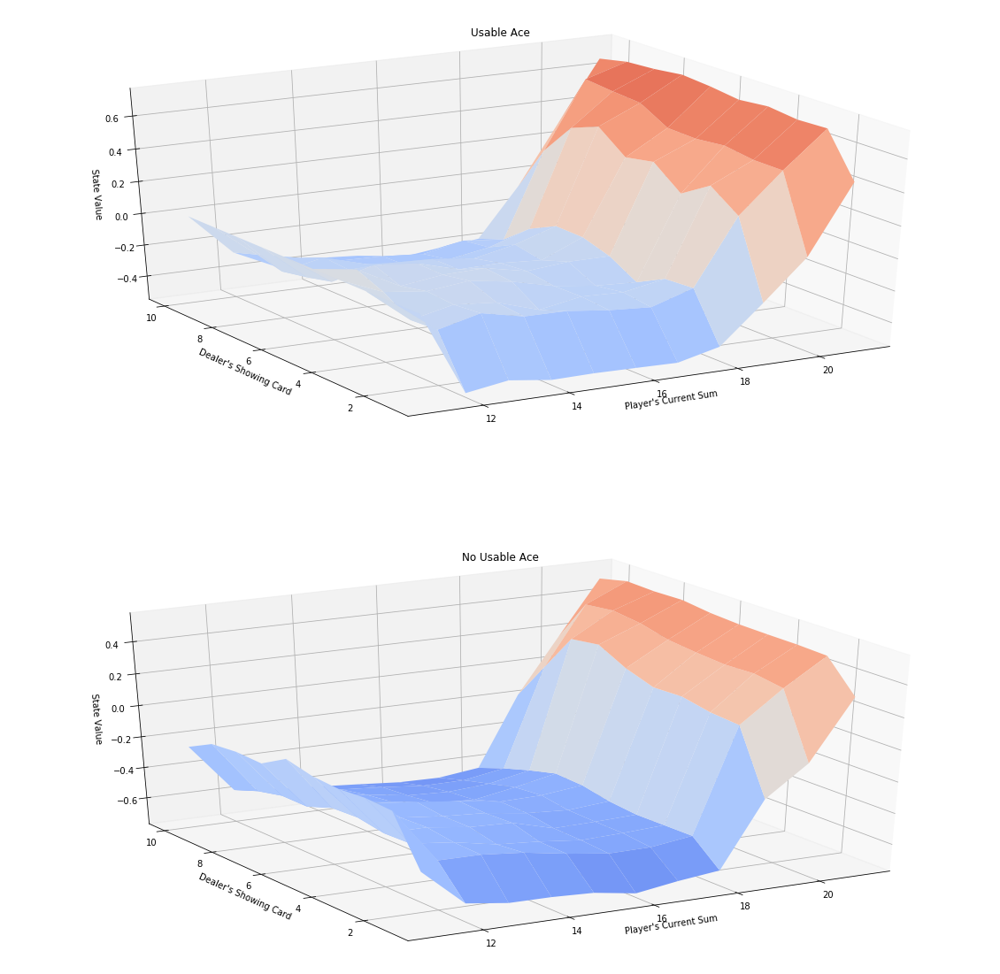

In [44]:
# obtain the action-value function
Q = mc_prediction_q(env, 500000, generate_episode_from_limit_stochastic)

# obtain the corresponding state-value function
V_to_plot = dict((k,(k[0]>18)*(np.dot([0.8, 0.2],v)) + (k[0]<=18)*(np.dot([0.2, 0.8],v))) \
         for k, v in Q.items())

# plot the state-value function
plot_blackjack_values(V_to_plot)

### Part 2: MC Control

In this section, you will write your own implementation of constant-$\alpha$ MC control.  

Your algorithm has four arguments:
- `env`: This is an instance of an OpenAI Gym environment.
- `num_episodes`: This is the number of episodes that are generated through agent-environment interaction.
- `alpha`: This is the step-size parameter for the update step.
- `gamma`: This is the discount rate.  It must be a value between 0 and 1, inclusive (default value: `1`).

The algorithm returns as output:
- `Q`: This is a dictionary (of one-dimensional arrays) where `Q[s][a]` is the estimated action value corresponding to state `s` and action `a`.
- `policy`: This is a dictionary where `policy[s]` returns the action that the agent chooses after observing state `s`.

(_Feel free to define additional functions to help you to organize your code._)

In [ ]:
def mc_control(env, num_episodes, alpha, gamma=1.0):
    nA = env.action_space.n
    # initialize empty dictionary of arrays
    Q = defaultdict(lambda: np.zeros(nA))
    # loop over episodes
    for i_episode in range(1, num_episodes+1):
        # monitor progress
        if i_episode % 1000 == 0:
            print("\rEpisode {}/{}.".format(i_episode, num_episodes), end="")
            sys.stdout.flush()
        
        ## TODO: complete the function
        
        
    return policy, Q

Use the cell below to obtain the estimated optimal policy and action-value function.  Note that you should fill in your own values for the `num_episodes` and `alpha` parameters.

In [ ]:
# obtain the estimated optimal policy and action-value function
policy, Q = mc_control(env, ?, ?)

Next, we plot the corresponding state-value function.

In [ ]:
# obtain the corresponding state-value function
V = dict((k,np.max(v)) for k, v in Q.items())

# plot the state-value function
plot_blackjack_values(V)

Finally, we visualize the policy that is estimated to be optimal.

In [ ]:
# plot the policy
plot_policy(policy)

The **true** optimal policy $\pi_*$ can be found in Figure 5.2 of the [textbook](http://go.udacity.com/rl-textbook) (and appears below).  Compare your final estimate to the optimal policy - how close are you able to get?  If you are not happy with the performance of your algorithm, take the time to tweak the decay rate of $\epsilon$, change the value of $\alpha$, and/or run the algorithm for more episodes to attain better results.

![True Optimal Policy](images/optimal.png)